# Swing Outcome Model: data cleaning, model training, and testing

In [5]:
# Import appropriate libraries

import pandas, json, requests, urllib, io
import tensorflow as tf
from tensorflow import keras        
import numpy as np        
from tensorflow.keras import models, layers, Input, optimizers, callbacks
import matplotlib.pyplot as plt

In [2]:
# Gets the pitch data csv
def get_total_pitch_data():

  pitchData = pandas.read_csv("all_pitch.csv", error_bad_lines=False)
  pitchData = pitchData.rename({"res":"result"}, axis = 1)
  del pitchData["zone"]
  pitchData["zone"] = pitchData['zones']
  pitchData["zones"] = pitchData['zones'].map(lambda x: x.rstrip('aAbB')).astype(int)
  
  return pitchData


total_pitch_data = get_total_pitch_data()

In [3]:
# Gets at-bat data csv 

def get_at_bat_data():
    at_bats = pandas.read_csv("all_atbat.csv")
    #get rid of Sac Bunt, Intentional walk, Runner Out, Batter Interference, Catcher Interference because not included when computing OBP
    at_bat_remove_events = ['Sac Bunt', 'Intent Walk', 'Runner Out', 'Batter Interference', 'Catcher Interference']

    at_bats = at_bats.loc[~at_bats['event'].isin(at_bat_remove_events)]
    
    
    return at_bats
at_bats = get_at_bat_data()

In [ ]:
# Creates a map from pitcher ID to their tensor (without normalized values)
def get_pitcher_tensors(df_pitch):
  pitcher_tensors = {}
  pitch_types = ["FF", "FT", "CU", "CH", "FC", "SL"]

  pitchers = df_pitch['pitcher_id'].unique()
  
  zones = df_pitch['zones'].unique()
  zones.sort()
  
  for pitcher in pitchers:
    pitcher_tensor = [0] * len(pitch_types)

    df_pitcher = df_pitch.loc[df_pitch['pitcher_id'] == pitcher]

    num_pitches = df_pitcher.shape[0]

    for i, pitch in enumerate(pitch_types):
      pitcher_tensor[i] = [0] * len(zones)
      df_pitch_type = df_pitcher.loc[df_pitcher['pitch_type'] == pitch]

      for zone in zones:
        pitcher_tensor[i][zone] = [0] * 2

        if df_pitch_type.shape[0] != 0: 
          df_pitch_type_zone = df_pitch_type.loc[df_pitch_type['zones'] == zone]
          num_pitch_type_in_zone = df_pitch_type_zone.shape[0]

          if num_pitch_type_in_zone != 0: 
            proportion_in_zone = num_pitch_type_in_zone / num_pitches 
            avg_speed = df_pitch_type_zone['start_speed'].mean()

            pitcher_tensor[i][zone][0] = proportion_in_zone
            pitcher_tensor[i][zone][1] = avg_speed

    pitcher_tensors[pitcher] = pitcher_tensor

  return pitcher_tensors

pitcher_tensors = get_pitcher_tensors(total_pitch_data)

In [32]:
# Computes the average and standard deviation in speed for each pitch type 
def get_mean_std_for_pitches(df_pitch): 
  pitch_types = ["FF", "FT", "CU", "CH", "FC", "SL"]
  pitcher_means = []  
  pitchers = df_pitch['pitcher_id'].unique()

  for pitcher in pitchers:
    means = [0] * len(pitch_types) 
    df_pitcher = df_pitch.loc[df_pitch['pitcher_id'] == pitcher]
    for i, pitch in enumerate(pitch_types):
      pitches = df_pitcher.loc[df_pitcher['pitch_type'] == pitch]
      mean_speed = 0
      if pitches.shape[0] != 0: 
        mean_speed = pitches['start_speed'].mean()
      means[i] = mean_speed 
    pitcher_means.append(means)

  mean_speeds = np.mean(pitcher_means, axis=(0), keepdims=True)
  std_speeds = np.std(pitcher_means, axis=(0), keepdims=True)

  return mean_speeds, std_speeds

mean_speeds, std_speeds = get_mean_std_for_pitches(total_pitch_data)

In [33]:
# Normalizes pitch speed in the pitcher tensors by (speed-mean)/std
def normalize_pitch_speed(pitcher_tensors_dict, mean_speeds_array, std_speeds_array):
  return_dict = pitcher_tensors_dict.copy()
  pitch_types = ["FF", "FT", "CU", "CH", "FC", "SL"]
  zones = list(range(17))
  for pitcher, tensor in return_dict.items():
    for i, pitch in enumerate(pitch_types):
      mean_speed = mean_speeds_array[0][i]
      std_speed = std_speeds_array[0][i]
      for zone in zones: 
        normalized_value = (tensor[i][zone][1] - mean_speed) / std_speed
        tensor[i][zone][1] = normalized_value
    return_dict[pitcher] = tensor
  
  return return_dict

pitcher_tensors = normalize_pitch_speed(pitcher_tensors, mean_speeds, std_speeds)

In [34]:
# Reshapes pitcher tensors from (6,17,2) to (5,5,12)
def reshape_pitcher_tensors(pitcher_tensors):
    new_pitcher_tensors = {}
    zone_index_map = {
        0:(1,1), #(x,y)
        1:(2,1),
        2:(3,1),
        3:(1,2),
        4:(2,2),
        5:(3,2),
        6:(1,3),
        7:(2,3),
        8:(3,3),
        9:(0,0),
        10:(np.s_[1:4],0),
        11:(4,0),
        12:(0,np.s_[1:4]),
        13:(4,np.s_[1:4]),
        14:(0,4),
        15:(np.s_[1:4],4),
        16:(4,4)
    }

    for pitcher_key in pitcher_tensors.keys():
        pitcher = np.array(pitcher_tensors[pitcher_key])
    
        new_tensor = np.zeros((0,5,5))
        for pitch in pitcher:
            #print(pitch.shape)
            zone_matrix = np.zeros((2,5,5))
            
            for i, zone in enumerate(pitch):
                index = zone_index_map[i]
                #print(index)
                #print(index[0],index[1])
                #print(zone[0],zone[1])
                zone_matrix[0,index[1],index[0]]= zone[0] #follows (...,row,column)
                zone_matrix[1,index[1],index[0]]= zone[1]
            #print(zone_matrix.shape)
            new_tensor = np.concatenate((new_tensor,zone_matrix),axis=0)
            
      
        new_tensor = new_tensor.reshape((5,5,12))
    
        new_pitcher_tensors[pitcher_key]=new_tensor
            
        
 


    return new_pitcher_tensors

pitcher_tensors = reshape_pitcher_tensors(pitcher_tensors)

In [35]:
# Creates a map from batter ID to batter tensor 
def get_batter_tensors(df_pitch):
  batter_tensors = {}

  pitch_types = ["FF", "FT", "CU", "CH", "FC", "SL"]
  batters = df_pitch['batter_id'].unique()

  zones = df_pitch['zones'].unique()
  zones.sort()

  for batter in batters: 
    batter_tensor = [0] * len(pitch_types)

    df_batter = df_pitch.loc[df_pitch['batter_id'] == batter]
    
    for i, pitch in enumerate(pitch_types):
      batter_tensor[i] = [0] * len(zones)

      df_pitch_type = df_batter.loc[df_batter['pitch_type'] == pitch]
      for zone in zones: 
        batter_tensor[i][zone] = [0] * 2

        if df_pitch_type.shape[0] != 0: 
          df_pitch_type_zone = df_pitch_type.loc[df_pitch_type['zones'] == zone]
          num_pitch_type_in_zone = df_pitch_type_zone.shape[0]

          if num_pitch_type_in_zone != 0: 
            df_swing = df_pitch_type_zone.loc[df_pitch_type_zone['swing'] == 1]
            num_swing = df_swing.shape[0]
            proportion_swing = num_swing / num_pitch_type_in_zone

            num_hit = df_swing.loc[df_swing['result'] == 'Hit'].shape[0]
            proportion_hit = num_hit / num_pitch_type_in_zone

            batter_tensor[i][zone][0] = proportion_swing
            batter_tensor[i][zone][1] = proportion_hit
    batter_tensors[batter] = batter_tensor
  return batter_tensors

batter_tensors = get_batter_tensors(total_pitch_data)

In [36]:
# Reshapes batter tensors from (6,17,2) to (5,5,12)
def reshape_batter_tensors(batter_tensors):
    new_batter_tensors = {}
    zone_index_map = {
        0:(1,1), #(x,y)
        1:(2,1),
        2:(3,1),
        3:(1,2),
        4:(2,2),
        5:(3,2),
        6:(1,3),
        7:(2,3),
        8:(3,3),
        9:(0,0),
        10:(np.s_[1:4],0),
        11:(4,0),
        12:(0,np.s_[1:4]),
        13:(4,np.s_[1:4]),
        14:(0,4),
        15:(np.s_[1:4],4),
        16:(4,4)
    }

    for batter_key in batter_tensors.keys():
        batter = np.array(batter_tensors[batter_key])
    
        new_tensor = np.zeros((0,5,5))
        for pitch in batter:
            #print(pitch.shape)
            zone_matrix = np.zeros((2,5,5))
            
            for i, zone in enumerate(pitch):
                index = zone_index_map[i]
                #print(index)
                #print(index[0],index[1])
                #print(zone[0],zone[1])
                zone_matrix[0,index[1],index[0]]= zone[0]
                zone_matrix[1,index[1],index[0]]= zone[1]
            #print(zone_matrix.shape)
            new_tensor = np.concatenate((new_tensor,zone_matrix),axis=0)
            
        new_tensor = new_tensor.reshape((5,5,12))
        new_batter_tensors[batter_key]=new_tensor
            
        
    
    return new_batter_tensors

batter_tensors = reshape_batter_tensors(batter_tensors)


In [37]:
# Saves tensors to json files
def save_tensors(pitcher_tensors, batter_tensors):
    #enumrate over keys in pitcher tensors, making them into strings
    new_pitcher_tensors = {}
    for key in pitcher_tensors.keys():
        new_pitcher_tensors[str(key)] = pitcher_tensors[key].tolist()
        
        
    #enumrate over keys in batter tensors, making them into strings
    new_batter_tensors = {}
    for key in batter_tensors.keys():
        new_batter_tensors[str(key)] = batter_tensors[key].tolist()
    #WORRIED THAT SERIALIZING MAY NOT PRESERVE LIST ORDER
    with open("pitcher_tensors.json", "w") as write_file:
        json.dump(new_pitcher_tensors, write_file)
    with open("batter_tensors.json", "w") as write_file:
        json.dump(new_batter_tensors, write_file)

save_tensors(pitcher_tensors, batter_tensors)

In [38]:
# Returns tensor for pitch of shape (5,5,6)
def get_pitch_tensor(zone, pitch_type):
    pitch_types = ["FF", "FT", "CU", "CH", "FC", "SL"]
    pitch_tensor = np.zeros((5,5,6))
    p_ind = pitch_types.index(pitch_type)
    zone_index_map = {
        0:(1,1), #(x,y)
        1:(2,1),
        2:(3,1),
        3:(1,2),
        4:(2,2),
        5:(3,2),
        6:(1,3),
        7:(2,3),
        8:(3,3),
        9:(0,0),
        10:(np.s_[1:4],0),
        11:(4,0),
        12:(0,np.s_[1:4]),
        13:(4,np.s_[1:4]),
        14:(0,4),
        15:(np.s_[1:4],4),
        16:(4,4)
    }
    pitch_tensor[zone_index_map[zone][0],zone_index_map[zone][1], p_ind] = 1
   
    return pitch_tensor
    

In [39]:
# Creates dataframe of pitche filtered by batter swinging and pitch not landing in obvious zone
swing_df = total_pitch_data[(total_pitch_data["swing"]==1) & (total_pitch_data["zone"][:-1]!="b")]

In [40]:
# Iterates through all at bats and creates 3 lists of the pitcher tensor, batter tensor, and outcome
def create_input_output_tensors(pitcher_tensors, batter_tensors, at_bats, pitches):

  outcome_list = ['Strike', 'Foul', 'Out', 'Hit']

  pitcher = []
  batter = []
  outcome = []
  s_count = []
  b_count = []
  ids = []
  pitch = []

  for i, row in pitches.iterrows():
    print(i)
    res = np.zeros(4)
    if row.pitcher_id in pitcher_tensors.keys() and row.batter_id in batter_tensors.keys():
        pitcher.append(pitcher_tensors[row.pitcher_id])
        batter.append(batter_tensors[row.batter_id])
        ids.append((row.pitcher_id, row.batter_id, i))
        res[outcome_list.index(row.result)]=1
        outcome.append(res)
        s_count.append(row.s_count)
        b_count.append(row.b_count)
        pitch.append(get_pitch_tensor(row.zones,row.pitch_type))

  data = {
      'Pitcher' : pitcher,
      'Batter' : batter,
      'Outcome' : outcome,
      'IDs' : ids,
      's_count': s_count,
      'b_count': b_count,
      'Pitch': pitch
      
  }

  return data

input_output_tensors = create_input_output_tensors(pitcher_tensors, batter_tensors, at_bats, swing_df)

1
2
5
7
10
11
12
13
15
16
17
18
20
21
23
24
26
32
33
35
36
37
38
42
43
45
46
47
48
49
50
51
52
54
58
60
64
65
66
67
69
71
74
76
77
78
80
85
89
91
92
95
98
99
103
105
111
115
118
119
120
121
122
124
125
129
130
132
137
138
144
147
149
150
151
153
154
155
156
157
158
160
161
162
163
166
168
174
177
178
180
181
182
183
184
185
190
191
192
197
198
199
202
203
205
207
208
210
211
213
214
215
217
218
220
221
225
227
229
232
234
239
240
241
242
243
246
247
249
250
255
258
259
261
264
265
268
273
274
275
277
281
284
285
286
288
292
293
302
303
307
309
311
313
316
317
318
320
325
326
327
330
332
338
341
343
348
349
351
353
356
360
363
365
366
370
372
375
376
378
380
383
385
386
389
392
393
396
397
399
400
403
406
407
409
410
413
414
415
416
418
419
421
422
426
427
431
432
434
435
438
439
440
443
448
451
454
455
457
458
459
463
467
469
470
471
475
476
479
483
484
485
486
488
489
491
492
497
500
503
504
505
508
509
513
514
515
516
518
520
522
525
526
527
535
538
539
540
541
551
553
554
556
558
56

5083
5085
5088
5090
5091
5092
5094
5097
5099
5101
5102
5103
5105
5107
5112
5114
5116
5120
5121
5124
5130
5131
5133
5135
5138
5140
5141
5142
5143
5146
5147
5148
5149
5152
5157
5158
5159
5162
5164
5165
5168
5170
5173
5174
5175
5176
5178
5179
5180
5182
5183
5184
5189
5190
5192
5194
5195
5199
5200
5205
5206
5208
5210
5211
5212
5213
5215
5216
5217
5218
5219
5220
5224
5225
5226
5229
5230
5231
5232
5233
5236
5242
5244
5248
5251
5252
5255
5257
5260
5266
5274
5276
5277
5278
5280
5284
5286
5289
5291
5292
5293
5295
5297
5301
5303
5305
5306
5309
5310
5312
5314
5318
5320
5321
5324
5328
5332
5338
5340
5341
5342
5345
5346
5347
5348
5349
5350
5354
5355
5360
5363
5364
5366
5368
5371
5374
5380
5382
5383
5384
5386
5390
5394
5395
5397
5399
5401
5404
5408
5411
5412
5413
5415
5416
5419
5420
5421
5425
5426
5427
5428
5431
5432
5433
5434
5435
5437
5438
5439
5444
5445
5448
5454
5457
5460
5462
5464
5470
5472
5478
5480
5483
5484
5486
5488
5489
5491
5493
5494
5496
5499
5501
5503
5505
5506
5508
5509
5510
5513
5514


10137
10139
10140
10142
10143
10146
10148
10149
10150
10151
10153
10155
10156
10157
10159
10160
10163
10165
10168
10169
10170
10171
10172
10174
10176
10178
10180
10181
10182
10183
10187
10189
10190
10191
10192
10193
10194
10197
10200
10201
10206
10207
10212
10213
10214
10217
10220
10221
10224
10228
10230
10234
10235
10237
10240
10242
10244
10249
10250
10259
10260
10264
10265
10266
10268
10269
10271
10272
10278
10283
10287
10295
10300
10303
10304
10305
10306
10307
10309
10312
10314
10315
10319
10324
10329
10331
10333
10334
10335
10338
10342
10344
10346
10347
10350
10352
10357
10361
10365
10366
10370
10374
10377
10378
10379
10380
10381
10386
10387
10388
10390
10392
10394
10396
10399
10402
10404
10408
10409
10410
10412
10413
10415
10416
10418
10420
10421
10423
10426
10429
10431
10432
10434
10440
10441
10442
10443
10445
10446
10448
10449
10450
10452
10454
10457
10459
10460
10462
10463
10466
10468
10469
10471
10474
10475
10478
10479
10482
10483
10485
10489
10490
10492
10502
10505
10506
1050

13606
13608
13611
13615
13620
13625
13630
13634
13635
13638
13643
13645
13648
13651
13652
13657
13659
13660
13662
13664
13665
13667
13669
13671
13672
13673
13674
13675
13676
13681
13682
13685
13686
13687
13691
13694
13695
13696
13699
13701
13703
13705
13706
13710
13711
13715
13717
13718
13721
13722
13723
13724
13728
13729
13730
13732
13734
13736
13738
13740
13741
13743
13746
13747
13748
13749
13751
13753
13754
13755
13757
13760
13762
13764
13765
13766
13767
13769
13770
13774
13775
13777
13779
13781
13782
13786
13788
13789
13792
13793
13794
13795
13797
13803
13804
13805
13810
13811
13812
13813
13814
13816
13820
13822
13823
13824
13832
13838
13839
13843
13844
13845
13848
13851
13855
13856
13858
13860
13861
13863
13865
13867
13869
13875
13878
13883
13884
13886
13887
13889
13890
13891
13892
13895
13896
13897
13898
13909
13910
13911
13914
13916
13918
13920
13923
13924
13925
13927
13931
13933
13936
13939
13942
13944
13945
13948
13949
13950
13953
13954
13956
13958
13960
13961
13962
13963
1396

17104
17106
17109
17112
17113
17115
17117
17119
17121
17126
17128
17129
17130
17133
17134
17136
17139
17140
17145
17146
17149
17150
17152
17154
17156
17157
17158
17160
17165
17167
17168
17169
17170
17171
17174
17175
17177
17179
17182
17187
17188
17189
17192
17193
17195
17196
17198
17201
17204
17206
17208
17209
17211
17213
17216
17219
17221
17223
17227
17228
17229
17232
17234
17235
17236
17237
17238
17239
17240
17245
17246
17248
17250
17251
17252
17253
17258
17267
17268
17272
17276
17277
17278
17280
17281
17283
17287
17288
17292
17293
17299
17300
17301
17303
17306
17308
17309
17310
17313
17314
17315
17316
17318
17319
17320
17323
17325
17327
17328
17330
17331
17333
17335
17338
17340
17342
17343
17344
17347
17354
17356
17357
17358
17361
17363
17366
17367
17374
17375
17376
17378
17379
17382
17383
17387
17394
17396
17401
17403
17406
17409
17410
17411
17412
17413
17415
17417
17419
17421
17424
17426
17429
17431
17432
17435
17436
17438
17439
17440
17442
17443
17444
17445
17446
17451
17452
1745

20624
20626
20627
20630
20632
20635
20636
20638
20641
20642
20644
20646
20647
20648
20649
20651
20652
20656
20658
20659
20661
20662
20667
20669
20670
20675
20681
20683
20688
20695
20697
20700
20704
20706
20707
20710
20712
20714
20716
20717
20718
20719
20722
20724
20725
20730
20731
20734
20737
20739
20742
20745
20748
20749
20752
20754
20756
20757
20758
20759
20761
20762
20766
20767
20770
20773
20776
20777
20779
20780
20790
20791
20792
20793
20796
20797
20800
20803
20806
20807
20808
20812
20816
20818
20821
20822
20823
20832
20833
20834
20837
20838
20841
20842
20843
20846
20847
20849
20852
20854
20855
20856
20857
20858
20859
20861
20864
20865
20866
20868
20869
20870
20872
20874
20876
20882
20884
20885
20886
20887
20890
20892
20893
20894
20896
20898
20899
20900
20901
20902
20903
20905
20911
20913
20915
20917
20921
20923
20924
20926
20932
20937
20940
20944
20947
20949
20952
20953
20955
20961
20963
20964
20965
20966
20968
20969
20970
20971
20973
20977
20978
20981
20982
20984
20988
20990
2099

24272
24276
24278
24279
24282
24283
24286
24287
24288
24290
24291
24292
24294
24296
24298
24300
24303
24308
24311
24312
24315
24316
24317
24320
24325
24326
24328
24330
24332
24334
24336
24341
24342
24343
24344
24346
24349
24350
24351
24354
24356
24358
24359
24360
24363
24365
24366
24367
24369
24370
24372
24373
24374
24375
24376
24378
24380
24385
24386
24388
24390
24391
24394
24395
24398
24401
24404
24408
24414
24417
24418
24423
24424
24427
24429
24431
24433
24434
24437
24438
24440
24443
24445
24447
24448
24453
24455
24456
24457
24459
24462
24465
24466
24467
24469
24471
24472
24473
24474
24475
24477
24481
24482
24483
24488
24491
24492
24494
24496
24499
24500
24501
24504
24505
24506
24508
24510
24513
24518
24520
24521
24522
24524
24529
24532
24534
24535
24537
24540
24543
24546
24548
24551
24554
24556
24557
24559
24560
24561
24562
24565
24566
24567
24568
24571
24572
24575
24582
24584
24586
24587
24588
24590
24594
24595
24596
24597
24599
24601
24602
24605
24608
24609
24612
24617
24619
2462

27741
27743
27746
27747
27748
27753
27755
27756
27757
27760
27763
27764
27765
27766
27768
27769
27772
27774
27777
27779
27781
27782
27783
27784
27785
27787
27788
27791
27792
27794
27796
27797
27799
27800
27801
27802
27803
27804
27805
27806
27808
27810
27812
27813
27814
27815
27816
27819
27821
27822
27825
27828
27829
27830
27831
27833
27840
27842
27847
27848
27851
27852
27853
27855
27857
27858
27860
27862
27863
27864
27865
27866
27867
27868
27876
27878
27879
27880
27885
27888
27889
27891
27893
27899
27900
27901
27903
27905
27908
27913
27918
27919
27921
27924
27928
27933
27938
27940
27943
27948
27951
27952
27953
27955
27956
27959
27960
27965
27968
27970
27973
27975
27976
27978
27982
27984
27985
27986
27988
27993
27994
27995
27996
27998
28000
28001
28003
28004
28006
28009
28011
28014
28016
28019
28020
28022
28024
28028
28032
28033
28035
28036
28037
28038
28040
28042
28045
28046
28048
28049
28051
28052
28053
28057
28059
28060
28061
28063
28065
28066
28068
28070
28071
28077
28078
28080
2808

31294
31295
31297
31299
31300
31303
31304
31305
31307
31309
31313
31318
31320
31321
31322
31324
31329
31332
31336
31337
31339
31342
31343
31345
31347
31350
31353
31357
31358
31359
31364
31368
31369
31380
31382
31383
31384
31389
31395
31396
31398
31403
31405
31408
31409
31412
31414
31415
31416
31417
31418
31420
31424
31427
31429
31431
31432
31433
31434
31435
31436
31438
31441
31442
31444
31448
31449
31451
31452
31456
31459
31461
31462
31463
31465
31466
31468
31469
31472
31477
31478
31479
31480
31481
31482
31485
31487
31492
31494
31496
31502
31505
31506
31507
31509
31510
31512
31514
31516
31517
31518
31519
31523
31524
31525
31530
31533
31534
31535
31540
31541
31542
31546
31550
31552
31554
31556
31560
31562
31565
31568
31569
31572
31574
31575
31579
31582
31589
31592
31593
31594
31597
31600
31602
31605
31606
31610
31613
31615
31616
31617
31620
31623
31626
31629
31630
31631
31633
31634
31636
31640
31643
31644
31645
31647
31652
31654
31659
31660
31662
31664
31666
31668
31672
31676
31677
3168

34840
34842
34850
34851
34852
34858
34859
34861
34862
34864
34865
34870
34871
34872
34875
34876
34877
34878
34880
34881
34883
34886
34889
34893
34899
34902
34905
34906
34909
34910
34914
34916
34918
34920
34921
34926
34927
34929
34931
34934
34937
34940
34942
34944
34945
34946
34950
34953
34954
34955
34956
34957
34960
34961
34962
34963
34966
34968
34970
34971
34976
34977
34978
34980
34982
34984
34985
34988
34991
34995
34997
34999
35001
35003
35004
35007
35009
35011
35013
35018
35019
35022
35025
35027
35030
35032
35033
35034
35035
35038
35039
35043
35046
35047
35049
35051
35052
35054
35056
35058
35060
35061
35062
35063
35066
35068
35073
35074
35079
35080
35084
35085
35086
35087
35088
35090
35091
35092
35095
35096
35098
35102
35106
35108
35109
35110
35111
35115
35116
35126
35128
35134
35135
35136
35139
35140
35146
35148
35149
35150
35152
35157
35160
35165
35175
35176
35179
35181
35183
35187
35189
35192
35195
35196
35201
35204
35207
35208
35210
35213
35215
35217
35218
35219
35221
35222
3522

38444
38446
38447
38448
38449
38452
38454
38455
38457
38459
38462
38463
38468
38472
38476
38482
38486
38487
38488
38491
38492
38493
38495
38497
38498
38500
38507
38509
38511
38517
38518
38519
38522
38525
38526
38529
38530
38531
38532
38534
38535
38537
38538
38540
38541
38544
38548
38550
38558
38560
38562
38563
38564
38567
38569
38571
38575
38579
38582
38584
38586
38587
38588
38589
38590
38592
38593
38594
38596
38598
38599
38600
38602
38604
38606
38608
38609
38614
38615
38616
38618
38623
38630
38632
38634
38636
38638
38640
38645
38648
38651
38655
38656
38658
38662
38664
38665
38666
38668
38669
38670
38671
38672
38673
38681
38683
38684
38687
38688
38691
38695
38696
38698
38699
38703
38705
38708
38719
38721
38727
38728
38730
38732
38742
38748
38750
38758
38763
38767
38768
38769
38770
38771
38773
38775
38776
38778
38779
38783
38784
38787
38788
38791
38792
38793
38801
38805
38807
38809
38811
38812
38813
38814
38818
38822
38825
38827
38828
38830
38832
38833
38834
38836
38839
38840
38845
3884

42050
42051
42052
42053
42057
42061
42063
42065
42066
42067
42069
42075
42078
42080
42082
42083
42087
42089
42091
42092
42099
42101
42104
42105
42107
42108
42112
42113
42115
42119
42122
42130
42133
42136
42138
42139
42140
42141
42143
42144
42149
42152
42154
42157
42158
42161
42164
42165
42166
42167
42169
42170
42173
42176
42182
42184
42187
42192
42193
42194
42195
42197
42198
42199
42202
42205
42209
42213
42215
42217
42219
42220
42222
42223
42229
42230
42231
42232
42233
42235
42237
42239
42240
42241
42246
42249
42251
42252
42254
42255
42258
42259
42261
42264
42267
42268
42269
42271
42277
42282
42283
42284
42286
42288
42289
42290
42292
42302
42305
42308
42312
42314
42317
42318
42319
42321
42322
42323
42324
42325
42326
42328
42330
42332
42335
42339
42342
42344
42348
42351
42355
42357
42360
42362
42364
42366
42370
42371
42373
42376
42378
42379
42380
42382
42383
42388
42393
42396
42399
42401
42402
42405
42408
42410
42413
42415
42416
42419
42421
42424
42426
42427
42428
42430
42431
42433
4243

45688
45689
45691
45695
45696
45697
45701
45702
45711
45714
45715
45716
45717
45718
45719
45720
45722
45723
45725
45727
45729
45733
45735
45738
45741
45752
45755
45756
45759
45761
45762
45765
45766
45768
45769
45771
45772
45775
45779
45780
45784
45787
45789
45791
45795
45796
45797
45801
45807
45808
45809
45817
45818
45819
45821
45824
45825
45826
45827
45828
45830
45834
45835
45836
45838
45842
45845
45847
45849
45853
45854
45856
45857
45860
45861
45864
45867
45869
45871
45872
45874
45880
45881
45883
45884
45889
45890
45891
45892
45893
45894
45895
45896
45899
45900
45901
45902
45904
45906
45909
45911
45912
45913
45916
45917
45920
45923
45925
45926
45927
45928
45929
45930
45932
45933
45935
45938
45943
45948
45950
45951
45955
45956
45957
45959
45961
45962
45965
45967
45968
45969
45970
45972
45974
45976
45977
45979
45980
45981
45983
45987
45988
45991
45993
45999
46000
46002
46004
46005
46006
46009
46012
46015
46016
46019
46020
46023
46024
46026
46030
46031
46036
46038
46039
46041
46044
4604

49564
49569
49570
49571
49574
49581
49584
49586
49587
49588
49591
49592
49594
49596
49598
49606
49608
49611
49617
49618
49619
49622
49628
49632
49633
49637
49638
49639
49641
49642
49644
49645
49647
49650
49653
49654
49657
49660
49661
49662
49665
49667
49669
49671
49673
49675
49676
49677
49678
49679
49682
49683
49684
49686
49688
49691
49692
49695
49698
49700
49702
49703
49707
49709
49712
49713
49715
49720
49722
49723
49724
49727
49728
49729
49732
49733
49737
49741
49742
49743
49746
49750
49751
49752
49754
49767
49773
49779
49784
49785
49787
49789
49793
49795
49797
49798
49801
49804
49810
49811
49813
49814
49815
49817
49821
49822
49823
49828
49830
49831
49832
49833
49837
49838
49841
49842
49846
49847
49849
49850
49852
49854
49856
49860
49864
49870
49871
49873
49874
49876
49880
49881
49883
49884
49886
49891
49894
49896
49899
49900
49903
49906
49907
49909
49910
49912
49919
49926
49929
49931
49943
49944
49947
49949
49954
49959
49963
49967
49968
49971
49973
49975
49976
49980
49981
49983
4998

53417
53419
53422
53424
53425
53431
53435
53436
53437
53438
53439
53442
53444
53445
53448
53450
53451
53452
53457
53458
53459
53463
53466
53467
53468
53472
53474
53475
53481
53482
53483
53486
53488
53491
53492
53493
53495
53496
53497
53499
53500
53501
53503
53504
53505
53508
53509
53512
53513
53514
53515
53518
53520
53522
53523
53524
53526
53527
53529
53532
53534
53538
53539
53542
53545
53548
53550
53553
53554
53555
53557
53558
53559
53560
53561
53563
53564
53565
53567
53568
53569
53570
53573
53577
53578
53581
53583
53585
53587
53589
53590
53591
53593
53594
53596
53597
53600
53601
53603
53605
53606
53608
53616
53617
53619
53620
53621
53622
53624
53625
53626
53627
53630
53631
53632
53633
53635
53636
53637
53638
53639
53643
53644
53646
53647
53648
53651
53652
53653
53656
53658
53659
53661
53664
53673
53674
53675
53676
53677
53679
53683
53685
53689
53691
53692
53694
53695
53700
53701
53705
53706
53714
53715
53720
53721
53723
53724
53726
53728
53729
53731
53737
53738
53739
53742
53745
5374

57233
57236
57238
57241
57243
57244
57246
57247
57249
57251
57252
57254
57256
57258
57263
57264
57265
57267
57271
57272
57275
57276
57278
57287
57289
57293
57294
57295
57300
57303
57305
57306
57310
57311
57312
57317
57320
57321
57322
57323
57324
57325
57327
57329
57330
57333
57337
57339
57341
57342
57345
57346
57348
57351
57352
57353
57355
57358
57360
57363
57364
57365
57373
57377
57378
57379
57380
57381
57382
57384
57386
57389
57390
57392
57395
57396
57399
57401
57402
57405
57406
57408
57409
57414
57415
57418
57419
57421
57422
57423
57426
57428
57430
57433
57434
57435
57438
57441
57443
57445
57446
57448
57451
57453
57455
57457
57458
57459
57461
57462
57463
57464
57466
57468
57473
57475
57477
57479
57481
57487
57488
57489
57490
57495
57497
57499
57500
57505
57506
57511
57512
57514
57518
57519
57520
57521
57522
57523
57525
57527
57528
57530
57531
57533
57537
57539
57543
57544
57545
57547
57548
57550
57552
57554
57556
57558
57559
57560
57562
57563
57564
57566
57567
57568
57570
57571
5757

60907
60908
60910
60911
60913
60914
60916
60919
60922
60924
60925
60926
60927
60929
60933
60934
60936
60938
60939
60941
60942
60945
60946
60951
60952
60957
60958
60961
60962
60963
60969
60970
60971
60973
60976
60978
60979
60980
60982
60983
60984
60985
60989
60990
60993
60996
60998
61002
61004
61007
61008
61010
61019
61021
61022
61024
61025
61026
61028
61031
61034
61037
61040
61042
61044
61046
61047
61049
61051
61053
61054
61055
61056
61057
61058
61065
61067
61068
61070
61071
61073
61075
61076
61079
61081
61082
61086
61091
61092
61093
61095
61098
61099
61102
61104
61106
61110
61113
61115
61116
61117
61119
61121
61133
61136
61137
61139
61140
61145
61146
61148
61150
61153
61156
61157
61158
61159
61160
61161
61164
61165
61167
61170
61171
61173
61174
61176
61180
61182
61185
61188
61189
61190
61191
61194
61199
61205
61206
61207
61208
61209
61211
61216
61220
61221
61222
61223
61225
61226
61229
61231
61233
61236
61238
61241
61242
61246
61248
61250
61253
61255
61256
61257
61258
61260
61262
6126

64581
64582
64583
64586
64587
64592
64593
64594
64599
64605
64606
64608
64610
64611
64612
64613
64614
64615
64617
64619
64622
64628
64629
64630
64632
64634
64637
64638
64639
64640
64646
64647
64648
64650
64651
64654
64655
64657
64660
64661
64662
64663
64664
64665
64671
64673
64678
64679
64682
64683
64685
64686
64689
64690
64694
64695
64700
64704
64706
64708
64709
64710
64712
64714
64715
64717
64718
64719
64722
64727
64732
64733
64735
64739
64740
64742
64745
64747
64751
64752
64753
64754
64759
64762
64763
64764
64767
64768
64769
64771
64772
64774
64776
64780
64784
64790
64792
64794
64795
64796
64801
64805
64810
64811
64814
64818
64820
64823
64824
64828
64829
64832
64833
64836
64837
64845
64847
64848
64851
64854
64856
64858
64859
64861
64864
64865
64866
64870
64872
64874
64876
64877
64880
64881
64885
64886
64887
64890
64891
64892
64893
64895
64897
64899
64901
64903
64905
64906
64907
64909
64910
64916
64917
64921
64922
64924
64926
64931
64934
64935
64937
64939
64940
64943
64944
64947
6494

68081
68085
68089
68093
68094
68100
68102
68104
68106
68107
68109
68111
68113
68114
68117
68119
68123
68126
68127
68131
68133
68136
68139
68140
68143
68144
68147
68151
68152
68153
68156
68159
68160
68161
68166
68168
68172
68173
68176
68179
68184
68185
68187
68188
68193
68194
68196
68197
68198
68203
68207
68209
68210
68211
68213
68214
68216
68217
68219
68220
68221
68224
68226
68227
68230
68233
68234
68235
68238
68239
68240
68241
68245
68249
68253
68254
68255
68256
68260
68266
68267
68269
68271
68276
68277
68280
68282
68286
68288
68291
68292
68294
68301
68302
68305
68310
68312
68314
68317
68318
68319
68321
68330
68331
68332
68336
68337
68339
68342
68343
68345
68347
68351
68352
68353
68355
68358
68361
68364
68365
68366
68370
68373
68375
68376
68378
68380
68382
68384
68387
68389
68391
68392
68396
68398
68399
68400
68403
68404
68407
68410
68411
68412
68413
68415
68421
68423
68424
68427
68430
68434
68435
68437
68438
68441
68444
68447
68448
68452
68453
68455
68462
68464
68467
68474
68475
6848

71827
71828
71829
71831
71833
71835
71837
71839
71844
71845
71846
71847
71848
71853
71854
71857
71858
71859
71862
71863
71864
71866
71867
71869
71872
71875
71878
71879
71880
71889
71890
71891
71893
71895
71899
71902
71903
71905
71907
71912
71914
71920
71922
71923
71924
71925
71928
71930
71933
71934
71936
71937
71938
71941
71944
71945
71946
71949
71952
71954
71957
71959
71960
71961
71962
71964
71970
71973
71976
71978
71980
71981
71984
71985
71986
71989
71992
71994
72000
72001
72002
72003
72005
72006
72008
72010
72012
72014
72016
72020
72021
72023
72025
72028
72032
72034
72039
72041
72042
72045
72048
72051
72054
72059
72061
72065
72066
72071
72073
72074
72076
72079
72081
72084
72085
72087
72088
72089
72093
72094
72096
72097
72098
72100
72103
72106
72110
72111
72114
72119
72121
72122
72123
72127
72128
72129
72130
72134
72135
72140
72141
72144
72145
72149
72151
72152
72154
72158
72163
72167
72169
72170
72171
72173
72176
72177
72178
72180
72184
72185
72188
72189
72190
72192
72194
72195
7219

75391
75394
75397
75403
75404
75405
75409
75412
75413
75415
75419
75420
75421
75430
75432
75433
75435
75438
75439
75441
75446
75450
75451
75452
75454
75458
75459
75462
75463
75465
75468
75469
75470
75473
75480
75485
75486
75489
75491
75497
75502
75505
75508
75509
75512
75513
75514
75515
75516
75517
75518
75519
75520
75521
75522
75523
75526
75528
75532
75533
75538
75539
75541
75542
75543
75544
75547
75550
75552
75554
75556
75558
75560
75561
75562
75565
75569
75570
75572
75573
75575
75577
75580
75585
75588
75592
75594
75595
75596
75599
75600
75601
75602
75603
75606
75607
75608
75609
75614
75615
75617
75618
75622
75626
75630
75632
75633
75636
75641
75643
75645
75647
75648
75649
75650
75652
75653
75655
75656
75657
75661
75666
75669
75671
75672
75674
75676
75677
75679
75681
75683
75687
75688
75690
75692
75693
75694
75695
75700
75701
75702
75704
75706
75708
75714
75715
75718
75719
75725
75726
75727
75728
75731
75732
75733
75735
75738
75741
75742
75744
75745
75748
75749
75750
75751
75754
7575

78957
78959
78961
78962
78963
78966
78967
78969
78971
78972
78975
78977
78978
78979
78982
78983
78984
78986
78987
78990
78991
78992
78997
79001
79002
79003
79004
79007
79010
79012
79013
79015
79017
79019
79024
79029
79031
79032
79035
79043
79044
79050
79051
79052
79054
79056
79059
79060
79062
79063
79068
79069
79071
79072
79073
79075
79077
79079
79082
79083
79084
79088
79089
79094
79095
79096
79097
79099
79100
79101
79102
79106
79107
79108
79111
79112
79114
79116
79117
79118
79119
79122
79123
79124
79125
79126
79128
79131
79134
79139
79143
79145
79148
79154
79155
79156
79157
79160
79161
79163
79164
79166
79167
79168
79171
79174
79175
79177
79178
79179
79182
79184
79187
79188
79190
79192
79200
79202
79203
79205
79208
79209
79211
79215
79216
79217
79219
79220
79221
79227
79228
79232
79236
79237
79240
79241
79242
79245
79247
79252
79253
79255
79257
79258
79261
79262
79263
79264
79266
79267
79268
79272
79273
79274
79275
79276
79281
79283
79285
79290
79293
79296
79299
79300
79302
79303
7930

82444
82445
82446
82449
82451
82454
82456
82457
82464
82466
82467
82473
82474
82475
82478
82481
82483
82485
82486
82488
82491
82492
82494
82496
82497
82498
82499
82501
82502
82506
82508
82512
82514
82517
82519
82522
82523
82525
82526
82527
82529
82531
82538
82540
82544
82545
82546
82551
82557
82560
82562
82563
82564
82566
82569
82570
82571
82573
82574
82575
82577
82579
82580
82582
82583
82586
82587
82589
82594
82596
82597
82599
82600
82601
82602
82603
82605
82612
82617
82618
82619
82626
82628
82629
82630
82632
82633
82634
82635
82636
82639
82640
82642
82643
82644
82646
82648
82649
82652
82654
82655
82657
82662
82664
82668
82669
82670
82671
82672
82673
82674
82677
82682
82683
82684
82687
82688
82690
82691
82694
82696
82698
82701
82704
82706
82707
82708
82711
82712
82714
82716
82717
82718
82720
82721
82724
82727
82729
82730
82731
82734
82736
82737
82738
82740
82741
82742
82744
82746
82748
82749
82751
82753
82755
82756
82758
82759
82760
82761
82762
82763
82765
82768
82770
82773
82775
8277

85873
85875
85876
85877
85880
85881
85883
85884
85887
85889
85891
85895
85898
85901
85905
85906
85907
85908
85909
85910
85913
85917
85918
85919
85920
85924
85926
85928
85930
85931
85932
85934
85937
85938
85942
85944
85945
85946
85947
85949
85952
85956
85960
85961
85966
85967
85968
85972
85977
85978
85979
85981
85983
85984
85986
85988
85989
85993
85995
85996
85997
86000
86002
86005
86006
86010
86012
86014
86016
86018
86020
86023
86025
86026
86029
86031
86034
86035
86038
86039
86040
86046
86047
86049
86050
86051
86053
86054
86056
86061
86063
86064
86068
86076
86078
86080
86082
86083
86085
86086
86092
86094
86095
86097
86098
86102
86104
86107
86108
86109
86111
86112
86114
86116
86117
86118
86119
86120
86121
86124
86125
86128
86129
86131
86132
86133
86137
86138
86140
86141
86142
86146
86148
86151
86153
86162
86163
86166
86167
86168
86170
86172
86175
86177
86179
86180
86181
86183
86185
86187
86189
86195
86198
86200
86201
86205
86206
86207
86208
86211
86212
86213
86214
86215
86216
86217
8622

89413
89415
89417
89418
89424
89426
89427
89428
89432
89434
89436
89440
89441
89442
89445
89446
89448
89449
89451
89452
89453
89454
89457
89458
89460
89464
89465
89469
89471
89473
89475
89476
89477
89479
89481
89489
89490
89493
89497
89498
89501
89503
89504
89507
89508
89509
89510
89512
89513
89514
89515
89518
89521
89523
89524
89526
89531
89537
89538
89542
89544
89545
89546
89548
89551
89552
89555
89556
89559
89565
89567
89568
89570
89574
89576
89577
89581
89582
89586
89587
89589
89590
89594
89595
89597
89598
89600
89601
89603
89605
89610
89612
89613
89616
89618
89619
89622
89626
89628
89632
89633
89636
89637
89638
89640
89644
89647
89648
89650
89651
89653
89654
89657
89661
89662
89663
89664
89666
89667
89668
89669
89671
89673
89674
89678
89679
89680
89683
89684
89686
89688
89689
89691
89694
89695
89696
89697
89698
89700
89701
89704
89708
89709
89715
89716
89719
89722
89725
89727
89728
89729
89730
89734
89736
89737
89740
89743
89744
89745
89746
89748
89749
89750
89751
89753
89754
8975

92784
92787
92788
92790
92792
92794
92795
92796
92798
92799
92802
92803
92805
92807
92808
92810
92812
92813
92814
92817
92819
92820
92821
92824
92829
92833
92835
92838
92839
92842
92845
92848
92853
92854
92856
92861
92864
92866
92867
92868
92870
92871
92875
92876
92878
92881
92882
92884
92885
92887
92889
92892
92894
92899
92900
92902
92905
92907
92909
92911
92912
92913
92915
92916
92917
92918
92920
92922
92924
92926
92931
92933
92937
92938
92939
92941
92943
92944
92945
92946
92949
92951
92953
92954
92956
92957
92958
92959
92964
92965
92967
92968
92970
92975
92976
92982
92983
92985
92986
92990
92993
92994
92997
92998
92999
93001
93005
93008
93009
93011
93014
93015
93017
93019
93021
93023
93025
93028
93031
93032
93034
93036
93038
93039
93042
93044
93045
93049
93050
93052
93054
93055
93057
93058
93069
93070
93071
93072
93073
93074
93076
93078
93079
93082
93085
93087
93088
93092
93093
93098
93101
93105
93107
93112
93113
93115
93118
93120
93122
93125
93127
93129
93130
93131
93133
93135
9313

96197
96202
96203
96204
96209
96210
96212
96213
96218
96219
96220
96222
96223
96224
96229
96231
96233
96234
96235
96237
96239
96241
96242
96250
96253
96256
96257
96259
96260
96261
96262
96265
96266
96268
96271
96273
96274
96275
96280
96282
96284
96287
96288
96289
96290
96292
96294
96298
96299
96303
96306
96308
96310
96312
96314
96315
96317
96319
96323
96324
96325
96326
96331
96334
96341
96342
96351
96355
96359
96361
96363
96364
96365
96366
96368
96369
96371
96374
96376
96381
96382
96383
96385
96387
96388
96389
96390
96391
96392
96393
96394
96396
96397
96400
96401
96406
96407
96408
96409
96410
96415
96417
96421
96423
96424
96426
96428
96429
96430
96431
96432
96434
96437
96440
96442
96443
96444
96447
96450
96451
96453
96455
96458
96459
96460
96461
96462
96463
96465
96470
96471
96473
96474
96475
96477
96480
96482
96483
96485
96486
96489
96490
96492
96496
96499
96500
96504
96505
96508
96512
96514
96518
96520
96522
96523
96525
96529
96531
96535
96540
96541
96542
96543
96544
96548
96550
9655

99616
99617
99618
99623
99624
99626
99627
99633
99635
99637
99638
99641
99645
99649
99651
99654
99655
99656
99657
99659
99665
99666
99673
99676
99677
99680
99683
99686
99689
99691
99692
99694
99695
99696
99698
99699
99700
99702
99705
99707
99709
99710
99711
99715
99716
99718
99719
99720
99722
99725
99728
99729
99732
99735
99738
99741
99742
99743
99745
99747
99749
99750
99754
99762
99764
99769
99770
99775
99776
99777
99779
99781
99786
99788
99789
99790
99797
99798
99804
99806
99807
99809
99811
99812
99817
99818
99821
99822
99823
99824
99826
99827
99828
99832
99837
99839
99842
99843
99845
99846
99849
99850
99851
99856
99857
99858
99860
99864
99865
99867
99870
99871
99872
99874
99876
99878
99881
99884
99886
99887
99889
99891
99892
99898
99900
99901
99903
99905
99906
99908
99911
99912
99914
99915
99917
99918
99919
99920
99921
99929
99933
99934
99935
99937
99939
99940
99941
99942
99943
99944
99946
99948
99949
99951
99952
99954
99955
99957
99958
99959
99961
99963
99965
99966
99968
99970
9997

102976
102979
102981
102983
102985
102987
102988
102989
102990
102991
102993
102995
102997
103002
103004
103006
103011
103012
103013
103015
103016
103018
103019
103022
103026
103030
103031
103037
103043
103045
103048
103049
103050
103052
103055
103057
103058
103061
103063
103065
103068
103071
103073
103075
103076
103079
103082
103087
103088
103090
103091
103093
103094
103096
103097
103099
103100
103103
103104
103106
103108
103109
103110
103113
103116
103119
103120
103121
103123
103125
103126
103129
103130
103131
103132
103136
103139
103141
103144
103146
103148
103149
103150
103151
103155
103156
103157
103158
103159
103161
103162
103163
103165
103167
103170
103176
103177
103179
103180
103181
103182
103184
103189
103193
103196
103197
103205
103206
103207
103212
103215
103217
103218
103223
103226
103228
103229
103230
103233
103234
103236
103237
103239
103240
103241
103243
103244
103245
103246
103247
103248
103252
103254
103257
103259
103263
103269
103271
103272
103275
103277
103280
103283

106455
106460
106465
106466
106469
106471
106473
106474
106475
106477
106480
106481
106483
106486
106488
106490
106491
106493
106495
106496
106497
106498
106499
106501
106503
106505
106506
106508
106510
106512
106514
106515
106517
106518
106520
106521
106522
106524
106525
106526
106529
106535
106537
106539
106541
106543
106544
106549
106550
106553
106554
106555
106557
106558
106559
106564
106570
106572
106575
106581
106582
106585
106588
106589
106591
106592
106593
106594
106596
106597
106600
106601
106602
106603
106605
106606
106608
106609
106610
106612
106613
106617
106619
106621
106625
106627
106633
106636
106638
106639
106641
106646
106647
106648
106649
106650
106651
106656
106665
106667
106668
106669
106672
106673
106674
106681
106684
106688
106689
106691
106693
106695
106696
106698
106700
106701
106703
106704
106705
106706
106711
106713
106715
106716
106717
106721
106727
106728
106729
106733
106735
106736
106737
106738
106739
106740
106743
106754
106756
106759
106760
106762
106763

109873
109874
109875
109883
109886
109887
109891
109893
109894
109895
109899
109901
109903
109905
109907
109909
109910
109911
109914
109915
109917
109920
109921
109923
109924
109926
109929
109932
109934
109935
109936
109938
109939
109940
109941
109945
109946
109948
109949
109950
109952
109956
109958
109959
109960
109962
109963
109965
109967
109969
109970
109971
109975
109977
109979
109980
109981
109984
109985
109986
109987
109991
109993
109994
109997
109998
110000
110004
110005
110006
110007
110008
110010
110011
110015
110016
110018
110021
110022
110024
110026
110028
110029
110032
110033
110034
110035
110036
110037
110039
110040
110042
110044
110047
110052
110056
110058
110061
110062
110064
110068
110070
110073
110079
110080
110082
110083
110087
110088
110089
110092
110097
110099
110101
110102
110103
110106
110107
110108
110109
110111
110112
110117
110120
110122
110123
110124
110128
110129
110133
110135
110136
110140
110141
110142
110147
110148
110149
110151
110155
110157
110158
110159

113232
113234
113237
113238
113240
113241
113242
113243
113245
113246
113247
113249
113251
113252
113255
113256
113257
113260
113261
113262
113263
113265
113266
113269
113270
113271
113273
113274
113275
113277
113279
113280
113282
113284
113286
113289
113292
113295
113297
113299
113300
113303
113304
113305
113307
113308
113312
113315
113316
113321
113326
113327
113329
113330
113332
113335
113336
113337
113342
113343
113346
113347
113350
113351
113356
113358
113361
113363
113365
113368
113370
113371
113372
113373
113374
113376
113377
113378
113383
113385
113388
113391
113395
113396
113399
113400
113401
113402
113403
113406
113409
113411
113412
113413
113414
113415
113417
113420
113423
113424
113430
113432
113436
113441
113443
113444
113446
113448
113453
113454
113458
113460
113464
113465
113467
113469
113470
113474
113476
113482
113483
113484
113485
113490
113493
113494
113496
113501
113502
113505
113506
113507
113511
113513
113514
113515
113517
113521
113523
113525
113526
113529
113531

116614
116615
116617
116619
116620
116622
116624
116625
116627
116628
116630
116632
116633
116634
116635
116637
116639
116640
116643
116644
116647
116651
116652
116653
116654
116655
116656
116659
116661
116662
116666
116667
116668
116672
116674
116675
116676
116677
116678
116681
116683
116684
116687
116688
116691
116693
116694
116695
116696
116698
116700
116702
116704
116707
116710
116711
116712
116716
116722
116723
116726
116728
116732
116733
116735
116736
116737
116740
116743
116752
116753
116754
116757
116760
116766
116770
116773
116774
116776
116778
116779
116782
116784
116785
116788
116791
116794
116795
116796
116798
116801
116803
116806
116807
116808
116809
116811
116814
116815
116817
116818
116820
116821
116823
116824
116825
116828
116829
116835
116838
116842
116843
116844
116845
116849
116850
116856
116857
116858
116859
116860
116861
116865
116866
116870
116871
116873
116875
116876
116878
116881
116882
116883
116885
116888
116890
116892
116894
116896
116898
116900
116901
116902

119984
119985
119990
119992
119993
119994
119997
119999
120002
120003
120004
120005
120006
120008
120014
120016
120018
120019
120021
120023
120024
120025
120029
120032
120033
120035
120037
120039
120040
120043
120045
120050
120051
120052
120053
120069
120070
120074
120076
120078
120080
120081
120083
120088
120089
120093
120094
120096
120097
120099
120100
120102
120104
120106
120108
120113
120115
120116
120118
120121
120122
120124
120125
120126
120128
120132
120134
120136
120138
120139
120141
120142
120145
120146
120148
120149
120150
120151
120153
120157
120158
120159
120164
120165
120168
120169
120172
120173
120174
120177
120178
120179
120182
120183
120187
120188
120191
120193
120194
120197
120198
120199
120202
120203
120207
120212
120213
120215
120217
120219
120220
120222
120227
120228
120229
120230
120232
120233
120234
120236
120238
120239
120243
120244
120253
120255
120256
120261
120262
120263
120265
120266
120267
120271
120275
120276
120277
120278
120283
120284
120286
120287
120288

123408
123412
123414
123415
123416
123418
123419
123420
123423
123424
123425
123428
123429
123432
123435
123438
123441
123444
123446
123447
123448
123450
123454
123456
123460
123462
123463
123465
123467
123473
123475
123477
123478
123479
123481
123482
123483
123484
123485
123490
123492
123498
123500
123505
123506
123507
123511
123512
123514
123515
123516
123518
123520
123521
123522
123523
123525
123528
123530
123532
123535
123536
123540
123544
123545
123546
123551
123553
123554
123555
123556
123557
123568
123570
123572
123573
123574
123575
123578
123585
123587
123588
123589
123591
123593
123596
123599
123600
123603
123605
123607
123608
123609
123613
123615
123620
123622
123624
123625
123626
123627
123628
123630
123632
123633
123634
123638
123639
123644
123646
123647
123648
123649
123651
123653
123654
123655
123658
123661
123665
123666
123668
123670
123671
123673
123674
123675
123676
123679
123680
123681
123683
123689
123690
123691
123693
123694
123698
123701
123703
123706
123708
123712

126865
126866
126869
126870
126873
126875
126876
126877
126880
126882
126884
126886
126890
126891
126892
126893
126894
126901
126902
126907
126912
126913
126915
126916
126918
126920
126921
126923
126926
126928
126929
126930
126932
126933
126935
126937
126938
126939
126941
126942
126945
126947
126949
126951
126953
126954
126956
126957
126958
126959
126960
126962
126963
126964
126967
126969
126970
126974
126978
126979
126980
126981
126984
126985
126986
126989
126992
126993
126994
126996
126997
126998
126999
127000
127001
127003
127004
127005
127006
127007
127015
127016
127017
127020
127021
127024
127026
127028
127029
127030
127031
127035
127036
127039
127042
127043
127045
127047
127053
127055
127056
127060
127061
127062
127063
127064
127066
127069
127070
127073
127076
127080
127082
127083
127084
127089
127091
127093
127094
127098
127102
127103
127107
127108
127110
127115
127117
127118
127119
127123
127124
127125
127126
127128
127132
127133
127134
127135
127136
127140
127142
127149
127151

130197
130201
130203
130207
130208
130209
130211
130212
130215
130217
130219
130220
130223
130226
130227
130229
130230
130232
130235
130238
130240
130242
130243
130245
130246
130249
130251
130252
130255
130256
130257
130259
130260
130261
130264
130265
130266
130267
130269
130271
130277
130278
130281
130283
130286
130288
130290
130291
130292
130294
130296
130297
130301
130303
130304
130305
130308
130311
130314
130315
130317
130322
130326
130329
130331
130333
130336
130337
130341
130342
130344
130346
130347
130349
130352
130355
130356
130361
130366
130368
130369
130371
130372
130373
130375
130376
130378
130379
130380
130381
130382
130385
130386
130391
130394
130395
130397
130398
130400
130401
130403
130404
130406
130407
130408
130410
130411
130416
130417
130419
130420
130422
130425
130427
130430
130432
130433
130436
130438
130439
130440
130442
130443
130446
130447
130448
130449
130450
130451
130455
130457
130458
130459
130462
130463
130464
130465
130468
130471
130472
130474
130477
130478

133509
133515
133517
133519
133521
133523
133525
133528
133530
133532
133533
133535
133537
133538
133540
133542
133543
133544
133546
133549
133550
133551
133552
133553
133554
133556
133558
133560
133561
133563
133564
133568
133569
133571
133572
133574
133575
133577
133578
133579
133581
133582
133584
133587
133589
133590
133591
133594
133596
133599
133602
133603
133604
133607
133608
133609
133610
133612
133613
133614
133616
133620
133621
133623
133626
133627
133628
133629
133631
133633
133634
133635
133638
133640
133642
133644
133646
133647
133654
133661
133662
133663
133665
133667
133668
133672
133674
133675
133678
133680
133683
133685
133686
133687
133691
133692
133695
133696
133703
133704
133705
133709
133710
133711
133713
133714
133716
133718
133720
133721
133722
133723
133724
133727
133728
133730
133732
133734
133738
133741
133742
133749
133750
133751
133755
133756
133757
133759
133761
133763
133767
133768
133772
133773
133774
133775
133777
133779
133780
133783
133784
133787
133790

136831
136833
136837
136838
136843
136844
136845
136848
136849
136851
136854
136856
136857
136858
136859
136863
136865
136868
136870
136871
136877
136878
136887
136888
136889
136892
136894
136896
136898
136899
136900
136902
136903
136905
136909
136912
136919
136922
136923
136924
136925
136934
136935
136937
136938
136940
136943
136944
136945
136946
136947
136950
136951
136953
136954
136956
136959
136962
136964
136968
136969
136971
136972
136976
136978
136980
136983
136984
136987
136989
136991
136994
136995
136996
137000
137003
137005
137006
137009
137013
137015
137021
137023
137025
137026
137027
137031
137036
137040
137042
137043
137046
137051
137053
137056
137057
137058
137061
137063
137065
137066
137071
137078
137079
137080
137083
137086
137087
137089
137091
137092
137093
137094
137096
137103
137104
137105
137106
137109
137110
137113
137117
137118
137122
137124
137129
137133
137135
137136
137138
137145
137150
137155
137156
137159
137161
137162
137164
137165
137168
137169
137170
137171

140220
140223
140225
140227
140232
140233
140234
140235
140239
140240
140241
140242
140246
140248
140250
140252
140253
140254
140255
140257
140259
140262
140264
140266
140267
140273
140275
140277
140278
140280
140281
140283
140285
140286
140289
140291
140295
140300
140303
140304
140306
140308
140311
140312
140316
140317
140321
140323
140326
140327
140329
140332
140335
140338
140339
140342
140345
140349
140352
140353
140356
140359
140362
140363
140365
140367
140368
140369
140370
140371
140372
140373
140377
140379
140381
140384
140388
140389
140390
140391
140395
140399
140406
140407
140408
140409
140411
140412
140417
140418
140422
140426
140428
140431
140434
140436
140439
140441
140449
140450
140452
140453
140454
140456
140457
140459
140461
140462
140463
140467
140470
140471
140472
140473
140475
140479
140480
140482
140483
140484
140486
140488
140491
140493
140494
140496
140501
140503
140504
140505
140507
140508
140511
140512
140515
140516
140518
140522
140525
140526
140528
140532
140534

143571
143572
143574
143578
143580
143583
143584
143587
143589
143590
143592
143595
143596
143597
143598
143599
143600
143601
143602
143604
143605
143608
143609
143610
143611
143614
143615
143620
143622
143623
143625
143626
143627
143628
143630
143631
143633
143636
143637
143640
143641
143643
143645
143646
143647
143648
143650
143651
143653
143654
143655
143656
143660
143662
143664
143667
143668
143670
143671
143673
143676
143678
143679
143682
143684
143686
143689
143690
143691
143692
143693
143694
143697
143699
143702
143703
143705
143706
143707
143711
143714
143716
143717
143718
143719
143720
143722
143723
143724
143725
143726
143728
143730
143731
143732
143736
143738
143742
143745
143747
143749
143753
143756
143757
143758
143759
143760
143761
143766
143774
143776
143778
143779
143781
143783
143785
143786
143787
143788
143790
143792
143794
143796
143798
143799
143800
143802
143803
143805
143814
143815
143820
143821
143823
143824
143825
143826
143829
143831
143833
143835
143836
143840

146956
146958
146960
146962
146963
146969
146970
146972
146976
146977
146978
146980
146982
146984
146985
146986
146991
146992
146993
146995
146997
147001
147005
147007
147010
147013
147016
147019
147023
147025
147027
147029
147031
147033
147036
147040
147043
147045
147046
147048
147051
147054
147063
147066
147073
147076
147077
147078
147079
147081
147082
147083
147085
147090
147091
147093
147094
147096
147098
147099
147100
147103
147108
147109
147111
147112
147113
147114
147115
147119
147120
147121
147122
147125
147128
147130
147131
147133
147135
147138
147139
147140
147141
147145
147146
147148
147150
147151
147152
147157
147158
147159
147165
147173
147176
147178
147181
147183
147186
147189
147193
147194
147196
147199
147200
147202
147208
147209
147211
147213
147216
147217
147219
147222
147224
147226
147227
147230
147235
147236
147239
147240
147241
147242
147245
147246
147247
147249
147250
147253
147255
147256
147258
147260
147261
147263
147264
147266
147271
147272
147274
147275
147277

150324
150325
150326
150328
150331
150334
150335
150336
150337
150340
150342
150344
150345
150346
150348
150349
150350
150354
150356
150363
150365
150367
150369
150371
150372
150373
150375
150377
150383
150384
150386
150387
150390
150391
150393
150394
150395
150397
150400
150401
150402
150404
150405
150406
150407
150408
150410
150415
150416
150421
150426
150429
150432
150435
150436
150438
150442
150444
150446
150447
150448
150450
150453
150459
150462
150463
150464
150466
150467
150470
150475
150476
150477
150481
150482
150484
150486
150488
150490
150492
150495
150496
150497
150498
150500
150502
150503
150505
150508
150514
150516
150518
150521
150522
150523
150524
150525
150528
150529
150530
150532
150533
150534
150535
150537
150538
150540
150541
150542
150543
150544
150545
150549
150551
150553
150556
150558
150563
150565
150566
150569
150571
150573
150576
150577
150578
150583
150584
150585
150588
150590
150591
150593
150599
150601
150606
150607
150609
150610
150613
150614
150615
150616

153750
153751
153754
153756
153757
153758
153759
153760
153761
153762
153765
153767
153768
153769
153770
153771
153772
153776
153778
153780
153781
153784
153785
153787
153788
153790
153791
153792
153793
153796
153797
153801
153803
153807
153808
153809
153811
153812
153816
153817
153818
153820
153822
153824
153826
153827
153828
153829
153830
153832
153833
153835
153838
153843
153845
153847
153850
153852
153855
153858
153860
153863
153864
153866
153867
153869
153870
153873
153876
153877
153879
153880
153881
153886
153887
153889
153891
153894
153896
153897
153899
153900
153901
153902
153907
153910
153911
153913
153915
153917
153918
153919
153924
153925
153926
153928
153930
153932
153935
153936
153940
153941
153942
153943
153944
153945
153946
153949
153952
153953
153954
153956
153958
153960
153961
153962
153963
153966
153967
153968
153970
153972
153975
153977
153979
153980
153983
153985
153991
153993
153999
154000
154002
154003
154004
154005
154007
154008
154009
154012
154013
154015
154019

157180
157182
157183
157184
157187
157189
157191
157193
157194
157196
157197
157201
157204
157205
157207
157209
157211
157212
157214
157216
157218
157220
157224
157226
157227
157228
157229
157230
157237
157238
157239
157241
157242
157243
157245
157247
157250
157251
157252
157253
157254
157257
157259
157262
157267
157269
157274
157279
157281
157282
157285
157287
157288
157293
157294
157295
157297
157299
157300
157301
157302
157303
157304
157306
157309
157312
157314
157318
157319
157320
157321
157322
157323
157324
157327
157328
157329
157332
157333
157336
157337
157338
157339
157342
157343
157344
157345
157348
157350
157351
157355
157357
157362
157364
157366
157367
157370
157371
157373
157374
157375
157379
157380
157381
157382
157384
157386
157388
157390
157393
157395
157396
157401
157404
157407
157408
157409
157413
157414
157415
157416
157418
157419
157420
157421
157423
157424
157426
157427
157428
157433
157434
157436
157438
157440
157441
157442
157444
157446
157447
157449
157450
157451

160670
160671
160673
160674
160677
160679
160681
160684
160685
160693
160695
160698
160700
160701
160705
160707
160709
160710
160712
160722
160723
160724
160728
160729
160731
160732
160733
160734
160735
160738
160742
160743
160746
160747
160748
160750
160753
160754
160758
160761
160762
160763
160765
160768
160769
160770
160771
160772
160773
160779
160783
160787
160788
160789
160790
160791
160792
160794
160795
160799
160800
160805
160806
160810
160812
160815
160817
160818
160823
160826
160834
160836
160839
160842
160845
160846
160847
160850
160851
160854
160857
160859
160862
160863
160864
160866
160869
160871
160873
160874
160876
160877
160878
160881
160882
160883
160886
160889
160892
160894
160895
160897
160899
160903
160906
160910
160911
160918
160919
160921
160922
160923
160925
160927
160929
160930
160932
160933
160935
160938
160942
160943
160945
160948
160949
160950
160953
160955
160959
160960
160961
160963
160965
160966
160967
160968
160970
160972
160977
160978
160980
160981
160982

163904
163905
163906
163909
163912
163913
163914
163915
163917
163923
163925
163928
163931
163932
163933
163934
163936
163937
163939
163942
163943
163946
163952
163954
163955
163958
163960
163961
163964
163973
163975
163976
163977
163980
163983
163985
163988
163989
163990
163991
163992
163993
163994
163995
163998
164005
164007
164008
164010
164011
164012
164014
164019
164020
164024
164026
164029
164030
164032
164033
164035
164037
164038
164040
164041
164048
164049
164050
164052
164053
164054
164055
164056
164059
164061
164062
164065
164066
164067
164072
164073
164075
164076
164077
164079
164080
164081
164084
164086
164088
164090
164091
164097
164098
164099
164101
164105
164106
164108
164109
164110
164112
164113
164114
164115
164117
164119
164120
164123
164124
164125
164128
164129
164130
164131
164132
164133
164135
164136
164138
164142
164143
164144
164145
164149
164150
164151
164153
164158
164159
164162
164164
164165
164170
164175
164176
164177
164179
164181
164183
164188
164189
164190

167246
167247
167248
167249
167250
167253
167256
167257
167259
167260
167267
167268
167273
167274
167276
167277
167278
167281
167283
167284
167285
167287
167288
167291
167295
167296
167300
167305
167307
167308
167311
167315
167316
167317
167318
167321
167322
167323
167326
167328
167331
167335
167338
167341
167347
167348
167349
167350
167351
167352
167354
167357
167359
167361
167364
167365
167366
167368
167370
167371
167373
167375
167379
167380
167381
167383
167384
167388
167390
167392
167395
167396
167397
167402
167403
167404
167406
167408
167410
167411
167415
167416
167418
167420
167422
167423
167427
167429
167430
167431
167434
167435
167437
167438
167439
167444
167445
167449
167450
167452
167456
167457
167458
167460
167462
167463
167465
167466
167468
167470
167472
167473
167476
167480
167483
167485
167486
167487
167490
167493
167495
167499
167503
167504
167505
167512
167513
167514
167515
167517
167521
167522
167524
167526
167527
167529
167530
167535
167536
167537
167539
167542
167543

170530
170532
170533
170535
170538
170540
170542
170553
170556
170559
170560
170561
170563
170565
170567
170570
170574
170580
170581
170582
170586
170587
170588
170590
170591
170593
170595
170596
170601
170602
170603
170604
170609
170614
170618
170619
170622
170629
170630
170634
170635
170640
170644
170645
170647
170648
170651
170654
170656
170657
170658
170659
170661
170662
170667
170668
170671
170672
170673
170675
170676
170677
170678
170682
170683
170688
170693
170694
170695
170696
170698
170701
170703
170704
170705
170706
170707
170708
170709
170713
170715
170717
170719
170721
170724
170725
170726
170728
170730
170732
170734
170735
170738
170741
170743
170746
170750
170751
170752
170754
170755
170756
170759
170762
170763
170768
170769
170771
170772
170773
170774
170777
170780
170781
170782
170784
170788
170790
170792
170795
170796
170799
170800
170803
170804
170807
170808
170809
170811
170816
170817
170819
170820
170821
170822
170824
170828
170830
170832
170835
170837
170838
170839

173944
173945
173947
173948
173950
173951
173953
173954
173956
173958
173959
173964
173966
173967
173970
173971
173976
173977
173978
173982
173985
173987
173988
173990
173991
173994
173996
173998
173999
174000
174001
174005
174006
174009
174011
174013
174018
174021
174022
174023
174024
174027
174028
174032
174034
174037
174039
174042
174044
174045
174047
174049
174053
174054
174057
174058
174060
174061
174063
174065
174067
174069
174074
174075
174076
174080
174081
174085
174086
174090
174091
174092
174093
174094
174095
174099
174100
174101
174102
174103
174104
174111
174113
174115
174117
174118
174122
174123
174124
174125
174129
174130
174131
174133
174135
174139
174141
174142
174145
174148
174149
174150
174153
174156
174158
174161
174162
174164
174166
174167
174169
174171
174172
174173
174176
174178
174180
174183
174184
174185
174187
174191
174193
174197
174199
174201
174202
174204
174206
174208
174209
174210
174212
174214
174216
174219
174220
174224
174226
174228
174235
174236
174237

177329
177333
177335
177336
177338
177340
177341
177342
177345
177346
177349
177352
177354
177355
177358
177360
177363
177365
177368
177374
177375
177377
177379
177380
177381
177382
177384
177386
177387
177390
177392
177395
177401
177405
177407
177411
177413
177416
177417
177419
177420
177421
177423
177424
177425
177427
177431
177433
177435
177436
177438
177440
177443
177447
177449
177451
177452
177455
177458
177459
177460
177462
177465
177466
177467
177470
177473
177477
177479
177481
177483
177489
177493
177495
177497
177498
177500
177501
177502
177503
177504
177509
177510
177511
177512
177515
177516
177518
177519
177520
177522
177524
177527
177528
177529
177531
177532
177534
177536
177538
177542
177543
177545
177546
177548
177550
177551
177555
177556
177557
177560
177566
177569
177570
177571
177572
177575
177576
177577
177578
177579
177580
177582
177588
177595
177596
177597
177600
177601
177603
177605
177607
177608
177611
177614
177616
177620
177622
177623
177625
177627
177629
177630

180701
180704
180705
180706
180707
180708
180709
180711
180713
180714
180716
180721
180723
180724
180730
180731
180733
180734
180735
180737
180738
180744
180745
180747
180749
180752
180753
180758
180760
180763
180765
180766
180767
180768
180770
180771
180774
180776
180777
180779
180783
180784
180786
180792
180794
180797
180799
180804
180807
180810
180812
180818
180819
180821
180823
180824
180825
180829
180830
180836
180840
180842
180844
180852
180856
180858
180860
180861
180865
180866
180868
180871
180873
180875
180881
180882
180883
180884
180887
180889
180890
180891
180892
180893
180896
180897
180900
180902
180904
180905
180907
180909
180910
180918
180919
180922
180923
180924
180926
180927
180931
180933
180938
180939
180940
180948
180950
180956
180957
180961
180962
180967
180969
180970
180971
180973
180974
180976
180977
180980
180986
180991
180993
180994
180995
180996
180998
181004
181005
181008
181009
181011
181012
181014
181016
181017
181018
181021
181023
181027
181030
181032
181033

184075
184076
184077
184080
184082
184085
184086
184088
184092
184094
184097
184099
184102
184107
184110
184112
184114
184116
184119
184121
184122
184124
184130
184132
184133
184134
184135
184137
184139
184140
184145
184148
184149
184151
184152
184153
184156
184159
184161
184162
184164
184169
184170
184174
184176
184177
184178
184180
184182
184183
184184
184188
184189
184190
184192
184193
184198
184201
184202
184203
184205
184207
184208
184210
184215
184218
184219
184220
184221
184222
184225
184226
184227
184229
184232
184234
184239
184241
184242
184243
184245
184247
184250
184254
184259
184260
184265
184269
184271
184273
184274
184276
184279
184280
184281
184283
184287
184288
184290
184293
184296
184297
184299
184300
184304
184305
184306
184308
184309
184310
184311
184314
184317
184318
184322
184325
184327
184329
184332
184334
184335
184338
184340
184342
184344
184345
184346
184348
184350
184351
184355
184359
184363
184366
184367
184369
184371
184372
184373
184375
184380
184381
184382

187344
187353
187357
187358
187363
187366
187369
187371
187376
187377
187380
187381
187385
187390
187391
187392
187393
187395
187399
187400
187401
187403
187404
187405
187407
187408
187409
187411
187412
187413
187415
187417
187419
187424
187425
187427
187428
187429
187431
187433
187434
187435
187440
187441
187442
187443
187445
187447
187449
187451
187456
187457
187461
187463
187464
187465
187467
187469
187473
187474
187476
187477
187479
187480
187482
187487
187491
187492
187493
187494
187496
187497
187499
187501
187502
187505
187509
187510
187511
187512
187516
187517
187519
187521
187524
187525
187532
187535
187539
187540
187541
187543
187546
187547
187549
187551
187552
187554
187559
187563
187566
187569
187570
187572
187573
187574
187575
187576
187580
187582
187583
187584
187586
187587
187588
187589
187590
187592
187595
187596
187597
187599
187601
187603
187604
187607
187608
187611
187614
187616
187619
187621
187624
187626
187628
187629
187630
187631
187632
187634
187636
187637
187638

190637
190638
190642
190643
190651
190654
190655
190659
190661
190663
190664
190667
190670
190673
190674
190675
190676
190677
190680
190681
190682
190684
190686
190691
190692
190693
190696
190697
190700
190702
190704
190709
190711
190715
190716
190718
190719
190721
190723
190726
190727
190728
190730
190731
190734
190738
190739
190741
190743
190747
190749
190755
190756
190757
190758
190762
190765
190772
190773
190775
190776
190781
190783
190784
190786
190787
190791
190792
190793
190795
190796
190801
190802
190803
190804
190806
190807
190810
190812
190813
190815
190816
190817
190819
190820
190821
190825
190828
190831
190836
190838
190843
190844
190848
190849
190850
190851
190852
190854
190855
190856
190859
190860
190864
190865
190866
190867
190869
190870
190871
190872
190873
190876
190879
190880
190882
190883
190886
190887
190888
190893
190895
190898
190900
190901
190907
190909
190912
190913
190916
190917
190918
190920
190921
190923
190926
190929
190931
190932
190936
190939
190940
190941

193983
193987
193988
193989
193991
193992
193994
193996
194000
194002
194003
194004
194005
194006
194009
194013
194015
194016
194018
194022
194023
194024
194028
194029
194030
194031
194032
194040
194042
194043
194044
194045
194048
194049
194053
194054
194055
194057
194060
194061
194066
194069
194073
194074
194075
194080
194081
194083
194085
194086
194089
194092
194097
194098
194101
194102
194103
194104
194107
194108
194109
194114
194115
194117
194120
194123
194125
194126
194128
194131
194134
194135
194137
194138
194139
194141
194142
194145
194147
194148
194150
194152
194155
194157
194160
194161
194163
194164
194166
194167
194169
194171
194173
194176
194177
194180
194185
194186
194187
194188
194189
194193
194195
194198
194201
194202
194205
194206
194207
194209
194214
194216
194218
194221
194222
194230
194231
194232
194233
194234
194236
194241
194244
194245
194246
194247
194249
194252
194253
194255
194256
194259
194260
194261
194263
194264
194267
194268
194269
194270
194271
194273
194278

197326
197327
197330
197337
197338
197340
197341
197343
197345
197347
197348
197350
197355
197356
197358
197359
197362
197364
197365
197366
197370
197371
197373
197374
197377
197378
197379
197380
197381
197382
197383
197384
197387
197388
197392
197394
197395
197396
197397
197402
197407
197408
197411
197412
197414
197415
197417
197418
197419
197420
197421
197423
197424
197427
197429
197431
197432
197434
197438
197439
197441
197447
197449
197451
197452
197453
197456
197458
197459
197460
197464
197465
197468
197470
197473
197475
197479
197480
197481
197483
197486
197488
197490
197491
197494
197497
197500
197501
197502
197503
197505
197509
197513
197515
197516
197520
197522
197523
197525
197526
197529
197531
197533
197534
197535
197538
197539
197541
197543
197545
197547
197549
197550
197553
197554
197555
197556
197557
197559
197563
197564
197566
197568
197569
197573
197575
197576
197577
197578
197579
197581
197582
197585
197589
197594
197598
197601
197605
197606
197607
197609
197610
197612

200674
200675
200680
200683
200685
200686
200689
200692
200693
200696
200699
200700
200707
200710
200711
200712
200714
200717
200718
200721
200723
200724
200727
200728
200731
200734
200735
200737
200740
200742
200744
200746
200747
200748
200750
200752
200760
200761
200763
200766
200770
200771
200772
200773
200774
200776
200777
200779
200780
200781
200782
200790
200792
200794
200795
200797
200798
200799
200802
200808
200809
200811
200815
200816
200818
200821
200824
200827
200829
200830
200831
200832
200834
200838
200841
200843
200844
200845
200847
200848
200851
200854
200855
200856
200859
200860
200861
200862
200867
200870
200874
200876
200878
200879
200880
200881
200882
200884
200885
200886
200891
200894
200896
200897
200898
200899
200900
200902
200908
200912
200913
200915
200916
200917
200918
200921
200924
200925
200926
200932
200933
200934
200935
200936
200937
200938
200939
200940
200942
200943
200946
200947
200948
200950
200951
200953
200954
200957
200960
200961
200963
200964
200965

204007
204009
204010
204013
204014
204015
204018
204020
204021
204024
204026
204029
204037
204040
204043
204045
204046
204047
204048
204050
204052
204055
204056
204057
204060
204061
204064
204067
204069
204071
204072
204073
204074
204075
204078
204079
204081
204082
204083
204084
204085
204089
204090
204091
204092
204093
204096
204099
204103
204105
204106
204107
204108
204109
204111
204112
204113
204117
204119
204121
204124
204127
204130
204132
204133
204138
204140
204141
204144
204145
204147
204148
204149
204150
204151
204152
204154
204155
204156
204158
204159
204160
204161
204162
204165
204167
204170
204175
204176
204180
204181
204183
204184
204186
204189
204191
204194
204195
204196
204200
204202
204206
204207
204209
204210
204211
204212
204213
204214
204216
204218
204219
204221
204222
204223
204226
204228
204230
204231
204232
204237
204240
204241
204243
204246
204247
204251
204252
204254
204255
204257
204258
204259
204261
204263
204265
204268
204269
204270
204272
204273
204275
204279

207347
207350
207353
207355
207356
207357
207358
207368
207372
207373
207374
207375
207376
207378
207381
207382
207384
207386
207387
207388
207389
207390
207392
207394
207396
207397
207398
207403
207404
207406
207407
207410
207411
207415
207417
207418
207420
207421
207423
207424
207426
207427
207430
207434
207435
207437
207439
207440
207445
207446
207448
207449
207451
207452
207453
207456
207457
207462
207463
207464
207465
207466
207469
207471
207472
207473
207479
207480
207481
207484
207489
207491
207496
207499
207501
207502
207504
207508
207509
207510
207512
207514
207516
207517
207523
207524
207525
207527
207532
207534
207540
207544
207545
207549
207550
207551
207552
207553
207556
207558
207560
207562
207563
207564
207566
207570
207571
207572
207573
207574
207576
207577
207579
207581
207589
207592
207593
207595
207600
207603
207606
207608
207610
207612
207614
207615
207618
207620
207621
207623
207626
207627
207630
207631
207632
207633
207634
207635
207636
207637
207639
207644
207645

210644
210647
210649
210651
210652
210656
210658
210659
210660
210665
210666
210667
210668
210671
210673
210674
210675
210677
210678
210680
210682
210683
210684
210686
210689
210692
210693
210694
210695
210696
210699
210704
210705
210706
210707
210708
210709
210710
210712
210713
210714
210716
210719
210720
210721
210723
210724
210726
210727
210733
210736
210738
210739
210740
210745
210746
210748
210750
210756
210757
210758
210759
210760
210762
210764
210765
210769
210771
210775
210777
210780
210782
210784
210785
210789
210790
210794
210796
210797
210799
210800
210801
210804
210805
210808
210812
210816
210817
210818
210820
210821
210824
210825
210826
210827
210829
210832
210833
210835
210838
210842
210844
210845
210847
210848
210850
210855
210858
210862
210863
210865
210868
210869
210870
210872
210876
210881
210883
210887
210889
210890
210893
210894
210895
210896
210898
210899
210900
210902
210903
210905
210907
210911
210912
210914
210916
210917
210919
210920
210921
210924
210927
210929

213949
213950
213954
213962
213963
213965
213966
213968
213973
213974
213976
213977
213978
213979
213981
213983
213985
213986
213989
213991
213994
213995
213998
214000
214003
214005
214009
214011
214013
214014
214022
214023
214024
214025
214026
214028
214032
214034
214038
214043
214044
214045
214047
214050
214056
214061
214063
214064
214068
214070
214072
214073
214074
214075
214077
214078
214079
214082
214084
214086
214088
214090
214091
214092
214093
214094
214096
214098
214099
214102
214103
214104
214107
214109
214110
214112
214113
214115
214117
214120
214123
214124
214125
214127
214131
214133
214135
214137
214139
214142
214143
214144
214148
214151
214153
214155
214156
214158
214159
214162
214163
214164
214165
214167
214169
214172
214173
214174
214175
214177
214178
214179
214180
214182
214183
214189
214191
214192
214194
214196
214198
214201
214204
214205
214210
214212
214214
214216
214219
214222
214225
214228
214233
214234
214236
214239
214243
214245
214248
214254
214256
214257
214260

217266
217267
217268
217270
217272
217273
217275
217287
217289
217293
217296
217302
217307
217309
217312
217313
217320
217324
217327
217329
217333
217336
217337
217338
217343
217345
217347
217349
217352
217353
217361
217363
217364
217365
217368
217371
217373
217377
217380
217381
217384
217390
217391
217393
217395
217400
217402
217403
217404
217408
217409
217410
217411
217412
217414
217415
217423
217425
217426
217429
217433
217435
217439
217442
217445
217447
217456
217458
217459
217460
217463
217465
217467
217469
217470
217472
217474
217475
217477
217479
217483
217486
217487
217488
217491
217495
217498
217503
217505
217508
217513
217517
217518
217519
217522
217523
217525
217527
217533
217536
217538
217539
217543
217546
217549
217551
217555
217556
217557
217558
217559
217560
217562
217564
217565
217566
217571
217572
217573
217575
217578
217579
217584
217585
217586
217587
217590
217591
217592
217593
217595
217597
217598
217599
217601
217603
217604
217608
217611
217613
217614
217616
217617

220638
220640
220644
220648
220649
220651
220652
220655
220657
220658
220660
220661
220663
220666
220667
220668
220670
220671
220672
220673
220675
220676
220677
220682
220683
220686
220687
220689
220692
220693
220695
220697
220699
220701
220703
220706
220707
220708
220709
220710
220711
220712
220713
220719
220720
220725
220728
220731
220738
220741
220742
220745
220747
220750
220753
220754
220755
220760
220762
220768
220770
220771
220773
220775
220778
220782
220785
220787
220790
220794
220796
220798
220800
220803
220804
220809
220810
220812
220813
220815
220819
220820
220821
220825
220827
220830
220832
220833
220836
220838
220840
220844
220845
220847
220849
220851
220856
220859
220862
220864
220865
220868
220870
220872
220875
220877
220878
220879
220882
220884
220887
220888
220889
220894
220902
220904
220905
220906
220908
220910
220912
220913
220917
220918
220919
220920
220922
220923
220924
220925
220929
220930
220931
220933
220934
220935
220939
220940
220941
220942
220943
220944
220946

224027
224028
224033
224034
224035
224037
224039
224040
224043
224048
224051
224053
224054
224055
224061
224064
224068
224070
224072
224073
224076
224077
224078
224080
224081
224086
224088
224096
224099
224101
224103
224104
224105
224107
224112
224114
224116
224120
224121
224122
224125
224129
224131
224132
224137
224138
224140
224141
224143
224144
224146
224147
224149
224152
224153
224156
224157
224158
224163
224165
224167
224168
224171
224172
224173
224175
224176
224178
224180
224182
224184
224185
224186
224188
224190
224191
224192
224193
224194
224195
224196
224203
224204
224206
224208
224210
224211
224212
224213
224215
224218
224221
224223
224224
224226
224227
224228
224229
224231
224232
224233
224235
224239
224240
224242
224243
224244
224247
224248
224250
224254
224255
224259
224260
224262
224263
224266
224267
224268
224269
224271
224274
224279
224280
224283
224287
224288
224290
224291
224292
224299
224300
224301
224302
224307
224312
224318
224323
224326
224328
224329
224330
224331

227404
227406
227408
227410
227412
227416
227418
227422
227424
227427
227431
227432
227438
227439
227440
227442
227445
227446
227447
227452
227456
227458
227459
227460
227461
227462
227463
227465
227466
227468
227470
227474
227476
227477
227479
227480
227481
227482
227490
227491
227493
227494
227495
227497
227498
227499
227500
227504
227506
227507
227509
227511
227512
227515
227522
227524
227525
227528
227530
227531
227534
227535
227536
227537
227538
227543
227545
227548
227549
227552
227554
227555
227562
227563
227565
227567
227568
227569
227570
227571
227573
227580
227583
227585
227586
227587
227589
227591
227593
227595
227598
227600
227606
227607
227608
227610
227613
227615
227617
227618
227623
227626
227627
227628
227629
227632
227633
227635
227641
227642
227645
227648
227651
227654
227657
227658
227661
227663
227664
227665
227668
227674
227676
227678
227682
227683
227686
227687
227689
227691
227692
227698
227699
227703
227704
227705
227707
227709
227710
227711
227712
227713
227715

230623
230624
230625
230627
230629
230630
230632
230637
230641
230644
230646
230647
230648
230650
230651
230653
230654
230656
230661
230662
230663
230665
230666
230667
230669
230672
230673
230675
230677
230680
230686
230687
230688
230691
230692
230693
230694
230696
230699
230702
230703
230707
230709
230710
230711
230713
230714
230716
230718
230719
230720
230721
230723
230727
230731
230732
230736
230738
230740
230743
230744
230747
230748
230750
230752
230753
230754
230757
230760
230761
230762
230763
230767
230771
230772
230773
230774
230775
230777
230778
230780
230781
230785
230786
230787
230790
230793
230795
230799
230800
230803
230804
230806
230807
230808
230809
230810
230811
230812
230814
230816
230819
230820
230822
230823
230824
230826
230828
230830
230833
230834
230835
230838
230839
230841
230842
230844
230845
230846
230847
230848
230849
230850
230853
230854
230857
230860
230861
230862
230863
230864
230867
230868
230871
230874
230875
230877
230880
230882
230884
230886
230890
230891

233875
233876
233879
233880
233882
233883
233886
233889
233891
233892
233893
233894
233896
233897
233898
233902
233906
233911
233915
233917
233918
233919
233924
233927
233929
233930
233931
233932
233933
233935
233936
233941
233944
233946
233948
233952
233953
233954
233956
233957
233958
233959
233961
233962
233964
233966
233968
233971
233972
233973
233974
233976
233978
233980
233985
233987
233990
233992
233993
233994
233995
233998
233999
234000
234006
234007
234009
234010
234011
234012
234013
234014
234015
234018
234024
234026
234028
234031
234033
234034
234038
234039
234042
234043
234044
234046
234048
234051
234053
234055
234057
234060
234061
234063
234064
234065
234067
234068
234071
234072
234073
234074
234078
234080
234082
234083
234085
234086
234089
234090
234094
234095
234097
234099
234102
234103
234104
234106
234107
234109
234110
234113
234114
234116
234121
234124
234128
234130
234135
234138
234140
234143
234145
234147
234148
234150
234152
234153
234155
234156
234160
234161
234162

237145
237146
237148
237151
237153
237155
237157
237161
237164
237166
237170
237171
237174
237175
237177
237178
237182
237183
237188
237189
237191
237196
237198
237200
237205
237206
237209
237212
237214
237216
237217
237218
237219
237221
237226
237229
237230
237232
237233
237235
237239
237243
237246
237249
237251
237256
237262
237265
237267
237268
237271
237274
237276
237278
237280
237281
237284
237288
237291
237296
237297
237303
237304
237307
237311
237312
237313
237314
237323
237325
237328
237330
237332
237336
237341
237342
237350
237353
237357
237359
237360
237362
237364
237366
237368
237369
237371
237373
237375
237376
237379
237380
237381
237383
237386
237387
237393
237395
237396
237400
237402
237403
237404
237406
237408
237409
237412
237415
237416
237417
237418
237419
237422
237423
237426
237430
237433
237434
237435
237438
237439
237440
237442
237444
237445
237452
237454
237455
237457
237459
237461
237463
237464
237467
237470
237471
237472
237473
237475
237480
237481
237482
237483

240522
240523
240524
240525
240527
240528
240529
240531
240532
240535
240537
240538
240539
240541
240543
240544
240546
240547
240548
240549
240551
240552
240554
240555
240557
240558
240560
240563
240565
240566
240569
240571
240573
240575
240576
240579
240580
240581
240582
240583
240586
240588
240589
240591
240594
240595
240597
240599
240603
240604
240606
240608
240614
240622
240623
240625
240628
240629
240630
240632
240633
240636
240638
240640
240641
240642
240648
240650
240652
240654
240658
240662
240663
240664
240665
240670
240671
240674
240682
240688
240689
240691
240692
240696
240701
240702
240704
240707
240713
240714
240715
240717
240718
240719
240723
240725
240729
240731
240732
240734
240735
240741
240743
240745
240747
240748
240749
240750
240753
240755
240756
240764
240765
240770
240772
240774
240777
240779
240782
240783
240785
240786
240791
240792
240796
240798
240800
240801
240802
240807
240809
240812
240815
240819
240821
240822
240823
240825
240826
240827
240828
240830
240833

243792
243795
243796
243798
243799
243802
243804
243805
243807
243808
243809
243810
243812
243816
243820
243824
243826
243828
243832
243834
243836
243842
243843
243844
243846
243851
243852
243856
243857
243859
243863
243865
243874
243876
243878
243879
243885
243888
243890
243892
243895
243897
243898
243899
243901
243904
243905
243908
243909
243910
243920
243922
243924
243926
243928
243930
243931
243932
243933
243935
243938
243940
243941
243942
243943
243945
243948
243950
243951
243953
243954
243955
243957
243960
243964
243969
243970
243971
243972
243973
243974
243975
243978
243980
243982
243983
243985
243991
243993
243994
243996
243998
244000
244003
244005
244007
244009
244010
244011
244014
244016
244019
244021
244022
244023
244024
244027
244028
244029
244030
244031
244032
244034
244035
244038
244041
244042
244043
244044
244045
244046
244047
244049
244051
244054
244055
244056
244058
244060
244064
244066
244067
244069
244071
244076
244077
244079
244081
244082
244083
244084
244088
244090

247137
247138
247142
247144
247146
247147
247150
247151
247153
247155
247156
247158
247160
247161
247163
247164
247165
247166
247169
247172
247173
247174
247178
247182
247184
247186
247187
247189
247190
247194
247195
247198
247199
247204
247205
247206
247207
247209
247212
247214
247215
247216
247217
247220
247222
247223
247224
247231
247232
247233
247234
247236
247237
247238
247239
247242
247244
247245
247247
247249
247253
247255
247257
247259
247261
247263
247264
247265
247267
247268
247269
247270
247271
247274
247275
247277
247280
247282
247285
247286
247288
247289
247290
247295
247297
247301
247304
247307
247308
247310
247313
247314
247315
247317
247322
247323
247326
247327
247328
247330
247331
247333
247336
247338
247339
247340
247342
247343
247346
247348
247350
247351
247353
247354
247356
247357
247358
247359
247360
247362
247363
247364
247365
247370
247372
247374
247376
247378
247380
247382
247385
247389
247391
247396
247397
247400
247401
247402
247404
247408
247409
247410
247412

250465
250467
250468
250469
250473
250475
250477
250481
250484
250487
250490
250491
250494
250497
250499
250503
250504
250505
250508
250509
250511
250512
250513
250515
250516
250518
250519
250520
250521
250522
250523
250525
250528
250533
250535
250539
250540
250542
250543
250544
250546
250549
250550
250551
250555
250557
250561
250562
250565
250567
250568
250574
250576
250579
250581
250582
250584
250586
250587
250592
250593
250595
250596
250599
250600
250605
250606
250607
250608
250609
250614
250615
250619
250621
250622
250630
250632
250633
250637
250641
250642
250645
250648
250650
250655
250660
250665
250666
250668
250670
250671
250674
250677
250678
250679
250686
250687
250692
250694
250695
250696
250697
250701
250703
250705
250708
250709
250712
250713
250715
250716
250717
250718
250719
250720
250722
250723
250725
250726
250727
250728
250733
250737
250738
250739
250740
250743
250744
250747
250750
250752
250753
250754
250757
250758
250759
250760
250763
250764
250766
250768
250770
250771

253886
253888
253891
253892
253893
253898
253899
253904
253905
253906
253908
253909
253911
253912
253914
253917
253919
253923
253925
253926
253929
253930
253932
253933
253936
253937
253938
253940
253941
253947
253951
253953
253955
253956
253957
253958
253963
253964
253966
253968
253969
253970
253971
253973
253974
253975
253976
253978
253984
253986
253988
253991
253993
253994
253996
253997
254000
254002
254009
254014
254016
254019
254020
254022
254027
254028
254029
254030
254031
254032
254034
254035
254038
254039
254041
254045
254053
254056
254057
254060
254063
254067
254070
254073
254075
254077
254078
254081
254082
254083
254089
254091
254093
254096
254097
254098
254100
254103
254105
254106
254108
254109
254110
254111
254113
254115
254116
254118
254119
254120
254122
254124
254126
254127
254129
254130
254131
254132
254134
254140
254141
254145
254146
254147
254148
254153
254157
254158
254160
254161
254162
254163
254167
254171
254172
254174
254176
254177
254179
254180
254181
254183
254184

257316
257317
257318
257320
257325
257326
257328
257331
257334
257336
257338
257340
257341
257343
257345
257350
257351
257354
257359
257362
257365
257369
257370
257372
257376
257377
257379
257383
257386
257388
257389
257390
257392
257394
257395
257396
257397
257398
257400
257402
257405
257408
257410
257412
257413
257415
257417
257425
257427
257428
257431
257434
257435
257438
257440
257441
257443
257447
257450
257451
257454
257456
257463
257464
257465
257470
257471
257472
257480
257483
257485
257487
257490
257492
257494
257496
257499
257502
257503
257505
257509
257513
257515
257517
257521
257523
257524
257526
257532
257533
257536
257538
257543
257545
257546
257548
257550
257551
257553
257554
257557
257558
257560
257561
257564
257567
257570
257575
257576
257577
257578
257581
257582
257587
257589
257590
257593
257595
257597
257607
257610
257611
257613
257616
257617
257619
257621
257623
257625
257626
257629
257631
257632
257633
257634
257635
257636
257637
257639
257640
257643
257644
257645

260732
260735
260736
260739
260741
260742
260744
260746
260747
260749
260753
260755
260758
260759
260761
260762
260764
260766
260768
260771
260772
260774
260775
260776
260781
260785
260786
260787
260789
260790
260791
260794
260795
260799
260801
260803
260805
260807
260809
260811
260816
260818
260820
260821
260824
260829
260831
260832
260833
260834
260837
260840
260842
260843
260846
260850
260853
260855
260856
260858
260859
260860
260862
260865
260866
260868
260869
260870
260872
260874
260875
260876
260878
260881
260882
260883
260885
260886
260890
260891
260893
260894
260895
260898
260899
260905
260906
260908
260910
260912
260913
260915
260917
260920
260922
260927
260929
260930
260931
260934
260936
260939
260940
260948
260949
260950
260951
260960
260963
260964
260965
260967
260968
260971
260972
260975
260977
260979
260982
260983
260987
260988
260989
260990
260992
260993
260994
260997
260999
261004
261005
261007
261009
261012
261014
261015
261016
261017
261018
261020
261021
261025
261027

264077
264079
264082
264083
264085
264086
264087
264088
264089
264090
264093
264097
264099
264101
264102
264103
264106
264108
264109
264112
264113
264114
264118
264119
264123
264126
264127
264128
264131
264134
264136
264139
264141
264142
264144
264147
264149
264151
264155
264157
264158
264159
264161
264168
264170
264176
264178
264182
264183
264187
264190
264193
264194
264198
264199
264204
264207
264209
264214
264216
264217
264218
264220
264224
264225
264226
264227
264228
264230
264237
264241
264246
264247
264248
264250
264253
264254
264255
264256
264258
264260
264261
264264
264267
264269
264271
264278
264279
264280
264283
264289
264292
264294
264295
264296
264298
264300
264309
264310
264314
264317
264319
264323
264324
264326
264327
264329
264332
264335
264337
264338
264340
264342
264343
264344
264345
264347
264348
264350
264352
264353
264355
264362
264363
264365
264367
264368
264369
264370
264371
264372
264373
264379
264381
264382
264384
264387
264390
264392
264394
264396
264400
264401

267431
267433
267435
267436
267437
267438
267440
267445
267446
267447
267450
267452
267454
267455
267456
267459
267461
267462
267464
267465
267468
267471
267472
267473
267475
267480
267483
267485
267487
267488
267489
267490
267491
267493
267494
267496
267498
267499
267500
267501
267502
267509
267512
267513
267515
267517
267519
267521
267525
267527
267529
267531
267532
267533
267534
267535
267538
267539
267541
267543
267544
267546
267547
267548
267549
267552
267554
267555
267557
267559
267561
267563
267565
267566
267568
267569
267572
267578
267581
267582
267586
267587
267590
267592
267594
267595
267597
267599
267600
267601
267604
267605
267607
267614
267616
267619
267623
267625
267626
267627
267630
267631
267632
267633
267634
267635
267639
267641
267643
267644
267647
267648
267650
267652
267654
267655
267658
267660
267661
267662
267666
267667
267668
267669
267670
267673
267676
267677
267680
267681
267683
267689
267690
267692
267694
267696
267701
267702
267703
267705
267708
267714
267716

270791
270793
270794
270795
270797
270798
270799
270802
270805
270806
270809
270810
270812
270814
270816
270820
270823
270826
270828
270830
270832
270837
270838
270840
270841
270843
270844
270846
270848
270852
270853
270858
270860
270861
270864
270866
270869
270870
270871
270872
270873
270875
270877
270879
270880
270881
270883
270884
270885
270887
270888
270892
270893
270894
270896
270897
270899
270900
270902
270906
270907
270908
270910
270912
270916
270917
270919
270921
270928
270929
270930
270934
270936
270937
270938
270940
270942
270944
270946
270948
270950
270954
270955
270956
270959
270960
270962
270964
270965
270967
270970
270975
270981
270982
270983
270984
270987
270989
270990
270992
270993
270994
270996
270998
271001
271003
271005
271010
271012
271013
271015
271017
271018
271020
271021
271023
271025
271028
271029
271032
271034
271035
271036
271037
271041
271044
271045
271047
271049
271053
271054
271055
271056
271059
271060
271061
271064
271065
271072
271074
271076
271077
271078

274026
274032
274033
274036
274039
274041
274043
274045
274048
274050
274052
274056
274057
274058
274061
274063
274065
274069
274070
274072
274073
274075
274077
274079
274082
274083
274085
274086
274087
274090
274092
274094
274095
274096
274097
274098
274100
274101
274103
274107
274108
274110
274111
274112
274113
274117
274119
274120
274121
274123
274124
274126
274128
274129
274130
274134
274136
274137
274141
274142
274143
274150
274155
274156
274161
274162
274163
274165
274166
274167
274171
274173
274175
274177
274178
274179
274186
274188
274193
274195
274198
274199
274200
274202
274203
274206
274208
274209
274210
274211
274216
274218
274227
274230
274231
274234
274235
274236
274237
274238
274240
274242
274245
274246
274248
274251
274253
274258
274259
274260
274262
274265
274266
274267
274268
274269
274271
274272
274277
274278
274280
274283
274284
274285
274289
274292
274295
274296
274298
274299
274304
274306
274307
274309
274310
274320
274322
274324
274326
274327
274328
274336
274338

277311
277318
277320
277321
277324
277327
277329
277336
277338
277340
277347
277348
277350
277353
277354
277358
277359
277361
277363
277365
277366
277368
277370
277371
277374
277376
277378
277379
277381
277383
277384
277385
277386
277394
277395
277396
277406
277407
277408
277409
277411
277412
277414
277418
277421
277422
277428
277429
277431
277433
277435
277437
277438
277441
277442
277443
277444
277447
277449
277451
277457
277460
277462
277468
277470
277473
277474
277475
277477
277479
277481
277482
277483
277486
277490
277491
277493
277496
277497
277498
277499
277500
277504
277507
277509
277511
277513
277514
277516
277518
277520
277522
277526
277527
277532
277533
277536
277539
277541
277545
277547
277548
277549
277551
277552
277553
277554
277556
277557
277559
277560
277561
277564
277566
277567
277568
277571
277574
277577
277578
277579
277580
277583
277584
277585
277586
277589
277591
277592
277597
277600
277602
277604
277605
277615
277616
277620
277621
277622
277629
277631
277632
277635

280638
280642
280644
280645
280647
280649
280654
280655
280656
280660
280662
280664
280665
280666
280672
280673
280675
280679
280681
280682
280685
280687
280692
280694
280696
280700
280703
280704
280707
280708
280713
280715
280717
280719
280722
280724
280725
280726
280727
280728
280730
280731
280733
280734
280736
280738
280743
280744
280751
280753
280755
280758
280761
280762
280763
280765
280769
280770
280772
280776
280777
280780
280781
280783
280784
280787
280788
280789
280790
280791
280793
280796
280797
280801
280802
280803
280805
280812
280814
280816
280817
280820
280821
280825
280826
280827
280829
280830
280831
280836
280837
280838
280839
280840
280843
280844
280845
280846
280847
280850
280852
280856
280858
280860
280864
280865
280868
280870
280873
280877
280878
280879
280883
280884
280885
280887
280889
280890
280892
280894
280895
280896
280899
280900
280903
280904
280905
280907
280908
280909
280911
280915
280918
280922
280923
280924
280927
280928
280929
280930
280932
280937
280940

284034
284037
284039
284042
284043
284044
284046
284048
284049
284051
284053
284054
284057
284058
284061
284066
284067
284068
284069
284070
284071
284072
284074
284076
284078
284079
284082
284085
284086
284089
284092
284097
284100
284103
284105
284108
284111
284112
284115
284116
284120
284122
284124
284129
284130
284131
284132
284133
284134
284135
284137
284138
284140
284141
284143
284153
284158
284160
284166
284169
284170
284173
284174
284176
284179
284181
284182
284183
284184
284186
284189
284192
284193
284200
284201
284204
284207
284210
284211
284213
284219
284221
284223
284224
284225
284227
284228
284233
284236
284237
284243
284244
284247
284249
284254
284256
284257
284258
284262
284263
284265
284267
284268
284273
284274
284275
284276
284278
284279
284280
284282
284284
284285
284286
284287
284288
284289
284290
284291
284292
284294
284295
284296
284298
284301
284303
284304
284307
284308
284309
284312
284317
284321
284326
284329
284330
284332
284335
284337
284338
284340
284342
284345

287349
287350
287352
287353
287354
287356
287359
287361
287362
287363
287364
287366
287368
287370
287371
287376
287377
287382
287385
287387
287388
287391
287395
287396
287397
287407
287409
287414
287418
287419
287420
287422
287425
287428
287430
287433
287439
287440
287441
287442
287443
287448
287449
287450
287451
287452
287454
287455
287458
287459
287460
287462
287463
287465
287467
287469
287471
287472
287475
287478
287479
287482
287483
287486
287487
287492
287493
287495
287501
287504
287505
287506
287509
287511
287512
287513
287515
287516
287518
287520
287521
287526
287528
287529
287534
287537
287539
287541
287542
287544
287545
287546
287547
287548
287550
287551
287553
287555
287557
287559
287560
287562
287564
287565
287568
287569
287570
287572
287573
287575
287576
287579
287580
287582
287583
287587
287588
287591
287592
287595
287597
287599
287603
287604
287607
287608
287609
287612
287613
287616
287618
287620
287622
287624
287625
287626
287629
287631
287633
287634
287635
287636
287640

290557
290558
290559
290563
290564
290565
290567
290569
290572
290574
290576
290578
290584
290588
290589
290594
290595
290597
290600
290606
290610
290614
290616
290618
290620
290621
290623
290627
290630
290632
290633
290634
290636
290638
290641
290643
290644
290647
290649
290653
290654
290656
290657
290659
290660
290663
290666
290668
290671
290672
290676
290677
290679
290684
290687
290691
290692
290698
290699
290701
290702
290704
290708
290709
290710
290712
290714
290716
290720
290723
290724
290726
290728
290730
290732
290733
290736
290738
290741
290742
290746
290748
290749
290751
290752
290754
290755
290758
290759
290761
290762
290764
290768
290769
290770
290773
290775
290776
290779
290781
290782
290788
290789
290790
290792
290793
290794
290796
290798
290801
290803
290806
290808
290809
290811
290814
290816
290817
290818
290822
290825
290826
290828
290829
290830
290833
290834
290836
290839
290840
290841
290842
290843
290844
290846
290847
290848
290849
290850
290852
290853
290854
290855

293845
293847
293848
293849
293850
293852
293853
293854
293855
293859
293861
293864
293866
293868
293869
293871
293872
293875
293877
293880
293882
293883
293884
293886
293887
293890
293892
293894
293895
293898
293903
293907
293909
293911
293914
293915
293916
293924
293926
293927
293928
293930
293933
293934
293938
293942
293946
293951
293953
293955
293956
293959
293960
293961
293962
293963
293966
293970
293973
293977
293980
293981
293982
293984
293985
293987
293988
293990
293991
293992
293995
293996
293998
293999
294000
294001
294003
294005
294006
294007
294008
294009
294010
294011
294019
294021
294022
294024
294025
294026
294031
294032
294034
294035
294036
294037
294040
294042
294043
294044
294046
294047
294051
294054
294057
294058
294060
294063
294070
294071
294072
294074
294075
294080
294082
294085
294086
294087
294089
294091
294092
294094
294097
294098
294103
294106
294107
294108
294109
294110
294111
294112
294113
294115
294121
294122
294124
294126
294129
294130
294131
294135
294137

297192
297193
297194
297197
297199
297202
297204
297206
297208
297210
297213
297215
297216
297219
297220
297222
297224
297227
297228
297229
297230
297231
297233
297236
297237
297239
297242
297243
297247
297248
297250
297254
297255
297256
297257
297258
297263
297265
297267
297270
297271
297272
297274
297277
297280
297281
297284
297286
297290
297292
297295
297296
297301
297309
297310
297311
297312
297314
297315
297319
297321
297322
297323
297326
297333
297335
297339
297341
297343
297344
297346
297349
297354
297356
297357
297360
297363
297364
297367
297368
297370
297372
297374
297380
297381
297384
297387
297388
297389
297392
297393
297396
297398
297399
297401
297403
297407
297410
297411
297412
297415
297416
297420
297422
297425
297426
297428
297429
297430
297431
297433
297434
297436
297437
297438
297446
297447
297449
297450
297452
297454
297457
297458
297461
297463
297464
297465
297466
297471
297472
297473
297474
297477
297479
297481
297484
297487
297489
297491
297492
297493
297498
297501

300450
300451
300454
300456
300458
300461
300462
300463
300465
300467
300468
300469
300471
300473
300474
300476
300478
300482
300484
300485
300486
300487
300488
300490
300491
300498
300499
300502
300506
300507
300510
300511
300513
300515
300518
300522
300523
300524
300526
300527
300528
300530
300532
300534
300536
300537
300539
300542
300548
300551
300552
300553
300557
300560
300561
300563
300565
300570
300572
300573
300574
300575
300576
300578
300580
300581
300582
300584
300585
300586
300589
300593
300594
300595
300596
300597
300598
300599
300600
300606
300607
300608
300611
300614
300615
300616
300617
300621
300622
300625
300626
300630
300633
300635
300636
300638
300641
300644
300645
300646
300647
300650
300656
300659
300660
300661
300664
300667
300670
300675
300676
300677
300680
300683
300684
300685
300687
300689
300690
300691
300693
300694
300695
300696
300698
300701
300704
300706
300708
300709
300711
300712
300716
300717
300718
300720
300721
300724
300726
300730
300731
300732
300734

303811
303814
303815
303816
303817
303820
303823
303828
303829
303830
303831
303835
303837
303842
303845
303847
303850
303851
303853
303856
303858
303862
303863
303866
303868
303878
303883
303884
303889
303891
303892
303896
303898
303900
303902
303903
303904
303913
303915
303920
303922
303923
303924
303925
303931
303932
303933
303934
303937
303938
303940
303941
303943
303944
303946
303947
303950
303951
303953
303955
303956
303959
303960
303962
303963
303967
303969
303970
303973
303977
303979
303981
303985
303987
303989
303990
303991
303995
303996
303999
304000
304002
304005
304006
304007
304009
304010
304012
304013
304018
304020
304023
304024
304026
304027
304029
304037
304039
304041
304042
304043
304046
304049
304050
304055
304056
304058
304059
304062
304065
304069
304070
304071
304072
304075
304078
304080
304081
304086
304089
304091
304093
304097
304098
304099
304101
304105
304108
304109
304113
304115
304116
304117
304119
304120
304123
304125
304127
304129
304130
304132
304133
304135

307199
307201
307202
307204
307205
307207
307208
307216
307217
307218
307224
307227
307228
307234
307235
307242
307243
307244
307247
307250
307251
307253
307254
307255
307256
307258
307262
307263
307265
307267
307268
307269
307272
307273
307278
307279
307280
307281
307282
307283
307285
307287
307289
307291
307292
307294
307295
307296
307298
307299
307305
307307
307309
307310
307311
307314
307319
307320
307321
307322
307324
307325
307328
307330
307331
307333
307337
307339
307341
307346
307348
307349
307350
307351
307352
307354
307355
307357
307360
307366
307367
307368
307369
307372
307373
307375
307376
307377
307381
307382
307383
307384
307385
307387
307388
307389
307390
307391
307393
307394
307396
307399
307400
307403
307404
307405
307406
307411
307413
307414
307415
307420
307421
307422
307423
307424
307427
307429
307430
307431
307432
307433
307435
307436
307440
307442
307445
307446
307447
307450
307453
307454
307455
307456
307458
307459
307461
307462
307463
307464
307467
307470
307472

310549
310550
310552
310553
310555
310556
310559
310560
310561
310564
310566
310569
310570
310572
310573
310577
310578
310579
310580
310581
310582
310584
310585
310587
310588
310589
310590
310591
310593
310601
310602
310603
310605
310608
310609
310611
310613
310620
310621
310623
310626
310629
310631
310632
310633
310634
310635
310636
310642
310646
310647
310649
310651
310652
310653
310654
310657
310658
310659
310660
310662
310663
310664
310665
310667
310669
310670
310674
310675
310676
310678
310679
310681
310682
310684
310686
310691
310692
310693
310694
310695
310697
310698
310702
310705
310706
310707
310709
310710
310711
310712
310713
310714
310716
310717
310719
310721
310722
310723
310725
310726
310728
310730
310731
310733
310735
310738
310739
310740
310741
310743
310745
310747
310748
310749
310752
310754
310755
310756
310757
310759
310761
310762
310763
310766
310767
310770
310771
310772
310773
310776
310777
310780
310781
310783
310784
310787
310788
310791
310796
310800
310802
310804

313734
313735
313740
313742
313746
313747
313752
313754
313756
313757
313758
313759
313760
313761
313766
313767
313771
313773
313774
313776
313778
313779
313780
313782
313783
313785
313786
313788
313790
313791
313792
313796
313798
313799
313802
313803
313804
313805
313806
313807
313808
313811
313812
313814
313819
313823
313824
313825
313828
313829
313831
313832
313833
313835
313836
313842
313848
313849
313850
313851
313853
313854
313856
313857
313860
313862
313863
313864
313865
313870
313872
313874
313875
313876
313882
313885
313886
313887
313888
313889
313891
313892
313895
313896
313898
313899
313900
313902
313906
313907
313908
313909
313916
313917
313919
313920
313921
313922
313923
313925
313926
313929
313930
313934
313935
313940
313941
313942
313944
313947
313949
313954
313958
313962
313964
313965
313966
313968
313969
313971
313981
313985
313987
313988
313990
313993
313994
313996
313997
314000
314001
314002
314005
314006
314008
314009
314010
314014
314015
314017
314019
314025
314026

317144
317147
317149
317151
317154
317156
317157
317158
317159
317160
317166
317170
317173
317175
317178
317180
317182
317184
317186
317188
317191
317193
317194
317200
317201
317205
317206
317208
317209
317210
317212
317214
317216
317218
317220
317221
317222
317223
317226
317227
317228
317234
317235
317236
317237
317241
317243
317244
317246
317254
317255
317257
317258
317259
317260
317263
317264
317265
317266
317269
317275
317276
317277
317280
317285
317286
317288
317290
317292
317293
317294
317296
317298
317301
317302
317303
317305
317307
317310
317313
317314
317316
317322
317324
317325
317326
317327
317328
317329
317330
317332
317333
317336
317337
317338
317340
317342
317344
317345
317346
317348
317349
317354
317355
317356
317359
317363
317364
317365
317366
317369
317370
317371
317373
317374
317377
317379
317380
317382
317383
317384
317387
317392
317393
317396
317397
317401
317402
317403
317404
317407
317408
317409
317410
317411
317414
317415
317417
317418
317422
317425
317428
317431

320527
320528
320531
320533
320536
320537
320538
320539
320543
320545
320546
320547
320548
320549
320552
320554
320555
320556
320557
320558
320563
320565
320566
320568
320570
320571
320573
320579
320587
320588
320589
320592
320594
320597
320599
320600
320602
320603
320605
320606
320607
320610
320612
320614
320616
320617
320618
320622
320624
320626
320627
320629
320630
320631
320633
320636
320637
320640
320643
320647
320654
320656
320660
320662
320664
320665
320667
320668
320669
320670
320672
320673
320674
320678
320682
320683
320686
320688
320690
320693
320696
320700
320701
320703
320705
320708
320709
320713
320715
320716
320724
320726
320727
320728
320730
320734
320739
320742
320745
320748
320749
320750
320752
320753
320754
320755
320756
320757
320759
320760
320761
320763
320764
320770
320771
320772
320775
320776
320779
320780
320781
320782
320785
320786
320787
320788
320791
320801
320804
320807
320811
320816
320819
320823
320824
320829
320831
320835
320840
320841
320842
320847
320848

323879
323883
323885
323886
323895
323896
323897
323898
323900
323902
323904
323905
323906
323907
323908
323912
323913
323914
323915
323921
323925
323927
323928
323929
323932
323933
323935
323937
323939
323940
323942
323944
323946
323947
323948
323954
323956
323962
323964
323965
323967
323973
323982
323983
323986
323987
323988
323992
323993
324001
324002
324004
324006
324009
324010
324011
324012
324013
324016
324017
324020
324026
324030
324032
324035
324036
324037
324038
324042
324043
324044
324046
324047
324049
324053
324057
324058
324060
324062
324065
324069
324070
324071
324072
324075
324078
324079
324081
324083
324085
324086
324088
324089
324090
324091
324094
324099
324102
324107
324108
324110
324113
324116
324117
324119
324120
324121
324125
324127
324128
324129
324130
324135
324138
324139
324143
324146
324148
324149
324150
324153
324158
324160
324164
324169
324170
324171
324174
324175
324176
324179
324180
324181
324186
324188
324192
324193
324195
324196
324197
324200
324201
324202

327259
327262
327264
327267
327268
327271
327272
327273
327276
327279
327281
327282
327284
327286
327287
327288
327289
327291
327292
327293
327294
327299
327303
327304
327305
327309
327310
327311
327312
327313
327314
327315
327316
327317
327319
327322
327328
327329
327331
327333
327334
327336
327342
327343
327344
327345
327348
327351
327352
327354
327357
327358
327359
327360
327361
327362
327364
327365
327367
327371
327372
327373
327377
327378
327380
327383
327386
327387
327390
327392
327393
327398
327399
327400
327401
327405
327406
327411
327413
327416
327418
327421
327422
327424
327427
327429
327432
327433
327434
327437
327438
327440
327444
327445
327448
327449
327451
327453
327454
327457
327459
327460
327468
327470
327471
327472
327473
327475
327478
327482
327483
327484
327485
327487
327488
327495
327497
327498
327499
327501
327505
327508
327513
327514
327515
327516
327518
327520
327522
327523
327525
327526
327528
327529
327530
327532
327536
327538
327539
327541
327543
327544
327545

330574
330575
330576
330578
330580
330582
330584
330585
330587
330588
330590
330591
330592
330594
330595
330600
330601
330603
330605
330606
330607
330609
330612
330615
330616
330617
330619
330624
330628
330630
330633
330636
330638
330639
330641
330642
330643
330647
330649
330650
330657
330659
330661
330662
330663
330664
330666
330668
330670
330676
330677
330678
330681
330682
330685
330687
330691
330693
330694
330697
330700
330702
330704
330706
330708
330709
330710
330711
330712
330718
330721
330724
330725
330729
330730
330732
330734
330736
330737
330740
330742
330743
330747
330748
330749
330753
330757
330761
330763
330764
330765
330767
330768
330770
330771
330772
330774
330780
330783
330787
330790
330792
330793
330794
330796
330797
330801
330802
330808
330809
330812
330813
330816
330817
330819
330820
330823
330824
330825
330827
330832
330835
330840
330841
330844
330846
330847
330848
330849
330852
330854
330856
330857
330860
330861
330863
330867
330868
330872
330873
330874
330875
330877

333875
333879
333885
333886
333888
333889
333890
333893
333894
333895
333896
333897
333898
333899
333906
333907
333908
333912
333913
333916
333918
333919
333923
333925
333926
333928
333929
333931
333933
333935
333936
333940
333944
333946
333948
333950
333953
333954
333957
333959
333962
333964
333966
333967
333968
333969
333971
333974
333976
333977
333980
333981
333984
333985
333990
333991
333995
333997
334002
334004
334006
334007
334009
334012
334013
334016
334018
334025
334026
334031
334032
334033
334036
334039
334042
334043
334046
334047
334051
334054
334055
334060
334061
334062
334063
334068
334070
334072
334073
334077
334080
334081
334082
334084
334087
334090
334091
334092
334093
334095
334096
334097
334101
334104
334107
334108
334110
334112
334116
334118
334126
334130
334136
334138
334141
334143
334144
334146
334149
334151
334152
334154
334157
334159
334166
334167
334168
334170
334172
334173
334174
334175
334176
334180
334181
334183
334184
334191
334192
334193
334197
334199
334200

337122
337124
337125
337128
337132
337135
337137
337141
337143
337146
337150
337151
337154
337158
337159
337160
337164
337166
337167
337169
337178
337182
337184
337187
337190
337191
337193
337198
337202
337203
337206
337209
337212
337214
337215
337218
337219
337223
337224
337229
337233
337234
337235
337239
337240
337241
337242
337247
337253
337254
337256
337257
337261
337266
337267
337270
337272
337278
337279
337280
337284
337285
337287
337294
337295
337296
337298
337299
337302
337307
337312
337315
337317
337318
337320
337323
337325
337326
337331
337337
337339
337340
337341
337342
337343
337344
337345
337346
337348
337351
337352
337353
337354
337356
337357
337358
337359
337360
337362
337364
337366
337371
337372
337373
337374
337376
337378
337379
337382
337383
337386
337387
337390
337391
337393
337400
337401
337403
337404
337405
337407
337410
337411
337412
337417
337418
337420
337421
337423
337424
337425
337426
337429
337431
337437
337443
337444
337446
337449
337450
337451
337455
337463

340568
340569
340572
340574
340576
340582
340583
340588
340590
340592
340595
340597
340600
340605
340606
340607
340609
340610
340618
340622
340624
340627
340628
340630
340634
340638
340644
340648
340651
340652
340653
340656
340658
340661
340662
340667
340668
340671
340676
340680
340682
340684
340685
340687
340688
340689
340691
340693
340696
340700
340703
340704
340706
340707
340712
340713
340715
340716
340717
340719
340721
340724
340726
340727
340728
340732
340735
340736
340737
340738
340739
340740
340743
340746
340747
340748
340751
340752
340753
340755
340758
340768
340770
340775
340780
340782
340786
340787
340788
340789
340793
340796
340797
340799
340800
340801
340803
340807
340809
340810
340813
340816
340817
340818
340821
340822
340823
340825
340828
340830
340832
340833
340838
340839
340840
340841
340842
340843
340844
340845
340846
340848
340849
340850
340851
340853
340854
340856
340858
340859
340860
340865
340868
340870
340871
340872
340873
340876
340877
340878
340882
340883
340886

343772
343773
343774
343776
343778
343779
343780
343782
343785
343786
343789
343790
343791
343795
343796
343799
343806
343807
343809
343811
343813
343815
343818
343819
343821
343823
343826
343827
343829
343837
343839
343841
343842
343843
343845
343847
343848
343851
343852
343855
343860
343861
343863
343864
343865
343866
343867
343868
343870
343872
343873
343874
343875
343876
343877
343881
343882
343883
343885
343887
343888
343889
343890
343891
343892
343893
343894
343896
343899
343900
343902
343906
343908
343910
343911
343914
343915
343916
343917
343918
343921
343922
343923
343925
343929
343930
343931
343932
343933
343934
343936
343937
343938
343939
343941
343945
343946
343947
343948
343949
343950
343951
343952
343953
343956
343957
343959
343960
343962
343964
343967
343970
343971
343973
343975
343979
343981
343983
343985
343986
343987
343990
343994
343996
343997
343999
344000
344003
344004
344006
344008
344009
344010
344011
344012
344014
344015
344016
344017
344024
344029
344031
344033

347086
347089
347091
347092
347093
347095
347098
347101
347103
347104
347106
347108
347109
347111
347112
347114
347115
347116
347118
347120
347124
347126
347127
347128
347129
347131
347133
347135
347136
347137
347139
347140
347144
347145
347146
347147
347148
347149
347152
347155
347156
347158
347160
347162
347163
347166
347168
347170
347176
347178
347179
347182
347183
347184
347185
347189
347191
347192
347194
347195
347197
347200
347206
347208
347210
347212
347213
347214
347217
347219
347220
347227
347229
347231
347232
347234
347237
347240
347243
347245
347247
347248
347250
347253
347258
347259
347260
347261
347267
347268
347270
347271
347274
347275
347276
347277
347278
347280
347282
347284
347287
347288
347291
347295
347297
347298
347301
347302
347303
347306
347307
347309
347310
347312
347313
347317
347320
347321
347323
347324
347327
347330
347332
347333
347334
347335
347337
347340
347341
347343
347346
347350
347351
347354
347356
347357
347358
347362
347363
347366
347367
347368
347370

350354
350356
350358
350362
350363
350368
350369
350370
350373
350374
350377
350380
350383
350385
350387
350391
350393
350399
350400
350404
350406
350407
350409
350411
350413
350414
350415
350416
350418
350420
350422
350424
350428
350429
350432
350436
350439
350440
350443
350444
350446
350447
350448
350452
350453
350460
350462
350463
350464
350466
350469
350470
350471
350472
350473
350476
350478
350479
350481
350482
350487
350489
350491
350493
350494
350496
350497
350498
350500
350503
350505
350506
350509
350511
350515
350516
350517
350518
350521
350522
350523
350524
350527
350529
350530
350533
350535
350536
350537
350538
350539
350540
350541
350542
350544
350546
350547
350553
350555
350557
350559
350561
350563
350565
350566
350568
350570
350571
350573
350574
350575
350578
350580
350586
350587
350588
350596
350597
350600
350602
350605
350606
350609
350611
350612
350613
350616
350617
350619
350620
350622
350625
350627
350628
350629
350631
350635
350636
350637
350638
350639
350641
350642

353621
353622
353624
353625
353627
353632
353633
353635
353639
353644
353645
353649
353650
353654
353657
353658
353659
353664
353666
353668
353669
353671
353672
353673
353675
353680
353681
353682
353683
353684
353686
353687
353689
353690
353692
353694
353695
353696
353699
353700
353701
353703
353705
353706
353710
353711
353713
353714
353716
353717
353719
353722
353724
353727
353730
353731
353733
353734
353735
353736
353737
353738
353742
353747
353748
353750
353752
353755
353757
353759
353760
353761
353765
353767
353771
353773
353774
353775
353776
353777
353778
353779
353780
353782
353784
353785
353787
353791
353793
353794
353798
353799
353800
353803
353805
353807
353809
353811
353812
353813
353814
353815
353819
353820
353822
353825
353826
353828
353830
353834
353836
353837
353838
353840
353841
353843
353847
353848
353851
353856
353858
353860
353865
353866
353867
353869
353873
353874
353877
353878
353882
353883
353886
353889
353891
353892
353895
353898
353899
353902
353903
353904
353905

356903
356904
356906
356907
356908
356911
356914
356916
356920
356926
356928
356930
356932
356934
356935
356938
356940
356948
356949
356950
356951
356956
356957
356959
356960
356962
356966
356969
356972
356974
356975
356976
356977
356978
356979
356980
356981
356984
356985
356987
356989
356994
356995
356997
357000
357003
357004
357005
357010
357012
357014
357015
357018
357019
357021
357023
357024
357025
357027
357028
357031
357033
357036
357041
357043
357045
357047
357050
357052
357055
357056
357059
357060
357061
357063
357064
357067
357069
357076
357077
357078
357080
357086
357089
357092
357094
357097
357102
357103
357109
357110
357112
357117
357122
357126
357128
357129
357130
357133
357134
357136
357141
357142
357143
357144
357145
357148
357149
357152
357153
357154
357160
357162
357163
357165
357166
357170
357171
357174
357175
357176
357180
357182
357185
357189
357190
357191
357192
357198
357202
357203
357207
357209
357211
357213
357216
357220
357221
357223
357225
357226
357227
357228

360235
360237
360238
360239
360240
360246
360247
360248
360249
360251
360253
360255
360256
360257
360260
360261
360264
360265
360266
360268
360269
360271
360272
360274
360276
360277
360278
360279
360280
360281
360286
360287
360290
360291
360293
360295
360297
360298
360300
360302
360303
360306
360308
360314
360315
360319
360321
360322
360325
360327
360329
360330
360331
360332
360333
360334
360335
360336
360337
360339
360340
360342
360344
360346
360348
360351
360352
360353
360355
360358
360359
360361
360362
360366
360367
360368
360370
360371
360373
360374
360375
360377
360378
360380
360383
360388
360390
360396
360400
360401
360402
360403
360405
360406
360408
360409
360411
360412
360413
360414
360415
360418
360420
360421
360424
360425
360427
360429
360430
360433
360435
360437
360438
360450
360451
360452
360454
360455
360457
360459
360460
360462
360463
360466
360467
360468
360470
360471
360475
360476
360480
360481
360482
360485
360487
360491
360492
360495
360497
360499
360500
360502
360504

363479
363481
363483
363485
363486
363487
363488
363491
363496
363498
363500
363502
363503
363504
363506
363507
363508
363509
363510
363511
363514
363515
363517
363523
363524
363525
363528
363530
363532
363535
363536
363538
363540
363542
363543
363544
363545
363547
363552
363553
363554
363555
363556
363557
363558
363560
363562
363563
363564
363565
363568
363569
363570
363571
363573
363575
363578
363582
363586
363587
363588
363590
363592
363594
363595
363597
363599
363600
363602
363605
363606
363608
363609
363610
363611
363615
363617
363618
363619
363620
363623
363624
363625
363626
363628
363629
363630
363631
363635
363638
363639
363641
363642
363643
363646
363648
363650
363651
363652
363657
363658
363659
363661
363665
363668
363669
363671
363674
363676
363677
363680
363681
363683
363684
363685
363687
363688
363689
363694
363695
363697
363700
363701
363703
363705
363706
363708
363711
363712
363713
363714
363715
363717
363718
363722
363724
363726
363727
363729
363730
363731
363735
363738

366630
366635
366636
366637
366639
366643
366644
366649
366651
366652
366653
366661
366662
366664
366665
366666
366668
366669
366670
366671
366672
366675
366679
366680
366682
366684
366685
366686
366689
366692
366696
366698
366699
366702
366703
366704
366707
366708
366709
366712
366713
366714
366715
366716
366717
366720
366722
366724
366726
366728
366733
366734
366735
366739
366741
366743
366745
366747
366748
366749
366751
366752
366756
366758
366759
366760
366766
366767
366772
366773
366775
366778
366779
366782
366783
366786
366787
366793
366796
366798
366799
366803
366805
366806
366810
366812
366814
366819
366822
366823
366825
366826
366831
366832
366835
366838
366839
366841
366845
366846
366847
366850
366851
366852
366853
366854
366856
366858
366859
366860
366862
366864
366866
366867
366868
366871
366877
366878
366879
366881
366884
366887
366888
366890
366894
366895
366897
366898
366899
366901
366906
366907
366909
366910
366911
366912
366920
366922
366928
366932
366933
366934
366942

369983
369986
369989
369991
369994
369997
369999
370000
370001
370002
370003
370005
370006
370009
370010
370011
370012
370013
370015
370016
370017
370018
370019
370021
370025
370027
370031
370032
370036
370037
370038
370039
370041
370042
370043
370045
370048
370049
370052
370053
370056
370059
370060
370064
370065
370067
370071
370075
370077
370079
370081
370085
370087
370091
370093
370096
370097
370099
370103
370104
370106
370108
370110
370112
370115
370116
370117
370119
370122
370123
370124
370125
370126
370127
370128
370131
370132
370133
370135
370136
370137
370138
370139
370144
370146
370148
370151
370154
370156
370158
370161
370163
370166
370170
370171
370172
370174
370176
370178
370180
370184
370185
370190
370191
370192
370193
370194
370197
370199
370201
370203
370205
370207
370210
370213
370214
370215
370218
370220
370223
370224
370227
370228
370230
370233
370234
370237
370238
370239
370241
370243
370244
370245
370247
370251
370255
370256
370257
370258
370262
370264
370265
370266

373383
373386
373393
373395
373396
373400
373405
373406
373408
373413
373415
373420
373422
373423
373425
373427
373429
373431
373433
373434
373436
373437
373438
373440
373443
373445
373448
373449
373450
373452
373455
373456
373459
373460
373461
373465
373466
373467
373468
373470
373472
373475
373476
373480
373484
373485
373489
373490
373494
373495
373496
373497
373500
373505
373507
373508
373511
373512
373514
373516
373521
373522
373523
373527
373529
373530
373531
373533
373534
373535
373537
373540
373545
373547
373549
373551
373554
373557
373559
373563
373566
373567
373570
373571
373573
373575
373578
373580
373582
373584
373586
373587
373588
373589
373593
373597
373598
373599
373600
373601
373603
373604
373605
373607
373611
373612
373614
373616
373619
373622
373623
373625
373627
373630
373632
373633
373635
373637
373639
373642
373645
373646
373650
373655
373658
373660
373662
373664
373669
373670
373672
373674
373675
373677
373681
373682
373683
373690
373691
373692
373693
373699
373700

376818
376819
376821
376826
376830
376831
376832
376835
376836
376840
376841
376842
376843
376847
376849
376857
376858
376862
376864
376865
376868
376870
376871
376873
376875
376876
376879
376881
376882
376883
376884
376892
376893
376894
376900
376904
376905
376910
376911
376914
376917
376921
376924
376929
376931
376932
376933
376934
376936
376938
376939
376942
376946
376947
376949
376951
376952
376953
376954
376955
376956
376959
376961
376962
376965
376966
376968
376969
376971
376975
376976
376979
376980
376984
376985
376987
376988
376990
376994
376995
376999
377000
377002
377007
377008
377013
377014
377016
377019
377022
377023
377027
377028
377030
377031
377032
377033
377034
377035
377038
377039
377041
377042
377043
377046
377047
377049
377054
377057
377062
377064
377065
377067
377069
377073
377075
377076
377078
377079
377081
377082
377085
377086
377089
377090
377092
377093
377094
377097
377099
377104
377108
377109
377114
377115
377116
377118
377119
377121
377122
377123
377126
377127

380354
380355
380358
380359
380360
380362
380363
380369
380374
380375
380376
380377
380380
380381
380382
380386
380388
380391
380393
380394
380396
380397
380402
380403
380405
380409
380410
380411
380413
380418
380421
380422
380423
380424
380427
380430
380431
380432
380438
380441
380446
380448
380449
380450
380451
380452
380453
380454
380455
380458
380460
380462
380465
380466
380468
380469
380471
380473
380475
380476
380477
380481
380483
380486
380489
380493
380495
380496
380497
380499
380501
380503
380504
380507
380509
380510
380515
380517
380520
380522
380524
380525
380527
380528
380529
380531
380532
380533
380537
380538
380542
380545
380548
380549
380552
380554
380555
380557
380560
380561
380563
380565
380567
380569
380570
380572
380573
380574
380575
380577
380578
380582
380585
380587
380588
380590
380592
380594
380595
380596
380597
380600
380601
380606
380607
380608
380610
380613
380616
380620
380622
380624
380625
380626
380627
380630
380632
380633
380634
380635
380636
380641
380645

383781
383782
383783
383787
383788
383792
383796
383797
383798
383800
383803
383805
383806
383809
383810
383812
383816
383818
383822
383823
383824
383826
383827
383830
383831
383833
383834
383835
383836
383837
383839
383841
383842
383844
383849
383852
383855
383856
383857
383859
383862
383863
383864
383865
383867
383868
383869
383872
383873
383875
383876
383877
383883
383884
383885
383886
383889
383891
383894
383895
383897
383899
383901
383904
383905
383906
383911
383912
383913
383917
383918
383920
383921
383924
383928
383931
383933
383934
383935
383937
383938
383939
383940
383942
383943
383944
383946
383947
383948
383950
383959
383960
383961
383963
383964
383965
383967
383969
383971
383973
383975
383979
383983
383984
383989
383990
383991
383995
383996
383997
383998
384000
384004
384005
384006
384007
384009
384010
384012
384016
384017
384018
384020
384023
384024
384026
384028
384032
384034
384036
384038
384039
384042
384043
384045
384046
384048
384051
384056
384061
384064
384065
384066

387116
387117
387120
387123
387126
387127
387129
387130
387131
387135
387136
387139
387140
387141
387142
387144
387146
387149
387150
387155
387157
387160
387165
387166
387167
387168
387170
387171
387172
387175
387176
387177
387179
387180
387182
387183
387185
387186
387188
387189
387190
387194
387195
387196
387199
387201
387204
387205
387207
387210
387212
387213
387216
387218
387220
387221
387223
387224
387226
387230
387232
387233
387235
387236
387239
387241
387242
387244
387246
387248
387249
387251
387253
387254
387256
387259
387261
387263
387264
387266
387267
387268
387269
387272
387274
387275
387278
387281
387283
387287
387288
387291
387292
387294
387297
387298
387302
387303
387304
387305
387306
387308
387309
387316
387317
387319
387323
387324
387325
387326
387328
387330
387332
387333
387334
387335
387336
387337
387340
387341
387343
387346
387348
387350
387351
387354
387360
387362
387363
387365
387367
387369
387371
387377
387378
387381
387383
387385
387386
387391
387394
387395
387396

390392
390393
390395
390399
390401
390403
390405
390406
390407
390408
390414
390416
390417
390419
390424
390425
390430
390433
390434
390435
390436
390437
390441
390446
390448
390449
390452
390453
390455
390457
390458
390459
390460
390465
390467
390470
390471
390475
390479
390480
390482
390485
390486
390487
390488
390492
390493
390494
390497
390498
390501
390503
390505
390507
390509
390510
390514
390515
390516
390517
390519
390522
390523
390530
390532
390539
390540
390541
390545
390548
390549
390553
390554
390556
390561
390563
390564
390568
390570
390571
390573
390576
390577
390580
390582
390584
390586
390588
390590
390591
390593
390594
390595
390597
390599
390601
390603
390604
390608
390610
390612
390613
390619
390622
390623
390625
390628
390629
390633
390636
390637
390640
390641
390643
390644
390648
390649
390650
390651
390652
390656
390660
390661
390662
390671
390673
390677
390679
390681
390684
390686
390688
390689
390690
390691
390693
390694
390696
390698
390700
390701
390702
390704

393785
393787
393789
393790
393792
393793
393795
393796
393797
393799
393800
393802
393803
393806
393809
393810
393811
393812
393815
393817
393819
393820
393821
393824
393826
393827
393829
393832
393833
393834
393837
393838
393841
393849
393850
393857
393859
393860
393861
393864
393866
393867
393869
393871
393872
393875
393877
393879
393884
393885
393886
393890
393891
393900
393902
393903
393906
393907
393909
393910
393913
393915
393916
393919
393922
393924
393926
393927
393928
393929
393933
393935
393936
393937
393938
393940
393943
393945
393947
393949
393950
393952
393953
393955
393956
393958
393960
393965
393969
393971
393973
393974
393975
393978
393982
393983
393984
393985
393986
393987
393989
393990
393991
393997
394000
394002
394004
394008
394009
394012
394014
394016
394021
394024
394026
394028
394029
394030
394032
394034
394035
394037
394039
394040
394041
394045
394046
394048
394049
394051
394054
394059
394067
394068
394071
394072
394073
394075
394076
394081
394083
394084
394086

397105
397107
397110
397111
397117
397119
397129
397130
397131
397134
397135
397138
397139
397140
397141
397143
397144
397145
397148
397150
397151
397152
397154
397159
397160
397162
397165
397168
397169
397170
397173
397175
397177
397180
397182
397183
397188
397190
397191
397192
397195
397196
397197
397198
397200
397205
397208
397210
397213
397215
397216
397220
397221
397223
397225
397227
397228
397230
397231
397233
397236
397238
397239
397240
397241
397247
397252
397253
397254
397255
397256
397260
397261
397263
397267
397268
397269
397274
397275
397277
397281
397284
397285
397287
397290
397291
397292
397294
397299
397300
397302
397305
397306
397312
397319
397320
397322
397325
397330
397334
397335
397338
397339
397346
397347
397348
397350
397353
397356
397359
397360
397363
397364
397366
397370
397371
397375
397377
397378
397382
397383
397385
397386
397387
397389
397390
397392
397393
397394
397396
397397
397398
397399
397401
397407
397409
397410
397419
397421
397423
397424
397425
397427

400588
400589
400591
400592
400595
400597
400599
400603
400605
400607
400608
400610
400612
400613
400614
400615
400616
400618
400620
400623
400624
400625
400626
400629
400631
400634
400636
400638
400639
400641
400643
400645
400646
400647
400650
400651
400654
400655
400657
400662
400663
400664
400665
400667
400669
400670
400671
400672
400678
400679
400684
400686
400687
400688
400689
400692
400694
400695
400697
400698
400700
400702
400703
400704
400705
400711
400712
400713
400715
400716
400718
400719
400722
400723
400725
400727
400730
400733
400736
400737
400739
400746
400747
400748
400750
400753
400756
400757
400760
400764
400766
400767
400768
400769
400770
400772
400773
400775
400776
400778
400779
400781
400782
400785
400787
400790
400791
400792
400794
400795
400796
400797
400799
400801
400803
400804
400806
400807
400808
400810
400812
400813
400815
400816
400818
400820
400821
400825
400826
400827
400829
400830
400832
400833
400834
400836
400837
400839
400841
400844
400847
400848
400849

403943
403944
403947
403948
403949
403950
403953
403955
403956
403957
403965
403968
403969
403971
403972
403974
403976
403978
403979
403983
403985
403993
403994
403995
403996
403998
403999
404001
404002
404003
404005
404007
404013
404016
404018
404021
404023
404025
404028
404033
404036
404040
404041
404042
404046
404047
404050
404051
404052
404054
404056
404057
404059
404061
404065
404066
404067
404072
404074
404076
404078
404079
404080
404083
404084
404085
404087
404091
404097
404099
404101
404105
404106
404107
404110
404112
404113
404114
404119
404120
404121
404122
404124
404126
404127
404129
404130
404131
404132
404134
404135
404137
404139
404140
404141
404144
404145
404146
404147
404148
404150
404153
404155
404156
404159
404161
404162
404163
404166
404168
404169
404171
404172
404174
404175
404179
404181
404182
404183
404184
404189
404190
404195
404196
404197
404198
404201
404202
404205
404206
404207
404211
404213
404215
404216
404217
404219
404225
404229
404230
404232
404233
404235

407260
407261
407266
407267
407269
407270
407271
407272
407274
407277
407278
407280
407282
407283
407286
407287
407288
407289
407290
407291
407292
407293
407297
407299
407303
407307
407308
407311
407312
407313
407315
407316
407319
407320
407321
407324
407325
407326
407328
407330
407331
407333
407338
407340
407341
407342
407345
407347
407348
407349
407350
407353
407355
407358
407360
407362
407363
407366
407369
407372
407379
407380
407381
407382
407385
407387
407388
407389
407392
407394
407398
407403
407405
407406
407407
407408
407410
407413
407414
407415
407416
407418
407421
407425
407427
407428
407429
407430
407433
407434
407436
407439
407442
407443
407444
407447
407448
407449
407450
407452
407453
407455
407457
407458
407460
407461
407463
407464
407465
407467
407471
407472
407475
407477
407478
407480
407481
407482
407484
407485
407487
407489
407492
407493
407496
407498
407500
407501
407503
407505
407507
407511
407513
407514
407516
407518
407521
407522
407523
407526
407527
407529
407530

410579
410580
410582
410584
410587
410590
410593
410595
410599
410601
410603
410604
410605
410606
410615
410616
410617
410621
410622
410624
410625
410627
410629
410630
410631
410632
410634
410635
410638
410643
410647
410651
410652
410653
410654
410656
410657
410658
410660
410661
410662
410663
410664
410666
410667
410669
410670
410672
410675
410677
410679
410681
410683
410685
410686
410688
410690
410693
410695
410696
410697
410699
410702
410705
410706
410707
410708
410709
410710
410711
410712
410715
410716
410718
410723
410725
410728
410733
410734
410736
410738
410740
410742
410743
410745
410746
410747
410749
410750
410751
410754
410755
410756
410757
410759
410760
410762
410764
410765
410766
410767
410771
410772
410773
410774
410776
410778
410779
410780
410781
410782
410783
410784
410785
410788
410791
410796
410798
410799
410801
410803
410804
410806
410813
410814
410817
410818
410819
410821
410822
410825
410831
410834
410835
410837
410839
410840
410842
410844
410845
410846
410848
410849

413845
413848
413852
413853
413854
413857
413860
413862
413864
413870
413877
413878
413880
413881
413883
413886
413887
413888
413889
413891
413893
413894
413896
413897
413898
413899
413900
413903
413904
413905
413906
413910
413912
413914
413916
413918
413919
413920
413921
413923
413924
413925
413926
413928
413933
413938
413940
413941
413945
413946
413947
413949
413950
413951
413952
413953
413955
413960
413961
413962
413963
413965
413968
413969
413970
413972
413974
413978
413979
413980
413985
413988
413989
413992
414001
414006
414008
414010
414012
414014
414015
414016
414019
414022
414023
414024
414029
414031
414033
414035
414038
414039
414042
414043
414044
414045
414049
414052
414056
414057
414059
414060
414069
414073
414074
414075
414077
414078
414081
414085
414087
414091
414093
414096
414098
414101
414104
414107
414108
414109
414110
414111
414113
414114
414116
414117
414120
414122
414124
414125
414127
414129
414134
414135
414137
414138
414140
414144
414147
414148
414151
414153
414154

417093
417094
417096
417098
417103
417107
417109
417110
417111
417115
417117
417118
417119
417121
417122
417124
417125
417126
417129
417131
417132
417133
417135
417137
417139
417140
417142
417143
417144
417147
417150
417151
417153
417155
417157
417159
417162
417163
417166
417167
417171
417175
417177
417178
417179
417185
417187
417189
417190
417192
417193
417195
417196
417198
417200
417201
417202
417203
417204
417206
417207
417209
417211
417215
417216
417217
417218
417219
417223
417224
417227
417230
417231
417233
417234
417236
417239
417240
417241
417242
417246
417247
417249
417251
417253
417255
417256
417257
417258
417261
417264
417265
417266
417268
417269
417271
417272
417274
417276
417278
417283
417284
417286
417288
417291
417293
417295
417296
417298
417300
417301
417302
417305
417307
417311
417315
417317
417321
417322
417323
417324
417325
417329
417330
417334
417335
417338
417339
417340
417342
417343
417346
417348
417349
417355
417356
417357
417358
417361
417362
417364
417366
417369

420375
420378
420379
420384
420385
420386
420388
420389
420392
420394
420395
420397
420402
420404
420405
420408
420410
420413
420416
420417
420422
420424
420425
420426
420429
420432
420433
420435
420436
420440
420442
420443
420444
420445
420447
420448
420451
420453
420455
420458
420460
420461
420463
420467
420469
420471
420474
420475
420477
420479
420480
420482
420486
420488
420490
420492
420494
420498
420499
420503
420504
420507
420513
420518
420519
420520
420521
420522
420526
420527
420528
420536
420538
420539
420540
420542
420546
420547
420549
420550
420552
420555
420557
420559
420561
420563
420564
420565
420570
420574
420575
420576
420577
420583
420590
420591
420598
420599
420602
420604
420605
420607
420611
420613
420616
420620
420622
420626
420627
420628
420630
420631
420634
420641
420644
420645
420647
420648
420649
420650
420651
420652
420659
420661
420664
420665
420669
420672
420677
420681
420683
420684
420687
420690
420693
420695
420699
420702
420703
420706
420707
420708
420709

423802
423805
423807
423814
423815
423816
423819
423820
423822
423827
423837
423841
423842
423845
423849
423853
423856
423857
423858
423859
423860
423861
423862
423863
423864
423865
423866
423867
423872
423875
423876
423880
423881
423882
423883
423886
423888
423890
423893
423895
423899
423900
423902
423907
423908
423912
423915
423917
423918
423922
423923
423925
423927
423929
423930
423931
423935
423936
423938
423939
423941
423943
423948
423950
423951
423952
423953
423954
423958
423960
423961
423967
423971
423972
423974
423975
423977
423979
423982
423984
423986
423989
423990
423993
423997
424004
424007
424010
424011
424014
424015
424016
424018
424022
424026
424028
424031
424033
424035
424037
424038
424041
424042
424043
424048
424051
424056
424060
424066
424069
424071
424072
424073
424075
424076
424077
424079
424081
424084
424086
424089
424091
424094
424096
424098
424108
424109
424110
424111
424115
424121
424122
424123
424125
424127
424128
424129
424131
424133
424134
424135
424136
424138

427135
427137
427138
427139
427142
427146
427148
427150
427152
427153
427154
427157
427159
427160
427161
427162
427163
427166
427167
427168
427169
427171
427172
427173
427174
427175
427177
427179
427182
427184
427186
427187
427194
427195
427196
427198
427200
427203
427207
427208
427210
427211
427216
427218
427222
427225
427231
427233
427234
427235
427236
427237
427238
427242
427245
427246
427248
427249
427250
427251
427252
427254
427255
427259
427263
427264
427265
427266
427268
427270
427271
427275
427276
427278
427279
427280
427282
427285
427290
427291
427292
427293
427295
427297
427300
427301
427302
427304
427305
427309
427311
427315
427317
427318
427319
427323
427325
427326
427332
427333
427338
427343
427344
427345
427346
427347
427350
427351
427353
427356
427358
427360
427363
427364
427365
427368
427371
427373
427374
427375
427376
427377
427389
427391
427393
427394
427398
427400
427402
427409
427410
427411
427412
427414
427416
427417
427419
427420
427423
427424
427427
427434
427437

430446
430448
430454
430457
430459
430461
430463
430464
430465
430466
430471
430474
430475
430477
430480
430481
430482
430483
430486
430492
430494
430495
430497
430501
430503
430504
430506
430508
430509
430510
430515
430517
430520
430523
430529
430530
430531
430534
430535
430536
430539
430540
430541
430544
430546
430548
430549
430552
430554
430556
430558
430559
430560
430564
430565
430569
430571
430575
430576
430577
430578
430580
430581
430582
430583
430585
430586
430591
430592
430593
430595
430598
430599
430601
430603
430604
430607
430610
430611
430615
430616
430618
430619
430620
430621
430622
430624
430625
430626
430629
430630
430631
430632
430633
430636
430637
430639
430641
430642
430648
430649
430651
430654
430656
430657
430659
430660
430662
430663
430669
430670
430672
430674
430675
430679
430681
430683
430684
430685
430687
430688
430690
430691
430692
430693
430694
430700
430704
430706
430708
430711
430713
430715
430716
430722
430723
430724
430726
430729
430732
430738
430739
430741

433808
433809
433813
433814
433817
433818
433819
433822
433827
433828
433831
433833
433844
433848
433853
433854
433856
433857
433862
433864
433868
433870
433871
433873
433875
433877
433878
433879
433881
433885
433887
433888
433889
433890
433892
433894
433895
433898
433899
433900
433901
433903
433905
433906
433908
433909
433910
433911
433912
433918
433922
433924
433926
433929
433930
433931
433933
433935
433937
433940
433941
433942
433945
433946
433951
433952
433953
433955
433959
433963
433965
433966
433968
433972
433973
433975
433977
433979
433981
433982
433985
433986
433987
433988
433990
433991
433994
433995
433997
434000
434001
434003
434004
434010
434011
434016
434019
434021
434024
434025
434028
434031
434034
434036
434038
434039
434041
434042
434044
434046
434048
434049
434054
434057
434061
434063
434064
434065
434067
434070
434072
434076
434077
434083
434084
434085
434086
434088
434089
434091
434096
434097
434098
434100
434102
434103
434104
434106
434108
434110
434112
434113
434114

437191
437192
437194
437196
437197
437198
437203
437204
437205
437206
437208
437209
437217
437219
437224
437225
437227
437228
437229
437230
437231
437232
437234
437237
437239
437242
437245
437247
437250
437251
437252
437255
437259
437260
437262
437264
437265
437267
437269
437271
437273
437274
437275
437276
437277
437281
437283
437287
437288
437290
437291
437293
437294
437299
437301
437303
437304
437306
437307
437309
437310
437311
437312
437314
437315
437317
437321
437322
437325
437331
437333
437335
437336
437341
437342
437344
437345
437349
437350
437351
437353
437355
437358
437361
437362
437363
437364
437367
437368
437372
437373
437375
437376
437377
437384
437386
437388
437391
437392
437396
437397
437398
437404
437405
437411
437413
437414
437415
437419
437421
437423
437424
437425
437427
437429
437431
437433
437435
437436
437437
437441
437443
437444
437445
437447
437449
437453
437454
437455
437456
437457
437461
437462
437463
437464
437465
437466
437468
437469
437472
437473
437475
437477

440449
440450
440452
440455
440458
440459
440460
440461
440464
440466
440469
440470
440474
440475
440478
440479
440480
440481
440484
440485
440487
440490
440492
440494
440496
440497
440498
440499
440502
440504
440505
440507
440510
440512
440514
440517
440520
440524
440527
440531
440533
440534
440538
440541
440542
440547
440549
440550
440551
440555
440557
440558
440560
440563
440565
440566
440569
440572
440574
440576
440578
440579
440581
440585
440590
440595
440596
440599
440602
440604
440606
440608
440609
440612
440613
440614
440617
440618
440619
440621
440625
440627
440628
440629
440635
440636
440637
440638
440639
440644
440646
440649
440650
440652
440654
440657
440659
440660
440662
440663
440664
440668
440672
440674
440675
440676
440678
440679
440681
440682
440685
440686
440687
440689
440690
440691
440694
440697
440698
440700
440701
440706
440708
440712
440714
440715
440717
440720
440721
440723
440726
440727
440735
440736
440738
440740
440741
440742
440745
440746
440750
440753
440754

443821
443822
443823
443827
443828
443831
443833
443834
443839
443842
443844
443845
443846
443849
443850
443851
443852
443853
443856
443857
443858
443859
443864
443866
443869
443871
443873
443874
443878
443879
443881
443882
443884
443886
443888
443889
443890
443891
443893
443896
443899
443902
443903
443905
443906
443908
443911
443912
443913
443914
443915
443917
443918
443921
443925
443926
443929
443932
443938
443939
443940
443942
443943
443944
443947
443948
443950
443951
443955
443956
443958
443962
443963
443967
443968
443971
443973
443975
443978
443979
443981
443983
443984
443986
443988
443989
443993
443994
443995
443997
443998
443999
444002
444003
444004
444007
444008
444009
444010
444013
444015
444017
444020
444021
444023
444025
444027
444028
444029
444035
444036
444038
444040
444042
444043
444044
444045
444046
444048
444049
444050
444051
444052
444053
444055
444058
444061
444067
444069
444072
444074
444085
444086
444087
444090
444091
444093
444096
444098
444100
444102
444104
444108

447203
447205
447207
447208
447211
447213
447215
447216
447217
447218
447228
447232
447235
447237
447238
447239
447241
447242
447244
447246
447248
447249
447250
447252
447262
447264
447266
447267
447269
447270
447272
447273
447274
447277
447279
447281
447282
447284
447286
447287
447291
447295
447296
447299
447301
447302
447303
447305
447308
447309
447310
447311
447314
447316
447318
447320
447321
447322
447325
447328
447330
447331
447332
447335
447342
447343
447344
447345
447347
447349
447351
447353
447354
447357
447358
447367
447371
447372
447373
447375
447376
447379
447380
447381
447382
447385
447386
447387
447388
447390
447391
447392
447394
447396
447397
447398
447399
447402
447405
447407
447410
447411
447414
447415
447417
447418
447419
447423
447424
447428
447429
447430
447432
447433
447435
447436
447437
447438
447439
447440
447442
447444
447445
447446
447448
447449
447451
447454
447456
447459
447460
447461
447463
447465
447469
447471
447472
447474
447475
447476
447477
447478
447480

450436
450437
450442
450443
450444
450446
450449
450450
450451
450455
450457
450458
450462
450463
450469
450470
450474
450475
450476
450477
450478
450479
450481
450482
450483
450484
450486
450488
450489
450490
450491
450492
450493
450495
450496
450498
450500
450503
450504
450505
450508
450511
450512
450515
450516
450519
450520
450521
450523
450524
450525
450528
450529
450531
450534
450536
450537
450540
450544
450545
450546
450548
450551
450552
450553
450555
450557
450558
450559
450560
450562
450563
450564
450566
450567
450569
450571
450574
450579
450581
450582
450583
450585
450587
450588
450591
450595
450596
450598
450599
450602
450603
450606
450609
450611
450612
450615
450620
450622
450623
450624
450625
450627
450629
450633
450634
450639
450640
450642
450646
450648
450650
450652
450655
450657
450658
450668
450670
450672
450675
450676
450677
450680
450682
450684
450689
450690
450694
450696
450698
450699
450700
450702
450704
450705
450707
450709
450710
450711
450713
450714
450715
450717

453950
453952
453953
453954
453956
453959
453961
453962
453965
453968
453970
453971
453974
453976
453978
453984
453990
453991
453992
453993
453996
453997
454000
454001
454006
454008
454011
454013
454015
454016
454019
454022
454024
454027
454029
454030
454031
454033
454035
454036
454037
454040
454042
454043
454046
454048
454049
454052
454053
454054
454055
454057
454059
454060
454061
454063
454065
454066
454067
454068
454070
454073
454074
454075
454077
454078
454079
454081
454086
454092
454094
454096
454097
454106
454107
454108
454109
454111
454112
454115
454116
454117
454118
454119
454121
454124
454125
454127
454128
454129
454133
454136
454137
454140
454142
454143
454145
454148
454149
454153
454155
454157
454158
454160
454161
454162
454165
454166
454169
454170
454172
454173
454174
454177
454179
454180
454181
454183
454186
454188
454189
454191
454193
454195
454196
454198
454203
454204
454205
454210
454213
454214
454216
454221
454222
454223
454224
454226
454229
454234
454238
454240
454241

457255
457259
457262
457265
457268
457270
457274
457276
457281
457284
457285
457286
457288
457290
457293
457295
457296
457297
457298
457301
457303
457308
457310
457312
457313
457316
457317
457318
457321
457323
457325
457326
457328
457329
457331
457332
457333
457334
457340
457341
457343
457348
457349
457353
457354
457356
457357
457358
457359
457360
457363
457365
457368
457369
457372
457375
457376
457378
457379
457380
457385
457386
457388
457390
457393
457394
457396
457397
457398
457399
457400
457401
457403
457405
457407
457409
457410
457414
457416
457423
457425
457426
457428
457429
457430
457432
457434
457436
457437
457443
457446
457447
457450
457452
457453
457457
457458
457461
457462
457463
457465
457466
457468
457469
457470
457473
457479
457483
457484
457487
457489
457492
457493
457497
457499
457501
457502
457505
457506
457512
457515
457518
457519
457520
457522
457523
457524
457527
457530
457532
457533
457534
457535
457538
457540
457541
457542
457548
457549
457552
457553
457554
457555

460614
460615
460621
460623
460625
460626
460628
460631
460632
460633
460639
460640
460641
460643
460645
460647
460649
460650
460651
460654
460655
460656
460657
460658
460662
460665
460666
460667
460670
460671
460673
460676
460677
460682
460683
460684
460685
460686
460692
460695
460697
460698
460699
460700
460701
460702
460703
460704
460708
460709
460710
460713
460714
460715
460716
460718
460719
460723
460725
460726
460730
460732
460735
460738
460739
460742
460744
460748
460749
460751
460755
460756
460757
460759
460761
460763
460765
460767
460768
460769
460771
460772
460774
460775
460776
460777
460784
460787
460793
460795
460796
460797
460801
460802
460803
460804
460805
460809
460812
460815
460816
460819
460824
460826
460827
460830
460832
460834
460835
460836
460838
460845
460846
460847
460849
460853
460854
460855
460858
460859
460860
460865
460867
460869
460871
460873
460876
460883
460885
460888
460889
460891
460894
460895
460896
460905
460909
460913
460916
460917
460923
460924
460927

463981
463982
463984
463986
463988
463989
463990
463991
463992
463994
463995
463996
463998
464001
464003
464011
464012
464013
464014
464015
464016
464018
464019
464024
464028
464029
464030
464031
464033
464036
464040
464041
464042
464045
464047
464053
464057
464061
464063
464065
464067
464069
464074
464076
464077
464080
464083
464084
464085
464088
464089
464093
464094
464096
464097
464099
464102
464105
464107
464109
464110
464111
464112
464118
464120
464125
464129
464130
464132
464133
464134
464144
464145
464146
464147
464148
464149
464151
464152
464157
464159
464161
464163
464165
464166
464168
464169
464171
464173
464174
464176
464180
464181
464182
464183
464184
464185
464188
464189
464192
464194
464197
464198
464200
464204
464208
464209
464216
464217
464219
464222
464225
464227
464230
464231
464232
464233
464238
464240
464242
464244
464246
464247
464248
464250
464254
464255
464256
464259
464262
464264
464265
464266
464267
464269
464270
464271
464273
464274
464280
464282
464286
464287

467338
467339
467341
467342
467344
467345
467346
467350
467351
467355
467356
467360
467365
467367
467371
467372
467377
467380
467382
467384
467387
467389
467390
467391
467393
467394
467395
467399
467401
467402
467407
467409
467412
467413
467414
467422
467424
467430
467433
467434
467435
467436
467437
467438
467440
467443
467445
467447
467448
467450
467451
467453
467456
467458
467459
467461
467462
467463
467466
467467
467469
467472
467473
467474
467477
467478
467480
467484
467486
467487
467488
467491
467492
467494
467498
467504
467506
467508
467515
467516
467518
467520
467525
467528
467529
467537
467541
467543
467544
467552
467555
467556
467557
467567
467570
467573
467575
467576
467579
467580
467583
467584
467585
467586
467591
467593
467595
467596
467609
467612
467615
467617
467620
467622
467624
467626
467629
467630
467633
467636
467637
467642
467644
467645
467646
467648
467651
467652
467653
467657
467660
467661
467663
467666
467669
467674
467676
467677
467681
467682
467684
467686
467687

470768
470769
470771
470773
470775
470776
470778
470779
470782
470786
470788
470789
470790
470793
470794
470795
470796
470800
470801
470802
470803
470806
470807
470812
470815
470816
470820
470821
470822
470823
470824
470827
470828
470834
470842
470846
470849
470850
470851
470852
470855
470856
470857
470859
470861
470868
470871
470872
470875
470876
470877
470879
470881
470884
470886
470887
470888
470889
470891
470895
470896
470897
470899
470900
470902
470903
470905
470909
470911
470913
470915
470916
470917
470919
470922
470924
470927
470928
470929
470930
470931
470932
470935
470943
470945
470949
470952
470953
470954
470956
470957
470958
470959
470961
470963
470964
470966
470967
470971
470976
470978
470983
470985
470986
470988
470990
470992
470993
470994
470996
470998
471000
471001
471002
471006
471007
471008
471012
471014
471018
471019
471020
471021
471023
471025
471028
471030
471032
471033
471034
471035
471039
471040
471044
471046
471049
471053
471055
471056
471057
471058
471061
471063

473988
473992
473993
473996
473998
474000
474001
474004
474005
474008
474011
474013
474016
474017
474021
474023
474024
474027
474030
474031
474034
474035
474036
474037
474038
474040
474041
474043
474044
474046
474047
474049
474052
474054
474055
474057
474060
474061
474062
474064
474066
474067
474068
474072
474073
474076
474077
474079
474080
474082
474083
474084
474090
474092
474096
474098
474099
474102
474104
474107
474108
474109
474111
474113
474114
474118
474119
474120
474122
474124
474132
474134
474135
474136
474139
474140
474141
474142
474146
474148
474149
474151
474154
474155
474156
474157
474158
474159
474160
474164
474165
474167
474168
474169
474170
474171
474172
474175
474177
474178
474179
474181
474190
474192
474193
474195
474202
474204
474205
474206
474208
474212
474218
474223
474224
474226
474229
474232
474234
474237
474240
474241
474243
474246
474248
474250
474253
474254
474257
474262
474263
474269
474270
474280
474282
474286
474287
474288
474291
474294
474297
474299
474301

477267
477268
477269
477271
477273
477277
477284
477286
477288
477291
477292
477294
477297
477301
477302
477305
477306
477311
477312
477314
477315
477316
477321
477323
477325
477326
477327
477329
477332
477336
477340
477341
477346
477347
477348
477352
477353
477356
477357
477359
477360
477363
477364
477365
477368
477374
477375
477376
477377
477378
477380
477381
477383
477384
477387
477390
477396
477398
477399
477400
477401
477402
477404
477406
477407
477409
477411
477412
477414
477417
477418
477422
477423
477426
477429
477432
477433
477434
477435
477438
477440
477441
477442
477444
477446
477447
477449
477450
477452
477455
477456
477460
477462
477464
477466
477468
477471
477472
477474
477477
477478
477481
477483
477486
477490
477492
477493
477496
477501
477503
477504
477507
477509
477510
477511
477513
477516
477517
477519
477522
477524
477527
477528
477530
477531
477532
477534
477535
477536
477537
477538
477540
477541
477542
477544
477545
477546
477547
477550
477552
477554
477556
477558

480466
480467
480468
480469
480471
480472
480473
480477
480479
480480
480482
480488
480490
480491
480492
480493
480496
480497
480499
480500
480502
480503
480504
480507
480510
480511
480514
480517
480518
480519
480520
480521
480522
480524
480525
480527
480530
480532
480535
480537
480540
480544
480546
480548
480549
480553
480554
480555
480556
480557
480558
480562
480564
480567
480570
480571
480575
480577
480578
480579
480581
480582
480585
480586
480587
480588
480590
480594
480597
480598
480599
480602
480604
480606
480608
480613
480614
480615
480617
480618
480620
480621
480622
480627
480633
480634
480640
480643
480648
480651
480653
480654
480655
480658
480659
480661
480662
480663
480664
480666
480667
480668
480676
480690
480693
480700
480702
480705
480707
480710
480716
480719
480720
480724
480726
480728
480729
480732
480734
480735
480736
480737
480738
480739
480745
480748
480749
480751
480753
480757
480759
480760
480761
480762
480764
480767
480768
480770
480771
480772
480774
480775
480777

483818
483823
483824
483825
483827
483828
483833
483835
483836
483843
483844
483846
483848
483849
483850
483851
483853
483855
483856
483861
483862
483863
483864
483865
483866
483869
483870
483871
483873
483875
483877
483879
483883
483885
483886
483889
483890
483891
483893
483894
483896
483897
483899
483901
483902
483903
483904
483905
483906
483909
483913
483915
483916
483920
483921
483922
483924
483925
483926
483928
483929
483930
483932
483936
483939
483941
483942
483943
483944
483945
483946
483950
483954
483956
483957
483969
483970
483972
483973
483975
483977
483979
483981
483982
483983
483985
483987
483989
483991
483992
483993
483994
483995
483996
483999
484003
484006
484007
484008
484009
484010
484012
484014
484018
484019
484021
484022
484028
484029
484031
484033
484034
484035
484037
484039
484044
484045
484047
484052
484053
484055
484058
484061
484064
484065
484068
484073
484075
484076
484082
484087
484088
484090
484092
484093
484094
484097
484098
484100
484101
484104
484105
484106

487000
487001
487003
487006
487008
487010
487011
487012
487015
487017
487023
487025
487026
487027
487028
487029
487030
487034
487037
487041
487045
487046
487048
487049
487051
487053
487055
487058
487059
487060
487062
487065
487070
487072
487073
487076
487078
487079
487080
487081
487083
487085
487092
487093
487096
487097
487098
487099
487101
487105
487107
487108
487109
487110
487111
487112
487113
487115
487116
487117
487118
487119
487120
487121
487122
487123
487127
487129
487132
487134
487137
487139
487141
487143
487144
487147
487148
487150
487151
487153
487161
487164
487166
487170
487172
487174
487175
487178
487180
487185
487186
487189
487192
487194
487195
487196
487199
487200
487202
487203
487205
487207
487208
487211
487214
487215
487217
487221
487226
487227
487229
487230
487234
487235
487237
487239
487242
487244
487246
487247
487249
487251
487252
487257
487263
487264
487265
487267
487269
487272
487274
487275
487277
487278
487279
487280
487284
487286
487290
487293
487294
487300
487303

490150
490152
490155
490159
490162
490164
490166
490167
490168
490170
490171
490173
490176
490178
490184
490190
490191
490197
490205
490208
490210
490211
490213
490220
490221
490222
490226
490228
490229
490232
490233
490234
490237
490239
490240
490243
490244
490246
490247
490248
490249
490250
490252
490253
490255
490257
490259
490260
490263
490264
490266
490268
490269
490270
490271
490275
490277
490278
490280
490282
490283
490284
490285
490287
490290
490291
490292
490294
490296
490298
490299
490303
490304
490305
490308
490310
490312
490314
490315
490316
490319
490321
490322
490324
490326
490327
490329
490331
490335
490336
490337
490340
490342
490343
490346
490358
490362
490364
490365
490366
490367
490368
490372
490375
490376
490377
490381
490383
490386
490387
490393
490394
490395
490397
490398
490400
490403
490404
490407
490408
490409
490411
490414
490416
490419
490420
490421
490422
490424
490425
490427
490430
490431
490432
490434
490435
490438
490440
490442
490454
490459
490462
490465

493453
493454
493455
493457
493458
493459
493464
493466
493467
493468
493470
493471
493472
493475
493476
493477
493481
493486
493489
493491
493492
493497
493500
493501
493502
493503
493504
493506
493507
493509
493514
493515
493517
493519
493521
493522
493523
493526
493530
493532
493540
493541
493546
493547
493552
493553
493554
493558
493559
493561
493563
493567
493570
493571
493572
493574
493575
493577
493578
493579
493580
493582
493583
493589
493590
493598
493599
493601
493603
493604
493606
493608
493610
493611
493612
493613
493616
493617
493619
493622
493623
493626
493629
493632
493633
493637
493639
493640
493641
493645
493646
493647
493651
493652
493653
493655
493656
493659
493662
493664
493665
493666
493667
493668
493673
493674
493677
493678
493679
493681
493684
493685
493687
493688
493689
493691
493694
493695
493697
493699
493700
493703
493704
493707
493709
493714
493715
493718
493721
493722
493723
493727
493736
493740
493741
493742
493749
493750
493752
493760
493763
493764
493765

496680
496686
496688
496689
496690
496692
496693
496695
496697
496698
496701
496704
496705
496707
496708
496713
496714
496718
496719
496724
496726
496727
496729
496733
496734
496736
496738
496739
496744
496745
496746
496747
496749
496750
496751
496752
496753
496755
496759
496761
496762
496763
496764
496766
496771
496775
496777
496780
496783
496786
496793
496794
496798
496801
496806
496807
496808
496811
496814
496816
496819
496823
496825
496827
496829
496830
496832
496835
496836
496837
496839
496840
496841
496843
496846
496847
496852
496855
496856
496860
496861
496863
496864
496865
496867
496871
496872
496873
496875
496876
496878
496879
496881
496883
496884
496886
496888
496890
496892
496893
496894
496898
496899
496900
496904
496905
496907
496908
496911
496913
496914
496916
496919
496921
496922
496924
496925
496927
496928
496930
496931
496932
496933
496934
496937
496938
496940
496941
496944
496947
496948
496949
496950
496951
496958
496959
496962
496964
496966
496968
496971
496972
496973

500114
500115
500116
500117
500121
500122
500124
500126
500128
500133
500137
500138
500139
500140
500141
500143
500153
500154
500156
500157
500158
500160
500162
500163
500164
500165
500166
500167
500169
500171
500176
500177
500179
500181
500183
500189
500191
500194
500196
500199
500200
500201
500212
500215
500216
500217
500223
500227
500233
500235
500236
500237
500238
500239
500240
500243
500246
500247
500248
500250
500251
500252
500254
500256
500257
500260
500272
500277
500278
500279
500280
500281
500285
500286
500289
500290
500293
500294
500296
500297
500302
500305
500306
500310
500312
500314
500316
500318
500319
500320
500321
500323
500325
500327
500329
500333
500336
500338
500340
500342
500344
500347
500350
500354
500355
500358
500360
500363
500366
500367
500369
500370
500371
500372
500373
500377
500378
500380
500383
500384
500386
500387
500390
500392
500394
500401
500405
500407
500409
500410
500412
500414
500416
500419
500420
500424
500425
500426
500427
500430
500435
500439
500441

503628
503631
503632
503634
503635
503637
503639
503640
503642
503643
503644
503645
503646
503647
503649
503652
503653
503655
503656
503657
503658
503660
503663
503664
503667
503668
503669
503670
503672
503673
503674
503675
503677
503684
503685
503686
503691
503693
503694
503695
503696
503698
503702
503703
503706
503710
503711
503714
503717
503719
503720
503729
503732
503733
503737
503738
503740
503742
503744
503745
503746
503747
503749
503751
503753
503757
503758
503760
503762
503763
503766
503767
503768
503772
503774
503777
503779
503780
503782
503785
503787
503789
503790
503793
503794
503797
503799
503801
503804
503807
503809
503810
503812
503815
503816
503819
503820
503821
503826
503827
503828
503831
503834
503836
503840
503846
503849
503850
503852
503854
503856
503857
503858
503859
503860
503866
503867
503869
503870
503871
503873
503874
503877
503880
503882
503885
503886
503887
503889
503891
503893
503894
503896
503898
503900
503902
503904
503906
503908
503909
503913
503914
503915

507052
507053
507055
507056
507058
507059
507060
507061
507062
507064
507067
507068
507071
507074
507075
507081
507083
507085
507086
507088
507094
507096
507097
507108
507112
507113
507114
507115
507118
507120
507121
507122
507123
507125
507126
507130
507131
507132
507133
507137
507141
507143
507145
507147
507148
507149
507151
507152
507155
507156
507161
507163
507165
507173
507177
507178
507180
507183
507184
507185
507188
507190
507193
507195
507196
507198
507199
507201
507203
507205
507208
507210
507213
507214
507215
507218
507219
507226
507227
507230
507231
507232
507233
507235
507237
507241
507242
507243
507249
507250
507253
507254
507255
507258
507261
507264
507269
507270
507272
507273
507277
507281
507284
507285
507286
507290
507291
507292
507296
507300
507301
507303
507305
507308
507309
507324
507326
507329
507331
507333
507334
507335
507336
507338
507341
507343
507344
507347
507348
507352
507354
507355
507357
507359
507361
507362
507364
507367
507370
507371
507374
507375
507378

510573
510575
510577
510579
510580
510584
510585
510586
510588
510590
510592
510593
510594
510597
510600
510603
510607
510611
510612
510613
510616
510617
510619
510622
510624
510625
510629
510630
510634
510636
510637
510638
510640
510645
510648
510649
510650
510651
510654
510655
510658
510659
510661
510665
510667
510668
510670
510671
510675
510677
510682
510683
510684
510686
510687
510689
510691
510698
510700
510701
510703
510704
510705
510708
510709
510712
510714
510716
510718
510720
510721
510723
510724
510727
510728
510734
510737
510738
510740
510741
510744
510748
510749
510753
510755
510757
510758
510759
510761
510763
510764
510766
510768
510771
510772
510773
510777
510778
510783
510787
510794
510795
510798
510800
510802
510805
510807
510810
510812
510814
510817
510818
510820
510823
510826
510827
510828
510832
510834
510836
510837
510841
510843
510845
510847
510848
510849
510850
510853
510854
510855
510857
510858
510859
510863
510865
510866
510867
510870
510872
510874
510875
510879

513973
513974
513975
513979
513980
513983
513984
513988
513991
513994
513997
514000
514001
514003
514005
514006
514007
514008
514010
514011
514012
514015
514016
514017
514020
514021
514023
514024
514028
514031
514036
514037
514040
514041
514044
514047
514048
514051
514052
514057
514058
514063
514066
514067
514069
514070
514072
514075
514076
514078
514081
514083
514087
514088
514091
514092
514094
514095
514097
514099
514100
514101
514103
514109
514110
514115
514119
514120
514122
514124
514127
514128
514132
514133
514136
514137
514139
514140
514142
514145
514147
514149
514152
514154
514155
514156
514158
514159
514161
514162
514163
514168
514171
514178
514181
514182
514185
514186
514188
514191
514192
514195
514199
514206
514208
514209
514211
514212
514213
514214
514217
514218
514219
514222
514223
514225
514229
514230
514231
514233
514234
514240
514242
514243
514250
514252
514253
514255
514258
514259
514261
514262
514265
514267
514268
514269
514271
514274
514275
514278
514281
514282
514286

517299
517300
517303
517309
517312
517313
517315
517316
517319
517321
517323
517324
517330
517331
517336
517340
517342
517344
517347
517348
517350
517352
517353
517359
517361
517367
517370
517371
517373
517374
517375
517378
517380
517382
517385
517387
517389
517390
517394
517396
517399
517400
517401
517402
517405
517407
517408
517409
517410
517412
517414
517415
517419
517422
517430
517432
517434
517435
517437
517440
517442
517446
517447
517449
517452
517456
517457
517459
517460
517461
517463
517465
517468
517470
517471
517472
517474
517475
517476
517478
517480
517483
517484
517485
517490
517496
517500
517501
517502
517503
517505
517506
517507
517508
517510
517511
517512
517513
517517
517518
517520
517521
517524
517525
517527
517528
517530
517531
517534
517538
517539
517540
517545
517546
517548
517549
517552
517553
517555
517556
517558
517560
517561
517562
517563
517564
517568
517569
517571
517573
517576
517578
517579
517580
517581
517584
517586
517587
517589
517590
517591
517593
517594

520483
520485
520490
520492
520494
520496
520502
520503
520504
520505
520509
520510
520512
520513
520515
520516
520521
520523
520524
520525
520527
520528
520529
520531
520532
520535
520537
520539
520541
520545
520548
520553
520561
520563
520564
520565
520566
520567
520568
520571
520572
520573
520574
520576
520577
520578
520581
520584
520585
520588
520589
520590
520591
520595
520597
520599
520600
520602
520603
520604
520605
520608
520612
520614
520616
520618
520619
520621
520622
520623
520625
520626
520628
520629
520630
520640
520641
520642
520643
520645
520646
520650
520652
520653
520657
520660
520661
520665
520670
520671
520672
520675
520677
520678
520679
520680
520683
520684
520688
520689
520691
520692
520694
520695
520698
520699
520704
520706
520707
520708
520710
520712
520720
520721
520722
520724
520725
520729
520730
520733
520734
520735
520736
520738
520739
520742
520743
520748
520749
520750
520751
520756
520758
520760
520761
520763
520769
520770
520772
520773
520775
520776
520778

523904
523906
523908
523909
523912
523914
523915
523917
523918
523921
523923
523928
523929
523930
523937
523939
523941
523943
523945
523948
523953
523955
523957
523958
523962
523964
523966
523967
523968
523969
523972
523974
523977
523981
523982
523984
523985
523987
523989
523990
523991
523992
523994
523995
523997
524000
524002
524006
524009
524010
524011
524014
524017
524018
524019
524022
524023
524024
524034
524035
524036
524037
524040
524041
524042
524044
524046
524049
524053
524055
524058
524059
524061
524062
524064
524065
524067
524069
524076
524077
524084
524085
524086
524087
524090
524092
524095
524097
524099
524101
524103
524106
524107
524108
524109
524112
524117
524121
524126
524129
524130
524134
524135
524136
524138
524141
524144
524146
524150
524153
524155
524158
524159
524160
524161
524163
524164
524165
524167
524171
524172
524176
524182
524183
524185
524186
524187
524189
524195
524197
524198
524200
524204
524205
524208
524209
524211
524213
524217
524222
524225
524227
524230

527216
527217
527225
527227
527230
527236
527238
527239
527241
527242
527243
527247
527249
527251
527255
527256
527259
527262
527265
527268
527272
527273
527275
527277
527279
527280
527282
527285
527286
527288
527290
527293
527295
527298
527299
527300
527305
527306
527307
527310
527312
527313
527314
527315
527316
527317
527318
527319
527322
527323
527325
527326
527327
527328
527330
527331
527335
527336
527337
527339
527340
527343
527347
527348
527350
527351
527353
527355
527358
527359
527361
527362
527363
527364
527365
527366
527367
527368
527370
527372
527373
527374
527375
527377
527378
527379
527381
527382
527386
527388
527391
527392
527394
527398
527400
527406
527407
527411
527412
527414
527420
527422
527424
527427
527428
527430
527432
527433
527434
527438
527440
527441
527442
527444
527445
527452
527454
527459
527460
527462
527464
527467
527468
527470
527471
527472
527474
527475
527477
527479
527484
527485
527486
527488
527490
527492
527496
527497
527498
527499
527502
527505
527506

530440
530442
530443
530444
530447
530449
530451
530453
530457
530460
530466
530467
530470
530472
530474
530476
530478
530480
530484
530485
530486
530487
530493
530495
530497
530499
530502
530504
530505
530506
530508
530512
530515
530516
530517
530518
530519
530521
530523
530525
530526
530528
530529
530532
530535
530536
530541
530543
530544
530545
530548
530550
530553
530554
530560
530562
530565
530567
530568
530569
530571
530574
530575
530576
530581
530585
530586
530588
530589
530591
530593
530594
530596
530598
530600
530602
530605
530607
530608
530609
530612
530617
530619
530625
530627
530629
530633
530634
530635
530639
530642
530644
530647
530649
530650
530652
530653
530654
530655
530658
530659
530660
530661
530663
530665
530666
530670
530672
530677
530680
530681
530685
530687
530690
530691
530694
530698
530699
530701
530702
530708
530710
530711
530713
530715
530718
530720
530721
530722
530723
530726
530730
530731
530732
530733
530735
530736
530738
530741
530742
530744
530746
530748

533624
533625
533626
533627
533629
533630
533631
533632
533634
533635
533636
533637
533642
533643
533645
533646
533647
533648
533649
533651
533653
533654
533657
533659
533661
533662
533664
533666
533667
533669
533671
533672
533675
533677
533678
533679
533682
533685
533686
533687
533689
533690
533692
533693
533695
533698
533701
533702
533704
533705
533706
533709
533712
533714
533715
533718
533720
533721
533723
533724
533725
533726
533729
533736
533738
533741
533742
533743
533748
533749
533750
533754
533756
533758
533764
533765
533766
533767
533769
533770
533771
533772
533773
533775
533778
533783
533784
533785
533788
533790
533791
533795
533797
533798
533801
533804
533805
533808
533812
533813
533815
533818
533820
533822
533826
533829
533830
533831
533832
533834
533835
533837
533838
533839
533841
533844
533845
533850
533852
533855
533856
533857
533859
533863
533867
533869
533871
533874
533877
533879
533880
533881
533883
533884
533885
533886
533887
533888
533890
533891
533892
533893
533895

536922
536923
536924
536928
536930
536935
536936
536937
536939
536941
536945
536947
536951
536954
536965
536969
536970
536971
536973
536977
536979
536981
536982
536984
536985
536987
536990
536992
536996
536998
536999
537000
537002
537003
537004
537006
537009
537011
537012
537015
537018
537021
537024
537025
537027
537028
537032
537033
537034
537038
537042
537044
537045
537049
537050
537051
537053
537054
537055
537059
537062
537063
537064
537070
537071
537073
537074
537075
537076
537078
537079
537080
537081
537082
537084
537089
537091
537092
537094
537095
537097
537100
537107
537109
537110
537113
537116
537118
537119
537120
537125
537129
537131
537133
537140
537141
537143
537144
537147
537148
537149
537151
537153
537156
537157
537159
537163
537164
537166
537167
537169
537170
537172
537175
537176
537178
537184
537187
537193
537196
537198
537201
537202
537203
537204
537208
537209
537211
537213
537214
537217
537221
537223
537224
537225
537226
537227
537228
537229
537235
537237
537238
537240

540308
540311
540313
540314
540315
540319
540321
540322
540327
540329
540331
540332
540335
540339
540343
540345
540347
540348
540349
540353
540355
540359
540360
540361
540362
540364
540367
540368
540371
540372
540378
540383
540384
540385
540392
540393
540397
540401
540403
540407
540411
540415
540417
540418
540420
540425
540426
540427
540428
540430
540432
540435
540438
540439
540441
540442
540444
540447
540449
540450
540453
540454
540455
540456
540459
540462
540463
540466
540468
540469
540471
540472
540479
540482
540485
540487
540488
540489
540490
540493
540496
540497
540502
540503
540505
540506
540509
540510
540512
540514
540516
540518
540519
540520
540521
540528
540532
540534
540535
540537
540539
540540
540541
540542
540545
540550
540552
540554
540556
540559
540560
540562
540567
540570
540573
540574
540575
540586
540588
540590
540591
540592
540593
540596
540601
540602
540605
540610
540611
540615
540616
540620
540622
540624
540626
540629
540632
540636
540639
540643
540644
540654
540657

543801
543803
543805
543806
543808
543812
543815
543816
543817
543818
543823
543824
543825
543828
543832
543836
543842
543846
543849
543850
543852
543854
543858
543860
543862
543864
543865
543867
543869
543873
543875
543878
543881
543882
543883
543886
543889
543891
543892
543893
543894
543897
543899
543900
543902
543903
543904
543906
543908
543910
543912
543916
543917
543919
543921
543924
543925
543926
543928
543930
543931
543932
543937
543938
543939
543940
543942
543944
543947
543948
543955
543959
543963
543964
543966
543967
543968
543972
543974
543977
543982
543987
543988
543992
543994
543995
544000
544002
544005
544006
544007
544008
544009
544010
544012
544014
544016
544020
544022
544023
544024
544027
544030
544033
544036
544039
544041
544042
544043
544045
544046
544048
544050
544051
544053
544054
544058
544059
544060
544062
544064
544065
544069
544070
544076
544077
544078
544080
544083
544087
544090
544091
544092
544095
544098
544099
544102
544105
544106
544107
544109
544116
544120

547090
547093
547094
547095
547096
547097
547099
547101
547103
547104
547105
547107
547108
547110
547113
547114
547117
547119
547121
547122
547123
547126
547127
547128
547129
547130
547131
547132
547135
547136
547137
547138
547140
547142
547146
547147
547149
547150
547151
547154
547155
547156
547157
547158
547163
547164
547165
547167
547168
547170
547171
547173
547174
547176
547179
547182
547183
547184
547185
547187
547189
547190
547191
547192
547195
547196
547198
547199
547200
547201
547204
547206
547207
547208
547210
547212
547213
547215
547217
547219
547220
547222
547223
547226
547229
547230
547232
547233
547235
547237
547238
547241
547246
547247
547250
547253
547255
547256
547258
547260
547261
547262
547264
547266
547268
547272
547273
547275
547276
547278
547282
547283
547285
547288
547290
547291
547292
547294
547295
547300
547304
547307
547308
547310
547311
547314
547315
547319
547320
547321
547322
547323
547324
547325
547327
547330
547331
547335
547337
547338
547341
547343
547345

550388
550389
550391
550394
550397
550402
550403
550405
550410
550411
550413
550421
550427
550428
550429
550431
550433
550434
550437
550440
550441
550444
550447
550452
550454
550456
550457
550461
550466
550472
550475
550477
550478
550480
550482
550484
550485
550488
550490
550491
550493
550494
550497
550499
550502
550503
550504
550505
550506
550508
550510
550511
550515
550517
550518
550521
550522
550523
550525
550527
550529
550530
550532
550533
550538
550539
550541
550543
550544
550545
550546
550547
550549
550552
550553
550557
550558
550561
550563
550564
550569
550571
550573
550574
550575
550577
550578
550580
550582
550583
550585
550586
550587
550589
550590
550592
550593
550595
550596
550599
550601
550603
550604
550606
550608
550610
550611
550618
550620
550621
550625
550629
550631
550632
550638
550640
550642
550643
550644
550645
550647
550648
550651
550655
550657
550658
550663
550664
550666
550667
550668
550669
550672
550675
550680
550681
550682
550683
550684
550685
550686
550688
550691

553675
553677
553679
553681
553684
553686
553687
553692
553693
553694
553696
553700
553702
553703
553708
553709
553712
553713
553720
553721
553722
553726
553727
553729
553730
553733
553740
553741
553742
553743
553746
553747
553749
553752
553753
553754
553755
553756
553757
553758
553759
553762
553764
553765
553771
553775
553776
553781
553782
553783
553785
553787
553789
553790
553791
553792
553795
553798
553799
553800
553805
553807
553809
553811
553813
553814
553816
553817
553818
553820
553823
553827
553830
553836
553837
553839
553842
553845
553846
553848
553849
553852
553853
553856
553857
553864
553865
553866
553867
553869
553870
553871
553872
553875
553876
553880
553881
553891
553892
553893
553895
553897
553899
553900
553915
553917
553920
553921
553922
553925
553927
553928
553929
553930
553932
553933
553934
553936
553937
553941
553944
553945
553951
553952
553954
553955
553957
553958
553962
553963
553965
553968
553969
553972
553974
553975
553976
553978
553979
553981
553982
553984
553985

557022
557023
557026
557028
557030
557031
557032
557033
557034
557035
557036
557037
557039
557044
557045
557046
557047
557049
557051
557054
557059
557061
557067
557069
557071
557072
557075
557076
557077
557079
557080
557082
557083
557085
557086
557087
557088
557090
557096
557101
557102
557104
557105
557107
557111
557113
557114
557116
557117
557120
557123
557124
557128
557130
557131
557134
557137
557139
557140
557143
557144
557153
557155
557156
557157
557159
557161
557162
557163
557165
557166
557171
557172
557173
557175
557177
557181
557182
557185
557186
557191
557193
557198
557199
557203
557215
557218
557219
557221
557222
557223
557229
557231
557232
557236
557237
557238
557239
557240
557241
557243
557245
557247
557248
557252
557257
557258
557260
557261
557263
557266
557267
557269
557270
557271
557273
557275
557276
557277
557281
557287
557290
557291
557293
557295
557297
557298
557300
557301
557305
557306
557307
557309
557312
557314
557316
557318
557319
557322
557327
557328
557330
557331

560383
560384
560385
560386
560387
560392
560393
560394
560395
560396
560398
560399
560400
560406
560411
560412
560413
560414
560415
560416
560418
560419
560422
560423
560424
560428
560432
560433
560435
560436
560437
560438
560440
560441
560444
560445
560446
560447
560450
560453
560454
560455
560458
560459
560461
560464
560465
560466
560467
560468
560470
560474
560475
560477
560478
560479
560483
560485
560487
560489
560490
560491
560493
560494
560495
560497
560499
560501
560502
560507
560508
560509
560510
560511
560514
560515
560517
560519
560521
560526
560528
560529
560530
560532
560533
560534
560535
560537
560540
560542
560543
560545
560546
560548
560549
560551
560553
560554
560555
560558
560559
560560
560561
560562
560564
560568
560571
560576
560580
560581
560582
560585
560587
560589
560591
560593
560594
560596
560597
560598
560603
560604
560605
560606
560608
560610
560612
560614
560615
560621
560622
560624
560625
560626
560628
560630
560636
560637
560639
560644
560645
560646
560647

563642
563646
563647
563652
563653
563657
563658
563660
563661
563662
563664
563665
563667
563668
563673
563674
563675
563677
563679
563681
563682
563685
563687
563690
563698
563699
563700
563702
563703
563704
563706
563707
563709
563710
563711
563713
563717
563718
563719
563726
563729
563736
563738
563739
563742
563749
563751
563752
563753
563756
563758
563760
563761
563763
563766
563767
563769
563770
563772
563773
563774
563778
563779
563780
563782
563783
563785
563786
563792
563795
563796
563798
563801
563803
563805
563806
563807
563811
563816
563817
563818
563821
563822
563830
563831
563832
563833
563834
563835
563836
563837
563841
563843
563846
563849
563854
563857
563866
563868
563871
563873
563874
563876
563881
563882
563885
563887
563888
563891
563892
563893
563894
563896
563897
563898
563899
563906
563908
563909
563912
563913
563915
563919
563925
563926
563928
563931
563939
563941
563942
563943
563950
563953
563954
563955
563957
563959
563960
563961
563964
563967
563968
563972

567123
567125
567126
567127
567128
567133
567134
567136
567139
567140
567143
567145
567146
567147
567152
567154
567158
567159
567163
567164
567165
567166
567170
567171
567173
567175
567177
567178
567181
567182
567187
567188
567189
567191
567192
567194
567196
567197
567199
567200
567204
567205
567207
567209
567210
567212
567215
567217
567221
567222
567226
567231
567232
567234
567237
567239
567240
567241
567245
567248
567249
567253
567254
567261
567263
567265
567269
567270
567272
567273
567274
567276
567278
567280
567281
567283
567285
567286
567289
567290
567293
567295
567298
567299
567300
567301
567302
567303
567305
567308
567309
567310
567311
567314
567315
567317
567319
567320
567321
567325
567326
567330
567333
567337
567339
567341
567353
567354
567356
567359
567360
567362
567363
567368
567369
567370
567372
567373
567375
567377
567378
567380
567382
567384
567386
567389
567391
567393
567394
567395
567400
567401
567406
567407
567409
567410
567411
567412
567415
567416
567418
567423
567425

570841
570842
570845
570847
570848
570851
570852
570854
570856
570857
570858
570860
570861
570862
570867
570868
570869
570870
570872
570873
570874
570878
570889
570890
570892
570894
570895
570896
570897
570898
570899
570902
570903
570904
570905
570909
570910
570911
570913
570915
570918
570922
570923
570925
570928
570930
570931
570933
570937
570938
570939
570940
570942
570952
570953
570955
570958
570959
570964
570970
570971
570972
570973
570974
570976
570980
570981
570983
570985
570987
570989
570991
570992
570993
570996
570998
570999
571004
571006
571009
571011
571014
571015
571018
571026
571029
571032
571033
571034
571035
571037
571039
571042
571043
571044
571046
571047
571049
571051
571058
571059
571060
571062
571063
571067
571068
571069
571071
571073
571074
571075
571078
571084
571086
571090
571091
571093
571094
571096
571099
571100
571103
571113
571115
571116
571118
571122
571123
571127
571130
571132
571133
571140
571141
571142
571144
571145
571147
571148
571150
571152
571154
571160

574268
574270
574271
574273
574274
574278
574282
574283
574284
574286
574287
574289
574295
574297
574305
574306
574307
574321
574326
574328
574329
574331
574333
574335
574337
574339
574341
574345
574346
574347
574349
574351
574356
574360
574361
574362
574364
574365
574369
574370
574373
574382
574385
574386
574388
574389
574390
574391
574392
574394
574396
574399
574400
574404
574409
574410
574413
574415
574416
574419
574423
574424
574426
574428
574431
574432
574433
574435
574436
574438
574442
574445
574448
574450
574452
574453
574454
574460
574464
574466
574469
574470
574472
574478
574479
574481
574485
574490
574491
574492
574494
574503
574505
574508
574510
574512
574514
574516
574518
574520
574521
574523
574524
574525
574527
574528
574531
574532
574533
574535
574536
574537
574538
574539
574542
574545
574548
574550
574553
574554
574555
574557
574562
574563
574564
574572
574573
574574
574576
574585
574590
574591
574592
574594
574595
574596
574597
574600
574605
574606
574607
574610
574611

577601
577607
577608
577609
577610
577615
577616
577617
577618
577619
577620
577621
577622
577623
577625
577627
577633
577635
577636
577639
577641
577643
577644
577645
577646
577647
577649
577654
577658
577659
577662
577668
577669
577670
577671
577673
577675
577678
577681
577685
577688
577689
577692
577693
577695
577697
577698
577699
577700
577701
577702
577703
577706
577710
577711
577714
577721
577723
577726
577728
577732
577733
577734
577736
577737
577740
577745
577746
577748
577750
577751
577752
577758
577759
577763
577765
577767
577771
577773
577775
577781
577782
577784
577790
577792
577793
577794
577796
577797
577800
577801
577804
577806
577809
577810
577814
577816
577817
577818
577819
577821
577823
577824
577825
577827
577831
577833
577838
577840
577841
577845
577846
577847
577848
577849
577850
577852
577854
577856
577858
577859
577860
577861
577864
577865
577866
577868
577870
577871
577874
577876
577877
577881
577882
577885
577886
577887
577888
577889
577892
577893
577895
577897

580945
580946
580947
580949
580950
580956
580959
580964
580965
580967
580969
580971
580973
580975
580978
580979
580980
580982
580983
580985
580987
580989
580990
580992
580993
580994
580999
581000
581001
581002
581003
581004
581009
581010
581013
581015
581016
581019
581020
581021
581024
581026
581027
581031
581032
581034
581039
581043
581053
581054
581057
581059
581060
581061
581062
581063
581064
581068
581069
581070
581071
581072
581074
581075
581080
581084
581086
581087
581090
581094
581098
581101
581103
581105
581106
581109
581111
581113
581115
581116
581117
581120
581122
581125
581126
581127
581128
581129
581130
581133
581134
581137
581139
581142
581144
581145
581146
581147
581151
581153
581154
581157
581160
581161
581163
581166
581168
581169
581171
581173
581174
581179
581181
581184
581188
581189
581190
581191
581193
581194
581196
581197
581198
581200
581202
581203
581207
581208
581211
581212
581213
581214
581215
581219
581220
581221
581223
581225
581228
581229
581230
581233
581234

584297
584301
584302
584303
584304
584306
584308
584310
584311
584313
584315
584316
584319
584320
584324
584327
584329
584333
584334
584339
584342
584343
584344
584348
584349
584351
584354
584356
584358
584359
584360
584361
584363
584365
584368
584370
584373
584375
584376
584377
584383
584384
584386
584387
584390
584399
584401
584402
584406
584409
584413
584416
584417
584419
584422
584423
584428
584430
584432
584434
584435
584439
584441
584442
584443
584449
584451
584454
584455
584459
584462
584463
584464
584465
584466
584467
584471
584473
584474
584476
584478
584479
584482
584483
584485
584488
584492
584493
584494
584499
584502
584507
584513
584515
584516
584518
584520
584523
584524
584525
584527
584529
584530
584533
584535
584536
584537
584540
584543
584544
584545
584546
584547
584549
584554
584555
584559
584561
584565
584566
584568
584571
584573
584574
584575
584581
584584
584585
584589
584590
584592
584593
584595
584599
584600
584601
584606
584608
584610
584613
584614
584617
584618

587602
587606
587609
587610
587611
587612
587613
587616
587617
587618
587620
587621
587622
587623
587624
587625
587627
587630
587631
587633
587635
587636
587639
587642
587643
587647
587648
587649
587650
587655
587660
587661
587662
587664
587665
587666
587668
587671
587674
587675
587677
587679
587682
587684
587685
587686
587687
587690
587693
587694
587698
587703
587704
587706
587708
587712
587713
587714
587715
587716
587720
587721
587722
587725
587728
587729
587733
587734
587737
587738
587740
587741
587742
587745
587755
587757
587758
587761
587762
587763
587765
587766
587769
587770
587774
587776
587777
587780
587781
587783
587784
587785
587793
587795
587796
587798
587800
587801
587804
587805
587806
587809
587810
587811
587813
587814
587815
587817
587818
587819
587821
587824
587825
587826
587829
587830
587831
587833
587836
587839
587840
587843
587845
587846
587848
587850
587853
587855
587856
587857
587859
587860
587863
587865
587867
587868
587869
587872
587873
587877
587879
587881
587882

590885
590886
590887
590888
590889
590890
590891
590894
590895
590896
590899
590902
590904
590905
590906
590907
590908
590914
590916
590926
590927
590928
590929
590930
590933
590940
590946
590948
590950
590951
590954
590955
590959
590961
590964
590968
590970
590974
590975
590976
590977
590979
590980
590981
590983
590986
590988
590990
590992
590995
590999
591001
591002
591004
591006
591011
591013
591015
591016
591017
591020
591025
591026
591027
591029
591031
591032
591036
591037
591041
591042
591043
591046
591047
591049
591052
591053
591055
591058
591060
591062
591063
591065
591066
591071
591072
591074
591076
591077
591079
591081
591083
591086
591088
591091
591092
591093
591097
591098
591102
591103
591109
591113
591114
591115
591119
591120
591121
591127
591132
591133
591135
591136
591138
591142
591144
591146
591152
591153
591154
591156
591157
591158
591160
591161
591162
591164
591167
591168
591170
591172
591175
591176
591178
591179
591180
591182
591183
591184
591190
591192
591198
591202

594236
594246
594247
594248
594250
594251
594252
594255
594256
594258
594260
594261
594264
594267
594268
594269
594270
594271
594273
594274
594278
594283
594284
594285
594287
594292
594295
594299
594300
594302
594303
594305
594306
594309
594310
594314
594315
594318
594321
594324
594325
594326
594329
594332
594334
594339
594341
594342
594345
594347
594351
594353
594355
594356
594357
594359
594363
594364
594365
594368
594374
594376
594378
594380
594384
594388
594389
594391
594394
594398
594399
594401
594402
594405
594406
594407
594408
594410
594412
594413
594416
594419
594421
594423
594426
594427
594429
594430
594431
594433
594435
594438
594439
594443
594444
594445
594449
594450
594451
594454
594455
594456
594459
594461
594462
594463
594464
594465
594467
594470
594472
594473
594474
594485
594487
594489
594490
594492
594495
594497
594499
594501
594502
594503
594505
594506
594507
594509
594512
594514
594515
594517
594518
594519
594520
594522
594523
594524
594526
594530
594532
594533
594540

597523
597524
597525
597527
597530
597532
597536
597538
597540
597542
597543
597548
597550
597551
597554
597555
597557
597558
597562
597564
597565
597567
597570
597573
597577
597580
597586
597587
597590
597594
597597
597598
597599
597601
597602
597603
597605
597608
597610
597611
597612
597615
597617
597620
597621
597623
597625
597627
597628
597630
597631
597634
597635
597636
597639
597642
597647
597648
597649
597650
597653
597655
597656
597657
597658
597659
597660
597661
597662
597664
597667
597668
597669
597674
597676
597678
597679
597683
597685
597686
597688
597690
597691
597692
597693
597694
597704
597705
597710
597712
597713
597714
597717
597720
597723
597725
597726
597729
597731
597732
597738
597740
597742
597750
597751
597753
597755
597757
597758
597760
597761
597762
597764
597765
597768
597769
597770
597772
597778
597781
597782
597784
597785
597788
597789
597790
597791
597793
597796
597800
597802
597803
597805
597810
597812
597813
597815
597817
597818
597820
597822
597824
597825

600787
600788
600789
600791
600792
600797
600800
600803
600805
600808
600809
600813
600817
600819
600821
600822
600825
600827
600828
600830
600833
600834
600837
600838
600841
600850
600853
600856
600857
600860
600862
600863
600866
600867
600868
600870
600873
600874
600879
600880
600882
600883
600885
600892
600897
600900
600901
600902
600907
600909
600912
600913
600917
600919
600920
600925
600926
600927
600928
600930
600932
600936
600937
600938
600941
600944
600948
600950
600954
600955
600956
600957
600958
600961
600968
600969
600972
600973
600975
600978
600979
600981
600986
600987
600988
600989
600992
600995
600996
600997
601000
601002
601005
601007
601008
601010
601011
601012
601013
601014
601016
601017
601019
601020
601023
601025
601031
601034
601036
601039
601040
601045
601048
601049
601053
601056
601061
601062
601063
601064
601066
601067
601068
601074
601076
601079
601080
601081
601082
601085
601087
601088
601091
601093
601096
601097
601100
601101
601102
601103
601106
601107
601108

604204
604206
604209
604211
604212
604216
604217
604222
604225
604228
604229
604232
604236
604243
604244
604246
604247
604248
604249
604252
604254
604257
604258
604260
604261
604262
604264
604265
604266
604269
604270
604274
604276
604278
604279
604280
604283
604285
604290
604291
604295
604297
604298
604299
604300
604303
604304
604306
604309
604310
604312
604313
604314
604317
604319
604322
604323
604326
604327
604328
604329
604331
604333
604337
604338
604340
604342
604344
604346
604348
604350
604355
604357
604358
604360
604361
604364
604367
604370
604371
604373
604374
604375
604377
604378
604379
604382
604386
604388
604391
604392
604393
604398
604401
604402
604403
604404
604405
604407
604410
604411
604413
604414
604416
604418
604420
604422
604424
604425
604427
604430
604431
604433
604434
604435
604436
604439
604440
604445
604448
604450
604453
604454
604459
604465
604466
604468
604470
604471
604475
604476
604478
604479
604482
604484
604486
604487
604489
604493
604494
604497
604500
604501

607575
607576
607578
607579
607582
607583
607586
607589
607592
607593
607598
607599
607600
607605
607607
607611
607614
607621
607622
607623
607627
607628
607629
607630
607631
607632
607635
607636
607637
607639
607642
607644
607646
607651
607652
607654
607656
607663
607664
607665
607670
607671
607674
607675
607681
607683
607684
607686
607689
607690
607691
607695
607697
607698
607703
607705
607706
607708
607709
607711
607713
607716
607722
607723
607724
607725
607727
607728
607731
607732
607734
607738
607741
607743
607745
607746
607748
607750
607755
607757
607762
607764
607766
607767
607773
607775
607778
607779
607784
607785
607786
607787
607791
607793
607794
607795
607798
607801
607802
607804
607805
607806
607808
607810
607811
607813
607815
607816
607819
607820
607821
607830
607832
607839
607841
607842
607843
607846
607851
607854
607855
607856
607857
607861
607863
607865
607868
607869
607870
607874
607875
607876
607879
607881
607882
607884
607886
607887
607889
607891
607893
607894
607895

610935
610938
610942
610943
610944
610945
610948
610952
610955
610956
610961
610962
610964
610966
610968
610969
610971
610972
610974
610978
610979
610982
610990
610991
610993
610994
610996
610998
611000
611001
611004
611006
611008
611009
611011
611012
611015
611016
611018
611019
611021
611022
611023
611026
611027
611029
611033
611035
611036
611038
611040
611043
611045
611051
611052
611053
611054
611056
611057
611058
611059
611060
611061
611062
611063
611064
611066
611068
611070
611072
611074
611076
611077
611078
611081
611083
611084
611087
611089
611093
611096
611097
611099
611107
611108
611109
611110
611112
611113
611116
611117
611124
611126
611127
611128
611129
611131
611132
611133
611135
611137
611138
611139
611142
611143
611147
611149
611151
611154
611157
611160
611161
611162
611164
611165
611174
611175
611179
611182
611183
611185
611186
611190
611192
611196
611197
611198
611201
611202
611204
611206
611208
611209
611210
611212
611215
611216
611218
611219
611221
611223
611225
611227

614157
614160
614167
614169
614170
614173
614174
614175
614177
614180
614182
614183
614184
614186
614194
614195
614196
614199
614201
614202
614203
614204
614208
614209
614210
614211
614218
614219
614222
614223
614226
614228
614229
614234
614236
614237
614241
614242
614243
614245
614246
614249
614252
614253
614256
614257
614259
614263
614266
614267
614270
614272
614274
614275
614277
614279
614281
614282
614284
614285
614286
614287
614291
614293
614296
614298
614299
614300
614301
614303
614304
614305
614307
614310
614311
614312
614314
614316
614317
614318
614320
614321
614323
614325
614331
614332
614338
614339
614340
614342
614345
614346
614349
614352
614354
614355
614356
614358
614359
614360
614361
614364
614366
614373
614376
614378
614380
614382
614385
614387
614389
614391
614392
614396
614397
614399
614400
614401
614402
614404
614409
614411
614416
614418
614420
614423
614426
614428
614429
614430
614433
614435
614438
614439
614440
614441
614448
614449
614450
614460
614462
614463
614464

617507
617508
617509
617510
617513
617515
617516
617519
617520
617521
617522
617523
617526
617529
617533
617536
617538
617540
617543
617545
617547
617548
617554
617555
617561
617565
617569
617572
617574
617576
617577
617579
617580
617582
617583
617584
617586
617587
617588
617590
617594
617598
617603
617605
617606
617608
617611
617614
617618
617619
617622
617624
617627
617628
617629
617634
617639
617640
617641
617645
617649
617651
617663
617666
617670
617671
617672
617674
617675
617677
617680
617683
617686
617689
617692
617693
617694
617695
617697
617699
617701
617713
617715
617717
617723
617724
617725
617726
617727
617729
617732
617733
617734
617738
617739
617740
617741
617742
617743
617747
617749
617752
617753
617754
617755
617758
617760
617762
617763
617765
617767
617769
617773
617774
617775
617778
617779
617782
617783
617784
617785
617789
617790
617793
617794
617795
617798
617799
617800
617802
617803
617806
617808
617811
617812
617813
617816
617821
617822
617824
617828
617829
617832

620783
620785
620786
620790
620793
620794
620795
620799
620800
620804
620807
620808
620809
620810
620816
620817
620820
620822
620823
620824
620825
620827
620829
620830
620831
620837
620838
620841
620843
620844
620847
620850
620852
620855
620856
620858
620865
620866
620868
620870
620876
620877
620878
620879
620881
620882
620883
620885
620887
620890
620893
620897
620898
620899
620900
620902
620903
620904
620906
620907
620909
620911
620914
620917
620918
620919
620921
620924
620926
620927
620931
620933
620934
620937
620942
620946
620947
620950
620951
620952
620953
620958
620960
620962
620964
620965
620966
620970
620971
620973
620974
620976
620977
620980
620986
620987
620988
620989
620992
620993
620995
620996
621000
621002
621004
621006
621009
621010
621014
621017
621018
621022
621023
621024
621026
621029
621030
621032
621035
621039
621040
621045
621047
621051
621056
621061
621066
621067
621072
621073
621074
621075
621076
621078
621079
621083
621086
621087
621089
621093
621094
621097
621098

624162
624167
624169
624170
624171
624176
624177
624181
624183
624186
624187
624189
624193
624196
624200
624202
624206
624208
624210
624211
624214
624216
624217
624218
624219
624220
624222
624226
624230
624231
624232
624233
624235
624236
624240
624241
624242
624244
624245
624248
624249
624251
624253
624256
624258
624259
624262
624263
624264
624265
624270
624286
624289
624292
624293
624294
624299
624304
624306
624308
624309
624310
624312
624315
624319
624320
624321
624322
624323
624328
624331
624332
624335
624347
624349
624350
624352
624355
624357
624360
624362
624364
624365
624366
624368
624371
624372
624375
624376
624379
624381
624382
624385
624386
624390
624391
624392
624394
624395
624398
624399
624400
624402
624404
624405
624407
624410
624412
624414
624415
624417
624418
624420
624422
624423
624426
624428
624431
624435
624437
624439
624442
624443
624445
624446
624447
624449
624452
624453
624455
624459
624462
624463
624464
624471
624475
624476
624479
624480
624481
624482
624485
624488

627443
627444
627449
627451
627453
627455
627456
627457
627458
627459
627460
627462
627466
627470
627472
627475
627479
627481
627482
627487
627491
627493
627494
627495
627497
627500
627501
627502
627504
627507
627508
627510
627517
627518
627519
627520
627521
627523
627526
627527
627532
627534
627539
627540
627542
627543
627544
627545
627549
627550
627551
627552
627553
627554
627557
627562
627567
627568
627572
627573
627574
627575
627577
627578
627579
627580
627586
627590
627591
627592
627598
627600
627601
627602
627603
627605
627607
627616
627617
627619
627623
627627
627628
627630
627631
627633
627634
627637
627638
627640
627641
627643
627644
627649
627654
627655
627658
627659
627661
627663
627665
627666
627667
627669
627670
627672
627674
627684
627685
627687
627688
627690
627691
627695
627700
627702
627703
627706
627711
627715
627717
627718
627720
627721
627722
627723
627725
627726
627727
627728
627729
627732
627733
627735
627738
627739
627740
627741
627743
627744
627745
627748
627749

630801
630802
630804
630805
630808
630812
630816
630817
630819
630820
630822
630826
630829
630831
630834
630837
630840
630841
630842
630843
630844
630845
630846
630850
630851
630854
630855
630856
630857
630858
630861
630862
630863
630864
630868
630869
630872
630874
630875
630877
630878
630880
630882
630883
630885
630889
630890
630891
630893
630894
630900
630902
630903
630904
630907
630908
630909
630911
630914
630916
630917
630918
630919
630920
630922
630925
630927
630930
630931
630932
630933
630934
630935
630937
630940
630941
630943
630946
630951
630952
630953
630955
630956
630957
630958
630959
630960
630962
630963
630965
630967
630969
630970
630973
630974
630978
630984
630985
630986
630988
630989
630990
630991
630993
630996
631002
631004
631005
631010
631011
631013
631015
631016
631018
631023
631024
631025
631026
631027
631028
631029
631032
631034
631037
631039
631044
631045
631046
631049
631050
631054
631058
631059
631060
631061
631062
631063
631066
631068
631072
631081
631082
631083

634061
634065
634066
634068
634069
634070
634072
634074
634079
634080
634081
634083
634085
634086
634088
634090
634091
634094
634096
634099
634100
634108
634113
634115
634121
634124
634126
634127
634130
634132
634133
634134
634135
634137
634138
634141
634143
634146
634150
634156
634159
634161
634162
634164
634167
634168
634170
634171
634172
634177
634178
634183
634185
634189
634191
634192
634195
634199
634200
634203
634206
634208
634209
634211
634212
634213
634216
634217
634218
634224
634225
634232
634233
634234
634236
634237
634240
634241
634245
634246
634247
634248
634250
634252
634254
634258
634259
634261
634264
634265
634266
634267
634269
634271
634272
634276
634280
634283
634284
634285
634286
634287
634289
634290
634292
634294
634296
634298
634303
634305
634309
634312
634315
634317
634318
634321
634322
634325
634328
634330
634333
634334
634342
634347
634348
634351
634352
634356
634357
634358
634360
634362
634363
634367
634369
634371
634373
634374
634376
634377
634378
634379
634384

637523
637525
637526
637528
637529
637530
637532
637534
637535
637540
637541
637545
637546
637547
637548
637549
637550
637553
637554
637557
637558
637559
637560
637561
637562
637564
637569
637570
637571
637574
637575
637576
637577
637578
637579
637582
637586
637587
637589
637592
637594
637598
637606
637607
637609
637610
637612
637613
637614
637616
637620
637621
637626
637627
637628
637631
637632
637633
637636
637637
637642
637643
637648
637651
637653
637659
637660
637663
637664
637665
637666
637667
637668
637669
637670
637671
637672
637673
637675
637676
637677
637679
637682
637684
637685
637690
637692
637693
637695
637698
637699
637701
637702
637703
637706
637711
637714
637715
637716
637717
637718
637726
637731
637733
637734
637735
637740
637741
637743
637746
637747
637756
637758
637762
637763
637766
637769
637771
637773
637777
637780
637782
637783
637784
637785
637788
637789
637790
637791
637796
637798
637799
637800
637802
637803
637804
637805
637808
637811
637814
637815
637816
637817

641055
641057
641059
641061
641063
641064
641067
641070
641071
641074
641076
641077
641079
641082
641083
641086
641087
641089
641092
641094
641096
641098
641099
641104
641106
641112
641114
641115
641116
641118
641120
641121
641122
641123
641124
641126
641127
641133
641134
641136
641140
641142
641144
641145
641147
641150
641153
641154
641155
641156
641159
641160
641162
641163
641164
641166
641168
641171
641172
641174
641176
641177
641179
641183
641184
641185
641187
641188
641190
641195
641197
641200
641203
641204
641206
641207
641208
641209
641210
641211
641214
641216
641218
641220
641222
641223
641224
641228
641231
641232
641233
641238
641240
641244
641247
641252
641254
641256
641258
641260
641261
641264
641266
641267
641270
641273
641275
641278
641279
641283
641284
641287
641290
641295
641298
641300
641301
641305
641306
641307
641312
641313
641318
641319
641322
641323
641329
641334
641336
641337
641339
641340
641344
641345
641346
641348
641350
641351
641353
641357
641358
641359
641362

644566
644568
644570
644571
644578
644580
644581
644582
644584
644585
644588
644589
644592
644593
644594
644596
644598
644600
644601
644605
644612
644616
644620
644622
644624
644626
644627
644629
644631
644632
644634
644636
644639
644640
644642
644643
644644
644645
644646
644648
644650
644651
644652
644658
644659
644660
644661
644662
644664
644665
644666
644667
644669
644670
644673
644674
644677
644680
644681
644684
644685
644693
644694
644698
644700
644701
644703
644708
644709
644713
644717
644722
644723
644725
644726
644727
644729
644730
644731
644733
644734
644736
644740
644741
644742
644746
644750
644751
644752
644755
644757
644760
644761
644765
644766
644767
644768
644769
644770
644771
644772
644774
644775
644778
644779
644780
644783
644785
644786
644787
644789
644796
644797
644800
644801
644803
644805
644806
644807
644808
644811
644812
644813
644814
644817
644818
644819
644823
644826
644827
644829
644833
644836
644837
644838
644840
644842
644843
644845
644846
644849
644852
644854

647932
647933
647935
647938
647940
647943
647945
647946
647951
647953
647956
647957
647964
647965
647967
647969
647970
647971
647973
647977
647978
647983
647985
647988
647990
647991
647992
647995
647997
647999
648000
648001
648002
648004
648006
648008
648009
648010
648011
648012
648013
648017
648018
648019
648020
648022
648023
648024
648025
648027
648029
648030
648033
648034
648035
648036
648039
648040
648042
648043
648045
648046
648051
648057
648058
648060
648061
648062
648065
648066
648067
648068
648070
648071
648072
648073
648074
648075
648076
648077
648078
648079
648082
648083
648086
648089
648093
648098
648099
648100
648101
648102
648105
648107
648108
648110
648112
648113
648115
648116
648118
648119
648121
648126
648128
648129
648137
648138
648139
648140
648141
648145
648148
648149
648150
648151
648153
648157
648158
648160
648161
648163
648165
648170
648172
648174
648175
648177
648179
648180
648184
648185
648187
648188
648189
648192
648194
648199
648201
648202
648204
648206
648208

651236
651237
651238
651240
651241
651244
651245
651249
651250
651254
651255
651256
651257
651259
651262
651263
651267
651268
651271
651272
651273
651281
651282
651286
651288
651291
651294
651296
651298
651299
651301
651303
651307
651310
651313
651314
651315
651316
651317
651319
651320
651323
651324
651327
651328
651329
651332
651333
651334
651335
651337
651339
651342
651343
651344
651345
651347
651349
651350
651351
651354
651356
651357
651358
651359
651360
651361
651364
651368
651370
651372
651375
651376
651378
651379
651380
651382
651384
651386
651388
651389
651390
651392
651396
651397
651398
651399
651400
651401
651404
651405
651406
651408
651411
651413
651415
651418
651419
651423
651424
651426
651428
651430
651431
651432
651444
651446
651447
651449
651451
651452
651455
651457
651458
651461
651463
651464
651467
651468
651470
651471
651472
651474
651476
651478
651480
651482
651483
651484
651485
651488
651489
651492
651493
651495
651496
651503
651508
651510
651513
651514
651517
651519

654487
654488
654490
654492
654493
654494
654496
654499
654502
654504
654506
654507
654508
654510
654512
654513
654514
654516
654517
654518
654519
654521
654524
654525
654527
654528
654530
654533
654534
654536
654537
654539
654541
654542
654543
654544
654546
654548
654551
654556
654557
654559
654560
654561
654567
654569
654571
654574
654575
654576
654578
654579
654582
654584
654585
654587
654590
654591
654597
654599
654600
654602
654603
654606
654610
654612
654617
654618
654620
654624
654627
654628
654630
654631
654632
654635
654636
654638
654640
654642
654644
654645
654646
654648
654650
654651
654652
654657
654659
654660
654662
654663
654666
654668
654669
654671
654673
654675
654676
654680
654683
654687
654689
654694
654697
654698
654699
654700
654701
654703
654705
654708
654710
654711
654712
654713
654716
654717
654718
654721
654722
654724
654728
654730
654732
654735
654736
654738
654739
654740
654741
654742
654744
654745
654748
654749
654750
654751
654753
654756
654758
654760
654761

657771
657773
657775
657777
657778
657780
657781
657782
657784
657785
657786
657787
657791
657792
657793
657794
657795
657798
657799
657802
657803
657805
657807
657808
657809
657810
657812
657818
657820
657823
657825
657826
657827
657829
657832
657833
657834
657836
657841
657845
657847
657848
657850
657851
657852
657853
657854
657855
657857
657858
657861
657863
657865
657867
657868
657871
657872
657875
657876
657877
657878
657879
657881
657883
657886
657887
657891
657895
657898
657901
657902
657904
657909
657910
657911
657914
657916
657917
657921
657922
657923
657924
657925
657929
657930
657933
657934
657937
657939
657942
657944
657946
657948
657949
657950
657951
657955
657957
657958
657965
657968
657970
657972
657975
657976
657978
657980
657982
657983
657984
657985
657986
657991
657993
657996
657997
657998
658000
658003
658006
658007
658008
658012
658013
658018
658019
658021
658023
658024
658025
658026
658031
658032
658034
658038
658039
658040
658041
658042
658044
658045
658046
658048

661175
661176
661177
661178
661180
661182
661183
661185
661187
661188
661189
661191
661196
661201
661203
661204
661209
661211
661215
661218
661219
661223
661225
661228
661230
661233
661235
661237
661240
661241
661245
661246
661247
661249
661254
661257
661258
661259
661261
661267
661268
661270
661272
661277
661278
661283
661284
661286
661288
661291
661292
661293
661294
661296
661298
661300
661306
661310
661311
661312
661316
661318
661319
661321
661323
661327
661330
661331
661335
661343
661345
661347
661348
661349
661350
661351
661354
661355
661357
661358
661362
661363
661364
661365
661368
661372
661374
661377
661378
661380
661382
661384
661385
661386
661389
661390
661391
661393
661395
661404
661407
661408
661409
661410
661413
661415
661416
661417
661421
661422
661427
661429
661431
661438
661441
661442
661445
661448
661450
661457
661459
661461
661462
661466
661467
661470
661473
661474
661475
661476
661478
661479
661482
661483
661485
661486
661489
661490
661492
661497
661499
661501
661502

664586
664588
664590
664594
664596
664599
664600
664602
664604
664605
664607
664608
664612
664613
664615
664616
664620
664621
664622
664628
664629
664632
664636
664642
664644
664646
664652
664653
664654
664655
664657
664659
664662
664663
664665
664667
664668
664669
664670
664671
664672
664673
664674
664680
664681
664682
664683
664684
664690
664692
664693
664696
664700
664702
664704
664705
664706
664707
664711
664713
664715
664717
664724
664725
664728
664731
664732
664734
664735
664737
664738
664739
664740
664741
664742
664745
664749
664750
664753
664757
664761
664762
664768
664769
664774
664778
664779
664781
664782
664783
664785
664786
664787
664788
664790
664792
664793
664797
664798
664800
664801
664803
664806
664807
664809
664814
664816
664819
664821
664823
664825
664826
664827
664828
664829
664830
664834
664836
664839
664846
664848
664851
664852
664855
664856
664857
664862
664863
664864
664865
664868
664869
664873
664875
664879
664883
664885
664888
664892
664894
664895
664897
664898

668041
668045
668047
668051
668052
668057
668059
668060
668062
668063
668065
668066
668067
668069
668070
668071
668073
668075
668077
668080
668082
668083
668084
668085
668086
668088
668089
668093
668094
668096
668100
668104
668106
668111
668112
668114
668115
668118
668119
668121
668123
668124
668125
668128
668131
668134
668135
668136
668141
668145
668146
668147
668150
668151
668152
668157
668158
668162
668168
668170
668172
668175
668176
668179
668180
668185
668187
668188
668189
668191
668193
668197
668198
668201
668206
668207
668211
668218
668224
668228
668230
668235
668236
668238
668239
668241
668243
668246
668248
668249
668250
668253
668254
668256
668259
668261
668262
668271
668272
668275
668280
668282
668285
668286
668287
668288
668289
668292
668293
668295
668296
668297
668298
668300
668301
668306
668307
668310
668312
668315
668321
668327
668328
668330
668331
668333
668335
668338
668343
668345
668347
668349
668353
668354
668359
668361
668363
668364
668367
668371
668375
668376
668380

671659
671662
671664
671666
671670
671671
671672
671674
671675
671676
671678
671679
671681
671682
671683
671684
671686
671688
671689
671692
671693
671694
671695
671696
671698
671700
671703
671705
671706
671708
671711
671714
671716
671719
671721
671722
671723
671724
671727
671729
671730
671731
671733
671734
671739
671740
671745
671746
671747
671748
671752
671754
671758
671760
671761
671764
671767
671770
671776
671778
671779
671780
671782
671783
671785
671787
671790
671793
671794
671795
671797
671803
671810
671812
671813
671816
671817
671819
671821
671824
671825
671826
671827
671828
671830
671835
671838
671840
671841
671843
671846
671847
671851
671852
671853
671855
671856
671858
671859
671860
671861
671863
671865
671871
671873
671874
671877
671878
671879
671882
671884
671886
671888
671889
671891
671892
671893
671894
671895
671897
671899
671900
671903
671906
671910
671914
671917
671920
671923
671924
671926
671930
671932
671934
671935
671936
671941
671943
671944
671947
671952
671954
671955

675096
675100
675103
675105
675106
675107
675108
675109
675112
675117
675118
675119
675121
675122
675125
675127
675132
675138
675140
675141
675142
675144
675145
675147
675148
675150
675151
675154
675155
675157
675159
675160
675161
675162
675166
675167
675168
675171
675172
675174
675177
675179
675181
675183
675185
675192
675194
675195
675196
675198
675199
675201
675203
675204
675205
675207
675210
675213
675217
675219
675222
675223
675227
675228
675230
675236
675237
675240
675242
675244
675247
675250
675254
675255
675256
675258
675261
675265
675266
675267
675268
675270
675275
675278
675283
675288
675291
675295
675297
675298
675299
675301
675303
675306
675308
675313
675318
675320
675325
675329
675339
675345
675346
675347
675351
675353
675354
675355
675359
675361
675364
675370
675372
675375
675377
675378
675379
675380
675382
675384
675386
675387
675388
675390
675394
675400
675403
675406
675407
675409
675410
675413
675415
675416
675419
675421
675423
675425
675428
675431
675432
675433
675434

678497
678499
678500
678502
678503
678506
678507
678508
678509
678510
678512
678513
678515
678521
678523
678527
678528
678529
678533
678534
678535
678536
678537
678541
678542
678543
678544
678545
678546
678547
678549
678551
678553
678555
678558
678559
678560
678561
678563
678569
678573
678574
678577
678582
678583
678585
678588
678591
678594
678598
678599
678600
678604
678606
678609
678610
678611
678612
678614
678619
678620
678623
678625
678626
678633
678635
678636
678638
678639
678641
678645
678646
678648
678653
678654
678656
678658
678659
678661
678664
678667
678670
678671
678673
678675
678676
678679
678681
678682
678683
678685
678688
678689
678690
678691
678703
678705
678706
678710
678712
678715
678717
678719
678720
678721
678723
678730
678731
678734
678735
678737
678739
678741
678742
678743
678745
678746
678748
678753
678754
678755
678758
678760
678761
678764
678766
678768
678769
678771
678776
678780
678785
678786
678788
678790
678796
678797
678798
678799
678807
678812
678813
678818

681864
681869
681872
681874
681876
681879
681884
681886
681889
681891
681894
681897
681899
681903
681906
681907
681909
681915
681917
681918
681919
681920
681922
681923
681925
681928
681929
681930
681932
681933
681934
681935
681936
681939
681944
681949
681950
681952
681957
681958
681961
681967
681968
681971
681972
681975
681977
681980
681983
681984
681986
681991
681995
681997
681998
681999
682001
682003
682004
682005
682006
682007
682010
682014
682018
682019
682023
682024
682026
682027
682029
682030
682032
682033
682034
682037
682038
682043
682044
682046
682049
682053
682054
682056
682064
682065
682066
682067
682070
682074
682076
682077
682080
682084
682085
682087
682093
682094
682096
682098
682099
682100
682102
682104
682107
682109
682115
682117
682118
682119
682121
682123
682124
682129
682130
682131
682136
682138
682139
682140
682143
682147
682148
682149
682151
682156
682160
682165
682166
682167
682170
682173
682176
682178
682180
682184
682185
682188
682189
682191
682192
682193
682197

685345
685349
685351
685352
685353
685355
685357
685359
685361
685369
685370
685373
685376
685381
685383
685385
685387
685388
685390
685391
685393
685394
685395
685397
685398
685401
685403
685404
685405
685406
685408
685410
685414
685415
685416
685417
685421
685422
685423
685425
685426
685428
685429
685430
685434
685435
685438
685440
685442
685444
685446
685449
685454
685457
685458
685466
685469
685474
685480
685482
685483
685484
685485
685486
685487
685490
685492
685496
685497
685498
685499
685502
685503
685505
685506
685507
685508
685509
685510
685519
685521
685523
685525
685529
685530
685531
685532
685534
685535
685537
685538
685541
685544
685545
685548
685551
685552
685553
685556
685557
685558
685560
685563
685565
685569
685571
685575
685576
685579
685582
685587
685591
685593
685595
685596
685597
685601
685602
685606
685608
685609
685610
685615
685617
685620
685621
685623
685626
685629
685632
685637
685639
685641
685642
685643
685644
685646
685647
685649
685652
685653
685657
685661

688749
688751
688752
688756
688757
688760
688762
688766
688769
688772
688777
688778
688780
688781
688782
688783
688784
688792
688793
688794
688796
688802
688806
688807
688808
688809
688810
688811
688814
688816
688817
688818
688821
688823
688825
688830
688831
688834
688836
688838
688839
688840
688845
688846
688848
688850
688853
688855
688858
688865
688867
688874
688875
688877
688880
688881
688882
688884
688885
688889
688895
688898
688899
688900
688903
688905
688906
688907
688908
688911
688912
688914
688916
688918
688920
688925
688927
688929
688931
688932
688933
688934
688936
688937
688938
688941
688943
688944
688945
688947
688950
688954
688955
688963
688969
688970
688973
688974
688977
688978
688980
688981
688983
688985
688986
688987
688990
688992
688994
688997
688998
689000
689001
689005
689006
689007
689009
689011
689016
689017
689018
689019
689020
689021
689023
689025
689028
689030
689031
689033
689034
689039
689040
689041
689046
689047
689054
689056
689057
689059
689061
689064
689066

692093
692094
692095
692096
692099
692102
692103
692104
692108
692109
692111
692112
692114
692118
692119
692123
692125
692126
692129
692130
692141
692143
692144
692146
692149
692150
692154
692155
692158
692160
692163
692169
692172
692174
692175
692176
692177
692179
692182
692184
692186
692188
692189
692190
692192
692193
692201
692202
692203
692206
692212
692213
692216
692217
692218
692222
692225
692228
692229
692230
692232
692234
692235
692236
692237
692240
692243
692244
692247
692248
692249
692251
692252
692254
692256
692257
692258
692262
692263
692264
692265
692266
692267
692272
692273
692274
692276
692278
692279
692280
692282
692288
692289
692290
692291
692292
692293
692296
692299
692302
692305
692311
692313
692315
692317
692324
692325
692326
692329
692331
692334
692336
692339
692342
692343
692345
692347
692350
692354
692359
692360
692362
692364
692365
692368
692370
692372
692373
692376
692379
692381
692382
692383
692386
692388
692389
692392
692394
692395
692398
692399
692400
692403

695445
695449
695450
695452
695457
695465
695469
695470
695476
695477
695478
695479
695481
695482
695483
695485
695487
695490
695491
695493
695494
695496
695497
695498
695500
695502
695506
695509
695511
695516
695518
695519
695521
695522
695526
695527
695529
695531
695534
695536
695540
695541
695542
695545
695552
695554
695555
695558
695561
695563
695564
695565
695567
695573
695574
695575
695576
695577
695578
695581
695583
695584
695588
695589
695593
695595
695597
695598
695601
695603
695604
695605
695606
695611
695615
695619
695622
695627
695628
695630
695633
695637
695639
695641
695642
695643
695645
695647
695649
695650
695652
695653
695655
695661
695664
695668
695675
695676
695677
695679
695681
695683
695684
695686
695687
695689
695692
695695
695696
695700
695702
695704
695707
695708
695709
695711
695714
695715
695720
695722
695723
695729
695731
695733
695734
695735
695738
695742
695744
695745
695748
695754
695755
695756
695757
695761
695763
695767
695768
695771
695773
695774
695775

698863
698864
698865
698867
698868
698869
698871
698878
698879
698881
698883
698884
698892
698894
698895
698896
698899
698901
698904
698906
698908
698909
698910
698911
698912
698915
698917
698918
698919
698921
698922
698925
698926
698929
698930
698931
698933
698934
698936
698939
698940
698941
698942
698945
698947
698948
698949
698950
698951
698952
698953
698954
698955
698956
698957
698958
698959
698960
698962
698963
698964
698965
698967
698969
698971
698975
698977
698979
698980
698981
698982
698984
698986
698987
698988
698989
698991
698992
698994
698997
699004
699005
699007
699011
699012
699013
699014
699017
699018
699020
699022
699024
699025
699031
699032
699035
699036
699038
699039
699040
699041
699042
699044
699047
699048
699049
699050
699053
699056
699057
699059
699061
699066
699067
699068
699070
699072
699074
699075
699076
699077
699080
699083
699084
699087
699088
699095
699096
699097
699099
699100
699102
699104
699105
699106
699107
699108
699110
699111
699112
699114
699117
699120

702205
702209
702210
702212
702217
702218
702220
702221
702222
702225
702227
702228
702229
702230
702231
702232
702233
702236
702237
702239
702241
702242
702245
702251
702252
702254
702255
702256
702258
702260
702263
702264
702267
702268
702269
702270
702274
702276
702278
702279
702284
702285
702286
702291
702294
702295
702297
702299
702305
702308
702309
702310
702311
702312
702313
702315
702316
702317
702318
702320
702327
702328
702329
702331
702332
702333
702335
702336
702337
702338
702340
702342
702347
702350
702351
702353
702354
702355
702358
702360
702365
702366
702367
702369
702372
702373
702377
702379
702382
702386
702390
702392
702395
702396
702397
702398
702403
702405
702407
702410
702412
702415
702416
702417
702419
702420
702425
702428
702430
702431
702434
702437
702438
702439
702442
702443
702445
702447
702448
702449
702453
702454
702456
702457
702458
702460
702462
702464
702465
702466
702468
702469
702470
702473
702474
702475
702479
702480
702481
702482
702483
702484
702485

705500
705501
705505
705507
705508
705511
705514
705516
705521
705525
705526
705529
705530
705532
705535
705537
705539
705540
705545
705546
705549
705553
705557
705558
705559
705560
705562
705563
705565
705566
705568
705570
705571
705572
705574
705576
705578
705579
705584
705585
705586
705587
705589
705591
705592
705593
705594
705595
705600
705602
705603
705605
705607
705609
705610
705611
705612
705614
705616
705618
705624
705625
705627
705629
705630
705631
705635
705638
705640
705643
705644
705645
705647
705649
705650
705652
705655
705656
705657
705659
705661
705664
705666
705667
705668
705671
705672
705674
705675
705676
705681
705682
705688
705689
705693
705694
705695
705697
705702
705705
705710
705712
705713
705716
705718
705720
705722
705724
705725
705728
705729
705731
705732
705737
705739
705741
705745
705747
705748
705751
705752
705753
705758
705760
705761
705763
705764
705765
705766
705767
705772
705773
705782
705783
705785
705786
705787
705788
705791
705792
705794
705796
705799

708861
708862
708864
708865
708873
708876
708878
708879
708880
708882
708884
708885
708889
708890
708891
708894
708895
708896
708897
708900
708902
708904
708907
708908
708913
708916
708925
708930
708934
708935
708937
708940
708941
708942
708943
708946
708947
708951
708953
708954
708955
708957
708958
708959
708960
708962
708967
708971
708973
708974
708975
708981
708982
708984
708985
708987
708989
708991
708992
708997
708999
709001
709002
709006
709007
709010
709012
709013
709014
709018
709019
709021
709027
709030
709032
709037
709039
709040
709042
709044
709045
709046
709049
709051
709054
709057
709062
709063
709064
709066
709068
709069
709070
709072
709074
709077
709084
709085
709089
709090
709093
709094
709095
709097
709098
709099
709100
709102
709104
709106
709108
709113
709117
709118
709121
709122
709123
709125
709126
709129
709130
709134
709137
709141
709143
709144
709145
709148
709153
709154
709155
709157
709158
709160
709162
709165
709168
709179
709180
709186
709187
709189
709190

712219
712220
712221
712223
712224
712227
712231
712232
712233
712235
712236
712237
712238
712239
712240
712244
712248
712250
712252
712255
712257
712259
712260
712263
712264
712266
712272
712276
712278
712280
712281
712284
712289
712291
712292
712296
712298
712299
712300
712301
712302
712305
712306
712309
712311
712315
712319
712323
712325
712326
712327
712331
712333
712335
712336
712337
712341
712342
712347
712348
712350
712353
712356
712359
712361
712364
712366
712367
712369
712370
712371
712372
712377
712379
712381
712383
712384
712389
712390
712392
712394
712397
712398
712400
712401
712403
712404
712407
712409
712410
712413
712414
712423
712424
712428
712430
712432
712434
712438
712440
712441
712442
712445
712447
712448
712449
712450
712454
712458
712463
712466
712468
712469
712470
712471
712473
712478
712480
712481
712483
712485
712486
712487
712489
712491
712494
712495
712499
712500
712501
712504
712507
712508
712510
712512
712513
712515
712516
712517
712520
712523
712524
712525

715710
715714
715715
715717
715718
715721
715722
715724
715726
715727
715731
715735
715737
715738
715743
715745
715746
715748
715750
715752
715754
715757
715759
715763
715764
715765
715767
715768
715769
715772
715773
715784
715786
715787
715788
715789
715793
715794
715796
715797
715798
715799
715801
715802
715804
715805
715806
715815
715819
715820
715821
715822
715824
715825
715826
715828
715829
715830
715832
715834
715839
715840
715844
715846
715849
715851
715852
715856
715858
715862
715864
715875
715879
715884
715885
715887
715890
715891
715892
715893
715899
715900
715901
715904
715905
715911
715915
715917
715918
715920
715922
715923
715925
715926
715927
715929
715931
715932
715937
715938
715941
715943
715947
715950
715952
715953
715954
715955
715956
715957
715961
715966
715967
715969
715970
715972
715973
715974
715975
715976
715980
715981
715985
715987
715988
715989
715991
715994
715995
715997
716000
716001
716002
716004
716005
716007
716012
716013
716014
716019
716020
716021
716022

719212
719213
719214
719216
719217
719218
719223
719224
719225
719227
719229
719230
719234
719237
719239
719240
719243
719244
719246
719249
719251
719252
719258
719260
719261
719266
719267
719270
719272
719273
719274
719276
719283
719284
719286
719289
719290
719292
719294
719296
719299
719300
719301
719305
719306
719307
719309
719310
719312
719313
719319
719320
719321
719322
719324
719326
719329
719331
719332
719337
719342
719343
719344
719345
719346
719347
719351
719352
719355
719356
719358
719360
719361
719362
719365
719366
719367
719370
719371
719372
719375
719378
719381
719383
719387
719389
719390
719393
719396
719399
719400
719401
719402
719404
719406
719408
719409
719414
719415
719420
719423
719426
719428
719429
719431
719433
719434
719435
719436
719439
719440
719442
719443
719447
719448
719449
719451
719453
719456
719457
719460
719461
719462
719463
719469
719470
719472
719479
719481
719483
719485
719486
719487
719490
719491
719494
719496
719497
719503
719504
719506
719508
719512

722604
722610
722612
722616
722621
722623
722627
722629
722630
722635
722637
722640
722641
722644
722645
722649
722650
722651
722656
722661
722663
722668
722669
722670
722673
722674
722676
722677
722678
722681
722683
722685
722686
722687
722690
722691
722694
722695
722697
722698
722701
722702
722704
722707
722710
722714
722717
722718
722719
722720
722721
722723
722724
722727
722728
722729
722730
722731
722732
722733
722735
722736
722738
722740
722741
722742
722744
722749
722750
722752
722758
722762
722765
722768
722771
722773
722774
722776
722778
722779
722780
722782
722783
722786
722788
722791
722792
722793
722794
722795
722796
722797
722798
722799
722800
722801
722804
722807
722808
722810
722813
722814
722815
722818
722822
722825
722826
722829
722831
722834
722835
722836
722837
722838
722840
722844
722848
722850
722851
722852
722853
722856
722859
722860
722861
722864
722870
722872
722873
722876
722879
722880
722881
722882
722884
722885
722888
722890
722891
722894
722895
722896
722900

726102
726106
726111
726112
726114
726116
726119
726120
726122
726129
726130
726133
726134
726135
726138
726139
726145
726151
726153
726156
726157
726159
726164
726166
726168
726171
726172
726176
726178
726182
726183
726187
726188
726190
726192
726193
726201
726202
726203
726205
726206
726209
726214
726216
726218
726219
726220
726222
726223
726224
726226
726227
726229
726233
726234
726238
726239
726246
726247
726251
726252
726254
726255
726260
726263
726264
726265
726270
726277
726278
726280
726282
726287
726288
726289
726292
726293
726298
726299
726300
726302
726304
726306
726307
726308
726314
726315
726318
726322
726325
726327
726328
726329
726330
726332
726333
726335
726336
726337
726338
726339
726340
726342
726345
726346
726347
726349
726350
726352
726353
726354
726359
726361
726362
726366
726368
726369
726371
726372
726374
726377
726378
726379
726383
726384
726385
726387
726388
726390
726395
726400
726403
726406
726407
726410
726412
726413
726421
726424
726427
726429
726430
726431

729595
729596
729597
729602
729603
729604
729605
729607
729609
729611
729612
729613
729614
729617
729618
729619
729622
729625
729626
729627
729628
729629
729633
729635
729636
729637
729638
729639
729642
729643
729645
729648
729652
729654
729657
729658
729659
729660
729663
729664
729666
729667
729670
729672
729676
729677
729678
729679
729685
729686
729691
729692
729693
729694
729695
729698
729699
729702
729704
729705
729709
729710
729712
729715
729716
729717
729720
729724
729731
729732
729734
729738
729739
729740
729741
729742
729746
729747
729751
729752
729755
729756
729757
729758
729759
729761
729762
729767
729768
729771
729773
729774
729776
729777
729780
729782
729783
729784
729787
729788
729791
729792
729795
729796
729798
729799
729800
729803
729805
729806
729808
729816
729824
729826
729830
729835
729836
729843
729846
729847
729849
729852
729853
729854
729857
729860
729863
729865
729866
729868
729869
729872
729874
729876
729878
729879
729881
729883
729884
729886
729888
729890
729891

732951
732952
732957
732958
732959
732962
732965
732968
732969
732971
732972
732976
732978
732980
732983
732987
732988
732989
732994
732995
732996
732997
732999
733004
733005
733006
733009
733011
733012
733017
733019
733020
733021
733024
733026
733027
733031
733032
733036
733039
733040
733041
733042
733048
733049
733053
733054
733059
733060
733062
733064
733066
733067
733070
733071
733072
733073
733074
733075
733076
733084
733085
733089
733094
733099
733101
733102
733104
733106
733109
733110
733111
733113
733116
733117
733119
733120
733122
733123
733124
733125
733127
733130
733132
733133
733138
733139
733140
733143
733144
733146
733148
733149
733151
733152
733153
733157
733162
733164
733165
733170
733172
733173
733175
733180
733182
733184
733186
733189
733190
733198
733200
733204
733205
733207
733208
733210
733211
733214
733217
733219
733220
733221
733222
733223
733224
733225
733227
733229
733231
733233
733235
733239
733240
733244
733248
733249
733251
733260
733263
733269
733270
733271

736378
736384
736390
736393
736395
736397
736401
736402
736404
736406
736408
736409
736411
736413
736415
736417
736418
736425
736428
736432
736433
736435
736436
736439
736440
736442
736448
736450
736451
736453
736454
736456
736459
736461
736464
736465
736466
736469
736471
736474
736475
736476
736478
736481
736482
736484
736485
736487
736491
736497
736498
736499
736504
736506
736508
736514
736516
736518
736521
736524
736525
736526
736527
736530
736535
736537
736541
736543
736549
736552
736554
736557
736558
736560
736562
736564
736566
736567
736571
736573
736577
736580
736583
736584
736585
736586
736587
736588
736590
736591
736593
736599
736603
736604
736606
736609
736612
736614
736617
736618
736619
736620
736622
736626
736628
736631
736635
736636
736640
736642
736644
736646
736647
736648
736649
736651
736652
736653
736657
736658
736662
736663
736667
736672
736675
736676
736682
736686
736687
736688
736689
736696
736698
736699
736701
736702
736703
736704
736705
736706
736707
736709
736713

739867
739872
739877
739878
739879
739884
739885
739886
739887
739888
739891
739895
739896
739897
739899
739901
739902
739904
739906
739908
739909
739910
739911
739912
739917
739918
739919
739925
739927
739928
739929
739930
739931
739933
739935
739936
739939
739940
739944
739945
739947
739951
739952
739953
739954
739955
739959
739962
739963
739965
739966
739972
739977
739979
739981
739984
739986
739987
739988
739993
739995
739996
739998
740000
740002
740004
740005
740008
740009
740010
740011
740013
740014
740017
740019
740020
740023
740025
740026
740027
740029
740034
740040
740043
740044
740045
740048
740053
740055
740062
740063
740064
740065
740066
740068
740069
740070
740071
740072
740076
740078
740079
740080
740082
740086
740087
740088
740089
740090
740093
740094
740095
740097
740101
740103
740106
740107
740109
740111
740112
740113
740117
740120
740123
740126
740128
740131
740133
740136
740137
740139
740140
740142
740144
740145
740146
740148
740150
740152
740155
740157
740161
740163

743362
743364
743365
743366
743369
743370
743374
743375
743378
743380
743381
743382
743383
743390
743391
743395
743397
743398
743403
743406
743407
743409
743411
743412
743414
743416
743418
743419
743423
743428
743429
743431
743433
743435
743437
743438
743439
743440
743446
743452
743453
743454
743457
743458
743459
743460
743465
743469
743471
743473
743476
743477
743479
743481
743483
743490
743492
743493
743494
743495
743497
743501
743503
743506
743517
743520
743521
743523
743525
743528
743531
743532
743533
743534
743536
743538
743541
743543
743546
743547
743548
743550
743553
743556
743560
743561
743563
743564
743566
743568
743569
743572
743575
743577
743578
743580
743582
743583
743589
743591
743594
743596
743599
743600
743602
743606
743608
743609
743616
743617
743627
743628
743629
743630
743632
743637
743639
743641
743642
743643
743647
743649
743650
743651
743655
743656
743658
743661
743664
743666
743667
743669
743673
743677
743679
743685
743686
743689
743695
743697
743699
743700
743703

746864
746865
746866
746867
746870
746872
746874
746877
746879
746881
746882
746883
746887
746888
746890
746894
746896
746900
746901
746902
746905
746909
746910
746912
746913
746916
746922
746925
746926
746927
746929
746930
746931
746932
746934
746935
746936
746937
746939
746941
746943
746946
746949
746950
746951
746954
746956
746957
746959
746961
746965
746967
746968
746970
746974
746975
746976
746981
746982
746985
746987
746989
746990
746991
746994
746996
746997
746998
746999
747000
747002
747003
747006
747007
747008
747009
747017
747018
747022
747024
747029
747032
747033
747037
747038
747039
747041
747043
747045
747048
747049
747050
747057
747061
747062
747063
747065
747067
747069
747071
747072
747074
747075
747081
747083
747086
747089
747091
747092
747093
747094
747095
747096
747099
747100
747101
747104
747106
747107
747108
747110
747111
747112
747114
747117
747121
747122
747124
747127
747128
747131
747132
747133
747135
747136
747138
747139
747141
747146
747147
747148
747150
747151

750283
750285
750288
750289
750292
750294
750298
750300
750303
750304
750307
750309
750311
750313
750315
750316
750318
750320
750323
750324
750325
750327
750328
750329
750332
750334
750340
750342
750344
750347
750349
750353
750355
750360
750362
750363
750365
750367
750368
750370
750371
750373
750374
750377
750378
750381
750382
750383
750385
750388
750389
750390
750393
750394
750395
750399
750401
750404
750407
750410
750411
750412
750414
750415
750417
750419
750420
750425
750427
750430
750433
750434
750435
750436
750438
750440
750441
750442
750443
750444
750445
750446
750447
750449
750451
750453
750457
750462
750463
750464
750465
750466
750468
750471
750472
750474
750478
750479
750480
750483
750489
750490
750491
750492
750494
750498
750499
750501
750503
750505
750507
750515
750517
750518
750520
750523
750524
750526
750529
750531
750532
750533
750537
750539
750541
750543
750544
750546
750547
750548
750550
750554
750555
750556
750559
750560
750564
750565
750568
750569
750571
750580
750581

753877
753879
753885
753888
753892
753895
753896
753898
753899
753901
753902
753905
753910
753912
753913
753918
753919
753920
753923
753925
753926
753929
753930
753931
753936
753940
753941
753943
753945
753947
753949
753951
753952
753953
753954
753957
753958
753959
753961
753966
753967
753968
753971
753972
753983
753984
753992
753993
753996
753997
754000
754002
754003
754004
754006
754007
754008
754009
754011
754012
754015
754018
754019
754021
754022
754024
754026
754031
754035
754036
754037
754039
754041
754043
754047
754049
754050
754053
754054
754056
754057
754058
754059
754061
754063
754064
754068
754071
754073
754075
754077
754081
754082
754084
754087
754089
754090
754091
754094
754095
754098
754100
754102
754106
754109
754110
754111
754114
754120
754121
754123
754125
754126
754127
754128
754130
754131
754132
754134
754136
754140
754141
754145
754147
754151
754152
754154
754156
754157
754161
754162
754165
754167
754168
754169
754176
754180
754185
754187
754189
754191
754195
754196

757277
757278
757281
757282
757285
757287
757289
757291
757293
757294
757295
757297
757298
757299
757301
757302
757305
757316
757317
757322
757327
757328
757330
757332
757333
757337
757338
757339
757340
757342
757344
757347
757349
757351
757352
757353
757356
757361
757367
757369
757371
757373
757375
757377
757379
757381
757382
757384
757386
757387
757389
757390
757395
757401
757402
757403
757407
757409
757413
757415
757417
757420
757422
757423
757427
757428
757429
757430
757431
757434
757438
757442
757443
757446
757448
757449
757451
757457
757459
757461
757463
757465
757469
757473
757476
757477
757478
757480
757482
757485
757491
757493
757495
757496
757501
757503
757506
757512
757513
757515
757516
757520
757522
757524
757525
757527
757529
757530
757531
757533
757535
757545
757546
757547
757551
757554
757556
757557
757558
757559
757560
757561
757564
757565
757566
757567
757569
757572
757574
757576
757578
757580
757582
757585
757586
757587
757588
757590
757591
757593
757595
757597
757600

760736
760737
760739
760745
760747
760750
760751
760753
760755
760757
760758
760759
760760
760761
760772
760773
760774
760775
760781
760784
760786
760788
760794
760796
760800
760803
760806
760811
760813
760816
760819
760820
760822
760823
760824
760825
760826
760830
760831
760834
760837
760838
760839
760841
760845
760848
760851
760852
760855
760857
760859
760861
760863
760865
760867
760868
760869
760870
760873
760874
760877
760878
760882
760883
760884
760886
760887
760889
760890
760894
760896
760897
760898
760900
760902
760903
760905
760910
760915
760917
760918
760920
760923
760925
760927
760928
760934
760938
760944
760945
760946
760948
760952
760953
760955
760957
760960
760962
760963
760966
760967
760971
760973
760977
760979
760980
760983
760984
760988
760989
760990
760991
760992
760993
760999
761000
761001
761004
761006
761008
761009
761012
761016
761017
761018
761020
761029
761031
761032
761035
761037
761039
761042
761043
761045
761049
761050
761054
761055
761056
761061
761062
761063

764246
764247
764249
764254
764256
764257
764260
764261
764264
764266
764267
764268
764274
764275
764276
764277
764280
764283
764286
764287
764289
764291
764292
764293
764295
764296
764298
764299
764301
764306
764307
764310
764311
764312
764316
764320
764322
764327
764328
764336
764337
764338
764339
764341
764343
764345
764347
764349
764352
764355
764358
764359
764362
764363
764364
764368
764369
764370
764372
764374
764375
764376
764378
764381
764382
764384
764385
764388
764390
764395
764398
764399
764400
764402
764404
764406
764408
764411
764415
764416
764417
764419
764420
764422
764424
764426
764429
764430
764432
764433
764437
764439
764440
764444
764445
764448
764450
764454
764456
764458
764460
764462
764466
764468
764469
764471
764475
764476
764479
764480
764481
764483
764484
764487
764493
764494
764495
764496
764497
764499
764500
764503
764504
764505
764506
764511
764512
764515
764516
764517
764519
764520
764522
764523
764525
764527
764529
764531
764532
764533
764534
764535
764537

767639
767641
767642
767649
767650
767652
767654
767655
767657
767660
767662
767667
767668
767669
767670
767672
767674
767678
767679
767681
767682
767685
767686
767687
767689
767690
767691
767695
767697
767699
767701
767702
767703
767705
767706
767707
767709
767711
767715
767719
767721
767723
767725
767727
767728
767731
767732
767734
767737
767740
767742
767743
767744
767747
767752
767755
767758
767759
767765
767766
767770
767772
767773
767775
767778
767779
767780
767785
767786
767787
767791
767793
767795
767799
767801
767806
767807
767808
767810
767811
767816
767817
767821
767822
767823
767826
767827
767828
767830
767832
767834
767836
767837
767839
767842
767844
767845
767846
767848
767854
767855
767856
767857
767859
767861
767862
767864
767867
767869
767870
767873
767878
767882
767885
767887
767888
767891
767892
767894
767895
767896
767897
767902
767903
767905
767906
767907
767910
767916
767917
767919
767920
767921
767923
767925
767927
767929
767930
767932
767934
767937
767939
767943

770885
770886
770887
770888
770894
770895
770898
770900
770901
770902
770903
770904
770907
770909
770910
770916
770917
770918
770919
770921
770922
770923
770924
770926
770928
770929
770931
770932
770934
770935
770938
770940
770941
770942
770944
770945
770950
770951
770953
770954
770955
770956
770958
770959
770960
770961
770962
770965
770967
770970
770971
770973
770974
770976
770978
770979
770980
770981
770983
770984
770985
770989
770993
770996
770997
770998
770999
771000
771003
771004
771008
771012
771013
771016
771017
771019
771024
771027
771032
771034
771035
771036
771038
771048
771049
771051
771054
771064
771066
771067
771072
771077
771078
771079
771080
771081
771084
771090
771091
771092
771093
771094
771095
771096
771097
771099
771105
771106
771108
771111
771112
771114
771116
771117
771118
771119
771124
771126
771127
771131
771132
771134
771138
771139
771141
771144
771145
771146
771147
771149
771152
771153
771154
771155
771159
771161
771164
771166
771167
771168
771170
771173
771177

774283
774284
774285
774286
774287
774290
774291
774293
774298
774299
774301
774302
774303
774304
774305
774306
774307
774308
774309
774312
774313
774314
774317
774318
774320
774322
774324
774325
774326
774327
774328
774333
774334
774336
774337
774339
774342
774344
774345
774348
774349
774350
774352
774353
774355
774357
774358
774359
774361
774364
774365
774368
774371
774373
774375
774378
774381
774384
774385
774386
774389
774390
774392
774393
774396
774397
774399
774402
774404
774405
774409
774415
774416
774418
774419
774420
774425
774426
774430
774434
774437
774438
774439
774441
774446
774447
774450
774454
774455
774464
774467
774468
774470
774471
774472
774474
774476
774478
774479
774481
774482
774487
774488
774492
774493
774496
774497
774498
774500
774502
774504
774510
774511
774513
774514
774520
774523
774524
774528
774529
774531
774539
774540
774543
774544
774546
774548
774549
774551
774553
774555
774557
774558
774560
774561
774563
774568
774569
774584
774585
774587
774588
774589

777647
777649
777650
777655
777656
777657
777658
777659
777660
777664
777669
777670
777672
777673
777674
777678
777679
777684
777685
777686
777687
777689
777690
777693
777694
777695
777696
777697
777700
777703
777704
777710
777712
777713
777717
777718
777719
777720
777722
777724
777727
777730
777732
777733
777735
777737
777738
777743
777744
777750
777751
777752
777753
777754
777755
777756
777758
777759
777760
777763
777768
777773
777774
777776
777777
777778
777779
777780
777781
777783
777785
777786
777788
777789
777790
777794
777795
777796
777803
777811
777812
777814
777815
777816
777818
777819
777822
777823
777824
777828
777830
777831
777832
777834
777837
777844
777845
777846
777847
777851
777855
777857
777859
777861
777863
777864
777865
777866
777868
777869
777871
777872
777873
777875
777877
777879
777880
777882
777883
777890
777892
777893
777894
777895
777897
777899
777901
777902
777905
777906
777908
777911
777913
777914
777916
777917
777918
777919
777921
777922
777923
777924
777928

781012
781014
781015
781016
781018
781019
781022
781026
781027
781029
781031
781032
781033
781036
781040
781041
781043
781045
781048
781049
781051
781055
781056
781058
781059
781064
781065
781066
781067
781068
781073
781075
781077
781081
781087
781088
781090
781092
781096
781097
781099
781100
781102
781107
781108
781109
781111
781112
781116
781117
781121
781123
781124
781127
781129
781131
781133
781135
781136
781137
781138
781140
781141
781145
781146
781147
781149
781152
781153
781156
781157
781158
781160
781161
781167
781168
781171
781172
781175
781176
781179
781180
781183
781185
781187
781190
781191
781192
781193
781197
781198
781200
781201
781202
781205
781211
781213
781216
781219
781220
781221
781223
781226
781231
781233
781234
781237
781238
781240
781246
781247
781250
781254
781255
781256
781257
781265
781266
781267
781268
781272
781273
781274
781276
781278
781280
781288
781291
781293
781294
781295
781296
781300
781301
781302
781303
781305
781307
781309
781310
781311
781313
781314

784335
784336
784337
784339
784340
784343
784345
784346
784348
784349
784350
784351
784353
784354
784355
784356
784358
784360
784361
784363
784364
784367
784370
784374
784376
784379
784384
784386
784390
784392
784396
784397
784400
784402
784404
784405
784408
784409
784410
784413
784414
784415
784416
784417
784419
784421
784424
784429
784430
784431
784438
784444
784446
784447
784448
784449
784450
784455
784456
784458
784460
784463
784464
784465
784466
784467
784471
784473
784476
784477
784481
784483
784485
784487
784488
784489
784491
784492
784493
784495
784496
784499
784500
784509
784510
784511
784513
784514
784515
784516
784517
784519
784524
784525
784526
784527
784529
784530
784534
784535
784536
784537
784544
784546
784548
784549
784551
784556
784558
784559
784560
784561
784563
784565
784567
784570
784572
784574
784575
784579
784581
784582
784584
784585
784586
784591
784592
784595
784598
784600
784601
784602
784603
784606
784607
784608
784609
784611
784612
784614
784615
784617
784620

787772
787773
787777
787778
787780
787785
787786
787788
787790
787792
787798
787801
787803
787804
787805
787806
787808
787809
787812
787814
787817
787818
787822
787823
787825
787826
787828
787830
787831
787833
787836
787837
787838
787841
787842
787843
787844
787845
787848
787850
787852
787853
787855
787856
787858
787859
787862
787864
787867
787868
787869
787871
787874
787875
787880
787886
787887
787892
787893
787902
787908
787910
787911
787916
787918
787922
787923
787927
787929
787931
787936
787937
787938
787940
787943
787945
787949
787951
787953
787955
787956
787957
787959
787965
787968
787969
787971
787972
787973
787974
787976
787978
787979
787981
787982
787984
787987
787989
787991
787993
787995
787996
787999
788004
788007
788008
788011
788013
788014
788016
788018
788021
788023
788026
788027
788029
788031
788032
788033
788035
788037
788039
788042
788043
788048
788049
788050
788051
788053
788058
788061
788067
788068
788069
788070
788071
788074
788076
788078
788079
788082
788086
788087

791167
791168
791174
791175
791176
791178
791180
791181
791182
791184
791189
791191
791193
791197
791198
791201
791203
791204
791206
791207
791208
791210
791211
791213
791214
791218
791221
791224
791231
791234
791235
791236
791239
791241
791243
791244
791247
791248
791254
791255
791258
791259
791261
791262
791264
791266
791268
791269
791270
791272
791273
791276
791279
791280
791283
791285
791286
791287
791290
791293
791297
791298
791300
791302
791306
791307
791308
791309
791310
791311
791314
791325
791326
791328
791330
791333
791336
791338
791340
791341
791342
791344
791346
791347
791349
791351
791352
791356
791357
791360
791363
791364
791365
791367
791368
791370
791371
791373
791375
791376
791379
791380
791386
791389
791390
791392
791393
791396
791398
791400
791402
791404
791406
791407
791409
791411
791412
791413
791414
791416
791421
791422
791425
791426
791429
791430
791431
791433
791435
791436
791439
791440
791442
791443
791444
791449
791451
791455
791456
791458
791459
791461
791462

794522
794523
794524
794527
794529
794531
794532
794535
794537
794542
794543
794547
794548
794551
794553
794554
794557
794558
794562
794564
794565
794569
794571
794576
794578
794579
794582
794583
794588
794593
794594
794595
794596
794598
794601
794604
794606
794611
794613
794614
794616
794618
794619
794620
794625
794629
794631
794634
794636
794640
794641
794642
794643
794646
794648
794649
794650
794651
794654
794655
794656
794657
794659
794661
794662
794665
794667
794668
794669
794670
794671
794673
794674
794675
794677
794679
794680
794684
794689
794690
794691
794694
794696
794697
794698
794699
794701
794702
794703
794705
794707
794710
794713
794714
794715
794717
794719
794721
794722
794726
794728
794729
794733
794734
794735
794736
794738
794739
794740
794741
794742
794743
794744
794747
794750
794751
794754
794755
794757
794758
794761
794762
794763
794764
794765
794768
794770
794772
794775
794776
794778
794779
794780
794781
794783
794784
794786
794790
794793
794794
794797
794799
794801

797859
797863
797865
797869
797870
797874
797875
797878
797885
797887
797889
797890
797893
797895
797899
797900
797901
797902
797905
797906
797910
797911
797913
797915
797916
797920
797923
797924
797928
797929
797930
797932
797935
797936
797938
797939
797940
797944
797945
797946
797948
797950
797951
797952
797953
797954
797955
797956
797957
797958
797962
797967
797971
797972
797977
797978
797979
797980
797985
797990
797995
797997
798001
798002
798006
798008
798010
798011
798012
798013
798014
798018
798021
798037
798038
798040
798042
798044
798048
798051
798053
798054
798059
798061
798062
798065
798067
798069
798073
798074
798080
798081
798084
798087
798090
798091
798093
798094
798096
798097
798100
798104
798107
798108
798113
798114
798115
798116
798120
798121
798124
798126
798127
798128
798129
798132
798135
798137
798141
798145
798147
798152
798154
798155
798160
798161
798164
798166
798168
798169
798170
798172
798174
798175
798180
798181
798182
798183
798185
798186
798193
798197
798198

801246
801247
801250
801252
801253
801255
801256
801259
801260
801262
801263
801265
801266
801268
801269
801272
801274
801276
801277
801279
801281
801282
801284
801286
801287
801288
801289
801291
801292
801294
801296
801297
801299
801300
801302
801303
801304
801307
801308
801312
801315
801318
801319
801321
801325
801329
801330
801331
801336
801337
801338
801339
801341
801342
801344
801345
801349
801351
801352
801354
801356
801357
801364
801365
801366
801368
801370
801374
801380
801382
801388
801389
801391
801394
801396
801397
801398
801399
801401
801404
801405
801406
801409
801410
801411
801412
801420
801422
801425
801427
801429
801434
801436
801437
801442
801444
801448
801452
801454
801455
801461
801462
801464
801465
801466
801467
801470
801471
801476
801478
801481
801483
801484
801485
801487
801488
801491
801493
801494
801496
801498
801500
801502
801503
801505
801506
801507
801509
801510
801513
801519
801520
801521
801523
801524
801530
801533
801535
801539
801542
801545
801546
801547

804585
804588
804589
804590
804591
804593
804596
804597
804599
804601
804604
804608
804609
804610
804612
804613
804614
804615
804616
804619
804620
804621
804622
804623
804624
804626
804627
804628
804629
804632
804633
804634
804635
804636
804637
804638
804641
804642
804647
804649
804651
804652
804654
804656
804657
804662
804663
804664
804666
804667
804672
804678
804679
804681
804682
804683
804686
804687
804691
804692
804701
804705
804708
804709
804712
804714
804718
804719
804721
804724
804725
804727
804729
804732
804737
804739
804743
804748
804749
804752
804756
804757
804758
804760
804762
804763
804766
804769
804770
804772
804773
804774
804777
804779
804780
804783
804784
804785
804789
804792
804793
804794
804795
804798
804799
804801
804802
804804
804805
804806
804807
804808
804809
804810
804820
804824
804825
804827
804828
804831
804832
804833
804834
804835
804839
804844
804845
804848
804850
804852
804853
804855
804856
804858
804863
804864
804865
804871
804873
804878
804881
804888
804894

808176
808180
808182
808185
808187
808189
808191
808192
808194
808195
808198
808200
808201
808205
808212
808213
808214
808221
808222
808226
808228
808229
808230
808231
808233
808237
808238
808239
808245
808248
808251
808252
808254
808256
808257
808260
808263
808265
808267
808274
808277
808278
808280
808281
808282
808290
808291
808292
808294
808296
808298
808302
808305
808310
808315
808316
808317
808318
808324
808325
808327
808329
808330
808331
808332
808333
808336
808337
808340
808343
808344
808345
808348
808350
808353
808354
808357
808358
808363
808368
808369
808372
808379
808381
808382
808383
808385
808387
808388
808389
808391
808394
808395
808398
808399
808400
808402
808403
808404
808405
808408
808411
808412
808415
808416
808420
808426
808430
808431
808433
808434
808435
808437
808439
808442
808444
808446
808447
808448
808449
808450
808454
808455
808456
808457
808460
808461
808463
808467
808469
808470
808472
808473
808474
808476
808477
808479
808480
808483
808493
808495
808499
808503

811656
811657
811658
811662
811665
811670
811671
811675
811678
811679
811680
811681
811682
811684
811687
811689
811690
811694
811695
811697
811698
811701
811703
811704
811706
811707
811710
811711
811712
811715
811718
811720
811722
811723
811727
811728
811730
811734
811735
811738
811739
811746
811747
811749
811750
811753
811755
811756
811757
811759
811761
811762
811763
811764
811765
811767
811775
811776
811779
811780
811782
811783
811784
811786
811787
811788
811789
811791
811792
811793
811794
811796
811799
811800
811804
811805
811806
811811
811812
811813
811814
811815
811816
811818
811822
811823
811824
811829
811833
811834
811839
811841
811842
811844
811846
811848
811850
811852
811855
811856
811859
811860
811861
811867
811870
811875
811876
811877
811881
811883
811885
811889
811892
811895
811897
811898
811899
811900
811902
811903
811904
811911
811912
811913
811916
811917
811919
811925
811927
811928
811930
811932
811934
811937
811938
811943
811946
811948
811949
811951
811954
811955
811956

815112
815113
815114
815115
815118
815121
815123
815124
815129
815130
815132
815133
815135
815138
815140
815141
815142
815143
815144
815148
815150
815151
815152
815157
815161
815162
815163
815164
815167
815168
815169
815170
815173
815174
815177
815179
815181
815182
815183
815184
815185
815187
815188
815190
815191
815192
815193
815194
815197
815198
815200
815202
815204
815205
815208
815209
815210
815212
815215
815216
815220
815222
815225
815226
815229
815231
815232
815234
815235
815237
815240
815241
815242
815243
815251
815253
815256
815258
815264
815265
815269
815270
815271
815272
815275
815276
815279
815281
815285
815288
815289
815290
815293
815294
815296
815298
815299
815300
815303
815304
815307
815308
815309
815311
815312
815313
815315
815316
815319
815320
815321
815322
815323
815324
815326
815330
815331
815333
815334
815337
815338
815339
815340
815343
815349
815350
815352
815354
815356
815357
815361
815362
815365
815367
815368
815370
815373
815375
815377
815378
815380
815381
815384

818461
818463
818465
818466
818467
818472
818475
818476
818480
818483
818487
818488
818491
818493
818494
818497
818499
818500
818501
818505
818506
818511
818512
818513
818515
818516
818521
818522
818526
818529
818531
818536
818537
818540
818544
818545
818549
818550
818551
818553
818554
818556
818558
818560
818561
818565
818566
818569
818571
818572
818574
818575
818578
818579
818581
818582
818583
818584
818587
818591
818592
818593
818595
818600
818601
818602
818603
818604
818606
818610
818612
818617
818618
818619
818620
818624
818625
818628
818629
818632
818636
818638
818639
818641
818643
818644
818649
818652
818653
818654
818656
818664
818665
818666
818668
818670
818671
818672
818674
818678
818679
818680
818681
818682
818684
818686
818689
818691
818697
818700
818701
818702
818703
818707
818708
818709
818712
818715
818716
818718
818722
818723
818724
818726
818727
818728
818733
818734
818735
818739
818742
818752
818753
818756
818757
818758
818762
818764
818765
818768
818769
818772
818778

821968
821969
821971
821972
821973
821975
821977
821978
821981
821983
821987
821989
821991
821993
821994
821995
821996
821997
821998
821999
822009
822010
822011
822012
822017
822026
822028
822030
822032
822033
822034
822038
822039
822048
822049
822051
822054
822055
822059
822061
822064
822066
822067
822068
822074
822076
822078
822080
822082
822083
822084
822085
822087
822090
822092
822094
822095
822096
822099
822101
822102
822103
822105
822106
822108
822110
822113
822114
822116
822117
822119
822121
822125
822126
822127
822129
822132
822133
822136
822138
822139
822141
822143
822144
822147
822148
822150
822151
822153
822154
822160
822161
822163
822164
822165
822166
822167
822168
822169
822174
822175
822177
822178
822180
822182
822183
822184
822185
822186
822187
822188
822191
822195
822196
822198
822200
822201
822203
822205
822206
822211
822213
822214
822215
822216
822217
822219
822221
822222
822223
822224
822225
822227
822229
822231
822232
822234
822238
822239
822240
822242
822244
822246

825223
825224
825225
825227
825228
825229
825230
825233
825234
825237
825240
825245
825247
825249
825253
825254
825255
825256
825260
825261
825267
825270
825273
825280
825282
825283
825284
825286
825287
825288
825290
825291
825295
825297
825299
825302
825303
825306
825307
825308
825309
825313
825314
825316
825317
825319
825321
825324
825326
825329
825331
825332
825334
825335
825338
825340
825341
825342
825345
825347
825348
825352
825355
825359
825362
825364
825365
825369
825370
825373
825375
825376
825377
825379
825380
825382
825385
825387
825390
825391
825392
825396
825400
825401
825402
825403
825404
825405
825406
825410
825413
825414
825415
825419
825421
825422
825423
825424
825426
825427
825429
825430
825432
825434
825435
825437
825439
825440
825442
825444
825445
825447
825449
825450
825451
825453
825454
825457
825461
825462
825467
825468
825470
825472
825475
825478
825480
825483
825484
825486
825488
825489
825490
825492
825495
825496
825498
825499
825500
825502
825509
825510
825512

828562
828564
828565
828566
828568
828569
828571
828575
828577
828578
828579
828584
828585
828587
828588
828591
828593
828598
828600
828601
828603
828605
828608
828612
828618
828620
828621
828622
828626
828629
828632
828634
828635
828638
828640
828641
828643
828647
828648
828649
828653
828655
828657
828658
828659
828660
828662
828664
828665
828667
828668
828669
828670
828671
828672
828673
828674
828676
828681
828682
828686
828688
828690
828691
828696
828697
828699
828700
828705
828707
828710
828711
828713
828716
828723
828724
828726
828728
828729
828730
828731
828733
828737
828740
828743
828744
828746
828749
828750
828753
828754
828756
828757
828758
828759
828760
828761
828762
828763
828764
828765
828766
828770
828772
828775
828776
828777
828779
828781
828782
828783
828790
828793
828794
828795
828797
828798
828800
828801
828804
828807
828809
828810
828815
828816
828818
828821
828825
828826
828829
828830
828832
828834
828835
828838
828843
828846
828850
828855
828857
828860
828861
828862

831906
831908
831909
831913
831915
831916
831918
831920
831923
831924
831925
831927
831929
831933
831936
831937
831938
831941
831943
831945
831946
831947
831949
831951
831954
831956
831959
831961
831962
831963
831964
831965
831966
831967
831970
831973
831975
831979
831980
831981
831985
831986
831987
831989
831991
831995
831996
831997
831999
832001
832002
832003
832005
832012
832013
832015
832019
832021
832022
832024
832026
832027
832028
832029
832034
832040
832041
832046
832047
832048
832049
832051
832052
832053
832056
832059
832061
832064
832065
832066
832067
832068
832070
832072
832074
832078
832080
832081
832083
832085
832086
832088
832089
832091
832095
832097
832098
832103
832105
832108
832109
832110
832115
832116
832117
832118
832119
832120
832123
832125
832129
832134
832135
832136
832137
832139
832142
832143
832146
832151
832152
832154
832157
832159
832160
832161
832164
832165
832166
832170
832172
832175
832176
832177
832179
832180
832181
832183
832185
832187
832191
832193
832195

835136
835138
835139
835141
835143
835149
835152
835153
835159
835162
835163
835165
835171
835172
835173
835175
835179
835181
835184
835186
835187
835190
835191
835193
835195
835196
835197
835198
835199
835200
835201
835203
835205
835209
835211
835213
835214
835216
835217
835219
835221
835223
835226
835232
835233
835234
835235
835236
835237
835241
835244
835247
835248
835250
835252
835255
835258
835259
835261
835264
835268
835269
835270
835272
835273
835279
835280
835284
835285
835288
835289
835290
835291
835292
835293
835295
835297
835301
835304
835306
835309
835311
835315
835316
835318
835319
835320
835323
835324
835325
835326
835330
835336
835337
835340
835341
835344
835349
835351
835354
835358
835359
835363
835364
835370
835373
835375
835376
835377
835378
835380
835381
835382
835383
835386
835389
835390
835391
835392
835395
835397
835398
835400
835401
835403
835404
835406
835407
835408
835412
835413
835414
835415
835418
835420
835421
835422
835424
835425
835427
835428
835429
835430

838404
838405
838406
838408
838412
838414
838417
838420
838422
838429
838432
838434
838438
838439
838440
838443
838444
838446
838449
838451
838455
838456
838460
838466
838468
838470
838473
838476
838484
838486
838496
838498
838500
838502
838503
838505
838506
838507
838512
838515
838518
838519
838524
838526
838527
838529
838530
838531
838532
838535
838537
838538
838539
838540
838541
838543
838545
838550
838551
838553
838554
838556
838559
838563
838566
838567
838568
838570
838571
838573
838574
838576
838577
838579
838580
838582
838583
838584
838586
838587
838590
838592
838596
838599
838603
838605
838607
838608
838609
838611
838613
838615
838617
838619
838623
838624
838625
838627
838630
838632
838634
838635
838637
838638
838639
838641
838643
838644
838646
838647
838648
838651
838652
838654
838658
838661
838664
838667
838668
838669
838672
838677
838678
838679
838680
838681
838682
838684
838686
838690
838693
838694
838695
838696
838697
838702
838703
838705
838707
838709
838710
838714
838715

841682
841684
841688
841690
841691
841692
841694
841697
841699
841700
841701
841702
841705
841708
841709
841711
841714
841715
841719
841721
841722
841724
841726
841727
841732
841736
841737
841738
841739
841741
841742
841744
841745
841751
841753
841754
841759
841760
841766
841767
841771
841773
841774
841775
841777
841778
841780
841782
841784
841785
841787
841788
841789
841793
841795
841797
841798
841800
841802
841804
841805
841807
841808
841810
841813
841814
841816
841817
841823
841828
841829
841831
841832
841833
841834
841836
841837
841839
841840
841841
841844
841846
841849
841850
841851
841852
841854
841855
841856
841858
841860
841863
841864
841865
841866
841867
841869
841870
841873
841876
841877
841882
841883
841886
841887
841889
841891
841895
841896
841897
841900
841901
841902
841904
841906
841907
841909
841912
841913
841916
841917
841918
841925
841926
841930
841931
841934
841935
841936
841939
841940
841941
841943
841944
841947
841948
841949
841951
841952
841957
841960
841961
841962

844906
844912
844913
844915
844917
844920
844922
844925
844929
844933
844934
844935
844936
844940
844942
844944
844946
844947
844948
844952
844953
844954
844955
844959
844963
844965
844972
844974
844976
844978
844981
844982
844984
844988
844991
844992
844993
844994
844995
844998
845000
845001
845002
845005
845007
845010
845012
845013
845016
845017
845018
845021
845023
845025
845026
845027
845030
845031
845034
845035
845036
845037
845038
845041
845042
845045
845047
845049
845051
845053
845054
845056
845058
845059
845063
845065
845066
845068
845070
845072
845073
845074
845076
845081
845083
845084
845089
845090
845095
845096
845097
845100
845102
845104
845106
845107
845111
845112
845114
845117
845118
845119
845121
845122
845123
845124
845125
845128
845130
845131
845132
845133
845136
845137
845140
845141
845142
845143
845145
845148
845151
845153
845154
845159
845161
845163
845166
845169
845171
845173
845174
845176
845179
845180
845186
845187
845188
845189
845192
845193
845198
845200
845201

848218
848220
848221
848226
848228
848229
848234
848235
848237
848240
848244
848246
848247
848250
848254
848255
848258
848262
848265
848266
848267
848269
848270
848271
848272
848274
848277
848278
848279
848280
848284
848289
848292
848293
848295
848298
848300
848301
848304
848313
848314
848316
848317
848318
848319
848320
848322
848323
848324
848325
848328
848331
848332
848333
848335
848337
848339
848340
848341
848344
848345
848352
848356
848357
848359
848361
848362
848364
848366
848369
848372
848374
848375
848376
848379
848380
848382
848384
848388
848389
848390
848391
848392
848393
848397
848400
848401
848403
848404
848407
848408
848410
848412
848414
848415
848417
848420
848421
848423
848425
848433
848436
848439
848442
848443
848447
848453
848454
848455
848457
848458
848460
848461
848464
848470
848471
848474
848475
848476
848477
848478
848479
848480
848483
848485
848488
848492
848493
848494
848495
848496
848497
848501
848504
848506
848508
848509
848512
848513
848515
848518
848526
848527

851465
851466
851468
851469
851471
851473
851477
851480
851484
851486
851488
851493
851494
851498
851499
851501
851503
851504
851505
851507
851508
851509
851510
851512
851514
851516
851518
851519
851520
851523
851524
851533
851535
851540
851542
851546
851551
851556
851557
851558
851565
851567
851568
851570
851571
851575
851576
851577
851578
851580
851581
851590
851591
851592
851595
851596
851599
851600
851601
851604
851606
851607
851608
851610
851613
851614
851615
851617
851619
851623
851624
851627
851629
851630
851633
851634
851636
851641
851642
851643
851647
851648
851649
851651
851654
851656
851658
851659
851660
851663
851666
851667
851670
851671
851672
851676
851677
851678
851680
851685
851690
851694
851696
851698
851700
851702
851707
851709
851711
851714
851715
851716
851718
851722
851726
851728
851730
851734
851736
851738
851739
851741
851742
851743
851744
851745
851750
851751
851752
851753
851754
851756
851758
851759
851762
851764
851765
851766
851769
851770
851771
851772
851773

854812
854813
854815
854817
854820
854823
854824
854832
854834
854836
854837
854844
854849
854850
854851
854852
854853
854858
854860
854862
854863
854864
854867
854868
854869
854871
854872
854873
854875
854876
854878
854880
854882
854887
854888
854890
854893
854894
854898
854900
854906
854912
854914
854919
854921
854923
854924
854927
854928
854930
854931
854933
854934
854935
854937
854939
854942
854943
854946
854948
854950
854951
854952
854953
854954
854955
854956
854960
854961
854969
854972
854975
854979
854981
854982
854984
854985
854986
854988
854996
854997
854998
855002
855003
855006
855008
855009
855011
855013
855016
855019
855020
855022
855024
855025
855026
855027
855028
855031
855036
855038
855039
855042
855043
855045
855047
855048
855049
855050
855051
855052
855053
855055
855057
855058
855060
855063
855067
855068
855070
855072
855076
855078
855079
855083
855084
855085
855087
855090
855092
855093
855095
855100
855104
855106
855112
855113
855118
855119
855122
855124
855127
855128

858166
858167
858168
858171
858172
858173
858174
858176
858178
858179
858180
858184
858186
858187
858193
858195
858196
858197
858198
858200
858207
858209
858210
858211
858212
858215
858216
858217
858218
858221
858222
858224
858226
858227
858230
858231
858234
858235
858239
858241
858242
858244
858245
858246
858248
858250
858251
858253
858254
858256
858258
858260
858263
858267
858270
858271
858272
858273
858275
858278
858280
858283
858287
858289
858291
858293
858294
858298
858301
858302
858306
858307
858310
858312
858313
858318
858319
858320
858322
858325
858326
858327
858328
858329
858330
858334
858335
858336
858338
858339
858341
858345
858351
858354
858358
858360
858361
858364
858366
858368
858369
858370
858371
858372
858375
858378
858379
858386
858387
858388
858389
858391
858393
858395
858396
858397
858400
858401
858406
858408
858409
858411
858412
858413
858415
858416
858417
858420
858422
858424
858425
858426
858427
858428
858429
858431
858432
858434
858437
858439
858440
858441
858442

861383
861384
861385
861386
861388
861390
861392
861395
861396
861398
861399
861400
861403
861405
861410
861412
861414
861416
861419
861422
861423
861424
861426
861428
861431
861434
861437
861440
861446
861447
861455
861460
861465
861469
861471
861474
861475
861478
861481
861484
861485
861486
861487
861490
861491
861493
861495
861496
861499
861500
861501
861504
861505
861507
861508
861510
861513
861514
861515
861517
861518
861519
861520
861521
861522
861524
861525
861527
861529
861530
861531
861533
861536
861537
861538
861539
861541
861544
861546
861548
861549
861551
861552
861554
861559
861560
861564
861565
861571
861574
861578
861580
861582
861588
861589
861590
861592
861593
861597
861601
861604
861605
861607
861609
861611
861612
861615
861618
861619
861623
861625
861626
861627
861629
861632
861637
861640
861642
861645
861647
861649
861650
861652
861654
861655
861657
861658
861663
861665
861667
861669
861672
861673
861675
861677
861680
861682
861686
861687
861690
861693
861694
861697

864689
864691
864692
864693
864698
864701
864704
864705
864710
864714
864716
864717
864721
864723
864726
864727
864728
864729
864732
864735
864740
864743
864744
864745
864747
864751
864752
864755
864757
864759
864760
864761
864762
864764
864765
864767
864768
864771
864774
864776
864777
864778
864780
864781
864785
864786
864789
864790
864793
864794
864799
864800
864801
864802
864803
864804
864808
864809
864810
864811
864815
864817
864820
864821
864822
864828
864831
864832
864833
864834
864835
864836
864843
864846
864847
864848
864850
864852
864853
864855
864859
864860
864861
864862
864864
864865
864867
864868
864869
864873
864874
864877
864879
864884
864885
864888
864889
864892
864893
864897
864898
864901
864902
864906
864908
864910
864912
864913
864916
864917
864919
864921
864925
864927
864928
864929
864931
864933
864939
864942
864943
864945
864947
864948
864951
864954
864956
864957
864958
864960
864963
864964
864966
864970
864971
864973
864974
864975
864978
864980
864984
864985
864987

868064
868068
868072
868075
868076
868078
868079
868083
868084
868085
868086
868088
868089
868090
868091
868093
868095
868097
868098
868099
868100
868103
868104
868105
868107
868109
868110
868112
868114
868116
868117
868118
868123
868124
868126
868128
868129
868131
868133
868136
868141
868143
868147
868150
868151
868152
868156
868157
868158
868160
868161
868163
868166
868167
868168
868169
868170
868173
868176
868179
868182
868183
868184
868185
868186
868188
868192
868195
868197
868200
868201
868203
868204
868207
868212
868214
868217
868219
868222
868223
868224
868226
868228
868229
868230
868232
868235
868238
868239
868242
868243
868244
868246
868247
868249
868252
868254
868255
868257
868260
868263
868267
868270
868271
868273
868274
868277
868278
868279
868280
868281
868282
868284
868285
868286
868288
868291
868294
868296
868298
868299
868300
868302
868304
868306
868308
868309
868310
868313
868315
868316
868317
868320
868321
868322
868329
868339
868340
868341
868348
868350
868351
868355

871478
871480
871483
871485
871487
871488
871490
871491
871496
871499
871501
871502
871503
871504
871507
871508
871515
871516
871518
871519
871520
871521
871522
871528
871529
871530
871533
871534
871535
871536
871538
871539
871541
871544
871548
871551
871552
871556
871557
871558
871561
871562
871563
871566
871568
871571
871572
871573
871575
871576
871579
871580
871582
871584
871586
871587
871588
871590
871591
871592
871593
871594
871596
871600
871602
871604
871605
871607
871608
871609
871611
871612
871614
871617
871619
871620
871621
871623
871624
871625
871629
871630
871632
871633
871636
871637
871640
871642
871645
871652
871655
871665
871669
871670
871672
871675
871677
871678
871685
871689
871691
871693
871696
871698
871699
871700
871701
871703
871704
871705
871706
871712
871713
871714
871715
871717
871723
871730
871731
871733
871735
871738
871739
871740
871744
871747
871750
871752
871754
871757
871761
871765
871766
871767
871770
871775
871777
871778
871781
871787
871788
871789
871791

874783
874784
874787
874788
874790
874791
874793
874797
874798
874805
874807
874809
874810
874812
874814
874817
874819
874822
874825
874827
874830
874832
874833
874834
874835
874836
874841
874845
874847
874848
874850
874852
874853
874855
874857
874862
874867
874874
874876
874879
874881
874884
874885
874887
874890
874893
874896
874898
874901
874903
874906
874907
874908
874910
874911
874912
874914
874915
874917
874924
874925
874927
874929
874934
874937
874940
874946
874947
874950
874951
874954
874957
874958
874962
874964
874967
874969
874970
874975
874976
874977
874979
874981
874983
874985
874988
874989
874990
874991
874992
874994
874995
874998
875000
875004
875006
875008
875010
875011
875013
875015
875017
875020
875021
875022
875024
875025
875026
875028
875031
875032
875034
875036
875038
875041
875044
875046
875049
875050
875051
875054
875056
875060
875061
875062
875064
875065
875066
875069
875075
875076
875077
875079
875083
875086
875088
875089
875091
875093
875095
875096
875097
875103

878111
878113
878114
878119
878121
878122
878123
878124
878126
878128
878134
878135
878137
878139
878140
878143
878146
878147
878150
878155
878157
878159
878160
878161
878165
878168
878169
878172
878173
878177
878178
878180
878181
878186
878187
878188
878190
878191
878192
878196
878197
878199
878200
878201
878203
878206
878209
878212
878214
878218
878220
878222
878223
878226
878227
878228
878229
878232
878234
878236
878238
878239
878240
878244
878246
878247
878248
878251
878252
878254
878255
878258
878259
878260
878262
878264
878272
878274
878276
878279
878285
878288
878291
878292
878294
878295
878298
878301
878302
878303
878305
878306
878307
878309
878310
878312
878316
878317
878321
878323
878324
878325
878326
878328
878330
878332
878334
878336
878337
878339
878340
878341
878342
878346
878349
878351
878352
878354
878356
878359
878363
878364
878367
878368
878369
878370
878373
878375
878377
878378
878379
878382
878383
878384
878386
878388
878390
878391
878392
878395
878397
878400
878401

881542
881544
881545
881546
881547
881550
881551
881552
881553
881554
881557
881560
881562
881566
881570
881571
881574
881575
881580
881583
881584
881587
881592
881596
881597
881598
881599
881600
881603
881608
881614
881615
881617
881618
881620
881623
881626
881630
881631
881632
881634
881635
881637
881648
881650
881654
881657
881659
881660
881662
881663
881664
881665
881668
881669
881671
881672
881673
881674
881678
881681
881685
881686
881690
881692
881694
881695
881698
881700
881705
881706
881707
881709
881711
881712
881715
881716
881718
881722
881723
881725
881726
881729
881730
881731
881732
881734
881735
881736
881747
881750
881751
881752
881754
881756
881757
881760
881764
881765
881766
881771
881772
881774
881775
881778
881780
881781
881786
881790
881793
881795
881796
881800
881803
881805
881807
881811
881812
881817
881820
881821
881822
881825
881830
881831
881834
881836
881837
881838
881844
881845
881848
881854
881856
881857
881860
881863
881865
881870
881871
881872
881876
881877

884870
884871
884872
884875
884876
884878
884881
884884
884885
884887
884888
884892
884894
884895
884900
884902
884903
884904
884905
884906
884910
884911
884912
884913
884915
884918
884926
884927
884928
884931
884932
884933
884934
884936
884938
884939
884940
884941
884944
884945
884949
884950
884952
884955
884958
884959
884963
884966
884968
884969
884971
884972
884975
884976
884978
884980
884981
884983
884984
884986
884989
884991
884992
884993
884995
884998
884999
885001
885006
885007
885011
885014
885016
885021
885024
885027
885029
885030
885031
885033
885034
885036
885038
885040
885041
885043
885046
885047
885050
885054
885057
885058
885059
885060
885063
885065
885068
885070
885073
885075
885077
885080
885082
885085
885086
885090
885092
885095
885099
885101
885103
885105
885106
885107
885112
885114
885116
885117
885118
885122
885127
885128
885129
885130
885131
885134
885135
885136
885137
885139
885140
885143
885145
885146
885149
885154
885155
885158
885159
885162
885164
885166
885170

888119
888122
888123
888125
888126
888131
888132
888134
888135
888136
888145
888146
888148
888154
888155
888156
888157
888158
888159
888162
888163
888164
888166
888167
888173
888176
888179
888180
888181
888182
888183
888184
888186
888188
888193
888195
888196
888198
888199
888200
888201
888202
888203
888209
888210
888211
888212
888220
888225
888228
888229
888233
888234
888236
888237
888239
888241
888243
888246
888253
888254
888258
888259
888264
888266
888269
888270
888273
888278
888281
888282
888285
888287
888290
888293
888294
888295
888297
888298
888299
888301
888304
888306
888311
888317
888319
888321
888322
888326
888327
888328
888333
888334
888336
888337
888343
888346
888352
888353
888355
888357
888359
888362
888363
888365
888366
888369
888371
888373
888374
888376
888382
888386
888387
888388
888390
888392
888393
888395
888396
888397
888399
888402
888404
888405
888407
888409
888410
888411
888413
888415
888416
888418
888421
888422
888423
888424
888426
888428
888430
888431
888432
888435

891364
891365
891366
891368
891370
891372
891376
891377
891380
891381
891383
891386
891388
891389
891394
891395
891397
891400
891401
891402
891403
891405
891406
891407
891410
891412
891414
891416
891417
891419
891422
891424
891428
891429
891437
891439
891444
891446
891447
891448
891452
891463
891465
891468
891469
891474
891476
891477
891478
891481
891486
891489
891490
891492
891500
891503
891504
891505
891506
891509
891512
891515
891516
891518
891520
891524
891526
891531
891532
891535
891538
891540
891542
891543
891546
891549
891550
891551
891552
891555
891556
891557
891558
891559
891560
891563
891565
891566
891567
891568
891569
891573
891574
891581
891582
891585
891590
891593
891594
891595
891596
891599
891600
891601
891603
891608
891609
891610
891612
891614
891615
891616
891617
891620
891624
891627
891629
891630
891633
891636
891639
891640
891643
891644
891646
891647
891650
891651
891655
891656
891657
891659
891661
891663
891666
891667
891668
891671
891672
891674
891676
891678
891680

894816
894817
894820
894823
894824
894828
894831
894832
894833
894834
894836
894838
894840
894841
894842
894845
894846
894848
894852
894855
894856
894859
894864
894865
894866
894871
894872
894873
894874
894875
894878
894881
894883
894885
894891
894895
894896
894897
894900
894901
894905
894906
894908
894911
894912
894913
894914
894917
894918
894920
894921
894923
894924
894926
894927
894932
894933
894937
894939
894941
894943
894945
894947
894948
894950
894953
894955
894957
894958
894961
894964
894969
894970
894972
894975
894982
894984
894986
894990
894991
894993
894996
894998
895001
895002
895003
895007
895008
895010
895012
895014
895018
895022
895026
895028
895030
895031
895035
895036
895038
895041
895044
895045
895047
895052
895054
895056
895057
895059
895061
895062
895063
895064
895065
895069
895072
895073
895074
895075
895078
895081
895082
895083
895087
895088
895090
895092
895094
895095
895098
895101
895103
895105
895109
895110
895111
895118
895120
895122
895127
895128
895131
895134

898166
898167
898168
898170
898173
898175
898179
898181
898182
898183
898185
898186
898188
898190
898192
898193
898196
898197
898201
898203
898209
898211
898212
898213
898214
898220
898221
898223
898224
898226
898228
898232
898233
898235
898237
898238
898243
898245
898247
898250
898252
898257
898258
898263
898265
898269
898270
898271
898273
898274
898276
898278
898279
898280
898282
898283
898284
898286
898287
898288
898292
898293
898297
898299
898300
898302
898303
898304
898305
898306
898307
898310
898311
898312
898313
898317
898318
898321
898323
898326
898329
898331
898335
898337
898338
898339
898341
898343
898345
898346
898348
898350
898351
898353
898355
898357
898359
898360
898361
898362
898364
898366
898367
898368
898369
898374
898379
898383
898384
898387
898390
898391
898394
898396
898398
898400
898401
898402
898403
898406
898407
898408
898409
898410
898411
898417
898418
898419
898421
898423
898425
898428
898429
898430
898433
898434
898435
898436
898437
898438
898440
898442
898443

901423
901426
901433
901436
901437
901438
901439
901441
901443
901446
901448
901449
901450
901454
901456
901457
901458
901462
901463
901464
901465
901470
901471
901472
901474
901478
901479
901481
901486
901489
901490
901492
901493
901496
901497
901498
901499
901505
901507
901509
901510
901512
901513
901517
901519
901520
901521
901523
901525
901528
901531
901532
901533
901534
901535
901536
901537
901541
901544
901546
901548
901550
901551
901552
901555
901561
901563
901565
901569
901570
901571
901575
901577
901578
901580
901587
901590
901592
901594
901596
901597
901598
901599
901600
901603
901604
901605
901606
901608
901611
901613
901617
901621
901622
901623
901625
901626
901627
901630
901633
901636
901637
901638
901641
901646
901647
901651
901655
901661
901663
901667
901672
901673
901675
901676
901678
901679
901681
901683
901684
901686
901689
901694
901696
901699
901700
901702
901703
901706
901707
901708
901711
901713
901714
901717
901718
901722
901723
901724
901726
901728
901730
901733

904662
904663
904665
904666
904669
904673
904674
904675
904676
904680
904685
904686
904689
904690
904693
904695
904698
904701
904702
904705
904708
904709
904710
904713
904718
904721
904729
904730
904731
904733
904734
904736
904739
904742
904743
904744
904747
904750
904752
904753
904754
904757
904760
904761
904764
904767
904768
904769
904770
904772
904774
904775
904777
904780
904784
904786
904789
904792
904793
904794
904795
904797
904798
904800
904801
904803
904805
904807
904810
904812
904815
904818
904819
904820
904822
904823
904824
904825
904827
904829
904831
904832
904835
904837
904838
904840
904841
904842
904845
904847
904853
904854
904857
904858
904861
904863
904865
904867
904868
904870
904872
904875
904876
904879
904880
904881
904883
904886
904888
904889
904892
904893
904895
904896
904897
904898
904900
904903
904908
904909
904911
904912
904916
904917
904918
904921
904923
904924
904925
904927
904934
904940
904941
904942
904945
904947
904949
904952
904954
904957
904960
904965
904966

908069
908070
908071
908073
908074
908076
908078
908081
908084
908086
908087
908090
908091
908092
908093
908094
908095
908102
908105
908106
908110
908111
908112
908113
908116
908117
908120
908121
908122
908123
908124
908125
908126
908127
908129
908130
908131
908133
908135
908137
908138
908140
908142
908144
908145
908148
908149
908152
908153
908155
908156
908158
908159
908162
908163
908164
908165
908166
908167
908172
908176
908182
908184
908186
908189
908190
908191
908192
908194
908196
908197
908198
908201
908205
908207
908209
908210
908212
908214
908216
908217
908220
908221
908223
908224
908226
908227
908232
908234
908237
908238
908239
908244
908245
908248
908250
908253
908255
908262
908269
908271
908272
908274
908275
908276
908277
908280
908282
908283
908284
908286
908290
908291
908296
908297
908301
908302
908303
908304
908306
908309
908312
908314
908315
908316
908318
908320
908322
908323
908324
908325
908331
908332
908334
908336
908337
908340
908341
908343
908345
908346
908348
908351

911583
911584
911586
911587
911589
911590
911600
911602
911603
911604
911606
911607
911609
911614
911620
911622
911623
911628
911631
911635
911636
911637
911640
911641
911644
911646
911649
911650
911652
911653
911655
911657
911658
911659
911660
911663
911664
911665
911666
911669
911674
911675
911676
911679
911680
911681
911683
911685
911686
911689
911690
911691
911695
911696
911697
911699
911700
911701
911704
911705
911710
911711
911712
911713
911714
911717
911721
911726
911731
911732
911733
911734
911738
911739
911740
911743
911753
911755
911756
911758
911760
911762
911764
911765
911767
911769
911771
911773
911775
911776
911778
911780
911781
911782
911783
911784
911785
911786
911787
911792
911794
911795
911796
911797
911799
911803
911804
911806
911807
911815
911817
911820
911823
911825
911826
911830
911834
911837
911843
911846
911848
911849
911850
911852
911854
911856
911857
911858
911862
911864
911865
911870
911872
911873
911875
911876
911878
911879
911880
911881
911883
911887
911891

914932
914933
914936
914939
914940
914943
914945
914946
914950
914952
914956
914957
914958
914959
914961
914962
914963
914967
914969
914971
914975
914978
914981
914983
914984
914985
914986
914990
914998
915001
915002
915003
915004
915005
915006
915008
915016
915017
915018
915020
915022
915023
915027
915028
915029
915031
915034
915036
915038
915039
915041
915044
915046
915055
915057
915059
915061
915064
915065
915067
915071
915073
915074
915075
915077
915079
915081
915086
915088
915089
915096
915097
915099
915100
915101
915103
915105
915106
915107
915109
915111
915112
915118
915120
915121
915124
915125
915126
915128
915130
915131
915132
915135
915136
915138
915139
915141
915142
915146
915147
915149
915152
915153
915156
915157
915159
915165
915168
915170
915171
915174
915176
915178
915180
915182
915184
915185
915188
915189
915192
915195
915196
915202
915206
915207
915208
915209
915212
915215
915216
915217
915219
915222
915224
915225
915228
915229
915230
915233
915234
915236
915238
915242

918410
918411
918412
918416
918420
918423
918425
918427
918432
918434
918435
918437
918438
918440
918441
918448
918455
918456
918457
918458
918464
918465
918469
918471
918475
918476
918483
918484
918485
918486
918487
918488
918489
918491
918492
918494
918495
918496
918499
918500
918505
918507
918515
918516
918518
918519
918521
918522
918523
918525
918527
918528
918530
918532
918533
918535
918538
918541
918542
918543
918544
918547
918552
918556
918560
918561
918564
918565
918567
918571
918572
918574
918580
918581
918582
918583
918584
918586
918589
918591
918594
918596
918598
918599
918603
918604
918605
918606
918610
918613
918615
918616
918619
918621
918622
918623
918625
918628
918632
918633
918634
918636
918638
918639
918640
918644
918645
918646
918649
918650
918652
918654
918661
918663
918665
918666
918669
918670
918672
918673
918674
918676
918679
918681
918685
918686
918687
918689
918690
918693
918695
918696
918697
918704
918707
918708
918709
918710
918712
918717
918718
918724
918726

921846
921851
921852
921853
921856
921857
921858
921860
921863
921864
921865
921868
921869
921872
921873
921875
921877
921878
921881
921889
921891
921894
921895
921898
921900
921901
921903
921906
921907
921909
921911
921912
921915
921920
921922
921924
921925
921926
921928
921929
921931
921933
921935
921938
921940
921941
921943
921944
921946
921948
921951
921952
921953
921957
921959
921960
921961
921966
921971
921973
921983
921985
921989
921990
921991
921992
921994
921996
922001
922005
922007
922016
922019
922023
922024
922026
922031
922034
922036
922040
922042
922043
922045
922047
922048
922051
922052
922053
922055
922060
922061
922063
922064
922065
922067
922068
922069
922070
922072
922075
922076
922079
922080
922081
922082
922086
922090
922091
922093
922095
922101
922102
922103
922104
922105
922106
922107
922110
922112
922113
922115
922117
922121
922122
922126
922127
922129
922130
922131
922132
922133
922134
922135
922136
922137
922139
922140
922143
922144
922149
922150
922151
922152

925141
925142
925145
925146
925149
925150
925151
925153
925158
925159
925160
925161
925162
925166
925167
925169
925170
925173
925174
925176
925177
925178
925179
925182
925183
925184
925187
925191
925192
925193
925195
925196
925201
925203
925204
925206
925209
925211
925216
925217
925218
925222
925223
925224
925225
925226
925227
925233
925236
925240
925244
925247
925248
925249
925251
925252
925254
925256
925257
925265
925269
925271
925272
925274
925276
925278
925280
925281
925283
925286
925289
925290
925292
925293
925294
925300
925301
925302
925304
925305
925307
925308
925309
925310
925312
925316
925320
925321
925323
925325
925326
925327
925329
925330
925335
925336
925337
925339
925340
925341
925343
925344
925345
925348
925350
925351
925353
925354
925356
925359
925360
925361
925363
925365
925366
925367
925369
925370
925374
925377
925378
925380
925382
925384
925385
925386
925388
925389
925390
925391
925394
925395
925400
925401
925402
925403
925404
925410
925411
925413
925414
925415
925417

928426
928428
928429
928432
928434
928435
928439
928441
928442
928443
928445
928446
928448
928450
928451
928452
928453
928454
928455
928456
928457
928460
928462
928463
928465
928467
928470
928471
928472
928473
928475
928477
928478
928480
928481
928482
928483
928484
928485
928488
928489
928490
928494
928495
928497
928503
928504
928505
928508
928510
928511
928512
928520
928521
928522
928523
928524
928528
928529
928530
928532
928534
928535
928538
928540
928541
928543
928544
928546
928548
928550
928553
928556
928558
928561
928568
928570
928571
928574
928578
928580
928585
928586
928587
928588
928589
928591
928593
928598
928600
928602
928605
928607
928608
928609
928610
928612
928614
928617
928618
928620
928622
928624
928626
928631
928632
928633
928634
928637
928638
928639
928640
928642
928645
928647
928649
928650
928652
928653
928655
928658
928659
928662
928663
928665
928672
928674
928675
928677
928680
928683
928688
928689
928690
928691
928692
928695
928696
928698
928700
928703
928704
928708

931729
931731
931733
931738
931739
931743
931744
931745
931748
931749
931750
931751
931753
931754
931756
931759
931760
931762
931763
931764
931766
931771
931777
931778
931779
931781
931782
931787
931793
931795
931797
931799
931803
931812
931813
931814
931817
931820
931821
931823
931824
931825
931826
931827
931829
931830
931835
931836
931837
931838
931843
931845
931846
931847
931849
931850
931855
931856
931857
931862
931863
931864
931867
931868
931869
931873
931875
931877
931879
931880
931882
931885
931888
931890
931892
931893
931896
931898
931900
931902
931903
931904
931906
931909
931911
931915
931917
931919
931920
931921
931923
931924
931926
931929
931934
931937
931941
931944
931945
931948
931949
931951
931953
931954
931957
931958
931959
931961
931963
931965
931969
931972
931974
931975
931980
931981
931982
931983
931984
931991
931993
931998
932001
932003
932006
932007
932008
932010
932012
932014
932015
932019
932020
932021
932022
932023
932024
932025
932027
932030
932034
932038
932039

935058
935060
935064
935066
935068
935070
935072
935075
935079
935083
935086
935087
935088
935089
935091
935092
935093
935094
935096
935097
935099
935100
935101
935103
935106
935107
935108
935109
935111
935112
935113
935115
935118
935119
935120
935121
935122
935127
935128
935129
935132
935133
935135
935137
935139
935141
935142
935145
935147
935153
935154
935156
935159
935161
935162
935166
935168
935170
935172
935174
935177
935180
935181
935183
935184
935186
935187
935189
935191
935192
935194
935200
935202
935203
935208
935210
935213
935215
935216
935217
935221
935222
935223
935225
935229
935231
935234
935240
935241
935242
935244
935245
935246
935248
935250
935253
935254
935256
935257
935260
935263
935266
935268
935269
935271
935272
935274
935277
935279
935281
935282
935284
935285
935289
935291
935293
935296
935297
935299
935302
935303
935304
935310
935312
935314
935315
935317
935318
935319
935321
935324
935325
935326
935327
935329
935331
935333
935334
935335
935337
935338
935339
935341

938321
938325
938328
938329
938330
938332
938334
938336
938337
938342
938343
938344
938346
938347
938351
938352
938353
938356
938357
938359
938360
938362
938363
938365
938367
938369
938373
938375
938376
938377
938379
938380
938381
938384
938391
938393
938396
938398
938399
938402
938407
938409
938411
938412
938413
938414
938415
938418
938420
938421
938422
938423
938425
938426
938427
938428
938429
938430
938434
938435
938436
938438
938439
938440
938445
938446
938448
938449
938452
938454
938456
938459
938462
938463
938464
938465
938470
938471
938473
938476
938477
938479
938484
938485
938489
938491
938492
938494
938496
938497
938499
938502
938504
938505
938508
938509
938510
938512
938513
938517
938519
938520
938523
938524
938525
938526
938529
938531
938532
938534
938535
938536
938537
938538
938540
938542
938544
938546
938547
938548
938549
938552
938553
938554
938556
938557
938558
938559
938563
938564
938567
938568
938569
938572
938573
938576
938577
938582
938584
938585
938586
938588
938589

941558
941560
941561
941563
941567
941570
941572
941577
941579
941580
941582
941586
941587
941588
941594
941595
941599
941602
941603
941604
941606
941608
941611
941612
941616
941617
941618
941620
941621
941624
941626
941628
941631
941634
941635
941638
941639
941643
941645
941646
941647
941658
941659
941662
941663
941667
941668
941669
941670
941671
941674
941681
941684
941687
941690
941692
941693
941699
941706
941707
941708
941712
941713
941715
941716
941717
941723
941724
941725
941727
941728
941730
941731
941734
941735
941737
941739
941746
941750
941751
941754
941756
941758
941761
941762
941767
941768
941769
941770
941772
941775
941779
941783
941784
941787
941789
941792
941793
941794
941797
941800
941804
941805
941807
941808
941811
941812
941817
941823
941825
941827
941828
941829
941831
941832
941834
941838
941839
941840
941848
941849
941850
941851
941854
941855
941859
941861
941863
941868
941869
941874
941876
941880
941881
941885
941886
941888
941894
941896
941900
941905
941907
941910

944867
944868
944871
944872
944873
944875
944876
944878
944879
944882
944886
944889
944890
944892
944896
944897
944898
944901
944902
944904
944905
944906
944907
944908
944910
944911
944912
944914
944917
944918
944920
944922
944924
944925
944929
944931
944933
944934
944937
944941
944945
944946
944948
944951
944954
944958
944960
944962
944963
944966
944969
944974
944975
944976
944978
944979
944981
944983
944985
944990
944992
945000
945001
945002
945003
945004
945006
945008
945010
945012
945014
945015
945019
945023
945025
945028
945032
945033
945034
945035
945038
945040
945043
945044
945046
945048
945050
945053
945055
945056
945057
945060
945063
945065
945066
945069
945071
945073
945074
945075
945079
945084
945086
945087
945088
945090
945091
945094
945098
945099
945101
945103
945105
945107
945109
945116
945119
945122
945126
945127
945129
945131
945132
945136
945137
945143
945144
945146
945147
945151
945153
945154
945155
945159
945160
945161
945163
945167
945169
945170
945171
945172
945175

948200
948202
948204
948207
948210
948211
948212
948213
948219
948224
948225
948229
948231
948235
948239
948240
948243
948244
948245
948246
948249
948250
948252
948257
948260
948264
948266
948268
948270
948271
948274
948275
948280
948282
948284
948287
948288
948289
948290
948291
948295
948299
948300
948307
948311
948314
948316
948317
948318
948319
948321
948324
948326
948327
948328
948330
948332
948333
948338
948339
948341
948343
948345
948348
948349
948353
948354
948358
948359
948360
948361
948362
948364
948367
948372
948375
948376
948378
948380
948381
948386
948389
948390
948392
948394
948396
948399
948400
948402
948403
948406
948412
948416
948417
948423
948425
948426
948430
948432
948436
948437
948439
948440
948444
948445
948448
948450
948451
948454
948457
948459
948462
948463
948466
948467
948469
948471
948472
948474
948475
948477
948479
948480
948482
948485
948491
948495
948497
948502
948503
948505
948506
948508
948509
948510
948511
948513
948514
948516
948519
948520
948522
948525

951615
951617
951625
951627
951629
951632
951633
951638
951639
951641
951644
951646
951648
951649
951655
951656
951657
951659
951661
951664
951666
951668
951676
951678
951683
951684
951687
951690
951692
951694
951695
951697
951702
951705
951706
951707
951709
951711
951714
951716
951717
951719
951720
951724
951730
951731
951736
951738
951740
951741
951745
951747
951748
951749
951750
951752
951755
951756
951757
951758
951760
951763
951766
951767
951769
951770
951771
951776
951777
951780
951781
951782
951787
951790
951792
951793
951795
951796
951798
951800
951802
951804
951805
951807
951810
951811
951813
951815
951816
951818
951820
951821
951823
951824
951825
951828
951829
951830
951832
951833
951835
951836
951840
951841
951849
951850
951851
951853
951857
951858
951861
951862
951864
951868
951869
951870
951871
951872
951875
951878
951879
951881
951882
951884
951885
951887
951891
951892
951896
951899
951900
951904
951906
951909
951910
951911
951913
951916
951919
951923
951928
951930
951933

954919
954920
954924
954925
954927
954929
954933
954934
954936
954938
954943
954946
954948
954949
954950
954952
954953
954955
954958
954959
954960
954962
954964
954965
954967
954968
954969
954971
954972
954973
954975
954976
954977
954979
954980
954983
954984
954986
954988
954989
954992
954993
954994
954995
954997
954998
955002
955006
955007
955008
955012
955013
955014
955015
955017
955025
955027
955028
955029
955030
955031
955032
955033
955035
955038
955040
955042
955043
955045
955046
955049
955053
955054
955055
955058
955059
955060
955061
955062
955068
955073
955074
955075
955076
955077
955081
955089
955091
955094
955098
955102
955106
955109
955112
955114
955115
955116
955117
955118
955121
955124
955125
955126
955127
955129
955134
955136
955137
955138
955139
955143
955144
955145
955148
955151
955152
955157
955158
955160
955164
955165
955166
955167
955168
955169
955171
955174
955175
955176
955178
955179
955182
955183
955185
955194
955195
955197
955200
955204
955205
955209
955210
955216

958250
958253
958259
958261
958262
958264
958265
958269
958282
958284
958291
958294
958298
958300
958301
958307
958312
958313
958314
958315
958316
958319
958320
958325
958328
958331
958333
958334
958336
958338
958339
958340
958342
958343
958345
958346
958347
958350
958351
958361
958362
958364
958365
958367
958368
958369
958370
958373
958374
958378
958379
958380
958381
958383
958384
958385
958386
958390
958391
958398
958402
958405
958407
958412
958414
958420
958421
958425
958430
958432
958433
958434
958440
958442
958443
958446
958447
958449
958450
958455
958456
958457
958460
958462
958464
958465
958467
958469
958473
958474
958477
958479
958482
958484
958487
958488
958495
958502
958503
958506
958509
958510
958511
958512
958513
958515
958518
958519
958520
958522
958524
958525
958529
958530
958531
958535
958541
958543
958548
958550
958551
958552
958554
958555
958557
958558
958559
958560
958561
958563
958565
958568
958569
958572
958574
958575
958576
958578
958581
958584
958585
958586
958588

961748
961750
961752
961754
961756
961758
961760
961761
961762
961765
961767
961770
961773
961775
961779
961785
961791
961793
961796
961797
961798
961800
961801
961805
961806
961807
961809
961814
961815
961816
961818
961822
961824
961825
961826
961827
961828
961829
961831
961832
961833
961835
961837
961838
961841
961842
961843
961844
961845
961848
961849
961852
961853
961856
961858
961859
961860
961863
961865
961866
961868
961874
961877
961878
961880
961881
961882
961883
961885
961886
961887
961890
961891
961892
961893
961894
961895
961897
961900
961904
961905
961907
961908
961910
961911
961913
961918
961919
961922
961923
961924
961927
961929
961931
961933
961936
961938
961944
961945
961946
961947
961949
961951
961953
961955
961956
961959
961964
961971
961972
961974
961977
961978
961979
961981
961985
961986
961987
961989
961990
961992
961995
961999
962001
962002
962006
962008
962009
962014
962018
962019
962021
962023
962026
962027
962028
962032
962033
962034
962035
962036
962038
962045

965078
965081
965084
965086
965088
965089
965090
965092
965094
965096
965100
965101
965105
965108
965109
965111
965113
965118
965119
965120
965125
965129
965131
965132
965133
965135
965136
965139
965141
965143
965144
965145
965146
965147
965150
965153
965154
965155
965156
965159
965160
965162
965165
965166
965171
965172
965173
965174
965175
965176
965178
965179
965180
965181
965182
965184
965185
965186
965188
965189
965190
965192
965193
965194
965200
965201
965204
965205
965207
965209
965213
965214
965217
965218
965221
965223
965228
965229
965231
965234
965236
965238
965240
965242
965243
965244
965245
965247
965249
965250
965252
965253
965256
965260
965262
965265
965267
965271
965276
965279
965280
965281
965282
965284
965285
965288
965289
965290
965292
965293
965294
965295
965299
965300
965302
965306
965307
965309
965313
965316
965317
965318
965321
965322
965323
965325
965330
965331
965332
965337
965340
965343
965345
965346
965349
965351
965353
965357
965358
965362
965364
965365
965368

968326
968327
968330
968336
968337
968338
968339
968343
968344
968347
968348
968350
968352
968353
968356
968359
968361
968363
968364
968367
968369
968370
968371
968372
968373
968375
968378
968381
968387
968389
968390
968391
968393
968395
968399
968400
968401
968404
968407
968409
968412
968413
968414
968415
968416
968429
968432
968435
968436
968440
968442
968447
968450
968451
968453
968455
968459
968461
968465
968469
968472
968474
968475
968477
968481
968483
968485
968488
968490
968491
968492
968494
968495
968502
968503
968506
968507
968508
968509
968510
968514
968518
968519
968523
968524
968527
968529
968537
968539
968542
968545
968547
968548
968549
968555
968556
968561
968563
968565
968566
968570
968572
968574
968575
968576
968579
968580
968582
968589
968591
968594
968597
968598
968600
968603
968606
968608
968614
968618
968619
968620
968621
968623
968624
968625
968629
968632
968635
968636
968639
968646
968649
968650
968651
968652
968655
968658
968661
968662
968664
968665
968666
968667

971610
971612
971613
971620
971621
971624
971625
971627
971631
971632
971633
971638
971641
971649
971650
971651
971652
971653
971655
971656
971657
971659
971661
971664
971666
971668
971671
971674
971675
971681
971682
971684
971686
971687
971689
971691
971694
971696
971699
971705
971707
971714
971721
971722
971723
971724
971725
971726
971727
971728
971730
971732
971734
971736
971737
971738
971739
971740
971742
971743
971746
971750
971751
971753
971754
971756
971757
971760
971763
971765
971766
971767
971777
971778
971783
971784
971789
971790
971793
971795
971803
971805
971812
971814
971817
971818
971820
971823
971825
971829
971831
971832
971833
971834
971835
971837
971838
971839
971840
971845
971846
971847
971849
971852
971853
971854
971856
971859
971860
971861
971862
971863
971864
971866
971868
971871
971872
971875
971876
971878
971881
971883
971884
971887
971890
971893
971897
971898
971899
971902
971903
971906
971911
971912
971913
971914
971916
971917
971919
971920
971923
971925
971928

975063
975065
975066
975072
975074
975075
975076
975077
975079
975081
975082
975085
975088
975089
975090
975095
975096
975099
975100
975102
975104
975105
975107
975110
975111
975112
975118
975123
975124
975127
975130
975131
975132
975135
975136
975137
975138
975141
975143
975145
975146
975147
975149
975150
975151
975152
975153
975156
975157
975160
975161
975163
975165
975168
975171
975172
975178
975181
975186
975187
975189
975190
975191
975192
975193
975194
975195
975200
975202
975203
975207
975210
975212
975213
975214
975216
975217
975218
975221
975223
975227
975228
975229
975232
975233
975235
975237
975240
975241
975245
975247
975249
975250
975252
975253
975254
975255
975256
975258
975260
975261
975262
975264
975265
975267
975270
975271
975273
975274
975275
975278
975280
975283
975284
975285
975287
975288
975293
975295
975297
975300
975301
975302
975303
975311
975313
975318
975320
975323
975325
975327
975331
975332
975333
975335
975336
975337
975339
975341
975345
975348
975351
975352

978288
978292
978293
978294
978298
978300
978305
978308
978314
978319
978323
978326
978328
978332
978333
978335
978339
978342
978344
978345
978348
978349
978350
978352
978353
978354
978355
978356
978358
978361
978363
978364
978365
978367
978368
978372
978373
978375
978376
978377
978382
978385
978386
978389
978392
978395
978400
978402
978404
978407
978408
978409
978411
978412
978414
978415
978416
978421
978430
978433
978436
978437
978441
978442
978443
978446
978447
978455
978458
978459
978461
978463
978464
978465
978467
978468
978469
978471
978473
978475
978478
978479
978480
978481
978482
978484
978485
978493
978494
978495
978496
978500
978502
978504
978506
978507
978509
978510
978512
978514
978519
978520
978521
978523
978529
978532
978534
978535
978536
978550
978551
978552
978556
978557
978558
978559
978561
978562
978565
978567
978568
978569
978570
978571
978572
978573
978574
978579
978582
978584
978586
978589
978591
978593
978594
978595
978597
978600
978603
978605
978608
978609
978611

981602
981603
981608
981610
981615
981617
981618
981619
981623
981624
981626
981627
981628
981638
981639
981642
981645
981647
981649
981651
981652
981654
981658
981659
981660
981661
981667
981668
981669
981670
981671
981672
981674
981679
981681
981683
981684
981685
981688
981690
981691
981693
981694
981697
981699
981701
981705
981709
981712
981715
981716
981717
981720
981721
981724
981726
981727
981729
981730
981731
981732
981734
981736
981739
981740
981742
981744
981745
981748
981749
981750
981753
981754
981757
981758
981761
981762
981764
981766
981767
981769
981771
981772
981773
981777
981779
981781
981782
981785
981787
981789
981790
981791
981792
981793
981794
981798
981799
981800
981803
981804
981805
981807
981813
981816
981817
981819
981820
981823
981828
981832
981833
981835
981836
981837
981839
981842
981844
981845
981846
981847
981848
981849
981853
981856
981859
981863
981864
981865
981867
981869
981871
981875
981876
981877
981881
981882
981883
981884
981887
981890
981895
981898

984942
984947
984949
984954
984955
984957
984959
984960
984962
984963
984964
984972
984974
984975
984976
984978
984980
984981
984985
984987
984988
984993
984994
984995
984997
984999
985000
985001
985002
985006
985009
985013
985015
985017
985018
985019
985020
985022
985023
985025
985026
985027
985028
985031
985034
985037
985040
985041
985044
985046
985047
985048
985049
985051
985054
985055
985056
985059
985060
985061
985062
985063
985064
985065
985067
985068
985070
985073
985075
985077
985084
985085
985086
985088
985090
985092
985094
985095
985104
985106
985107
985109
985110
985112
985115
985121
985123
985125
985126
985127
985131
985132
985136
985137
985141
985142
985143
985147
985148
985151
985152
985153
985154
985155
985158
985160
985161
985162
985164
985165
985167
985169
985170
985173
985175
985176
985179
985181
985186
985187
985188
985191
985195
985198
985201
985202
985203
985207
985214
985216
985221
985225
985227
985229
985232
985233
985237
985238
985240
985242
985244
985245
985246

988262
988263
988264
988265
988266
988269
988270
988272
988274
988275
988277
988278
988279
988281
988284
988288
988289
988292
988294
988295
988297
988298
988302
988303
988308
988310
988312
988313
988320
988322
988323
988325
988331
988333
988335
988337
988339
988340
988342
988344
988350
988356
988361
988362
988363
988364
988369
988372
988376
988377
988378
988381
988382
988384
988386
988390
988394
988400
988402
988403
988405
988406
988408
988414
988415
988416
988418
988420
988424
988427
988430
988432
988435
988436
988438
988439
988443
988444
988446
988450
988451
988453
988454
988458
988459
988461
988464
988468
988471
988473
988478
988483
988484
988485
988490
988491
988493
988494
988495
988497
988500
988502
988507
988508
988512
988513
988514
988515
988516
988524
988527
988529
988530
988531
988533
988534
988535
988537
988541
988542
988544
988549
988552
988553
988555
988557
988558
988559
988560
988562
988565
988571
988572
988573
988574
988576
988582
988583
988585
988588
988589
988594
988597

991607
991610
991611
991612
991613
991615
991617
991618
991620
991622
991623
991624
991626
991627
991629
991631
991632
991635
991636
991641
991643
991645
991646
991647
991652
991654
991660
991664
991666
991668
991670
991671
991675
991676
991678
991679
991681
991683
991685
991687
991689
991690
991691
991693
991694
991699
991700
991702
991704
991705
991706
991707
991709
991710
991711
991714
991717
991718
991720
991721
991723
991725
991726
991727
991731
991733
991735
991737
991738
991741
991743
991744
991748
991751
991754
991756
991758
991761
991762
991766
991769
991771
991772
991773
991775
991777
991779
991781
991782
991784
991787
991788
991789
991790
991791
991794
991796
991798
991802
991804
991806
991807
991809
991812
991813
991816
991817
991819
991821
991823
991825
991826
991831
991832
991833
991839
991840
991846
991848
991849
991854
991855
991857
991858
991859
991860
991861
991863
991865
991866
991868
991871
991872
991873
991875
991879
991882
991886
991889
991892
991893
991896
991906

994925
994927
994928
994930
994937
994938
994940
994944
994945
994947
994948
994949
994951
994956
994958
994960
994965
994974
994978
994979
994981
994982
994983
994985
994987
994990
994992
994993
994996
994997
994998
994999
995000
995001
995002
995003
995005
995007
995009
995012
995015
995020
995021
995023
995025
995027
995029
995031
995035
995037
995038
995039
995041
995043
995045
995047
995049
995050
995053
995055
995060
995062
995067
995068
995069
995070
995071
995072
995073
995074
995075
995076
995079
995081
995082
995083
995084
995085
995088
995094
995096
995097
995098
995101
995102
995103
995108
995110
995111
995114
995117
995119
995120
995121
995122
995123
995125
995131
995133
995136
995139
995140
995142
995143
995144
995145
995146
995147
995149
995151
995153
995160
995161
995164
995165
995169
995172
995173
995178
995182
995183
995184
995185
995186
995190
995193
995195
995196
995197
995201
995203
995204
995205
995206
995207
995216
995217
995219
995224
995225
995228
995232
995233

998259
998260
998266
998268
998273
998274
998275
998282
998283
998285
998286
998289
998290
998293
998295
998298
998300
998303
998304
998305
998307
998308
998309
998314
998315
998316
998318
998320
998323
998324
998326
998327
998328
998329
998331
998332
998333
998339
998341
998342
998344
998345
998346
998347
998348
998352
998353
998354
998357
998358
998360
998361
998362
998363
998365
998366
998369
998372
998373
998376
998377
998380
998381
998382
998384
998385
998386
998390
998392
998393
998395
998397
998403
998409
998411
998413
998414
998415
998416
998417
998418
998420
998421
998424
998425
998428
998429
998431
998432
998433
998436
998439
998442
998443
998444
998445
998447
998448
998449
998450
998453
998456
998459
998460
998465
998466
998468
998469
998473
998476
998479
998481
998483
998484
998487
998488
998490
998491
998492
998494
998496
998498
998499
998500
998503
998505
998507
998508
998512
998517
998518
998519
998523
998524
998529
998532
998533
998534
998539
998541
998542
998546
998549

1001563
1001566
1001569
1001571
1001572
1001574
1001577
1001579
1001581
1001582
1001585
1001587
1001590
1001594
1001595
1001597
1001600
1001601
1001603
1001604
1001605
1001606
1001608
1001609
1001610
1001611
1001612
1001614
1001615
1001617
1001619
1001620
1001625
1001628
1001633
1001634
1001636
1001637
1001638
1001639
1001644
1001645
1001648
1001649
1001650
1001651
1001653
1001656
1001657
1001658
1001660
1001662
1001664
1001666
1001669
1001672
1001674
1001677
1001678
1001681
1001687
1001688
1001689
1001695
1001696
1001698
1001702
1001707
1001711
1001712
1001714
1001715
1001717
1001723
1001725
1001726
1001727
1001729
1001730
1001732
1001737
1001739
1001741
1001747
1001748
1001749
1001753
1001755
1001756
1001757
1001759
1001762
1001764
1001767
1001773
1001775
1001777
1001778
1001783
1001785
1001786
1001787
1001790
1001791
1001799
1001801
1001802
1001804
1001807
1001809
1001814
1001815
1001817
1001819
1001821
1001822
1001824
1001825
1001830
1001834
1001835
1001837
1001838
1001840
1001841


1004978
1004979
1004980
1004984
1004985
1004989
1004992
1004994
1004998
1005002
1005003
1005004
1005008
1005011
1005012
1005013
1005014
1005015
1005017
1005019
1005023
1005025
1005028
1005029
1005030
1005031
1005032
1005034
1005035
1005038
1005039
1005043
1005044
1005045
1005046
1005047
1005048
1005050
1005051
1005053
1005054
1005060
1005062
1005064
1005066
1005067
1005069
1005071
1005073
1005074
1005076
1005077
1005083
1005085
1005086
1005091
1005093
1005096
1005097
1005098
1005099
1005101
1005102
1005103
1005104
1005106
1005107
1005109
1005111
1005112
1005115
1005118
1005119
1005120
1005124
1005125
1005127
1005132
1005134
1005137
1005138
1005139
1005140
1005142
1005146
1005147
1005149
1005151
1005153
1005154
1005155
1005157
1005158
1005162
1005166
1005170
1005172
1005173
1005175
1005177
1005178
1005182
1005183
1005185
1005187
1005193
1005194
1005195
1005199
1005202
1005203
1005205
1005209
1005210
1005212
1005213
1005214
1005215
1005218
1005219
1005221
1005223
1005226
1005227
1005228


1008171
1008174
1008176
1008179
1008180
1008181
1008182
1008183
1008186
1008188
1008189
1008191
1008193
1008195
1008198
1008199
1008200
1008201
1008207
1008209
1008210
1008212
1008215
1008218
1008223
1008224
1008225
1008226
1008228
1008231
1008234
1008235
1008238
1008240
1008244
1008245
1008246
1008249
1008257
1008259
1008261
1008262
1008263
1008264
1008268
1008270
1008274
1008276
1008280
1008281
1008282
1008284
1008285
1008287
1008292
1008294
1008296
1008298
1008299
1008300
1008301
1008303
1008305
1008308
1008309
1008310
1008312
1008313
1008315
1008318
1008320
1008321
1008322
1008324
1008326
1008327
1008329
1008335
1008336
1008338
1008340
1008342
1008345
1008346
1008347
1008349
1008350
1008352
1008355
1008356
1008358
1008360
1008362
1008365
1008368
1008370
1008371
1008373
1008375
1008378
1008379
1008383
1008385
1008389
1008390
1008392
1008394
1008395
1008397
1008399
1008403
1008405
1008406
1008408
1008412
1008414
1008416
1008418
1008423
1008425
1008429
1008431
1008432
1008433
1008435


1011507
1011509
1011513
1011514
1011516
1011520
1011522
1011525
1011526
1011527
1011530
1011531
1011535
1011536
1011538
1011540
1011544
1011546
1011547
1011548
1011550
1011553
1011555
1011556
1011557
1011558
1011563
1011564
1011567
1011568
1011569
1011570
1011571
1011573
1011575
1011579
1011583
1011591
1011599
1011600
1011602
1011603
1011604
1011606
1011608
1011610
1011613
1011615
1011617
1011618
1011619
1011621
1011625
1011626
1011627
1011628
1011630
1011631
1011636
1011637
1011638
1011644
1011645
1011646
1011651
1011654
1011655
1011656
1011657
1011663
1011664
1011668
1011670
1011671
1011674
1011677
1011679
1011681
1011682
1011685
1011686
1011692
1011693
1011695
1011696
1011697
1011698
1011700
1011701
1011703
1011705
1011707
1011708
1011711
1011717
1011720
1011723
1011724
1011725
1011726
1011727
1011728
1011730
1011731
1011732
1011738
1011741
1011742
1011743
1011744
1011745
1011748
1011750
1011752
1011754
1011755
1011758
1011759
1011761
1011762
1011763
1011766
1011769
1011770
1011774


1014734
1014735
1014738
1014740
1014741
1014743
1014744
1014747
1014750
1014753
1014756
1014758
1014761
1014767
1014769
1014773
1014775
1014776
1014779
1014781
1014782
1014788
1014793
1014796
1014798
1014801
1014806
1014809
1014812
1014814
1014816
1014817
1014819
1014826
1014827
1014832
1014834
1014837
1014838
1014841
1014843
1014846
1014847
1014848
1014850
1014853
1014854
1014855
1014861
1014862
1014868
1014870
1014872
1014873
1014874
1014877
1014878
1014884
1014891
1014893
1014898
1014901
1014902
1014906
1014907
1014909
1014911
1014916
1014917
1014918
1014919
1014923
1014926
1014928
1014929
1014930
1014933
1014935
1014936
1014939
1014941
1014945
1014950
1014951
1014953
1014954
1014955
1014956
1014960
1014961
1014968
1014969
1014972
1014973
1014975
1014976
1014978
1014981
1014982
1014985
1014986
1014989
1014991
1014992
1014993
1014994
1014995
1014998
1015000
1015006
1015007
1015008
1015011
1015012
1015013
1015017
1015018
1015020
1015021
1015022
1015023
1015025
1015026
1015029
1015031


1018178
1018180
1018186
1018187
1018189
1018190
1018193
1018194
1018195
1018201
1018203
1018204
1018209
1018210
1018211
1018213
1018214
1018215
1018217
1018218
1018221
1018222
1018223
1018226
1018228
1018229
1018230
1018231
1018233
1018234
1018235
1018237
1018238
1018240
1018241
1018242
1018244
1018245
1018247
1018249
1018250
1018251
1018253
1018258
1018259
1018260
1018261
1018271
1018273
1018274
1018276
1018278
1018279
1018281
1018282
1018283
1018285
1018286
1018287
1018290
1018291
1018296
1018297
1018298
1018299
1018300
1018302
1018303
1018304
1018305
1018306
1018307
1018308
1018311
1018312
1018314
1018317
1018318
1018327
1018329
1018330
1018332
1018333
1018334
1018336
1018337
1018341
1018343
1018347
1018348
1018349
1018354
1018357
1018362
1018364
1018368
1018373
1018375
1018377
1018378
1018379
1018380
1018381
1018383
1018384
1018385
1018390
1018391
1018396
1018397
1018398
1018400
1018401
1018404
1018405
1018406
1018409
1018411
1018415
1018416
1018420
1018421
1018422
1018424
1018426


1021448
1021449
1021452
1021454
1021461
1021462
1021464
1021465
1021467
1021469
1021473
1021475
1021476
1021479
1021482
1021484
1021485
1021486
1021490
1021491
1021492
1021495
1021497
1021499
1021502
1021503
1021508
1021509
1021515
1021522
1021523
1021524
1021527
1021529
1021530
1021532
1021534
1021535
1021537
1021540
1021542
1021544
1021550
1021556
1021557
1021559
1021561
1021564
1021567
1021569
1021570
1021573
1021574
1021578
1021579
1021581
1021585
1021586
1021587
1021589
1021590
1021591
1021594
1021596
1021597
1021598
1021600
1021602
1021606
1021608
1021610
1021612
1021617
1021622
1021623
1021624
1021629
1021637
1021638
1021639
1021640
1021643
1021645
1021648
1021650
1021652
1021653
1021654
1021656
1021657
1021658
1021659
1021661
1021667
1021672
1021674
1021676
1021677
1021678
1021679
1021682
1021683
1021687
1021688
1021689
1021692
1021693
1021694
1021699
1021703
1021704
1021705
1021709
1021712
1021714
1021718
1021722
1021724
1021725
1021729
1021734
1021736
1021738
1021741
1021742


1024755
1024756
1024757
1024759
1024762
1024764
1024768
1024773
1024775
1024776
1024783
1024786
1024789
1024790
1024794
1024796
1024799
1024800
1024802
1024806
1024807
1024808
1024811
1024814
1024817
1024818
1024823
1024826
1024829
1024831
1024832
1024834
1024835
1024837
1024842
1024846
1024847
1024848
1024853
1024854
1024858
1024859
1024861
1024862
1024869
1024874
1024876
1024877
1024878
1024879
1024881
1024891
1024892
1024893
1024894
1024895
1024896
1024898
1024899
1024900
1024902
1024907
1024908
1024909
1024911
1024913
1024914
1024916
1024917
1024919
1024924
1024927
1024928
1024929
1024931
1024933
1024934
1024935
1024939
1024942
1024944
1024946
1024947
1024950
1024952
1024955
1024956
1024961
1024964
1024965
1024968
1024969
1024970
1024971
1024972
1024974
1024977
1024981
1024982
1024984
1024986
1024989
1024990
1024993
1024995
1024996
1024999
1025000
1025001
1025003
1025005
1025006
1025011
1025012
1025015
1025016
1025017
1025018
1025019
1025022
1025024
1025027
1025028
1025029
1025033


1028232
1028235
1028237
1028238
1028239
1028244
1028246
1028248
1028249
1028250
1028255
1028262
1028264
1028267
1028268
1028269
1028272
1028275
1028278
1028284
1028286
1028290
1028291
1028294
1028296
1028297
1028303
1028308
1028309
1028312
1028314
1028315
1028318
1028320
1028323
1028327
1028328
1028329
1028331
1028334
1028335
1028337
1028340
1028345
1028349
1028350
1028353
1028354
1028357
1028358
1028360
1028366
1028372
1028373
1028379
1028382
1028383
1028388
1028389
1028390
1028392
1028394
1028395
1028401
1028405
1028406
1028407
1028408
1028410
1028413
1028416
1028419
1028422
1028423
1028424
1028426
1028431
1028435
1028438
1028440
1028443
1028446
1028447
1028451
1028452
1028453
1028454
1028455
1028456
1028460
1028463
1028465
1028467
1028468
1028474
1028475
1028477
1028479
1028481
1028483
1028484
1028492
1028493
1028496
1028497
1028498
1028501
1028502
1028504
1028507
1028508
1028509
1028510
1028511
1028512
1028513
1028514
1028522
1028523
1028529
1028531
1028532
1028533
1028539
1028545


1031724
1031727
1031728
1031729
1031731
1031733
1031737
1031741
1031742
1031746
1031752
1031754
1031757
1031758
1031760
1031761
1031762
1031763
1031764
1031765
1031766
1031767
1031769
1031770
1031772
1031774
1031775
1031778
1031780
1031782
1031783
1031785
1031786
1031789
1031790
1031792
1031795
1031796
1031798
1031799
1031803
1031804
1031809
1031810
1031811
1031812
1031813
1031816
1031817
1031818
1031821
1031822
1031824
1031825
1031830
1031833
1031834
1031836
1031841
1031842
1031843
1031845
1031847
1031853
1031854
1031858
1031861
1031862
1031863
1031864
1031865
1031867
1031869
1031870
1031872
1031874
1031875
1031876
1031878
1031883
1031886
1031888
1031889
1031891
1031892
1031894
1031896
1031900
1031903
1031907
1031909
1031914
1031916
1031918
1031922
1031924
1031926
1031927
1031928
1031930
1031931
1031932
1031933
1031938
1031941
1031944
1031945
1031947
1031948
1031949
1031950
1031952
1031953
1031955
1031956
1031960
1031961
1031963
1031964
1031965
1031966
1031969
1031970
1031972
1031973


1035172
1035173
1035176
1035178
1035179
1035181
1035182
1035185
1035188
1035190
1035192
1035193
1035194
1035195
1035197
1035198
1035200
1035202
1035203
1035206
1035208
1035219
1035220
1035221
1035223
1035225
1035228
1035229
1035232
1035233
1035234
1035237
1035239
1035241
1035245
1035246
1035247
1035249
1035251
1035252
1035255
1035257
1035259
1035260
1035263
1035267
1035268
1035271
1035272
1035274
1035275
1035277
1035281
1035282
1035284
1035287
1035288
1035291
1035295
1035300
1035305
1035306
1035309
1035310
1035311
1035312
1035313
1035314
1035322
1035323
1035325
1035327
1035328
1035329
1035332
1035333
1035334
1035335
1035337
1035338
1035340
1035342
1035345
1035346
1035348
1035349
1035351
1035352
1035353
1035354
1035357
1035361
1035363
1035365
1035368
1035369
1035370
1035371
1035372
1035373
1035375
1035377
1035380
1035383
1035385
1035389
1035391
1035393
1035394
1035397
1035398
1035399
1035403
1035404
1035409
1035411
1035412
1035420
1035422
1035423
1035424
1035426
1035427
1035429
1035431


1038574
1038575
1038576
1038581
1038583
1038588
1038590
1038592
1038596
1038599
1038600
1038602
1038604
1038605
1038606
1038610
1038612
1038613
1038614
1038615
1038616
1038617
1038618
1038621
1038622
1038623
1038625
1038631
1038633
1038634
1038636
1038642
1038645
1038646
1038647
1038648
1038650
1038652
1038653
1038654
1038655
1038656
1038665
1038667
1038670
1038673
1038674
1038675
1038678
1038679
1038681
1038685
1038686
1038687
1038692
1038693
1038695
1038696
1038697
1038698
1038699
1038700
1038701
1038704
1038706
1038707
1038709
1038711
1038713
1038714
1038716
1038718
1038719
1038720
1038721
1038722
1038723
1038724
1038726
1038728
1038729
1038731
1038732
1038735
1038737
1038740
1038741
1038743
1038744
1038748
1038749
1038750
1038751
1038752
1038754
1038755
1038757
1038759
1038763
1038764
1038767
1038771
1038772
1038774
1038775
1038776
1038780
1038783
1038788
1038789
1038791
1038793
1038794
1038799
1038801
1038803
1038807
1038810
1038811
1038815
1038819
1038820
1038822
1038824
1038827


1041890
1041895
1041896
1041898
1041902
1041904
1041907
1041908
1041909
1041914
1041921
1041923
1041925
1041926
1041930
1041933
1041935
1041936
1041942
1041943
1041945
1041946
1041947
1041949
1041952
1041953
1041955
1041956
1041957
1041961
1041964
1041965
1041966
1041967
1041970
1041973
1041975
1041976
1041977
1041980
1041983
1041986
1041989
1041994
1041997
1041998
1042003
1042006
1042007
1042010
1042011
1042013
1042015
1042017
1042019
1042022
1042023
1042025
1042026
1042028
1042031
1042032
1042033
1042034
1042035
1042036
1042037
1042040
1042041
1042043
1042045
1042048
1042050
1042053
1042055
1042056
1042057
1042061
1042062
1042065
1042067
1042068
1042069
1042073
1042075
1042077
1042079
1042081
1042084
1042086
1042087
1042088
1042090
1042092
1042094
1042095
1042099
1042101
1042103
1042104
1042106
1042107
1042108
1042110
1042115
1042118
1042120
1042121
1042122
1042124
1042126
1042129
1042130
1042133
1042134
1042136
1042138
1042139
1042141
1042145
1042150
1042153
1042154
1042156
1042157


1045252
1045253
1045255
1045258
1045262
1045263
1045267
1045272
1045273
1045275
1045276
1045277
1045280
1045281
1045283
1045285
1045286
1045289
1045290
1045292
1045294
1045295
1045296
1045298
1045299
1045300
1045301
1045304
1045306
1045308
1045309
1045313
1045314
1045317
1045319
1045321
1045322
1045325
1045326
1045327
1045330
1045333
1045335
1045336
1045338
1045340
1045343
1045345
1045348
1045350
1045351
1045354
1045355
1045357
1045358
1045360
1045362
1045363
1045367
1045369
1045370
1045372
1045377
1045379
1045380
1045382
1045385
1045388
1045389
1045392
1045393
1045394
1045395
1045401
1045402
1045403
1045404
1045406
1045407
1045408
1045409
1045411
1045412
1045415
1045416
1045420
1045421
1045423
1045426
1045427
1045428
1045432
1045437
1045440
1045441
1045443
1045445
1045447
1045448
1045451
1045453
1045457
1045458
1045459
1045463
1045465
1045467
1045469
1045471
1045472
1045475
1045478
1045481
1045482
1045484
1045485
1045487
1045488
1045489
1045490
1045491
1045492
1045494
1045496
1045497


1048563
1048564
1048567
1048568
1048569
1048571
1048573
1048576
1048579
1048580
1048583
1048584
1048586
1048590
1048594
1048595
1048596
1048598
1048600
1048604
1048605
1048608
1048610
1048611
1048614
1048617
1048619
1048620
1048625
1048630
1048631
1048635
1048638
1048642
1048643
1048644
1048647
1048648
1048649
1048650
1048653
1048656
1048660
1048661
1048662
1048664
1048665
1048667
1048668
1048669
1048670
1048671
1048672
1048675
1048678
1048679
1048681
1048684
1048687
1048688
1048690
1048691
1048693
1048695
1048697
1048698
1048701
1048703
1048708
1048709
1048713
1048715
1048716
1048718
1048720
1048721
1048722
1048723
1048724
1048726
1048730
1048733
1048735
1048738
1048739
1048740
1048742
1048744
1048746
1048748
1048749
1048751
1048752
1048753
1048754
1048759
1048760
1048761
1048764
1048769
1048772
1048773
1048776
1048778
1048781
1048783
1048784
1048785
1048787
1048788
1048791
1048792
1048794
1048798
1048799
1048804
1048805
1048807
1048809
1048811
1048813
1048814
1048815
1048817
1048820


1051912
1051918
1051920
1051923
1051925
1051927
1051928
1051929
1051933
1051935
1051936
1051938
1051941
1051942
1051943
1051946
1051947
1051948
1051950
1051951
1051952
1051953
1051958
1051959
1051962
1051963
1051964
1051966
1051968
1051970
1051973
1051979
1051981
1051982
1051983
1051985
1051988
1051989
1051992
1051993
1051994
1051996
1052000
1052002
1052003
1052009
1052011
1052014
1052018
1052019
1052024
1052025
1052028
1052029
1052034
1052036
1052037
1052038
1052040
1052041
1052043
1052045
1052046
1052047
1052048
1052050
1052054
1052056
1052057
1052061
1052062
1052063
1052064
1052068
1052070
1052071
1052072
1052074
1052077
1052078
1052081
1052082
1052083
1052085
1052087
1052089
1052091
1052093
1052094
1052096
1052097
1052098
1052099
1052100
1052105
1052106
1052108
1052110
1052112
1052114
1052116
1052117
1052118
1052120
1052125
1052126
1052129
1052132
1052135
1052138
1052140
1052141
1052142
1052144
1052147
1052148
1052150
1052151
1052153
1052154
1052155
1052156
1052157
1052158
1052159


1055152
1055154
1055157
1055159
1055166
1055167
1055169
1055176
1055178
1055180
1055182
1055184
1055185
1055186
1055189
1055190
1055193
1055194
1055196
1055198
1055199
1055200
1055201
1055204
1055207
1055208
1055209
1055210
1055212
1055215
1055216
1055217
1055219
1055220
1055221
1055222
1055223
1055224
1055226
1055227
1055230
1055231
1055235
1055236
1055237
1055240
1055241
1055243
1055248
1055250
1055252
1055253
1055255
1055257
1055259
1055260
1055261
1055263
1055265
1055270
1055271
1055274
1055276
1055286
1055287
1055288
1055290
1055296
1055299
1055301
1055302
1055303
1055304
1055305
1055307
1055309
1055314
1055315
1055316
1055318
1055320
1055322
1055324
1055327
1055330
1055332
1055333
1055336
1055338
1055340
1055343
1055344
1055346
1055347
1055351
1055352
1055353
1055356
1055358
1055361
1055363
1055364
1055368
1055374
1055375
1055377
1055380
1055385
1055387
1055388
1055393
1055399
1055402
1055404
1055405
1055406
1055411
1055412
1055414
1055415
1055417
1055418
1055419
1055421
1055425


1058432
1058434
1058437
1058438
1058439
1058443
1058445
1058446
1058448
1058451
1058453
1058454
1058456
1058457
1058461
1058462
1058464
1058467
1058468
1058470
1058472
1058473
1058474
1058476
1058478
1058480
1058481
1058483
1058485
1058492
1058493
1058494
1058495
1058497
1058501
1058504
1058505
1058506
1058509
1058511
1058516
1058517
1058518
1058519
1058522
1058524
1058526
1058527
1058529
1058530
1058533
1058535
1058537
1058538
1058539
1058540
1058544
1058545
1058548
1058549
1058550
1058551
1058552
1058555
1058556
1058557
1058559
1058561
1058563
1058565
1058568
1058570
1058571
1058573
1058575
1058580
1058581
1058582
1058587
1058590
1058596
1058598
1058601
1058604
1058605
1058610
1058611
1058613
1058615
1058617
1058618
1058623
1058628
1058629
1058631
1058641
1058642
1058644
1058646
1058651
1058659
1058660
1058662
1058663
1058664
1058667
1058670
1058671
1058674
1058675
1058676
1058679
1058682
1058683
1058684
1058685
1058686
1058687
1058689
1058690
1058693
1058696
1058699
1058702
1058705


1061768
1061772
1061774
1061776
1061780
1061782
1061783
1061785
1061786
1061788
1061790
1061791
1061792
1061794
1061795
1061797
1061798
1061800
1061803
1061804
1061812
1061813
1061818
1061819
1061822
1061827
1061829
1061832
1061834
1061835
1061837
1061840
1061843
1061844
1061846
1061847
1061848
1061850
1061851
1061853
1061855
1061857
1061860
1061862
1061869
1061870
1061874
1061875
1061878
1061879
1061880
1061881
1061882
1061884
1061886
1061887
1061890
1061893
1061894
1061895
1061899
1061900
1061902
1061905
1061906
1061907
1061911
1061912
1061914
1061916
1061917
1061918
1061921
1061922
1061923
1061924
1061927
1061928
1061932
1061933
1061934
1061939
1061940
1061943
1061944
1061948
1061950
1061951
1061954
1061962
1061966
1061969
1061973
1061975
1061979
1061981
1061983
1061985
1061987
1061988
1061989
1061992
1061994
1061995
1061996
1061997
1062000
1062001
1062002
1062003
1062006
1062009
1062011
1062012
1062015
1062017
1062018
1062020
1062026
1062028
1062029
1062033
1062035
1062037
1062038


1065104
1065106
1065107
1065108
1065111
1065116
1065117
1065118
1065122
1065124
1065125
1065127
1065129
1065135
1065139
1065141
1065144
1065147
1065150
1065151
1065153
1065155
1065157
1065161
1065163
1065164
1065167
1065169
1065172
1065174
1065176
1065177
1065178
1065179
1065181
1065184
1065186
1065188
1065189
1065190
1065195
1065196
1065197
1065199
1065200
1065202
1065204
1065206
1065208
1065209
1065211
1065213
1065214
1065218
1065219
1065220
1065222
1065223
1065224
1065226
1065228
1065232
1065234
1065235
1065237
1065238
1065247
1065250
1065252
1065254
1065256
1065257
1065258
1065260
1065261
1065262
1065263
1065264
1065266
1065271
1065273
1065274
1065277
1065278
1065279
1065282
1065283
1065285
1065286
1065290
1065292
1065295
1065297
1065298
1065301
1065302
1065303
1065304
1065309
1065314
1065317
1065319
1065321
1065325
1065331
1065334
1065335
1065338
1065340
1065344
1065354
1065356
1065359
1065363
1065364
1065365
1065366
1065368
1065373
1065374
1065376
1065379
1065380
1065382
1065383


1068548
1068551
1068553
1068554
1068556
1068557
1068559
1068560
1068561
1068563
1068566
1068567
1068571
1068575
1068577
1068578
1068579
1068582
1068583
1068588
1068589
1068593
1068594
1068599
1068603
1068604
1068606
1068609
1068612
1068613
1068615
1068616
1068618
1068622
1068623
1068624
1068625
1068628
1068632
1068634
1068636
1068640
1068641
1068642
1068643
1068647
1068649
1068652
1068656
1068657
1068664
1068665
1068666
1068671
1068672
1068674
1068676
1068677
1068678
1068681
1068682
1068683
1068686
1068688
1068692
1068693
1068703
1068706
1068709
1068710
1068711
1068712
1068713
1068714
1068715
1068716
1068718
1068721
1068724
1068725
1068726
1068728
1068730
1068734
1068735
1068738
1068740
1068743
1068744
1068745
1068746
1068747
1068748
1068749
1068751
1068752
1068753
1068754
1068757
1068759
1068763
1068766
1068767
1068769
1068771
1068772
1068775
1068776
1068778
1068780
1068782
1068786
1068787
1068788
1068791
1068792
1068793
1068795
1068797
1068799
1068803
1068804
1068806
1068809
1068810


1071798
1071799
1071802
1071803
1071808
1071812
1071813
1071815
1071817
1071819
1071821
1071822
1071823
1071824
1071825
1071829
1071832
1071833
1071835
1071836
1071837
1071840
1071842
1071843
1071845
1071847
1071848
1071849
1071851
1071853
1071855
1071858
1071859
1071860
1071864
1071866
1071867
1071868
1071869
1071871
1071873
1071874
1071875
1071877
1071879
1071882
1071885
1071888
1071889
1071895
1071896
1071898
1071899
1071902
1071906
1071908
1071909
1071910
1071911
1071914
1071915
1071916
1071919
1071921
1071925
1071926
1071928
1071930
1071934
1071935
1071938
1071939
1071942
1071943
1071944
1071945
1071949
1071950
1071952
1071955
1071956
1071957
1071960
1071961
1071964
1071965
1071969
1071970
1071972
1071973
1071975
1071977
1071978
1071979
1071981
1071984
1071986
1071987
1071989
1071991
1071993
1071995
1071996
1071998
1072000
1072004
1072005
1072007
1072010
1072011
1072012
1072013
1072015
1072016
1072018
1072019
1072020
1072022
1072024
1072027
1072028
1072029
1072031
1072032
1072035


1075091
1075092
1075095
1075096
1075098
1075099
1075100
1075101
1075102
1075103
1075105
1075107
1075108
1075112
1075113
1075117
1075121
1075122
1075128
1075130
1075131
1075133
1075134
1075136
1075137
1075138
1075141
1075144
1075145
1075146
1075147
1075150
1075152
1075153
1075154
1075156
1075157
1075158
1075161
1075163
1075167
1075171
1075172
1075173
1075174
1075176
1075179
1075182
1075183
1075184
1075187
1075188
1075189
1075190
1075191
1075192
1075195
1075196
1075201
1075202
1075204
1075205
1075209
1075214
1075215
1075219
1075221
1075222
1075223
1075227
1075230
1075231
1075232
1075234
1075237
1075238
1075239
1075242
1075244
1075245
1075248
1075250
1075252
1075253
1075254
1075255
1075256
1075258
1075259
1075261
1075264
1075265
1075266
1075269
1075272
1075273
1075276
1075278
1075280
1075281
1075282
1075284
1075285
1075286
1075287
1075289
1075290
1075292
1075293
1075294
1075295
1075297
1075300
1075301
1075302
1075306
1075307
1075309
1075310
1075311
1075314
1075315
1075316
1075317
1075320


1078458
1078464
1078467
1078469
1078471
1078473
1078480
1078481
1078482
1078485
1078487
1078488
1078489
1078490
1078491
1078492
1078493
1078495
1078496
1078498
1078500
1078501
1078502
1078503
1078506
1078510
1078511
1078513
1078517
1078519
1078520
1078523
1078524
1078527
1078529
1078533
1078534
1078542
1078543
1078547
1078548
1078550
1078554
1078556
1078557
1078559
1078561
1078564
1078566
1078567
1078568
1078573
1078574
1078577
1078580
1078582
1078586
1078587
1078593
1078594
1078597
1078598
1078600
1078601
1078605
1078607
1078608
1078609
1078610
1078611
1078614
1078615
1078616
1078617
1078619
1078620
1078621
1078622
1078623
1078624
1078625
1078626
1078628
1078629
1078630
1078631
1078634
1078637
1078638
1078642
1078645
1078647
1078650
1078652
1078653
1078656
1078657
1078658
1078659
1078660
1078662
1078663
1078666
1078667
1078668
1078669
1078670
1078672
1078675
1078676
1078677
1078679
1078682
1078684
1078688
1078689
1078691
1078693
1078694
1078695
1078701
1078703
1078710
1078711
1078714


1081814
1081816
1081817
1081822
1081829
1081831
1081835
1081837
1081843
1081850
1081851
1081856
1081859
1081863
1081864
1081867
1081869
1081873
1081874
1081875
1081880
1081881
1081885
1081895
1081896
1081897
1081900
1081901
1081902
1081904
1081906
1081908
1081909
1081910
1081912
1081916
1081917
1081919
1081920
1081923
1081924
1081925
1081926
1081927
1081929
1081930
1081933
1081935
1081936
1081937
1081939
1081945
1081947
1081948
1081950
1081951
1081953
1081954
1081955
1081959
1081960
1081963
1081966
1081967
1081969
1081970
1081971
1081972
1081975
1081976
1081977
1081978
1081980
1081981
1081987
1081988
1081990
1081991
1081993
1081995
1081996
1081998
1082000
1082002
1082003
1082004
1082009
1082011
1082014
1082020
1082021
1082024
1082025
1082027
1082029
1082031
1082033
1082038
1082039
1082040
1082042
1082045
1082046
1082050
1082052
1082054
1082055
1082056
1082058
1082059
1082060
1082062
1082069
1082073
1082074
1082075
1082078
1082079
1082080
1082081
1082084
1082085
1082087
1082089
1082092


1085128
1085129
1085130
1085131
1085132
1085133
1085136
1085137
1085139
1085142
1085144
1085145
1085146
1085148
1085150
1085152
1085153
1085154
1085156
1085157
1085158
1085160
1085164
1085168
1085169
1085174
1085176
1085177
1085180
1085181
1085182
1085187
1085190
1085192
1085194
1085197
1085198
1085201
1085207
1085208
1085209
1085211
1085213
1085214
1085217
1085220
1085224
1085228
1085230
1085231
1085233
1085234
1085236
1085238
1085239
1085243
1085249
1085250
1085253
1085254
1085255
1085258
1085259
1085261
1085264
1085265
1085266
1085267
1085268
1085270
1085271
1085272
1085276
1085278
1085281
1085282
1085283
1085285
1085286
1085289
1085291
1085292
1085295
1085297
1085300
1085302
1085304
1085306
1085308
1085309
1085311
1085313
1085318
1085319
1085323
1085324
1085325
1085328
1085329
1085330
1085334
1085336
1085338
1085339
1085341
1085342
1085343
1085347
1085348
1085350
1085352
1085354
1085355
1085361
1085364
1085367
1085368
1085369
1085371
1085373
1085377
1085378
1085379
1085380
1085381


1088558
1088561
1088562
1088566
1088567
1088572
1088573
1088579
1088581
1088585
1088586
1088587
1088589
1088590
1088591
1088592
1088594
1088596
1088598
1088601
1088604
1088605
1088608
1088609
1088612
1088613
1088614
1088616
1088617
1088618
1088620
1088622
1088623
1088625
1088626
1088627
1088630
1088634
1088635
1088636
1088639
1088640
1088643
1088648
1088649
1088652
1088655
1088656
1088659
1088663
1088664
1088666
1088668
1088669
1088672
1088677
1088679
1088680
1088686
1088689
1088690
1088691
1088694
1088696
1088697
1088698
1088701
1088702
1088706
1088710
1088713
1088717
1088718
1088719
1088721
1088725
1088730
1088731
1088732
1088733
1088735
1088742
1088745
1088746
1088750
1088752
1088753
1088754
1088755
1088756
1088760
1088761
1088762
1088763
1088766
1088767
1088768
1088769
1088770
1088771
1088772
1088776
1088777
1088781
1088783
1088785
1088786
1088787
1088790
1088791
1088792
1088794
1088795
1088798
1088799
1088801
1088807
1088808
1088810
1088813
1088820
1088825
1088826
1088829
1088832


1092045
1092049
1092050
1092056
1092057
1092059
1092060
1092062
1092064
1092065
1092066
1092067
1092069
1092070
1092073
1092074
1092076
1092082
1092084
1092086
1092087
1092090
1092091
1092094
1092095
1092096
1092097
1092099
1092100
1092105
1092107
1092110
1092112
1092113
1092114
1092118
1092121
1092128
1092129
1092130
1092133
1092134
1092136
1092137
1092140
1092143
1092153
1092158
1092159
1092160
1092163
1092166
1092168
1092170
1092173
1092174
1092175
1092176
1092177
1092178
1092179
1092182
1092184
1092186
1092187
1092189
1092191
1092195
1092200
1092201
1092203
1092205
1092206
1092207
1092209
1092211
1092212
1092214
1092216
1092218
1092220
1092221
1092223
1092224
1092226
1092227
1092228
1092230
1092231
1092235
1092240
1092241
1092242
1092245
1092246
1092247
1092252
1092258
1092262
1092263
1092266
1092268
1092269
1092270
1092272
1092273
1092274
1092277
1092279
1092285
1092287
1092288
1092289
1092291
1092293
1092294
1092295
1092296
1092299
1092300
1092301
1092302
1092303
1092309
1092313


1095324
1095325
1095329
1095330
1095335
1095336
1095338
1095339
1095343
1095345
1095348
1095349
1095352
1095354
1095355
1095356
1095358
1095359
1095362
1095367
1095368
1095369
1095370
1095374
1095377
1095378
1095379
1095383
1095384
1095387
1095391
1095392
1095394
1095397
1095401
1095402
1095403
1095406
1095407
1095408
1095413
1095414
1095416
1095418
1095419
1095422
1095423
1095424
1095425
1095426
1095429
1095431
1095434
1095435
1095436
1095437
1095438
1095440
1095442
1095443
1095444
1095446
1095448
1095457
1095459
1095461
1095463
1095464
1095466
1095467
1095470
1095471
1095473
1095474
1095476
1095477
1095478
1095482
1095483
1095485
1095489
1095490
1095491
1095492
1095494
1095495
1095498
1095500
1095501
1095502
1095503
1095506
1095509
1095511
1095513
1095514
1095515
1095517
1095518
1095519
1095521
1095523
1095525
1095528
1095530
1095532
1095534
1095536
1095537
1095539
1095544
1095548
1095549
1095550
1095552
1095553
1095555
1095557
1095560
1095563
1095565
1095570
1095571
1095572
1095574


1098632
1098633
1098634
1098638
1098640
1098642
1098643
1098645
1098646
1098649
1098650
1098653
1098656
1098658
1098659
1098661
1098663
1098664
1098665
1098667
1098668
1098669
1098672
1098674
1098675
1098679
1098680
1098682
1098687
1098688
1098689
1098692
1098693
1098694
1098695
1098696
1098699
1098701
1098703
1098706
1098707
1098711
1098712
1098716
1098717
1098718
1098719
1098722
1098724
1098728
1098729
1098730
1098731
1098733
1098737
1098738
1098740
1098743
1098745
1098749
1098752
1098754
1098755
1098756
1098759
1098761
1098765
1098771
1098774
1098775
1098776
1098777
1098779
1098782
1098783
1098786
1098788
1098789
1098791
1098794
1098795
1098797
1098803
1098805
1098806
1098809
1098810
1098811
1098812
1098816
1098820
1098822
1098825
1098826
1098828
1098829
1098830
1098831
1098832
1098834
1098837
1098838
1098842
1098844
1098847
1098848
1098849
1098851
1098854
1098858
1098861
1098862
1098867
1098869
1098871
1098874
1098876
1098877
1098879
1098881
1098886
1098889
1098892
1098893
1098894


1101948
1101950
1101954
1101955
1101956
1101962
1101963
1101973
1101974
1101977
1101979
1101980
1101983
1101984
1101988
1101990
1101992
1101994
1101995
1101996
1101997
1102001
1102003
1102007
1102008
1102009
1102010
1102016
1102017
1102020
1102023
1102025
1102026
1102029
1102030
1102034
1102035
1102039
1102041
1102043
1102045
1102047
1102048
1102049
1102050
1102053
1102058
1102059
1102061
1102064
1102066
1102067
1102068
1102071
1102077
1102079
1102083
1102084
1102088
1102089
1102090
1102099
1102100
1102103
1102104
1102105
1102108
1102110
1102112
1102122
1102123
1102126
1102129
1102131
1102137
1102141
1102144
1102147
1102148
1102151
1102155
1102156
1102158
1102161
1102163
1102164
1102168
1102169
1102170
1102172
1102177
1102178
1102179
1102180
1102181
1102183
1102185
1102187
1102188
1102189
1102191
1102192
1102201
1102207
1102208
1102211
1102212
1102223
1102227
1102229
1102231
1102236
1102237
1102238
1102240
1102241
1102242
1102243
1102244
1102247
1102248
1102252
1102256
1102257
1102261


1105306
1105307
1105311
1105312
1105315
1105316
1105319
1105321
1105323
1105325
1105328
1105330
1105331
1105332
1105333
1105340
1105341
1105342
1105348
1105350
1105355
1105357
1105358
1105359
1105368
1105370
1105371
1105377
1105380
1105381
1105384
1105387
1105390
1105391
1105393
1105394
1105397
1105400
1105404
1105405
1105407
1105409
1105410
1105412
1105413
1105416
1105417
1105419
1105422
1105423
1105426
1105427
1105428
1105429
1105433
1105435
1105438
1105441
1105442
1105443
1105445
1105451
1105457
1105459
1105460
1105463
1105466
1105468
1105470
1105472
1105474
1105475
1105478
1105488
1105492
1105493
1105495
1105497
1105499
1105500
1105504
1105507
1105509
1105510
1105511
1105513
1105519
1105520
1105524
1105525
1105529
1105530
1105531
1105532
1105534
1105536
1105540
1105541
1105542
1105543
1105544
1105545
1105546
1105548
1105550
1105556
1105562
1105564
1105565
1105566
1105567
1105568
1105569
1105571
1105576
1105577
1105581
1105583
1105587
1105588
1105589
1105590
1105593
1105598
1105601


1108622
1108624
1108626
1108627
1108631
1108634
1108635
1108638
1108641
1108642
1108644
1108645
1108650
1108652
1108654
1108656
1108657
1108658
1108659
1108662
1108663
1108664
1108666
1108667
1108673
1108675
1108676
1108679
1108680
1108681
1108682
1108684
1108686
1108687
1108688
1108693
1108696
1108699
1108700
1108701
1108702
1108704
1108706
1108708
1108710
1108711
1108712
1108714
1108718
1108721
1108722
1108723
1108726
1108728
1108732
1108736
1108737
1108740
1108742
1108744
1108745
1108746
1108747
1108749
1108751
1108752
1108754
1108755
1108756
1108760
1108763
1108764
1108766
1108770
1108771
1108772
1108774
1108775
1108776
1108779
1108780
1108781
1108783
1108784
1108787
1108788
1108793
1108796
1108797
1108800
1108802
1108804
1108805
1108807
1108809
1108810
1108814
1108815
1108817
1108818
1108819
1108820
1108822
1108823
1108825
1108826
1108829
1108832
1108833
1108836
1108837
1108839
1108840
1108841
1108842
1108844
1108845
1108848
1108850
1108851
1108853
1108858
1108859
1108861
1108862


1111940
1111941
1111943
1111945
1111946
1111947
1111949
1111950
1111952
1111956
1111958
1111961
1111963
1111965
1111966
1111968
1111969
1111972
1111976
1111977
1111981
1111982
1111984
1111986
1111988
1111989
1111991
1111998
1112002
1112003
1112004
1112005
1112006
1112007
1112008
1112009
1112012
1112014
1112015
1112018
1112019
1112020
1112022
1112025
1112027
1112029
1112033
1112038
1112040
1112043
1112045
1112046
1112047
1112048
1112049
1112051
1112055
1112056
1112057
1112059
1112061
1112062
1112063
1112065
1112068
1112070
1112072
1112074
1112075
1112079
1112080
1112081
1112090
1112092
1112094
1112096
1112097
1112099
1112100
1112103
1112104
1112107
1112108
1112109
1112111
1112112
1112114
1112115
1112116
1112118
1112123
1112124
1112125
1112128
1112129
1112130
1112131
1112135
1112141
1112143
1112149
1112151
1112152
1112154
1112155
1112157
1112158
1112159
1112160
1112162
1112163
1112170
1112173
1112174
1112175
1112176
1112178
1112179
1112184
1112186
1112189
1112190
1112191
1112192
1112194


1115354
1115355
1115357
1115358
1115359
1115364
1115366
1115367
1115375
1115377
1115380
1115381
1115382
1115383
1115384
1115386
1115388
1115391
1115393
1115394
1115395
1115396
1115397
1115398
1115399
1115403
1115405
1115408
1115409
1115413
1115415
1115417
1115418
1115419
1115421
1115423
1115424
1115427
1115432
1115433
1115436
1115437
1115438
1115439
1115442
1115444
1115448
1115453
1115457
1115465
1115466
1115470
1115472
1115475
1115476
1115479
1115480
1115481
1115485
1115492
1115494
1115495
1115496
1115497
1115500
1115502
1115503
1115508
1115509
1115511
1115512
1115514
1115517
1115520
1115522
1115523
1115524
1115526
1115532
1115537
1115538
1115540
1115543
1115544
1115545
1115546
1115548
1115549
1115551
1115552
1115553
1115561
1115562
1115563
1115564
1115565
1115567
1115568
1115572
1115577
1115578
1115579
1115580
1115583
1115588
1115590
1115591
1115592
1115593
1115598
1115603
1115604
1115606
1115609
1115610
1115611
1115612
1115613
1115616
1115618
1115620
1115621
1115623
1115624
1115625


1118730
1118731
1118734
1118735
1118736
1118738
1118740
1118741
1118742
1118743
1118744
1118745
1118746
1118748
1118749
1118750
1118751
1118752
1118754
1118758
1118759
1118760
1118763
1118764
1118773
1118779
1118780
1118781
1118783
1118784
1118785
1118788
1118794
1118795
1118797
1118800
1118801
1118803
1118804
1118806
1118808
1118809
1118811
1118812
1118814
1118815
1118818
1118825
1118828
1118831
1118835
1118840
1118842
1118847
1118849
1118852
1118856
1118857
1118859
1118861
1118863
1118866
1118867
1118871
1118873
1118874
1118876
1118877
1118878
1118879
1118880
1118882
1118888
1118892
1118893
1118896
1118898
1118901
1118902
1118903
1118905
1118906
1118912
1118913
1118915
1118916
1118922
1118923
1118928
1118929
1118932
1118933
1118935
1118938
1118941
1118943
1118946
1118949
1118957
1118961
1118962
1118963
1118964
1118965
1118967
1118968
1118969
1118971
1118972
1118973
1118974
1118977
1118978
1118979
1118980
1118981
1118982
1118983
1118989
1118990
1118996
1118998
1118999
1119001
1119003


1122134
1122139
1122140
1122141
1122142
1122143
1122147
1122148
1122153
1122154
1122158
1122159
1122163
1122164
1122166
1122167
1122168
1122174
1122175
1122176
1122177
1122179
1122181
1122183
1122185
1122190
1122191
1122193
1122194
1122196
1122199
1122200
1122202
1122203
1122208
1122209
1122210
1122212
1122213
1122215
1122216
1122217
1122219
1122220
1122221
1122222
1122223
1122225
1122226
1122230
1122231
1122233
1122236
1122237
1122238
1122240
1122241
1122244
1122245
1122247
1122249
1122250
1122251
1122253
1122254
1122255
1122257
1122259
1122260
1122261
1122262
1122264
1122265
1122268
1122269
1122271
1122272
1122274
1122275
1122277
1122282
1122289
1122291
1122292
1122294
1122295
1122297
1122298
1122299
1122304
1122307
1122311
1122315
1122317
1122319
1122322
1122323
1122327
1122330
1122332
1122335
1122338
1122340
1122342
1122344
1122347
1122348
1122349
1122351
1122354
1122355
1122359
1122362
1122363
1122368
1122371
1122373
1122374
1122379
1122384
1122387
1122389
1122397
1122398
1122399


1125379
1125380
1125381
1125382
1125383
1125385
1125389
1125391
1125393
1125395
1125397
1125398
1125401
1125402
1125403
1125404
1125406
1125408
1125409
1125410
1125413
1125415
1125416
1125419
1125423
1125424
1125425
1125427
1125429
1125432
1125433
1125436
1125437
1125439
1125440
1125443
1125444
1125445
1125446
1125449
1125452
1125456
1125458
1125466
1125467
1125468
1125469
1125470
1125473
1125474
1125476
1125478
1125481
1125485
1125487
1125488
1125489
1125491
1125492
1125494
1125496
1125497
1125501
1125502
1125503
1125505
1125506
1125507
1125508
1125509
1125510
1125513
1125515
1125516
1125519
1125521
1125522
1125523
1125526
1125527
1125530
1125534
1125535
1125543
1125545
1125546
1125547
1125550
1125556
1125562
1125563
1125565
1125566
1125567
1125569
1125570
1125573
1125577
1125578
1125579
1125580
1125581
1125585
1125586
1125587
1125590
1125591
1125593
1125594
1125595
1125596
1125598
1125599
1125602
1125603
1125605
1125609
1125612
1125613
1125614
1125615
1125618
1125620
1125622
1125623


1128821
1128823
1128824
1128830
1128832
1128833
1128834
1128836
1128838
1128840
1128841
1128842
1128843
1128846
1128847
1128848
1128850
1128854
1128855
1128857
1128858
1128860
1128864
1128867
1128868
1128870
1128875
1128877
1128879
1128880
1128881
1128883
1128886
1128887
1128889
1128890
1128892
1128893
1128902
1128904
1128906
1128910
1128911
1128915
1128916
1128918
1128920
1128921
1128923
1128925
1128929
1128930
1128932
1128933
1128934
1128935
1128936
1128939
1128941
1128942
1128943
1128944
1128946
1128948
1128949
1128953
1128958
1128962
1128963
1128965
1128967
1128971
1128972
1128975
1128976
1128982
1128983
1128986
1128987
1128988
1128990
1128992
1128993
1128996
1128999
1129006
1129012
1129013
1129015
1129016
1129017
1129020
1129022
1129025
1129027
1129028
1129030
1129031
1129037
1129039
1129041
1129043
1129044
1129047
1129048
1129051
1129052
1129053
1129055
1129057
1129059
1129060
1129061
1129062
1129064
1129069
1129071
1129074
1129076
1129077
1129079
1129082
1129084
1129086
1129087


1132120
1132121
1132124
1132126
1132127
1132129
1132134
1132140
1132143
1132146
1132149
1132150
1132151
1132153
1132155
1132157
1132159
1132160
1132162
1132166
1132168
1132169
1132170
1132173
1132176
1132180
1132181
1132182
1132185
1132187
1132188
1132189
1132191
1132193
1132195
1132196
1132197
1132198
1132200
1132201
1132202
1132203
1132208
1132209
1132210
1132213
1132214
1132217
1132220
1132226
1132229
1132231
1132232
1132235
1132237
1132240
1132242
1132243
1132248
1132249
1132250
1132252
1132253
1132255
1132256
1132260
1132263
1132264
1132265
1132269
1132273
1132274
1132275
1132276
1132279
1132280
1132282
1132284
1132286
1132287
1132289
1132290
1132291
1132292
1132298
1132300
1132303
1132305
1132306
1132308
1132317
1132322
1132324
1132325
1132327
1132328
1132329
1132334
1132336
1132337
1132340
1132341
1132344
1132345
1132346
1132349
1132352
1132353
1132355
1132358
1132359
1132361
1132362
1132364
1132365
1132368
1132370
1132372
1132374
1132376
1132377
1132378
1132381
1132385
1132387


1135456
1135457
1135458
1135459
1135461
1135464
1135469
1135474
1135475
1135478
1135479
1135481
1135483
1135485
1135486
1135488
1135490
1135491
1135492
1135494
1135495
1135496
1135498
1135499
1135501
1135502
1135503
1135504
1135507
1135513
1135515
1135517
1135520
1135524
1135525
1135527
1135532
1135534
1135536
1135537
1135538
1135539
1135541
1135543
1135548
1135549
1135552
1135554
1135555
1135556
1135560
1135563
1135564
1135566
1135570
1135573
1135575
1135577
1135578
1135583
1135585
1135586
1135587
1135588
1135589
1135590
1135593
1135594
1135597
1135598
1135600
1135601
1135604
1135605
1135606
1135610
1135612
1135616
1135617
1135618
1135620
1135621
1135623
1135626
1135629
1135631
1135632
1135634
1135635
1135637
1135640
1135644
1135646
1135647
1135650
1135651
1135652
1135653
1135655
1135656
1135657
1135658
1135660
1135662
1135663
1135665
1135666
1135668
1135670
1135672
1135674
1135677
1135678
1135682
1135684
1135686
1135688
1135693
1135694
1135695
1135696
1135697
1135698
1135701
1135703


1138697
1138698
1138699
1138702
1138705
1138706
1138707
1138709
1138717
1138720
1138721
1138723
1138728
1138733
1138736
1138737
1138740
1138741
1138742
1138748
1138749
1138751
1138753
1138754
1138758
1138759
1138760
1138762
1138767
1138768
1138771
1138772
1138775
1138776
1138777
1138780
1138782
1138785
1138786
1138789
1138791
1138793
1138796
1138800
1138805
1138808
1138810
1138811
1138813
1138815
1138816
1138817
1138819
1138820
1138822
1138823
1138824
1138825
1138827
1138831
1138832
1138834
1138836
1138838
1138839
1138840
1138845
1138846
1138849
1138851
1138852
1138853
1138854
1138855
1138858
1138860
1138869
1138870
1138872
1138875
1138876
1138879
1138882
1138885
1138888
1138890
1138891
1138893
1138894
1138896
1138900
1138903
1138911
1138914
1138920
1138921
1138923
1138926
1138927
1138928
1138931
1138932
1138933
1138943
1138944
1138945
1138946
1138950
1138961
1138964
1138966
1138967
1138969
1138972
1138973
1138975
1138978
1138980
1138981
1138982
1138984
1138991
1138992
1138993
1138994


1141996
1141997
1141999
1142000
1142002
1142003
1142004
1142009
1142012
1142013
1142014
1142020
1142023
1142028
1142030
1142031
1142032
1142034
1142036
1142037
1142038
1142039
1142041
1142045
1142049
1142051
1142054
1142055
1142058
1142059
1142062
1142065
1142066
1142067
1142068
1142070
1142072
1142075
1142076
1142080
1142082
1142084
1142086
1142088
1142093
1142096
1142098
1142101
1142102
1142104
1142105
1142108
1142109
1142111
1142112
1142115
1142116
1142120
1142125
1142126
1142127
1142128
1142132
1142133
1142135
1142136
1142138
1142143
1142144
1142147
1142148
1142151
1142153
1142154
1142155
1142161
1142162
1142164
1142167
1142168
1142169
1142170
1142171
1142172
1142173
1142176
1142177
1142178
1142179
1142182
1142184
1142186
1142187
1142189
1142192
1142193
1142196
1142197
1142199
1142200
1142203
1142205
1142206
1142207
1142209
1142212
1142213
1142214
1142215
1142216
1142218
1142222
1142223
1142228
1142230
1142231
1142232
1142236
1142237
1142238
1142243
1142244
1142247
1142250
1142251


1145389
1145391
1145392
1145396
1145397
1145398
1145399
1145400
1145401
1145406
1145407
1145408
1145410
1145411
1145412
1145416
1145418
1145423
1145424
1145425
1145426
1145429
1145430
1145431
1145433
1145434
1145435
1145436
1145438
1145440
1145445
1145447
1145449
1145450
1145452
1145454
1145456
1145458
1145459
1145460
1145462
1145463
1145464
1145465
1145467
1145471
1145472
1145475
1145479
1145482
1145483
1145486
1145488
1145490
1145492
1145496
1145497
1145498
1145500
1145503
1145506
1145508
1145509
1145510
1145512
1145518
1145521
1145523
1145524
1145525
1145527
1145532
1145533
1145534
1145542
1145543
1145544
1145547
1145549
1145550
1145551
1145553
1145555
1145558
1145561
1145562
1145563
1145566
1145570
1145573
1145577
1145578
1145580
1145581
1145582
1145583
1145587
1145588
1145589
1145595
1145598
1145599
1145600
1145602
1145603
1145605
1145607
1145608
1145611
1145614
1145615
1145617
1145619
1145620
1145621
1145622
1145624
1145627
1145628
1145629
1145630
1145632
1145633
1145638
1145642


1148904
1148905
1148909
1148911
1148913
1148914
1148916
1148918
1148919
1148921
1148922
1148923
1148924
1148925
1148935
1148937
1148939
1148942
1148943
1148945
1148948
1148949
1148951
1148955
1148956
1148957
1148965
1148967
1148970
1148975
1148977
1148979
1148981
1148984
1148986
1148990
1148991
1148993
1148994
1148996
1148998
1149001
1149003
1149005
1149007
1149012
1149014
1149017
1149019
1149022
1149024
1149025
1149029
1149032
1149034
1149037
1149039
1149040
1149041
1149042
1149044
1149046
1149047
1149048
1149051
1149053
1149056
1149063
1149065
1149066
1149067
1149072
1149073
1149078
1149079
1149084
1149087
1149091
1149093
1149095
1149096
1149100
1149101
1149103
1149105
1149108
1149110
1149113
1149115
1149117
1149119
1149120
1149122
1149126
1149127
1149128
1149129
1149131
1149133
1149138
1149141
1149142
1149144
1149149
1149150
1149153
1149155
1149160
1149161
1149165
1149166
1149168
1149169
1149170
1149172
1149178
1149180
1149185
1149186
1149187
1149188
1149190
1149191
1149194
1149195


1152404
1152407
1152409
1152412
1152416
1152417
1152420
1152421
1152423
1152429
1152430
1152431
1152434
1152435
1152439
1152441
1152442
1152445
1152446
1152448
1152451
1152453
1152454
1152456
1152457
1152462
1152465
1152468
1152472
1152473
1152474
1152475
1152478
1152479
1152480
1152484
1152485
1152487
1152488
1152490
1152491
1152494
1152502
1152507
1152518
1152519
1152523
1152524
1152525
1152526
1152527
1152528
1152529
1152530
1152532
1152533
1152536
1152537
1152539
1152541
1152542
1152544
1152546
1152547
1152550
1152551
1152554
1152555
1152556
1152557
1152560
1152564
1152566
1152568
1152569
1152570
1152571
1152573
1152576
1152577
1152580
1152584
1152586
1152587
1152589
1152590
1152593
1152595
1152598
1152601
1152602
1152604
1152605
1152607
1152611
1152613
1152615
1152621
1152628
1152630
1152633
1152636
1152640
1152643
1152647
1152648
1152651
1152655
1152658
1152659
1152660
1152662
1152665
1152668
1152676
1152678
1152679
1152680
1152681
1152684
1152685
1152687
1152689
1152693
1152696


1155888
1155891
1155893
1155896
1155897
1155898
1155900
1155901
1155904
1155906
1155907
1155908
1155910
1155912
1155914
1155916
1155918
1155919
1155921
1155923
1155928
1155930
1155933
1155939
1155940
1155944
1155945
1155946
1155948
1155949
1155951
1155953
1155956
1155957
1155958
1155959
1155960
1155964
1155965
1155966
1155968
1155975
1155978
1155979
1155980
1155981
1155982
1155990
1155991
1155993
1155994
1155995
1155998
1156000
1156001
1156002
1156005
1156012
1156018
1156020
1156021
1156023
1156026
1156028
1156030
1156032
1156034
1156035
1156036
1156037
1156039
1156041
1156042
1156043
1156048
1156055
1156062
1156065
1156066
1156068
1156070
1156071
1156074
1156079
1156082
1156083
1156084
1156085
1156086
1156089
1156092
1156096
1156098
1156100
1156102
1156110
1156113
1156117
1156122
1156123
1156124
1156125
1156130
1156134
1156135
1156141
1156142
1156144
1156146
1156148
1156149
1156150
1156152
1156153
1156154
1156155
1156157
1156158
1156163
1156166
1156168
1156169
1156170
1156171
1156172


1159362
1159364
1159367
1159368
1159369
1159371
1159379
1159384
1159386
1159399
1159400
1159402
1159403
1159404
1159405
1159408
1159413
1159414
1159417
1159421
1159423
1159425
1159426
1159429
1159430
1159432
1159434
1159436
1159437
1159444
1159445
1159449
1159450
1159452
1159461
1159462
1159463
1159474
1159478
1159479
1159480
1159483
1159484
1159485
1159487
1159489
1159491
1159493
1159494
1159496
1159498
1159500
1159506
1159510
1159511
1159512
1159514
1159516
1159517
1159518
1159522
1159523
1159526
1159527
1159528
1159529
1159535
1159539
1159541
1159544
1159545
1159546
1159547
1159548
1159550
1159553
1159554
1159556
1159558
1159560
1159563
1159564
1159567
1159571
1159572
1159573
1159576
1159580
1159584
1159585
1159586
1159589
1159590
1159591
1159592
1159593
1159604
1159611
1159613
1159614
1159615
1159618
1159621
1159622
1159624
1159627
1159628
1159633
1159634
1159635
1159640
1159641
1159646
1159647
1159648
1159650
1159652
1159653
1159655
1159658
1159660
1159663
1159664
1159670
1159673


1163040
1163044
1163045
1163048
1163049
1163052
1163054
1163057
1163059
1163061
1163065
1163066
1163069
1163070
1163071
1163073
1163074
1163077
1163082
1163084
1163086
1163089
1163092
1163094
1163095
1163097
1163099
1163100
1163104
1163105
1163107
1163108
1163110
1163118
1163121
1163125
1163126
1163128
1163129
1163133
1163135
1163136
1163139
1163142
1163146
1163151
1163153
1163155
1163159
1163161
1163164
1163165
1163167
1163168
1163170
1163171
1163175
1163176
1163178
1163179
1163180
1163185
1163187
1163189
1163191
1163199
1163201
1163203
1163205
1163210
1163212
1163216
1163218
1163220
1163221
1163224
1163225
1163226
1163228
1163229
1163231
1163234
1163235
1163239
1163241
1163242
1163245
1163246
1163247
1163250
1163251
1163257
1163258
1163259
1163262
1163264
1163266
1163272
1163274
1163277
1163278
1163281
1163282
1163283
1163285
1163289
1163291
1163292
1163294
1163295
1163296
1163298
1163299
1163302
1163304
1163305
1163307
1163311
1163312
1163314
1163317
1163318
1163321
1163323
1163324


1166636
1166643
1166644
1166646
1166647
1166648
1166649
1166652
1166653
1166654
1166655
1166659
1166662
1166666
1166669
1166671
1166672
1166678
1166680
1166681
1166682
1166684
1166687
1166689
1166690
1166697
1166698
1166699
1166700
1166702
1166705
1166706
1166710
1166711
1166714
1166715
1166717
1166718
1166719
1166722
1166723
1166724
1166728
1166730
1166732
1166734
1166736
1166737
1166740
1166745
1166746
1166747
1166748
1166752
1166756
1166758
1166759
1166762
1166764
1166768
1166769
1166770
1166772
1166775
1166777
1166778
1166780
1166784
1166785
1166786
1166789
1166790
1166793
1166794
1166795
1166799
1166800
1166802
1166803
1166805
1166807
1166809
1166811
1166812
1166813
1166814
1166815
1166816
1166817
1166818
1166821
1166822
1166823
1166827
1166828
1166829
1166830
1166832
1166833
1166835
1166837
1166840
1166841
1166845
1166847
1166849
1166851
1166852
1166853
1166855
1166856
1166859
1166863
1166864
1166867
1166869
1166870
1166871
1166872
1166874
1166875
1166877
1166880
1166881
1166882


1169917
1169918
1169920
1169921
1169922
1169924
1169925
1169928
1169932
1169933
1169935
1169937
1169940
1169941
1169942
1169946
1169949
1169950
1169953
1169955
1169962
1169964
1169965
1169967
1169969
1169971
1169973
1169974
1169975
1169977
1169979
1169985
1169986
1169989
1169990
1169995
1169996
1169998
1169999
1170000
1170001
1170003
1170005
1170007
1170009
1170013
1170014
1170017
1170021
1170025
1170026
1170030
1170031
1170032
1170034
1170035
1170036
1170037
1170040
1170041
1170042
1170043
1170044
1170048
1170052
1170053
1170059
1170062
1170065
1170067
1170071
1170073
1170076
1170077
1170080
1170081
1170082
1170083
1170086
1170087
1170093
1170094
1170098
1170100
1170106
1170108
1170110
1170114
1170115
1170116
1170118
1170120
1170123
1170124
1170127
1170129
1170131
1170135
1170136
1170140
1170142
1170143
1170145
1170147
1170150
1170151
1170154
1170155
1170161
1170163
1170164
1170165
1170168
1170169
1170172
1170176
1170179
1170180
1170186
1170188
1170189
1170190
1170195
1170197
1170199


1173460
1173461
1173462
1173463
1173465
1173467
1173469
1173471
1173474
1173482
1173484
1173487
1173488
1173490
1173492
1173493
1173497
1173499
1173501
1173502
1173506
1173508
1173509
1173511
1173512
1173513
1173515
1173516
1173521
1173525
1173528
1173529
1173530
1173532
1173535
1173537
1173540
1173541
1173543
1173544
1173547
1173549
1173553
1173555
1173556
1173559
1173560
1173564
1173565
1173569
1173572
1173575
1173577
1173579
1173580
1173582
1173584
1173587
1173588
1173590
1173592
1173593
1173594
1173596
1173598
1173600
1173601
1173606
1173610
1173614
1173617
1173620
1173621
1173622
1173623
1173624
1173626
1173628
1173629
1173633
1173634
1173637
1173638
1173643
1173647
1173648
1173649
1173651
1173652
1173655
1173657
1173659
1173662
1173664
1173665
1173667
1173672
1173673
1173674
1173677
1173678
1173680
1173681
1173683
1173685
1173687
1173688
1173689
1173691
1173694
1173695
1173697
1173702
1173703
1173704
1173706
1173710
1173711
1173713
1173714
1173715
1173716
1173717
1173720
1173726


1176829
1176832
1176834
1176835
1176838
1176839
1176840
1176841
1176842
1176844
1176846
1176850
1176852
1176856
1176857
1176864
1176866
1176869
1176878
1176879
1176882
1176885
1176886
1176887
1176888
1176889
1176891
1176892
1176897
1176899
1176902
1176905
1176908
1176910
1176912
1176913
1176916
1176918
1176921
1176922
1176926
1176927
1176928
1176929
1176935
1176939
1176942
1176946
1176947
1176949
1176950
1176951
1176953
1176956
1176959
1176963
1176965
1176966
1176968
1176969
1176970
1176971
1176972
1176974
1176977
1176978
1176979
1176981
1176984
1176985
1176989
1176990
1176991
1176995
1176998
1176999
1177000
1177003
1177004
1177006
1177008
1177010
1177011
1177012
1177013
1177014
1177015
1177017
1177018
1177019
1177021
1177023
1177027
1177028
1177029
1177032
1177033
1177034
1177035
1177037
1177038
1177040
1177043
1177044
1177046
1177048
1177050
1177051
1177054
1177056
1177057
1177059
1177062
1177064
1177067
1177068
1177069
1177072
1177073
1177074
1177075
1177077
1177078
1177079
1177082


1180193
1180196
1180200
1180201
1180203
1180204
1180206
1180209
1180210
1180212
1180213
1180216
1180219
1180223
1180225
1180227
1180228
1180231
1180233
1180234
1180239
1180247
1180248
1180250
1180252
1180254
1180255
1180260
1180261
1180262
1180264
1180265
1180267
1180270
1180272
1180274
1180280
1180282
1180285
1180286
1180288
1180291
1180292
1180294
1180295
1180299
1180300
1180305
1180306
1180308
1180310
1180315
1180316
1180319
1180321
1180322
1180323
1180325
1180329
1180330
1180333
1180334
1180337
1180341
1180343
1180346
1180348
1180350
1180356
1180357
1180358
1180361
1180362
1180364
1180366
1180368
1180370
1180371
1180372
1180373
1180375
1180379
1180381
1180385
1180388
1180389
1180390
1180391
1180394
1180395
1180396
1180399
1180401
1180402
1180407
1180408
1180410
1180411
1180413
1180414
1180415
1180417
1180418
1180421
1180423
1180424
1180430
1180431
1180433
1180434
1180435
1180436
1180437
1180438
1180440
1180442
1180444
1180445
1180446
1180452
1180453
1180454
1180455
1180458
1180460


1183511
1183512
1183513
1183514
1183517
1183519
1183521
1183522
1183527
1183528
1183530
1183531
1183532
1183533
1183534
1183535
1183536
1183539
1183540
1183542
1183545
1183549
1183552
1183557
1183559
1183561
1183562
1183564
1183567
1183569
1183570
1183572
1183574
1183576
1183579
1183580
1183582
1183583
1183584
1183586
1183589
1183590
1183595
1183596
1183599
1183604
1183606
1183609
1183612
1183614
1183618
1183619
1183620
1183621
1183622
1183628
1183629
1183632
1183633
1183634
1183635
1183636
1183637
1183643
1183644
1183645
1183647
1183648
1183650
1183652
1183653
1183654
1183655
1183661
1183662
1183669
1183670
1183671
1183673
1183674
1183675
1183677
1183678
1183680
1183682
1183686
1183687
1183688
1183693
1183695
1183698
1183700
1183701
1183702
1183703
1183705
1183706
1183708
1183709
1183710
1183711
1183714
1183716
1183718
1183719
1183720
1183721
1183722
1183724
1183730
1183731
1183733
1183734
1183739
1183741
1183742
1183743
1183744
1183745
1183747
1183748
1183749
1183750
1183753
1183754


1186792
1186794
1186798
1186800
1186801
1186802
1186803
1186806
1186808
1186809
1186811
1186815
1186816
1186817
1186821
1186822
1186823
1186824
1186828
1186830
1186831
1186832
1186835
1186836
1186837
1186840
1186842
1186844
1186845
1186848
1186850
1186851
1186852
1186854
1186855
1186858
1186861
1186864
1186865
1186866
1186870
1186873
1186875
1186878
1186879
1186880
1186881
1186882
1186885
1186887
1186888
1186891
1186892
1186898
1186899
1186904
1186905
1186910
1186912
1186914
1186916
1186921
1186923
1186924
1186925
1186926
1186927
1186931
1186932
1186933
1186939
1186944
1186946
1186950
1186954
1186956
1186958
1186960
1186962
1186963
1186966
1186967
1186968
1186970
1186972
1186973
1186976
1186980
1186986
1186991
1186996
1186997
1186998
1187006
1187008
1187009
1187010
1187011
1187016
1187020
1187021
1187023
1187024
1187025
1187026
1187027
1187029
1187030
1187031
1187032
1187033
1187035
1187042
1187050
1187051
1187052
1187053
1187054
1187060
1187061
1187062
1187063
1187065
1187067
1187068


1190091
1190092
1190093
1190095
1190098
1190100
1190104
1190106
1190109
1190111
1190116
1190118
1190120
1190121
1190122
1190124
1190125
1190126
1190127
1190129
1190130
1190131
1190133
1190135
1190136
1190138
1190139
1190141
1190142
1190143
1190146
1190147
1190149
1190152
1190153
1190154
1190155
1190156
1190157
1190158
1190159
1190161
1190167
1190170
1190172
1190173
1190174
1190175
1190178
1190179
1190181
1190184
1190185
1190186
1190187
1190192
1190194
1190196
1190199
1190201
1190204
1190205
1190206
1190207
1190208
1190211
1190214
1190216
1190217
1190218
1190219
1190221
1190223
1190231
1190234
1190238
1190239
1190240
1190241
1190242
1190243
1190245
1190248
1190249
1190250
1190251
1190254
1190255
1190258
1190260
1190261
1190262
1190263
1190264
1190265
1190268
1190269
1190271
1190272
1190273
1190280
1190281
1190284
1190285
1190287
1190288
1190290
1190293
1190294
1190296
1190297
1190299
1190300
1190303
1190305
1190306
1190307
1190308
1190310
1190313
1190314
1190316
1190318
1190319
1190320


1193344
1193345
1193346
1193349
1193350
1193354
1193355
1193359
1193363
1193364
1193366
1193367
1193368
1193371
1193372
1193373
1193375
1193382
1193383
1193386
1193392
1193393
1193396
1193397
1193398
1193403
1193405
1193406
1193408
1193409
1193410
1193411
1193413
1193414
1193418
1193419
1193421
1193423
1193425
1193427
1193430
1193434
1193435
1193437
1193438
1193439
1193441
1193442
1193443
1193445
1193447
1193450
1193452
1193454
1193456
1193458
1193460
1193461
1193463
1193465
1193466
1193468
1193469
1193474
1193475
1193478
1193479
1193480
1193481
1193482
1193485
1193488
1193490
1193495
1193496
1193497
1193498
1193500
1193503
1193506
1193509
1193511
1193512
1193514
1193515
1193519
1193524
1193526
1193527
1193529
1193531
1193536
1193538
1193539
1193544
1193548
1193551
1193553
1193554
1193555
1193556
1193561
1193563
1193568
1193572
1193575
1193578
1193579
1193581
1193583
1193588
1193590
1193594
1193595
1193596
1193599
1193606
1193608
1193609
1193611
1193612
1193615
1193616
1193617
1193618


1196654
1196656
1196657
1196659
1196662
1196664
1196665
1196666
1196668
1196669
1196673
1196674
1196678
1196679
1196681
1196686
1196688
1196689
1196690
1196692
1196695
1196697
1196700
1196702
1196704
1196705
1196708
1196709
1196714
1196715
1196716
1196718
1196719
1196722
1196726
1196730
1196731
1196732
1196733
1196736
1196737
1196738
1196740
1196742
1196744
1196745
1196747
1196753
1196755
1196757
1196758
1196759
1196762
1196765
1196766
1196768
1196769
1196771
1196774
1196775
1196776
1196778
1196779
1196780
1196782
1196785
1196786
1196787
1196788
1196789
1196793
1196794
1196795
1196797
1196798
1196800
1196801
1196803
1196805
1196806
1196807
1196809
1196810
1196813
1196818
1196819
1196820
1196822
1196825
1196826
1196828
1196832
1196833
1196834
1196835
1196836
1196841
1196846
1196851
1196852
1196856
1196857
1196859
1196864
1196866
1196868
1196870
1196871
1196875
1196877
1196878
1196879
1196880
1196881
1196882
1196884
1196887
1196890
1196891
1196894
1196897
1196899
1196901
1196903
1196905


1200041
1200042
1200045
1200047
1200050
1200053
1200055
1200058
1200060
1200063
1200066
1200069
1200071
1200074
1200078
1200080
1200083
1200086
1200092
1200094
1200095
1200097
1200098
1200103
1200104
1200106
1200107
1200108
1200110
1200113
1200114
1200117
1200118
1200119
1200120
1200123
1200126
1200127
1200130
1200131
1200133
1200134
1200136
1200137
1200138
1200142
1200144
1200147
1200148
1200149
1200152
1200155
1200156
1200158
1200161
1200162
1200165
1200167
1200170
1200171
1200174
1200177
1200179
1200182
1200184
1200187
1200188
1200190
1200193
1200195
1200196
1200198
1200201
1200202
1200206
1200208
1200214
1200215
1200217
1200218
1200219
1200220
1200225
1200226
1200227
1200228
1200233
1200235
1200236
1200240
1200241
1200242
1200246
1200247
1200253
1200254
1200255
1200256
1200258
1200260
1200261
1200262
1200263
1200268
1200269
1200270
1200272
1200276
1200277
1200279
1200281
1200289
1200291
1200295
1200296
1200297
1200298
1200302
1200306
1200307
1200308
1200309
1200310
1200313
1200316


1203266
1203267
1203270
1203272
1203274
1203276
1203279
1203281
1203283
1203284
1203286
1203287
1203289
1203298
1203301
1203303
1203306
1203314
1203321
1203324
1203326
1203327
1203328
1203332
1203338
1203340
1203342
1203344
1203347
1203348
1203349
1203353
1203355
1203357
1203358
1203361
1203368
1203370
1203371
1203373
1203375
1203377
1203378
1203379
1203381
1203382
1203384
1203385
1203386
1203387
1203391
1203392
1203393
1203395
1203398
1203401
1203403
1203405
1203406
1203407
1203408
1203409
1203410
1203413
1203417
1203418
1203420
1203421
1203424
1203425
1203427
1203428
1203429
1203434
1203435
1203436
1203437
1203441
1203442
1203444
1203446
1203448
1203449
1203450
1203451
1203452
1203455
1203456
1203457
1203458
1203460
1203461
1203462
1203465
1203467
1203468
1203469
1203471
1203474
1203479
1203481
1203486
1203487
1203492
1203494
1203495
1203497
1203498
1203504
1203510
1203511
1203515
1203520
1203523
1203526
1203527
1203529
1203530
1203533
1203536
1203539
1203541
1203543
1203544
1203545


1206608
1206610
1206612
1206614
1206616
1206620
1206622
1206623
1206626
1206627
1206628
1206632
1206633
1206635
1206636
1206638
1206639
1206645
1206647
1206649
1206650
1206653
1206654
1206655
1206656
1206658
1206660
1206662
1206663
1206667
1206674
1206676
1206679
1206686
1206687
1206688
1206690
1206696
1206697
1206698
1206699
1206700
1206705
1206706
1206709
1206710
1206714
1206715
1206716
1206720
1206725
1206727
1206729
1206730
1206732
1206734
1206735
1206736
1206741
1206743
1206744
1206745
1206746
1206750
1206751
1206754
1206755
1206756
1206757
1206764
1206767
1206768
1206769
1206771
1206774
1206775
1206779
1206785
1206789
1206797
1206799
1206805
1206809
1206810
1206813
1206818
1206819
1206821
1206822
1206824
1206826
1206829
1206830
1206834
1206839
1206841
1206846
1206847
1206848
1206851
1206852
1206854
1206855
1206857
1206859
1206860
1206862
1206865
1206867
1206868
1206869
1206871
1206872
1206875
1206876
1206877
1206878
1206879
1206880
1206883
1206884
1206890
1206891
1206892
1206893


1210069
1210074
1210075
1210081
1210083
1210085
1210086
1210088
1210089
1210091
1210094
1210095
1210098
1210100
1210104
1210106
1210107
1210109
1210111
1210113
1210114
1210115
1210116
1210119
1210120
1210121
1210123
1210127
1210129
1210130
1210131
1210132
1210135
1210137
1210139
1210140
1210141
1210142
1210143
1210144
1210146
1210150
1210151
1210152
1210153
1210154
1210155
1210158
1210162
1210163
1210165
1210169
1210173
1210175
1210177
1210178
1210187
1210188
1210191
1210193
1210194
1210197
1210201
1210202
1210204
1210205
1210207
1210210
1210211
1210212
1210216
1210217
1210221
1210224
1210226
1210228
1210229
1210231
1210232
1210233
1210235
1210237
1210239
1210242
1210248
1210250
1210253
1210260
1210263
1210264
1210265
1210270
1210274
1210275
1210278
1210279
1210281
1210284
1210285
1210287
1210290
1210292
1210296
1210298
1210304
1210308
1210314
1210316
1210318
1210319
1210320
1210322
1210325
1210326
1210330
1210334
1210337
1210338
1210341
1210346
1210348
1210349
1210351
1210353
1210355


1213394
1213397
1213406
1213409
1213410
1213411
1213413
1213414
1213416
1213419
1213420
1213423
1213425
1213431
1213432
1213434
1213436
1213438
1213441
1213442
1213444
1213445
1213447
1213449
1213450
1213452
1213453
1213455
1213457
1213458
1213460
1213461
1213463
1213465
1213466
1213469
1213471
1213472
1213473
1213474
1213477
1213478
1213479
1213480
1213482
1213485
1213487
1213488
1213489
1213490
1213492
1213493
1213494
1213501
1213502
1213503
1213505
1213518
1213519
1213520
1213521
1213525
1213526
1213528
1213530
1213533
1213536
1213538
1213539
1213540
1213543
1213544
1213546
1213548
1213549
1213550
1213552
1213554
1213555
1213557
1213560
1213563
1213564
1213565
1213568
1213569
1213570
1213576
1213578
1213583
1213585
1213587
1213588
1213590
1213591
1213594
1213596
1213598
1213600
1213607
1213608
1213611
1213612
1213614
1213615
1213620
1213623
1213624
1213626
1213628
1213629
1213631
1213632
1213636
1213638
1213641
1213642
1213644
1213646
1213653
1213655
1213656
1213657
1213659
1213661


1216685
1216687
1216688
1216689
1216690
1216692
1216694
1216697
1216699
1216707
1216709
1216710
1216712
1216714
1216716
1216718
1216720
1216725
1216726
1216727
1216728
1216729
1216731
1216732
1216735
1216738
1216739
1216743
1216744
1216746
1216747
1216753
1216756
1216757
1216761
1216762
1216763
1216765
1216766
1216769
1216770
1216773
1216777
1216778
1216779
1216780
1216782
1216785
1216786
1216788
1216789
1216793
1216796
1216799
1216800
1216801
1216802
1216804
1216805
1216806
1216807
1216812
1216813
1216814
1216815
1216818
1216819
1216820
1216821
1216824
1216825
1216828
1216829
1216832
1216835
1216837
1216839
1216841
1216843
1216844
1216852
1216854
1216857
1216859
1216860
1216861
1216862
1216868
1216869
1216870
1216877
1216878
1216879
1216883
1216886
1216888
1216891
1216893
1216894
1216898
1216907
1216909
1216910
1216913
1216914
1216917
1216918
1216920
1216921
1216923
1216925
1216931
1216932
1216935
1216936
1216942
1216944
1216946
1216948
1216952
1216953
1216955
1216957
1216961
1216964


1220020
1220024
1220029
1220030
1220031
1220033
1220035
1220036
1220038
1220039
1220047
1220049
1220051
1220052
1220053
1220054
1220055
1220056
1220057
1220059
1220062
1220063
1220066
1220067
1220068
1220069
1220072
1220073
1220076
1220077
1220079
1220081
1220082
1220085
1220086
1220087
1220092
1220094
1220095
1220097
1220103
1220104
1220105
1220106
1220110
1220112
1220113
1220115
1220117
1220119
1220121
1220122
1220125
1220127
1220128
1220130
1220131
1220132
1220133
1220134
1220135
1220137
1220141
1220143
1220145
1220147
1220150
1220152
1220153
1220157
1220162
1220163
1220169
1220170
1220173
1220174
1220179
1220181
1220182
1220183
1220184
1220185
1220188
1220190
1220192
1220193
1220196
1220198
1220199
1220201
1220202
1220208
1220209
1220213
1220214
1220215
1220225
1220226
1220227
1220230
1220231
1220232
1220235
1220236
1220238
1220240
1220242
1220243
1220245
1220248
1220250
1220251
1220252
1220256
1220257
1220258
1220260
1220261
1220267
1220270
1220271
1220273
1220274
1220275
1220278


1223270
1223272
1223273
1223274
1223278
1223279
1223280
1223281
1223284
1223285
1223286
1223288
1223289
1223290
1223291
1223293
1223294
1223295
1223299
1223302
1223305
1223308
1223309
1223310
1223313
1223315
1223316
1223318
1223319
1223320
1223323
1223326
1223328
1223330
1223338
1223340
1223342
1223343
1223346
1223347
1223348
1223349
1223353
1223355
1223361
1223363
1223364
1223366
1223369
1223370
1223371
1223373
1223374
1223380
1223381
1223383
1223384
1223390
1223392
1223397
1223398
1223400
1223403
1223406
1223410
1223411
1223412
1223413
1223415
1223420
1223422
1223423
1223424
1223425
1223429
1223430
1223433
1223435
1223437
1223439
1223446
1223448
1223449
1223451
1223452
1223454
1223455
1223457
1223458
1223459
1223460
1223461
1223463
1223464
1223465
1223468
1223472
1223476
1223483
1223484
1223486
1223488
1223492
1223494
1223497
1223501
1223502
1223508
1223509
1223511
1223513
1223514
1223515
1223516
1223517
1223520
1223521
1223524
1223525
1223527
1223529
1223533
1223536
1223538
1223539


1226569
1226571
1226573
1226575
1226576
1226577
1226580
1226585
1226587
1226588
1226589
1226591
1226597
1226600
1226601
1226602
1226604
1226605
1226609
1226622
1226623
1226625
1226627
1226630
1226631
1226635
1226642
1226643
1226645
1226646
1226647
1226648
1226649
1226650
1226651
1226655
1226658
1226659
1226660
1226661
1226666
1226673
1226675
1226678
1226680
1226682
1226683
1226684
1226685
1226686
1226688
1226690
1226691
1226693
1226698
1226702
1226704
1226705
1226708
1226710
1226711
1226713
1226714
1226715
1226716
1226718
1226719
1226721
1226723
1226725
1226726
1226727
1226728
1226729
1226732
1226734
1226735
1226736
1226739
1226744
1226745
1226747
1226750
1226753
1226756
1226757
1226759
1226760
1226777
1226780
1226781
1226783
1226784
1226790
1226793
1226795
1226797
1226798
1226800
1226801
1226802
1226804
1226805
1226807
1226808
1226809
1226811
1226815
1226817
1226819
1226820
1226821
1226824
1226826
1226827
1226828
1226829
1226830
1226832
1226833
1226834
1226839
1226840
1226842
1226845


1229929
1229930
1229931
1229933
1229938
1229940
1229941
1229943
1229948
1229949
1229952
1229957
1229958
1229960
1229961
1229963
1229964
1229967
1229971
1229973
1229980
1229984
1229988
1229990
1229993
1229994
1229996
1230000
1230004
1230008
1230010
1230013
1230014
1230015
1230019
1230020
1230021
1230024
1230025
1230026
1230035
1230037
1230046
1230050
1230051
1230052
1230053
1230056
1230059
1230062
1230063
1230066
1230067
1230074
1230077
1230078
1230079
1230083
1230085
1230086
1230088
1230090
1230094
1230097
1230100
1230103
1230106
1230108
1230110
1230111
1230112
1230113
1230114
1230115
1230117
1230119
1230120
1230121
1230123
1230124
1230125
1230126
1230127
1230129
1230130
1230131
1230133
1230134
1230141
1230144
1230146
1230147
1230149
1230151
1230153
1230156
1230157
1230160
1230161
1230163
1230164
1230171
1230172
1230174
1230175
1230177
1230178
1230181
1230183
1230184
1230185
1230186
1230189
1230190
1230191
1230192
1230194
1230196
1230200
1230206
1230208
1230211
1230215
1230217
1230218


1233178
1233179
1233181
1233184
1233185
1233188
1233190
1233193
1233197
1233198
1233201
1233203
1233205
1233206
1233208
1233210
1233213
1233214
1233219
1233220
1233225
1233226
1233227
1233229
1233230
1233232
1233235
1233237
1233242
1233246
1233248
1233252
1233255
1233258
1233260
1233261
1233263
1233264
1233266
1233267
1233272
1233273
1233276
1233279
1233280
1233282
1233285
1233286
1233287
1233288
1233290
1233293
1233296
1233301
1233304
1233308
1233310
1233312
1233313
1233317
1233319
1233320
1233321
1233327
1233328
1233329
1233333
1233336
1233341
1233344
1233347
1233348
1233349
1233350
1233353
1233354
1233360
1233367
1233370
1233375
1233377
1233379
1233380
1233385
1233387
1233389
1233391
1233394
1233395
1233396
1233397
1233398
1233400
1233404
1233406
1233409
1233410
1233415
1233418
1233419
1233420
1233421
1233425
1233426
1233427
1233428
1233429
1233433
1233436
1233437
1233439
1233441
1233442
1233443
1233444
1233445
1233447
1233448
1233450
1233453
1233455
1233457
1233459
1233461
1233463


1236515
1236517
1236519
1236520
1236525
1236526
1236527
1236528
1236529
1236530
1236531
1236534
1236535
1236537
1236538
1236539
1236541
1236542
1236543
1236544
1236545
1236546
1236548
1236553
1236554
1236557
1236559
1236560
1236562
1236565
1236566
1236567
1236568
1236571
1236572
1236575
1236576
1236580
1236581
1236585
1236586
1236587
1236588
1236589
1236593
1236595
1236596
1236599
1236602
1236606
1236608
1236610
1236613
1236615
1236617
1236620
1236621
1236622
1236623
1236625
1236626
1236627
1236629
1236632
1236635
1236637
1236641
1236642
1236643
1236644
1236646
1236647
1236648
1236650
1236652
1236653
1236654
1236655
1236656
1236657
1236658
1236660
1236661
1236664
1236665
1236668
1236669
1236671
1236673
1236679
1236683
1236685
1236686
1236687
1236689
1236691
1236694
1236695
1236696
1236697
1236699
1236702
1236703
1236704
1236706
1236708
1236709
1236713
1236714
1236715
1236716
1236718
1236719
1236722
1236724
1236725
1236729
1236730
1236731
1236732
1236734
1236737
1236738
1236739
1236740


1239793
1239794
1239799
1239800
1239803
1239804
1239805
1239809
1239810
1239814
1239815
1239816
1239827
1239828
1239829
1239831
1239832
1239833
1239836
1239837
1239838
1239839
1239840
1239843
1239845
1239848
1239850
1239852
1239853
1239855
1239858
1239860
1239862
1239863
1239864
1239866
1239868
1239869
1239873
1239875
1239879
1239880
1239881
1239882
1239883
1239884
1239886
1239889
1239890
1239892
1239894
1239895
1239900
1239901
1239902
1239908
1239909
1239910
1239911
1239913
1239915
1239917
1239919
1239920
1239921
1239922
1239923
1239925
1239928
1239931
1239932
1239933
1239944
1239945
1239948
1239949
1239953
1239955
1239956
1239957
1239962
1239963
1239966
1239968
1239970
1239972
1239977
1239978
1239979
1239982
1239983
1239984
1239988
1239990
1239991
1239993
1239995
1239998
1239999
1240003
1240005
1240006
1240007
1240008
1240009
1240012
1240018
1240021
1240022
1240024
1240025
1240030
1240031
1240035
1240037
1240040
1240042
1240045
1240048
1240053
1240054
1240057
1240058
1240061
1240064


1243197
1243202
1243204
1243208
1243209
1243215
1243216
1243219
1243221
1243222
1243223
1243224
1243226
1243227
1243232
1243233
1243234
1243236
1243238
1243239
1243240
1243241
1243244
1243246
1243249
1243250
1243253
1243256
1243258
1243261
1243263
1243265
1243269
1243271
1243272
1243274
1243277
1243283
1243285
1243287
1243289
1243290
1243291
1243292
1243293
1243295
1243296
1243298
1243300
1243303
1243304
1243307
1243308
1243311
1243313
1243315
1243317
1243318
1243319
1243320
1243323
1243327
1243330
1243331
1243332
1243334
1243337
1243338
1243339
1243341
1243343
1243344
1243345
1243347
1243349
1243353
1243355
1243357
1243359
1243361
1243366
1243368
1243371
1243376
1243378
1243380
1243381
1243383
1243386
1243387
1243388
1243393
1243394
1243395
1243396
1243399
1243401
1243402
1243404
1243405
1243406
1243407
1243409
1243413
1243421
1243422
1243425
1243427
1243428
1243430
1243432
1243433
1243436
1243437
1243438
1243441
1243445
1243447
1243449
1243451
1243452
1243455
1243458
1243461
1243462


1246496
1246498
1246500
1246502
1246507
1246510
1246514
1246516
1246517
1246518
1246520
1246522
1246525
1246526
1246531
1246536
1246537
1246538
1246544
1246548
1246549
1246553
1246555
1246557
1246559
1246561
1246562
1246563
1246564
1246565
1246566
1246567
1246568
1246572
1246573
1246579
1246580
1246581
1246582
1246583
1246584
1246587
1246588
1246589
1246591
1246597
1246599
1246602
1246604
1246606
1246608
1246611
1246612
1246614
1246615
1246616
1246623
1246631
1246632
1246634
1246637
1246639
1246640
1246641
1246643
1246644
1246645
1246647
1246648
1246651
1246653
1246654
1246660
1246661
1246663
1246664
1246665
1246672
1246677
1246679
1246682
1246685
1246686
1246688
1246692
1246693
1246694
1246697
1246699
1246701
1246702
1246707
1246709
1246711
1246713
1246714
1246716
1246720
1246721
1246724
1246725
1246728
1246731
1246732
1246733
1246736
1246743
1246744
1246747
1246749
1246755
1246758
1246759
1246760
1246761
1246763
1246764
1246769
1246770
1246773
1246774
1246778
1246780
1246782
1246783


1249813
1249814
1249817
1249818
1249819
1249821
1249822
1249823
1249824
1249826
1249830
1249834
1249836
1249838
1249840
1249842
1249843
1249845
1249847
1249848
1249850
1249851
1249852
1249859
1249865
1249866
1249867
1249871
1249874
1249875
1249878
1249881
1249882
1249883
1249886
1249888
1249891
1249892
1249893
1249895
1249897
1249900
1249901
1249905
1249906
1249908
1249910
1249912
1249914
1249919
1249921
1249922
1249925
1249927
1249928
1249930
1249933
1249935
1249937
1249938
1249939
1249940
1249944
1249954
1249956
1249962
1249963
1249964
1249965
1249967
1249972
1249973
1249975
1249976
1249978
1249979
1249982
1249983
1249986
1249988
1249993
1249995
1249999
1250000
1250001
1250003
1250004
1250006
1250007
1250008
1250011
1250012
1250016
1250019
1250020
1250021
1250023
1250024
1250027
1250028
1250029
1250033
1250034
1250035
1250036
1250038
1250039
1250040
1250041
1250044
1250050
1250052
1250055
1250057
1250060
1250062
1250064
1250066
1250068
1250071
1250077
1250080
1250082
1250083
1250085


1253196
1253201
1253204
1253205
1253207
1253208
1253209
1253211
1253214
1253217
1253219
1253221
1253222
1253223
1253224
1253225
1253226
1253227
1253229
1253232
1253233
1253235
1253239
1253245
1253246
1253247
1253251
1253254
1253256
1253262
1253264
1253267
1253268
1253270
1253271
1253273
1253274
1253277
1253280
1253284
1253291
1253292
1253293
1253296
1253298
1253299
1253300
1253305
1253307
1253308
1253311
1253313
1253314
1253317
1253318
1253320
1253321
1253323
1253325
1253326
1253330
1253331
1253335
1253336
1253337
1253339
1253342
1253344
1253346
1253349
1253351
1253352
1253354
1253356
1253357
1253360
1253361
1253362
1253365
1253366
1253371
1253372
1253373
1253375
1253379
1253382
1253383
1253384
1253386
1253387
1253388
1253390
1253395
1253396
1253401
1253403
1253405
1253408
1253410
1253411
1253412
1253414
1253415
1253417
1253418
1253419
1253422
1253423
1253424
1253427
1253428
1253429
1253431
1253432
1253433
1253438
1253441
1253443
1253444
1253447
1253449
1253451
1253452
1253453
1253458


1256518
1256519
1256520
1256521
1256524
1256525
1256531
1256533
1256534
1256539
1256540
1256541
1256546
1256547
1256549
1256550
1256552
1256554
1256560
1256562
1256563
1256564
1256567
1256568
1256571
1256572
1256573
1256575
1256576
1256577
1256579
1256582
1256584
1256585
1256588
1256589
1256591
1256592
1256593
1256595
1256597
1256599
1256601
1256602
1256606
1256609
1256610
1256611
1256612
1256615
1256617
1256618
1256622
1256623
1256629
1256632
1256634
1256635
1256636
1256643
1256644
1256646
1256648
1256651
1256652
1256653
1256654
1256656
1256659
1256662
1256667
1256670
1256671
1256673
1256675
1256677
1256678
1256679
1256681
1256684
1256687
1256690
1256693
1256695
1256696
1256699
1256700
1256701
1256703
1256705
1256707
1256708
1256711
1256712
1256714
1256715
1256716
1256718
1256719
1256720
1256723
1256726
1256730
1256731
1256732
1256735
1256736
1256740
1256741
1256743
1256747
1256748
1256749
1256750
1256753
1256754
1256756
1256758
1256760
1256761
1256762
1256763
1256764
1256766
1256769


1259769
1259775
1259776
1259778
1259780
1259781
1259784
1259789
1259791
1259793
1259794
1259797
1259798
1259799
1259800
1259801
1259803
1259805
1259808
1259811
1259813
1259814
1259816
1259821
1259826
1259828
1259830
1259831
1259833
1259835
1259837
1259842
1259845
1259846
1259851
1259855
1259864
1259867
1259868
1259869
1259870
1259871
1259876
1259877
1259878
1259880
1259884
1259885
1259886
1259889
1259891
1259892
1259894
1259895
1259897
1259901
1259902
1259903
1259906
1259909
1259910
1259912
1259914
1259916
1259918
1259920
1259921
1259923
1259927
1259930
1259931
1259934
1259935
1259936
1259939
1259940
1259944
1259945
1259946
1259947
1259949
1259950
1259952
1259955
1259961
1259963
1259964
1259966
1259967
1259968
1259969
1259970
1259971
1259972
1259973
1259975
1259977
1259978
1259981
1259983
1259985
1259987
1259988
1259991
1259993
1259995
1259998
1260000
1260001
1260002
1260005
1260007
1260009
1260012
1260014
1260019
1260021
1260022
1260024
1260026
1260027
1260033
1260036
1260039
1260041


1263136
1263140
1263141
1263142
1263143
1263144
1263145
1263148
1263149
1263150
1263152
1263153
1263155
1263156
1263157
1263160
1263162
1263165
1263167
1263168
1263170
1263172
1263174
1263176
1263178
1263180
1263181
1263182
1263183
1263187
1263190
1263191
1263192
1263195
1263197
1263199
1263200
1263202
1263204
1263205
1263207
1263209
1263210
1263211
1263214
1263215
1263217
1263218
1263219
1263221
1263224
1263225
1263226
1263228
1263229
1263231
1263237
1263241
1263242
1263243
1263246
1263251
1263253
1263254
1263255
1263256
1263259
1263260
1263261
1263264
1263265
1263270
1263273
1263275
1263280
1263282
1263284
1263286
1263287
1263291
1263293
1263294
1263304
1263306
1263310
1263311
1263313
1263315
1263317
1263318
1263319
1263324
1263327
1263332
1263335
1263337
1263339
1263341
1263342
1263346
1263347
1263348
1263350
1263351
1263355
1263356
1263358
1263361
1263362
1263363
1263366
1263369
1263371
1263372
1263374
1263377
1263380
1263381
1263383
1263385
1263389
1263391
1263393
1263395
1263398


1266523
1266524
1266525
1266526
1266528
1266530
1266536
1266538
1266539
1266541
1266543
1266547
1266549
1266550
1266555
1266557
1266560
1266561
1266562
1266564
1266566
1266568
1266570
1266572
1266573
1266574
1266575
1266576
1266577
1266578
1266579
1266581
1266582
1266586
1266587
1266588
1266590
1266591
1266593
1266594
1266596
1266598
1266602
1266603
1266605
1266606
1266607
1266608
1266610
1266612
1266614
1266615
1266616
1266621
1266622
1266623
1266624
1266625
1266627
1266629
1266633
1266635
1266640
1266641
1266645
1266651
1266654
1266659
1266662
1266664
1266669
1266670
1266671
1266672
1266673
1266675
1266676
1266677
1266679
1266680
1266684
1266685
1266687
1266690
1266692
1266693
1266694
1266696
1266697
1266699
1266700
1266702
1266703
1266704
1266707
1266710
1266711
1266712
1266714
1266717
1266718
1266719
1266722
1266725
1266726
1266727
1266730
1266737
1266740
1266741
1266742
1266745
1266746
1266749
1266751
1266753
1266756
1266757
1266760
1266761
1266762
1266764
1266769
1266771
1266772


1269822
1269824
1269826
1269828
1269831
1269832
1269834
1269835
1269836
1269840
1269842
1269843
1269844
1269845
1269846
1269848
1269851
1269854
1269857
1269859
1269862
1269863
1269864
1269865
1269869
1269870
1269873
1269875
1269876
1269880
1269884
1269889
1269890
1269894
1269896
1269897
1269899
1269900
1269901
1269903
1269906
1269907
1269910
1269915
1269916
1269921
1269922
1269923
1269925
1269926
1269937
1269938
1269939
1269941
1269942
1269944
1269945
1269948
1269951
1269953
1269955
1269957
1269958
1269966
1269972
1269973
1269976
1269978
1269979
1269984
1269985
1269986
1269987
1269988
1269989
1269992
1269993
1269996
1269997
1269998
1270000
1270003
1270005
1270007
1270008
1270009
1270011
1270016
1270017
1270018
1270019
1270030
1270031
1270037
1270038
1270040
1270041
1270042
1270043
1270045
1270047
1270048
1270050
1270053
1270054
1270055
1270058
1270059
1270060
1270061
1270067
1270070
1270072
1270073
1270075
1270076
1270078
1270079
1270081
1270082
1270083
1270084
1270087
1270089
1270090


1273147
1273149
1273150
1273151
1273155
1273157
1273159
1273162
1273163
1273165
1273168
1273169
1273171
1273172
1273174
1273181
1273183
1273185
1273186
1273187
1273190
1273192
1273193
1273194
1273195
1273196
1273197
1273198
1273199
1273200
1273208
1273210
1273213
1273216
1273218
1273220
1273223
1273226
1273227
1273231
1273233
1273235
1273238
1273239
1273240
1273242
1273243
1273245
1273246
1273248
1273249
1273252
1273255
1273256
1273258
1273259
1273262
1273265
1273266
1273267
1273270
1273272
1273274
1273275
1273277
1273281
1273282
1273284
1273285
1273290
1273293
1273294
1273295
1273296
1273298
1273299
1273303
1273305
1273307
1273311
1273314
1273316
1273319
1273321
1273323
1273324
1273326
1273327
1273330
1273334
1273335
1273337
1273338
1273341
1273343
1273346
1273347
1273351
1273353
1273354
1273355
1273358
1273360
1273361
1273362
1273365
1273366
1273369
1273371
1273372
1273375
1273376
1273377
1273378
1273380
1273381
1273383
1273384
1273387
1273389
1273390
1273392
1273398
1273400
1273402


1276512
1276513
1276514
1276521
1276524
1276526
1276528
1276531
1276532
1276533
1276536
1276538
1276541
1276544
1276545
1276548
1276549
1276550
1276552
1276558
1276559
1276561
1276562
1276566
1276567
1276569
1276572
1276573
1276576
1276577
1276580
1276581
1276583
1276584
1276587
1276588
1276591
1276593
1276594
1276595
1276599
1276600
1276603
1276605
1276608
1276612
1276618
1276619
1276621
1276627
1276628
1276635
1276638
1276639
1276643
1276645
1276648
1276650
1276651
1276653
1276664
1276666
1276667
1276669
1276671
1276673
1276676
1276677
1276678
1276679
1276680
1276681
1276685
1276686
1276688
1276690
1276692
1276695
1276696
1276697
1276699
1276700
1276704
1276708
1276709
1276711
1276714
1276718
1276721
1276722
1276723
1276726
1276730
1276732
1276738
1276743
1276745
1276747
1276748
1276750
1276751
1276756
1276758
1276760
1276764
1276767
1276768
1276769
1276771
1276773
1276775
1276776
1276779
1276781
1276784
1276791
1276792
1276796
1276797
1276801
1276802
1276803
1276806
1276807
1276808


1279852
1279853
1279855
1279856
1279857
1279859
1279863
1279864
1279866
1279867
1279870
1279871
1279873
1279875
1279876
1279877
1279879
1279882
1279884
1279887
1279892
1279894
1279895
1279897
1279898
1279899
1279900
1279902
1279903
1279910
1279912
1279914
1279915
1279918
1279920
1279922
1279923
1279925
1279927
1279934
1279937
1279938
1279939
1279940
1279941
1279942
1279946
1279948
1279949
1279951
1279953
1279954
1279956
1279957
1279958
1279961
1279963
1279966
1279967
1279972
1279975
1279978
1279980
1279981
1279986
1279987
1279988
1279989
1279991
1279992
1279995
1279998
1279999
1280001
1280003
1280009
1280011
1280012
1280014
1280015
1280017
1280021
1280024
1280025
1280028
1280030
1280031
1280032
1280033
1280037
1280038
1280041
1280045
1280049
1280051
1280052
1280053
1280054
1280057
1280058
1280059
1280062
1280064
1280065
1280067
1280069
1280070
1280071
1280073
1280075
1280076
1280079
1280084
1280088
1280090
1280091
1280092
1280094
1280095
1280097
1280098
1280100
1280101
1280103
1280105


1283084
1283086
1283088
1283091
1283092
1283094
1283096
1283097
1283099
1283100
1283103
1283111
1283112
1283114
1283118
1283119
1283122
1283124
1283126
1283127
1283128
1283130
1283133
1283137
1283138
1283140
1283144
1283146
1283154
1283158
1283161
1283162
1283163
1283164
1283166
1283170
1283171
1283173
1283174
1283178
1283180
1283182
1283183
1283184
1283188
1283189
1283190
1283194
1283196
1283197
1283199
1283208
1283209
1283210
1283214
1283217
1283219
1283220
1283221
1283223
1283224
1283226
1283227
1283229
1283230
1283232
1283234
1283237
1283238
1283239
1283241
1283244
1283248
1283249
1283251
1283252
1283254
1283256
1283262
1283268
1283272
1283274
1283275
1283278
1283279
1283280
1283283
1283284
1283287
1283288
1283291
1283294
1283296
1283297
1283299
1283300
1283301
1283303
1283306
1283308
1283311
1283312
1283313
1283317
1283318
1283323
1283325
1283327
1283328
1283329
1283333
1283335
1283336
1283338
1283340
1283345
1283346
1283350
1283351
1283353
1283354
1283355
1283357
1283358
1283359


1286384
1286385
1286386
1286391
1286392
1286400
1286401
1286404
1286407
1286409
1286410
1286411
1286413
1286415
1286416
1286420
1286421
1286423
1286424
1286425
1286426
1286428
1286431
1286433
1286435
1286437
1286438
1286440
1286443
1286445
1286451
1286452
1286454
1286456
1286457
1286461
1286463
1286465
1286466
1286467
1286468
1286471
1286474
1286477
1286479
1286482
1286483
1286486
1286489
1286495
1286497
1286499
1286502
1286503
1286505
1286507
1286508
1286509
1286513
1286514
1286515
1286517
1286519
1286520
1286529
1286531
1286532
1286534
1286535
1286539
1286540
1286543
1286545
1286546
1286549
1286550
1286552
1286553
1286556
1286557
1286561
1286563
1286564
1286571
1286572
1286573
1286577
1286578
1286582
1286583
1286584
1286590
1286591
1286593
1286596
1286597
1286603
1286606
1286607
1286608
1286610
1286611
1286614
1286616
1286619
1286621
1286623
1286625
1286626
1286628
1286629
1286633
1286634
1286637
1286638
1286639
1286640
1286641
1286644
1286647
1286648
1286650
1286652
1286654
1286656


1289989
1289990
1289991
1289992
1289993
1289996
1289997
1289998
1290002
1290004
1290005
1290006
1290011
1290014
1290015
1290019
1290020
1290021
1290023
1290024
1290027
1290029
1290032
1290033
1290036
1290042
1290043
1290044
1290045
1290046
1290047
1290048
1290049
1290050
1290052
1290053
1290055
1290056
1290059
1290060
1290063
1290064
1290067
1290069
1290072
1290073
1290074
1290076
1290079
1290083
1290085
1290086
1290090
1290091
1290092
1290094
1290095
1290096
1290099
1290101
1290102
1290105
1290106
1290113
1290116
1290119
1290121
1290124
1290125
1290135
1290136
1290138
1290139
1290140
1290143
1290146
1290149
1290150
1290152
1290154
1290156
1290157
1290159
1290163
1290164
1290166
1290170
1290175
1290177
1290179
1290181
1290182
1290184
1290187
1290188
1290190
1290195
1290198
1290202
1290204
1290205
1290208
1290210
1290213
1290214
1290215
1290219
1290220
1290221
1290224
1290225
1290226
1290227
1290229
1290230
1290231
1290232
1290236
1290239
1290240
1290242
1290243
1290249
1290251
1290254


1293563
1293565
1293568
1293572
1293573
1293574
1293575
1293576
1293577
1293578
1293579
1293580
1293583
1293586
1293588
1293590
1293591
1293593
1293595
1293596
1293597
1293598
1293600
1293601
1293602
1293605
1293607
1293609
1293610
1293613
1293614
1293616
1293617
1293618
1293620
1293622
1293623
1293625
1293629
1293631
1293633
1293636
1293639
1293641
1293642
1293645
1293648
1293651
1293653
1293654
1293657
1293658
1293661
1293662
1293663
1293665
1293666
1293667
1293669
1293670
1293673
1293676
1293678
1293680
1293684
1293686
1293689
1293690
1293692
1293694
1293695
1293697
1293699
1293701
1293702
1293703
1293704
1293706
1293707
1293710
1293711
1293713
1293714
1293715
1293716
1293718
1293719
1293720
1293721
1293724
1293725
1293727
1293728
1293730
1293732
1293734
1293736
1293741
1293742
1293745
1293747
1293748
1293751
1293755
1293757
1293762
1293764
1293767
1293769
1293770
1293771
1293776
1293778
1293779
1293781
1293784
1293785
1293789
1293790
1293792
1293793
1293798
1293799
1293804
1293806


1297128
1297133
1297134
1297137
1297140
1297142
1297143
1297147
1297149
1297150
1297151
1297156
1297159
1297162
1297164
1297165
1297166
1297169
1297170
1297172
1297173
1297174
1297176
1297183
1297187
1297191
1297194
1297196
1297197
1297198
1297199
1297200
1297202
1297204
1297207
1297215
1297218
1297219
1297226
1297228
1297229
1297231
1297232
1297235
1297237
1297239
1297240
1297241
1297244
1297245
1297248
1297249
1297252
1297253
1297255
1297256
1297258
1297261
1297262
1297263
1297264
1297266
1297268
1297270
1297271
1297273
1297275
1297277
1297280
1297281
1297282
1297284
1297288
1297289
1297291
1297292
1297294
1297296
1297297
1297299
1297300
1297302
1297303
1297305
1297308
1297310
1297312
1297313
1297314
1297317
1297318
1297319
1297320
1297323
1297324
1297326
1297327
1297328
1297329
1297334
1297335
1297336
1297337
1297339
1297341
1297343
1297345
1297349
1297351
1297355
1297357
1297359
1297360
1297361
1297364
1297365
1297366
1297370
1297371
1297373
1297382
1297383
1297385
1297386
1297389


1300543
1300545
1300547
1300548
1300550
1300551
1300554
1300555
1300556
1300557
1300558
1300563
1300565
1300567
1300570
1300572
1300573
1300575
1300580
1300584
1300586
1300588
1300590
1300594
1300599
1300600
1300603
1300606
1300608
1300609
1300610
1300612
1300613
1300616
1300617
1300618
1300619
1300621
1300622
1300623
1300624
1300626
1300629
1300630
1300631
1300633
1300634
1300635
1300637
1300640
1300642
1300646
1300647
1300650
1300654
1300655
1300656
1300659
1300661
1300663
1300664
1300665
1300667
1300668
1300669
1300672
1300674
1300675
1300677
1300678
1300681
1300682
1300687
1300689
1300691
1300692
1300695
1300696
1300697
1300699
1300703
1300704
1300705
1300707
1300713
1300715
1300718
1300719
1300724
1300726
1300728
1300729
1300730
1300738
1300739
1300740
1300742
1300743
1300744
1300745
1300747
1300748
1300751
1300752
1300753
1300754
1300755
1300756
1300757
1300758
1300759
1300760
1300763
1300765
1300767
1300775
1300780
1300782
1300784
1300785
1300787
1300788
1300790
1300794
1300795


1303964
1303967
1303968
1303969
1303970
1303971
1303973
1303975
1303976
1303977
1303981
1303984
1303991
1303992
1303993
1303994
1303997
1303999
1304000
1304001
1304002
1304003
1304008
1304009
1304010
1304013
1304015
1304016
1304019
1304020
1304023
1304025
1304027
1304032
1304036
1304040
1304042
1304050
1304052
1304059
1304060
1304061
1304062
1304063
1304064
1304066
1304067
1304070
1304071
1304073
1304075
1304076
1304077
1304078
1304081
1304082
1304083
1304084
1304085
1304086
1304088
1304089
1304090
1304092
1304095
1304097
1304099
1304100
1304103
1304104
1304105
1304108
1304109
1304112
1304113
1304117
1304119
1304121
1304122
1304123
1304126
1304127
1304130
1304133
1304134
1304137
1304140
1304142
1304144
1304145
1304146
1304148
1304151
1304153
1304155
1304156
1304157
1304159
1304160
1304161
1304163
1304167
1304169
1304171
1304176
1304178
1304179
1304186
1304189
1304191
1304194
1304196
1304197
1304201
1304202
1304203
1304204
1304205
1304206
1304207
1304209
1304211
1304213
1304214
1304215


1307546
1307547
1307550
1307553
1307554
1307555
1307556
1307557
1307559
1307561
1307564
1307567
1307569
1307571
1307572
1307575
1307577
1307581
1307589
1307592
1307593
1307594
1307596
1307598
1307599
1307601
1307604
1307606
1307610
1307611
1307613
1307617
1307618
1307621
1307624
1307625
1307627
1307629
1307630
1307635
1307639
1307640
1307643
1307645
1307647
1307654
1307657
1307660
1307661
1307662
1307669
1307670
1307671
1307672
1307673
1307675
1307676
1307680
1307684
1307686
1307688
1307690
1307691
1307692
1307693
1307694
1307697
1307698
1307700
1307701
1307702
1307707
1307708
1307710
1307711
1307712
1307714
1307715
1307717
1307719
1307720
1307723
1307726
1307728
1307730
1307731
1307732
1307733
1307734
1307735
1307736
1307738
1307740
1307741
1307742
1307744
1307746
1307748
1307754
1307755
1307758
1307762
1307764
1307765
1307766
1307767
1307770
1307771
1307773
1307778
1307782
1307783
1307784
1307785
1307786
1307789
1307790
1307791
1307792
1307793
1307794
1307795
1307798
1307804
1307805


1311067
1311068
1311072
1311073
1311074
1311075
1311076
1311077
1311080
1311086
1311088
1311089
1311091
1311092
1311093
1311095
1311096
1311097
1311098
1311099
1311101
1311104
1311106
1311109
1311110
1311116
1311119
1311120
1311122
1311123
1311124
1311126
1311128
1311130
1311132
1311134
1311142
1311143
1311144
1311146
1311147
1311148
1311149
1311153
1311154
1311155
1311157
1311160
1311165
1311167
1311169
1311173
1311176
1311178
1311179
1311181
1311183
1311185
1311189
1311191
1311194
1311196
1311197
1311198
1311200
1311201
1311202
1311203
1311204
1311205
1311206
1311210
1311211
1311212
1311214
1311215
1311217
1311219
1311222
1311225
1311226
1311227
1311228
1311229
1311230
1311231
1311233
1311234
1311236
1311237
1311239
1311243
1311246
1311254
1311256
1311258
1311260
1311265
1311266
1311269
1311273
1311276
1311277
1311278
1311280
1311281
1311285
1311286
1311287
1311289
1311291
1311295
1311296
1311297
1311299
1311303
1311305
1311306
1311307
1311309
1311316
1311317
1311320
1311321
1311327


1314465
1314469
1314471
1314472
1314473
1314474
1314476
1314477
1314479
1314480
1314481
1314485
1314486
1314490
1314491
1314494
1314496
1314499
1314500
1314501
1314503
1314507
1314508
1314509
1314510
1314511
1314513
1314514
1314517
1314518
1314519
1314520
1314521
1314525
1314527
1314530
1314531
1314532
1314533
1314535
1314539
1314541
1314543
1314545
1314549
1314550
1314553
1314554
1314558
1314559
1314562
1314565
1314566
1314569
1314570
1314571
1314572
1314574
1314576
1314578
1314581
1314582
1314584
1314587
1314590
1314591
1314594
1314598
1314601
1314603
1314605
1314608
1314613
1314614
1314617
1314620
1314624
1314626
1314627
1314629
1314630
1314633
1314636
1314639
1314643
1314645
1314646
1314649
1314652
1314657
1314659
1314661
1314664
1314666
1314668
1314670
1314672
1314674
1314676
1314678
1314680
1314683
1314684
1314686
1314688
1314689
1314690
1314691
1314693
1314697
1314698
1314702
1314706
1314708
1314712
1314714
1314718
1314719
1314722
1314723
1314727
1314728
1314729
1314731
1314733


1317788
1317790
1317791
1317794
1317797
1317800
1317804
1317806
1317807
1317808
1317809
1317810
1317811
1317813
1317816
1317819
1317822
1317824
1317825
1317826
1317827
1317828
1317831
1317832
1317833
1317834
1317836
1317837
1317839
1317842
1317844
1317845
1317846
1317848
1317850
1317851
1317852
1317853
1317854
1317859
1317861
1317864
1317865
1317867
1317868
1317871
1317872
1317873
1317874
1317875
1317877
1317878
1317880
1317882
1317886
1317889
1317891
1317899
1317901
1317904
1317906
1317909
1317910
1317911
1317913
1317914
1317916
1317918
1317920
1317923
1317925
1317928
1317932
1317933
1317934
1317938
1317939
1317940
1317943
1317944
1317945
1317948
1317950
1317953
1317956
1317958
1317959
1317960
1317961
1317963
1317964
1317966
1317968
1317973
1317976
1317977
1317980
1317983
1317984
1317986
1317987
1317989
1317991
1317998
1317999
1318001
1318003
1318004
1318006
1318007
1318010
1318013
1318015
1318016
1318018
1318020
1318022
1318024
1318025
1318026
1318028
1318029
1318030
1318034
1318035


1321197
1321199
1321202
1321204
1321206
1321207
1321209
1321210
1321213
1321215
1321216
1321217
1321219
1321222
1321223
1321228
1321229
1321231
1321234
1321238
1321241
1321244
1321245
1321248
1321250
1321251
1321254
1321255
1321259
1321260
1321264
1321265
1321266
1321268
1321270
1321271
1321278
1321280
1321284
1321285
1321286
1321287
1321288
1321290
1321291
1321292
1321295
1321296
1321298
1321300
1321306
1321307
1321308
1321309
1321310
1321312
1321313
1321315
1321318
1321320
1321323
1321324
1321326
1321327
1321329
1321330
1321333
1321334
1321337
1321339
1321340
1321341
1321342
1321350
1321354
1321356
1321357
1321358
1321360
1321361
1321362
1321363
1321365
1321367
1321368
1321370
1321372
1321374
1321375
1321378
1321379
1321381
1321383
1321387
1321390
1321391
1321396
1321397
1321398
1321400
1321401
1321402
1321406
1321408
1321409
1321411
1321412
1321413
1321416
1321417
1321419
1321425
1321426
1321429
1321431
1321434
1321438
1321440
1321443
1321445
1321448
1321451
1321452
1321453
1321455


1324545
1324546
1324547
1324548
1324549
1324552
1324553
1324555
1324561
1324563
1324566
1324567
1324569
1324571
1324573
1324574
1324575
1324576
1324577
1324580
1324583
1324585
1324586
1324587
1324588
1324589
1324591
1324592
1324595
1324596
1324600
1324602
1324603
1324606
1324607
1324611
1324612
1324613
1324614
1324617
1324618
1324621
1324623
1324625
1324627
1324628
1324629
1324630
1324631
1324633
1324635
1324636
1324639
1324644
1324645
1324651
1324652
1324653
1324655
1324657
1324659
1324661
1324662
1324664
1324666
1324667
1324668
1324669
1324670
1324675
1324676
1324678
1324680
1324684
1324685
1324686
1324689
1324690
1324692
1324693
1324700
1324702
1324704
1324706
1324710
1324711
1324712
1324713
1324714
1324718
1324719
1324720
1324721
1324723
1324724
1324726
1324728
1324730
1324732
1324733
1324734
1324737
1324738
1324739
1324740
1324741
1324742
1324743
1324745
1324747
1324750
1324753
1324755
1324761
1324762
1324763
1324765
1324769
1324771
1324772
1324773
1324775
1324776
1324777
1324779


1327836
1327838
1327839
1327842
1327845
1327849
1327851
1327853
1327856
1327858
1327863
1327864
1327868
1327871
1327872
1327873
1327874
1327878
1327880
1327881
1327887
1327888
1327889
1327894
1327895
1327900
1327901
1327902
1327903
1327904
1327905
1327906
1327909
1327915
1327917
1327920
1327921
1327926
1327927
1327932
1327935
1327938
1327940
1327941
1327942
1327944
1327945
1327952
1327954
1327959
1327961
1327963
1327966
1327968
1327969
1327970
1327972
1327976
1327978
1327982
1327983
1327985
1327986
1327989
1327990
1327993
1327995
1327996
1327997
1327999
1328001
1328004
1328006
1328007
1328013
1328014
1328015
1328016
1328018
1328019
1328020
1328022
1328029
1328033
1328035
1328037
1328038
1328039
1328042
1328043
1328045
1328051
1328052
1328055
1328056
1328061
1328062
1328063
1328064
1328068
1328069
1328070
1328071
1328072
1328074
1328075
1328077
1328080
1328083
1328084
1328086
1328087
1328088
1328091
1328093
1328094
1328095
1328096
1328099
1328100
1328102
1328106
1328107
1328108
1328110


1331071
1331072
1331075
1331078
1331081
1331084
1331088
1331089
1331091
1331092
1331093
1331094
1331095
1331099
1331101
1331102
1331104
1331105
1331106
1331107
1331109
1331111
1331113
1331115
1331117
1331118
1331123
1331124
1331125
1331126
1331127
1331130
1331132
1331135
1331139
1331140
1331143
1331144
1331147
1331148
1331152
1331153
1331154
1331156
1331157
1331158
1331161
1331162
1331163
1331165
1331166
1331169
1331174
1331181
1331186
1331187
1331190
1331192
1331193
1331194
1331195
1331197
1331198
1331199
1331200
1331201
1331203
1331206
1331211
1331212
1331213
1331214
1331215
1331217
1331218
1331221
1331224
1331233
1331234
1331235
1331239
1331241
1331243
1331244
1331245
1331246
1331247
1331249
1331250
1331253
1331256
1331257
1331258
1331259
1331261
1331262
1331263
1331265
1331266
1331268
1331269
1331271
1331273
1331276
1331277
1331278
1331279
1331282
1331285
1331287
1331288
1331291
1331292
1331298
1331299
1331302
1331303
1331306
1331308
1331309
1331310
1331311
1331312
1331320
1331322


1334492
1334494
1334495
1334496
1334499
1334503
1334508
1334509
1334512
1334514
1334516
1334522
1334526
1334527
1334532
1334535
1334537
1334539
1334541
1334542
1334544
1334545
1334547
1334548
1334549
1334552
1334553
1334555
1334559
1334561
1334564
1334565
1334572
1334573
1334575
1334576
1334577
1334578
1334579
1334580
1334581
1334582
1334585
1334587
1334588
1334589
1334591
1334593
1334595
1334597
1334598
1334601
1334602
1334603
1334604
1334606
1334608
1334609
1334612
1334613
1334616
1334617
1334618
1334619
1334620
1334623
1334628
1334630
1334634
1334635
1334636
1334640
1334642
1334644
1334645
1334647
1334648
1334652
1334653
1334654
1334656
1334657
1334658
1334659
1334661
1334663
1334667
1334677
1334678
1334680
1334682
1334686
1334687
1334690
1334691
1334692
1334695
1334697
1334700
1334705
1334712
1334714
1334721
1334722
1334723
1334725
1334726
1334727
1334729
1334733
1334734
1334736
1334738
1334739
1334741
1334743
1334745
1334746
1334748
1334749
1334752
1334754
1334756
1334760
1334761


1337817
1337821
1337822
1337823
1337824
1337828
1337829
1337830
1337833
1337835
1337840
1337841
1337845
1337846
1337847
1337849
1337853
1337854
1337856
1337858
1337860
1337861
1337863
1337867
1337869
1337870
1337872
1337873
1337876
1337877
1337878
1337879
1337886
1337887
1337890
1337894
1337897
1337898
1337901
1337908
1337910
1337911
1337916
1337917
1337918
1337920
1337921
1337923
1337932
1337933
1337934
1337935
1337938
1337943
1337947
1337950
1337951
1337953
1337954
1337955
1337957
1337958
1337959
1337963
1337964
1337966
1337967
1337969
1337970
1337971
1337977
1337978
1337979
1337982
1337987
1337988
1337989
1337990
1337991
1337996
1337997
1337999
1338001
1338003
1338004
1338006
1338007
1338008
1338009
1338012
1338015
1338016
1338019
1338021
1338022
1338023
1338024
1338025
1338026
1338028
1338031
1338033
1338034
1338036
1338038
1338040
1338041
1338044
1338048
1338050
1338051
1338053
1338059
1338062
1338066
1338068
1338071
1338076
1338079
1338080
1338082
1338084
1338088
1338091
1338092


1341204
1341209
1341210
1341211
1341215
1341218
1341220
1341223
1341224
1341226
1341227
1341230
1341232
1341234
1341236
1341237
1341239
1341241
1341242
1341244
1341246
1341247
1341249
1341250
1341252
1341253
1341254
1341255
1341257
1341259
1341261
1341262
1341263
1341266
1341269
1341270
1341273
1341275
1341278
1341281
1341285
1341286
1341287
1341289
1341292
1341293
1341294
1341295
1341301
1341302
1341303
1341307
1341308
1341309
1341310
1341314
1341317
1341318
1341319
1341320
1341321
1341325
1341328
1341329
1341330
1341333
1341334
1341337
1341339
1341344
1341348
1341350
1341354
1341355
1341357
1341360
1341363
1341365
1341367
1341375
1341376
1341382
1341383
1341387
1341389
1341397
1341400
1341403
1341407
1341410
1341413
1341419
1341420
1341421
1341422
1341427
1341429
1341433
1341439
1341440
1341443
1341444
1341445
1341449
1341451
1341452
1341456
1341457
1341460
1341462
1341468
1341470
1341471
1341472
1341476
1341477
1341478
1341482
1341483
1341486
1341487
1341490
1341492
1341496
1341497


1344701
1344704
1344705
1344706
1344709
1344712
1344715
1344717
1344719
1344720
1344721
1344722
1344723
1344724
1344725
1344727
1344728
1344730
1344732
1344734
1344736
1344737
1344739
1344741
1344743
1344745
1344746
1344749
1344750
1344755
1344756
1344757
1344759
1344761
1344763
1344765
1344767
1344769
1344770
1344772
1344774
1344776
1344777
1344779
1344780
1344783
1344784
1344789
1344794
1344796
1344798
1344799
1344803
1344804
1344809
1344810
1344813
1344818
1344819
1344820
1344825
1344829
1344835
1344838
1344840
1344842
1344843
1344844
1344846
1344847
1344852
1344856
1344857
1344858
1344862
1344865
1344866
1344867
1344871
1344872
1344875
1344876
1344878
1344879
1344882
1344887
1344888
1344892
1344893
1344895
1344897
1344902
1344906
1344909
1344911
1344914
1344916
1344918
1344921
1344922
1344926
1344927
1344929
1344930
1344931
1344932
1344933
1344940
1344946
1344948
1344949
1344950
1344951
1344952
1344953
1344954
1344955
1344957
1344959
1344964
1344966
1344968
1344971
1344972
1344973


1348082
1348086
1348087
1348088
1348095
1348096
1348097
1348100
1348105
1348106
1348107
1348108
1348115
1348116
1348121
1348123
1348125
1348127
1348131
1348132
1348134
1348137
1348142
1348145
1348146
1348147
1348149
1348150
1348153
1348157
1348158
1348163
1348168
1348169
1348170
1348171
1348177
1348178
1348180
1348182
1348184
1348185
1348186
1348187
1348188
1348193
1348195
1348196
1348197
1348200
1348201
1348202
1348209
1348211
1348212
1348215
1348216
1348217
1348219
1348224
1348225
1348230
1348233
1348234
1348238
1348239
1348240
1348242
1348243
1348244
1348247
1348248
1348249
1348256
1348258
1348264
1348268
1348269
1348278
1348282
1348286
1348291
1348292
1348294
1348295
1348296
1348299
1348301
1348304
1348306
1348308
1348309
1348311
1348315
1348323
1348324
1348327
1348330
1348334
1348336
1348339
1348340
1348342
1348343
1348345
1348347
1348348
1348349
1348354
1348360
1348361
1348363
1348365
1348368
1348369
1348370
1348375
1348378
1348380
1348382
1348384
1348386
1348389
1348390
1348392


1351590
1351591
1351593
1351594
1351601
1351602
1351604
1351605
1351606
1351608
1351610
1351612
1351613
1351615
1351620
1351621
1351622
1351623
1351626
1351630
1351633
1351636
1351638
1351641
1351644
1351645
1351648
1351650
1351651
1351652
1351654
1351655
1351656
1351657
1351661
1351663
1351668
1351669
1351671
1351672
1351673
1351675
1351676
1351678
1351680
1351682
1351684
1351687
1351689
1351690
1351695
1351696
1351697
1351699
1351700
1351705
1351706
1351708
1351709
1351710
1351713
1351715
1351717
1351720
1351723
1351724
1351726
1351727
1351728
1351729
1351732
1351733
1351735
1351737
1351742
1351743
1351745
1351746
1351747
1351749
1351752
1351756
1351759
1351761
1351763
1351765
1351766
1351767
1351772
1351773
1351774
1351775
1351779
1351781
1351782
1351783
1351785
1351787
1351791
1351792
1351793
1351794
1351796
1351798
1351799
1351801
1351802
1351803
1351807
1351808
1351809
1351810
1351816
1351817
1351818
1351819
1351820
1351821
1351822
1351825
1351826
1351835
1351839
1351841
1351844


1354938
1354940
1354941
1354944
1354946
1354948
1354950
1354951
1354954
1354955
1354956
1354959
1354960
1354961
1354963
1354964
1354965
1354966
1354968
1354971
1354977
1354980
1354981
1354983
1354984
1354985
1354986
1354987
1354988
1354990
1354999
1355001
1355002
1355003
1355006
1355007
1355009
1355014
1355015
1355016
1355019
1355020
1355025
1355026
1355028
1355030
1355032
1355033
1355037
1355038
1355040
1355044
1355046
1355048
1355050
1355055
1355056
1355057
1355058
1355059
1355063
1355065
1355069
1355070
1355072
1355073
1355076
1355078
1355079
1355080
1355085
1355086
1355087
1355092
1355094
1355095
1355096
1355097
1355098
1355101
1355103
1355104
1355105
1355106
1355110
1355113
1355114
1355115
1355119
1355120
1355121
1355122
1355125
1355128
1355131
1355132
1355134
1355138
1355140
1355141
1355142
1355144
1355145
1355147
1355149
1355150
1355152
1355153
1355154
1355156
1355157
1355158
1355161
1355162
1355164
1355166
1355171
1355173
1355175
1355178
1355179
1355180
1355181
1355183
1355185


1358402
1358404
1358407
1358409
1358414
1358417
1358422
1358424
1358425
1358428
1358430
1358432
1358433
1358434
1358435
1358439
1358440
1358441
1358443
1358445
1358447
1358448
1358449
1358450
1358456
1358458
1358459
1358460
1358462
1358465
1358467
1358468
1358471
1358472
1358473
1358476
1358477
1358479
1358480
1358481
1358482
1358483
1358485
1358487
1358490
1358491
1358493
1358494
1358499
1358500
1358501
1358504
1358510
1358513
1358514
1358516
1358518
1358519
1358520
1358521
1358523
1358528
1358530
1358531
1358533
1358535
1358539
1358551
1358553
1358556
1358557
1358562
1358563
1358565
1358569
1358571
1358574
1358578
1358579
1358580
1358584
1358585
1358587
1358588
1358590
1358594
1358595
1358596
1358597
1358598
1358601
1358603
1358604
1358605
1358606
1358607
1358609
1358612
1358614
1358615
1358617
1358618
1358621
1358623
1358626
1358627
1358630
1358631
1358632
1358634
1358637
1358639
1358640
1358641
1358642
1358644
1358646
1358647
1358648
1358650
1358651
1358652
1358654
1358656
1358657


1361752
1361753
1361755
1361758
1361759
1361761
1361763
1361766
1361768
1361770
1361772
1361775
1361776
1361778
1361780
1361785
1361789
1361790
1361791
1361792
1361793
1361795
1361797
1361798
1361800
1361801
1361803
1361804
1361805
1361806
1361807
1361809
1361810
1361813
1361819
1361822
1361824
1361827
1361830
1361832
1361835
1361837
1361838
1361840
1361842
1361844
1361847
1361849
1361850
1361854
1361856
1361858
1361859
1361863
1361864
1361868
1361869
1361870
1361872
1361875
1361877
1361878
1361881
1361882
1361885
1361887
1361888
1361889
1361890
1361892
1361894
1361897
1361899
1361900
1361902
1361906
1361907
1361909
1361910
1361911
1361913
1361916
1361917
1361918
1361920
1361921
1361922
1361923
1361924
1361926
1361927
1361929
1361930
1361932
1361933
1361934
1361940
1361945
1361947
1361948
1361950
1361952
1361953
1361956
1361957
1361964
1361965
1361966
1361968
1361969
1361970
1361974
1361975
1361976
1361978
1361981
1361983
1361984
1361987
1361992
1362000
1362001
1362003
1362004
1362005


1365173
1365174
1365178
1365181
1365183
1365188
1365191
1365192
1365195
1365196
1365201
1365202
1365205
1365207
1365208
1365210
1365212
1365213
1365214
1365215
1365217
1365219
1365222
1365226
1365231
1365234
1365236
1365237
1365243
1365244
1365245
1365249
1365250
1365256
1365260
1365261
1365263
1365264
1365265
1365266
1365267
1365269
1365273
1365274
1365275
1365276
1365279
1365280
1365281
1365284
1365289
1365290
1365292
1365294
1365295
1365298
1365299
1365300
1365302
1365305
1365306
1365307
1365308
1365309
1365310
1365311
1365312
1365313
1365316
1365317
1365318
1365319
1365324
1365325
1365326
1365329
1365330
1365333
1365336
1365338
1365340
1365343
1365344
1365345
1365351
1365352
1365356
1365358
1365359
1365362
1365364
1365366
1365370
1365371
1365376
1365378
1365379
1365380
1365381
1365386
1365392
1365394
1365396
1365401
1365403
1365404
1365406
1365409
1365410
1365411
1365412
1365413
1365414
1365415
1365416
1365417
1365420
1365423
1365427
1365428
1365429
1365433
1365436
1365438
1365440


1368520
1368522
1368523
1368525
1368526
1368528
1368529
1368530
1368531
1368532
1368534
1368536
1368540
1368542
1368543
1368544
1368548
1368552
1368558
1368559
1368561
1368562
1368563
1368564
1368565
1368566
1368567
1368568
1368571
1368573
1368576
1368578
1368582
1368584
1368585
1368586
1368588
1368593
1368594
1368595
1368597
1368598
1368599
1368602
1368603
1368604
1368605
1368606
1368607
1368611
1368614
1368616
1368618
1368619
1368621
1368622
1368624
1368627
1368629
1368630
1368632
1368633
1368634
1368636
1368637
1368641
1368644
1368645
1368646
1368649
1368652
1368657
1368658
1368659
1368662
1368663
1368665
1368667
1368669
1368673
1368674
1368675
1368677
1368680
1368682
1368687
1368689
1368691
1368697
1368700
1368702
1368703
1368709
1368710
1368711
1368712
1368713
1368716
1368725
1368726
1368727
1368728
1368730
1368731
1368735
1368738
1368740
1368741
1368742
1368744
1368746
1368753
1368754
1368756
1368758
1368761
1368768
1368771
1368773
1368776
1368778
1368779
1368780
1368782
1368783


1371829
1371831
1371833
1371837
1371842
1371843
1371845
1371846
1371848
1371849
1371854
1371859
1371863
1371864
1371865
1371866
1371870
1371875
1371879
1371880
1371885
1371888
1371891
1371892
1371895
1371899
1371903
1371904
1371905
1371907
1371908
1371909
1371911
1371916
1371917
1371923
1371929
1371931
1371933
1371940
1371941
1371943
1371945
1371947
1371948
1371949
1371950
1371951
1371952
1371953
1371954
1371957
1371959
1371960
1371962
1371965
1371967
1371968
1371970
1371972
1371976
1371977
1371978
1371987
1371989
1371992
1371994
1371995
1371996
1371999
1372002
1372004
1372006
1372011
1372013
1372014
1372016
1372017
1372019
1372020
1372021
1372024
1372025
1372027
1372031
1372033
1372036
1372037
1372042
1372043
1372044
1372045
1372046
1372048
1372049
1372051
1372054
1372057
1372060
1372064
1372066
1372067
1372070
1372071
1372072
1372075
1372078
1372083
1372084
1372089
1372090
1372091
1372093
1372095
1372096
1372099
1372100
1372102
1372103
1372104
1372107
1372108
1372109
1372110
1372111


1375252
1375256
1375257
1375258
1375260
1375261
1375262
1375268
1375269
1375270
1375274
1375275
1375277
1375278
1375279
1375280
1375281
1375285
1375286
1375291
1375292
1375293
1375295
1375299
1375300
1375303
1375304
1375308
1375310
1375312
1375314
1375316
1375319
1375320
1375321
1375322
1375326
1375327
1375329
1375331
1375333
1375334
1375336
1375338
1375341
1375343
1375345
1375348
1375350
1375353
1375355
1375356
1375357
1375359
1375367
1375368
1375369
1375370
1375371
1375372
1375373
1375377
1375378
1375379
1375380
1375384
1375386
1375388
1375391
1375394
1375395
1375396
1375399
1375400
1375403
1375404
1375405
1375407
1375408
1375410
1375413
1375418
1375424
1375428
1375431
1375433
1375434
1375438
1375439
1375441
1375442
1375444
1375449
1375452
1375454
1375455
1375458
1375461
1375462
1375465
1375466
1375468
1375470
1375472
1375476
1375479
1375482
1375483
1375484
1375485
1375486
1375488
1375490
1375496
1375505
1375507
1375508
1375509
1375511
1375513
1375515
1375517
1375518
1375520
1375522


1378689
1378696
1378697
1378698
1378701
1378702
1378705
1378706
1378710
1378714
1378715
1378716
1378718
1378720
1378721
1378723
1378724
1378726
1378728
1378729
1378731
1378737
1378738
1378739
1378740
1378742
1378743
1378745
1378748
1378749
1378750
1378751
1378752
1378756
1378758
1378761
1378764
1378766
1378769
1378772
1378774
1378775
1378776
1378779
1378781
1378783
1378788
1378789
1378790
1378795
1378796
1378798
1378799
1378802
1378806
1378807
1378810
1378813
1378814
1378817
1378819
1378820
1378826
1378829
1378830
1378831
1378833
1378836
1378842
1378843
1378846
1378847
1378848
1378850
1378851
1378855
1378860
1378862
1378863
1378864
1378866
1378867
1378868
1378869
1378870
1378871
1378874
1378876
1378877
1378879
1378880
1378881
1378883
1378884
1378886
1378887
1378888
1378889
1378890
1378892
1378893
1378894
1378896
1378898
1378901
1378903
1378904
1378905
1378916
1378919
1378925
1378926
1378927
1378930
1378932
1378933
1378934
1378937
1378938
1378939
1378940
1378942
1378944
1378945
1378946


1382052
1382053
1382055
1382059
1382062
1382063
1382064
1382070
1382072
1382073
1382075
1382076
1382079
1382080
1382083
1382084
1382085
1382086
1382087
1382088
1382089
1382092
1382093
1382094
1382095
1382100
1382101
1382107
1382108
1382120
1382121
1382122
1382124
1382126
1382128
1382131
1382132
1382135
1382137
1382141
1382143
1382147
1382152
1382154
1382155
1382164
1382165
1382166
1382168
1382169
1382170
1382171
1382176
1382183
1382188
1382191
1382196
1382197
1382199
1382202
1382205
1382209
1382215
1382217
1382219
1382223
1382225
1382239
1382244
1382245
1382249
1382251
1382254
1382256
1382258
1382259
1382263
1382264
1382267
1382270
1382272
1382273
1382275
1382276
1382277
1382278
1382282
1382283
1382284
1382286
1382291
1382292
1382294
1382295
1382296
1382297
1382299
1382302
1382305
1382308
1382312
1382317
1382318
1382319
1382320
1382323
1382324
1382325
1382326
1382329
1382330
1382331
1382332
1382333
1382334
1382335
1382336
1382338
1382341
1382342
1382344
1382346
1382347
1382348
1382351


1385428
1385433
1385436
1385439
1385441
1385442
1385443
1385444
1385446
1385451
1385452
1385453
1385454
1385456
1385458
1385461
1385463
1385465
1385467
1385471
1385473
1385474
1385476
1385477
1385478
1385480
1385481
1385482
1385483
1385484
1385485
1385486
1385487
1385488
1385489
1385490
1385492
1385493
1385495
1385498
1385499
1385500
1385501
1385503
1385504
1385506
1385510
1385515
1385518
1385520
1385522
1385527
1385528
1385529
1385530
1385531
1385532
1385533
1385536
1385541
1385543
1385544
1385546
1385547
1385549
1385551
1385554
1385555
1385558
1385559
1385562
1385563
1385564
1385566
1385568
1385573
1385575
1385578
1385579
1385586
1385587
1385588
1385589
1385590
1385593
1385596
1385597
1385599
1385602
1385605
1385609
1385611
1385615
1385616
1385620
1385623
1385624
1385625
1385626
1385627
1385629
1385630
1385632
1385637
1385639
1385640
1385641
1385642
1385643
1385646
1385647
1385649
1385652
1385653
1385654
1385659
1385663
1385666
1385671
1385675
1385676
1385677
1385679
1385682
1385685


1388795
1388796
1388799
1388804
1388807
1388808
1388813
1388817
1388819
1388821
1388824
1388826
1388827
1388829
1388831
1388835
1388836
1388837
1388848
1388849
1388851
1388853
1388854
1388855
1388856
1388857
1388860
1388861
1388864
1388868
1388870
1388873
1388874
1388878
1388880
1388882
1388884
1388887
1388888
1388889
1388891
1388893
1388895
1388896
1388897
1388898
1388900
1388902
1388905
1388907
1388909
1388912
1388915
1388916
1388917
1388920
1388922
1388923
1388924
1388927
1388930
1388932
1388935
1388937
1388940
1388942
1388943
1388946
1388947
1388951
1388955
1388956
1388958
1388960
1388965
1388966
1388971
1388973
1388975
1388976
1388977
1388982
1388985
1388988
1388991
1388995
1389000
1389003
1389004
1389006
1389009
1389010
1389015
1389016
1389017
1389018
1389019
1389020
1389023
1389026
1389027
1389030
1389035
1389039
1389040
1389043
1389044
1389046
1389048
1389049
1389051
1389053
1389058
1389061
1389063
1389065
1389068
1389071
1389072
1389073
1389075
1389076
1389077
1389079
1389081


1392193
1392194
1392196
1392197
1392198
1392207
1392210
1392213
1392214
1392217
1392221
1392222
1392226
1392227
1392232
1392237
1392239
1392240
1392241
1392242
1392245
1392246
1392248
1392252
1392253
1392254
1392257
1392258
1392261
1392265
1392276
1392279
1392280
1392282
1392285
1392290
1392291
1392292
1392293
1392294
1392295
1392298
1392299
1392304
1392308
1392309
1392311
1392313
1392314
1392318
1392319
1392321
1392322
1392323
1392325
1392328
1392329
1392331
1392334
1392335
1392336
1392337
1392338
1392339
1392343
1392344
1392347
1392352
1392353
1392355
1392358
1392363
1392364
1392367
1392369
1392370
1392372
1392375
1392377
1392380
1392381
1392382
1392384
1392385
1392387
1392390
1392392
1392393
1392395
1392396
1392398
1392400
1392401
1392404
1392406
1392408
1392410
1392413
1392414
1392415
1392424
1392426
1392428
1392434
1392437
1392439
1392442
1392444
1392448
1392451
1392452
1392453
1392456
1392459
1392463
1392465
1392474
1392476
1392477
1392478
1392485
1392488
1392489
1392490
1392492


1395477
1395480
1395482
1395484
1395485
1395486
1395487
1395491
1395494
1395497
1395498
1395500
1395501
1395505
1395506
1395508
1395509
1395510
1395511
1395512
1395513
1395516
1395517
1395518
1395521
1395524
1395526
1395529
1395532
1395536
1395539
1395540
1395545
1395551
1395553
1395554
1395556
1395558
1395559
1395560
1395561
1395563
1395565
1395568
1395569
1395574
1395575
1395580
1395581
1395583
1395585
1395587
1395590
1395591
1395593
1395596
1395597
1395599
1395602
1395604
1395606
1395607
1395608
1395609
1395611
1395612
1395613
1395615
1395617
1395618
1395620
1395624
1395626
1395627
1395632
1395633
1395634
1395638
1395640
1395643
1395647
1395648
1395650
1395652
1395654
1395657
1395658
1395660
1395663
1395664
1395666
1395667
1395669
1395672
1395673
1395674
1395676
1395678
1395679
1395681
1395682
1395684
1395690
1395692
1395695
1395699
1395701
1395702
1395711
1395713
1395716
1395718
1395722
1395724
1395727
1395728
1395730
1395733
1395735
1395738
1395741
1395742
1395743
1395744
1395745


1398931
1398933
1398934
1398935
1398937
1398939
1398941
1398942
1398943
1398946
1398948
1398951
1398954
1398955
1398957
1398958
1398961
1398962
1398964
1398965
1398966
1398967
1398968
1398971
1398972
1398974
1398976
1398978
1398979
1398981
1398983
1398984
1398987
1398989
1398991
1398992
1398993
1398994
1398996
1399000
1399004
1399005
1399006
1399007
1399008
1399011
1399012
1399015
1399019
1399022
1399024
1399028
1399031
1399034
1399037
1399040
1399043
1399044
1399048
1399049
1399050
1399052
1399053
1399054
1399055
1399057
1399058
1399060
1399061
1399064
1399065
1399067
1399069
1399071
1399072
1399075
1399076
1399078
1399079
1399081
1399082
1399083
1399084
1399086
1399087
1399089
1399090
1399091
1399093
1399094
1399095
1399096
1399102
1399111
1399112
1399114
1399115
1399120
1399122
1399123
1399124
1399125
1399127
1399128
1399129
1399132
1399133
1399135
1399139
1399140
1399142
1399148
1399151
1399152
1399154
1399157
1399160
1399161
1399162
1399165
1399168
1399170
1399174
1399175
1399176


1402330
1402334
1402336
1402337
1402340
1402343
1402345
1402346
1402349
1402350
1402354
1402357
1402359
1402360
1402362
1402364
1402366
1402367
1402370
1402374
1402375
1402376
1402378
1402379
1402380
1402382
1402386
1402387
1402389
1402391
1402392
1402395
1402397
1402402
1402406
1402407
1402408
1402411
1402412
1402413
1402414
1402417
1402422
1402423
1402426
1402427
1402429
1402432
1402433
1402434
1402437
1402441
1402444
1402447
1402449
1402450
1402457
1402458
1402461
1402462
1402463
1402465
1402468
1402471
1402472
1402474
1402476
1402479
1402480
1402482
1402486
1402487
1402492
1402494
1402498
1402499
1402501
1402503
1402505
1402506
1402508
1402511
1402517
1402520
1402524
1402526
1402528
1402530
1402533
1402534
1402536
1402537
1402540
1402542
1402543
1402545
1402550
1402556
1402558
1402560
1402561
1402562
1402565
1402566
1402569
1402572
1402574
1402577
1402578
1402581
1402586
1402587
1402589
1402593
1402596
1402597
1402599
1402601
1402603
1402604
1402606
1402608
1402609
1402611
1402612


1405681
1405682
1405684
1405686
1405689
1405690
1405694
1405695
1405696
1405699
1405701
1405703
1405709
1405718
1405720
1405723
1405726
1405728
1405729
1405731
1405734
1405737
1405740
1405741
1405742
1405743
1405745
1405746
1405747
1405749
1405750
1405752
1405753
1405759
1405761
1405763
1405765
1405766
1405769
1405773
1405775
1405779
1405781
1405783
1405786
1405787
1405788
1405792
1405793
1405795
1405796
1405797
1405800
1405801
1405803
1405804
1405806
1405808
1405810
1405811
1405812
1405815
1405818
1405819
1405821
1405822
1405824
1405825
1405827
1405829
1405830
1405831
1405832
1405834
1405837
1405838
1405840
1405842
1405844
1405845
1405847
1405848
1405851
1405852
1405854
1405860
1405862
1405864
1405870
1405873
1405874
1405875
1405877
1405878
1405879
1405881
1405885
1405887
1405890
1405893
1405895
1405897
1405898
1405900
1405901
1405906
1405907
1405912
1405913
1405915
1405917
1405919
1405920
1405921
1405924
1405925
1405926
1405929
1405931
1405932
1405937
1405939
1405945
1405947
1405949


1409112
1409115
1409116
1409117
1409118
1409120
1409122
1409126
1409131
1409134
1409135
1409139
1409141
1409143
1409150
1409154
1409156
1409158
1409159
1409160
1409162
1409163
1409164
1409166
1409167
1409169
1409170
1409171
1409172
1409173
1409176
1409177
1409178
1409179
1409182
1409187
1409189
1409191
1409194
1409195
1409203
1409208
1409209
1409211
1409212
1409213
1409214
1409215
1409217
1409220
1409223
1409225
1409226
1409228
1409232
1409235
1409236
1409238
1409239
1409240
1409241
1409246
1409248
1409249
1409252
1409253
1409259
1409262
1409264
1409266
1409268
1409270
1409276
1409278
1409279
1409280
1409283
1409284
1409285
1409288
1409289
1409291
1409294
1409296
1409297
1409298
1409305
1409306
1409310
1409312
1409313
1409315
1409317
1409318
1409320
1409321
1409323
1409324
1409327
1409328
1409330
1409332
1409333
1409334
1409335
1409338
1409340
1409343
1409344
1409349
1409350
1409351
1409352
1409353
1409355
1409357
1409360
1409361
1409362
1409364
1409365
1409366
1409367
1409368
1409369


1412468
1412470
1412472
1412473
1412474
1412475
1412478
1412480
1412482
1412484
1412490
1412491
1412494
1412495
1412501
1412504
1412505
1412512
1412514
1412515
1412518
1412520
1412522
1412524
1412525
1412527
1412528
1412529
1412531
1412535
1412536
1412538
1412541
1412543
1412544
1412545
1412546
1412547
1412550
1412552
1412553
1412555
1412557
1412560
1412561
1412565
1412566
1412568
1412572
1412574
1412580
1412582
1412583
1412585
1412592
1412597
1412600
1412602
1412605
1412607
1412610
1412611
1412613
1412615
1412616
1412621
1412624
1412625
1412629
1412631
1412635
1412637
1412638
1412639
1412641
1412642
1412644
1412647
1412648
1412651
1412658
1412659
1412661
1412663
1412664
1412665
1412666
1412667
1412668
1412669
1412672
1412674
1412677
1412679
1412683
1412684
1412686
1412690
1412692
1412694
1412696
1412698
1412700
1412702
1412706
1412707
1412712
1412715
1412716
1412717
1412718
1412724
1412725
1412728
1412730
1412735
1412739
1412742
1412743
1412744
1412749
1412757
1412758
1412759
1412760


1415865
1415866
1415870
1415871
1415873
1415881
1415885
1415888
1415889
1415894
1415895
1415896
1415897
1415900
1415903
1415907
1415909
1415911
1415912
1415916
1415920
1415921
1415922
1415927
1415928
1415931
1415933
1415934
1415935
1415937
1415939
1415940
1415945
1415946
1415949
1415952
1415954
1415962
1415966
1415970
1415972
1415973
1415975
1415976
1415977
1415979
1415981
1415983
1415984
1415987
1415988
1415989
1415991
1415992
1415993
1415994
1415995
1415997
1416001
1416002
1416003
1416005
1416008
1416011
1416014
1416019
1416024
1416025
1416029
1416031
1416035
1416040
1416042
1416045
1416047
1416049
1416052
1416053
1416054
1416056
1416058
1416059
1416063
1416066
1416068
1416072
1416075
1416076
1416079
1416080
1416082
1416086
1416088
1416089
1416090
1416093
1416094
1416095
1416096
1416097
1416098
1416099
1416100
1416107
1416108
1416109
1416112
1416113
1416114
1416115
1416116
1416118
1416120
1416122
1416125
1416128
1416129
1416132
1416134
1416136
1416139
1416140
1416141
1416144
1416146


1419236
1419239
1419240
1419244
1419247
1419250
1419252
1419257
1419260
1419261
1419266
1419267
1419268
1419270
1419274
1419277
1419279
1419280
1419281
1419282
1419286
1419287
1419290
1419292
1419294
1419295
1419302
1419305
1419307
1419308
1419312
1419314
1419317
1419318
1419319
1419323
1419325
1419328
1419333
1419334
1419335
1419336
1419338
1419342
1419343
1419348
1419349
1419350
1419351
1419352
1419353
1419358
1419362
1419364
1419367
1419369
1419370
1419374
1419377
1419378
1419385
1419387
1419388
1419389
1419390
1419391
1419396
1419397
1419400
1419402
1419403
1419405
1419406
1419407
1419408
1419412
1419416
1419418
1419420
1419421
1419424
1419426
1419429
1419430
1419431
1419436
1419437
1419442
1419444
1419445
1419447
1419450
1419451
1419452
1419454
1419458
1419460
1419461
1419464
1419466
1419470
1419473
1419474
1419475
1419476
1419478
1419480
1419483
1419484
1419489
1419492
1419497
1419499
1419501
1419508
1419510
1419512
1419513
1419515
1419517
1419520
1419521
1419523
1419524
1419525


1422662
1422663
1422664
1422665
1422669
1422670
1422672
1422674
1422676
1422681
1422682
1422683
1422686
1422689
1422691
1422692
1422694
1422695
1422698
1422706
1422707
1422709
1422714
1422717
1422720
1422723
1422726
1422727
1422729
1422730
1422743
1422746
1422747
1422750
1422752
1422753
1422756
1422757
1422759
1422768
1422769
1422771
1422772
1422775
1422776
1422777
1422778
1422779
1422781
1422786
1422787
1422788
1422789
1422792
1422793
1422796
1422798
1422799
1422800
1422804
1422805
1422806
1422807
1422809
1422812
1422813
1422814
1422815
1422816
1422817
1422821
1422823
1422826
1422827
1422828
1422830
1422831
1422833
1422837
1422839
1422840
1422841
1422845
1422846
1422847
1422848
1422849
1422850
1422853
1422855
1422858
1422860
1422862
1422863
1422864
1422865
1422866
1422868
1422870
1422871
1422872
1422875
1422877
1422881
1422884
1422886
1422888
1422889
1422892
1422893
1422894
1422896
1422897
1422898
1422903
1422904
1422906
1422907
1422911
1422913
1422915
1422916
1422919
1422921
1422922


1425980
1425981
1425984
1425986
1425987
1425990
1425993
1425997
1425998
1426000
1426002
1426008
1426009
1426010
1426012
1426015
1426016
1426017
1426018
1426020
1426022
1426026
1426029
1426030
1426033
1426034
1426037
1426038
1426040
1426041
1426043
1426045
1426046
1426049
1426050
1426056
1426057
1426060
1426061
1426063
1426065
1426066
1426070
1426071
1426073
1426076
1426077
1426079
1426080
1426081
1426084
1426086
1426087
1426088
1426089
1426091
1426092
1426094
1426095
1426096
1426097
1426098
1426104
1426105
1426107
1426108
1426109
1426110
1426116
1426121
1426124
1426125
1426126
1426127
1426131
1426133
1426135
1426138
1426139
1426142
1426145
1426146
1426147
1426153
1426157
1426159
1426164
1426165
1426166
1426167
1426168
1426172
1426175
1426177
1426179
1426182
1426183
1426186
1426187
1426189
1426190
1426191
1426192
1426195
1426196
1426198
1426201
1426202
1426204
1426205
1426208
1426217
1426218
1426219
1426222
1426223
1426224
1426227
1426228
1426230
1426233
1426234
1426236
1426237
1426239


1429415
1429417
1429419
1429422
1429424
1429426
1429428
1429434
1429435
1429436
1429440
1429441
1429443
1429446
1429448
1429449
1429451
1429453
1429457
1429458
1429459
1429460
1429461
1429466
1429467
1429468
1429469
1429471
1429474
1429475
1429477
1429478
1429479
1429482
1429483
1429484
1429489
1429491
1429492
1429495
1429496
1429497
1429498
1429501
1429503
1429506
1429507
1429508
1429510
1429511
1429512
1429513
1429515
1429516
1429517
1429519
1429521
1429522
1429524
1429526
1429533
1429536
1429538
1429539
1429540
1429541
1429543
1429544
1429546
1429547
1429549
1429552
1429555
1429557
1429560
1429562
1429565
1429566
1429567
1429568
1429569
1429572
1429574
1429578
1429579
1429581
1429584
1429587
1429588
1429591
1429593
1429597
1429598
1429599
1429600
1429603
1429605
1429606
1429609
1429610
1429612
1429615
1429620
1429622
1429626
1429633
1429635
1429636
1429644
1429645
1429648
1429650
1429653
1429654
1429655
1429657
1429659
1429660
1429663
1429664
1429670
1429672
1429673
1429674
1429677


1432799
1432800
1432803
1432805
1432806
1432808
1432816
1432818
1432819
1432820
1432824
1432825
1432826
1432827
1432829
1432830
1432831
1432833
1432835
1432836
1432838
1432841
1432843
1432845
1432852
1432856
1432858
1432861
1432864
1432865
1432868
1432871
1432872
1432874
1432878
1432879
1432882
1432883
1432886
1432890
1432892
1432895
1432896
1432899
1432902
1432903
1432905
1432906
1432908
1432909
1432912
1432913
1432914
1432917
1432919
1432920
1432922
1432925
1432929
1432930
1432936
1432938
1432940
1432941
1432945
1432947
1432952
1432959
1432961
1432962
1432964
1432965
1432968
1432973
1432975
1432976
1432977
1432979
1432982
1432983
1432984
1432987
1432989
1432990
1432991
1432994
1432995
1432996
1432998
1432999
1433002
1433003
1433004
1433005
1433006
1433007
1433008
1433010
1433012
1433014
1433016
1433020
1433025
1433028
1433030
1433031
1433032
1433034
1433038
1433039
1433043
1433048
1433050
1433056
1433057
1433058
1433061
1433063
1433064
1433065
1433067
1433071
1433074
1433075
1433079


1436228
1436231
1436232
1436236
1436237
1436238
1436244
1436245
1436248
1436251
1436253
1436254
1436257
1436258
1436262
1436263
1436264
1436265
1436268
1436271
1436273
1436275
1436277
1436279
1436280
1436283
1436284
1436286
1436291
1436292
1436295
1436297
1436298
1436299
1436300
1436301
1436302
1436311
1436313
1436316
1436318
1436320
1436321
1436322
1436325
1436326
1436330
1436331
1436333
1436338
1436345
1436349
1436352
1436353
1436355
1436361
1436362
1436363
1436367
1436372
1436376
1436377
1436378
1436382
1436384
1436385
1436387
1436388
1436391
1436396
1436402
1436403
1436406
1436408
1436409
1436411
1436412
1436416
1436418
1436420
1436421
1436422
1436428
1436435
1436440
1436442
1436447
1436448
1436450
1436452
1436456
1436459
1436462
1436465
1436466
1436469
1436477
1436487
1436488
1436491
1436494
1436496
1436497
1436501
1436506
1436510
1436511
1436516
1436517
1436521
1436524
1436528
1436529
1436532
1436534
1436535
1436538
1436539
1436540
1436542
1436545
1436549
1436550
1436551
1436552


1439692
1439698
1439700
1439701
1439702
1439703
1439707
1439708
1439712
1439713
1439717
1439718
1439719
1439721
1439722
1439724
1439732
1439734
1439735
1439736
1439737
1439740
1439741
1439743
1439744
1439745
1439746
1439747
1439753
1439754
1439758
1439760
1439763
1439765
1439769
1439771
1439773
1439775
1439776
1439778
1439782
1439783
1439786
1439790
1439793
1439794
1439796
1439801
1439802
1439805
1439809
1439810
1439813
1439815
1439816
1439818
1439819
1439825
1439826
1439827
1439828
1439829
1439832
1439834
1439835
1439841
1439843
1439845
1439848
1439849
1439850
1439853
1439854
1439857
1439858
1439862
1439864
1439866
1439867
1439868
1439870
1439872
1439873
1439875
1439880
1439881
1439882
1439883
1439888
1439889
1439890
1439893
1439894
1439896
1439897
1439900
1439901
1439902
1439905
1439906
1439909
1439910
1439911
1439914
1439915
1439916
1439917
1439919
1439923
1439926
1439927
1439929
1439931
1439934
1439935
1439939
1439940
1439941
1439942
1439943
1439944
1439948
1439950
1439951
1439956


1443032
1443033
1443034
1443035
1443038
1443040
1443041
1443043
1443047
1443050
1443056
1443057
1443059
1443064
1443065
1443067
1443069
1443071
1443074
1443075
1443076
1443077
1443079
1443081
1443083
1443086
1443090
1443091
1443093
1443096
1443098
1443102
1443104
1443107
1443112
1443118
1443120
1443122
1443123
1443125
1443127
1443131
1443133
1443135
1443139
1443143
1443144
1443145
1443146
1443150
1443151
1443154
1443156
1443158
1443160
1443162
1443163
1443167
1443169
1443170
1443171
1443172
1443174
1443176
1443177
1443179
1443182
1443183
1443184
1443187
1443195
1443197
1443199
1443201
1443202
1443203
1443205
1443206
1443207
1443208
1443210
1443211
1443214
1443216
1443220
1443222
1443224
1443227
1443231
1443234
1443235
1443238
1443240
1443243
1443244
1443245
1443247
1443257
1443259
1443263
1443264
1443265
1443268
1443269
1443277
1443278
1443279
1443281
1443282
1443289
1443294
1443301
1443302
1443303
1443308
1443309
1443313
1443317
1443320
1443323
1443325
1443326
1443330
1443331
1443333


1446515
1446517
1446518
1446519
1446521
1446524
1446528
1446529
1446531
1446536
1446537
1446539
1446541
1446548
1446554
1446558
1446561
1446562
1446566
1446569
1446574
1446575
1446578
1446582
1446583
1446585
1446587
1446590
1446594
1446595
1446597
1446599
1446600
1446601
1446605
1446607
1446611
1446612
1446613
1446616
1446617
1446620
1446622
1446626
1446627
1446629
1446630
1446633
1446634
1446636
1446637
1446638
1446639
1446640
1446641
1446644
1446648
1446649
1446651
1446653
1446655
1446656
1446660
1446661
1446662
1446665
1446666
1446667
1446669
1446673
1446674
1446675
1446678
1446681
1446683
1446686
1446687
1446688
1446691
1446692
1446694
1446700
1446702
1446703
1446705
1446706
1446709
1446711
1446712
1446713
1446714
1446715
1446716
1446720
1446721
1446722
1446725
1446729
1446730
1446733
1446735
1446736
1446737
1446739
1446740
1446742
1446745
1446746
1446748
1446750
1446753
1446754
1446759
1446760
1446761
1446762
1446763
1446767
1446770
1446772
1446773
1446775
1446777
1446781
1446783


1449780
1449781
1449783
1449784
1449789
1449791
1449793
1449794
1449799
1449800
1449801
1449802
1449803
1449805
1449808
1449809
1449810
1449812
1449813
1449814
1449815
1449816
1449824
1449827
1449828
1449829
1449830
1449831
1449834
1449835
1449836
1449838
1449839
1449842
1449843
1449846
1449850
1449851
1449854
1449855
1449857
1449859
1449860
1449863
1449865
1449866
1449870
1449876
1449878
1449880
1449881
1449883
1449885
1449888
1449889
1449891
1449892
1449893
1449896
1449898
1449900
1449901
1449902
1449903
1449906
1449907
1449908
1449909
1449911
1449915
1449916
1449918
1449921
1449923
1449926
1449929
1449932
1449934
1449936
1449939
1449942
1449943
1449945
1449949
1449955
1449956
1449957
1449958
1449960
1449961
1449964
1449967
1449968
1449969
1449971
1449972
1449974
1449976
1449978
1449979
1449980
1449982
1449983
1449986
1449987
1449989
1449990
1449991
1449992
1449993
1449995
1449997
1449998
1449999
1450001
1450003
1450005
1450010
1450011
1450013
1450014
1450018
1450022
1450024
1450025


1453341
1453343
1453346
1453349
1453351
1453354
1453358
1453362
1453363
1453364
1453367
1453368
1453369
1453370
1453373
1453375
1453376
1453378
1453379
1453382
1453384
1453385
1453387
1453391
1453392
1453396
1453397
1453401
1453403
1453405
1453407
1453409
1453411
1453413
1453414
1453415
1453417
1453419
1453421
1453427
1453430
1453431
1453434
1453435
1453436
1453437
1453439
1453442
1453443
1453446
1453447
1453448
1453450
1453451
1453453
1453454
1453457
1453459
1453463
1453464
1453468
1453470
1453471
1453473
1453474
1453478
1453479
1453481
1453482
1453483
1453487
1453488
1453489
1453490
1453491
1453492
1453495
1453496
1453497
1453499
1453500
1453501
1453505
1453511
1453512
1453514
1453515
1453516
1453519
1453520
1453521
1453525
1453527
1453530
1453532
1453533
1453536
1453537
1453539
1453545
1453546
1453547
1453552
1453555
1453560
1453561
1453565
1453567
1453571
1453572
1453578
1453579
1453582
1453589
1453591
1453595
1453596
1453601
1453603
1453604
1453605
1453607
1453608
1453610
1453611


1456892
1456894
1456895
1456898
1456901
1456902
1456909
1456916
1456917
1456919
1456922
1456924
1456926
1456928
1456930
1456936
1456938
1456939
1456941
1456944
1456945
1456946
1456947
1456948
1456950
1456952
1456953
1456954
1456955
1456958
1456962
1456970
1456975
1456976
1456978
1456982
1456986
1456988
1456990
1456992
1456993
1456994
1456997
1456998
1457001
1457004
1457005
1457007
1457010
1457012
1457014
1457016
1457018
1457019
1457020
1457022
1457024
1457026
1457028
1457029
1457030
1457033
1457035
1457036
1457037
1457038
1457041
1457043
1457046
1457049
1457050
1457051
1457054
1457057
1457058
1457060
1457065
1457066
1457067
1457070
1457072
1457076
1457079
1457082
1457085
1457088
1457092
1457094
1457099
1457101
1457102
1457104
1457105
1457107
1457112
1457114
1457117
1457118
1457119
1457121
1457125
1457126
1457129
1457130
1457132
1457135
1457138
1457139
1457141
1457147
1457150
1457153
1457154
1457155
1457156
1457158
1457159
1457162
1457165
1457169
1457171
1457174
1457176
1457178
1457180


1460389
1460392
1460394
1460399
1460401
1460402
1460404
1460406
1460409
1460410
1460413
1460414
1460418
1460423
1460425
1460427
1460428
1460431
1460437
1460442
1460448
1460449
1460452
1460457
1460460
1460461
1460463
1460464
1460466
1460467
1460472
1460473
1460474
1460476
1460477
1460478
1460481
1460483
1460484
1460485
1460490
1460491
1460494
1460495
1460497
1460498
1460499
1460500
1460501
1460507
1460510
1460512
1460514
1460515
1460517
1460519
1460521
1460523
1460524
1460525
1460526
1460527
1460528
1460529
1460530
1460533
1460535
1460536
1460539
1460543
1460546
1460548
1460549
1460550
1460552
1460554
1460555
1460558
1460562
1460563
1460564
1460565
1460569
1460570
1460571
1460575
1460577
1460579
1460582
1460587
1460592
1460593
1460594
1460595
1460597
1460602
1460604
1460606
1460607
1460608
1460613
1460614
1460616
1460618
1460619
1460622
1460623
1460629
1460631
1460632
1460635
1460636
1460638
1460640
1460641
1460642
1460645
1460646
1460647
1460649
1460651
1460653
1460654
1460656
1460657


1464031
1464033
1464035
1464038
1464039
1464040
1464042
1464043
1464045
1464048
1464049
1464052
1464055
1464056
1464057
1464061
1464062
1464063
1464064
1464066
1464068
1464070
1464073
1464074
1464076
1464077
1464079
1464085
1464089
1464097
1464099
1464100
1464106
1464107
1464109
1464110
1464111
1464113
1464114
1464117
1464118
1464119
1464120
1464122
1464123
1464124
1464125
1464132
1464135
1464136
1464139
1464141
1464144
1464145
1464146
1464148
1464149
1464150
1464153
1464156
1464159
1464160
1464164
1464167
1464168
1464169
1464170
1464172
1464175
1464176
1464177
1464178
1464181
1464182
1464185
1464187
1464190
1464192
1464195
1464198
1464199
1464200
1464205
1464206
1464207
1464212
1464213
1464215
1464217
1464219
1464227
1464228
1464231
1464234
1464237
1464239
1464242
1464245
1464247
1464249
1464250
1464251
1464252
1464253
1464254
1464256
1464258
1464259
1464261
1464267
1464268
1464269
1464271
1464274
1464275
1464277
1464278
1464279
1464284
1464285
1464287
1464288
1464290
1464291
1464293


1467583
1467585
1467587
1467589
1467595
1467596
1467599
1467602
1467604
1467605
1467607
1467612
1467613
1467615
1467618
1467622
1467623
1467626
1467629
1467631
1467632
1467634
1467637
1467639
1467642
1467647
1467650
1467654
1467656
1467659
1467660
1467661
1467662
1467663
1467671
1467672
1467673
1467675
1467678
1467680
1467681
1467683
1467684
1467685
1467686
1467687
1467688
1467690
1467692
1467693
1467694
1467695
1467696
1467697
1467700
1467703
1467705
1467706
1467708
1467711
1467712
1467715
1467717
1467718
1467719
1467723
1467729
1467730
1467731
1467735
1467736
1467740
1467743
1467744
1467745
1467746
1467748
1467749
1467751
1467757
1467758
1467759
1467762
1467763
1467764
1467770
1467773
1467776
1467777
1467779
1467780
1467783
1467789
1467792
1467794
1467798
1467799
1467800
1467802
1467803
1467808
1467809
1467810
1467811
1467812
1467814
1467819
1467820
1467822
1467829
1467831
1467832
1467833
1467834
1467835
1467836
1467839
1467841
1467842
1467843
1467845
1467848
1467851
1467852
1467855


1470966
1470967
1470969
1470970
1470977
1470978
1470981
1470982
1470984
1470991
1470992
1470993
1470999
1471000
1471001
1471002
1471003
1471004
1471008
1471013
1471014
1471017
1471018
1471019
1471020
1471022
1471023
1471026
1471027
1471030
1471031
1471040
1471041
1471042
1471043
1471045
1471046
1471049
1471051
1471052
1471054
1471055
1471058
1471060
1471061
1471062
1471064
1471065
1471068
1471076
1471077
1471078
1471079
1471081
1471082
1471084
1471085
1471086
1471087
1471089
1471090
1471092
1471095
1471096
1471097
1471099
1471102
1471104
1471105
1471107
1471110
1471112
1471113
1471115
1471117
1471118
1471120
1471122
1471123
1471125
1471127
1471128
1471129
1471130
1471134
1471139
1471141
1471142
1471144
1471145
1471148
1471149
1471150
1471151
1471153
1471154
1471155
1471158
1471161
1471164
1471166
1471167
1471168
1471172
1471173
1471174
1471175
1471178
1471179
1471185
1471187
1471188
1471189
1471190
1471191
1471192
1471194
1471195
1471198
1471199
1471200
1471202
1471205
1471206
1471209


1474397
1474399
1474400
1474402
1474405
1474407
1474412
1474413
1474415
1474417
1474419
1474424
1474425
1474426
1474430
1474434
1474435
1474436
1474439
1474441
1474442
1474443
1474444
1474447
1474449
1474450
1474453
1474455
1474456
1474459
1474463
1474465
1474466
1474467
1474468
1474471
1474472
1474476
1474478
1474479
1474482
1474483
1474484
1474490
1474499
1474500
1474501
1474504
1474505
1474508
1474509
1474512
1474514
1474515
1474516
1474521
1474524
1474527
1474531
1474532
1474533
1474534
1474535
1474538
1474540
1474541
1474546
1474555
1474556
1474558
1474560
1474561
1474562
1474563
1474567
1474570
1474571
1474578
1474580
1474582
1474584
1474585
1474588
1474589
1474592
1474593
1474594
1474596
1474601
1474603
1474604
1474606
1474607
1474609
1474612
1474613
1474616
1474619
1474621
1474624
1474625
1474630
1474631
1474632
1474634
1474635
1474638
1474640
1474641
1474643
1474650
1474652
1474654
1474655
1474657
1474659
1474661
1474662
1474663
1474664
1474665
1474666
1474673
1474684
1474686


1477891
1477892
1477893
1477895
1477898
1477901
1477902
1477903
1477904
1477906
1477907
1477910
1477911
1477912
1477914
1477916
1477920
1477924
1477925
1477926
1477929
1477932
1477936
1477938
1477939
1477944
1477947
1477949
1477952
1477955
1477957
1477958
1477960
1477961
1477963
1477964
1477965
1477966
1477968
1477969
1477970
1477971
1477973
1477974
1477975
1477976
1477980
1477981
1477984
1477987
1477989
1477990
1477992
1477993
1477995
1478002
1478003
1478005
1478006
1478007
1478010
1478014
1478015
1478018
1478019
1478020
1478021
1478022
1478025
1478026
1478028
1478029
1478030
1478031
1478033
1478036
1478037
1478038
1478040
1478043
1478045
1478050
1478052
1478054
1478056
1478060
1478061
1478062
1478063
1478067
1478068
1478069
1478071
1478073
1478074
1478077
1478078
1478082
1478084
1478088
1478089
1478091
1478093
1478094
1478096
1478101
1478102
1478108
1478111
1478116
1478117
1478120
1478122
1478124
1478125
1478127
1478129
1478130
1478131
1478132
1478133
1478134
1478139
1478140
1478144


1481292
1481294
1481296
1481297
1481299
1481301
1481302
1481303
1481304
1481305
1481308
1481309
1481311
1481312
1481314
1481316
1481318
1481320
1481322
1481326
1481327
1481328
1481329
1481332
1481334
1481335
1481336
1481337
1481339
1481340
1481342
1481343
1481347
1481348
1481349
1481350
1481355
1481357
1481358
1481362
1481363
1481364
1481366
1481371
1481372
1481373
1481375
1481380
1481381
1481382
1481383
1481384
1481385
1481386
1481387
1481391
1481392
1481396
1481398
1481399
1481405
1481407
1481411
1481415
1481417
1481420
1481423
1481426
1481435
1481436
1481437
1481440
1481442
1481447
1481449
1481450
1481454
1481460
1481466
1481476
1481478
1481481
1481482
1481488
1481493
1481495
1481497
1481499
1481504
1481507
1481508
1481512
1481513
1481514
1481515
1481516
1481517
1481518
1481519
1481524
1481527
1481528
1481533
1481537
1481538
1481540
1481544
1481545
1481546
1481547
1481549
1481550
1481552
1481554
1481557
1481559
1481560
1481561
1481564
1481572
1481576
1481578
1481583
1481584
1481588


1484702
1484707
1484709
1484710
1484712
1484713
1484719
1484720
1484723
1484726
1484727
1484728
1484729
1484731
1484732
1484733
1484734
1484735
1484736
1484737
1484743
1484749
1484752
1484755
1484759
1484760
1484764
1484765
1484766
1484767
1484768
1484771
1484772
1484774
1484776
1484778
1484781
1484782
1484783
1484784
1484786
1484789
1484794
1484797
1484799
1484802
1484804
1484805
1484807
1484808
1484810
1484814
1484818
1484819
1484820
1484827
1484830
1484832
1484835
1484837
1484841
1484842
1484846
1484849
1484850
1484854
1484855
1484856
1484858
1484861
1484864
1484867
1484868
1484869
1484870
1484875
1484878
1484879
1484880
1484882
1484887
1484889
1484891
1484893
1484894
1484895
1484897
1484910
1484912
1484914
1484915
1484919
1484924
1484926
1484927
1484928
1484931
1484932
1484933
1484938
1484942
1484943
1484944
1484947
1484948
1484949
1484952
1484953
1484954
1484957
1484960
1484961
1484962
1484963
1484968
1484970
1484972
1484973
1484974
1484978
1484979
1484980
1484981
1484984
1484985


1488201
1488202
1488203
1488207
1488212
1488214
1488216
1488217
1488218
1488219
1488222
1488223
1488224
1488225
1488226
1488229
1488231
1488233
1488234
1488235
1488239
1488241
1488242
1488244
1488247
1488248
1488251
1488253
1488254
1488255
1488256
1488260
1488262
1488267
1488268
1488269
1488270
1488272
1488273
1488274
1488276
1488277
1488278
1488280
1488281
1488284
1488285
1488286
1488289
1488290
1488292
1488296
1488297
1488300
1488304
1488308
1488313
1488315
1488323
1488324
1488332
1488334
1488335
1488339
1488340
1488342
1488343
1488344
1488346
1488349
1488352
1488358
1488360
1488361
1488362
1488363
1488365
1488367
1488368
1488369
1488371
1488374
1488375
1488378
1488380
1488381
1488382
1488384
1488385
1488386
1488387
1488390
1488394
1488396
1488397
1488398
1488399
1488400
1488401
1488402
1488403
1488404
1488408
1488410
1488414
1488415
1488416
1488418
1488419
1488424
1488426
1488427
1488428
1488433
1488434
1488437
1488440
1488442
1488443
1488445
1488446
1488449
1488451
1488452
1488453


1491539
1491541
1491543
1491544
1491547
1491549
1491552
1491556
1491557
1491560
1491563
1491564
1491566
1491569
1491571
1491573
1491574
1491576
1491578
1491582
1491586
1491587
1491590
1491592
1491593
1491594
1491595
1491596
1491597
1491601
1491603
1491604
1491606
1491607
1491608
1491609
1491612
1491614
1491615
1491616
1491621
1491623
1491625
1491627
1491635
1491639
1491641
1491642
1491644
1491645
1491647
1491649
1491650
1491654
1491655
1491657
1491659
1491660
1491661
1491662
1491663
1491665
1491667
1491668
1491669
1491670
1491671
1491672
1491674
1491675
1491676
1491679
1491682
1491684
1491687
1491688
1491690
1491691
1491692
1491693
1491694
1491695
1491697
1491699
1491703
1491704
1491706
1491707
1491711
1491713
1491714
1491715
1491721
1491723
1491724
1491725
1491726
1491727
1491729
1491731
1491733
1491735
1491739
1491740
1491741
1491742
1491745
1491746
1491748
1491751
1491754
1491756
1491758
1491760
1491762
1491765
1491767
1491769
1491772
1491773
1491774
1491781
1491784
1491786
1491788


1494772
1494773
1494774
1494778
1494779
1494780
1494781
1494783
1494786
1494787
1494790
1494791
1494793
1494797
1494798
1494801
1494803
1494805
1494807
1494808
1494810
1494812
1494816
1494817
1494818
1494819
1494820
1494824
1494825
1494827
1494828
1494831
1494834
1494836
1494839
1494840
1494841
1494842
1494844
1494845
1494846
1494848
1494849
1494851
1494852
1494853
1494855
1494857
1494859
1494861
1494865
1494866
1494867
1494869
1494870
1494872
1494874
1494877
1494882
1494883
1494884
1494885
1494891
1494893
1494895
1494896
1494901
1494907
1494908
1494909
1494913
1494915
1494916
1494917
1494922
1494923
1494924
1494925
1494926
1494928
1494929
1494930
1494933
1494935
1494937
1494940
1494942
1494943
1494944
1494945
1494947
1494948
1494950
1494952
1494954
1494956
1494957
1494958
1494960
1494961
1494963
1494964
1494965
1494967
1494970
1494971
1494973
1494975
1494976
1494977
1494979
1494981
1494985
1494987
1494989
1494991
1494992
1494993
1494994
1494999
1495000
1495009
1495010
1495014
1495016


1498154
1498156
1498157
1498158
1498161
1498162
1498163
1498170
1498171
1498172
1498174
1498177
1498178
1498182
1498183
1498184
1498187
1498188
1498192
1498198
1498202
1498204
1498208
1498213
1498214
1498219
1498221
1498225
1498228
1498233
1498234
1498235
1498236
1498237
1498238
1498240
1498242
1498243
1498247
1498248
1498249
1498250
1498251
1498254
1498258
1498260
1498263
1498265
1498266
1498267
1498269
1498272
1498273
1498274
1498275
1498277
1498282
1498283
1498284
1498287
1498289
1498290
1498291
1498294
1498304
1498305
1498307
1498309
1498317
1498318
1498320
1498321
1498322
1498325
1498329
1498332
1498335
1498339
1498340
1498341
1498346
1498347
1498348
1498349
1498352
1498353
1498356
1498359
1498361
1498362
1498365
1498366
1498367
1498372
1498375
1498377
1498378
1498384
1498386
1498388
1498393
1498394
1498395
1498398
1498400
1498401
1498402
1498405
1498408
1498409
1498413
1498414
1498415
1498416
1498418
1498423
1498424
1498429
1498432
1498434
1498440
1498444
1498445
1498448
1498449


1501542
1501543
1501546
1501548
1501550
1501552
1501554
1501556
1501557
1501558
1501560
1501561
1501567
1501569
1501570
1501575
1501576
1501579
1501580
1501582
1501584
1501585
1501586
1501588
1501589
1501590
1501592
1501593
1501595
1501598
1501599
1501601
1501602
1501605
1501606
1501608
1501610
1501612
1501614
1501615
1501621
1501623
1501624
1501625
1501629
1501631
1501633
1501634
1501635
1501636
1501640
1501645
1501646
1501647
1501648
1501649
1501650
1501652
1501654
1501656
1501661
1501662
1501665
1501668
1501672
1501675
1501678
1501679
1501680
1501681
1501682
1501684
1501685
1501687
1501689
1501690
1501692
1501693
1501694
1501696
1501698
1501699
1501701
1501702
1501705
1501707
1501710
1501711
1501713
1501715
1501722
1501723
1501725
1501729
1501730
1501737
1501738
1501739
1501742
1501745
1501746
1501748
1501750
1501753
1501754
1501755
1501757
1501761
1501762
1501766
1501767
1501768
1501769
1501770
1501774
1501775
1501777
1501779
1501783
1501786
1501794
1501796
1501797
1501798
1501799


1504824
1504825
1504830
1504831
1504832
1504835
1504836
1504839
1504842
1504845
1504846
1504850
1504851
1504852
1504853
1504854
1504859
1504861
1504864
1504871
1504872
1504873
1504874
1504878
1504880
1504881
1504883
1504885
1504888
1504889
1504891
1504893
1504894
1504897
1504901
1504903
1504904
1504906
1504907
1504910
1504911
1504913
1504915
1504918
1504919
1504920
1504926
1504927
1504929
1504931
1504939
1504941
1504944
1504947
1504950
1504951
1504953
1504956
1504959
1504960
1504961
1504964
1504966
1504968
1504974
1504975
1504979
1504980
1504988
1504989
1504991
1504993
1504994
1504995
1504997
1504998
1504999
1505002
1505005
1505006
1505009
1505012
1505017
1505020
1505023
1505026
1505027
1505033
1505035
1505036
1505037
1505038
1505040
1505041
1505042
1505043
1505048
1505049
1505051
1505053
1505057
1505060
1505062
1505067
1505069
1505070
1505071
1505072
1505073
1505076
1505077
1505080
1505083
1505086
1505087
1505089
1505091
1505093
1505095
1505098
1505099
1505101
1505104
1505107
1505108


1508134
1508138
1508139
1508140
1508142
1508143
1508144
1508147
1508148
1508149
1508151
1508152
1508156
1508157
1508159
1508160
1508162
1508166
1508168
1508171
1508178
1508179
1508181
1508182
1508185
1508193
1508196
1508198
1508199
1508201
1508203
1508204
1508205
1508208
1508212
1508213
1508214
1508215
1508218
1508220
1508222
1508223
1508224
1508227
1508228
1508231
1508233
1508234
1508235
1508238
1508240
1508244
1508250
1508251
1508252
1508253
1508255
1508257
1508258
1508259
1508260
1508262
1508263
1508265
1508266
1508268
1508269
1508271
1508275
1508277
1508278
1508281
1508284
1508285
1508286
1508289
1508293
1508294
1508295
1508297
1508299
1508301
1508306
1508307
1508308
1508309
1508310
1508311
1508313
1508314
1508317
1508323
1508326
1508329
1508330
1508333
1508334
1508336
1508339
1508344
1508346
1508347
1508351
1508361
1508363
1508365
1508367
1508370
1508372
1508380
1508385
1508389
1508390
1508391
1508392
1508397
1508398
1508403
1508404
1508406
1508407
1508410
1508416
1508417
1508422


1511434
1511435
1511437
1511438
1511440
1511441
1511444
1511446
1511449
1511450
1511451
1511452
1511455
1511457
1511459
1511461
1511463
1511465
1511467
1511468
1511469
1511471
1511472
1511473
1511474
1511477
1511479
1511480
1511482
1511484
1511485
1511486
1511487
1511488
1511489
1511493
1511494
1511498
1511499
1511501
1511502
1511504
1511505
1511507
1511508
1511511
1511515
1511518
1511520
1511522
1511523
1511527
1511528
1511530
1511533
1511534
1511536
1511539
1511540
1511541
1511542
1511544
1511545
1511548
1511549
1511550
1511551
1511553
1511555
1511556
1511557
1511560
1511563
1511566
1511567
1511569
1511570
1511571
1511572
1511574
1511575
1511576
1511578
1511579
1511583
1511589
1511596
1511598
1511604
1511605
1511609
1511611
1511612
1511615
1511616
1511617
1511620
1511622
1511623
1511626
1511627
1511628
1511630
1511634
1511636
1511639
1511640
1511641
1511644
1511645
1511647
1511648
1511649
1511650
1511651
1511653
1511655
1511657
1511658
1511661
1511662
1511664
1511666
1511667
1511672


1514764
1514767
1514771
1514773
1514776
1514779
1514782
1514783
1514784
1514787
1514792
1514793
1514797
1514798
1514801
1514804
1514806
1514807
1514808
1514809
1514810
1514811
1514813
1514814
1514817
1514823
1514824
1514826
1514827
1514830
1514831
1514832
1514836
1514838
1514839
1514840
1514841
1514842
1514844
1514845
1514846
1514847
1514848
1514849
1514851
1514852
1514853
1514856
1514857
1514858
1514859
1514860
1514862
1514865
1514869
1514871
1514873
1514874
1514875
1514876
1514878
1514880
1514882
1514884
1514885
1514887
1514888
1514889
1514891
1514897
1514900
1514902
1514903
1514907
1514909
1514912
1514916
1514918
1514922
1514924
1514925
1514930
1514931
1514932
1514935
1514936
1514939
1514941
1514950
1514951
1514952
1514953
1514954
1514955
1514957
1514959
1514961
1514962
1514963
1514964
1514965
1514966
1514968
1514972
1514973
1514974
1514976
1514981
1514984
1514985
1514987
1514989
1514992
1514993
1514995
1515001
1515004
1515005
1515007
1515009
1515010
1515014
1515015
1515016
1515017


1517997
1517999
1518001
1518002
1518003
1518005
1518007
1518008
1518010
1518011
1518013
1518015
1518016
1518020
1518025
1518026
1518028
1518029
1518030
1518033
1518037
1518038
1518040
1518041
1518046
1518050
1518053
1518056
1518058
1518060
1518063
1518066
1518068
1518070
1518071
1518072
1518074
1518081
1518083
1518084
1518086
1518090
1518092
1518095
1518096
1518098
1518100
1518102
1518104
1518108
1518112
1518113
1518114
1518118
1518120
1518123
1518124
1518130
1518131
1518133
1518134
1518136
1518140
1518141
1518146
1518147
1518151
1518152
1518153
1518154
1518158
1518161
1518163
1518164
1518167
1518168
1518169
1518170
1518171
1518172
1518173
1518176
1518178
1518179
1518181
1518182
1518184
1518185
1518187
1518189
1518191
1518196
1518197
1518198
1518200
1518203
1518204
1518205
1518208
1518209
1518210
1518211
1518213
1518214
1518217
1518219
1518222
1518223
1518224
1518228
1518231
1518232
1518234
1518235
1518240
1518241
1518242
1518245
1518246
1518248
1518250
1518253
1518255
1518257
1518259


1521353
1521355
1521356
1521358
1521361
1521366
1521368
1521369
1521370
1521374
1521375
1521377
1521378
1521379
1521380
1521381
1521382
1521387
1521389
1521393
1521394
1521397
1521400
1521405
1521406
1521408
1521411
1521412
1521415
1521417
1521418
1521419
1521424
1521429
1521431
1521433
1521435
1521436
1521437
1521443
1521445
1521448
1521450
1521453
1521456
1521458
1521459
1521463
1521464
1521466
1521468
1521469
1521471
1521472
1521476
1521477
1521478
1521480
1521482
1521485
1521486
1521487
1521490
1521492
1521493
1521495
1521496
1521500
1521503
1521506
1521507
1521509
1521510
1521511
1521514
1521516
1521518
1521525
1521526
1521527
1521528
1521530
1521531
1521532
1521533
1521535
1521536
1521538
1521540
1521542
1521544
1521552
1521558
1521559
1521560
1521561
1521563
1521564
1521565
1521566
1521567
1521568
1521570
1521574
1521577
1521578
1521580
1521584
1521585
1521589
1521591
1521592
1521594
1521596
1521598
1521599
1521602
1521605
1521606
1521608
1521610
1521613
1521614
1521615
1521616


1524655
1524656
1524658
1524660
1524664
1524665
1524667
1524669
1524670
1524673
1524675
1524676
1524678
1524679
1524680
1524682
1524683
1524687
1524689
1524692
1524693
1524695
1524697
1524698
1524699
1524700
1524708
1524710
1524711
1524712
1524713
1524714
1524717
1524721
1524726
1524730
1524733
1524735
1524738
1524740
1524741
1524743
1524744
1524745
1524747
1524751
1524752
1524755
1524761
1524763
1524765
1524767
1524769
1524770
1524775
1524776
1524778
1524781
1524784
1524786
1524789
1524792
1524793
1524795
1524798
1524799
1524801
1524803
1524804
1524807
1524808
1524809
1524812
1524819
1524824
1524827
1524829
1524831
1524833
1524835
1524837
1524838
1524839
1524841
1524843
1524844
1524845
1524850
1524852
1524854
1524856
1524860
1524863
1524867
1524868
1524870
1524874
1524875
1524876
1524878
1524881
1524882
1524884
1524887
1524888
1524889
1524892
1524893
1524894
1524895
1524896
1524899
1524903
1524904
1524905
1524907
1524908
1524911
1524912
1524915
1524917
1524918
1524919
1524924
1524926


1528009
1528010
1528012
1528013
1528014
1528017
1528020
1528022
1528023
1528026
1528027
1528029
1528030
1528031
1528032
1528033
1528035
1528036
1528037
1528039
1528040
1528041
1528044
1528046
1528052
1528054
1528055
1528057
1528058
1528061
1528067
1528070
1528072
1528073
1528074
1528077
1528082
1528085
1528086
1528091
1528097
1528099
1528102
1528105
1528107
1528108
1528109
1528110
1528111
1528113
1528119
1528120
1528121
1528122
1528127
1528129
1528131
1528132
1528134
1528135
1528137
1528142
1528143
1528145
1528146
1528151
1528153
1528156
1528161
1528162
1528164
1528169
1528171
1528175
1528177
1528179
1528180
1528182
1528183
1528185
1528187
1528189
1528190
1528193
1528194
1528201
1528202
1528206
1528207
1528208
1528211
1528212
1528214
1528219
1528220
1528223
1528225
1528228
1528229
1528230
1528231
1528232
1528233
1528234
1528235
1528237
1528239
1528240
1528241
1528243
1528244
1528245
1528246
1528250
1528254
1528255
1528258
1528259
1528263
1528265
1528267
1528268
1528270
1528271
1528272


1531384
1531389
1531390
1531392
1531394
1531395
1531399
1531400
1531402
1531404
1531406
1531407
1531408
1531410
1531414
1531415
1531419
1531421
1531423
1531426
1531427
1531428
1531429
1531430
1531433
1531434
1531435
1531436
1531438
1531440
1531441
1531442
1531445
1531447
1531449
1531450
1531451
1531456
1531458
1531460
1531461
1531464
1531469
1531471
1531475
1531481
1531482
1531483
1531484
1531486
1531489
1531493
1531497
1531498
1531500
1531502
1531503
1531505
1531508
1531510
1531513
1531514
1531515
1531517
1531519
1531524
1531525
1531526
1531527
1531529
1531532
1531534
1531536
1531537
1531539
1531540
1531543
1531545
1531546
1531547
1531549
1531551
1531552
1531554
1531562
1531566
1531569
1531570
1531571
1531572
1531574
1531575
1531576
1531577
1531578
1531579
1531582
1531586
1531587
1531591
1531592
1531594
1531600
1531602
1531604
1531606
1531607
1531608
1531610
1531611
1531613
1531614
1531619
1531624
1531625
1531627
1531631
1531633
1531636
1531637
1531641
1531642
1531643
1531644
1531646


1534650
1534655
1534657
1534659
1534662
1534663
1534664
1534669
1534670
1534671
1534672
1534673
1534677
1534682
1534684
1534687
1534688
1534691
1534693
1534695
1534696
1534698
1534700
1534701
1534702
1534703
1534704
1534705
1534707
1534708
1534709
1534710
1534712
1534715
1534716
1534717
1534720
1534723
1534724
1534726
1534727
1534729
1534734
1534736
1534739
1534742
1534747
1534748
1534750
1534753
1534756
1534757
1534759
1534760
1534761
1534762
1534763
1534764
1534766
1534767
1534770
1534771
1534775
1534778
1534781
1534782
1534787
1534790
1534796
1534803
1534804
1534806
1534811
1534814
1534815
1534818
1534819
1534821
1534823
1534825
1534826
1534835
1534842
1534843
1534844
1534845
1534847
1534848
1534853
1534854
1534855
1534856
1534857
1534858
1534860
1534862
1534869
1534872
1534874
1534876
1534877
1534882
1534884
1534886
1534887
1534889
1534891
1534893
1534895
1534897
1534898
1534899
1534903
1534905
1534907
1534910
1534911
1534912
1534913
1534918
1534919
1534921
1534927
1534930
1534934


1537932
1537933
1537935
1537940
1537942
1537944
1537946
1537949
1537952
1537955
1537956
1537958
1537960
1537961
1537964
1537965
1537967
1537968
1537969
1537971
1537972
1537974
1537977
1537980
1537981
1537984
1537986
1537987
1537990
1537991
1537993
1537997
1537999
1538001
1538005
1538006
1538008
1538010
1538013
1538014
1538019
1538022
1538024
1538027
1538028
1538030
1538031
1538034
1538035
1538037
1538039
1538041
1538042
1538043
1538045
1538048
1538051
1538054
1538055
1538057
1538060
1538061
1538062
1538064
1538068
1538070
1538072
1538074
1538077
1538078
1538079
1538080
1538081
1538082
1538084
1538085
1538089
1538096
1538097
1538099
1538101
1538103
1538104
1538107
1538110
1538111
1538112
1538116
1538118
1538120
1538121
1538122
1538124
1538127
1538128
1538132
1538135
1538138
1538139
1538140
1538143
1538145
1538147
1538148
1538149
1538151
1538153
1538156
1538159
1538163
1538164
1538167
1538169
1538171
1538174
1538176
1538177
1538181
1538184
1538185
1538187
1538189
1538190
1538193
1538194


1541352
1541353
1541354
1541356
1541358
1541360
1541361
1541365
1541368
1541369
1541370
1541376
1541380
1541382
1541384
1541387
1541389
1541390
1541397
1541399
1541403
1541404
1541406
1541407
1541409
1541410
1541413
1541416
1541418
1541420
1541421
1541425
1541427
1541430
1541431
1541432
1541435
1541437
1541438
1541440
1541442
1541445
1541447
1541450
1541451
1541453
1541454
1541455
1541456
1541457
1541458
1541464
1541466
1541467
1541473
1541474
1541475
1541476
1541477
1541482
1541486
1541487
1541488
1541493
1541498
1541499
1541500
1541501
1541502
1541504
1541508
1541509
1541511
1541513
1541515
1541520
1541521
1541523
1541525
1541526
1541528
1541529
1541531
1541533
1541534
1541539
1541540
1541542
1541543
1541547
1541548
1541549
1541550
1541551
1541553
1541555
1541556
1541557
1541559
1541563
1541564
1541565
1541566
1541568
1541570
1541571
1541572
1541575
1541576
1541580
1541581
1541583
1541586
1541588
1541589
1541590
1541592
1541594
1541596
1541597
1541598
1541601
1541602
1541606
1541608


1544717
1544720
1544721
1544722
1544723
1544725
1544726
1544728
1544730
1544732
1544733
1544734
1544735
1544736
1544738
1544742
1544743
1544745
1544746
1544749
1544751
1544753
1544754
1544756
1544757
1544759
1544763
1544764
1544768
1544769
1544770
1544773
1544774
1544777
1544778
1544779
1544780
1544782
1544783
1544789
1544790
1544794
1544795
1544796
1544797
1544799
1544801
1544802
1544804
1544805
1544807
1544809
1544810
1544812
1544814
1544815
1544816
1544818
1544820
1544822
1544823
1544825
1544827
1544828
1544829
1544831
1544833
1544835
1544838
1544839
1544840
1544844
1544845
1544849
1544850
1544853
1544854
1544855
1544857
1544862
1544866
1544867
1544868
1544869
1544870
1544871
1544872
1544873
1544875
1544879
1544882
1544885
1544889
1544892
1544893
1544894
1544895
1544897
1544899
1544904
1544905
1544909
1544911
1544913
1544914
1544917
1544919
1544921
1544931
1544933
1544935
1544936
1544937
1544942
1544944
1544945
1544948
1544949
1544951
1544953
1544956
1544958
1544960
1544963
1544968


1548062
1548070
1548075
1548076
1548078
1548079
1548081
1548082
1548083
1548084
1548087
1548089
1548090
1548092
1548093
1548096
1548097
1548098
1548100
1548101
1548105
1548106
1548108
1548110
1548112
1548114
1548116
1548119
1548122
1548123
1548124
1548125
1548129
1548130
1548131
1548133
1548136
1548141
1548142
1548147
1548148
1548152
1548153
1548155
1548156
1548157
1548159
1548165
1548168
1548172
1548174
1548176
1548184
1548187
1548188
1548190
1548191
1548195
1548196
1548199
1548200
1548201
1548204
1548205
1548208
1548210
1548211
1548212
1548217
1548218
1548221
1548222
1548224
1548226
1548227
1548231
1548236
1548238
1548240
1548242
1548246
1548247
1548249
1548250
1548251
1548253
1548255
1548257
1548259
1548262
1548267
1548269
1548270
1548274
1548275
1548280
1548281
1548284
1548289
1548292
1548294
1548297
1548298
1548299
1548305
1548306
1548307
1548313
1548315
1548316
1548319
1548321
1548323
1548330
1548332
1548333
1548334
1548335
1548338
1548340
1548341
1548342
1548344
1548346
1548348


1551415
1551418
1551420
1551422
1551423
1551424
1551425
1551426
1551427
1551428
1551429
1551431
1551432
1551433
1551437
1551439
1551440
1551443
1551446
1551449
1551451
1551452
1551453
1551454
1551457
1551458
1551459
1551463
1551465
1551468
1551472
1551474
1551477
1551478
1551479
1551480
1551481
1551482
1551484
1551486
1551489
1551490
1551494
1551496
1551497
1551498
1551499
1551501
1551502
1551503
1551504
1551505
1551506
1551510
1551511
1551513
1551517
1551520
1551521
1551524
1551526
1551528
1551529
1551530
1551532
1551533
1551534
1551537
1551538
1551540
1551541
1551548
1551550
1551552
1551555
1551558
1551559
1551565
1551566
1551567
1551568
1551569
1551572
1551575
1551576
1551577
1551579
1551580
1551581
1551582
1551583
1551585
1551588
1551591
1551593
1551594
1551601
1551606
1551607
1551611
1551612
1551614
1551615
1551616
1551619
1551620
1551621
1551623
1551625
1551630
1551633
1551634
1551637
1551639
1551643
1551644
1551647
1551649
1551651
1551652
1551655
1551657
1551660
1551661
1551664


1554799
1554800
1554803
1554804
1554807
1554808
1554810
1554813
1554815
1554820
1554823
1554825
1554827
1554828
1554829
1554830
1554831
1554834
1554836
1554837
1554839
1554841
1554845
1554846
1554849
1554850
1554851
1554852
1554853
1554854
1554855
1554856
1554857
1554858
1554859
1554860
1554864
1554865
1554868
1554869
1554871
1554872
1554873
1554874
1554882
1554883
1554886
1554887
1554888
1554890
1554892
1554893
1554894
1554895
1554899
1554900
1554901
1554902
1554904
1554905
1554907
1554909
1554910
1554912
1554918
1554920
1554922
1554927
1554928
1554930
1554931
1554932
1554935
1554936
1554937
1554939
1554942
1554943
1554945
1554946
1554949
1554951
1554952
1554954
1554955
1554960
1554963
1554968
1554969
1554971
1554974
1554975
1554976
1554977
1554979
1554980
1554981
1554982
1554983
1554984
1554988
1554991
1554993
1555000
1555004
1555006
1555009
1555012
1555013
1555016
1555017
1555020
1555022
1555025
1555026
1555027
1555028
1555030
1555033
1555035
1555037
1555039
1555040
1555042
1555044


1558156
1558157
1558159
1558161
1558162
1558163
1558165
1558166
1558169
1558170
1558171
1558174
1558179
1558180
1558186
1558187
1558188
1558190
1558192
1558194
1558195
1558197
1558199
1558201
1558202
1558203
1558204
1558206
1558208
1558209
1558210
1558211
1558213
1558215
1558218
1558219
1558223
1558226
1558227
1558229
1558231
1558232
1558237
1558241
1558242
1558245
1558248
1558249
1558250
1558251
1558253
1558254
1558256
1558259
1558260
1558261
1558262
1558263
1558264
1558266
1558268
1558269
1558271
1558279
1558280
1558287
1558289
1558290
1558293
1558294
1558295
1558296
1558297
1558299
1558301
1558312
1558313
1558315
1558318
1558321
1558325
1558327
1558329
1558333
1558334
1558335
1558337
1558341
1558344
1558345
1558348
1558349
1558351
1558353
1558354
1558355
1558356
1558359
1558361
1558364
1558367
1558368
1558370
1558371
1558375
1558376
1558377
1558383
1558388
1558392
1558393
1558395
1558397
1558398
1558401
1558403
1558404
1558406
1558407
1558410
1558415
1558418
1558421
1558422
1558423


1561426
1561427
1561429
1561430
1561433
1561434
1561436
1561437
1561440
1561441
1561445
1561446
1561447
1561448
1561450
1561452
1561453
1561456
1561460
1561464
1561467
1561468
1561470
1561471
1561473
1561474
1561475
1561482
1561483
1561484
1561485
1561486
1561488
1561489
1561493
1561499
1561501
1561503
1561504
1561506
1561507
1561508
1561510
1561512
1561513
1561515
1561518
1561519
1561521
1561526
1561531
1561532
1561534
1561537
1561539
1561540
1561541
1561542
1561543
1561544
1561545
1561546
1561548
1561549
1561550
1561552
1561553
1561554
1561557
1561560
1561561
1561563
1561564
1561568
1561570
1561572
1561573
1561574
1561578
1561581
1561582
1561586
1561588
1561589
1561590
1561592
1561593
1561597
1561600
1561601
1561603
1561606
1561607
1561609
1561610
1561612
1561615
1561616
1561617
1561620
1561621
1561623
1561626
1561628
1561629
1561630
1561642
1561643
1561644
1561645
1561647
1561649
1561652
1561654
1561656
1561657
1561659
1561662
1561664
1561665
1561666
1561669
1561674
1561679
1561680


1564745
1564746
1564752
1564753
1564757
1564758
1564759
1564762
1564764
1564766
1564767
1564768
1564770
1564774
1564776
1564783
1564785
1564786
1564788
1564789
1564791
1564792
1564795
1564796
1564800
1564803
1564808
1564810
1564815
1564816
1564818
1564820
1564823
1564824
1564825
1564827
1564829
1564831
1564832
1564836
1564840
1564842
1564846
1564847
1564848
1564849
1564850
1564851
1564854
1564857
1564858
1564861
1564863
1564866
1564869
1564871
1564873
1564876
1564877
1564878
1564880
1564881
1564883
1564885
1564886
1564887
1564888
1564891
1564893
1564894
1564898
1564899
1564900
1564902
1564905
1564907
1564912
1564913
1564915
1564916
1564918
1564920
1564921
1564923
1564925
1564927
1564931
1564932
1564933
1564934
1564937
1564938
1564939
1564940
1564942
1564945
1564950
1564952
1564962
1564963
1564965
1564967
1564969
1564971
1564972
1564975
1564977
1564978
1564979
1564982
1564983
1564984
1564989
1564990
1564991
1564992
1564998
1564999
1565003
1565004
1565005
1565007
1565008
1565010
1565015


1568078
1568079
1568081
1568082
1568084
1568086
1568089
1568091
1568093
1568096
1568098
1568099
1568101
1568106
1568113
1568115
1568117
1568118
1568119
1568121
1568123
1568124
1568125
1568126
1568128
1568129
1568130
1568132
1568134
1568135
1568137
1568140
1568141
1568143
1568144
1568146
1568147
1568148
1568153
1568155
1568158
1568162
1568163
1568167
1568168
1568169
1568172
1568174
1568177
1568178
1568180
1568183
1568184
1568185
1568187
1568190
1568191
1568192
1568194
1568195
1568196
1568197
1568198
1568199
1568200
1568201
1568203
1568206
1568208
1568210
1568212
1568214
1568221
1568222
1568223
1568224
1568227
1568231
1568235
1568237
1568240
1568241
1568245
1568247
1568248
1568249
1568250
1568251
1568255
1568256
1568259
1568261
1568262
1568263
1568264
1568265
1568267
1568269
1568270
1568272
1568273
1568276
1568277
1568278
1568280
1568281
1568282
1568284
1568285
1568287
1568289
1568291
1568292
1568300
1568304
1568305
1568306
1568308
1568310
1568312
1568316
1568318
1568319
1568320
1568321


1571444
1571446
1571454
1571455
1571456
1571457
1571460
1571463
1571467
1571469
1571471
1571472
1571474
1571476
1571480
1571481
1571484
1571487
1571488
1571489
1571491
1571493
1571496
1571500
1571504
1571507
1571510
1571511
1571512
1571517
1571518
1571521
1571522
1571523
1571525
1571527
1571529
1571530
1571536
1571537
1571539
1571540
1571542
1571543
1571545
1571546
1571548
1571549
1571552
1571553
1571555
1571556
1571563
1571564
1571572
1571573
1571575
1571576
1571577
1571579
1571581
1571586
1571590
1571592
1571594
1571595
1571599
1571600
1571602
1571603
1571605
1571608
1571609
1571612
1571614
1571615
1571618
1571620
1571621
1571622
1571623
1571624
1571627
1571631
1571632
1571635
1571636
1571638
1571639
1571641
1571643
1571644
1571646
1571648
1571649
1571651
1571655
1571656
1571663
1571667
1571670
1571671
1571676
1571683
1571685
1571690
1571691
1571692
1571694
1571695
1571697
1571698
1571699
1571701
1571702
1571703
1571706
1571710
1571711
1571715
1571719
1571720
1571722
1571723
1571725


1574869
1574871
1574872
1574873
1574875
1574877
1574882
1574884
1574887
1574890
1574891
1574892
1574896
1574899
1574901
1574903
1574905
1574907
1574909
1574910
1574913
1574914
1574916
1574919
1574920
1574921
1574922
1574923
1574924
1574925
1574929
1574930
1574931
1574932
1574933
1574937
1574938
1574939
1574940
1574949
1574951
1574952
1574953
1574955
1574957
1574959
1574963
1574964
1574967
1574968
1574971
1574974
1574975
1574983
1574984
1574987
1574991
1574993
1574995
1574999
1575003
1575004
1575006
1575009
1575010
1575012
1575015
1575017
1575019
1575020
1575022
1575025
1575026
1575027
1575030
1575031
1575033
1575035
1575036
1575037
1575038
1575040
1575041
1575042
1575043
1575045
1575048
1575050
1575051
1575052
1575054
1575057
1575058
1575061
1575062
1575070
1575071
1575073
1575074
1575076
1575079
1575081
1575085
1575088
1575089
1575092
1575093
1575094
1575095
1575097
1575099
1575101
1575114
1575115
1575118
1575119
1575120
1575123
1575125
1575127
1575130
1575131
1575132
1575133
1575134


1578194
1578196
1578198
1578199
1578202
1578204
1578206
1578207
1578208
1578209
1578212
1578214
1578216
1578221
1578223
1578224
1578225
1578226
1578227
1578228
1578232
1578234
1578236
1578241
1578245
1578247
1578250
1578251
1578252
1578254
1578256
1578258
1578259
1578261
1578262
1578263
1578266
1578271
1578275
1578279
1578280
1578283
1578288
1578290
1578291
1578295
1578296
1578301
1578308
1578314
1578315
1578316
1578319
1578320
1578321
1578322
1578324
1578326
1578327
1578328
1578329
1578330
1578336
1578338
1578340
1578343
1578344
1578345
1578346
1578347
1578348
1578350
1578351
1578352
1578355
1578356
1578357
1578358
1578363
1578373
1578375
1578377
1578380
1578384
1578387
1578388
1578389
1578391
1578394
1578395
1578396
1578397
1578398
1578401
1578403
1578405
1578406
1578407
1578410
1578412
1578413
1578415
1578418
1578421
1578423
1578424
1578426
1578427
1578429
1578431
1578432
1578437
1578438
1578439
1578440
1578442
1578445
1578446
1578447
1578449
1578451
1578457
1578458
1578461
1578463


1581521
1581522
1581524
1581525
1581530
1581536
1581545
1581551
1581552
1581558
1581559
1581560
1581562
1581563
1581564
1581565
1581566
1581567
1581570
1581571
1581572
1581573
1581574
1581576
1581577
1581578
1581579
1581581
1581584
1581585
1581587
1581589
1581596
1581597
1581600
1581601
1581604
1581606
1581609
1581612
1581614
1581618
1581621
1581623
1581626
1581631
1581633
1581636
1581637
1581641
1581642
1581643
1581646
1581649
1581650
1581651
1581654
1581656
1581659
1581660
1581664
1581665
1581666
1581667
1581670
1581671
1581674
1581681
1581684
1581686
1581688
1581689
1581690
1581692
1581695
1581696
1581697
1581698
1581700
1581703
1581704
1581705
1581707
1581708
1581710
1581711
1581713
1581722
1581723
1581724
1581728
1581729
1581730
1581732
1581733
1581734
1581737
1581743
1581745
1581751
1581762
1581764
1581766
1581767
1581769
1581770
1581771
1581774
1581777
1581779
1581783
1581784
1581786
1581791
1581792
1581793
1581798
1581801
1581804
1581806
1581809
1581811
1581812
1581815
1581816


1584874
1584876
1584879
1584880
1584883
1584885
1584888
1584889
1584890
1584891
1584892
1584893
1584894
1584897
1584898
1584900
1584901
1584902
1584906
1584908
1584909
1584912
1584914
1584916
1584917
1584919
1584923
1584924
1584925
1584927
1584933
1584935
1584936
1584938
1584941
1584942
1584947
1584948
1584950
1584952
1584954
1584955
1584958
1584959
1584960
1584962
1584965
1584966
1584968
1584970
1584972
1584973
1584975
1584977
1584978
1584981
1584984
1584985
1584987
1584988
1584991
1584992
1584993
1584996
1584997
1584999
1585000
1585002
1585004
1585007
1585011
1585012
1585013
1585014
1585015
1585018
1585019
1585022
1585026
1585030
1585032
1585035
1585039
1585041
1585043
1585049
1585050
1585051
1585054
1585055
1585056
1585057
1585058
1585060
1585061
1585066
1585069
1585072
1585075
1585077
1585078
1585080
1585084
1585085
1585086
1585087
1585088
1585090
1585092
1585093
1585094
1585096
1585100
1585109
1585111
1585115
1585116
1585119
1585121
1585126
1585128
1585131
1585136
1585139
1585140


1587979
1587987
1587989
1587990
1587991
1587993
1587994
1587995
1587999
1588001
1588003
1588004
1588007
1588009
1588010
1588011
1588013
1588015
1588018
1588021
1588024
1588025
1588028
1588029
1588032
1588033
1588035
1588040
1588043
1588046
1588048
1588051
1588054
1588057
1588058
1588059
1588061
1588063
1588065
1588068
1588070
1588071
1588072
1588074
1588075
1588076
1588079
1588080
1588081
1588084
1588086
1588088
1588089
1588092
1588094
1588095
1588099
1588100
1588101
1588102
1588103
1588106
1588108
1588110
1588113
1588114
1588115
1588118
1588119
1588123
1588127
1588128
1588130
1588131
1588133
1588134
1588135
1588138
1588139
1588140
1588141
1588142
1588144
1588147
1588148
1588151
1588152
1588159
1588164
1588165
1588168
1588169
1588171
1588175
1588177
1588179
1588180
1588181
1588183
1588184
1588186
1588187
1588188
1588189
1588192
1588194
1588196
1588198
1588199
1588201
1588203
1588204
1588206
1588207
1588208
1588210
1588212
1588213
1588215
1588218
1588220
1588221
1588222
1588223
1588224


1591386
1591387
1591388
1591390
1591392
1591393
1591394
1591397
1591398
1591400
1591401
1591402
1591403
1591404
1591410
1591412
1591413
1591414
1591418
1591419
1591420
1591421
1591424
1591425
1591427
1591428
1591433
1591434
1591435
1591437
1591438
1591441
1591442
1591444
1591445
1591446
1591447
1591448
1591449
1591451
1591453
1591455
1591456
1591459
1591460
1591461
1591462
1591466
1591467
1591470
1591474
1591476
1591479
1591480
1591482
1591483
1591486
1591487
1591490
1591492
1591493
1591495
1591499
1591501
1591502
1591503
1591506
1591507
1591509
1591510
1591511
1591512
1591513
1591514
1591515
1591518
1591519
1591521
1591523
1591524
1591525
1591526
1591530
1591533
1591535
1591536
1591539
1591540
1591542
1591544
1591546
1591547
1591549
1591552
1591554
1591557
1591563
1591565
1591566
1591572
1591573
1591574
1591575
1591578
1591581
1591582
1591587
1591591
1591592
1591593
1591594
1591597
1591599
1591601
1591602
1591603
1591604
1591607
1591608
1591610
1591611
1591612
1591615
1591616
1591618


1594688
1594696
1594699
1594701
1594704
1594705
1594706
1594707
1594710
1594713
1594714
1594716
1594719
1594720
1594724
1594725
1594726
1594730
1594732
1594739
1594743
1594744
1594748
1594751
1594754
1594755
1594757
1594759
1594764
1594765
1594773
1594775
1594776
1594777
1594778
1594779
1594780
1594782
1594785
1594786
1594790
1594794
1594795
1594797
1594799
1594802
1594806
1594808
1594810
1594812
1594820
1594821
1594823
1594824
1594827
1594828
1594829
1594830
1594832
1594833
1594835
1594837
1594841
1594843
1594844
1594846
1594847
1594849
1594852
1594854
1594856
1594860
1594862
1594865
1594868
1594869
1594872
1594875
1594877
1594879
1594880
1594882
1594884
1594885
1594886
1594887
1594888
1594890
1594896
1594897
1594898
1594900
1594904
1594907
1594910
1594911
1594921
1594925
1594927
1594928
1594930
1594931
1594933
1594935
1594939
1594941
1594943
1594944
1594945
1594946
1594948
1594951
1594958
1594959
1594964
1594971
1594972
1594973
1594980
1594982
1594983
1594985
1594987
1594988
1594989


1598088
1598089
1598092
1598095
1598096
1598097
1598103
1598106
1598108
1598109
1598110
1598111
1598112
1598118
1598121
1598122
1598123
1598125
1598128
1598132
1598133
1598140
1598142
1598146
1598147
1598151
1598156
1598157
1598163
1598164
1598167
1598169
1598171
1598173
1598175
1598176
1598179
1598181
1598184
1598190
1598192
1598193
1598198
1598200
1598203
1598204
1598205
1598208
1598210
1598212
1598213
1598214
1598215
1598216
1598217
1598218
1598220
1598224
1598227
1598233
1598237
1598240
1598242
1598244
1598245
1598246
1598248
1598249
1598250
1598251
1598254
1598255
1598257
1598260
1598261
1598262
1598265
1598268
1598270
1598273
1598274
1598275
1598277
1598281
1598284
1598286
1598288
1598292
1598293
1598294
1598295
1598296
1598299
1598300
1598303
1598304
1598305
1598306
1598307
1598308
1598309
1598313
1598314
1598316
1598317
1598330
1598332
1598334
1598335
1598338
1598339
1598341
1598342
1598343
1598351
1598353
1598360
1598363
1598364
1598366
1598370
1598372
1598373
1598374
1598375


1601346
1601347
1601353
1601354
1601356
1601363
1601366
1601367
1601368
1601369
1601370
1601374
1601375
1601379
1601381
1601387
1601388
1601391
1601392
1601394
1601395
1601398
1601401
1601402
1601403
1601404
1601405
1601407
1601411
1601412
1601414
1601416
1601418
1601420
1601423
1601424
1601427
1601428
1601429
1601433
1601436
1601438
1601439
1601440
1601441
1601442
1601443
1601444
1601448
1601450
1601451
1601452
1601453
1601455
1601456
1601457
1601461
1601462
1601464
1601466
1601468
1601469
1601472
1601473
1601474
1601477
1601478
1601479
1601480
1601483
1601487
1601492
1601493
1601494
1601496
1601498
1601500
1601503
1601504
1601506
1601508
1601509
1601510
1601513
1601519
1601525
1601529
1601531
1601532
1601534
1601535
1601537
1601542
1601545
1601549
1601550
1601551
1601552
1601553
1601554
1601555
1601557
1601559
1601561
1601562
1601564
1601567
1601569
1601570
1601572
1601574
1601579
1601580
1601581
1601583
1601588
1601592
1601593
1601594
1601595
1601597
1601602
1601604
1601605
1601608


1604554
1604558
1604559
1604562
1604566
1604567
1604568
1604571
1604572
1604573
1604577
1604579
1604583
1604585
1604586
1604587
1604589
1604591
1604593
1604598
1604599
1604600
1604601
1604603
1604604
1604605
1604606
1604607
1604611
1604613
1604615
1604616
1604620
1604621
1604622
1604623
1604626
1604631
1604633
1604635
1604638
1604639
1604640
1604643
1604646
1604647
1604648
1604650
1604652
1604656
1604660
1604661
1604665
1604667
1604670
1604671
1604675
1604678
1604679
1604680
1604681
1604682
1604684
1604685
1604687
1604689
1604692
1604693
1604696
1604697
1604699
1604700
1604702
1604706
1604708
1604709
1604710
1604711
1604712
1604715
1604718
1604721
1604723
1604727
1604728
1604729
1604730
1604732
1604736
1604737
1604740
1604741
1604743
1604744
1604746
1604749
1604751
1604752
1604756
1604759
1604760
1604761
1604762
1604765
1604766
1604771
1604773
1604774
1604775
1604776
1604779
1604781
1604782
1604784
1604786
1604789
1604790
1604791
1604793
1604795
1604796
1604800
1604802
1604804
1604807


1607772
1607773
1607777
1607779
1607781
1607785
1607788
1607792
1607793
1607798
1607799
1607800
1607802
1607803
1607806
1607807
1607809
1607810
1607811
1607812
1607813
1607816
1607818
1607820
1607822
1607824
1607826
1607830
1607834
1607836
1607839
1607841
1607847
1607848
1607853
1607854
1607855
1607857
1607859
1607860
1607864
1607871
1607872
1607874
1607875
1607876
1607878
1607880
1607882
1607883
1607886
1607887
1607893
1607897
1607899
1607900
1607902
1607904
1607905
1607908
1607909
1607915
1607917
1607918
1607920
1607922
1607923
1607924
1607925
1607926
1607930
1607931
1607934
1607937
1607941
1607944
1607945
1607949
1607950
1607952
1607956
1607959
1607960
1607963
1607964
1607965
1607971
1607974
1607976
1607981
1607982
1607983
1607985
1607986
1607987
1607988
1607990
1607992
1607994
1607996
1607999
1608003
1608006
1608008
1608009
1608010
1608012
1608013
1608014
1608016
1608019
1608020
1608031
1608033
1608035
1608037
1608038
1608039
1608040
1608041
1608042
1608045
1608046
1608049
1608052


1611060
1611063
1611067
1611068
1611070
1611073
1611075
1611077
1611085
1611087
1611091
1611092
1611094
1611095
1611096
1611099
1611100
1611102
1611107
1611108
1611113
1611115
1611117
1611120
1611125
1611127
1611128
1611130
1611131
1611132
1611135
1611137
1611140
1611142
1611143
1611146
1611147
1611148
1611149
1611152
1611156
1611159
1611160
1611162
1611172
1611174
1611177
1611179
1611180
1611182
1611185
1611186
1611187
1611189
1611190
1611194
1611195
1611196
1611198
1611202
1611203
1611204
1611205
1611206
1611207
1611209
1611213
1611215
1611216
1611218
1611219
1611220
1611221
1611222
1611224
1611225
1611231
1611234
1611235
1611236
1611237
1611238
1611240
1611243
1611244
1611245
1611248
1611249
1611252
1611254
1611258
1611260
1611262
1611263
1611266
1611267
1611268
1611274
1611276
1611279
1611280
1611281
1611283
1611285
1611286
1611287
1611288
1611293
1611295
1611298
1611299
1611301
1611305
1611306
1611309
1611311
1611313
1611316
1611317
1611320
1611321
1611323
1611324
1611325
1611326


1614408
1614409
1614411
1614412
1614417
1614420
1614422
1614427
1614429
1614431
1614435
1614444
1614445
1614447
1614448
1614449
1614450
1614453
1614455
1614456
1614457
1614461
1614462
1614463
1614466
1614468
1614469
1614473
1614475
1614476
1614480
1614482
1614484
1614485
1614486
1614489
1614490
1614492
1614495
1614496
1614497
1614499
1614501
1614502
1614504
1614505
1614506
1614507
1614511
1614513
1614515
1614516
1614518
1614520
1614521
1614524
1614527
1614528
1614529
1614531
1614534
1614535
1614539
1614540
1614541
1614542
1614543
1614544
1614548
1614549
1614550
1614555
1614556
1614564
1614565
1614566
1614568
1614569
1614570
1614571
1614572
1614574
1614575
1614576
1614578
1614581
1614582
1614583
1614586
1614588
1614590
1614591
1614593
1614594
1614596
1614597
1614600
1614602
1614603
1614605
1614613
1614619
1614621
1614622
1614623
1614625
1614626
1614628
1614630
1614632
1614635
1614636
1614639
1614641
1614644
1614645
1614647
1614649
1614650
1614656
1614658
1614659
1614660
1614663
1614664


1617715
1617717
1617719
1617721
1617722
1617723
1617726
1617727
1617728
1617731
1617733
1617734
1617737
1617738
1617741
1617743
1617745
1617749
1617751
1617754
1617756
1617757
1617758
1617760
1617761
1617762
1617764
1617767
1617770
1617773
1617774
1617779
1617782
1617784
1617785
1617786
1617787
1617789
1617790
1617793
1617796
1617799
1617802
1617805
1617808
1617810
1617811
1617815
1617823
1617824
1617826
1617832
1617833
1617835
1617837
1617841
1617846
1617847
1617849
1617853
1617855
1617859
1617862
1617865
1617866
1617867
1617877
1617879
1617883
1617884
1617886
1617891
1617892
1617895
1617896
1617897
1617898
1617902
1617903
1617908
1617910
1617911
1617912
1617914
1617916
1617919
1617923
1617925
1617927
1617934
1617935
1617938
1617941
1617943
1617944
1617945
1617947
1617949
1617950
1617951
1617954
1617956
1617962
1617963
1617964
1617965
1617968
1617969
1617972
1617974
1617975
1617976
1617979
1617980
1617982
1617985
1617987
1617991
1617993
1617994
1617995
1617996
1617999
1618001
1618003


1620960
1620961
1620962
1620963
1620966
1620969
1620970
1620971
1620974
1620977
1620981
1620983
1620985
1620986
1620989
1620992
1620997
1620998
1620999
1621004
1621006
1621007
1621009
1621010
1621011
1621012
1621015
1621020
1621023
1621024
1621030
1621033
1621034
1621036
1621039
1621041
1621043
1621045
1621047
1621048
1621049
1621052
1621053
1621057
1621058
1621062
1621063
1621065
1621071
1621074
1621080
1621082
1621083
1621084
1621086
1621088
1621089
1621095
1621096
1621097
1621098
1621099
1621100
1621102
1621103
1621105
1621108
1621109
1621113
1621115
1621117
1621119
1621121
1621122
1621123
1621126
1621127
1621129
1621131
1621135
1621139
1621141
1621142
1621143
1621144
1621148
1621149
1621151
1621155
1621156
1621159
1621160
1621161
1621162
1621163
1621164
1621167
1621168
1621172
1621174
1621175
1621177
1621178
1621179
1621181
1621182
1621188
1621189
1621191
1621195
1621197
1621201
1621207
1621211
1621213
1621215
1621216
1621218
1621220
1621222
1621223
1621227
1621228
1621231
1621232


1624322
1624323
1624324
1624325
1624326
1624327
1624334
1624335
1624336
1624338
1624340
1624343
1624348
1624350
1624351
1624352
1624353
1624354
1624356
1624357
1624360
1624361
1624363
1624365
1624369
1624371
1624372
1624374
1624378
1624382
1624383
1624384
1624385
1624386
1624387
1624389
1624390
1624392
1624393
1624394
1624395
1624397
1624399
1624400
1624402
1624404
1624406
1624408
1624410
1624412
1624413
1624414
1624418
1624419
1624422
1624423
1624425
1624427
1624428
1624429
1624430
1624431
1624432
1624435
1624438
1624439
1624442
1624443
1624444
1624450
1624451
1624458
1624461
1624466
1624467
1624470
1624471
1624473
1624475
1624477
1624478
1624481
1624482
1624486
1624488
1624491
1624494
1624496
1624497
1624499
1624501
1624504
1624505
1624507
1624509
1624510
1624511
1624512
1624513
1624514
1624517
1624519
1624522
1624526
1624529
1624531
1624532
1624533
1624534
1624538
1624540
1624541
1624542
1624543
1624545
1624548
1624549
1624551
1624555
1624556
1624558
1624560
1624563
1624564
1624565


1627687
1627691
1627693
1627694
1627695
1627696
1627698
1627699
1627700
1627701
1627702
1627703
1627707
1627713
1627722
1627724
1627725
1627726
1627727
1627728
1627729
1627730
1627732
1627733
1627735
1627738
1627739
1627740
1627743
1627744
1627746
1627751
1627753
1627755
1627757
1627758
1627759
1627761
1627764
1627765
1627766
1627767
1627769
1627771
1627773
1627775
1627778
1627783
1627785
1627788
1627789
1627790
1627792
1627793
1627794
1627795
1627797
1627800
1627803
1627804
1627805
1627806
1627808
1627810
1627811
1627813
1627815
1627821
1627822
1627823
1627826
1627827
1627830
1627831
1627834
1627837
1627838
1627839
1627841
1627848
1627850
1627852
1627861
1627862
1627863
1627866
1627867
1627868
1627869
1627871
1627874
1627877
1627878
1627879
1627882
1627884
1627885
1627886
1627888
1627889
1627891
1627892
1627893
1627894
1627895
1627896
1627897
1627898
1627899
1627902
1627905
1627906
1627907
1627910
1627912
1627915
1627920
1627921
1627922
1627928
1627929
1627930
1627932
1627934
1627936


1630848
1630852
1630853
1630854
1630858
1630859
1630865
1630868
1630869
1630871
1630873
1630877
1630880
1630882
1630883
1630884
1630885
1630886
1630890
1630891
1630893
1630896
1630898
1630899
1630900
1630901
1630903
1630904
1630907
1630908
1630909
1630910
1630912
1630913
1630918
1630922
1630923
1630926
1630928
1630929
1630930
1630932
1630934
1630936
1630937
1630939
1630940
1630942
1630945
1630949
1630951
1630954
1630955
1630956
1630957
1630960
1630961
1630962
1630965
1630970
1630973
1630975
1630978
1630980
1630981
1630984
1630986
1630990
1630991
1630992
1630993
1630994
1630996
1630997
1630998
1631003
1631008
1631011
1631012
1631015
1631017
1631022
1631023
1631026
1631027
1631030
1631034
1631036
1631037
1631039
1631040
1631041
1631042
1631046
1631047
1631050
1631051
1631052
1631054
1631055
1631056
1631058
1631060
1631062
1631063
1631065
1631066
1631067
1631068
1631069
1631070
1631071
1631072
1631076
1631077
1631078
1631080
1631081
1631082
1631089
1631092
1631098
1631100
1631105
1631106


1634218
1634219
1634222
1634224
1634227
1634228
1634231
1634234
1634235
1634236
1634237
1634240
1634241
1634243
1634247
1634249
1634256
1634257
1634260
1634261
1634263
1634264
1634266
1634267
1634269
1634270
1634272
1634275
1634280
1634283
1634285
1634287
1634289
1634292
1634293
1634294
1634295
1634296
1634297
1634298
1634300
1634301
1634302
1634304
1634306
1634307
1634309
1634313
1634314
1634315
1634316
1634319
1634320
1634322
1634327
1634328
1634330
1634331
1634333
1634334
1634338
1634341
1634343
1634345
1634347
1634349
1634351
1634352
1634353
1634355
1634359
1634360
1634361
1634362
1634369
1634371
1634373
1634375
1634377
1634379
1634380
1634383
1634385
1634387
1634389
1634391
1634393
1634394
1634396
1634397
1634400
1634404
1634406
1634410
1634411
1634412
1634414
1634417
1634418
1634419
1634423
1634424
1634426
1634428
1634431
1634432
1634433
1634435
1634437
1634439
1634442
1634443
1634444
1634448
1634449
1634451
1634452
1634454
1634455
1634457
1634458
1634460
1634464
1634468
1634470


1637679
1637681
1637682
1637683
1637684
1637686
1637689
1637691
1637692
1637693
1637694
1637695
1637697
1637698
1637699
1637707
1637711
1637714
1637716
1637717
1637722
1637723
1637728
1637729
1637730
1637732
1637733
1637735
1637737
1637741
1637743
1637749
1637752
1637757
1637759
1637760
1637761
1637763
1637764
1637768
1637771
1637772
1637779
1637783
1637785
1637786
1637787
1637791
1637792
1637797
1637798
1637802
1637804
1637808
1637809
1637811
1637812
1637815
1637816
1637817
1637820
1637821
1637823
1637826
1637828
1637829
1637831
1637832
1637837
1637838
1637841
1637848
1637851
1637853
1637856
1637858
1637860
1637863
1637864
1637867
1637869
1637872
1637874
1637876
1637877
1637882
1637886
1637887
1637888
1637889
1637890
1637891
1637898
1637901
1637903
1637908
1637910
1637913
1637914
1637915
1637918
1637919
1637921
1637924
1637926
1637927
1637929
1637930
1637933
1637934
1637935
1637936
1637950
1637952
1637953
1637954
1637963
1637966
1637970
1637971
1637974
1637975
1637976
1637979
1637982


1641081
1641082
1641085
1641086
1641087
1641088
1641089
1641090
1641091
1641101
1641102
1641103
1641104
1641106
1641111
1641112
1641113
1641114
1641115
1641118
1641121
1641122
1641125
1641129
1641130
1641131
1641132
1641134
1641139
1641140
1641141
1641143
1641144
1641146
1641147
1641149
1641151
1641152
1641153
1641154
1641158
1641163
1641164
1641165
1641169
1641170
1641173
1641175
1641176
1641179
1641181
1641185
1641188
1641189
1641191
1641192
1641196
1641203
1641205
1641208
1641210
1641213
1641217
1641218
1641220
1641221
1641226
1641227
1641228
1641230
1641231
1641233
1641236
1641237
1641239
1641241
1641242
1641244
1641246
1641248
1641249
1641257
1641259
1641261
1641263
1641264
1641266
1641267
1641270
1641273
1641274
1641276
1641277
1641280
1641281
1641283
1641284
1641286
1641287
1641288
1641290
1641291
1641294
1641295
1641297
1641299
1641304
1641305
1641307
1641308
1641318
1641319
1641320
1641321
1641322
1641323
1641324
1641326
1641328
1641330
1641333
1641339
1641347
1641349
1641350


1644585
1644587
1644589
1644590
1644592
1644594
1644595
1644596
1644600
1644602
1644603
1644605
1644606
1644609
1644611
1644612
1644613
1644616
1644617
1644619
1644623
1644625
1644626
1644627
1644628
1644629
1644630
1644631
1644632
1644633
1644635
1644638
1644639
1644640
1644641
1644642
1644645
1644646
1644647
1644648
1644652
1644653
1644656
1644659
1644660
1644664
1644669
1644670
1644672
1644674
1644675
1644676
1644677
1644679
1644682
1644683
1644685
1644686
1644688
1644693
1644697
1644704
1644705
1644706
1644709
1644712
1644719
1644720
1644721
1644722
1644723
1644724
1644725
1644726
1644732
1644736
1644737
1644739
1644741
1644743
1644744
1644745
1644746
1644747
1644749
1644750
1644751
1644752
1644753
1644756
1644757
1644758
1644760
1644762
1644764
1644765
1644766
1644771
1644772
1644779
1644780
1644781
1644784
1644785
1644786
1644790
1644791
1644794
1644795
1644796
1644797
1644798
1644801
1644802
1644803
1644804
1644806
1644809
1644810
1644811
1644813
1644815
1644824
1644825
1644827


1648033
1648035
1648037
1648039
1648041
1648042
1648043
1648044
1648045
1648046
1648047
1648049
1648050
1648054
1648055
1648057
1648060
1648062
1648068
1648076
1648079
1648081
1648083
1648085
1648087
1648089
1648092
1648093
1648097
1648099
1648100
1648101
1648102
1648103
1648105
1648107
1648110
1648115
1648116
1648117
1648122
1648124
1648125
1648128
1648129
1648131
1648134
1648135
1648138
1648142
1648144
1648147
1648148
1648149
1648151
1648153
1648155
1648157
1648161
1648163
1648164
1648166
1648176
1648177
1648179
1648180
1648181
1648182
1648183
1648186
1648187
1648189
1648193
1648194
1648196
1648200
1648201
1648202
1648203
1648204
1648205
1648206
1648207
1648209
1648210
1648215
1648216
1648217
1648218
1648219
1648222
1648224
1648226
1648227
1648228
1648229
1648230
1648233
1648235
1648238
1648239
1648240
1648241
1648243
1648247
1648250
1648251
1648252
1648254
1648259
1648260
1648261
1648264
1648265
1648267
1648269
1648270
1648271
1648273
1648274
1648275
1648280
1648287
1648289
1648291


1651616
1651619
1651620
1651621
1651622
1651623
1651624
1651626
1651628
1651630
1651631
1651632
1651633
1651634
1651637
1651638
1651639
1651640
1651641
1651644
1651646
1651647
1651650
1651651
1651654
1651656
1651659
1651661
1651663
1651666
1651669
1651671
1651673
1651674
1651676
1651677
1651678
1651680
1651683
1651685
1651688
1651690
1651691
1651692
1651693
1651694
1651697
1651702
1651705
1651706
1651707
1651709
1651710
1651711
1651716
1651717
1651720
1651723
1651724
1651725
1651729
1651730
1651731
1651735
1651736
1651739
1651741
1651742
1651746
1651750
1651751
1651752
1651754
1651756
1651757
1651759
1651765
1651769
1651774
1651776
1651777
1651778
1651780
1651781
1651783
1651785
1651792
1651794
1651796
1651798
1651800
1651801
1651802
1651805
1651807
1651810
1651811
1651814
1651817
1651818
1651829
1651831
1651835
1651837
1651842
1651843
1651844
1651845
1651846
1651851
1651853
1651855
1651858
1651859
1651861
1651863
1651865
1651867
1651874
1651876
1651879
1651882
1651883
1651884
1651888


1655033
1655035
1655036
1655038
1655041
1655043
1655044
1655046
1655047
1655049
1655050
1655051
1655054
1655056
1655062
1655066
1655067
1655069
1655072
1655073
1655074
1655078
1655080
1655082
1655083
1655085
1655086
1655087
1655088
1655091
1655094
1655099
1655100
1655103
1655104
1655105
1655108
1655109
1655110
1655112
1655113
1655119
1655120
1655122
1655124
1655125
1655126
1655134
1655136
1655137
1655138
1655139
1655141
1655143
1655146
1655147
1655150
1655151
1655154
1655157
1655158
1655160
1655161
1655164
1655165
1655170
1655183
1655187
1655189
1655193
1655195
1655199
1655201
1655204
1655208
1655209
1655212
1655215
1655218
1655220
1655221
1655222
1655225
1655229
1655235
1655237
1655238
1655241
1655242
1655243
1655244
1655247
1655249
1655251
1655252
1655254
1655255
1655260
1655262
1655263
1655264
1655265
1655268
1655276
1655278
1655279
1655280
1655283
1655286
1655288
1655289
1655294
1655295
1655296
1655298
1655301
1655302
1655304
1655305
1655306
1655307
1655308
1655311
1655313
1655316


1658596
1658597
1658598
1658602
1658603
1658604
1658607
1658609
1658610
1658612
1658614
1658616
1658619
1658627
1658628
1658629
1658630
1658632
1658634
1658635
1658640
1658641
1658642
1658644
1658649
1658651
1658652
1658653
1658655
1658656
1658660
1658662
1658665
1658666
1658668
1658671
1658672
1658678
1658680
1658682
1658684
1658685
1658687
1658688
1658689
1658694
1658697
1658703
1658704
1658710
1658711
1658712
1658714
1658719
1658720
1658722
1658726
1658729
1658730
1658737
1658738
1658741
1658742
1658747
1658750
1658751
1658755
1658758
1658763
1658764
1658766
1658768
1658769
1658770
1658774
1658775
1658777
1658778
1658780
1658782
1658785
1658786
1658787
1658788
1658790
1658791
1658795
1658796
1658798
1658799
1658801
1658802
1658805
1658807
1658808
1658809
1658811
1658812
1658813
1658816
1658818
1658819
1658824
1658826
1658829
1658833
1658835
1658837
1658840
1658842
1658845
1658846
1658848
1658851
1658852
1658853
1658855
1658857
1658861
1658862
1658863
1658865
1658866
1658868
1658870


1661900
1661902
1661904
1661905
1661907
1661912
1661914
1661916
1661917
1661919
1661920
1661923
1661927
1661929
1661931
1661933
1661935
1661936
1661937
1661941
1661942
1661945
1661946
1661947
1661949
1661950
1661952
1661953
1661955
1661958
1661959
1661963
1661966
1661968
1661970
1661971
1661972
1661973
1661974
1661976
1661977
1661979
1661980
1661984
1661985
1661986
1661987
1661988
1661992
1661996
1661997
1661998
1661999
1662001
1662006
1662007
1662011
1662015
1662016
1662018
1662019
1662020
1662021
1662022
1662024
1662025
1662027
1662028
1662029
1662030
1662031
1662033
1662035
1662037
1662038
1662039
1662041
1662042
1662045
1662047
1662050
1662052
1662056
1662057
1662058
1662063
1662064
1662065
1662067
1662070
1662073
1662076
1662078
1662079
1662080
1662084
1662086
1662087
1662088
1662089
1662091
1662097
1662099
1662100
1662101
1662102
1662104
1662109
1662111
1662113
1662115
1662118
1662120
1662122
1662125
1662126
1662128
1662134
1662135
1662137
1662138
1662139
1662143
1662145
1662146


1665412
1665413
1665414
1665416
1665417
1665419
1665422
1665423
1665424
1665427
1665428
1665429
1665431
1665432
1665433
1665437
1665438
1665439
1665441
1665443
1665444
1665445
1665446
1665447
1665451
1665452
1665453
1665459
1665461
1665462
1665465
1665466
1665468
1665469
1665471
1665473
1665474
1665476
1665477
1665479
1665482
1665483
1665485
1665486
1665487
1665490
1665491
1665492
1665497
1665498
1665505
1665506
1665507
1665508
1665509
1665510
1665511
1665514
1665515
1665517
1665519
1665520
1665521
1665522
1665524
1665525
1665526
1665528
1665529
1665530
1665532
1665536
1665537
1665539
1665541
1665546
1665547
1665549
1665550
1665552
1665556
1665559
1665560
1665562
1665563
1665564
1665565
1665566
1665568
1665569
1665571
1665573
1665575
1665576
1665579
1665580
1665582
1665583
1665585
1665587
1665590
1665595
1665597
1665599
1665600
1665602
1665604
1665610
1665611
1665612
1665614
1665615
1665616
1665617
1665619
1665620
1665622
1665624
1665625
1665626
1665628
1665629
1665631
1665632
1665633


1668668
1668669
1668670
1668671
1668676
1668677
1668679
1668680
1668683
1668684
1668687
1668688
1668692
1668695
1668696
1668701
1668706
1668707
1668710
1668711
1668712
1668715
1668717
1668720
1668723
1668724
1668726
1668728
1668731
1668733
1668734
1668738
1668753
1668760
1668762
1668765
1668767
1668769
1668772
1668773
1668775
1668777
1668779
1668783
1668785
1668787
1668790
1668792
1668793
1668795
1668797
1668799
1668800
1668801
1668802
1668804
1668806
1668807
1668808
1668810
1668811
1668815
1668822
1668823
1668826
1668828
1668830
1668832
1668837
1668840
1668844
1668847
1668852
1668854
1668857
1668858
1668862
1668863
1668864
1668865
1668872
1668873
1668874
1668875
1668876
1668879
1668881
1668883
1668884
1668886
1668887
1668889
1668890
1668891
1668892
1668893
1668895
1668897
1668899
1668900
1668902
1668903
1668904
1668906
1668908
1668909
1668913
1668916
1668917
1668918
1668920
1668921
1668924
1668926
1668930
1668931
1668932
1668937
1668938
1668940
1668941
1668944
1668947
1668948
1668949


1672014
1672017
1672018
1672019
1672020
1672021
1672022
1672024
1672026
1672030
1672031
1672037
1672038
1672047
1672050
1672051
1672055
1672057
1672061
1672064
1672070
1672073
1672074
1672075
1672076
1672081
1672084
1672086
1672087
1672088
1672089
1672090
1672093
1672097
1672098
1672099
1672106
1672107
1672108
1672109
1672112
1672113
1672115
1672119
1672121
1672122
1672125
1672129
1672131
1672132
1672134
1672138
1672141
1672142
1672143
1672147
1672148
1672150
1672152
1672153
1672154
1672156
1672157
1672158
1672160
1672161
1672164
1672168
1672169
1672171
1672173
1672177
1672178
1672180
1672182
1672185
1672186
1672189
1672193
1672201
1672207
1672211
1672213
1672215
1672219
1672224
1672227
1672228
1672232
1672235
1672236
1672238
1672239
1672240
1672241
1672243
1672244
1672246
1672248
1672251
1672253
1672254
1672256
1672258
1672261
1672266
1672268
1672269
1672271
1672276
1672277
1672280
1672282
1672285
1672286
1672288
1672290
1672291
1672292
1672293
1672295
1672299
1672300
1672303
1672304


1675289
1675291
1675296
1675298
1675299
1675301
1675304
1675307
1675309
1675310
1675311
1675313
1675316
1675317
1675326
1675328
1675332
1675333
1675335
1675336
1675340
1675341
1675346
1675349
1675350
1675352
1675353
1675354
1675356
1675358
1675359
1675360
1675361
1675364
1675366
1675367
1675368
1675369
1675371
1675372
1675373
1675379
1675386
1675388
1675394
1675398
1675400
1675404
1675405
1675406
1675410
1675413
1675414
1675415
1675417
1675419
1675420
1675425
1675427
1675428
1675429
1675430
1675433
1675437
1675438
1675441
1675445
1675446
1675448
1675449
1675451
1675452
1675454
1675455
1675456
1675462
1675463
1675466
1675467
1675468
1675469
1675470
1675473
1675474
1675475
1675476
1675479
1675480
1675483
1675484
1675486
1675489
1675491
1675494
1675497
1675500
1675504
1675505
1675506
1675507
1675508
1675509
1675514
1675517
1675518
1675519
1675522
1675524
1675525
1675528
1675529
1675532
1675534
1675537
1675544
1675546
1675547
1675548
1675552
1675555
1675556
1675560
1675563
1675570
1675572


1678756
1678759
1678760
1678761
1678764
1678766
1678770
1678771
1678772
1678774
1678775
1678778
1678779
1678781
1678783
1678786
1678788
1678789
1678790
1678792
1678793
1678796
1678798
1678799
1678800
1678802
1678803
1678804
1678805
1678806
1678807
1678812
1678813
1678814
1678815
1678817
1678818
1678820
1678821
1678822
1678823
1678824
1678827
1678828
1678829
1678831
1678833
1678837
1678839
1678842
1678846
1678847
1678848
1678849
1678853
1678859
1678860
1678861
1678864
1678865
1678868
1678869
1678872
1678874
1678875
1678876
1678881
1678882
1678883
1678885
1678887
1678888
1678890
1678892
1678896
1678897
1678898
1678899
1678901
1678902
1678904
1678905
1678906
1678907
1678910
1678911
1678914
1678918
1678919
1678922
1678924
1678928
1678929
1678936
1678937
1678938
1678941
1678942
1678945
1678947
1678948
1678949
1678953
1678954
1678956
1678959
1678962
1678964
1678965
1678967
1678968
1678970
1678973
1678974
1678975
1678981
1678982
1678983
1678984
1678985
1678986
1678987
1678989
1678990
1678992


1682026
1682029
1682032
1682033
1682035
1682036
1682038
1682039
1682043
1682044
1682047
1682048
1682049
1682051
1682054
1682055
1682056
1682057
1682059
1682061
1682062
1682065
1682068
1682071
1682072
1682075
1682078
1682082
1682084
1682085
1682086
1682087
1682089
1682091
1682095
1682098
1682100
1682102
1682105
1682108
1682112
1682115
1682119
1682120
1682121
1682123
1682125
1682130
1682131
1682132
1682135
1682136
1682137
1682138
1682139
1682141
1682144
1682145
1682146
1682148
1682149
1682150
1682155
1682156
1682157
1682158
1682160
1682166
1682167
1682169
1682170
1682173
1682176
1682177
1682181
1682185
1682189
1682191
1682192
1682194
1682200
1682201
1682204
1682205
1682208
1682209
1682212
1682214
1682215
1682218
1682219
1682220
1682222
1682223
1682225
1682228
1682229
1682232
1682235
1682237
1682238
1682244
1682245
1682246
1682248
1682250
1682254
1682256
1682258
1682259
1682260
1682264
1682265
1682269
1682270
1682273
1682275
1682276
1682277
1682278
1682280
1682281
1682282
1682283
1682287


1685268
1685271
1685273
1685275
1685278
1685279
1685282
1685283
1685284
1685285
1685286
1685288
1685290
1685292
1685293
1685296
1685297
1685301
1685304
1685309
1685312
1685315
1685317
1685319
1685320
1685322
1685324
1685325
1685330
1685333
1685334
1685338
1685339
1685343
1685344
1685346
1685348
1685350
1685351
1685353
1685354
1685355
1685356
1685358
1685359
1685361
1685363
1685364
1685365
1685368
1685370
1685372
1685373
1685374
1685375
1685378
1685379
1685380
1685382
1685384
1685388
1685389
1685392
1685393
1685395
1685397
1685398
1685399
1685401
1685402
1685403
1685405
1685407
1685409
1685411
1685412
1685415
1685417
1685418
1685421
1685422
1685423
1685427
1685429
1685430
1685431
1685434
1685435
1685438
1685439
1685440
1685443
1685444
1685446
1685451
1685452
1685453
1685458
1685460
1685461
1685464
1685466
1685470
1685473
1685475
1685478
1685479
1685480
1685482
1685485
1685488
1685492
1685493
1685494
1685495
1685496
1685498
1685501
1685504
1685505
1685508
1685510
1685511
1685514
1685516


1688608
1688610
1688613
1688615
1688616
1688617
1688619
1688620
1688623
1688629
1688630
1688642
1688643
1688644
1688645
1688647
1688648
1688650
1688652
1688653
1688654
1688657
1688658
1688659
1688660
1688662
1688666
1688670
1688672
1688673
1688679
1688681
1688682
1688683
1688685
1688687
1688690
1688694
1688698
1688699
1688701
1688703
1688706
1688707
1688713
1688715
1688717
1688720
1688722
1688724
1688727
1688728
1688730
1688733
1688734
1688735
1688736
1688737
1688738
1688740
1688742
1688747
1688752
1688753
1688756
1688757
1688758
1688760
1688761
1688763
1688764
1688766
1688768
1688770
1688777
1688781
1688782
1688784
1688787
1688790
1688791
1688792
1688793
1688794
1688795
1688797
1688801
1688803
1688805
1688806
1688810
1688811
1688812
1688814
1688817
1688820
1688821
1688822
1688823
1688824
1688825
1688826
1688829
1688834
1688840
1688841
1688842
1688844
1688847
1688849
1688852
1688853
1688856
1688859
1688861
1688862
1688869
1688870
1688871
1688872
1688874
1688877
1688878
1688880
1688882


1691913
1691914
1691915
1691918
1691919
1691921
1691923
1691924
1691926
1691929
1691930
1691931
1691932
1691936
1691937
1691939
1691945
1691946
1691948
1691949
1691951
1691955
1691958
1691962
1691965
1691966
1691969
1691970
1691971
1691975
1691976
1691980
1691981
1691983
1691985
1691988
1691993
1691994
1691995
1691998
1692000
1692002
1692004
1692005
1692010
1692014
1692017
1692020
1692023
1692025
1692027
1692029
1692031
1692033
1692034
1692038
1692039
1692040
1692042
1692047
1692048
1692053
1692057
1692060
1692061
1692063
1692065
1692067
1692069
1692073
1692075
1692076
1692077
1692079
1692080
1692081
1692082
1692085
1692087
1692092
1692093
1692095
1692097
1692098
1692100
1692102
1692103
1692106
1692107
1692113
1692117
1692118
1692119
1692122
1692124
1692125
1692126
1692127
1692128
1692129
1692130
1692132
1692134
1692136
1692137
1692139
1692140
1692142
1692143
1692145
1692149
1692151
1692158
1692160
1692161
1692162
1692163
1692164
1692166
1692167
1692169
1692172
1692175
1692176
1692178


1695108
1695109
1695110
1695111
1695113
1695116
1695119
1695120
1695123
1695125
1695127
1695129
1695130
1695131
1695133
1695136
1695137
1695141
1695143
1695145
1695150
1695153
1695156
1695159
1695160
1695161
1695164
1695165
1695166
1695171
1695172
1695175
1695177
1695179
1695181
1695183
1695186
1695188
1695190
1695191
1695197
1695201
1695202
1695204
1695205
1695206
1695211
1695214
1695215
1695218
1695220
1695221
1695222
1695226
1695228
1695229
1695237
1695238
1695241
1695243
1695245
1695249
1695252
1695256
1695258
1695260
1695261
1695262
1695264
1695265
1695268
1695270
1695271
1695277
1695282
1695284
1695285
1695287
1695290
1695293
1695294
1695297
1695299
1695301
1695303
1695308
1695309
1695310
1695313
1695315
1695321
1695323
1695324
1695327
1695330
1695335
1695336
1695339
1695340
1695344
1695346
1695349
1695350
1695352
1695354
1695357
1695359
1695362
1695366
1695368
1695371
1695373
1695378
1695380
1695382
1695383
1695387
1695388
1695389
1695390
1695393
1695394
1695396
1695397
1695398


1698484
1698487
1698492
1698493
1698494
1698495
1698496
1698497
1698499
1698502
1698503
1698504
1698506
1698509
1698510
1698511
1698513
1698517
1698518
1698519
1698521
1698522
1698525
1698527
1698529
1698531
1698532
1698533
1698534
1698537
1698538
1698541
1698542
1698544
1698546
1698548
1698551
1698556
1698557
1698558
1698561
1698563
1698564
1698566
1698567
1698569
1698572
1698576
1698578
1698580
1698583
1698584
1698587
1698589
1698595
1698597
1698598
1698602
1698605
1698606
1698607
1698609
1698610
1698613
1698614
1698616
1698617
1698619
1698621
1698630
1698631
1698632
1698634
1698635
1698638
1698640
1698641
1698643
1698645
1698648
1698649
1698651
1698652
1698653
1698655
1698658
1698659
1698662
1698664
1698669
1698670
1698674
1698678
1698681
1698682
1698683
1698690
1698691
1698692
1698693
1698697
1698699
1698701
1698704
1698706
1698707
1698708
1698709
1698712
1698714
1698716
1698717
1698718
1698719
1698723
1698724
1698731
1698732
1698734
1698735
1698736
1698737
1698739
1698740
1698741


1701858
1701860
1701862
1701863
1701865
1701866
1701869
1701870
1701872
1701877
1701878
1701881
1701882
1701883
1701884
1701885
1701888
1701889
1701891
1701893
1701894
1701897
1701898
1701901
1701904
1701906
1701909
1701910
1701914
1701915
1701916
1701918
1701922
1701924
1701926
1701930
1701931
1701933
1701935
1701936
1701938
1701939
1701943
1701945
1701946
1701947
1701948
1701952
1701955
1701958
1701959
1701960
1701961
1701962
1701965
1701967
1701968
1701971
1701972
1701974
1701976
1701977
1701979
1701982
1701983
1701988
1701991
1701997
1701998
1701999
1702005
1702006
1702007
1702008
1702010
1702011
1702012
1702016
1702018
1702020
1702022
1702024
1702026
1702028
1702029
1702033
1702034
1702038
1702039
1702040
1702042
1702043
1702044
1702045
1702052
1702053
1702057
1702058
1702063
1702064
1702065
1702067
1702068
1702071
1702074
1702078
1702084
1702088
1702090
1702092
1702093
1702096
1702098
1702099
1702100
1702102
1702106
1702108
1702114
1702115
1702120
1702121
1702123
1702126
1702127


1705257
1705258
1705260
1705261
1705263
1705264
1705267
1705268
1705269
1705271
1705273
1705278
1705279
1705282
1705287
1705290
1705292
1705295
1705296
1705298
1705300
1705303
1705304
1705306
1705307
1705311
1705317
1705321
1705322
1705324
1705326
1705327
1705329
1705330
1705331
1705335
1705336
1705337
1705338
1705341
1705343
1705344
1705345
1705349
1705351
1705352
1705354
1705356
1705358
1705360
1705362
1705364
1705366
1705367
1705372
1705373
1705381
1705383
1705385
1705388
1705389
1705391
1705392
1705394
1705396
1705398
1705399
1705400
1705401
1705402
1705403
1705405
1705408
1705410
1705413
1705414
1705415
1705416
1705419
1705421
1705422
1705423
1705424
1705425
1705427
1705430
1705431
1705432
1705435
1705438
1705441
1705442
1705445
1705447
1705448
1705449
1705450
1705456
1705457
1705458
1705459
1705462
1705464
1705466
1705467
1705468
1705470
1705471
1705472
1705473
1705474
1705477
1705478
1705479
1705480
1705482
1705483
1705484
1705485
1705491
1705493
1705495
1705496
1705497
1705499


1708634
1708636
1708638
1708640
1708642
1708643
1708644
1708645
1708648
1708649
1708651
1708652
1708653
1708654
1708656
1708658
1708664
1708666
1708668
1708676
1708677
1708680
1708682
1708686
1708688
1708690
1708691
1708694
1708695
1708698
1708700
1708701
1708702
1708705
1708706
1708707
1708708
1708710
1708711
1708713
1708714
1708716
1708718
1708720
1708721
1708729
1708731
1708733
1708735
1708741
1708747
1708750
1708751
1708752
1708753
1708757
1708759
1708761
1708762
1708764
1708765
1708766
1708773
1708778
1708779
1708780
1708782
1708785
1708786
1708792
1708795
1708797
1708799
1708802
1708804
1708805
1708808
1708809
1708811
1708812
1708813
1708817
1708818
1708820
1708825
1708829
1708833
1708835
1708836
1708837
1708839
1708843
1708844
1708846
1708848
1708852
1708853
1708855
1708856
1708859
1708861
1708862
1708863
1708865
1708866
1708868
1708870
1708871
1708874
1708876
1708877
1708878
1708880
1708881
1708883
1708884
1708886
1708890
1708891
1708893
1708894
1708896
1708897
1708901
1708907


1711924
1711925
1711927
1711928
1711934
1711935
1711936
1711938
1711939
1711941
1711945
1711946
1711947
1711950
1711952
1711953
1711954
1711957
1711961
1711962
1711964
1711965
1711968
1711971
1711972
1711973
1711974
1711978
1711979
1711980
1711981
1711985
1711986
1711987
1711988
1711990
1711992
1711993
1711994
1711995
1711998
1712001
1712004
1712006
1712009
1712011
1712016
1712020
1712021
1712022
1712026
1712034
1712037
1712042
1712045
1712048
1712052
1712054
1712057
1712058
1712061
1712062
1712064
1712065
1712067
1712068
1712070
1712071
1712072
1712074
1712078
1712079
1712082
1712084
1712089
1712090
1712093
1712094
1712098
1712099
1712100
1712102
1712105
1712106
1712108
1712109
1712111
1712112
1712113
1712115
1712118
1712119
1712121
1712123
1712125
1712126
1712127
1712129
1712130
1712132
1712134
1712139
1712140
1712147
1712149
1712150
1712151
1712152
1712154
1712155
1712157
1712159
1712160
1712162
1712164
1712165
1712166
1712168
1712170
1712171
1712175
1712176
1712177
1712179
1712180


1715110
1715113
1715114
1715115
1715118
1715120
1715122
1715123
1715127
1715129
1715130
1715131
1715133
1715135
1715141
1715143
1715144
1715148
1715151
1715155
1715156
1715157
1715158
1715160
1715161
1715162
1715165
1715167
1715168
1715170
1715171
1715173
1715174
1715177
1715184
1715187
1715189
1715192
1715193
1715194
1715196
1715198
1715201
1715202
1715205
1715208
1715209
1715210
1715211
1715212
1715214
1715216
1715218
1715221
1715223
1715224
1715227
1715228
1715229
1715234
1715235
1715238
1715240
1715242
1715245
1715246
1715247
1715251
1715255
1715257
1715258
1715259
1715261
1715264
1715266
1715268
1715272
1715273
1715276
1715277
1715279
1715280
1715281
1715283
1715286
1715291
1715292
1715294
1715295
1715297
1715298
1715302
1715303
1715305
1715306
1715308
1715312
1715313
1715314
1715315
1715317
1715319
1715321
1715323
1715324
1715325
1715327
1715328
1715330
1715334
1715335
1715336
1715338
1715340
1715341
1715342
1715344
1715345
1715346
1715350
1715354
1715355
1715357
1715358
1715363


1718471
1718472
1718473
1718475
1718477
1718479
1718488
1718489
1718490
1718491
1718493
1718494
1718495
1718496
1718499
1718503
1718504
1718505
1718508
1718509
1718511
1718513
1718516
1718518
1718519
1718524
1718527
1718528
1718529
1718532
1718534
1718535
1718538
1718540
1718542
1718544
1718545
1718547
1718548
1718550
1718553
1718554
1718555
1718558
1718560
1718561
1718562
1718564
1718567
1718572
1718574
1718580
1718581
1718583
1718587
1718588
1718593
1718594
1718596
1718597
1718598
1718600
1718601
1718602
1718603
1718604
1718606
1718614
1718615
1718617
1718619
1718622
1718623
1718625
1718626
1718629
1718630
1718631
1718633
1718636
1718640
1718643
1718644
1718645
1718646
1718648
1718650
1718651
1718653
1718654
1718655
1718656
1718657
1718659
1718660
1718664
1718666
1718667
1718668
1718669
1718670
1718671
1718672
1718678
1718679
1718682
1718684
1718685
1718688
1718691
1718692
1718694
1718695
1718696
1718699
1718703
1718704
1718705
1718706
1718707
1718708
1718710
1718711
1718712
1718713


1721796
1721798
1721799
1721803
1721804
1721807
1721809
1721817
1721819
1721820
1721828
1721829
1721830
1721831
1721832
1721834
1721837
1721839
1721842
1721845
1721846
1721847
1721849
1721850
1721853
1721854
1721857
1721858
1721859
1721860
1721865
1721870
1721871
1721872
1721875
1721877
1721878
1721882
1721884
1721887
1721890
1721892
1721893
1721894
1721895
1721902
1721905
1721907
1721909
1721914
1721915
1721916
1721917
1721921
1721923
1721925
1721928
1721930
1721935
1721940
1721941
1721944
1721945
1721948
1721949
1721950
1721952
1721953
1721959
1721964
1721965
1721967
1721968
1721969
1721970
1721973
1721975
1721976
1721978
1721980
1721981
1721984
1721986
1721988
1721990
1721993
1721994
1721997
1721999
1722002
1722003
1722007
1722009
1722011
1722012
1722013
1722018
1722020
1722021
1722023
1722024
1722025
1722026
1722028
1722029
1722030
1722032
1722033
1722034
1722035
1722037
1722042
1722043
1722044
1722046
1722048
1722052
1722053
1722054
1722055
1722056
1722059
1722061
1722064
1722066


1725128
1725130
1725131
1725132
1725133
1725134
1725136
1725139
1725140
1725142
1725144
1725147
1725148
1725152
1725153
1725154
1725156
1725158
1725160
1725162
1725164
1725165
1725167
1725168
1725172
1725176
1725180
1725182
1725188
1725190
1725191
1725192
1725195
1725197
1725199
1725202
1725204
1725205
1725208
1725215
1725216
1725219
1725225
1725227
1725232
1725233
1725238
1725241
1725243
1725245
1725252
1725255
1725256
1725257
1725259
1725261
1725263
1725269
1725271
1725273
1725275
1725278
1725279
1725283
1725284
1725285
1725287
1725290
1725291
1725292
1725294
1725296
1725299
1725303
1725304
1725305
1725307
1725310
1725312
1725313
1725317
1725319
1725320
1725321
1725322
1725323
1725324
1725326
1725328
1725329
1725332
1725335
1725338
1725343
1725344
1725346
1725347
1725349
1725350
1725351
1725353
1725355
1725356
1725358
1725363
1725365
1725368
1725369
1725373
1725374
1725380
1725382
1725384
1725385
1725388
1725389
1725395
1725396
1725397
1725398
1725400
1725401
1725402
1725404
1725405


1728412
1728415
1728417
1728420
1728422
1728423
1728425
1728429
1728430
1728432
1728433
1728435
1728437
1728439
1728441
1728442
1728443
1728444
1728446
1728451
1728452
1728454
1728457
1728460
1728462
1728463
1728464
1728465
1728466
1728467
1728469
1728470
1728472
1728473
1728475
1728477
1728478
1728479
1728480
1728481
1728482
1728483
1728485
1728487
1728488
1728489
1728490
1728491
1728493
1728494
1728495
1728499
1728501
1728502
1728504
1728506
1728507
1728513
1728515
1728520
1728521
1728522
1728524
1728525
1728530
1728533
1728534
1728535
1728536
1728540
1728541
1728542
1728543
1728546
1728547
1728549
1728550
1728553
1728555
1728556
1728558
1728559
1728564
1728565
1728568
1728572
1728573
1728575
1728579
1728580
1728581
1728582
1728583
1728584
1728588
1728589
1728590
1728593
1728595
1728596
1728598
1728600
1728601
1728604
1728605
1728608
1728609
1728610
1728612
1728613
1728614
1728618
1728619
1728620
1728623
1728625
1728627
1728628
1728631
1728636
1728637
1728638
1728639
1728640
1728641


1731758
1731759
1731760
1731761
1731763
1731765
1731766
1731769
1731770
1731772
1731775
1731776
1731780
1731781
1731783
1731787
1731788
1731789
1731790
1731791
1731793
1731794
1731798
1731807
1731809
1731811
1731812
1731813
1731815
1731816
1731818
1731819
1731820
1731824
1731825
1731828
1731830
1731831
1731833
1731836
1731841
1731842
1731845
1731846
1731848
1731850
1731852
1731855
1731857
1731858
1731864
1731865
1731867
1731869
1731874
1731876
1731877
1731888
1731890
1731891
1731893
1731895
1731898
1731899
1731902
1731905
1731906
1731908
1731909
1731910
1731913
1731915
1731918
1731922
1731923
1731924
1731927
1731928
1731930
1731933
1731935
1731937
1731938
1731939
1731942
1731943
1731945
1731948
1731949
1731950
1731951
1731952
1731953
1731955
1731957
1731961
1731963
1731964
1731965
1731967
1731968
1731969
1731973
1731977
1731980
1731982
1731983
1731984
1731989
1731990
1731991
1731993
1731995
1731999
1732002
1732005
1732007
1732008
1732009
1732010
1732013
1732014
1732015
1732016
1732017


1735118
1735122
1735126
1735127
1735128
1735129
1735131
1735134
1735136
1735139
1735141
1735147
1735153
1735156
1735157
1735160
1735163
1735166
1735167
1735169
1735170
1735172
1735173
1735174
1735178
1735181
1735182
1735186
1735190
1735196
1735198
1735202
1735204
1735206
1735208
1735211
1735213
1735216
1735217
1735220
1735221
1735223
1735225
1735228
1735230
1735231
1735233
1735235
1735236
1735238
1735244
1735247
1735248
1735251
1735252
1735253
1735254
1735257
1735258
1735260
1735266
1735268
1735272
1735273
1735276
1735278
1735280
1735282
1735283
1735287
1735288
1735290
1735291
1735292
1735293
1735296
1735298
1735303
1735305
1735306
1735308
1735309
1735313
1735314
1735315
1735316
1735319
1735322
1735324
1735325
1735330
1735332
1735333
1735336
1735339
1735342
1735344
1735345
1735347
1735349
1735350
1735352
1735353
1735359
1735360
1735363
1735369
1735370
1735373
1735376
1735378
1735379
1735382
1735383
1735385
1735386
1735389
1735394
1735397
1735400
1735403
1735404
1735409
1735412
1735414


1738315
1738317
1738318
1738322
1738325
1738328
1738333
1738337
1738340
1738341
1738346
1738347
1738348
1738350
1738352
1738353
1738354
1738357
1738358
1738359
1738360
1738364
1738369
1738370
1738371
1738377
1738380
1738381
1738387
1738390
1738391
1738392
1738393
1738395
1738396
1738399
1738402
1738405
1738406
1738407
1738409
1738411
1738414
1738415
1738417
1738420
1738423
1738425
1738427
1738428
1738430
1738431
1738432
1738436
1738437
1738440
1738442
1738444
1738445
1738450
1738455
1738457
1738459
1738461
1738462
1738464
1738466
1738468
1738470
1738477
1738482
1738483
1738485
1738486
1738488
1738490
1738492
1738493
1738498
1738502
1738504
1738507
1738508
1738511
1738512
1738513
1738514
1738516
1738517
1738518
1738521
1738522
1738525
1738526
1738528
1738529
1738531
1738532
1738534
1738535
1738538
1738542
1738544
1738548
1738550
1738551
1738552
1738554
1738556
1738558
1738560
1738561
1738563
1738565
1738568
1738571
1738572
1738575
1738576
1738577
1738579
1738581
1738583
1738585
1738586


1741650
1741653
1741654
1741655
1741659
1741660
1741666
1741667
1741670
1741673
1741677
1741678
1741679
1741680
1741681
1741685
1741686
1741687
1741690
1741692
1741693
1741694
1741695
1741697
1741699
1741701
1741702
1741705
1741706
1741707
1741711
1741713
1741716
1741720
1741722
1741723
1741726
1741727
1741728
1741729
1741730
1741731
1741733
1741735
1741736
1741738
1741739
1741740
1741746
1741753
1741755
1741761
1741763
1741764
1741765
1741767
1741768
1741772
1741777
1741780
1741782
1741783
1741785
1741788
1741790
1741791
1741792
1741793
1741795
1741796
1741797
1741800
1741802
1741804
1741807
1741809
1741810
1741814
1741815
1741816
1741817
1741818
1741820
1741822
1741828
1741829
1741831
1741834
1741835
1741837
1741841
1741842
1741843
1741844
1741846
1741847
1741848
1741849
1741850
1741852
1741854
1741855
1741856
1741857
1741858
1741859
1741861
1741866
1741867
1741871
1741873
1741874
1741876
1741878
1741879
1741880
1741881
1741882
1741884
1741886
1741890
1741892
1741894
1741895
1741897


1744929
1744936
1744938
1744939
1744940
1744943
1744945
1744947
1744949
1744950
1744957
1744959
1744961
1744962
1744963
1744966
1744969
1744971
1744972
1744974
1744975
1744977
1744980
1744981
1744984
1744985
1744986
1744989
1744991
1744994
1744996
1744999
1745001
1745003
1745004
1745007
1745010
1745013
1745014
1745017
1745018
1745021
1745024
1745026
1745027
1745029
1745031
1745032
1745034
1745035
1745036
1745037
1745042
1745043
1745045
1745046
1745048
1745051
1745055
1745056
1745057
1745059
1745064
1745066
1745067
1745069
1745070
1745071
1745073
1745074
1745080
1745083
1745084
1745085
1745087
1745088
1745092
1745093
1745096
1745097
1745099
1745102
1745103
1745105
1745106
1745107
1745112
1745113
1745115
1745118
1745121
1745123
1745125
1745127
1745128
1745129
1745133
1745134
1745136
1745139
1745140
1745142
1745143
1745144
1745145
1745147
1745148
1745149
1745153
1745154
1745157
1745160
1745162
1745163
1745164
1745166
1745167
1745169
1745172
1745175
1745179
1745180
1745182
1745183
1745184


1748402
1748403
1748405
1748408
1748409
1748412
1748413
1748419
1748424
1748425
1748427
1748428
1748429
1748430
1748435
1748437
1748439
1748440
1748441
1748443
1748448
1748452
1748454
1748455
1748459
1748460
1748462
1748465
1748466
1748477
1748480
1748481
1748483
1748485
1748487
1748488
1748489
1748491
1748494
1748495
1748496
1748497
1748498
1748502
1748504
1748505
1748507
1748511
1748512
1748514
1748515
1748516
1748518
1748519
1748521
1748525
1748526
1748527
1748529
1748530
1748533
1748535
1748537
1748538
1748540
1748542
1748544
1748545
1748546
1748547
1748548
1748549
1748551
1748556
1748557
1748564
1748566
1748568
1748570
1748575
1748576
1748579
1748581
1748582
1748586
1748589
1748591
1748595
1748598
1748599
1748601
1748605
1748606
1748607
1748611
1748612
1748615
1748618
1748620
1748622
1748623
1748624
1748626
1748627
1748629
1748631
1748633
1748634
1748635
1748639
1748640
1748644
1748645
1748646
1748649
1748655
1748656
1748659
1748660
1748665
1748666
1748669
1748671
1748672
1748676


1751690
1751691
1751692
1751694
1751699
1751700
1751701
1751702
1751704
1751707
1751708
1751709
1751713
1751714
1751718
1751720
1751722
1751725
1751730
1751731
1751734
1751736
1751739
1751741
1751744
1751745
1751747
1751750
1751752
1751755
1751757
1751758
1751761
1751762
1751763
1751764
1751765
1751767
1751768
1751770
1751771
1751772
1751773
1751775
1751777
1751778
1751779
1751784
1751785
1751787
1751790
1751791
1751792
1751793
1751795
1751796
1751797
1751798
1751801
1751802
1751803
1751805
1751812
1751813
1751814
1751816
1751818
1751819
1751820
1751826
1751827
1751828
1751830
1751831
1751833
1751835
1751837
1751839
1751841
1751845
1751849
1751851
1751853
1751854
1751857
1751858
1751864
1751869
1751872
1751873
1751874
1751875
1751876
1751878
1751881
1751884
1751885
1751886
1751888
1751891
1751893
1751897
1751898
1751900
1751903
1751904
1751906
1751908
1751913
1751918
1751920
1751923
1751926
1751927
1751930
1751931
1751933
1751935
1751936
1751937
1751938
1751941
1751947
1751948
1751950


1755008
1755011
1755012
1755015
1755016
1755018
1755025
1755027
1755029
1755031
1755033
1755036
1755041
1755042
1755043
1755045
1755047
1755053
1755054
1755056
1755057
1755060
1755062
1755065
1755067
1755069
1755070
1755071
1755074
1755075
1755078
1755079
1755082
1755087
1755089
1755098
1755099
1755100
1755104
1755105
1755108
1755111
1755112
1755113
1755116
1755118
1755120
1755121
1755123
1755126
1755127
1755129
1755134
1755136
1755140
1755142
1755144
1755145
1755146
1755149
1755150
1755152
1755153
1755154
1755159
1755163
1755164
1755165
1755166
1755169
1755171
1755175
1755178
1755179
1755181
1755182
1755185
1755186
1755187
1755190
1755195
1755196
1755199
1755200
1755205
1755207
1755208
1755209
1755211
1755212
1755215
1755220
1755221
1755222
1755223
1755227
1755229
1755230
1755231
1755234
1755236
1755239
1755243
1755244
1755245
1755249
1755253
1755254
1755255
1755257
1755258
1755259
1755262
1755263
1755264
1755265
1755267
1755270
1755271
1755276
1755279
1755280
1755281
1755286
1755289


1758317
1758318
1758320
1758323
1758325
1758326
1758328
1758334
1758338
1758340
1758344
1758345
1758347
1758348
1758349
1758350
1758353
1758355
1758358
1758359
1758369
1758370
1758373
1758378
1758380
1758382
1758384
1758387
1758388
1758391
1758392
1758393
1758395
1758399
1758405
1758408
1758410
1758412
1758415
1758416
1758419
1758422
1758424
1758426
1758429
1758430
1758432
1758436
1758438
1758440
1758443
1758447
1758449
1758452
1758455
1758456
1758459
1758460
1758462
1758463
1758464
1758466
1758467
1758470
1758471
1758472
1758474
1758475
1758477
1758478
1758479
1758480
1758481
1758483
1758487
1758489
1758491
1758492
1758494
1758496
1758498
1758499
1758501
1758504
1758506
1758508
1758509
1758513
1758515
1758517
1758519
1758521
1758525
1758530
1758531
1758533
1758535
1758537
1758542
1758544
1758547
1758549
1758550
1758554
1758564
1758567
1758575
1758578
1758579
1758581
1758584
1758585
1758586
1758590
1758591
1758592
1758593
1758596
1758598
1758600
1758602
1758603
1758605
1758607
1758609


1761781
1761783
1761785
1761786
1761788
1761789
1761790
1761791
1761792
1761793
1761795
1761801
1761804
1761806
1761807
1761808
1761816
1761817
1761818
1761821
1761822
1761825
1761827
1761828
1761829
1761831
1761833
1761835
1761839
1761841
1761843
1761844
1761846
1761848
1761850
1761852
1761854
1761856
1761861
1761862
1761863
1761865
1761867
1761872
1761879
1761880
1761881
1761883
1761884
1761887
1761888
1761890
1761894
1761895
1761897
1761898
1761901
1761902
1761903
1761904
1761905
1761908
1761910
1761914
1761917
1761920
1761923
1761924
1761925
1761926
1761927
1761931
1761934
1761936
1761939
1761940
1761943
1761945
1761950
1761952
1761953
1761954
1761955
1761957
1761959
1761960
1761961
1761962
1761964
1761966
1761967
1761968
1761972
1761973
1761974
1761976
1761977
1761980
1761983
1761984
1761986
1761988
1761989
1761995
1761997
1762005
1762006
1762008
1762009
1762010
1762012
1762014
1762019
1762022
1762025
1762026
1762027
1762031
1762037
1762039
1762042
1762043
1762046
1762047
1762049


1765041
1765042
1765044
1765047
1765049
1765050
1765051
1765052
1765055
1765057
1765061
1765066
1765067
1765068
1765069
1765070
1765072
1765074
1765075
1765076
1765077
1765079
1765082
1765083
1765084
1765086
1765089
1765090
1765092
1765093
1765095
1765096
1765099
1765101
1765102
1765104
1765105
1765111
1765112
1765114
1765115
1765117
1765119
1765124
1765126
1765127
1765129
1765130
1765131
1765132
1765135
1765138
1765142
1765147
1765148
1765150
1765152
1765153
1765154
1765158
1765159
1765162
1765168
1765169
1765171
1765174
1765178
1765180
1765181
1765183
1765185
1765186
1765187
1765188
1765191
1765194
1765196
1765199
1765201
1765202
1765203
1765204
1765206
1765207
1765208
1765211
1765213
1765214
1765218
1765219
1765220
1765221
1765226
1765227
1765228
1765230
1765231
1765233
1765234
1765235
1765238
1765239
1765242
1765243
1765245
1765247
1765249
1765252
1765253
1765257
1765261
1765265
1765267
1765268
1765269
1765272
1765273
1765276
1765278
1765281
1765282
1765284
1765291
1765293
1765294


1768351
1768352
1768353
1768355
1768357
1768358
1768363
1768366
1768368
1768369
1768370
1768371
1768372
1768373
1768374
1768375
1768377
1768379
1768380
1768381
1768383
1768387
1768388
1768394
1768396
1768400
1768402
1768403
1768406
1768407
1768410
1768412
1768415
1768416
1768420
1768426
1768428
1768430
1768431
1768432
1768433
1768434
1768435
1768437
1768438
1768439
1768440
1768448
1768449
1768451
1768456
1768458
1768462
1768463
1768464
1768465
1768469
1768470
1768472
1768473
1768476
1768481
1768489
1768492
1768493
1768495
1768496
1768498
1768502
1768507
1768508
1768509
1768510
1768514
1768517
1768520
1768521
1768522
1768523
1768525
1768527
1768528
1768529
1768531
1768532
1768534
1768535
1768537
1768542
1768543
1768544
1768545
1768546
1768547
1768548
1768550
1768552
1768554
1768557
1768558
1768559
1768564
1768565
1768566
1768569
1768572
1768573
1768574
1768575
1768579
1768581
1768582
1768583
1768585
1768588
1768590
1768592
1768593
1768595
1768596
1768597
1768598
1768601
1768603
1768606


1771757
1771759
1771761
1771766
1771767
1771768
1771776
1771777
1771785
1771787
1771790
1771791
1771792
1771793
1771795
1771796
1771798
1771799
1771800
1771801
1771804
1771808
1771810
1771812
1771815
1771816
1771817
1771820
1771825
1771826
1771829
1771830
1771833
1771835
1771836
1771837
1771838
1771841
1771843
1771846
1771847
1771849
1771852
1771854
1771855
1771856
1771859
1771861
1771862
1771863
1771864
1771865
1771866
1771867
1771870
1771873
1771874
1771875
1771876
1771879
1771880
1771881
1771882
1771887
1771894
1771897
1771898
1771900
1771901
1771904
1771905
1771906
1771907
1771908
1771909
1771911
1771912
1771913
1771914
1771919
1771921
1771923
1771926
1771928
1771929
1771931
1771932
1771935
1771937
1771939
1771941
1771943
1771947
1771948
1771951
1771952
1771953
1771954
1771956
1771957
1771964
1771966
1771968
1771970
1771972
1771973
1771976
1771978
1771984
1771985
1771987
1771989
1771992
1771995
1771998
1772000
1772002
1772004
1772010
1772012
1772013
1772016
1772017
1772019
1772021


1775054
1775055
1775058
1775059
1775060
1775061
1775062
1775063
1775067
1775068
1775071
1775072
1775073
1775074
1775075
1775079
1775081
1775083
1775084
1775090
1775092
1775093
1775096
1775097
1775100
1775103
1775106
1775108
1775112
1775114
1775116
1775117
1775120
1775122
1775123
1775125
1775130
1775133
1775134
1775136
1775137
1775139
1775140
1775141
1775143
1775151
1775155
1775156
1775159
1775160
1775162
1775163
1775164
1775167
1775177
1775178
1775179
1775180
1775181
1775183
1775184
1775189
1775192
1775193
1775194
1775195
1775199
1775200
1775203
1775204
1775207
1775208
1775211
1775212
1775216
1775218
1775222
1775224
1775225
1775226
1775229
1775234
1775235
1775239
1775241
1775243
1775244
1775245
1775250
1775251
1775252
1775254
1775255
1775256
1775258
1775262
1775265
1775266
1775276
1775280
1775282
1775283
1775285
1775286
1775290
1775292
1775293
1775296
1775301
1775302
1775304
1775313
1775316
1775319
1775320
1775324
1775327
1775328
1775330
1775331
1775333
1775335
1775336
1775339
1775340


1778458
1778459
1778463
1778467
1778470
1778471
1778472
1778474
1778476
1778478
1778482
1778483
1778485
1778486
1778488
1778489
1778491
1778492
1778497
1778498
1778500
1778502
1778503
1778506
1778507
1778508
1778510
1778512
1778513
1778520
1778521
1778526
1778527
1778528
1778529
1778531
1778534
1778536
1778537
1778539
1778541
1778542
1778544
1778546
1778547
1778550
1778553
1778556
1778558
1778561
1778562
1778563
1778564
1778566
1778569
1778571
1778573
1778575
1778576
1778577
1778579
1778581
1778582
1778583
1778585
1778587
1778592
1778593
1778597
1778598
1778602
1778604
1778605
1778606
1778608
1778609
1778611
1778613
1778614
1778616
1778617
1778619
1778620
1778623
1778624
1778626
1778627
1778628
1778629
1778634
1778635
1778636
1778637
1778638
1778639
1778640
1778641
1778642
1778647
1778653
1778655
1778656
1778658
1778661
1778662
1778663
1778665
1778666
1778667
1778668
1778669
1778670
1778672
1778673
1778674
1778677
1778678
1778681
1778682
1778685
1778686
1778687
1778689
1778690
1778692


1781813
1781814
1781816
1781817
1781818
1781821
1781823
1781824
1781826
1781828
1781829
1781831
1781834
1781835
1781836
1781837
1781839
1781840
1781846
1781847
1781853
1781855
1781858
1781859
1781862
1781863
1781864
1781868
1781869
1781870
1781872
1781873
1781875
1781877
1781878
1781879
1781882
1781886
1781887
1781891
1781893
1781896
1781899
1781900
1781906
1781909
1781910
1781912
1781913
1781914
1781915
1781916
1781917
1781926
1781927
1781929
1781932
1781933
1781934
1781937
1781940
1781941
1781944
1781947
1781948
1781949
1781951
1781954
1781955
1781956
1781957
1781966
1781968
1781969
1781972
1781975
1781979
1781983
1781985
1781988
1781989
1781991
1781993
1781995
1781999
1782000
1782003
1782004
1782008
1782010
1782014
1782015
1782018
1782019
1782020
1782021
1782023
1782027
1782028
1782031
1782032
1782034
1782036
1782037
1782038
1782041
1782042
1782048
1782050
1782051
1782053
1782055
1782058
1782059
1782060
1782062
1782063
1782065
1782066
1782069
1782070
1782073
1782081
1782082
1782083


1785132
1785133
1785136
1785138
1785140
1785141
1785143
1785144
1785145
1785148
1785152
1785158
1785161
1785162
1785163
1785168
1785169
1785173
1785175
1785177
1785180
1785182
1785185
1785186
1785190
1785191
1785200
1785205
1785206
1785207
1785209
1785210
1785213
1785214
1785217
1785219
1785221
1785224
1785225
1785228
1785229
1785234
1785236
1785237
1785238
1785239
1785243
1785244
1785246
1785250
1785252
1785253
1785255
1785256
1785257
1785262
1785263
1785264
1785269
1785273
1785276
1785282
1785283
1785284
1785285
1785289
1785291
1785293
1785297
1785298
1785299
1785300
1785302
1785304
1785307
1785308
1785312
1785313
1785315
1785316
1785318
1785319
1785323
1785325
1785326
1785327
1785328
1785330
1785332
1785335
1785336
1785337
1785338
1785339
1785340
1785344
1785349
1785350
1785351
1785352
1785354
1785357
1785358
1785362
1785363
1785366
1785367
1785371
1785372
1785374
1785375
1785377
1785378
1785379
1785380
1785383
1785384
1785385
1785387
1785389
1785391
1785393
1785394
1785395
1785396


1788527
1788529
1788530
1788532
1788533
1788535
1788536
1788537
1788538
1788540
1788542
1788544
1788546
1788551
1788560
1788561
1788562
1788565
1788569
1788570
1788571
1788576
1788578
1788579
1788583
1788585
1788587
1788591
1788593
1788594
1788595
1788599
1788600
1788602
1788603
1788604
1788607
1788608
1788610
1788611
1788613
1788614
1788615
1788616
1788617
1788618
1788619
1788620
1788623
1788624
1788625
1788627
1788630
1788636
1788637
1788638
1788639
1788641
1788642
1788644
1788645
1788646
1788647
1788648
1788649
1788653
1788654
1788655
1788661
1788662
1788663
1788667
1788669
1788670
1788671
1788674
1788676
1788677
1788682
1788683
1788685
1788687
1788688
1788695
1788697
1788699
1788702
1788704
1788706
1788709
1788712
1788716
1788718
1788720
1788721
1788725
1788727
1788728
1788730
1788731
1788732
1788735
1788737
1788739
1788741
1788743
1788744
1788745
1788747
1788748
1788749
1788751
1788752
1788756
1788758
1788760
1788761
1788762
1788763
1788765
1788767
1788768
1788769
1788771
1788772


1791929
1791933
1791939
1791941
1791942
1791943
1791944
1791947
1791949
1791951
1791952
1791954
1791963
1791964
1791968
1791969
1791970
1791971
1791974
1791977
1791981
1791983
1791984
1791985
1791987
1791989
1791991
1791995
1792000
1792003
1792004
1792005
1792007
1792008
1792011
1792012
1792013
1792015
1792019
1792023
1792029
1792033
1792034
1792036
1792039
1792045
1792048
1792049
1792054
1792055
1792058
1792061
1792062
1792065
1792066
1792067
1792068
1792069
1792074
1792075
1792078
1792079
1792081
1792083
1792087
1792088
1792091
1792093
1792096
1792099
1792100
1792101
1792104
1792105
1792111
1792112
1792113
1792114
1792115
1792117
1792121
1792123
1792124
1792131
1792132
1792133
1792135
1792136
1792137
1792140
1792141
1792143
1792146
1792150
1792151
1792153
1792155
1792156
1792158
1792159
1792160
1792161
1792162
1792164
1792170
1792171
1792172
1792173
1792176
1792178
1792180
1792183
1792184
1792188
1792189
1792190
1792191
1792192
1792195
1792196
1792200
1792201
1792202
1792203
1792204


1795211
1795213
1795218
1795220
1795222
1795223
1795225
1795227
1795229
1795232
1795233
1795236
1795237
1795238
1795240
1795242
1795245
1795246
1795247
1795251
1795252
1795253
1795255
1795259
1795260
1795263
1795265
1795271
1795273
1795275
1795277
1795284
1795286
1795289
1795291
1795293
1795295
1795296
1795297
1795302
1795303
1795305
1795306
1795311
1795312
1795318
1795320
1795323
1795325
1795326
1795329
1795333
1795334
1795336
1795337
1795340
1795341
1795342
1795343
1795344
1795345
1795347
1795348
1795349
1795350
1795351
1795356
1795357
1795358
1795361
1795362
1795366
1795367
1795369
1795372
1795373
1795374
1795376
1795378
1795381
1795384
1795386
1795388
1795389
1795392
1795394
1795395
1795397
1795400
1795401
1795403
1795407
1795411
1795413
1795415
1795418
1795419
1795424
1795426
1795427
1795429
1795430
1795431
1795436
1795438
1795441
1795442
1795444
1795451
1795453
1795454
1795455
1795458
1795459
1795461
1795465
1795466
1795470
1795471
1795472
1795473
1795477
1795478
1795479
1795480


1798509
1798511
1798512
1798514
1798516
1798519
1798522
1798525
1798528
1798530
1798531
1798534
1798538
1798542
1798545
1798546
1798548
1798551
1798553
1798555
1798556
1798558
1798559
1798563
1798564
1798565
1798566
1798569
1798570
1798571
1798572
1798573
1798574
1798576
1798580
1798581
1798582
1798584
1798588
1798593
1798595
1798597
1798598
1798600
1798602
1798603
1798605
1798606
1798608
1798610
1798611
1798613
1798616
1798620
1798622
1798624
1798626
1798628
1798629
1798634
1798635
1798636
1798638
1798639
1798641
1798642
1798644
1798645
1798646
1798652
1798653
1798655
1798656
1798666
1798669
1798670
1798673
1798675
1798676
1798678
1798679
1798680
1798685
1798686
1798688
1798691
1798693
1798696
1798698
1798700
1798701
1798704
1798705
1798706
1798710
1798711
1798712
1798713
1798715
1798718
1798720
1798722
1798723
1798724
1798726
1798727
1798730
1798732
1798733
1798735
1798736
1798738
1798739
1798741
1798743
1798744
1798745
1798748
1798749
1798753
1798754
1798759
1798760
1798761
1798764


1801845
1801846
1801849
1801851
1801852
1801854
1801856
1801857
1801859
1801861
1801862
1801863
1801865
1801866
1801867
1801869
1801870
1801871
1801873
1801876
1801879
1801881
1801885
1801886
1801887
1801889
1801893
1801894
1801896
1801899
1801901
1801902
1801903
1801904
1801905
1801906
1801907
1801908
1801911
1801912
1801914
1801915
1801917
1801918
1801919
1801920
1801922
1801923
1801924
1801926
1801927
1801928
1801930
1801931
1801932
1801935
1801937
1801939
1801943
1801944
1801946
1801950
1801951
1801954
1801957
1801958
1801959
1801961
1801962
1801964
1801966
1801971
1801972
1801976
1801981
1801983
1801991
1801992
1801998
1802000
1802004
1802005
1802011
1802013
1802014
1802015
1802018
1802020
1802025
1802026
1802028
1802032
1802034
1802036
1802038
1802039
1802042
1802043
1802044
1802045
1802047
1802048
1802054
1802059
1802062
1802063
1802065
1802066
1802067
1802069
1802070
1802074
1802075
1802076
1802077
1802080
1802081
1802082
1802084
1802085
1802087
1802088
1802090
1802094
1802096


1805030
1805032
1805033
1805036
1805037
1805038
1805040
1805043
1805045
1805048
1805051
1805052
1805059
1805061
1805063
1805065
1805067
1805070
1805072
1805076
1805077
1805079
1805080
1805082
1805083
1805089
1805090
1805091
1805092
1805094
1805095
1805097
1805098
1805101
1805103
1805106
1805107
1805109
1805110
1805113
1805114
1805115
1805118
1805119
1805120
1805123
1805130
1805131
1805133
1805134
1805135
1805137
1805142
1805143
1805147
1805148
1805150
1805153
1805155
1805157
1805160
1805161
1805162
1805164
1805165
1805167
1805170
1805172
1805175
1805176
1805180
1805181
1805182
1805185
1805187
1805188
1805189
1805191
1805194
1805196
1805197
1805199
1805200
1805201
1805209
1805210
1805211
1805216
1805219
1805220
1805221
1805222
1805223
1805226
1805227
1805229
1805230
1805233
1805234
1805238
1805239
1805241
1805243
1805244
1805247
1805249
1805250
1805253
1805256
1805259
1805260
1805261
1805264
1805266
1805267
1805268
1805270
1805271
1805275
1805279
1805281
1805283
1805285
1805286
1805287


1808419
1808421
1808422
1808423
1808425
1808427
1808436
1808441
1808444
1808445
1808446
1808453
1808454
1808456
1808459
1808460
1808461
1808462
1808463
1808468
1808473
1808477
1808478
1808481
1808486
1808488
1808490
1808493
1808494
1808497
1808500
1808501
1808502
1808504
1808506
1808512
1808513
1808514
1808515
1808517
1808518
1808520
1808522
1808523
1808524
1808528
1808530
1808534
1808535
1808537
1808540
1808544
1808545
1808547
1808548
1808553
1808554
1808556
1808557
1808561
1808563
1808565
1808570
1808575
1808576
1808577
1808580
1808582
1808583
1808584
1808586
1808588
1808589
1808590
1808592
1808596
1808598
1808599
1808601
1808604
1808607
1808609
1808612
1808614
1808616
1808617
1808619
1808621
1808622
1808623
1808624
1808625
1808626
1808628
1808629
1808630
1808631
1808634
1808636
1808638
1808639
1808641
1808642
1808645
1808647
1808648
1808651
1808652
1808655
1808658
1808660
1808662
1808663
1808665
1808666
1808670
1808671
1808672
1808673
1808674
1808676
1808677
1808678
1808679
1808681


1811830
1811831
1811838
1811841
1811843
1811844
1811845
1811846
1811847
1811853
1811854
1811856
1811858
1811860
1811863
1811867
1811869
1811870
1811872
1811873
1811874
1811876
1811879
1811882
1811886
1811887
1811888
1811889
1811890
1811893
1811894
1811896
1811897
1811898
1811899
1811901
1811903
1811904
1811910
1811912
1811913
1811915
1811916
1811917
1811918
1811920
1811922
1811923
1811924
1811928
1811929
1811931
1811934
1811936
1811937
1811938
1811939
1811940
1811942
1811944
1811947
1811948
1811950
1811954
1811957
1811958
1811961
1811962
1811964
1811967
1811968
1811970
1811972
1811973
1811974
1811977
1811978
1811982
1811984
1811986
1811990
1811994
1811995
1811996
1811998
1811999
1812000
1812002
1812003
1812004
1812006
1812015
1812016
1812019
1812020
1812021
1812024
1812025
1812027
1812028
1812029
1812030
1812031
1812032
1812035
1812037
1812039
1812041
1812043
1812044
1812045
1812046
1812048
1812050
1812052
1812054
1812056
1812058
1812059
1812063
1812064
1812065
1812070
1812072
1812073


1815159
1815160
1815161
1815165
1815166
1815168
1815169
1815170
1815172
1815175
1815178
1815179
1815182
1815183
1815186
1815188
1815192
1815194
1815197
1815199
1815200
1815203
1815205
1815209
1815210
1815212
1815215
1815217
1815220
1815222
1815223
1815224
1815228
1815229
1815234
1815237
1815238
1815239
1815242
1815243
1815244
1815245
1815246
1815248
1815249
1815251
1815253
1815255
1815262
1815263
1815265
1815266
1815267
1815268
1815269
1815273
1815275
1815276
1815279
1815282
1815284
1815288
1815289
1815291
1815292
1815294
1815298
1815299
1815302
1815303
1815304
1815305
1815307
1815312
1815316
1815317
1815319
1815325
1815328
1815335
1815337
1815339
1815341
1815343
1815348
1815349
1815353
1815354
1815360
1815362
1815363
1815366
1815367
1815368
1815376
1815377
1815386
1815388
1815395
1815396
1815397
1815398
1815399
1815401
1815403
1815406
1815409
1815410
1815414
1815416
1815418
1815419
1815422
1815424
1815425
1815431
1815432
1815435
1815436
1815437
1815440
1815441
1815442
1815446
1815448


1818542
1818546
1818547
1818548
1818550
1818552
1818553
1818555
1818558
1818559
1818560
1818562
1818565
1818567
1818569
1818570
1818573
1818574
1818581
1818582
1818588
1818589
1818597
1818599
1818600
1818603
1818604
1818606
1818607
1818610
1818611
1818613
1818616
1818617
1818618
1818619
1818624
1818632
1818633
1818635
1818637
1818641
1818645
1818647
1818648
1818651
1818652
1818657
1818659
1818660
1818664
1818666
1818667
1818668
1818672
1818676
1818677
1818678
1818679
1818685
1818687
1818689
1818690
1818691
1818692
1818694
1818695
1818696
1818697
1818699
1818701
1818703
1818708
1818710
1818713
1818716
1818718
1818721
1818724
1818725
1818726
1818730
1818731
1818732
1818735
1818740
1818741
1818742
1818745
1818746
1818747
1818757
1818758
1818759
1818761
1818762
1818764
1818765
1818766
1818767
1818769
1818770
1818771
1818775
1818776
1818783
1818785
1818786
1818787
1818790
1818792
1818796
1818797
1818799
1818803
1818804
1818807
1818810
1818811
1818814
1818816
1818817
1818818
1818820
1818823


1821955
1821958
1821959
1821960
1821961
1821963
1821966
1821967
1821969
1821975
1821977
1821978
1821983
1821986
1821988
1821989
1821993
1821994
1821997
1821998
1822000
1822001
1822003
1822004
1822005
1822006
1822007
1822010
1822012
1822019
1822020
1822021
1822022
1822024
1822026
1822029
1822030
1822034
1822036
1822037
1822038
1822039
1822040
1822043
1822044
1822047
1822052
1822053
1822055
1822056
1822057
1822058
1822059
1822060
1822066
1822067
1822068
1822069
1822072
1822073
1822075
1822076
1822077
1822080
1822087
1822089
1822090
1822093
1822094
1822097
1822098
1822100
1822102
1822103
1822104
1822106
1822110
1822111
1822112
1822115
1822116
1822117
1822119
1822120
1822125
1822126
1822127
1822128
1822129
1822130
1822131
1822134
1822137
1822140
1822144
1822148
1822149
1822150
1822153
1822156
1822158
1822160
1822161
1822162
1822163
1822166
1822168
1822171
1822174
1822176
1822177
1822179
1822180
1822182
1822186
1822188
1822189
1822192
1822193
1822195
1822196
1822198
1822201
1822202
1822203


1825463
1825464
1825466
1825467
1825468
1825473
1825474
1825475
1825478
1825479
1825480
1825481
1825485
1825490
1825491
1825492
1825493
1825495
1825500
1825502
1825503
1825504
1825506
1825509
1825511
1825513
1825514
1825515
1825518
1825519
1825520
1825523
1825526
1825529
1825530
1825533
1825538
1825539
1825540
1825543
1825544
1825548
1825555
1825558
1825560
1825563
1825564
1825566
1825568
1825569
1825570
1825571
1825572
1825577
1825578
1825579
1825581
1825582
1825585
1825587
1825593
1825595
1825596
1825598
1825604
1825606
1825607
1825609
1825612
1825613
1825615
1825616
1825619
1825620
1825621
1825626
1825636
1825638
1825640
1825643
1825646
1825649
1825653
1825655
1825656
1825657
1825658
1825661
1825662
1825669
1825670
1825672
1825673
1825674
1825676
1825677
1825678
1825680
1825683
1825685
1825686
1825687
1825692
1825693
1825697
1825699
1825700
1825702
1825703
1825705
1825706
1825707
1825708
1825709
1825710
1825714
1825715
1825717
1825718
1825720
1825721
1825722
1825725
1825727
1825728


1828847
1828848
1828849
1828850
1828851
1828853
1828855
1828858
1828860
1828862
1828864
1828867
1828871
1828872
1828873
1828879
1828881
1828887
1828889
1828891
1828893
1828894
1828896
1828898
1828899
1828901
1828903
1828905
1828907
1828908
1828911
1828912
1828913
1828914
1828915
1828920
1828921
1828922
1828928
1828930
1828932
1828933
1828936
1828945
1828946
1828949
1828950
1828952
1828956
1828957
1828959
1828961
1828965
1828969
1828971
1828974
1828975
1828976
1828977
1828978
1828980
1828984
1828986
1828987
1828988
1828989
1828996
1828997
1829001
1829004
1829005
1829006
1829008
1829011
1829012
1829016
1829019
1829020
1829022
1829023
1829026
1829029
1829032
1829034
1829039
1829041
1829043
1829048
1829049
1829050
1829051
1829053
1829056
1829059
1829064
1829065
1829067
1829069
1829070
1829074
1829076
1829078
1829079
1829080
1829081
1829082
1829084
1829085
1829087
1829088
1829089
1829090
1829094
1829096
1829097
1829098
1829102
1829103
1829107
1829109
1829113
1829115
1829118
1829120
1829121


1832262
1832268
1832270
1832272
1832273
1832275
1832276
1832279
1832280
1832283
1832285
1832286
1832289
1832290
1832292
1832293
1832296
1832297
1832299
1832301
1832303
1832309
1832312
1832313
1832315
1832319
1832321
1832325
1832330
1832331
1832332
1832334
1832335
1832336
1832337
1832342
1832343
1832348
1832350
1832355
1832356
1832363
1832364
1832372
1832374
1832375
1832377
1832380
1832383
1832384
1832386
1832388
1832391
1832395
1832396
1832398
1832405
1832406
1832407
1832408
1832409
1832411
1832412
1832414
1832418
1832419
1832420
1832422
1832426
1832428
1832430
1832431
1832435
1832437
1832438
1832444
1832446
1832447
1832452
1832455
1832456
1832459
1832463
1832464
1832471
1832472
1832475
1832476
1832478
1832479
1832485
1832486
1832488
1832489
1832490
1832491
1832492
1832493
1832495
1832496
1832498
1832501
1832503
1832504
1832506
1832510
1832512
1832514
1832518
1832521
1832522
1832523
1832527
1832529
1832535
1832537
1832539
1832542
1832543
1832544
1832546
1832547
1832548
1832551
1832552


1835724
1835728
1835729
1835733
1835735
1835736
1835737
1835738
1835741
1835742
1835743
1835744
1835747
1835749
1835750
1835752
1835754
1835755
1835758
1835763
1835764
1835766
1835768
1835769
1835771
1835772
1835773
1835775
1835777
1835778
1835782
1835784
1835788
1835789
1835792
1835794
1835795
1835796
1835798
1835799
1835801
1835803
1835805
1835806
1835807
1835809
1835810
1835811
1835812
1835813
1835815
1835816
1835818
1835819
1835821
1835823
1835825
1835829
1835831
1835835
1835836
1835838
1835840
1835842
1835845
1835847
1835849
1835851
1835852
1835856
1835859
1835860
1835861
1835862
1835865
1835867
1835870
1835871
1835872
1835874
1835875
1835876
1835877
1835881
1835882
1835885
1835886
1835887
1835889
1835894
1835899
1835900
1835902
1835903
1835907
1835908
1835909
1835912
1835914
1835917
1835919
1835920
1835921
1835922
1835923
1835925
1835926
1835929
1835930
1835932
1835934
1835941
1835944
1835945
1835947
1835950
1835953
1835954
1835955
1835956
1835957
1835960
1835961
1835963
1835964


1839199
1839202
1839205
1839206
1839209
1839211
1839213
1839214
1839215
1839216
1839219
1839220
1839221
1839223
1839224
1839225
1839227
1839229
1839230
1839231
1839234
1839235
1839236
1839238
1839240
1839242
1839243
1839244
1839245
1839248
1839249
1839250
1839252
1839254
1839255
1839256
1839260
1839262
1839263
1839265
1839266
1839267
1839268
1839272
1839274
1839275
1839277
1839278
1839281
1839283
1839284
1839286
1839290
1839292
1839295
1839298
1839300
1839301
1839302
1839303
1839306
1839308
1839312
1839313
1839315
1839316
1839319
1839322
1839324
1839325
1839329
1839330
1839331
1839332
1839335
1839338
1839339
1839340
1839342
1839347
1839348
1839351
1839353
1839357
1839358
1839360
1839361
1839363
1839364
1839365
1839366
1839368
1839370
1839371
1839374
1839376
1839377
1839379
1839380
1839382
1839384
1839385
1839386
1839387
1839391
1839392
1839393
1839394
1839396
1839399
1839402
1839403
1839404
1839405
1839408
1839410
1839412
1839416
1839417
1839418
1839419
1839422
1839425
1839427
1839428


1842706
1842707
1842708
1842709
1842713
1842714
1842716
1842719
1842722
1842723
1842725
1842727
1842728
1842730
1842731
1842733
1842736
1842738
1842739
1842740
1842741
1842744
1842748
1842750
1842753
1842756
1842760
1842761
1842763
1842765
1842767
1842768
1842769
1842778
1842780
1842781
1842783
1842784
1842785
1842788
1842789
1842791
1842794
1842796
1842797
1842798
1842799
1842802
1842803
1842805
1842808
1842810
1842812
1842813
1842815
1842816
1842817
1842819
1842822
1842823
1842824
1842825
1842826
1842827
1842828
1842829
1842830
1842832
1842833
1842835
1842839
1842840
1842841
1842842
1842843
1842845
1842847
1842850
1842852
1842853
1842854
1842858
1842859
1842860
1842861
1842865
1842866
1842867
1842869
1842870
1842873
1842876
1842878
1842879
1842884
1842886
1842887
1842889
1842895
1842896
1842899
1842901
1842904
1842905
1842909
1842911
1842912
1842915
1842918
1842920
1842923
1842928
1842929
1842931
1842934
1842944
1842945
1842947
1842948
1842951
1842956
1842959
1842961
1842968
1842969


1846196
1846197
1846199
1846200
1846201
1846202
1846203
1846205
1846206
1846207
1846208
1846212
1846213
1846215
1846217
1846220
1846221
1846222
1846224
1846225
1846227
1846228
1846229
1846233
1846234
1846235
1846240
1846241
1846243
1846246
1846249
1846250
1846252
1846253
1846254
1846256
1846257
1846260
1846261
1846262
1846263
1846268
1846269
1846270
1846271
1846274
1846275
1846277
1846283
1846285
1846286
1846287
1846289
1846292
1846294
1846299
1846300
1846301
1846306
1846309
1846310
1846312
1846315
1846317
1846318
1846319
1846321
1846322
1846323
1846324
1846326
1846332
1846333
1846334
1846336
1846339
1846341
1846342
1846345
1846347
1846348
1846350
1846354
1846355
1846356
1846359
1846361
1846364
1846367
1846368
1846369
1846371
1846374
1846377
1846384
1846385
1846387
1846390
1846391
1846393
1846396
1846398
1846399
1846400
1846401
1846403
1846404
1846408
1846409
1846413
1846414
1846415
1846418
1846422
1846423
1846425
1846426
1846430
1846431
1846432
1846434
1846435
1846437
1846438
1846439


1849742
1849744
1849749
1849750
1849752
1849756
1849759
1849760
1849762
1849763
1849765
1849768
1849770
1849771
1849772
1849777
1849780
1849782
1849784
1849787
1849788
1849792
1849793
1849794
1849795
1849799
1849800
1849805
1849810
1849811
1849815
1849817
1849821
1849822
1849825
1849827
1849828
1849832
1849833
1849836
1849837
1849840
1849841
1849842
1849843
1849847
1849850
1849851
1849856
1849857
1849859
1849860
1849862
1849863
1849867
1849869
1849874
1849878
1849880
1849881
1849883
1849884
1849886
1849889
1849891
1849893
1849894
1849895
1849902
1849905
1849909
1849917
1849918
1849919
1849921
1849923
1849926
1849930
1849934
1849936
1849938
1849943
1849944
1849946
1849948
1849951
1849952
1849953
1849955
1849956
1849963
1849969
1849970
1849973
1849974
1849975
1849978
1849979
1849981
1849982
1849984
1849986
1849988
1849990
1849994
1849996
1849997
1849998
1850000
1850001
1850003
1850004
1850005
1850006
1850007
1850008
1850009
1850010
1850011
1850014
1850015
1850017
1850019
1850020
1850021


1853261
1853264
1853266
1853269
1853270
1853273
1853274
1853278
1853280
1853284
1853286
1853288
1853290
1853292
1853294
1853295
1853298
1853301
1853303
1853304
1853308
1853310
1853312
1853314
1853316
1853319
1853320
1853323
1853325
1853326
1853327
1853329
1853333
1853334
1853335
1853337
1853338
1853341
1853343
1853344
1853346
1853347
1853348
1853353
1853356
1853357
1853359
1853360
1853363
1853364
1853365
1853367
1853368
1853370
1853373
1853376
1853378
1853379
1853380
1853381
1853382
1853385
1853390
1853391
1853394
1853395
1853396
1853397
1853398
1853399
1853404
1853406
1853409
1853410
1853411
1853414
1853415
1853416
1853417
1853419
1853420
1853424
1853428
1853430
1853432
1853440
1853441
1853442
1853443
1853445
1853446
1853448
1853449
1853450
1853452
1853454
1853455
1853456
1853457
1853458
1853459
1853460
1853461
1853463
1853464
1853467
1853468
1853471
1853474
1853476
1853478
1853479
1853480
1853481
1853482
1853488
1853489
1853492
1853496
1853498
1853502
1853504
1853507
1853509
1853512


1856829
1856830
1856833
1856834
1856836
1856841
1856842
1856846
1856847
1856848
1856849
1856850
1856855
1856856
1856858
1856863
1856864
1856866
1856867
1856870
1856872
1856875
1856876
1856877
1856878
1856879
1856888
1856891
1856893
1856894
1856896
1856897
1856901
1856903
1856904
1856905
1856906
1856911
1856913
1856914
1856916
1856917
1856921
1856922
1856925
1856926
1856928
1856929
1856930
1856931
1856932
1856933
1856936
1856938
1856942
1856943
1856945
1856947
1856948
1856952
1856953
1856955
1856958
1856959
1856961
1856963
1856966
1856969
1856970
1856972
1856975
1856976
1856981
1856982
1856983
1856988
1856989
1856990
1856994
1856995
1856996
1856997
1856999
1857001
1857003
1857004
1857007
1857009
1857011
1857012
1857015
1857022
1857023
1857026
1857029
1857030
1857032
1857033
1857038
1857039
1857041
1857042
1857045
1857047
1857049
1857052
1857057
1857060
1857063
1857066
1857067
1857069
1857071
1857074
1857076
1857081
1857082
1857084
1857088
1857092
1857093
1857097
1857099
1857100
1857104


1860243
1860246
1860249
1860250
1860251
1860253
1860254
1860255
1860256
1860258
1860261
1860262
1860263
1860266
1860267
1860268
1860270
1860271
1860273
1860275
1860276
1860279
1860280
1860284
1860285
1860287
1860290
1860293
1860294
1860296
1860302
1860304
1860309
1860311
1860312
1860313
1860314
1860315
1860318
1860321
1860323
1860325
1860327
1860328
1860329
1860330
1860331
1860334
1860335
1860336
1860337
1860339
1860343
1860346
1860353
1860355
1860356
1860358
1860360
1860361
1860362
1860363
1860365
1860367
1860369
1860371
1860372
1860374
1860377
1860378
1860379
1860381
1860383
1860387
1860388
1860390
1860391
1860393
1860396
1860397
1860399
1860401
1860405
1860412
1860413
1860417
1860423
1860424
1860426
1860429
1860432
1860435
1860437
1860444
1860446
1860450
1860451
1860453
1860454
1860458
1860460
1860462
1860467
1860468
1860469
1860470
1860471
1860477
1860479
1860481
1860483
1860484
1860485
1860487
1860490
1860493
1860498
1860501
1860503
1860505
1860506
1860509
1860510
1860516
1860518


1863807
1863808
1863809
1863810
1863813
1863814
1863817
1863818
1863820
1863822
1863825
1863826
1863827
1863829
1863831
1863832
1863835
1863840
1863843
1863845
1863846
1863847
1863848
1863853
1863854
1863857
1863863
1863864
1863865
1863866
1863867
1863869
1863871
1863872
1863875
1863876
1863877
1863881
1863883
1863884
1863885
1863886
1863888
1863889
1863891
1863892
1863895
1863896
1863897
1863898
1863902
1863905
1863906
1863908
1863909
1863913
1863914
1863917
1863920
1863922
1863924
1863927
1863932
1863933
1863935
1863939
1863942
1863943
1863948
1863959
1863961
1863971
1863973
1863974
1863976
1863978
1863979
1863980
1863982
1863985
1863987
1863992
1863996
1863999
1864000
1864002
1864003
1864005
1864008
1864012
1864013
1864015
1864018
1864019
1864023
1864024
1864025
1864026
1864028
1864030
1864032
1864034
1864035
1864039
1864047
1864048
1864055
1864060
1864061
1864063
1864068
1864075
1864078
1864079
1864080
1864081
1864082
1864084
1864086
1864087
1864090
1864092
1864095
1864097
1864099


1867252
1867253
1867255
1867257
1867258
1867259
1867261
1867263
1867264
1867266
1867269
1867270
1867272
1867275
1867276
1867277
1867279
1867280
1867281
1867282
1867291
1867293
1867294
1867295
1867297
1867301
1867302
1867304
1867305
1867308
1867313
1867314
1867318
1867319
1867320
1867323
1867324
1867326
1867327
1867334
1867335
1867342
1867343
1867350
1867353
1867354
1867357
1867359
1867360
1867362
1867364
1867365
1867367
1867369
1867370
1867371
1867373
1867374
1867376
1867378
1867380
1867381
1867382
1867383
1867384
1867386
1867387
1867389
1867391
1867392
1867393
1867394
1867396
1867400
1867401
1867406
1867407
1867408
1867412
1867414
1867415
1867418
1867420
1867421
1867424
1867428
1867429
1867430
1867431
1867434
1867435
1867436
1867441
1867445
1867448
1867449
1867450
1867452
1867454
1867455
1867458
1867459
1867460
1867462
1867463
1867464
1867466
1867469
1867472
1867474
1867480
1867481
1867482
1867485
1867486
1867488
1867491
1867494
1867496
1867497
1867498
1867500
1867501
1867502
1867503


1870738
1870739
1870741
1870743
1870745
1870746
1870748
1870749
1870751
1870752
1870753
1870754
1870756
1870758
1870761
1870762
1870764
1870766
1870769
1870774
1870777
1870781
1870782
1870783
1870784
1870785
1870786
1870787
1870789
1870792
1870793
1870794
1870796
1870799
1870802
1870803
1870806
1870808
1870809
1870811
1870812
1870814
1870815
1870821
1870823
1870824
1870825
1870827
1870833
1870836
1870837
1870843
1870846
1870848
1870851
1870853
1870854
1870856
1870857
1870859
1870860
1870862
1870869
1870870
1870871
1870874
1870875
1870877
1870880
1870883
1870885
1870886
1870887
1870889
1870890
1870893
1870895
1870897
1870900
1870902
1870909
1870911
1870913
1870916
1870917
1870919
1870920
1870922
1870924
1870925
1870927
1870930
1870935
1870938
1870940
1870942
1870943
1870946
1870949
1870951
1870957
1870959
1870960
1870962
1870963
1870966
1870967
1870968
1870970
1870972
1870973
1870976
1870978
1870979
1870980
1870988
1870990
1870991
1870993
1870995
1870997
1871003
1871005
1871013
1871014


1874121
1874122
1874123
1874126
1874127
1874129
1874132
1874133
1874137
1874138
1874140
1874141
1874142
1874146
1874148
1874151
1874158
1874159
1874160
1874161
1874162
1874163
1874166
1874168
1874169
1874172
1874175
1874176
1874178
1874180
1874183
1874184
1874186
1874188
1874189
1874190
1874193
1874195
1874197
1874199
1874200
1874201
1874203
1874204
1874205
1874207
1874208
1874210
1874215
1874216
1874222
1874223
1874224
1874225
1874229
1874231
1874232
1874233
1874234
1874237
1874241
1874248
1874252
1874254
1874257
1874266
1874269
1874271
1874273
1874278
1874280
1874282
1874285
1874286
1874291
1874294
1874295
1874297
1874304
1874305
1874306
1874307
1874311
1874313
1874316
1874318
1874323
1874328
1874330
1874334
1874337
1874338
1874339
1874346
1874348
1874349
1874350
1874354
1874355
1874356
1874357
1874358
1874360
1874363
1874364
1874367
1874370
1874374
1874375
1874377
1874378
1874379
1874380
1874390
1874391
1874400
1874401
1874404
1874408
1874416
1874419
1874420
1874421
1874423
1874425


1877478
1877479
1877480
1877482
1877484
1877486
1877491
1877492
1877494
1877496
1877499
1877501
1877502
1877503
1877505
1877506
1877509
1877510
1877512
1877515
1877516
1877517
1877518
1877519
1877521
1877522
1877525
1877528
1877531
1877532
1877534
1877535
1877537
1877539
1877540
1877542
1877544
1877550
1877551
1877554
1877555
1877557
1877559
1877560
1877562
1877568
1877569
1877570
1877571
1877573
1877574
1877575
1877577
1877579
1877581
1877582
1877583
1877584
1877585
1877587
1877588
1877589
1877590
1877592
1877594
1877596
1877600
1877605
1877606
1877607
1877608
1877609
1877611
1877615
1877616
1877619
1877620
1877621
1877624
1877628
1877629
1877631
1877632
1877634
1877635
1877639
1877645
1877652
1877653
1877655
1877657
1877658
1877660
1877662
1877664
1877669
1877671
1877673
1877674
1877676
1877681
1877683
1877684
1877685
1877691
1877696
1877698
1877704
1877705
1877709
1877710
1877713
1877715
1877716
1877718
1877728
1877730
1877732
1877733
1877734
1877735
1877736
1877737
1877741
1877742


1880849
1880851
1880853
1880854
1880856
1880857
1880859
1880863
1880864
1880867
1880869
1880874
1880881
1880882
1880883
1880885
1880886
1880887
1880890
1880896
1880898
1880902
1880905
1880907
1880909
1880915
1880917
1880921
1880923
1880924
1880927
1880931
1880933
1880935
1880937
1880939
1880941
1880943
1880944
1880945
1880946
1880948
1880950
1880952
1880954
1880959
1880961
1880963
1880965
1880968
1880969
1880971
1880972
1880973
1880975
1880977
1880978
1880980
1880981
1880985
1880986
1880991
1880992
1880994
1880995
1881000
1881003
1881016
1881019
1881022
1881023
1881024
1881026
1881029
1881030
1881033
1881034
1881036
1881039
1881040
1881042
1881044
1881049
1881051
1881052
1881054
1881055
1881056
1881057
1881062
1881065
1881066
1881067
1881068
1881069
1881071
1881072
1881079
1881082
1881084
1881086
1881087
1881088
1881090
1881092
1881093
1881094
1881095
1881096
1881097
1881098
1881100
1881102
1881107
1881109
1881110
1881111
1881112
1881115
1881116
1881117
1881118
1881122
1881123
1881124


1884233
1884234
1884235
1884237
1884238
1884242
1884243
1884245
1884246
1884250
1884251
1884257
1884258
1884261
1884262
1884263
1884264
1884265
1884267
1884272
1884273
1884278
1884279
1884280
1884284
1884285
1884287
1884290
1884293
1884295
1884297
1884301
1884302
1884303
1884304
1884305
1884306
1884307
1884308
1884313
1884314
1884320
1884323
1884329
1884330
1884334
1884335
1884337
1884340
1884341
1884344
1884345
1884346
1884347
1884349
1884350
1884357
1884358
1884359
1884361
1884363
1884365
1884367
1884368
1884372
1884373
1884374
1884376
1884378
1884381
1884387
1884389
1884390
1884394
1884396
1884397
1884401
1884403
1884404
1884405
1884408
1884409
1884411
1884412
1884414
1884416
1884417
1884418
1884419
1884421
1884422
1884424
1884425
1884427
1884430
1884432
1884435
1884436
1884437
1884438
1884439
1884442
1884443
1884446
1884447
1884448
1884449
1884452
1884454
1884455
1884457
1884459
1884460
1884461
1884462
1884464
1884466
1884470
1884471
1884480
1884481
1884483
1884484
1884485
1884486


1887543
1887544
1887545
1887546
1887547
1887548
1887549
1887550
1887552
1887555
1887556
1887557
1887558
1887559
1887578
1887582
1887584
1887586
1887587
1887588
1887590
1887591
1887592
1887593
1887595
1887596
1887598
1887603
1887605
1887606
1887607
1887609
1887611
1887612
1887614
1887615
1887618
1887623
1887624
1887627
1887629
1887630
1887631
1887632
1887634
1887635
1887636
1887637
1887643
1887645
1887648
1887652
1887654
1887656
1887660
1887661
1887662
1887663
1887665
1887666
1887667
1887668
1887669
1887671
1887673
1887674
1887675
1887678
1887679
1887680
1887682
1887683
1887684
1887685
1887687
1887688
1887691
1887694
1887695
1887704
1887709
1887710
1887713
1887714
1887715
1887716
1887717
1887718
1887722
1887724
1887725
1887726
1887727
1887731
1887733
1887736
1887737
1887739
1887740
1887743
1887744
1887747
1887748
1887749
1887751
1887753
1887754
1887755
1887758
1887760
1887761
1887764
1887765
1887766
1887770
1887773
1887780
1887786
1887790
1887793
1887794
1887796
1887805
1887807
1887810


1890933
1890935
1890936
1890937
1890938
1890941
1890942
1890945
1890946
1890947
1890948
1890954
1890957
1890960
1890961
1890963
1890966
1890968
1890970
1890972
1890973
1890974
1890976
1890977
1890979
1890982
1890986
1890987
1890994
1890996
1890998
1891000
1891004
1891009
1891011
1891012
1891013
1891015
1891017
1891022
1891023
1891028
1891032
1891034
1891036
1891037
1891039
1891041
1891045
1891048
1891052
1891054
1891057
1891061
1891062
1891066
1891067
1891068
1891070
1891072
1891074
1891075
1891079
1891081
1891087
1891089
1891091
1891092
1891094
1891096
1891098
1891099
1891100
1891102
1891105
1891108
1891111
1891112
1891114
1891115
1891117
1891119
1891120
1891123
1891125
1891126
1891129
1891130
1891131
1891133
1891136
1891142
1891145
1891148
1891149
1891152
1891154
1891155
1891158
1891159
1891163
1891169
1891171
1891172
1891173
1891174
1891177
1891179
1891180
1891182
1891183
1891187
1891189
1891190
1891191
1891193
1891195
1891200
1891203
1891205
1891209
1891210
1891212
1891213
1891214


1894307
1894308
1894309
1894310
1894311
1894313
1894315
1894316
1894318
1894321
1894323
1894326
1894327
1894328
1894331
1894334
1894335
1894336
1894340
1894342
1894345
1894351
1894354
1894355
1894356
1894358
1894359
1894361
1894363
1894366
1894367
1894370
1894375
1894377
1894379
1894380
1894382
1894384
1894386
1894387
1894388
1894390
1894391
1894392
1894393
1894395
1894396
1894398
1894399
1894407
1894410
1894415
1894416
1894417
1894418
1894420
1894424
1894426
1894436
1894438
1894440
1894442
1894445
1894446
1894448
1894452
1894456
1894457
1894458
1894459
1894463
1894468
1894472
1894475
1894481
1894482
1894486
1894487
1894492
1894493
1894494
1894502
1894503
1894504
1894512
1894513
1894521
1894523
1894524
1894525
1894526
1894528
1894533
1894534
1894539
1894543
1894544
1894547
1894548
1894549
1894551
1894552
1894553
1894556
1894559
1894562
1894563
1894564
1894566
1894567
1894570
1894575
1894577
1894578
1894583
1894584
1894587
1894592
1894599
1894600
1894602
1894606
1894608
1894614
1894616


1897656
1897658
1897665
1897666
1897667
1897668
1897672
1897673
1897675
1897677
1897679
1897681
1897685
1897687
1897688
1897689
1897691
1897692
1897696
1897698
1897704
1897705
1897707
1897708
1897710
1897711
1897713
1897717
1897720
1897725
1897726
1897727
1897730
1897731
1897733
1897735
1897736
1897741
1897742
1897746
1897748
1897749
1897752
1897753
1897755
1897758
1897759
1897760
1897762
1897763
1897765
1897766
1897769
1897771
1897772
1897773
1897777
1897778
1897784
1897785
1897786
1897787
1897792
1897793
1897797
1897798
1897802
1897803
1897804
1897805
1897806
1897810
1897811
1897812
1897813
1897816
1897817
1897819
1897820
1897827
1897830
1897832
1897833
1897834
1897836
1897837
1897838
1897839
1897840
1897845
1897846
1897847
1897848
1897850
1897851
1897852
1897855
1897856
1897859
1897862
1897863
1897864
1897866
1897867
1897870
1897871
1897872
1897874
1897877
1897878
1897886
1897887
1897889
1897891
1897892
1897895
1897896
1897899
1897900
1897903
1897905
1897906
1897908
1897909
1897911


1900952
1900953
1900957
1900960
1900964
1900968
1900973
1900975
1900979
1900982
1900984
1900986
1900987
1900988
1900993
1900996
1900998
1900999
1901001
1901002
1901005
1901006
1901007
1901008
1901010
1901011
1901012
1901014
1901015
1901016
1901019
1901020
1901023
1901024
1901028
1901029
1901030
1901031
1901032
1901034
1901035
1901038
1901040
1901041
1901042
1901045
1901046
1901047
1901050
1901055
1901057
1901058
1901059
1901060
1901061
1901062
1901066
1901069
1901070
1901074
1901075
1901076
1901077
1901080
1901083
1901084
1901085
1901087
1901089
1901090
1901091
1901092
1901095
1901096
1901102
1901104
1901105
1901107
1901108
1901110
1901112
1901114
1901119
1901121
1901125
1901127
1901130
1901131
1901135
1901140
1901141
1901142
1901144
1901147
1901150
1901151
1901152
1901154
1901155
1901157
1901158
1901159
1901160
1901165
1901167
1901168
1901170
1901172
1901173
1901174
1901175
1901179
1901181
1901182
1901183
1901188
1901189
1901191
1901193
1901200
1901202
1901204
1901205
1901206
1901207


1904185
1904187
1904192
1904197
1904198
1904201
1904202
1904204
1904207
1904212
1904214
1904215
1904216
1904217
1904221
1904223
1904224
1904227
1904228
1904230
1904231
1904232
1904233
1904234
1904235
1904239
1904243
1904244
1904247
1904250
1904253
1904256
1904258
1904262
1904263
1904265
1904266
1904268
1904270
1904271
1904272
1904273
1904275
1904276
1904278
1904284
1904285
1904286
1904288
1904289
1904290
1904293
1904294
1904295
1904296
1904298
1904299
1904303
1904304
1904306
1904307
1904308
1904309
1904310
1904312
1904314
1904315
1904319
1904321
1904324
1904327
1904329
1904333
1904334
1904335
1904347
1904349
1904352
1904353
1904356
1904358
1904359
1904360
1904361
1904362
1904363
1904366
1904367
1904370
1904371
1904372
1904378
1904380
1904382
1904385
1904386
1904388
1904393
1904394
1904396
1904399
1904401
1904404
1904405
1904408
1904413
1904415
1904416
1904419
1904424
1904425
1904429
1904431
1904432
1904433
1904435
1904439
1904441
1904443
1904446
1904447
1904449
1904450
1904451
1904452


1907448
1907450
1907452
1907453
1907456
1907459
1907463
1907465
1907466
1907467
1907468
1907469
1907471
1907473
1907475
1907476
1907478
1907479
1907480
1907481
1907484
1907485
1907486
1907489
1907492
1907493
1907496
1907497
1907499
1907507
1907508
1907510
1907512
1907513
1907515
1907516
1907520
1907521
1907527
1907528
1907530
1907531
1907532
1907535
1907538
1907539
1907540
1907544
1907546
1907547
1907548
1907549
1907550
1907553
1907555
1907558
1907559
1907561
1907562
1907564
1907566
1907571
1907572
1907574
1907578
1907579
1907581
1907582
1907583
1907584
1907586
1907587
1907589
1907590
1907591
1907593
1907595
1907596
1907601
1907603
1907608
1907617
1907618
1907620
1907621
1907622
1907623
1907624
1907625
1907635
1907637
1907638
1907639
1907640
1907642
1907644
1907645
1907648
1907651
1907652
1907653
1907655
1907656
1907658
1907660
1907662
1907663
1907665
1907666
1907669
1907670
1907673
1907674
1907676
1907679
1907680
1907681
1907682
1907684
1907685
1907686
1907692
1907694
1907696
1907698


1910852
1910859
1910860
1910861
1910862
1910863
1910864
1910865
1910868
1910872
1910873
1910877
1910879
1910880
1910882
1910883
1910884
1910885
1910886
1910888
1910890
1910893
1910898
1910899
1910904
1910906
1910907
1910908
1910909
1910913
1910919
1910924
1910925
1910926
1910930
1910931
1910936
1910937
1910938
1910939
1910940
1910942
1910943
1910948
1910953
1910955
1910956
1910957
1910959
1910962
1910966
1910969
1910970
1910971
1910974
1910976
1910988
1910989
1910990
1910991
1910992
1910993
1911001
1911002
1911004
1911006
1911007
1911009
1911010
1911012
1911014
1911015
1911016
1911017
1911018
1911020
1911029
1911030
1911031
1911032
1911033
1911034
1911036
1911038
1911039
1911041
1911043
1911044
1911049
1911050
1911051
1911053
1911056
1911059
1911060
1911065
1911067
1911069
1911071
1911074
1911075
1911077
1911079
1911083
1911084
1911086
1911088
1911090
1911092
1911094
1911095
1911097
1911100
1911101
1911108
1911110
1911111
1911113
1911115
1911117
1911118
1911119
1911120
1911122
1911124


1914146
1914147
1914151
1914155
1914157
1914158
1914161
1914162
1914163
1914164
1914166
1914167
1914168
1914169
1914171
1914172
1914174
1914177
1914178
1914180
1914182
1914183
1914186
1914187
1914189
1914191
1914195
1914199
1914203
1914205
1914209
1914210
1914211
1914213
1914217
1914219
1914222
1914223
1914225
1914227
1914228
1914232
1914233
1914235
1914236
1914238
1914239
1914240
1914244
1914245
1914248
1914249
1914251
1914252
1914253
1914254
1914257
1914259
1914264
1914269
1914273
1914275
1914277
1914279
1914281
1914282
1914284
1914285
1914287
1914288
1914290
1914291
1914293
1914294
1914296
1914300
1914302
1914303
1914304
1914305
1914309
1914312
1914313
1914315
1914318
1914323
1914324
1914326
1914327
1914338
1914339
1914340
1914341
1914344
1914345
1914346
1914356
1914357
1914358
1914361
1914363
1914365
1914369
1914373
1914374
1914376
1914379
1914380
1914385
1914387
1914389
1914391
1914392
1914394
1914398
1914399
1914401
1914402
1914405
1914406
1914408
1914409
1914414
1914415
1914416


1917629
1917630
1917631
1917633
1917635
1917637
1917638
1917640
1917641
1917645
1917646
1917647
1917648
1917650
1917651
1917654
1917655
1917657
1917659
1917662
1917663
1917665
1917667
1917669
1917671
1917672
1917673
1917674
1917680
1917681
1917683
1917684
1917685
1917688
1917690
1917692
1917694
1917697
1917700
1917701
1917703
1917705
1917706
1917709
1917712
1917713
1917715
1917717
1917718
1917721
1917722
1917723
1917724
1917725
1917729
1917730
1917736
1917739
1917740
1917746
1917748
1917750
1917754
1917757
1917769
1917770
1917771
1917772
1917775
1917776
1917777
1917778
1917781
1917783
1917784
1917785
1917786
1917789
1917790
1917792
1917793
1917794
1917797
1917798
1917800
1917802
1917803
1917805
1917808
1917809
1917811
1917813
1917815
1917818
1917819
1917822
1917823
1917827
1917830
1917831
1917834
1917835
1917836
1917839
1917844
1917845
1917846
1917847
1917849
1917852
1917855
1917856
1917857
1917858
1917860
1917862
1917865
1917866
1917868
1917870
1917872
1917873
1917874
1917875
1917876


1920987
1920990
1920995
1920997
1921005
1921007
1921010
1921011
1921012
1921022
1921024
1921026
1921030
1921036
1921037
1921038
1921039
1921045
1921049
1921051
1921054
1921055
1921057
1921059
1921060
1921062
1921063
1921064
1921066
1921069
1921073
1921074
1921077
1921078
1921080
1921082
1921083
1921084
1921085
1921086
1921087
1921095
1921096
1921097
1921099
1921100
1921103
1921104
1921108
1921110
1921111
1921112
1921115
1921117
1921121
1921122
1921127
1921128
1921129
1921136
1921137
1921140
1921144
1921145
1921149
1921150
1921151
1921152
1921154
1921155
1921157
1921159
1921165
1921166
1921171
1921175
1921176
1921177
1921180
1921182
1921185
1921186
1921188
1921190
1921194
1921197
1921198
1921200
1921201
1921204
1921210
1921211
1921213
1921215
1921216
1921220
1921221
1921223
1921225
1921226
1921227
1921228
1921230
1921233
1921235
1921236
1921240
1921241
1921243
1921246
1921247
1921249
1921251
1921252
1921256
1921260
1921263
1921265
1921268
1921269
1921271
1921273
1921274
1921276
1921277


1924356
1924357
1924360
1924361
1924366
1924368
1924369
1924370
1924371
1924372
1924373
1924375
1924376
1924378
1924379
1924384
1924385
1924388
1924390
1924392
1924395
1924399
1924400
1924401
1924404
1924406
1924409
1924410
1924411
1924417
1924418
1924421
1924423
1924424
1924425
1924426
1924427
1924428
1924430
1924432
1924438
1924439
1924442
1924446
1924448
1924455
1924456
1924459
1924460
1924462
1924464
1924466
1924467
1924469
1924472
1924477
1924480
1924482
1924484
1924486
1924489
1924493
1924494
1924498
1924500
1924502
1924503
1924506
1924508
1924511
1924516
1924521
1924522
1924528
1924529
1924530
1924531
1924534
1924536
1924540
1924541
1924544
1924545
1924547
1924548
1924550
1924553
1924557
1924558
1924561
1924563
1924564
1924565
1924567
1924569
1924572
1924573
1924574
1924579
1924583
1924585
1924586
1924587
1924588
1924592
1924593
1924594
1924602
1924606
1924608
1924610
1924612
1924613
1924614
1924617
1924618
1924621
1924623
1924624
1924625
1924627
1924628
1924629
1924630
1924633


1927818
1927819
1927820
1927823
1927824
1927826
1927828
1927829
1927833
1927835
1927836
1927837
1927838
1927843
1927844
1927847
1927850
1927852
1927855
1927857
1927858
1927859
1927861
1927863
1927864
1927865
1927867
1927868
1927870
1927871
1927874
1927875
1927877
1927879
1927882
1927885
1927887
1927888
1927889
1927890
1927891
1927893
1927894
1927895
1927897
1927899
1927900
1927901
1927905
1927906
1927908
1927913
1927915
1927918
1927922
1927923
1927924
1927926
1927927
1927930
1927931
1927933
1927934
1927935
1927938
1927942
1927945
1927946
1927947
1927948
1927951
1927956
1927957
1927958
1927960
1927963
1927967
1927968
1927969
1927970
1927974
1927975
1927977
1927978
1927979
1927982
1927983
1927986
1927987
1927989
1927990
1927991
1927993
1927998
1927999
1928002
1928004
1928007
1928008
1928009
1928013
1928017
1928019
1928022
1928023
1928024
1928028
1928029
1928031
1928036
1928038
1928039
1928040
1928041
1928042
1928044
1928048
1928050
1928052
1928053
1928056
1928057
1928059
1928061
1928062


1931189
1931190
1931191
1931192
1931193
1931195
1931197
1931198
1931201
1931203
1931204
1931205
1931206
1931208
1931209
1931211
1931212
1931215
1931218
1931219
1931222
1931225
1931226
1931228
1931230
1931231
1931232
1931234
1931235
1931239
1931240
1931242
1931243
1931245
1931247
1931248
1931251
1931253
1931255
1931257
1931258
1931260
1931261
1931264
1931266
1931267
1931268
1931270
1931272
1931277
1931280
1931281
1931282
1931284
1931285
1931287
1931289
1931290
1931292
1931293
1931298
1931300
1931301
1931302
1931303
1931304
1931306
1931307
1931310
1931312
1931314
1931316
1931317
1931319
1931320
1931321
1931323
1931324
1931325
1931327
1931329
1931331
1931333
1931334
1931337
1931338
1931340
1931343
1931346
1931348
1931349
1931351
1931354
1931357
1931359
1931361
1931362
1931363
1931366
1931369
1931372
1931374
1931377
1931378
1931382
1931384
1931385
1931389
1931390
1931392
1931396
1931398
1931402
1931403
1931404
1931405
1931406
1931412
1931414
1931416
1931417
1931418
1931419
1931421
1931424


1934445
1934446
1934449
1934450
1934459
1934462
1934464
1934465
1934467
1934468
1934470
1934472
1934473
1934475
1934476
1934483
1934486
1934487
1934488
1934489
1934490
1934491
1934493
1934494
1934496
1934497
1934498
1934502
1934503
1934505
1934512
1934515
1934522
1934525
1934527
1934529
1934530
1934533
1934534
1934535
1934537
1934538
1934539
1934541
1934544
1934546
1934549
1934550
1934552
1934553
1934555
1934556
1934560
1934562
1934563
1934564
1934567
1934569
1934570
1934575
1934578
1934580
1934581
1934582
1934585
1934589
1934590
1934592
1934593
1934594
1934595
1934599
1934600
1934601
1934602
1934604
1934605
1934606
1934607
1934610
1934611
1934612
1934613
1934614
1934615
1934617
1934622
1934623
1934627
1934632
1934635
1934637
1934639
1934640
1934642
1934643
1934647
1934649
1934652
1934653
1934658
1934659
1934661
1934663
1934665
1934667
1934668
1934669
1934670
1934673
1934674
1934676
1934679
1934680
1934684
1934685
1934686
1934689
1934690
1934692
1934693
1934694
1934697
1934701
1934702


1937787
1937788
1937789
1937794
1937795
1937796
1937798
1937802
1937803
1937807
1937809
1937810
1937812
1937813
1937815
1937817
1937819
1937820
1937825
1937827
1937828
1937833
1937835
1937839
1937840
1937845
1937846
1937847
1937848
1937850
1937851
1937852
1937853
1937854
1937855
1937860
1937861
1937862
1937867
1937870
1937872
1937876
1937878
1937879
1937883
1937884
1937885
1937886
1937887
1937888
1937890
1937893
1937894
1937898
1937899
1937902
1937903
1937905
1937906
1937908
1937909
1937910
1937914
1937915
1937917
1937918
1937919
1937921
1937924
1937926
1937928
1937932
1937934
1937935
1937936
1937939
1937940
1937944
1937945
1937953
1937954
1937955
1937958
1937961
1937964
1937965
1937966
1937969
1937970
1937971
1937973
1937981
1937983
1937984
1937986
1937987
1937991
1937992
1937995
1937998
1937999
1938002
1938003
1938007
1938008
1938011
1938012
1938014
1938015
1938018
1938019
1938020
1938021
1938023
1938025
1938027
1938028
1938029
1938034
1938036
1938041
1938042
1938043
1938044
1938050


1941118
1941120
1941124
1941129
1941134
1941135
1941137
1941140
1941143
1941145
1941153
1941154
1941155
1941157
1941160
1941161
1941162
1941164
1941169
1941170
1941173
1941175
1941176
1941182
1941191
1941192
1941194
1941196
1941202
1941208
1941210
1941215
1941217
1941218
1941219
1941220
1941221
1941223
1941225
1941227
1941229
1941231
1941234
1941235
1941237
1941238
1941246
1941248
1941251
1941252
1941253
1941255
1941256
1941258
1941260
1941266
1941268
1941271
1941274
1941276
1941277
1941278
1941280
1941285
1941286
1941289
1941293
1941295
1941296
1941300
1941304
1941305
1941306
1941309
1941310
1941311
1941312
1941313
1941314
1941315
1941317
1941319
1941320
1941321
1941322
1941323
1941325
1941327
1941328
1941330
1941331
1941334
1941335
1941337
1941340
1941347
1941348
1941350
1941354
1941357
1941361
1941362
1941363
1941365
1941367
1941370
1941372
1941373
1941375
1941378
1941379
1941380
1941381
1941382
1941383
1941385
1941387
1941392
1941393
1941399
1941401
1941403
1941404
1941407
1941411


1944518
1944519
1944520
1944521
1944523
1944527
1944530
1944532
1944536
1944537
1944540
1944542
1944544
1944546
1944549
1944551
1944553
1944557
1944559
1944562
1944564
1944565
1944566
1944569
1944570
1944572
1944574
1944580
1944584
1944585
1944587
1944588
1944590
1944591
1944592
1944601
1944602
1944603
1944604
1944606
1944607
1944609
1944611
1944612
1944614
1944617
1944619
1944620
1944622
1944629
1944631
1944632
1944633
1944635
1944637
1944639
1944640
1944644
1944647
1944649
1944652
1944655
1944656
1944657
1944658
1944661
1944663
1944669
1944670
1944673
1944675
1944676
1944678
1944679
1944680
1944681
1944682
1944684
1944686
1944688
1944689
1944690
1944692
1944695
1944696
1944699
1944700
1944702
1944703
1944707
1944709
1944711
1944713
1944723
1944726
1944731
1944732
1944733
1944736
1944738
1944739
1944745
1944746
1944747
1944749
1944751
1944752
1944753
1944754
1944755
1944757
1944760
1944761
1944762
1944763
1944765
1944767
1944768
1944771
1944772
1944773
1944774
1944775
1944776
1944780


1947887
1947890
1947891
1947893
1947894
1947895
1947896
1947897
1947898
1947899
1947902
1947905
1947906
1947909
1947910
1947911
1947914
1947915
1947916
1947922
1947926
1947927
1947928
1947931
1947933
1947935
1947938
1947939
1947941
1947943
1947944
1947946
1947950
1947951
1947953
1947955
1947956
1947958
1947960
1947961
1947963
1947964
1947968
1947970
1947971
1947972
1947973
1947974
1947976
1947980
1947981
1947983
1947984
1947986
1947989
1947990
1947991
1947992
1947993
1947995
1947999
1948001
1948005
1948007
1948009
1948011
1948012
1948013
1948015
1948022
1948024
1948025
1948026
1948027
1948029
1948031
1948032
1948033
1948036
1948037
1948038
1948039
1948042
1948043
1948047
1948053
1948054
1948055
1948056
1948057
1948059
1948060
1948061
1948062
1948064
1948068
1948069
1948071
1948072
1948073
1948075
1948076
1948080
1948081
1948082
1948083
1948085
1948086
1948088
1948089
1948090
1948091
1948092
1948093
1948095
1948096
1948097
1948099
1948100
1948101
1948104
1948106
1948107
1948111
1948112


1951172
1951174
1951176
1951177
1951180
1951181
1951183
1951184
1951185
1951186
1951188
1951192
1951193
1951195
1951196
1951199
1951201
1951204
1951205
1951206
1951208
1951210
1951212
1951213
1951216
1951219
1951223
1951224
1951225
1951229
1951231
1951232
1951233
1951234
1951235
1951239
1951242
1951243
1951244
1951245
1951246
1951247
1951248
1951250
1951252
1951254
1951256
1951257
1951260
1951262
1951265
1951266
1951267
1951268
1951269
1951274
1951276
1951277
1951278
1951280
1951283
1951285
1951286
1951288
1951289
1951290
1951291
1951294
1951297
1951300
1951301
1951303
1951305
1951306
1951309
1951310
1951315
1951318
1951320
1951322
1951323
1951324
1951328
1951329
1951334
1951336
1951337
1951339
1951343
1951344
1951346
1951347
1951348
1951350
1951352
1951354
1951355
1951360
1951361
1951363
1951364
1951369
1951372
1951375
1951379
1951385
1951386
1951387
1951397
1951399
1951400
1951405
1951408
1951412
1951413
1951416
1951417
1951419
1951424
1951427
1951429
1951431
1951435
1951436
1951441


1954422
1954423
1954424
1954426
1954427
1954428
1954430
1954432
1954436
1954438
1954439
1954440
1954442
1954444
1954445
1954451
1954452
1954456
1954457
1954459
1954466
1954467
1954468
1954469
1954472
1954475
1954476
1954478
1954480
1954483
1954485
1954486
1954492
1954496
1954501
1954505
1954506
1954508
1954510
1954512
1954513
1954514
1954515
1954516
1954518
1954519
1954521
1954523
1954526
1954527
1954528
1954530
1954531
1954533
1954536
1954539
1954541
1954545
1954547
1954548
1954549
1954550
1954551
1954554
1954556
1954560
1954562
1954564
1954567
1954571
1954573
1954574
1954575
1954576
1954577
1954578
1954581
1954582
1954586
1954587
1954589
1954591
1954593
1954594
1954597
1954598
1954600
1954602
1954603
1954605
1954608
1954613
1954614
1954615
1954619
1954622
1954623
1954626
1954627
1954631
1954632
1954633
1954634
1954635
1954638
1954639
1954644
1954648
1954649
1954651
1954654
1954655
1954656
1954659
1954660
1954662
1954666
1954667
1954669
1954671
1954672
1954673
1954676
1954677
1954679


1957682
1957685
1957687
1957688
1957689
1957690
1957691
1957695
1957696
1957699
1957701
1957702
1957705
1957712
1957713
1957715
1957717
1957718
1957719
1957720
1957721
1957723
1957724
1957725
1957728
1957730
1957731
1957733
1957734
1957739
1957740
1957741
1957742
1957743
1957744
1957745
1957747
1957750
1957757
1957758
1957761
1957763
1957765
1957773
1957779
1957780
1957782
1957791
1957792
1957793
1957795
1957797
1957800
1957803
1957805
1957807
1957808
1957809
1957810
1957816
1957818
1957821
1957822
1957827
1957829
1957831
1957833
1957834
1957835
1957836
1957837
1957841
1957842
1957849
1957854
1957858
1957860
1957861
1957862
1957864
1957865
1957866
1957867
1957868
1957869
1957870
1957871
1957876
1957877
1957878
1957879
1957881
1957882
1957883
1957890
1957892
1957893
1957898
1957899
1957901
1957904
1957905
1957910
1957911
1957914
1957918
1957919
1957920
1957922
1957923
1957924
1957926
1957927
1957928
1957933
1957934
1957937
1957943
1957944
1957945
1957946
1957949
1957950
1957951
1957953


1960992
1960997
1961001
1961002
1961006
1961008
1961010
1961011
1961014
1961015
1961016
1961017
1961018
1961020
1961023
1961024
1961026
1961030
1961032
1961033
1961037
1961040
1961042
1961045
1961046
1961049
1961050
1961051
1961053
1961055
1961056
1961057
1961058
1961060
1961061
1961065
1961067
1961068
1961071
1961072
1961074
1961075
1961077
1961080
1961083
1961084
1961085
1961087
1961090
1961092
1961096
1961097
1961099
1961101
1961102
1961103
1961106
1961110
1961111
1961113
1961116
1961118
1961120
1961122
1961127
1961130
1961131
1961132
1961134
1961135
1961138
1961147
1961148
1961153
1961156
1961158
1961159
1961164
1961165
1961168
1961169
1961170
1961171
1961173
1961174
1961175
1961176
1961177
1961178
1961185
1961186
1961187
1961189
1961192
1961193
1961194
1961195
1961200
1961201
1961202
1961206
1961207
1961208
1961210
1961212
1961215
1961217
1961218
1961220
1961223
1961226
1961232
1961235
1961236
1961237
1961238
1961239
1961240
1961245
1961248
1961249
1961250
1961251
1961252
1961253


1964228
1964229
1964231
1964232
1964240
1964242
1964245
1964246
1964247
1964249
1964251
1964253
1964254
1964256
1964257
1964258
1964259
1964261
1964262
1964265
1964267
1964272
1964273
1964276
1964277
1964283
1964284
1964285
1964291
1964293
1964295
1964297
1964301
1964303
1964305
1964306
1964309
1964310
1964311
1964316
1964317
1964321
1964322
1964324
1964325
1964326
1964327
1964328
1964329
1964333
1964336
1964342
1964343
1964344
1964345
1964347
1964351
1964352
1964353
1964359
1964362
1964363
1964365
1964367
1964368
1964370
1964374
1964375
1964377
1964382
1964383
1964387
1964388
1964391
1964393
1964394
1964396
1964397
1964399
1964402
1964404
1964406
1964412
1964415
1964417
1964419
1964422
1964424
1964425
1964427
1964428
1964430
1964431
1964435
1964437
1964438
1964440
1964444
1964446
1964447
1964452
1964454
1964455
1964459
1964461
1964464
1964465
1964466
1964469
1964471
1964474
1964475
1964477
1964479
1964481
1964483
1964484
1964485
1964486
1964493
1964494
1964496
1964501
1964503
1964504


1967655
1967659
1967664
1967668
1967671
1967673
1967674
1967675
1967676
1967677
1967680
1967681
1967685
1967687
1967691
1967692
1967693
1967696
1967698
1967700
1967701
1967704
1967708
1967709
1967710
1967711
1967712
1967713
1967716
1967718
1967720
1967721
1967722
1967725
1967726
1967728
1967729
1967731
1967732
1967737
1967738
1967741
1967742
1967746
1967747
1967750
1967752
1967754
1967756
1967762
1967763
1967764
1967766
1967767
1967770
1967771
1967772
1967773
1967775
1967780
1967782
1967783
1967787
1967789
1967791
1967793
1967796
1967799
1967800
1967804
1967805
1967807
1967809
1967812
1967820
1967822
1967823
1967825
1967830
1967831
1967834
1967836
1967837
1967838
1967842
1967843
1967845
1967847
1967850
1967854
1967855
1967858
1967859
1967861
1967862
1967866
1967869
1967872
1967877
1967880
1967881
1967884
1967885
1967886
1967887
1967889
1967891
1967892
1967893
1967894
1967897
1967900
1967901
1967903
1967904
1967906
1967907
1967911
1967912
1967916
1967917
1967919
1967922
1967923
1967924


1970999
1971000
1971002
1971005
1971006
1971007
1971008
1971010
1971013
1971015
1971021
1971023
1971026
1971031
1971035
1971036
1971037
1971038
1971039
1971040
1971041
1971042
1971044
1971047
1971048
1971049
1971052
1971054
1971055
1971056
1971057
1971058
1971062
1971065
1971068
1971074
1971076
1971077
1971078
1971079
1971081
1971083
1971084
1971086
1971087
1971088
1971089
1971090
1971092
1971095
1971097
1971098
1971099
1971101
1971102
1971103
1971106
1971107
1971110
1971115
1971117
1971118
1971119
1971122
1971123
1971124
1971125
1971126
1971128
1971129
1971130
1971131
1971134
1971135
1971137
1971142
1971146
1971147
1971149
1971151
1971152
1971156
1971158
1971160
1971162
1971164
1971172
1971177
1971180
1971181
1971184
1971185
1971186
1971193
1971195
1971198
1971201
1971202
1971206
1971207
1971209
1971214
1971215
1971217
1971218
1971220
1971221
1971222
1971223
1971226
1971227
1971228
1971230
1971232
1971234
1971235
1971237
1971239
1971242
1971243
1971244
1971246
1971248
1971250
1971251


1974412
1974413
1974416
1974418
1974422
1974424
1974425
1974426
1974427
1974428
1974429
1974431
1974432
1974434
1974439
1974441
1974449
1974450
1974453
1974454
1974458
1974459
1974461
1974464
1974466
1974470
1974471
1974472
1974475
1974477
1974478
1974479
1974480
1974482
1974484
1974487
1974488
1974492
1974493
1974495
1974498
1974499
1974500
1974503
1974505
1974507
1974511
1974514
1974518
1974524
1974525
1974528
1974529
1974532
1974533
1974537
1974539
1974542
1974550
1974552
1974554
1974556
1974557
1974558
1974559
1974560
1974562
1974567
1974569
1974574
1974575
1974578
1974580
1974581
1974583
1974585
1974587
1974588
1974590
1974591
1974593
1974594
1974595
1974596
1974598
1974602
1974603
1974607
1974608
1974609
1974613
1974618
1974620
1974622
1974626
1974627
1974630
1974631
1974632
1974634
1974637
1974640
1974643
1974644
1974646
1974650
1974653
1974657
1974658
1974659
1974660
1974663
1974664
1974666
1974667
1974669
1974672
1974673
1974675
1974676
1974678
1974679
1974682
1974684
1974686


1977700
1977701
1977707
1977710
1977711
1977715
1977716
1977717
1977719
1977722
1977724
1977726
1977727
1977729
1977735
1977736
1977737
1977741
1977742
1977745
1977746
1977751
1977752
1977753
1977755
1977756
1977759
1977760
1977761
1977762
1977763
1977764
1977765
1977772
1977775
1977780
1977781
1977786
1977789
1977790
1977793
1977796
1977797
1977799
1977803
1977806
1977807
1977810
1977811
1977815
1977817
1977818
1977822
1977825
1977827
1977829
1977830
1977831
1977833
1977834
1977835
1977837
1977840
1977844
1977848
1977852
1977855
1977857
1977858
1977859
1977862
1977863
1977869
1977874
1977880
1977889
1977890
1977892
1977894
1977897
1977898
1977900
1977901
1977903
1977906
1977910
1977911
1977912
1977914
1977915
1977921
1977930
1977935
1977939
1977941
1977944
1977946
1977948
1977949
1977950
1977952
1977956
1977957
1977959
1977960
1977962
1977964
1977966
1977967
1977968
1977970
1977974
1977978
1977981
1977983
1977985
1977988
1977989
1977991
1977993
1977995
1977996
1977997
1977998
1977999


1981049
1981050
1981052
1981053
1981057
1981059
1981061
1981065
1981068
1981069
1981072
1981074
1981076
1981077
1981078
1981080
1981081
1981084
1981087
1981088
1981089
1981090
1981091
1981092
1981093
1981094
1981095
1981098
1981101
1981102
1981104
1981105
1981107
1981108
1981111
1981112
1981115
1981116
1981117
1981120
1981121
1981123
1981128
1981129
1981131
1981135
1981137
1981138
1981143
1981144
1981145
1981146
1981149
1981150
1981151
1981152
1981153
1981154
1981155
1981156
1981157
1981158
1981159
1981161
1981163
1981165
1981167
1981168
1981169
1981172
1981173
1981175
1981180
1981181
1981183
1981186
1981188
1981191
1981192
1981195
1981196
1981198
1981202
1981205
1981206
1981207
1981208
1981209
1981210
1981212
1981214
1981216
1981218
1981220
1981223
1981224
1981225
1981227
1981228
1981233
1981234
1981238
1981239
1981240
1981241
1981244
1981248
1981249
1981254
1981255
1981257
1981258
1981261
1981264
1981265
1981266
1981267
1981269
1981272
1981273
1981274
1981275
1981276
1981277
1981279


1984352
1984353
1984355
1984357
1984358
1984359
1984361
1984364
1984367
1984368
1984369
1984370
1984371
1984372
1984375
1984377
1984386
1984387
1984390
1984391
1984394
1984396
1984398
1984399
1984401
1984404
1984405
1984409
1984412
1984414
1984419
1984420
1984421
1984424
1984426
1984430
1984435
1984436
1984438
1984439
1984441
1984443
1984446
1984447
1984451
1984452
1984455
1984456
1984458
1984459
1984461
1984462
1984465
1984467
1984468
1984470
1984472
1984473
1984474
1984477
1984478
1984479
1984480
1984482
1984483
1984484
1984485
1984486
1984491
1984492
1984493
1984495
1984496
1984497
1984498
1984504
1984506
1984507
1984508
1984510
1984512
1984516
1984518
1984520
1984522
1984523
1984524
1984526
1984527
1984529
1984530
1984532
1984535
1984540
1984542
1984546
1984548
1984549
1984550
1984554
1984555
1984558
1984561
1984565
1984568
1984570
1984573
1984581
1984582
1984584
1984585
1984586
1984587
1984589
1984591
1984593
1984595
1984599
1984601
1984603
1984609
1984610
1984613
1984615
1984616


1987793
1987797
1987799
1987801
1987802
1987803
1987805
1987806
1987807
1987808
1987812
1987815
1987816
1987817
1987821
1987822
1987827
1987830
1987834
1987835
1987838
1987840
1987842
1987843
1987846
1987850
1987854
1987855
1987857
1987859
1987861
1987862
1987863
1987865
1987866
1987870
1987871
1987872
1987873
1987878
1987880
1987884
1987887
1987888
1987889
1987892
1987893
1987895
1987899
1987900
1987902
1987903
1987909
1987911
1987914
1987918
1987919
1987921
1987922
1987923
1987924
1987927
1987929
1987934
1987936
1987937
1987944
1987947
1987950
1987952
1987953
1987954
1987958
1987959
1987960
1987963
1987965
1987968
1987969
1987974
1987975
1987976
1987977
1987978
1987981
1987982
1987983
1987984
1987985
1987986
1987987
1987997
1987999
1988000
1988008
1988010
1988011
1988013
1988020
1988029
1988030
1988032
1988033
1988035
1988036
1988037
1988039
1988040
1988042
1988044
1988049
1988050
1988051
1988052
1988055
1988056
1988057
1988059
1988062
1988064
1988065
1988067
1988068
1988071
1988073


1991230
1991232
1991233
1991234
1991235
1991236
1991237
1991240
1991242
1991245
1991246
1991247
1991248
1991256
1991257
1991259
1991261
1991262
1991263
1991264
1991268
1991272
1991273
1991274
1991276
1991277
1991278
1991279
1991280
1991287
1991289
1991290
1991291
1991297
1991298
1991300
1991303
1991304
1991309
1991310
1991312
1991313
1991316
1991317
1991320
1991323
1991324
1991326
1991328
1991329
1991331
1991333
1991334
1991335
1991336
1991339
1991340
1991341
1991343
1991345
1991348
1991349
1991350
1991353
1991355
1991356
1991358
1991362
1991363
1991366
1991368
1991376
1991377
1991380
1991386
1991387
1991390
1991394
1991395
1991397
1991398
1991403
1991404
1991405
1991406
1991407
1991408
1991409
1991417
1991420
1991422
1991423
1991425
1991427
1991435
1991440
1991443
1991446
1991450
1991451
1991453
1991455
1991458
1991459
1991460
1991462
1991463
1991466
1991467
1991468
1991469
1991470
1991471
1991475
1991476
1991482
1991483
1991484
1991486
1991487
1991488
1991492
1991493
1991494
1991495


1994525
1994526
1994527
1994531
1994533
1994534
1994535
1994536
1994537
1994538
1994539
1994543
1994544
1994545
1994547
1994548
1994552
1994554
1994556
1994559
1994561
1994562
1994565
1994566
1994567
1994568
1994569
1994570
1994571
1994572
1994574
1994575
1994577
1994579
1994580
1994581
1994585
1994587
1994590
1994592
1994595
1994598
1994602
1994603
1994604
1994610
1994611
1994614
1994615
1994616
1994619
1994621
1994622
1994623
1994624
1994626
1994627
1994630
1994631
1994632
1994634
1994636
1994637
1994638
1994640
1994642
1994649
1994651
1994652
1994653
1994655
1994656
1994657
1994658
1994659
1994661
1994663
1994665
1994667
1994669
1994672
1994674
1994681
1994684
1994685
1994689
1994691
1994692
1994695
1994697
1994698
1994701
1994702
1994703
1994707
1994708
1994709
1994710
1994713
1994714
1994717
1994718
1994719
1994720
1994722
1994728
1994731
1994734
1994739
1994740
1994742
1994747
1994750
1994751
1994752
1994754
1994756
1994759
1994764
1994766
1994768
1994773
1994774
1994777
1994778


1997920
1997922
1997923
1997924
1997926
1997927
1997928
1997930
1997931
1997945
1997946
1997947
1997949
1997950
1997955
1997959
1997960
1997961
1997965
1997968
1997970
1997971
1997975
1997976
1997979
1997981
1997985
1997986
1997989
1997990
1997991
1997992
1997993
1997996
1997997
1997998
1998001
1998004
1998007
1998008
1998009
1998010
1998014
1998016
1998017
1998019
1998020
1998022
1998023
1998026
1998031
1998032
1998036
1998037
1998039
1998041
1998043
1998045
1998048
1998049
1998050
1998051
1998058
1998059
1998061
1998062
1998064
1998066
1998067
1998068
1998071
1998072
1998073
1998075
1998080
1998082
1998083
1998087
1998091
1998093
1998094
1998095
1998099
1998103
1998105
1998106
1998108
1998109
1998110
1998111
1998114
1998117
1998118
1998119
1998122
1998123
1998125
1998126
1998127
1998128
1998129
1998130
1998133
1998136
1998140
1998141
1998142
1998143
1998145
1998146
1998147
1998149
1998150
1998155
1998157
1998158
1998160
1998165
1998166
1998167
1998169
1998171
1998173
1998180
1998183


2001353
2001354
2001355
2001360
2001362
2001363
2001364
2001369
2001373
2001376
2001378
2001379
2001380
2001382
2001383
2001384
2001386
2001387
2001389
2001390
2001392
2001399
2001402
2001403
2001404
2001408
2001409
2001410
2001413
2001414
2001416
2001417
2001418
2001421
2001422
2001426
2001428
2001430
2001431
2001433
2001435
2001442
2001449
2001450
2001451
2001453
2001455
2001456
2001460
2001462
2001463
2001465
2001468
2001469
2001474
2001478
2001479
2001480
2001483
2001484
2001485
2001488
2001490
2001495
2001499
2001502
2001504
2001505
2001506
2001508
2001510
2001512
2001514
2001516
2001517
2001519
2001520
2001522
2001524
2001529
2001531
2001532
2001533
2001538
2001541
2001542
2001543
2001545
2001547
2001550
2001552
2001556
2001557
2001560
2001561
2001564
2001568
2001570
2001572
2001574
2001576
2001577
2001578
2001579
2001580
2001581
2001584
2001585
2001586
2001587
2001589
2001590
2001592
2001594
2001599
2001602
2001605
2001610
2001611
2001612
2001613
2001615
2001617
2001620
2001622


2004728
2004731
2004732
2004734
2004737
2004739
2004742
2004749
2004751
2004754
2004756
2004759
2004760
2004762
2004764
2004766
2004770
2004771
2004775
2004776
2004788
2004789
2004790
2004791
2004792
2004794
2004796
2004798
2004800
2004804
2004805
2004807
2004808
2004810
2004814
2004818
2004820
2004821
2004824
2004825
2004830
2004831
2004832
2004833
2004834
2004835
2004836
2004838
2004839
2004840
2004841
2004842
2004843
2004845
2004847
2004851
2004854
2004857
2004858
2004860
2004863
2004867
2004875
2004876
2004880
2004884
2004885
2004887
2004888
2004890
2004891
2004895
2004896
2004898
2004901
2004902
2004904
2004909
2004911
2004913
2004914
2004916
2004919
2004921
2004922
2004924
2004925
2004926
2004930
2004932
2004935
2004939
2004940
2004943
2004945
2004946
2004947
2004949
2004950
2004951
2004953
2004955
2004956
2004958
2004959
2004960
2004962
2004966
2004967
2004968
2004970
2004971
2004972
2004975
2004976
2004977
2004981
2004984
2004989
2004991
2004993
2004995
2004996
2004999
2005000


2008076
2008077
2008080
2008081
2008082
2008085
2008089
2008090
2008091
2008093
2008095
2008097
2008098
2008101
2008103
2008107
2008108
2008111
2008113
2008114
2008116
2008118
2008120
2008123
2008129
2008131
2008132
2008133
2008134
2008135
2008139
2008141
2008145
2008146
2008149
2008151
2008152
2008154
2008158
2008160
2008162
2008163
2008164
2008165
2008168
2008169
2008170
2008172
2008174
2008175
2008178
2008184
2008186
2008187
2008188
2008190
2008193
2008196
2008201
2008202
2008207
2008209
2008210
2008215
2008217
2008218
2008219
2008220
2008222
2008225
2008226
2008228
2008231
2008234
2008235
2008237
2008240
2008241
2008243
2008245
2008246
2008248
2008249
2008250
2008253
2008255
2008256
2008258
2008259
2008261
2008263
2008266
2008276
2008278
2008280
2008281
2008284
2008285
2008286
2008287
2008290
2008291
2008295
2008296
2008303
2008313
2008316
2008317
2008320
2008324
2008327
2008329
2008330
2008331
2008332
2008335
2008336
2008338
2008339
2008341
2008342
2008343
2008346
2008348
2008349


2011396
2011398
2011399
2011401
2011402
2011403
2011406
2011408
2011409
2011410
2011413
2011416
2011417
2011420
2011421
2011429
2011434
2011437
2011438
2011441
2011442
2011450
2011452
2011454
2011455
2011457
2011459
2011460
2011461
2011463
2011465
2011466
2011467
2011469
2011472
2011474
2011475
2011477
2011478
2011480
2011483
2011484
2011485
2011487
2011492
2011494
2011495
2011497
2011498
2011499
2011502
2011505
2011506
2011509
2011511
2011512
2011514
2011515
2011519
2011520
2011523
2011525
2011529
2011530
2011531
2011532
2011533
2011534
2011536
2011539
2011540
2011542
2011547
2011549
2011550
2011552
2011555
2011560
2011561
2011562
2011564
2011565
2011568
2011570
2011571
2011572
2011578
2011583
2011585
2011589
2011594
2011598
2011609
2011612
2011615
2011616
2011619
2011621
2011623
2011624
2011627
2011628
2011630
2011632
2011635
2011637
2011639
2011642
2011643
2011646
2011649
2011654
2011655
2011656
2011657
2011658
2011661
2011662
2011663
2011666
2011667
2011668
2011671
2011673
2011674


2014762
2014764
2014766
2014767
2014771
2014772
2014773
2014776
2014777
2014779
2014780
2014781
2014783
2014784
2014785
2014786
2014790
2014791
2014794
2014796
2014802
2014803
2014804
2014811
2014812
2014814
2014819
2014823
2014826
2014831
2014835
2014839
2014840
2014842
2014845
2014847
2014851
2014853
2014854
2014855
2014858
2014861
2014862
2014865
2014866
2014868
2014869
2014870
2014873
2014874
2014875
2014877
2014878
2014883
2014885
2014886
2014887
2014890
2014892
2014893
2014897
2014899
2014900
2014903
2014904
2014906
2014907
2014908
2014910
2014913
2014915
2014917
2014919
2014921
2014923
2014924
2014928
2014930
2014933
2014934
2014935
2014939
2014941
2014942
2014944
2014946
2014948
2014951
2014952
2014954
2014955
2014956
2014957
2014958
2014959
2014961
2014963
2014965
2014966
2014968
2014971
2014973
2014975
2014978
2014979
2014982
2014983
2014984
2014987
2014988
2014991
2014992
2014993
2014994
2014997
2014999
2015000
2015001
2015002
2015003
2015005
2015007
2015010
2015011
2015012


2018156
2018157
2018161
2018162
2018163
2018165
2018172
2018173
2018174
2018177
2018178
2018181
2018183
2018184
2018186
2018188
2018189
2018190
2018192
2018193
2018200
2018201
2018202
2018203
2018205
2018206
2018209
2018210
2018213
2018214
2018218
2018220
2018221
2018224
2018225
2018228
2018229
2018233
2018235
2018236
2018238
2018239
2018242
2018243
2018249
2018250
2018253
2018254
2018256
2018257
2018258
2018259
2018265
2018266
2018268
2018269
2018272
2018278
2018279
2018282
2018285
2018286
2018293
2018295
2018297
2018301
2018303
2018305
2018307
2018308
2018311
2018314
2018315
2018316
2018321
2018322
2018323
2018324
2018328
2018335
2018340
2018343
2018344
2018345
2018347
2018348
2018349
2018350
2018351
2018353
2018356
2018360
2018361
2018364
2018365
2018368
2018375
2018378
2018379
2018381
2018382
2018383
2018384
2018386
2018388
2018389
2018391
2018392
2018394
2018396
2018397
2018399
2018400
2018401
2018405
2018410
2018413
2018417
2018421
2018423
2018425
2018430
2018432
2018434
2018437


2021665
2021667
2021668
2021671
2021674
2021675
2021676
2021681
2021688
2021689
2021692
2021695
2021696
2021699
2021700
2021707
2021708
2021710
2021711
2021712
2021716
2021717
2021718
2021724
2021726
2021728
2021729
2021732
2021733
2021736
2021737
2021738
2021739
2021741
2021742
2021743
2021744
2021746
2021749
2021750
2021751
2021752
2021755
2021762
2021765
2021767
2021770
2021771
2021777
2021779
2021780
2021781
2021784
2021785
2021787
2021792
2021794
2021797
2021799
2021800
2021802
2021803
2021804
2021806
2021810
2021811
2021813
2021814
2021816
2021821
2021823
2021824
2021825
2021827
2021828
2021830
2021831
2021834
2021836
2021837
2021838
2021841
2021843
2021845
2021846
2021847
2021848
2021851
2021856
2021857
2021860
2021862
2021863
2021867
2021868
2021869
2021870
2021874
2021876
2021878
2021879
2021880
2021882
2021884
2021887
2021889
2021890
2021894
2021895
2021896
2021897
2021900
2021901
2021902
2021903
2021905
2021909
2021911
2021915
2021917
2021920
2021921
2021923
2021924
2021928


2024996
2024997
2024998
2025010
2025013
2025015
2025018
2025021
2025022
2025025
2025027
2025028
2025029
2025032
2025036
2025037
2025038
2025041
2025043
2025046
2025047
2025048
2025051
2025053
2025054
2025055
2025058
2025060
2025061
2025062
2025064
2025065
2025070
2025075
2025077
2025079
2025083
2025087
2025095
2025096
2025100
2025102
2025104
2025106
2025109
2025110
2025114
2025118
2025120
2025121
2025125
2025129
2025131
2025133
2025136
2025139
2025140
2025142
2025145
2025147
2025151
2025152
2025154
2025155
2025156
2025159
2025161
2025164
2025165
2025166
2025167
2025168
2025170
2025171
2025172
2025175
2025176
2025178
2025180
2025185
2025187
2025190
2025191
2025194
2025195
2025196
2025198
2025200
2025203
2025207
2025212
2025219
2025220
2025222
2025225
2025229
2025231
2025237
2025239
2025240
2025243
2025245
2025249
2025252
2025253
2025254
2025255
2025263
2025267
2025269
2025270
2025271
2025272
2025273
2025274
2025275
2025276
2025282
2025286
2025287
2025288
2025289
2025290
2025292
2025294


2028538
2028540
2028542
2028544
2028546
2028548
2028550
2028552
2028553
2028562
2028564
2028568
2028571
2028572
2028573
2028575
2028576
2028577
2028579
2028580
2028581
2028582
2028584
2028585
2028586
2028589
2028590
2028592
2028598
2028602
2028605
2028606
2028609
2028610
2028614
2028616
2028618
2028620
2028623
2028624
2028625
2028628
2028629
2028632
2028633
2028635
2028638
2028641
2028642
2028645
2028646
2028647
2028648
2028650
2028651
2028654
2028656
2028657
2028659
2028662
2028663
2028665
2028669
2028672
2028674
2028676
2028678
2028679
2028680
2028682
2028685
2028687
2028688
2028690
2028695
2028696
2028697
2028699
2028705
2028706
2028716
2028720
2028722
2028724
2028725
2028726
2028728
2028730
2028731
2028733
2028734
2028735
2028737
2028738
2028740
2028742
2028743
2028745
2028746
2028747
2028749
2028753
2028756
2028757
2028758
2028760
2028761
2028764
2028765
2028766
2028768
2028770
2028771
2028774
2028777
2028780
2028782
2028785
2028789
2028792
2028794
2028800
2028801
2028804
2028805


2031865
2031866
2031867
2031870
2031876
2031879
2031882
2031883
2031885
2031886
2031887
2031891
2031893
2031897
2031899
2031900
2031903
2031905
2031906
2031909
2031911
2031917
2031919
2031922
2031926
2031927
2031929
2031930
2031934
2031938
2031939
2031940
2031941
2031943
2031945
2031947
2031948
2031949
2031950
2031953
2031954
2031955
2031956
2031957
2031960
2031961
2031965
2031966
2031978
2031979
2031984
2031985
2031988
2031991
2031994
2031995
2031996
2032003
2032005
2032006
2032009
2032010
2032011
2032014
2032015
2032018
2032019
2032020
2032022
2032023
2032025
2032026
2032028
2032029
2032032
2032033
2032034
2032035
2032039
2032042
2032045
2032046
2032047
2032049
2032050
2032052
2032054
2032060
2032062
2032066
2032067
2032069
2032070
2032072
2032074
2032076
2032079
2032084
2032085
2032086
2032087
2032088
2032089
2032102
2032108
2032110
2032113
2032114
2032116
2032117
2032118
2032119
2032121
2032122
2032125
2032126
2032128
2032129
2032130
2032134
2032137
2032140
2032144
2032145
2032146


2035312
2035313
2035315
2035317
2035318
2035320
2035322
2035324
2035327
2035328
2035329
2035331
2035335
2035337
2035338
2035339
2035342
2035344
2035345
2035349
2035351
2035353
2035355
2035356
2035359
2035361
2035365
2035366
2035369
2035372
2035373
2035374
2035375
2035377
2035378
2035379
2035380
2035384
2035388
2035390
2035398
2035399
2035400
2035404
2035408
2035411
2035416
2035419
2035420
2035422
2035426
2035427
2035428
2035432
2035433
2035435
2035440
2035441
2035442
2035443
2035447
2035448
2035450
2035451
2035452
2035453
2035454
2035457
2035459
2035460
2035461
2035464
2035467
2035468
2035469
2035472
2035473
2035476
2035478
2035479
2035483
2035488
2035490
2035491
2035493
2035497
2035500
2035501
2035502
2035505
2035507
2035508
2035509
2035510
2035511
2035514
2035515
2035517
2035518
2035521
2035523
2035524
2035527
2035528
2035529
2035532
2035533
2035534
2035536
2035538
2035541
2035542
2035545
2035546
2035549
2035550
2035552
2035553
2035556
2035558
2035560
2035566
2035568
2035569
2035571


2038755
2038756
2038759
2038760
2038762
2038763
2038765
2038766
2038771
2038781
2038782
2038786
2038787
2038789
2038791
2038793
2038794
2038796
2038797
2038799
2038801
2038803
2038806
2038808
2038809
2038810
2038812
2038814
2038817
2038820
2038824
2038829
2038830
2038832
2038836
2038837
2038839
2038843
2038852
2038853
2038854
2038856
2038858
2038859
2038860
2038861
2038862
2038863
2038867
2038869
2038871
2038873
2038875
2038879
2038882
2038884
2038888
2038890
2038891
2038893
2038894
2038896
2038898
2038899
2038900
2038903
2038904
2038907
2038908
2038911
2038913
2038914
2038915
2038916
2038927
2038928
2038929
2038931
2038934
2038936
2038939
2038940
2038941
2038943
2038946
2038947
2038949
2038950
2038951
2038952
2038954
2038956
2038958
2038960
2038961
2038962
2038964
2038965
2038969
2038973
2038976
2038978
2038980
2038981
2038983
2038985
2038986
2038990
2038992
2038994
2038995
2038999
2039000
2039001
2039002
2039005
2039008
2039009
2039011
2039012
2039013
2039015
2039017
2039019
2039021


2042349
2042358
2042359
2042361
2042362
2042363
2042364
2042365
2042371
2042372
2042373
2042374
2042376
2042377
2042378
2042380
2042381
2042383
2042386
2042388
2042393
2042394
2042397
2042398
2042406
2042410
2042411
2042414
2042418
2042419
2042420
2042424
2042426
2042429
2042434
2042435
2042436
2042440
2042442
2042446
2042447
2042449
2042452
2042453
2042454
2042459
2042462
2042463
2042465
2042467
2042470
2042471
2042474
2042476
2042483
2042484
2042486
2042488
2042489
2042490
2042494
2042497
2042500
2042501
2042506
2042507
2042508
2042510
2042512
2042514
2042521
2042522
2042523
2042525
2042527
2042528
2042532
2042533
2042534
2042535
2042536
2042538
2042539
2042543
2042544
2042546
2042547
2042551
2042552
2042554
2042558
2042561
2042562
2042563
2042565
2042569
2042572
2042576
2042577
2042578
2042579
2042580
2042582
2042583
2042586
2042587
2042590
2042591
2042594
2042596
2042597
2042598
2042599
2042603
2042604
2042606
2042609
2042611
2042614
2042615
2042616
2042617
2042619
2042621
2042623


2045839
2045841
2045842
2045846
2045847
2045849
2045850
2045855
2045862
2045865
2045868
2045875
2045876
2045878
2045884
2045886
2045887
2045888
2045891
2045894
2045895
2045897
2045898
2045899
2045900
2045903
2045904
2045906
2045907
2045909
2045911
2045913
2045915
2045917
2045919
2045920
2045923
2045924
2045925
2045930
2045932
2045933
2045937
2045938
2045939
2045940
2045942
2045945
2045947
2045950
2045954
2045957
2045959
2045962
2045966
2045967
2045971
2045974
2045976
2045978
2045979
2045982
2045985
2045987
2045989
2045991
2045994
2045995
2045996
2046000
2046002
2046003
2046005
2046008
2046009
2046010
2046013
2046014
2046017
2046019
2046022
2046023
2046024
2046026
2046028
2046031
2046034
2046035
2046037
2046038
2046039
2046040
2046041
2046042
2046043
2046046
2046048
2046054
2046057
2046058
2046061
2046066
2046069
2046070
2046076
2046078
2046082
2046083
2046085
2046088
2046089
2046090
2046099
2046100
2046102
2046104
2046107
2046109
2046112
2046114
2046116
2046118
2046122
2046123
2046128


2049366
2049368
2049369
2049370
2049371
2049373
2049374
2049376
2049377
2049380
2049382
2049383
2049385
2049389
2049391
2049392
2049397
2049398
2049400
2049401
2049404
2049407
2049408
2049409
2049411
2049415
2049420
2049421
2049423
2049425
2049426
2049429
2049437
2049439
2049440
2049441
2049443
2049444
2049445
2049447
2049455
2049456
2049458
2049460
2049462
2049464
2049465
2049468
2049469
2049470
2049471
2049473
2049475
2049476
2049480
2049483
2049486
2049487
2049489
2049490
2049491
2049494
2049495
2049496
2049500
2049501
2049503
2049504
2049508
2049511
2049512
2049514
2049516
2049520
2049521
2049523
2049525
2049526
2049531
2049537
2049538
2049540
2049541
2049543
2049544
2049547
2049549
2049550
2049551
2049556
2049564
2049565
2049568
2049570
2049572
2049575
2049577
2049578
2049579
2049580
2049581
2049582
2049584
2049586
2049590
2049591
2049593
2049597
2049598
2049601
2049604
2049605
2049608
2049609
2049611
2049613
2049614
2049617
2049623
2049624
2049627
2049632
2049634
2049635
2049636


2052838
2052839
2052844
2052845
2052848
2052850
2052851
2052857
2052858
2052861
2052863
2052864
2052865
2052867
2052869
2052870
2052872
2052878
2052879
2052881
2052885
2052889
2052891
2052893
2052897
2052902
2052905
2052906
2052908
2052912
2052916
2052919
2052921
2052922
2052927
2052928
2052929
2052931
2052933
2052935
2052936
2052937
2052938
2052940
2052943
2052946
2052949
2052950
2052952
2052953
2052959
2052962
2052965
2052966
2052969
2052971
2052972
2052976
2052977
2052981
2052982
2052983
2052984
2052986
2052989
2052991
2052993
2052994
2052998
2052999
2053002
2053004
2053006
2053008
2053012
2053014
2053015
2053016
2053017
2053020
2053021
2053023
2053032
2053037
2053038
2053041
2053042
2053043
2053046
2053054
2053057
2053059
2053060
2053061
2053065
2053066
2053069
2053070
2053072
2053075
2053080
2053081
2053083
2053084
2053085
2053088
2053089
2053090
2053094
2053097
2053098
2053100
2053102
2053103
2053104
2053106
2053108
2053111
2053112
2053114
2053119
2053121
2053126
2053127
2053128


2056367
2056368
2056369
2056371
2056373
2056381
2056383
2056387
2056388
2056391
2056393
2056397
2056398
2056399
2056400
2056401
2056404
2056405
2056406
2056407
2056409
2056413
2056419
2056420
2056422
2056423
2056424
2056425
2056429
2056435
2056438
2056441
2056444
2056447
2056450
2056453
2056459
2056462
2056465
2056466
2056470
2056471
2056473
2056475
2056477
2056478
2056483
2056484
2056489
2056491
2056494
2056498
2056502
2056503
2056508
2056512
2056513
2056515
2056517
2056518
2056519
2056520
2056525
2056526
2056527
2056530
2056532
2056534
2056535
2056537
2056540
2056541
2056545
2056546
2056547
2056550
2056553
2056557
2056560
2056562
2056565
2056566
2056568
2056569
2056571
2056572
2056574
2056577
2056578
2056580
2056581
2056582
2056584
2056587
2056588
2056589
2056595
2056596
2056598
2056600
2056602
2056603
2056606
2056612
2056614
2056615
2056617
2056623
2056628
2056629
2056634
2056635
2056639
2056640
2056642
2056644
2056650
2056651
2056653
2056655
2056657
2056659
2056661
2056662
2056667


2059884
2059885
2059888
2059890
2059895
2059896
2059901
2059903
2059904
2059906
2059907
2059908
2059909
2059911
2059912
2059914
2059915
2059916
2059919
2059921
2059922
2059925
2059926
2059929
2059931
2059933
2059934
2059936
2059942
2059943
2059944
2059947
2059948
2059953
2059957
2059958
2059959
2059965
2059970
2059972
2059980
2059981
2059985
2059988
2059989
2059990
2059992
2059994
2059995
2059996
2059997
2060000
2060002
2060004
2060006
2060007
2060008
2060010
2060012
2060014
2060017
2060021
2060023
2060024
2060029
2060031
2060032
2060033
2060035
2060037
2060039
2060041
2060042
2060050
2060051
2060053
2060054
2060056
2060057
2060059
2060064
2060067
2060070
2060071
2060077
2060078
2060081
2060082
2060084
2060085
2060086
2060087
2060090
2060091
2060092
2060094
2060100
2060103
2060108
2060109
2060111
2060112
2060113
2060114
2060115
2060117
2060118
2060119
2060121
2060126
2060127
2060128
2060131
2060132
2060133
2060134
2060137
2060140
2060142
2060143
2060144
2060145
2060147
2060148
2060149


2063216
2063220
2063223
2063229
2063233
2063235
2063237
2063240
2063242
2063243
2063246
2063247
2063249
2063251
2063252
2063253
2063257
2063260
2063262
2063265
2063266
2063267
2063270
2063271
2063273
2063275
2063277
2063281
2063282
2063283
2063285
2063287
2063288
2063290
2063291
2063293
2063296
2063297
2063298
2063300
2063301
2063303
2063305
2063307
2063313
2063314
2063317
2063319
2063323
2063327
2063328
2063331
2063332
2063334
2063336
2063339
2063341
2063342
2063343
2063344
2063345
2063348
2063349
2063350
2063351
2063352
2063353
2063355
2063358
2063361
2063363
2063364
2063365
2063367
2063372
2063374
2063375
2063376
2063377
2063380
2063381
2063382
2063383
2063386
2063387
2063392
2063393
2063395
2063396
2063398
2063400
2063401
2063402
2063403
2063404
2063406
2063407
2063408
2063409
2063411
2063412
2063415
2063417
2063421
2063422
2063425
2063427
2063431
2063433
2063437
2063440
2063442
2063445
2063447
2063449
2063450
2063451
2063453
2063454
2063455
2063456
2063458
2063459
2063460
2063463


2066707
2066711
2066712
2066715
2066716
2066718
2066720
2066722
2066727
2066728
2066729
2066731
2066734
2066736
2066737
2066738
2066741
2066742
2066745
2066748
2066750
2066751
2066752
2066756
2066758
2066760
2066763
2066765
2066766
2066769
2066773
2066778
2066779
2066781
2066784
2066790
2066796
2066797
2066798
2066802
2066804
2066805
2066806
2066809
2066811
2066812
2066816
2066818
2066821
2066822
2066823
2066828
2066832
2066835
2066841
2066843
2066844
2066846
2066848
2066849
2066854
2066857
2066859
2066862
2066864
2066865
2066866
2066868
2066872
2066873
2066876
2066879
2066883
2066884
2066886
2066889
2066890
2066892
2066893
2066906
2066907
2066909
2066911
2066913
2066914
2066915
2066920
2066926
2066927
2066929
2066930
2066931
2066932
2066934
2066936
2066938
2066940
2066942
2066943
2066945
2066946
2066948
2066950
2066953
2066955
2066956
2066957
2066962
2066965
2066966
2066969
2066970
2066972
2066976
2066978
2066979
2066983
2066984
2066991
2066998
2067003
2067004
2067007
2067010
2067012


2070301
2070304
2070309
2070311
2070313
2070316
2070317
2070321
2070322
2070324
2070325
2070328
2070333
2070334
2070335
2070337
2070338
2070340
2070343
2070344
2070349
2070351
2070353
2070354
2070355
2070356
2070357
2070359
2070360
2070363
2070366
2070367
2070368
2070369
2070370
2070372
2070373
2070374
2070376
2070379
2070380
2070381
2070382
2070383
2070385
2070386
2070387
2070388
2070390
2070391
2070400
2070401
2070411
2070413
2070415
2070420
2070423
2070426
2070428
2070434
2070437
2070440
2070441
2070442
2070444
2070445
2070446
2070448
2070450
2070458
2070460
2070464
2070467
2070469
2070470
2070473
2070475
2070476
2070477
2070480
2070481
2070485
2070486
2070491
2070492
2070493
2070496
2070498
2070503
2070505
2070509
2070510
2070511
2070512
2070514
2070520
2070521
2070524
2070525
2070527
2070528
2070531
2070535
2070536
2070539
2070540
2070543
2070545
2070546
2070548
2070550
2070555
2070557
2070558
2070559
2070562
2070563
2070564
2070565
2070567
2070568
2070570
2070574
2070575
2070576


2073867
2073868
2073870
2073872
2073877
2073879
2073884
2073885
2073886
2073887
2073892
2073893
2073894
2073896
2073898
2073899
2073901
2073903
2073905
2073906
2073908
2073909
2073910
2073912
2073913
2073914
2073916
2073917
2073922
2073925
2073928
2073929
2073931
2073932
2073933
2073934
2073936
2073938
2073939
2073940
2073942
2073943
2073947
2073949
2073950
2073953
2073958
2073959
2073961
2073963
2073964
2073965
2073967
2073968
2073972
2073974
2073975
2073976
2073978
2073981
2073983
2073984
2073986
2073989
2073991
2073994
2073995
2073997
2074000
2074001
2074003
2074004
2074008
2074009
2074010
2074013
2074015
2074017
2074018
2074021
2074022
2074025
2074030
2074031
2074033
2074035
2074038
2074039
2074040
2074041
2074043
2074045
2074047
2074052
2074055
2074056
2074058
2074059
2074061
2074062
2074063
2074064
2074067
2074068
2074070
2074071
2074073
2074078
2074079
2074084
2074088
2074093
2074095
2074096
2074098
2074099
2074100
2074104
2074105
2074107
2074110
2074111
2074113
2074115
2074116


2077397
2077398
2077399
2077400
2077401
2077405
2077406
2077407
2077412
2077415
2077418
2077422
2077428
2077430
2077437
2077440
2077443
2077444
2077445
2077447
2077448
2077450
2077452
2077454
2077456
2077457
2077459
2077460
2077461
2077465
2077466
2077469
2077470
2077472
2077476
2077480
2077481
2077484
2077485
2077489
2077490
2077491
2077494
2077497
2077498
2077500
2077502
2077503
2077505
2077507
2077510
2077511
2077515
2077517
2077519
2077521
2077527
2077528
2077533
2077534
2077537
2077538
2077540
2077541
2077544
2077547
2077548
2077551
2077552
2077554
2077556
2077557
2077558
2077561
2077562
2077566
2077569
2077573
2077576
2077578
2077579
2077584
2077585
2077586
2077596
2077606
2077608
2077609
2077610
2077612
2077613
2077614
2077616
2077618
2077619
2077623
2077627
2077629
2077633
2077634
2077635
2077636
2077639
2077643
2077647
2077648
2077650
2077656
2077657
2077660
2077662
2077665
2077666
2077668
2077675
2077677
2077678
2077680
2077681
2077682
2077683
2077684
2077685
2077687
2077688


2081089
2081092
2081095
2081097
2081099
2081101
2081102
2081103
2081104
2081106
2081107
2081108
2081113
2081114
2081115
2081117
2081119
2081123
2081124
2081129
2081131
2081134
2081137
2081138
2081141
2081145
2081146
2081149
2081151
2081152
2081154
2081155
2081156
2081157
2081158
2081161
2081162
2081163
2081164
2081166
2081168
2081172
2081173
2081174
2081175
2081178
2081179
2081180
2081182
2081185
2081188
2081189
2081192
2081194
2081195
2081196
2081198
2081201
2081209
2081210
2081215
2081216
2081218
2081220
2081221
2081223
2081224
2081225
2081228
2081230
2081233
2081236
2081237
2081240
2081242
2081243
2081244
2081245
2081246
2081247
2081248
2081250
2081251
2081252
2081258
2081259
2081260
2081262
2081263
2081264
2081268
2081270
2081271
2081272
2081274
2081276
2081278
2081279
2081281
2081285
2081286
2081287
2081289
2081295
2081300
2081307
2081309
2081311
2081313
2081314
2081316
2081318
2081320
2081321
2081322
2081323
2081324
2081325
2081326
2081327
2081329
2081330
2081332
2081333
2081334


2084583
2084585
2084586
2084590
2084592
2084593
2084598
2084599
2084600
2084602
2084604
2084605
2084606
2084611
2084612
2084614
2084616
2084619
2084622
2084625
2084627
2084628
2084630
2084631
2084632
2084633
2084637
2084647
2084648
2084649
2084651
2084652
2084655
2084657
2084661
2084664
2084667
2084668
2084670
2084673
2084675
2084676
2084679
2084681
2084683
2084684
2084687
2084688
2084689
2084691
2084692
2084693
2084695
2084696
2084697
2084698
2084701
2084702
2084703
2084704
2084706
2084707
2084708
2084709
2084710
2084711
2084714
2084716
2084720
2084721
2084723
2084726
2084730
2084731
2084736
2084741
2084744
2084747
2084749
2084750
2084751
2084752
2084754
2084757
2084759
2084760
2084762
2084763
2084767
2084768
2084769
2084770
2084777
2084780
2084782
2084783
2084784
2084785
2084786
2084788
2084790
2084791
2084792
2084793
2084795
2084796
2084797
2084799
2084802
2084810
2084814
2084817
2084818
2084820
2084821
2084823
2084824
2084827
2084829
2084831
2084832
2084835
2084837
2084839
2084842


2088099
2088102
2088103
2088104
2088105
2088106
2088110
2088112
2088113
2088114
2088117
2088118
2088121
2088127
2088128
2088129
2088131
2088133
2088134
2088135
2088142
2088143
2088145
2088146
2088147
2088150
2088153
2088154
2088155
2088158
2088159
2088161
2088164
2088166
2088167
2088171
2088172
2088173
2088175
2088176
2088179
2088181
2088183
2088189
2088190
2088192
2088196
2088197
2088198
2088201
2088203
2088205
2088208
2088216
2088217
2088219
2088221
2088225
2088226
2088227
2088229
2088230
2088234
2088237
2088239
2088241
2088247
2088248
2088249
2088251
2088252
2088257
2088260
2088261
2088263
2088265
2088267
2088270
2088272
2088274
2088276
2088278
2088279
2088282
2088283
2088285
2088287
2088288
2088290
2088294
2088295
2088301
2088303
2088306
2088307
2088310
2088313
2088314
2088316
2088319
2088325
2088326
2088329
2088330
2088334
2088335
2088336
2088339
2088342
2088344
2088345
2088346
2088353
2088356
2088359
2088361
2088362
2088364
2088367
2088368
2088369
2088370
2088372
2088373
2088374


2091477
2091478
2091479
2091480
2091485
2091486
2091487
2091488
2091497
2091505
2091506
2091507
2091509
2091512
2091513
2091514
2091516
2091518
2091519
2091521
2091525
2091526
2091527
2091530
2091532
2091533
2091534
2091535
2091536
2091537
2091538
2091539
2091541
2091542
2091545
2091546
2091547
2091550
2091552
2091553
2091558
2091559
2091560
2091562
2091564
2091567
2091569
2091573
2091575
2091578
2091580
2091581
2091582
2091586
2091590
2091592
2091594
2091595
2091597
2091599
2091602
2091605
2091609
2091610
2091612
2091613
2091616
2091618
2091619
2091621
2091623
2091625
2091627
2091629
2091634
2091635
2091636
2091638
2091639
2091644
2091649
2091655
2091656
2091659
2091661
2091662
2091664
2091669
2091670
2091674
2091676
2091680
2091685
2091686
2091688
2091690
2091691
2091694
2091698
2091701
2091705
2091706
2091707
2091708
2091710
2091712
2091713
2091714
2091716
2091718
2091720
2091721
2091724
2091725
2091728
2091730
2091732
2091733
2091738
2091739
2091740
2091741
2091743
2091744
2091745


2094985
2094986
2094987
2094989
2094991
2094994
2094995
2094996
2095003
2095009
2095010
2095012
2095013
2095014
2095017
2095018
2095020
2095023
2095025
2095026
2095027
2095028
2095030
2095033
2095036
2095038
2095039
2095040
2095041
2095042
2095045
2095046
2095049
2095054
2095061
2095063
2095065
2095066
2095068
2095070
2095072
2095079
2095082
2095084
2095085
2095088
2095091
2095092
2095095
2095098
2095100
2095101
2095103
2095104
2095105
2095106
2095109
2095110
2095113
2095116
2095117
2095119
2095122
2095123
2095126
2095127
2095129
2095130
2095131
2095132
2095133
2095134
2095137
2095139
2095140
2095142
2095143
2095145
2095147
2095148
2095149
2095152
2095154
2095156
2095157
2095160
2095161
2095163
2095164
2095168
2095169
2095171
2095172
2095173
2095175
2095176
2095178
2095180
2095181
2095184
2095186
2095187
2095190
2095191
2095192
2095194
2095195
2095198
2095199
2095201
2095203
2095204
2095205
2095207
2095211
2095212
2095213
2095216
2095217
2095219
2095224
2095226
2095227
2095228
2095230


2098384
2098386
2098387
2098388
2098389
2098392
2098395
2098396
2098397
2098399
2098403
2098406
2098407
2098408
2098409
2098411
2098413
2098414
2098416
2098419
2098421
2098425
2098426
2098429
2098430
2098432
2098433
2098436
2098437
2098438
2098441
2098442
2098445
2098448
2098450
2098451
2098452
2098454
2098459
2098462
2098463
2098468
2098473
2098474
2098477
2098478
2098482
2098487
2098489
2098490
2098491
2098495
2098498
2098499
2098500
2098505
2098506
2098507
2098511
2098513
2098514
2098515
2098520
2098525
2098526
2098529
2098530
2098532
2098534
2098535
2098539
2098544
2098546
2098549
2098552
2098553
2098554
2098557
2098562
2098566
2098569
2098571
2098573
2098576
2098577
2098578
2098582
2098588
2098591
2098594
2098595
2098597
2098600
2098601
2098602
2098603
2098605
2098607
2098612
2098613
2098618
2098620
2098621
2098622
2098624
2098626
2098628
2098631
2098632
2098633
2098635
2098637
2098639
2098640
2098645
2098646
2098647
2098649
2098650
2098653
2098654
2098655
2098657
2098658
2098660


2101888
2101889
2101891
2101892
2101893
2101894
2101896
2101897
2101898
2101901
2101902
2101904
2101905
2101909
2101911
2101912
2101913
2101915
2101916
2101917
2101920
2101921
2101924
2101925
2101928
2101929
2101930
2101931
2101934
2101939
2101943
2101946
2101950
2101951
2101952
2101957
2101958
2101959
2101961
2101964
2101965
2101968
2101969
2101970
2101971
2101973
2101975
2101976
2101977
2101981
2101988
2101989
2101990
2101998
2102001
2102003
2102005
2102006
2102007
2102011
2102012
2102018
2102019
2102024
2102027
2102029
2102030
2102031
2102035
2102036
2102038
2102042
2102043
2102044
2102045
2102046
2102049
2102053
2102054
2102055
2102056
2102058
2102060
2102064
2102067
2102073
2102074
2102075
2102076
2102081
2102082
2102084
2102090
2102092
2102093
2102096
2102098
2102100
2102101
2102102
2102105
2102107
2102110
2102111
2102116
2102120
2102122
2102126
2102130
2102133
2102135
2102138
2102139
2102140
2102145
2102148
2102150
2102151
2102154
2102157
2102158
2102161
2102164
2102167
2102172


2105492
2105494
2105495
2105497
2105499
2105506
2105507
2105509
2105510
2105511
2105513
2105516
2105519
2105521
2105522
2105532
2105535
2105540
2105541
2105542
2105543
2105544
2105546
2105547
2105548
2105551
2105555
2105557
2105559
2105561
2105562
2105564
2105566
2105568
2105571
2105576
2105577
2105582
2105583
2105586
2105588
2105591
2105594
2105599
2105600
2105601
2105605
2105606
2105609
2105611
2105612
2105613
2105620
2105623
2105626
2105627
2105628
2105631
2105636
2105639
2105640
2105644
2105647
2105648
2105652
2105653
2105655
2105656
2105658
2105664
2105665
2105666
2105668
2105670
2105672
2105676
2105678
2105679
2105681
2105685
2105687
2105690
2105692
2105697
2105698
2105699
2105701
2105703
2105705
2105710
2105713
2105714
2105717
2105718
2105720
2105723
2105726
2105732
2105735
2105736
2105737
2105740
2105742
2105745
2105746
2105747
2105750
2105751
2105753
2105755
2105756
2105757
2105759
2105761
2105762
2105763
2105765
2105766
2105770
2105771
2105774
2105776
2105779
2105783
2105784


2108910
2108912
2108914
2108918
2108921
2108922
2108926
2108929
2108931
2108932
2108934
2108935
2108941
2108944
2108945
2108948
2108950
2108951
2108952
2108956
2108960
2108961
2108970
2108974
2108976
2108977
2108979
2108980
2108982
2108984
2108985
2108987
2108989
2108990
2108991
2108992
2108993
2108994
2108996
2108998
2109003
2109004
2109005
2109007
2109013
2109014
2109015
2109016
2109018
2109022
2109023
2109024
2109027
2109031
2109036
2109039
2109040
2109041
2109042
2109045
2109046
2109047
2109051
2109053
2109056
2109057
2109059
2109060
2109061
2109063
2109065
2109067
2109069
2109071
2109072
2109076
2109077
2109079
2109081
2109087
2109089
2109090
2109092
2109093
2109094
2109096
2109097
2109099
2109102
2109103
2109104
2109105
2109106
2109107
2109111
2109113
2109115
2109116
2109120
2109121
2109122
2109126
2109127
2109129
2109130
2109136
2109138
2109142
2109143
2109145
2109146
2109149
2109151
2109152
2109153
2109157
2109158
2109160
2109162
2109164
2109166
2109167
2109169
2109174
2109178


2112387
2112391
2112394
2112395
2112397
2112399
2112401
2112403
2112407
2112412
2112414
2112417
2112418
2112420
2112421
2112423
2112424
2112429
2112431
2112433
2112435
2112436
2112439
2112440
2112441
2112442
2112443
2112445
2112447
2112450
2112451
2112452
2112457
2112458
2112459
2112462
2112463
2112464
2112466
2112468
2112471
2112472
2112475
2112476
2112478
2112479
2112480
2112481
2112482
2112484
2112488
2112489
2112492
2112495
2112497
2112498
2112499
2112502
2112503
2112506
2112507
2112508
2112509
2112511
2112513
2112514
2112516
2112518
2112519
2112520
2112521
2112525
2112527
2112528
2112531
2112534
2112536
2112537
2112538
2112542
2112543
2112544
2112545
2112547
2112552
2112553
2112555
2112557
2112558
2112560
2112561
2112562
2112563
2112564
2112566
2112569
2112570
2112571
2112573
2112575
2112577
2112578
2112580
2112581
2112583
2112584
2112585
2112586
2112589
2112592
2112594
2112596
2112598
2112600
2112602
2112604
2112606
2112607
2112610
2112612
2112614
2112616
2112618
2112621
2112622


2115621
2115624
2115625
2115631
2115633
2115646
2115647
2115651
2115652
2115654
2115656
2115657
2115658
2115660
2115662
2115666
2115668
2115669
2115671
2115673
2115677
2115679
2115680
2115683
2115685
2115686
2115687
2115688
2115690
2115694
2115696
2115697
2115699
2115702
2115706
2115707
2115708
2115710
2115711
2115712
2115714
2115715
2115716
2115719
2115721
2115725
2115728
2115733
2115734
2115735
2115736
2115741
2115746
2115747
2115749
2115750
2115752
2115754
2115760
2115761
2115762
2115765
2115771
2115772
2115773
2115776
2115777
2115779
2115781
2115783
2115784
2115785
2115791
2115792
2115793
2115795
2115797
2115802
2115803
2115804
2115806
2115807
2115809
2115810
2115813
2115814
2115816
2115817
2115820
2115825
2115826
2115828
2115831
2115832
2115834
2115835
2115836
2115837
2115839
2115842
2115843
2115845
2115846
2115847
2115850
2115851
2115853
2115854
2115858
2115859
2115862
2115865
2115866
2115869
2115870
2115872
2115874
2115876
2115878
2115879
2115882
2115883
2115884
2115885
2115888


2118951
2118952
2118953
2118957
2118958
2118960
2118965
2118968
2118971
2118973
2118975
2118978
2118979
2118980
2118981
2118985
2118988
2118990
2118991
2118995
2118997
2118998
2119000
2119002
2119003
2119004
2119006
2119007
2119011
2119012
2119013
2119014
2119015
2119017
2119019
2119020
2119021
2119023
2119025
2119027
2119028
2119033
2119036
2119041
2119043
2119044
2119045
2119047
2119049
2119051
2119055
2119058
2119059
2119061
2119062
2119063
2119065
2119067
2119069
2119071
2119074
2119078
2119079
2119084
2119087
2119092
2119095
2119096
2119097
2119098
2119100
2119103
2119104
2119105
2119108
2119109
2119113
2119114
2119115
2119117
2119120
2119122
2119128
2119129
2119130
2119132
2119134
2119137
2119141
2119142
2119145
2119146
2119149
2119151
2119152
2119153
2119154
2119155
2119157
2119159
2119161
2119162
2119163
2119164
2119165
2119167
2119170
2119173
2119174
2119175
2119176
2119178
2119179
2119181
2119183
2119186
2119187
2119190
2119191
2119192
2119193
2119194
2119197
2119198
2119203


2122497
2122500
2122503
2122505
2122506
2122508
2122509
2122512
2122513
2122514
2122518
2122521
2122522
2122523
2122524
2122525
2122527
2122528
2122534
2122536
2122537
2122541
2122544
2122545
2122547
2122548
2122549
2122550
2122556
2122558
2122560
2122563
2122564
2122568
2122569
2122574
2122575
2122578
2122579
2122580
2122581
2122585
2122586
2122589
2122590
2122591
2122593
2122594
2122595
2122597
2122598
2122599
2122600
2122605
2122607
2122609
2122610
2122613
2122617
2122618
2122623
2122625
2122626
2122629
2122630
2122632
2122634
2122635
2122636
2122639
2122640
2122641
2122642
2122643
2122644
2122645
2122647
2122648
2122650
2122651
2122654
2122655
2122656
2122658
2122661
2122667
2122669
2122670
2122673
2122675
2122677
2122681
2122682
2122683
2122687
2122689
2122691
2122692
2122695
2122696
2122701
2122702
2122705
2122707
2122708
2122710
2122711
2122713
2122714
2122715
2122716
2122720
2122725
2122726
2122727
2122733
2122734
2122736
2122737
2122738
2122740
2122741
2122744
2122745
2122746


2125932
2125933
2125940
2125943
2125946
2125949
2125951
2125952
2125955
2125956
2125960
2125961
2125962
2125964
2125965
2125966
2125967
2125968
2125969
2125970
2125971
2125973
2125975
2125976
2125978
2125979
2125980
2125982
2125985
2125987
2125988
2125991
2125993
2125994
2125997
2125999
2126000
2126001
2126003
2126004
2126006
2126007
2126011
2126012
2126013
2126015
2126018
2126020
2126021
2126023
2126024
2126027
2126029
2126030
2126031
2126032
2126036
2126038
2126039
2126040
2126042
2126043
2126044
2126047
2126051
2126052
2126056
2126059
2126060
2126063
2126064
2126066
2126067
2126069
2126072
2126073
2126076
2126079
2126080
2126081
2126083
2126084
2126088
2126089
2126091
2126093
2126095
2126097
2126101
2126103
2126104
2126106
2126107
2126108
2126111
2126112
2126117
2126118
2126119
2126121
2126123
2126125
2126126
2126127
2126129
2126130
2126131
2126132
2126136
2126137
2126138
2126139
2126143
2126146
2126147
2126148
2126149
2126150
2126151
2126153
2126157
2126158
2126161
2126163
2126164


2129258
2129259
2129264
2129266
2129268
2129270
2129273
2129274
2129275
2129281
2129283
2129287
2129291
2129292
2129294
2129296
2129297
2129300
2129303
2129304
2129306
2129309
2129311
2129312
2129313
2129314
2129316
2129318
2129320
2129324
2129326
2129331
2129337
2129340
2129342
2129344
2129351
2129352
2129355
2129357
2129358
2129360
2129363
2129364
2129366
2129368
2129369
2129371
2129372
2129378
2129379
2129380
2129382
2129383
2129384
2129388
2129389
2129390
2129391
2129392
2129393
2129395
2129399
2129400
2129409
2129410
2129411
2129412
2129413
2129419
2129420
2129422
2129424
2129427
2129428
2129436
2129437
2129438
2129443
2129445
2129446
2129449
2129452
2129453
2129455
2129459
2129462
2129463
2129465
2129467
2129469
2129470
2129473
2129476
2129478
2129479
2129480
2129482
2129483
2129486
2129489
2129491
2129492
2129496
2129498
2129500
2129502
2129504
2129506
2129507
2129510
2129512
2129513
2129514
2129517
2129518
2129519
2129521
2129526
2129528
2129529
2129530
2129531
2129533
2129537


2132648
2132653
2132654
2132655
2132658
2132660
2132662
2132663
2132664
2132665
2132666
2132668
2132670
2132674
2132676
2132679
2132682
2132683
2132686
2132690
2132691
2132692
2132694
2132700
2132704
2132707
2132709
2132710
2132715
2132718
2132726
2132727
2132728
2132736
2132738
2132743
2132744
2132745
2132749
2132751
2132754
2132755
2132757
2132759
2132760
2132761
2132763
2132768
2132773
2132777
2132778
2132780
2132783
2132785
2132786
2132787
2132789
2132790
2132794
2132797
2132798
2132799
2132800
2132801
2132803
2132804
2132805
2132806
2132807
2132808
2132810
2132811
2132814
2132815
2132817
2132818
2132819
2132823
2132828
2132829
2132831
2132832
2132833
2132835
2132837
2132839
2132840
2132842
2132849
2132853
2132855
2132861
2132867
2132868
2132871
2132873
2132875
2132877
2132879
2132881
2132884
2132886
2132888
2132889
2132891
2132896
2132898
2132903
2132904
2132905
2132907
2132909
2132911
2132913
2132916
2132917
2132918
2132919
2132921
2132922
2132925
2132930
2132931
2132934
2132937


2135968
2135974
2135976
2135977
2135981
2135982
2135983
2135987
2135989
2135991
2135994
2135997
2135999
2136003
2136004
2136007
2136008
2136009
2136011
2136012
2136014
2136017
2136019
2136020
2136022
2136026
2136029
2136031
2136033
2136034
2136036
2136037
2136039
2136041
2136045
2136046
2136047
2136050
2136051
2136057
2136058
2136059
2136064
2136065
2136067
2136070
2136071
2136072
2136075
2136076
2136077
2136078
2136080
2136082
2136083
2136088
2136089
2136091
2136094
2136096
2136097
2136098
2136101
2136104
2136105
2136106
2136108
2136112
2136114
2136115
2136118
2136123
2136125
2136127
2136128
2136133
2136136
2136137
2136139
2136140
2136141
2136142
2136143
2136144
2136145
2136147
2136153
2136154
2136160
2136166
2136168
2136170
2136179
2136180
2136183
2136184
2136185
2136186
2136187
2136189
2136190
2136193
2136195
2136196
2136198
2136200
2136202
2136203
2136205
2136208
2136209
2136211
2136214
2136215
2136218
2136221
2136222
2136224
2136225
2136229
2136230
2136232
2136233
2136234
2136235


2139173
2139174
2139175
2139176
2139179
2139184
2139187
2139188
2139189
2139190
2139192
2139194
2139195
2139196
2139197
2139199
2139200
2139202
2139204
2139207
2139208
2139209
2139210
2139211
2139212
2139214
2139218
2139221
2139223
2139224
2139225
2139226
2139227
2139230
2139235
2139236
2139237
2139241
2139244
2139246
2139247
2139249
2139251
2139252
2139254
2139257
2139259
2139260
2139265
2139266
2139268
2139271
2139272
2139274
2139276
2139278
2139280
2139281
2139284
2139285
2139288
2139290
2139294
2139295
2139297
2139300
2139302
2139304
2139307
2139308
2139309
2139311
2139312
2139313
2139314
2139315
2139316
2139317
2139318
2139320
2139321
2139326
2139329
2139330
2139331
2139334
2139337
2139343
2139345
2139349
2139350
2139351
2139352
2139353
2139356
2139357
2139359
2139360
2139362
2139364
2139365
2139370
2139373
2139374
2139376
2139379
2139380
2139387
2139388
2139389
2139390
2139394
2139400
2139401
2139406
2139409
2139410
2139413
2139414
2139415
2139417
2139418
2139420
2139422
2139423


2142443
2142445
2142449
2142450
2142451
2142452
2142454
2142458
2142463
2142464
2142466
2142467
2142469
2142471
2142473
2142474
2142476
2142477
2142478
2142480
2142482
2142483
2142485
2142487
2142488
2142492
2142494
2142495
2142496
2142497
2142499
2142501
2142502
2142505
2142507
2142510
2142511
2142512
2142515
2142517
2142520
2142523
2142525
2142527
2142528
2142529
2142530
2142531
2142535
2142536
2142537
2142539
2142542
2142544
2142545
2142551
2142553
2142554
2142555
2142562
2142563
2142564
2142566
2142567
2142569
2142570
2142572
2142574
2142577
2142578
2142579
2142584
2142595
2142597
2142601
2142603
2142604
2142607
2142611
2142612
2142614
2142617
2142619
2142623
2142625
2142627
2142629
2142630
2142635
2142637
2142640
2142641
2142642
2142643
2142644
2142647
2142648
2142651
2142652
2142654
2142655
2142657
2142660
2142661
2142664
2142665
2142666
2142668
2142671
2142675
2142678
2142680
2142688
2142691
2142693
2142695
2142696
2142697
2142698
2142699
2142700
2142704
2142705
2142707
2142710


2145853
2145854
2145855
2145857
2145859
2145860
2145861
2145862
2145864
2145865
2145866
2145867
2145875
2145876
2145877
2145878
2145880
2145882
2145884
2145887
2145891
2145894
2145896
2145900
2145901
2145903
2145905
2145909
2145912
2145914
2145915
2145916
2145917
2145918
2145920
2145921
2145922
2145925
2145927
2145928
2145931
2145932
2145939
2145940
2145941
2145943
2145945
2145947
2145948
2145949
2145952
2145956
2145957
2145959
2145960
2145963
2145965
2145967
2145968
2145969
2145971
2145972
2145975
2145980
2145982
2145986
2145989
2145990
2145991
2145992
2145994
2145995
2145997
2145998
2146000
2146002
2146003
2146004
2146005
2146008
2146010
2146012
2146014
2146019
2146021
2146022
2146023
2146027
2146028
2146034
2146035
2146040
2146043
2146044
2146048
2146049
2146050
2146056
2146057
2146058
2146060
2146062
2146064
2146067
2146068
2146069
2146072
2146075
2146076
2146077
2146078
2146080
2146082
2146083
2146086
2146087
2146089
2146092
2146093
2146096
2146097
2146099
2146104
2146110
2146111


2149305
2149306
2149307
2149308
2149312
2149313
2149315
2149316
2149318
2149319
2149320
2149321
2149322
2149324
2149325
2149328
2149330
2149333
2149335
2149340
2149341
2149345
2149346
2149349
2149351
2149353
2149354
2149355
2149357
2149360
2149361
2149362
2149363
2149368
2149371
2149373
2149374
2149375
2149377
2149381
2149383
2149385
2149387
2149390
2149392
2149394
2149395
2149398
2149399
2149402
2149403
2149404
2149408
2149409
2149413
2149414
2149416
2149418
2149421
2149422
2149424
2149425
2149430
2149431
2149433
2149436
2149440
2149444
2149447
2149448
2149452
2149454
2149455
2149456
2149457
2149459
2149460
2149463
2149464
2149465
2149468
2149469
2149475
2149476
2149478
2149479
2149481
2149483
2149484
2149486
2149487
2149489
2149492
2149493
2149494
2149495
2149497
2149499
2149500
2149502
2149504
2149505
2149509
2149511
2149512
2149513
2149514
2149516
2149518
2149520
2149524
2149528
2149530
2149532
2149535
2149537
2149538
2149539
2149540
2149541
2149545
2149547
2149550
2149551
2149552


2152653
2152654
2152658
2152661
2152662
2152664
2152665
2152666
2152667
2152669
2152672
2152673
2152674
2152675
2152678
2152679
2152683
2152684
2152685
2152687
2152690
2152693
2152695
2152696
2152697
2152698
2152701
2152702
2152706
2152709
2152710
2152712
2152713
2152717
2152719
2152723
2152724
2152726
2152728
2152729
2152730
2152732
2152733
2152738
2152739
2152740
2152742
2152743
2152744
2152749
2152750
2152752
2152753
2152756
2152757
2152758
2152767
2152768
2152773
2152774
2152777
2152778
2152780
2152785
2152787
2152788
2152789
2152795
2152797
2152798
2152799
2152800
2152804
2152808
2152811
2152812
2152813
2152814
2152815
2152816
2152817
2152819
2152821
2152823
2152824
2152828
2152829
2152840
2152842
2152844
2152846
2152850
2152853
2152855
2152859
2152861
2152863
2152864
2152867
2152869
2152871
2152873
2152874
2152877
2152878
2152879
2152880
2152881
2152882
2152883
2152886
2152887
2152889
2152891
2152892
2152897
2152898
2152899
2152903
2152904
2152905
2152906
2152907
2152911
2152912


2155974
2155975
2155977
2155979
2155980
2155984
2155987
2155988
2155989
2155992
2155995
2155997
2155998
2156000
2156003
2156004
2156006
2156011
2156012
2156015
2156021
2156022
2156023
2156024
2156027
2156028
2156030
2156031
2156036
2156037
2156039
2156040
2156041
2156042
2156045
2156046
2156048
2156050
2156053
2156055
2156058
2156059
2156061
2156063
2156070
2156073
2156074
2156075
2156079
2156080
2156083
2156087
2156089
2156096
2156098
2156103
2156104
2156107
2156109
2156110
2156111
2156112
2156115
2156116
2156119
2156121
2156122
2156130
2156134
2156136
2156144
2156145
2156146
2156151
2156154
2156155
2156164
2156168
2156169
2156171
2156173
2156178
2156181
2156182
2156186
2156188
2156189
2156191
2156193
2156194
2156195
2156198
2156200
2156202
2156206
2156210
2156211
2156213
2156216
2156217
2156221
2156222
2156227
2156231
2156232
2156234
2156236
2156243
2156247
2156249
2156255
2156256
2156264
2156265
2156268
2156269
2156274
2156276
2156280
2156282
2156284
2156286
2156287
2156288
2156289


2159234
2159236
2159240
2159241
2159243
2159244
2159247
2159248
2159249
2159251
2159254
2159255
2159256
2159257
2159259
2159263
2159264
2159267
2159270
2159271
2159272
2159273
2159274
2159276
2159278
2159279
2159281
2159283
2159285
2159287
2159290
2159291
2159293
2159294
2159295
2159296
2159298
2159300
2159301
2159307
2159310
2159312
2159314
2159315
2159317
2159318
2159320
2159321
2159323
2159326
2159327
2159328
2159329
2159332
2159334
2159335
2159338
2159339
2159341
2159343
2159345
2159356
2159358
2159363
2159365
2159366
2159370
2159372
2159373
2159374
2159376
2159378
2159380
2159383
2159386
2159388
2159389
2159390
2159391
2159392
2159396
2159398
2159400
2159406
2159407
2159409
2159411
2159416
2159417
2159418
2159419
2159421
2159422
2159424
2159427
2159428
2159430
2159431
2159432
2159441
2159442
2159444
2159450
2159452
2159453
2159454
2159456
2159460
2159462
2159463
2159464
2159466
2159469
2159470
2159471
2159478
2159479
2159480
2159483
2159485
2159487
2159489
2159490
2159493
2159497


2162588
2162589
2162590
2162593
2162595
2162598
2162599
2162600
2162601
2162602
2162604
2162607
2162608
2162609
2162610
2162612
2162613
2162614
2162615
2162618
2162622
2162623
2162624
2162627
2162631
2162632
2162633
2162634
2162636
2162639
2162641
2162646
2162648
2162651
2162652
2162655
2162657
2162660
2162661
2162663
2162671
2162674
2162676
2162678
2162679
2162681
2162682
2162685
2162686
2162688
2162690
2162692
2162693
2162694
2162695
2162696
2162698
2162704
2162705
2162706
2162710
2162711
2162712
2162714
2162715
2162716
2162717
2162720
2162724
2162726
2162727
2162728
2162729
2162732
2162733
2162734
2162737
2162738
2162741
2162743
2162744
2162745
2162746
2162751
2162752
2162754
2162755
2162756
2162757
2162760
2162762
2162765
2162767
2162768
2162770
2162771
2162773
2162776
2162777
2162779
2162780
2162782
2162784
2162788
2162789
2162794
2162795
2162796
2162798
2162799
2162800
2162804
2162806
2162807
2162808
2162810
2162814
2162818
2162819
2162823
2162824
2162826
2162830
2162833
2162834


2165874
2165875
2165878
2165880
2165884
2165887
2165895
2165897
2165901
2165903
2165904
2165905
2165907
2165909
2165911
2165912
2165914
2165917
2165918
2165920
2165921
2165923
2165925
2165926
2165931
2165933
2165934
2165936
2165938
2165939
2165940
2165941
2165942
2165943
2165944
2165946
2165948
2165950
2165951
2165952
2165953
2165957
2165958
2165959
2165960
2165961
2165963
2165964
2165966
2165968
2165969
2165970
2165971
2165973
2165974
2165975
2165977
2165978
2165979
2165980
2165981
2165989
2165991
2165993
2165996
2165999
2166001
2166003
2166005
2166008
2166009
2166013
2166015
2166017
2166019
2166023
2166025
2166026
2166030
2166037
2166038
2166039
2166041
2166043
2166048
2166050
2166051
2166054
2166056
2166057
2166058
2166060
2166061
2166065
2166067
2166068
2166070
2166071
2166073
2166074
2166076
2166078
2166080
2166081
2166082
2166083
2166084
2166087
2166088
2166089
2166094
2166096
2166099
2166102
2166104
2166106
2166111
2166112
2166115
2166117
2166119
2166122
2166125
2166126
2166127


2169254
2169256
2169258
2169268
2169271
2169274
2169276
2169277
2169278
2169280
2169282
2169286
2169288
2169290
2169291
2169295
2169300
2169301
2169303
2169305
2169313
2169314
2169315
2169322
2169330
2169331
2169335
2169338
2169339
2169342
2169344
2169346
2169348
2169349
2169353
2169359
2169360
2169365
2169366
2169368
2169369
2169370
2169372
2169375
2169376
2169378
2169379
2169380
2169381
2169384
2169386
2169388
2169390
2169392
2169395
2169396
2169397
2169398
2169400
2169404
2169406
2169407
2169408
2169409
2169411
2169412
2169415
2169418
2169419
2169420
2169421
2169424
2169425
2169426
2169430
2169434
2169436
2169439
2169442
2169444
2169450
2169454
2169455
2169460
2169461
2169462
2169463
2169465
2169466
2169469
2169470
2169471
2169472
2169474
2169476
2169477
2169478
2169480
2169481
2169482
2169484
2169485
2169486
2169490
2169491
2169492
2169493
2169494
2169495
2169497
2169499
2169500
2169504
2169507
2169509
2169510
2169511
2169512
2169517
2169521
2169522
2169523
2169526
2169527
2169529


2172514
2172516
2172518
2172519
2172521
2172522
2172525
2172528
2172532
2172536
2172537
2172539
2172541
2172543
2172544
2172548
2172549
2172551
2172554
2172555
2172556
2172557
2172558
2172559
2172563
2172566
2172568
2172570
2172571
2172573
2172575
2172580
2172581
2172583
2172588
2172589
2172591
2172592
2172594
2172595
2172597
2172599
2172600
2172603
2172605
2172607
2172609
2172610
2172612
2172614
2172616
2172618
2172619
2172621
2172624
2172625
2172626
2172628
2172631
2172632
2172633
2172634
2172635
2172637
2172642
2172645
2172648
2172649
2172651
2172654
2172658
2172660
2172664
2172669
2172670
2172671
2172672
2172673
2172674
2172677
2172679
2172680
2172685
2172686
2172688
2172689
2172690
2172691
2172692
2172693
2172698
2172705
2172706
2172709
2172710
2172712
2172714
2172716
2172718
2172726
2172728
2172729
2172731
2172732
2172735
2172737
2172740
2172741
2172743
2172745
2172746
2172747
2172748
2172752
2172753
2172756
2172760
2172762
2172764
2172766
2172767
2172768
2172774
2172777
2172780


2175984
2175985
2175990
2175992
2175998
2176000
2176002
2176003
2176005
2176007
2176008
2176012
2176015
2176017
2176018
2176020
2176023
2176024
2176027
2176029
2176030
2176032
2176034
2176035
2176039
2176041
2176043
2176044
2176046
2176047
2176048
2176053
2176057
2176062
2176063
2176064
2176066
2176069
2176071
2176080
2176087
2176088
2176090
2176095
2176098
2176103
2176106
2176110
2176111
2176114
2176115
2176117
2176123
2176124
2176125
2176127
2176130
2176132
2176137
2176141
2176142
2176143
2176144
2176146
2176147
2176152
2176157
2176161
2176162
2176168
2176169
2176170
2176173
2176175
2176179
2176182
2176188
2176191
2176192
2176193
2176195
2176198
2176203
2176207
2176208
2176216
2176217
2176218
2176219
2176221
2176223
2176225
2176226
2176228
2176230
2176231
2176232
2176233
2176234
2176235
2176240
2176245
2176247
2176249
2176250
2176252
2176253
2176255
2176256
2176257
2176258
2176260
2176262
2176265
2176266
2176268
2176271
2176274
2176277
2176279
2176280
2176281
2176283
2176285
2176290


2179406
2179407
2179408
2179410
2179411
2179414
2179417
2179418
2179419
2179420
2179421
2179423
2179427
2179428
2179429
2179431
2179433
2179434
2179435
2179440
2179441
2179442
2179443
2179445
2179446
2179448
2179451
2179452
2179453
2179456
2179458
2179462
2179463
2179464
2179466
2179467
2179468
2179474
2179477
2179478
2179479
2179484
2179485
2179486
2179487
2179488
2179490
2179491
2179494
2179496
2179498
2179500
2179502
2179504
2179505
2179508
2179511
2179512
2179513
2179514
2179517
2179519
2179524
2179526
2179529
2179530
2179537
2179540
2179541
2179546
2179548
2179551
2179553
2179555
2179557
2179558
2179559
2179560
2179567
2179570
2179571
2179576
2179577
2179579
2179581
2179584
2179585
2179587
2179591
2179593
2179595
2179596
2179597
2179598
2179600
2179601
2179602
2179603
2179607
2179611
2179612
2179614
2179616
2179617
2179619
2179622
2179626
2179636
2179637
2179642
2179643
2179646
2179647
2179648
2179650
2179653
2179654
2179655
2179658
2179659
2179662
2179664
2179667
2179669
2179671


2182804
2182810
2182814
2182832
2182833
2182835
2182836
2182837
2182839
2182840
2182841
2182842
2182843
2182849
2182851
2182852
2182853
2182854
2182860
2182867
2182871
2182872
2182875
2182876
2182880
2182882
2182885
2182886
2182887
2182888
2182891
2182896
2182897
2182900
2182901
2182903
2182908
2182910
2182911
2182915
2182916
2182920
2182921
2182922
2182930
2182934
2182935
2182936
2182937
2182940
2182942
2182943
2182945
2182947
2182951
2182952
2182953
2182954
2182958
2182960
2182961
2182962
2182963
2182965
2182967
2182968
2182969
2182972
2182975
2182976
2182977
2182978
2182979
2182982
2182984
2182985
2182987
2182988
2182992
2182993
2182994
2182995
2182996
2182997
2182999
2183001
2183003
2183004
2183006
2183009
2183012
2183013
2183016
2183017
2183018
2183020
2183022
2183024
2183025
2183027
2183031
2183033
2183036
2183037
2183045
2183047
2183048
2183051
2183052
2183054
2183060
2183062
2183063
2183065
2183068
2183069
2183070
2183073
2183076
2183079
2183083
2183086
2183088
2183090
2183091


2186076
2186077
2186079
2186081
2186084
2186092
2186095
2186096
2186098
2186100
2186101
2186102
2186103
2186104
2186105
2186106
2186110
2186115
2186116
2186120
2186124
2186126
2186127
2186130
2186131
2186135
2186138
2186142
2186147
2186148
2186152
2186154
2186156
2186158
2186159
2186160
2186161
2186162
2186164
2186167
2186168
2186172
2186175
2186176
2186177
2186179
2186181
2186183
2186184
2186186
2186189
2186193
2186196
2186199
2186202
2186203
2186205
2186207
2186209
2186212
2186215
2186216
2186218
2186220
2186223
2186230
2186232
2186233
2186235
2186237
2186239
2186240
2186243
2186244
2186245
2186246
2186248
2186251
2186252
2186255
2186256
2186258
2186261
2186264
2186265
2186266
2186268
2186272
2186273
2186281
2186283
2186287
2186288
2186294
2186296
2186299
2186300
2186301
2186302
2186307
2186309
2186310
2186311
2186313
2186315
2186316
2186317
2186319
2186322
2186324
2186325
2186327
2186329
2186331
2186334
2186335
2186336
2186338
2186340
2186342
2186344
2186348
2186349
2186351
2186355


2189377
2189378
2189381
2189383
2189384
2189386
2189388
2189389
2189391
2189393
2189395
2189398
2189399
2189400
2189403
2189404
2189405
2189410
2189413
2189414
2189415
2189419
2189423
2189425
2189430
2189433
2189435
2189437
2189438
2189439
2189440
2189442
2189444
2189447
2189448
2189450
2189451
2189454
2189455
2189457
2189459
2189461
2189463
2189465
2189467
2189469
2189470
2189475
2189477
2189479
2189480
2189481
2189483
2189484
2189486
2189487
2189490
2189491
2189492
2189495
2189498
2189500
2189502
2189503
2189504
2189506
2189507
2189508
2189509
2189510
2189511
2189514
2189515
2189516
2189519
2189520
2189522
2189523
2189524
2189528
2189529
2189530
2189531
2189533
2189534
2189535
2189538
2189539
2189540
2189542
2189543
2189544
2189545
2189547
2189549
2189550
2189552
2189554
2189556
2189561
2189564
2189565
2189567
2189568
2189571
2189572
2189576
2189582
2189586
2189587
2189588
2189589
2189591
2189597
2189600
2189604
2189605
2189608
2189611
2189613
2189615
2189616
2189620
2189623
2189626


2192758
2192759
2192762
2192765
2192766
2192769
2192773
2192776
2192783
2192786
2192788
2192789
2192791
2192792
2192793
2192796
2192800
2192801
2192803
2192804
2192805
2192809
2192814
2192818
2192820
2192822
2192824
2192825
2192827
2192828
2192829
2192832
2192834
2192836
2192837
2192840
2192845
2192846
2192847
2192848
2192849
2192850
2192851
2192852
2192853
2192855
2192858
2192859
2192861
2192862
2192867
2192868
2192869
2192872
2192876
2192877
2192878
2192879
2192880
2192883
2192884
2192885
2192886
2192889
2192890
2192893
2192896
2192897
2192900
2192902
2192903
2192906
2192909
2192910
2192911
2192912
2192913
2192914
2192917
2192920
2192922
2192924
2192926
2192927
2192929
2192930
2192931
2192932
2192934
2192936
2192939
2192940
2192941
2192942
2192944
2192945
2192947
2192950
2192951
2192955
2192957
2192959
2192961
2192962
2192963
2192964
2192965
2192973
2192974
2192977
2192978
2192980
2192981
2192983
2192985
2192987
2192988
2192989
2192991
2192993
2192994
2192996
2192999
2193001
2193004


2196139
2196141
2196143
2196144
2196155
2196161
2196163
2196164
2196167
2196170
2196175
2196176
2196177
2196179
2196180
2196182
2196183
2196185
2196187
2196189
2196191
2196193
2196194
2196196
2196198
2196199
2196200
2196202
2196207
2196208
2196210
2196212
2196215
2196220
2196221
2196223
2196226
2196228
2196230
2196231
2196232
2196233
2196235
2196238
2196239
2196242
2196243
2196245
2196247
2196249
2196252
2196255
2196256
2196257
2196258
2196260
2196264
2196265
2196267
2196268
2196274
2196275
2196279
2196280
2196281
2196283
2196286
2196287
2196288
2196290
2196294
2196298
2196299
2196302
2196307
2196308
2196309
2196311
2196312
2196314
2196316
2196318
2196319
2196320
2196321
2196323
2196324
2196325
2196326
2196328
2196329
2196330
2196331
2196332
2196334
2196336
2196337
2196338
2196341
2196343
2196344
2196345
2196350
2196351
2196352
2196353
2196354
2196359
2196361
2196363
2196365
2196366
2196367
2196368
2196370
2196371
2196373
2196375
2196377
2196380
2196381
2196386
2196387
2196389
2196390


2199375
2199377
2199378
2199379
2199387
2199389
2199391
2199394
2199399
2199400
2199401
2199402
2199403
2199406
2199408
2199409
2199410
2199411
2199413
2199414
2199417
2199419
2199420
2199421
2199425
2199429
2199432
2199433
2199436
2199439
2199440
2199441
2199445
2199446
2199447
2199449
2199450
2199451
2199453
2199455
2199462
2199469
2199470
2199471
2199472
2199474
2199475
2199476
2199477
2199478
2199482
2199486
2199488
2199489
2199493
2199495
2199497
2199498
2199499
2199500
2199502
2199505
2199506
2199509
2199510
2199511
2199514
2199516
2199520
2199522
2199529
2199530
2199533
2199534
2199537
2199538
2199540
2199543
2199545
2199547
2199550
2199551
2199553
2199554
2199555
2199556
2199558
2199560
2199561
2199564
2199566
2199567
2199568
2199570
2199571
2199573
2199574
2199575
2199577
2199581
2199582
2199587
2199593
2199594
2199595
2199596
2199597
2199598
2199600
2199601
2199603
2199604
2199609
2199610
2199611
2199612
2199614
2199615
2199618
2199619
2199622
2199624
2199625
2199629
2199630


2202612
2202613
2202616
2202619
2202621
2202624
2202626
2202629
2202630
2202632
2202634
2202635
2202638
2202639
2202641
2202642
2202645
2202648
2202652
2202653
2202655
2202656
2202659
2202661
2202663
2202664
2202665
2202666
2202668
2202669
2202671
2202672
2202678
2202679
2202684
2202686
2202688
2202689
2202691
2202692
2202693
2202694
2202695
2202696
2202699
2202702
2202703
2202708
2202709
2202710
2202711
2202712
2202714
2202715
2202717
2202721
2202724
2202726
2202727
2202728
2202730
2202731
2202736
2202737
2202738
2202739
2202742
2202744
2202748
2202757
2202759
2202764
2202765
2202766
2202770
2202772
2202773
2202774
2202778
2202779
2202780
2202783
2202784
2202785
2202786
2202787
2202790
2202793
2202795
2202796
2202798
2202799
2202800
2202802
2202804
2202805
2202806
2202808
2202809
2202811
2202813
2202818
2202821
2202822
2202823
2202825
2202826
2202828
2202831
2202833
2202834
2202836
2202839
2202840
2202842
2202843
2202845
2202847
2202848
2202849
2202850
2202853
2202855
2202857
2202859


2205982
2205983
2205984
2205988
2205990
2205995
2205996
2205997
2205998
2205999
2206003
2206004
2206005
2206007
2206008
2206009
2206011
2206013
2206014
2206019
2206020
2206023
2206026
2206029
2206031
2206032
2206034
2206037
2206038
2206039
2206040
2206043
2206044
2206047
2206051
2206054
2206058
2206060
2206061
2206064
2206067
2206068
2206070
2206071
2206074
2206076
2206078
2206079
2206080
2206083
2206084
2206085
2206088
2206089
2206090
2206091
2206094
2206097
2206099
2206100
2206101
2206103
2206104
2206105
2206108
2206110
2206111
2206112
2206114
2206118
2206120
2206121
2206123
2206126
2206130
2206131
2206133
2206138
2206141
2206144
2206147
2206148
2206150
2206151
2206155
2206157
2206158
2206160
2206162
2206167
2206168
2206170
2206172
2206174
2206177
2206183
2206186
2206187
2206188
2206189
2206192
2206193
2206194
2206195
2206196
2206197
2206198
2206200
2206201
2206204
2206207
2206208
2206209
2206210
2206211
2206214
2206215
2206216
2206219
2206221
2206223
2206224
2206225
2206229
2206230


2209423
2209424
2209426
2209428
2209431
2209433
2209434
2209435
2209437
2209439
2209442
2209443
2209445
2209447
2209448
2209450
2209452
2209453
2209456
2209457
2209458
2209461
2209465
2209466
2209468
2209471
2209472
2209474
2209475
2209477
2209478
2209479
2209481
2209482
2209483
2209484
2209485
2209486
2209491
2209493
2209494
2209495
2209496
2209498
2209499
2209502
2209503
2209504
2209506
2209508
2209510
2209511
2209513
2209514
2209516
2209517
2209519
2209522
2209523
2209526
2209528
2209529
2209530
2209533
2209534
2209536
2209537
2209539
2209540
2209543
2209545
2209547
2209549
2209550
2209551
2209553
2209557
2209559
2209560
2209561
2209564
2209565
2209568
2209571
2209573
2209574
2209575
2209576
2209580
2209582
2209585
2209586
2209587
2209588
2209596
2209598
2209600
2209601
2209602
2209604
2209605
2209611
2209613
2209621
2209623
2209627
2209628
2209633
2209634
2209636
2209637
2209639
2209640
2209648
2209654
2209655
2209659
2209660
2209664
2209667
2209668
2209671
2209672
2209674
2209675


2212810
2212814
2212817
2212821
2212823
2212825
2212826
2212827
2212828
2212831
2212834
2212835
2212838
2212839
2212841
2212844
2212847
2212849
2212851
2212852
2212854
2212858
2212860
2212862
2212864
2212865
2212866
2212867
2212868
2212869
2212872
2212873
2212875
2212876
2212877
2212883
2212884
2212886
2212887
2212888
2212891
2212892
2212894
2212895
2212897
2212899
2212902
2212904
2212906
2212907
2212911
2212912
2212915
2212920
2212922
2212923
2212924
2212932
2212934
2212938
2212941
2212942
2212944
2212951
2212958
2212959
2212962
2212963
2212967
2212969
2212971
2212975
2212977
2212979
2212980
2212984
2212989
2212990
2212991
2212993
2212995
2212997
2213008
2213009
2213011
2213019
2213025
2213028
2213029
2213030
2213031
2213033
2213034
2213035
2213036
2213038
2213039
2213045
2213046
2213051
2213053
2213054
2213058
2213059
2213060
2213064
2213068
2213072
2213073
2213074
2213076
2213079
2213084
2213086
2213087
2213088
2213091
2213093
2213094
2213097
2213099
2213101
2213102
2213107
2213108


2216169
2216174
2216175
2216176
2216178
2216179
2216182
2216185
2216188
2216189
2216190
2216192
2216193
2216196
2216197
2216199
2216200
2216202
2216205
2216212
2216214
2216215
2216217
2216221
2216223
2216228
2216229
2216231
2216232
2216236
2216237
2216245
2216248
2216249
2216250
2216251
2216252
2216254
2216255
2216256
2216258
2216262
2216263
2216264
2216267
2216268
2216270
2216273
2216274
2216278
2216279
2216280
2216282
2216285
2216286
2216289
2216292
2216293
2216296
2216297
2216300
2216303
2216306
2216307
2216308
2216309
2216311
2216312
2216314
2216316
2216318
2216324
2216325
2216329
2216330
2216331
2216332
2216335
2216336
2216339
2216345
2216347
2216350
2216351
2216352
2216357
2216359
2216362
2216364
2216366
2216369
2216370
2216371
2216373
2216374
2216376
2216378
2216379
2216381
2216383
2216384
2216385
2216387
2216388
2216390
2216391
2216392
2216393
2216396
2216397
2216398
2216399
2216403
2216409
2216412
2216413
2216416
2216417
2216418
2216420
2216421
2216423
2216424
2216427
2216430


2219503
2219505
2219508
2219510
2219511
2219513
2219514
2219516
2219517
2219521
2219522
2219524
2219527
2219528
2219531
2219533
2219535
2219538
2219541
2219542
2219543
2219544
2219546
2219547
2219549
2219552
2219555
2219556
2219558
2219563
2219565
2219566
2219567
2219572
2219574
2219577
2219581
2219582
2219585
2219586
2219588
2219589
2219590
2219591
2219593
2219596
2219597
2219599
2219606
2219607
2219609
2219613
2219619
2219620
2219622
2219624
2219627
2219633
2219637
2219646
2219647
2219648
2219649
2219650
2219652
2219654
2219656
2219657
2219659
2219660
2219663
2219666
2219673
2219675
2219681
2219682
2219683
2219685
2219690
2219691
2219697
2219698
2219700
2219701
2219703
2219704
2219709
2219710
2219711
2219713
2219715
2219717
2219720
2219721
2219722
2219727
2219731
2219732
2219737
2219738
2219741
2219744
2219746
2219747
2219748
2219749
2219752
2219757
2219758
2219761
2219762
2219764
2219766
2219767
2219768
2219769
2219770
2219774
2219776
2219778
2219779
2219781
2219782
2219784
2219785


2222804
2222805
2222806
2222812
2222814
2222818
2222820
2222823
2222824
2222833
2222834
2222835
2222838
2222840
2222841
2222842
2222843
2222845
2222849
2222858
2222859
2222860
2222862
2222863
2222864
2222867
2222870
2222871
2222872
2222873
2222876
2222878
2222879
2222881
2222885
2222886
2222887
2222889
2222890
2222891
2222895
2222896
2222901
2222903
2222907
2222911
2222914
2222915
2222919
2222923
2222924
2222927
2222928
2222931
2222940
2222941
2222943
2222945
2222946
2222947
2222949
2222952
2222953
2222954
2222956
2222958
2222959
2222960
2222962
2222965
2222968
2222971
2222972
2222975
2222976
2222977
2222979
2222980
2222982
2222983
2222984
2222985
2222986
2222988
2222989
2222993
2222996
2222999
2223001
2223009
2223010
2223011
2223012
2223015
2223016
2223017
2223021
2223022
2223026
2223029
2223031
2223032
2223034
2223038
2223041
2223042
2223044
2223045
2223047
2223049
2223051
2223055
2223059
2223061
2223062
2223064
2223065
2223066
2223067
2223068
2223071
2223072
2223073
2223074
2223076


2226100
2226104
2226111
2226112
2226114
2226116
2226119
2226122
2226123
2226125
2226126
2226128
2226129
2226132
2226133
2226137
2226138
2226140
2226144
2226145
2226147
2226148
2226149
2226150
2226153
2226154
2226155
2226157
2226159
2226162
2226164
2226168
2226169
2226170
2226173
2226174
2226179
2226182
2226183
2226184
2226185
2226188
2226190
2226192
2226193
2226195
2226197
2226198
2226199
2226200
2226201
2226202
2226203
2226207
2226209
2226213
2226216
2226219
2226224
2226229
2226230
2226232
2226240
2226241
2226243
2226244
2226245
2226246
2226248
2226250
2226252
2226254
2226257
2226260
2226261
2226262
2226263
2226267
2226268
2226269
2226272
2226275
2226276
2226277
2226279
2226282
2226283
2226285
2226287
2226288
2226290
2226291
2226292
2226298
2226299
2226300
2226301
2226302
2226305
2226309
2226310
2226311
2226312
2226314
2226316
2226318
2226319
2226320
2226321
2226323
2226324
2226326
2226328
2226330
2226334
2226335
2226336
2226339
2226340
2226342
2226343
2226347
2226349
2226350
2226354


2229348
2229350
2229352
2229353
2229355
2229356
2229359
2229362
2229365
2229366
2229367
2229369
2229371
2229375
2229377
2229381
2229382
2229383
2229384
2229387
2229389
2229394
2229396
2229412
2229413
2229415
2229416
2229419
2229420
2229422
2229429
2229430
2229432
2229433
2229435
2229437
2229440
2229441
2229449
2229451
2229453
2229454
2229455
2229457
2229458
2229463
2229464
2229466
2229467
2229474
2229475
2229478
2229480
2229481
2229482
2229483
2229484
2229485
2229487
2229489
2229492
2229495
2229496
2229497
2229498
2229499
2229505
2229506
2229508
2229511
2229512
2229514
2229516
2229517
2229518
2229520
2229521
2229525
2229530
2229531
2229532
2229533
2229537
2229539
2229540
2229543
2229544
2229547
2229549
2229550
2229552
2229553
2229554
2229557
2229558
2229562
2229564
2229568
2229570
2229572
2229573
2229574
2229575
2229577
2229582
2229585
2229587
2229588
2229589
2229591
2229593
2229595
2229598
2229599
2229601
2229603
2229604
2229605
2229606
2229610
2229612
2229615
2229620
2229621
2229626


2232661
2232662
2232663
2232666
2232667
2232671
2232676
2232677
2232683
2232684
2232685
2232688
2232689
2232690
2232691
2232692
2232693
2232696
2232699
2232700
2232702
2232703
2232705
2232707
2232709
2232713
2232715
2232718
2232719
2232720
2232721
2232722
2232724
2232726
2232727
2232730
2232731
2232732
2232736
2232737
2232738
2232740
2232747
2232749
2232751
2232752
2232753
2232754
2232759
2232761
2232762
2232765
2232767
2232769
2232772
2232774
2232776
2232778
2232779
2232780
2232781
2232783
2232784
2232788
2232790
2232792
2232794
2232797
2232799
2232804
2232807
2232808
2232810
2232811
2232814
2232815
2232816
2232817
2232818
2232819
2232820
2232822
2232824
2232826
2232827
2232832
2232833
2232835
2232836
2232837
2232839
2232843
2232844
2232848
2232850
2232856
2232859
2232860
2232862
2232865
2232867
2232868
2232870
2232871
2232873
2232874
2232875
2232879
2232880
2232883
2232884
2232885
2232886
2232887
2232889
2232891
2232896
2232897
2232898
2232900
2232901
2232908
2232909
2232910
2232911


2235933
2235939
2235940
2235942
2235943
2235944
2235952
2235953
2235954
2235955
2235956
2235957
2235958
2235959
2235960
2235961
2235963
2235966
2235969
2235971
2235974
2235976
2235978
2235982
2235986
2235987
2235989
2235991
2235993
2235998
2236000
2236003
2236005
2236006
2236007
2236012
2236014
2236016
2236019
2236020
2236021
2236022
2236023
2236024
2236025
2236028
2236029
2236031
2236034
2236035
2236039
2236042
2236044
2236046
2236047
2236049
2236051
2236055
2236060
2236062
2236063
2236064
2236065
2236068
2236070
2236072
2236074
2236078
2236079
2236083
2236084
2236085
2236090
2236091
2236096
2236098
2236100
2236101
2236103
2236105
2236108
2236110
2236112
2236117
2236119
2236120
2236123
2236124
2236126
2236128
2236131
2236132
2236135
2236137
2236138
2236140
2236142
2236143
2236145
2236146
2236149
2236152
2236153
2236155
2236156
2236157
2236160
2236161
2236162
2236163
2236165
2236166
2236169
2236171
2236172
2236175
2236176
2236178
2236180
2236182
2236184
2236185
2236188
2236189
2236190


2239233
2239234
2239236
2239238
2239240
2239241
2239243
2239245
2239246
2239247
2239249
2239250
2239251
2239252
2239254
2239257
2239258
2239260
2239262
2239264
2239265
2239266
2239268
2239270
2239271
2239273
2239274
2239278
2239279
2239280
2239285
2239289
2239290
2239294
2239295
2239296
2239297
2239300
2239301
2239304
2239305
2239307
2239308
2239313
2239314
2239317
2239318
2239321
2239322
2239324
2239325
2239326
2239328
2239329
2239330
2239333
2239335
2239336
2239339
2239340
2239344
2239345
2239347
2239351
2239353
2239354
2239355
2239358
2239362
2239363
2239364
2239367
2239370
2239372
2239374
2239375
2239378
2239379
2239380
2239381
2239383
2239385
2239392
2239393
2239394
2239395
2239396
2239397
2239400
2239402
2239403
2239404
2239405
2239408
2239413
2239414
2239415
2239416
2239419
2239420
2239423
2239425
2239426
2239428
2239429
2239431
2239433
2239435
2239436
2239440
2239441
2239443
2239444
2239449
2239450
2239454
2239455
2239459
2239460
2239461
2239463
2239465
2239469
2239472
2239473


2242483
2242484
2242488
2242490
2242494
2242497
2242498
2242499
2242500
2242501
2242504
2242505
2242507
2242515
2242518
2242520
2242522
2242524
2242527
2242529
2242530
2242531
2242532
2242534
2242535
2242538
2242541
2242544
2242545
2242548
2242549
2242551
2242552
2242554
2242555
2242558
2242561
2242563
2242566
2242567
2242568
2242570
2242571
2242572
2242573
2242574
2242576
2242577
2242579
2242581
2242583
2242584
2242587
2242589
2242590
2242591
2242592
2242593
2242599
2242600
2242601
2242602
2242604
2242607
2242614
2242616
2242617
2242618
2242620
2242621
2242622
2242626
2242627
2242628
2242630
2242632
2242636
2242637
2242638
2242639
2242640
2242643
2242646
2242647
2242648
2242649
2242650
2242654
2242655
2242658
2242661
2242663
2242664
2242668
2242669
2242673
2242675
2242676
2242677
2242678
2242680
2242681
2242682
2242684
2242685
2242686
2242688
2242689
2242690
2242692
2242694
2242695
2242697
2242699
2242701
2242702
2242703
2242705
2242708
2242709
2242711
2242712
2242714
2242715
2242717


2245758
2245760
2245761
2245764
2245765
2245766
2245768
2245772
2245773
2245778
2245783
2245786
2245788
2245792
2245793
2245794
2245795
2245796
2245799
2245800
2245803
2245805
2245806
2245807
2245809
2245812
2245813
2245817
2245818
2245819
2245826
2245827
2245829
2245830
2245831
2245834
2245835
2245836
2245837
2245839
2245843
2245844
2245845
2245849
2245850
2245851
2245854
2245860
2245862
2245863
2245865
2245869
2245873
2245875
2245876
2245877
2245882
2245883
2245885
2245887
2245889
2245892
2245893
2245894
2245895
2245896
2245898
2245899
2245902
2245903
2245904
2245905
2245906
2245911
2245913
2245921
2245924
2245929
2245930
2245933
2245936
2245937
2245938
2245939
2245941
2245944
2245945
2245947
2245950
2245952
2245954
2245955
2245956
2245958
2245960
2245961
2245963
2245966
2245967
2245969
2245970
2245971
2245981
2245989
2245990
2245991
2245992
2245996
2245997
2245999
2246003
2246004
2246009
2246011
2246012
2246014
2246016
2246017
2246019
2246020
2246025
2246027
2246028
2246030
2246034


2249126
2249129
2249132
2249133
2249134
2249136
2249137
2249138
2249141
2249143
2249144
2249145
2249146
2249147
2249149
2249150
2249151
2249152
2249154
2249158
2249161
2249165
2249166
2249168
2249171
2249172
2249173
2249174
2249177
2249179
2249180
2249186
2249187
2249188
2249191
2249192
2249194
2249198
2249200
2249204
2249207
2249208
2249211
2249213
2249215
2249221
2249223
2249224
2249225
2249229
2249230
2249232
2249234
2249244
2249245
2249246
2249249
2249250
2249252
2249257
2249259
2249263
2249265
2249267
2249268
2249270
2249272
2249273
2249275
2249278
2249279
2249281
2249284
2249289
2249292
2249298
2249300
2249301
2249304
2249306
2249307
2249308
2249309
2249311
2249314
2249315
2249320
2249321
2249322
2249324
2249325
2249328
2249329
2249330
2249333
2249335
2249336
2249337
2249338
2249339
2249341
2249343
2249345
2249347
2249350
2249352
2249355
2249357
2249358
2249359
2249362
2249363
2249365
2249367
2249370
2249371
2249373
2249375
2249377
2249378
2249380
2249382
2249383
2249387
2249388


2252426
2252428
2252429
2252430
2252431
2252432
2252435
2252437
2252438
2252439
2252442
2252444
2252448
2252451
2252453
2252455
2252458
2252462
2252465
2252467
2252470
2252471
2252474
2252475
2252477
2252479
2252482
2252483
2252486
2252487
2252489
2252490
2252495
2252496
2252497
2252500
2252503
2252504
2252508
2252510
2252511
2252512
2252513
2252514
2252516
2252517
2252523
2252524
2252525
2252529
2252538
2252541
2252542
2252543
2252545
2252547
2252552
2252555
2252556
2252559
2252565
2252568
2252570
2252572
2252573
2252575
2252576
2252577
2252579
2252580
2252582
2252584
2252586
2252587
2252589
2252591
2252592
2252593
2252594
2252595
2252596
2252597
2252598
2252601
2252603
2252604
2252606
2252607
2252611
2252612
2252613
2252615
2252618
2252619
2252620
2252622
2252623
2252626
2252628
2252631
2252633
2252635
2252636
2252637
2252638
2252639
2252641
2252643
2252644
2252646
2252648
2252650
2252651
2252654
2252655
2252657
2252658
2252659
2252660
2252661
2252662
2252663
2252664
2252665
2252667


2255712
2255714
2255718
2255725
2255727
2255728
2255729
2255731
2255737
2255738
2255739
2255740
2255742
2255745
2255746
2255747
2255750
2255751
2255753
2255756
2255758
2255759
2255762
2255763
2255764
2255765
2255767
2255769
2255773
2255774
2255775
2255779
2255781
2255782
2255783
2255785
2255786
2255788
2255795
2255798
2255800
2255801
2255803
2255805
2255807
2255810
2255811
2255813
2255814
2255815
2255816
2255817
2255820
2255824
2255825
2255827
2255828
2255831
2255832
2255835
2255836
2255840
2255846
2255852
2255853
2255854
2255856
2255858
2255861
2255862
2255866
2255867
2255869
2255871
2255873
2255874
2255875
2255876
2255877
2255879
2255880
2255884
2255885
2255890
2255893
2255894
2255895
2255898
2255899
2255900
2255903
2255905
2255907
2255908
2255909
2255910
2255911
2255914
2255915
2255917
2255918
2255919
2255920
2255922
2255923
2255925
2255928
2255929
2255930
2255932
2255935
2255938
2255941
2255942
2255944
2255945
2255947
2255950
2255953
2255955
2255959
2255963
2255966
2255967
2255969


2259033
2259034
2259038
2259039
2259044
2259046
2259050
2259053
2259055
2259056
2259058
2259062
2259063
2259065
2259066
2259068
2259071
2259072
2259077
2259078
2259079
2259082
2259084
2259085
2259086
2259087
2259090
2259091
2259095
2259096
2259097
2259098
2259099
2259102
2259103
2259104
2259111
2259113
2259114
2259116
2259120
2259123
2259124
2259127
2259131
2259134
2259136
2259138
2259139
2259140
2259142
2259144
2259148
2259150
2259155
2259156
2259158
2259159
2259161
2259162
2259163
2259164
2259168
2259169
2259170
2259176
2259177
2259179
2259183
2259184
2259185
2259186
2259187
2259189
2259190
2259192
2259193
2259195
2259197
2259199
2259200
2259202
2259203
2259208
2259209
2259210
2259211
2259212
2259213
2259215
2259218
2259221
2259228
2259230
2259232
2259233
2259236
2259237
2259238
2259240
2259242
2259243
2259246
2259249
2259250
2259255
2259256
2259258
2259259
2259262
2259268
2259271
2259272
2259275
2259277
2259279
2259283
2259285
2259286
2259288
2259291
2259292
2259293
2259296
2259299


2262407
2262409
2262410
2262411
2262416
2262425
2262426
2262430
2262434
2262435
2262436
2262437
2262439
2262441
2262443
2262446
2262452
2262453
2262455
2262456
2262458
2262460
2262461
2262463
2262464
2262466
2262468
2262469
2262470
2262471
2262476
2262477
2262480
2262483
2262488
2262489
2262490
2262491
2262492
2262496
2262497
2262500
2262505
2262507
2262508
2262511
2262513
2262514
2262515
2262516
2262518
2262521
2262527
2262528
2262530
2262532
2262533
2262537
2262539
2262540
2262541
2262548
2262550
2262551
2262564
2262565
2262566
2262567
2262573
2262575
2262576
2262579
2262580
2262581
2262582
2262583
2262585
2262586
2262588
2262589
2262590
2262591
2262594
2262596
2262597
2262599
2262605
2262606
2262607
2262608
2262609
2262610
2262611
2262617
2262618
2262620
2262624
2262629
2262630
2262632
2262633
2262635
2262636
2262638
2262641
2262642
2262643
2262644
2262646
2262649
2262651
2262652
2262653
2262654
2262655
2262657
2262660
2262665
2262666
2262667
2262668
2262669
2262673
2262675
2262676


2265633
2265634
2265635
2265636
2265638
2265642
2265643
2265646
2265649
2265651
2265654
2265656
2265657
2265658
2265659
2265662
2265665
2265672
2265674
2265675
2265676
2265685
2265686
2265687
2265694
2265695
2265697
2265698
2265699
2265700
2265702
2265703
2265706
2265708
2265709
2265710
2265712
2265713
2265715
2265716
2265719
2265721
2265722
2265725
2265727
2265730
2265733
2265735
2265736
2265738
2265740
2265741
2265743
2265744
2265745
2265746
2265747
2265748
2265751
2265752
2265754
2265755
2265757
2265759
2265760
2265761
2265762
2265763
2265765
2265766
2265769
2265771
2265772
2265774
2265775
2265779
2265783
2265785
2265787
2265788
2265791
2265793
2265794
2265800
2265802
2265804
2265808
2265809
2265812
2265814
2265815
2265817
2265819
2265820
2265821
2265822
2265827
2265829
2265830
2265832
2265834
2265836
2265839
2265840
2265842
2265845
2265846
2265847
2265852
2265853
2265854
2265855
2265858
2265860
2265861
2265863
2265864
2265866
2265867
2265868
2265870
2265872
2265876
2265877
2265878


2269057
2269058
2269060
2269066
2269067
2269069
2269070
2269072
2269076
2269079
2269080
2269081
2269084
2269087
2269089
2269090
2269094
2269096
2269098
2269099
2269102
2269103
2269105
2269106
2269107
2269109
2269110
2269112
2269115
2269116
2269118
2269121
2269122
2269125
2269127
2269131
2269132
2269134
2269138
2269139
2269142
2269147
2269148
2269150
2269154
2269155
2269157
2269159
2269168
2269171
2269172
2269176
2269177
2269181
2269183
2269184
2269186
2269187
2269191
2269192
2269193
2269197
2269199
2269201
2269203
2269204
2269206
2269210
2269212
2269217
2269219
2269224
2269225
2269226
2269229
2269230
2269234
2269235
2269236
2269237
2269241
2269243
2269244
2269246
2269248
2269250
2269252
2269253
2269256
2269257
2269259
2269260
2269261
2269263
2269266
2269269
2269270
2269271
2269273
2269278
2269279
2269281
2269284
2269289
2269291
2269293
2269294
2269298
2269301
2269304
2269307
2269308
2269310
2269312
2269313
2269314
2269315
2269316
2269317
2269318
2269320
2269323
2269324
2269325
2269327


2272278
2272280
2272281
2272282
2272283
2272284
2272288
2272289
2272290
2272292
2272294
2272295
2272300
2272301
2272303
2272304
2272305
2272306
2272309
2272312
2272315
2272318
2272319
2272320
2272321
2272324
2272328
2272331
2272332
2272333
2272334
2272337
2272339
2272341
2272347
2272349
2272350
2272351
2272352
2272354
2272355
2272356
2272363
2272364
2272365
2272368
2272370
2272371
2272373
2272374
2272375
2272377
2272380
2272384
2272387
2272388
2272392
2272394
2272397
2272401
2272402
2272405
2272408
2272409
2272411
2272414
2272415
2272416
2272417
2272418
2272419
2272420
2272426
2272427
2272428
2272431
2272432
2272434
2272436
2272438
2272439
2272445
2272448
2272450
2272453
2272454
2272459
2272463
2272465
2272469
2272470
2272474
2272476
2272478
2272481
2272482
2272486
2272487
2272488
2272489
2272490
2272491
2272496
2272498
2272499
2272502
2272504
2272506
2272507
2272509
2272510
2272511
2272513
2272515
2272517
2272519
2272520
2272522
2272524
2272527
2272528
2272532
2272536
2272540
2272541


2275614
2275618
2275619
2275621
2275628
2275629
2275630
2275631
2275632
2275634
2275635
2275639
2275641
2275642
2275643
2275647
2275648
2275652
2275653
2275654
2275656
2275657
2275659
2275661
2275666
2275668
2275669
2275671
2275672
2275673
2275674
2275676
2275678
2275679
2275683
2275684
2275685
2275686
2275687
2275688
2275689
2275690
2275695
2275696
2275697
2275698
2275700
2275701
2275704
2275706
2275710
2275711
2275713
2275716
2275717
2275720
2275721
2275723
2275725
2275726
2275728
2275731
2275733
2275734
2275735
2275736
2275737
2275738
2275740
2275743
2275747
2275748
2275751
2275752
2275754
2275757
2275758
2275761
2275763
2275767
2275768
2275769
2275770
2275772
2275773
2275775
2275776
2275777
2275781
2275786
2275788
2275791
2275800
2275801
2275805
2275806
2275811
2275814
2275816
2275818
2275820
2275821
2275822
2275823
2275825
2275828
2275832
2275834
2275837
2275838
2275843
2275848
2275851
2275856
2275857
2275858
2275862
2275864
2275865
2275868
2275870
2275871
2275872
2275874
2275875


2278967
2278975
2278978
2278979
2278981
2278987
2278988
2278990
2278991
2278993
2278994
2278996
2278997
2278998
2278999
2279001
2279003
2279006
2279008
2279010
2279012
2279014
2279016
2279020
2279022
2279023
2279026
2279032
2279034
2279036
2279038
2279040
2279041
2279044
2279049
2279050
2279052
2279053
2279054
2279056
2279058
2279060
2279072
2279079
2279081
2279082
2279083
2279086
2279087
2279089
2279091
2279092
2279093
2279095
2279096
2279098
2279099
2279108
2279111
2279113
2279114
2279115
2279118
2279120
2279123
2279125
2279130
2279131
2279133
2279137
2279138
2279141
2279143
2279147
2279148
2279152
2279153
2279155
2279158
2279160
2279161
2279162
2279164
2279165
2279167
2279168
2279170
2279172
2279173
2279174
2279175
2279176
2279177
2279180
2279181
2279182
2279184
2279186
2279188
2279189
2279191
2279193
2279195
2279196
2279197
2279198
2279199
2279201
2279202
2279203
2279204
2279205
2279206
2279207
2279212
2279213
2279216
2279217
2279219
2279221
2279222
2279224
2279225
2279227
2279232


2282228
2282229
2282231
2282234
2282235
2282239
2282241
2282243
2282246
2282249
2282254
2282255
2282257
2282260
2282262
2282263
2282269
2282273
2282274
2282275
2282276
2282278
2282280
2282281
2282283
2282286
2282288
2282290
2282293
2282294
2282299
2282300
2282301
2282303
2282306
2282311
2282315
2282316
2282318
2282319
2282320
2282325
2282335
2282336
2282340
2282341
2282344
2282345
2282346
2282348
2282349
2282351
2282353
2282358
2282359
2282363
2282365
2282366
2282371
2282377
2282381
2282382
2282385
2282386
2282389
2282392
2282394
2282396
2282398
2282400
2282401
2282402
2282404
2282407
2282409
2282411
2282412
2282416
2282419
2282424
2282425
2282429
2282430
2282432
2282434
2282435
2282437
2282439
2282440
2282442
2282443
2282444
2282445
2282446
2282449
2282453
2282454
2282458
2282459
2282461
2282463
2282464
2282466
2282467
2282472
2282474
2282475
2282476
2282477
2282478
2282481
2282485
2282488
2282489
2282491
2282492
2282493
2282494
2282496
2282498
2282503
2282508
2282510
2282512
2282514


2285569
2285571
2285572
2285573
2285574
2285575
2285576
2285577
2285578
2285580
2285582
2285584
2285586
2285589
2285591
2285593
2285595
2285596
2285597
2285599
2285600
2285603
2285606
2285610
2285611
2285613
2285614
2285620
2285623
2285626
2285627
2285629
2285630
2285631
2285632
2285634
2285636
2285638
2285639
2285641
2285645
2285646
2285647
2285649
2285652
2285653
2285655
2285660
2285663
2285665
2285669
2285673
2285674
2285675
2285677
2285680
2285683
2285685
2285686
2285687
2285688
2285690
2285691
2285693
2285696
2285701
2285706
2285709
2285712
2285713
2285714
2285716
2285718
2285720
2285721
2285723
2285724
2285726
2285730
2285732
2285735
2285740
2285743
2285747
2285748
2285750
2285751
2285753
2285754
2285759
2285763
2285764
2285768
2285769
2285770
2285771
2285772
2285773
2285774
2285776
2285778
2285780
2285781
2285783
2285789
2285791
2285792
2285795
2285797
2285799
2285801
2285802
2285804
2285807
2285808
2285810
2285812
2285813
2285814
2285815
2285817
2285819
2285821
2285824
2285827


2288969
2288972
2288975
2288977
2288980
2288982
2288984
2288991
2288992
2288993
2288997
2288998
2289000
2289003
2289004
2289009
2289012
2289013
2289014
2289015
2289018
2289020
2289021
2289022
2289024
2289025
2289028
2289033
2289034
2289035
2289038
2289042
2289044
2289045
2289048
2289049
2289051
2289052
2289053
2289055
2289056
2289062
2289063
2289065
2289066
2289067
2289071
2289074
2289077
2289078
2289083
2289086
2289087
2289091
2289093
2289094
2289095
2289096
2289097
2289099
2289100
2289101
2289104
2289106
2289108
2289112
2289113
2289114
2289117
2289123
2289124
2289126
2289131
2289136
2289138
2289139
2289140
2289142
2289147
2289149
2289150
2289151
2289154
2289155
2289156
2289161
2289162
2289167
2289168
2289172
2289173
2289176
2289178
2289179
2289183
2289185
2289187
2289188
2289190
2289192
2289194
2289197
2289199
2289202
2289204
2289208
2289209
2289213
2289214
2289218
2289219
2289220
2289222
2289224
2289225
2289227
2289229
2289230
2289231
2289235
2289236
2289237
2289240
2289242
2289243


2292250
2292258
2292259
2292266
2292269
2292280
2292284
2292288
2292289
2292296
2292298
2292303
2292304
2292307
2292309
2292316
2292318
2292319
2292320
2292321
2292323
2292325
2292328
2292329
2292330
2292331
2292334
2292337
2292340
2292341
2292343
2292347
2292349
2292350
2292356
2292357
2292359
2292361
2292362
2292364
2292366
2292368
2292371
2292372
2292374
2292376
2292380
2292381
2292382
2292383
2292385
2292389
2292390
2292391
2292392
2292393
2292395
2292396
2292398
2292399
2292405
2292411
2292415
2292416
2292417
2292418
2292421
2292423
2292427
2292428
2292430
2292433
2292434
2292437
2292439
2292440
2292441
2292447
2292449
2292450
2292452
2292453
2292455
2292458
2292459
2292466
2292467
2292469
2292470
2292471
2292473
2292474
2292476
2292479
2292480
2292482
2292483
2292485
2292486
2292487
2292488
2292491
2292499
2292501
2292502
2292507
2292509
2292510
2292513
2292514
2292515
2292517
2292519
2292520
2292521
2292523
2292524
2292525
2292526
2292527
2292529
2292530
2292534
2292535
2292536


2295606
2295608
2295611
2295613
2295615
2295618
2295619
2295620
2295622
2295625
2295626
2295627
2295629
2295631
2295635
2295637
2295638
2295643
2295646
2295648
2295649
2295650
2295652
2295653
2295654
2295655
2295657
2295659
2295660
2295662
2295664
2295665
2295666
2295667
2295668
2295669
2295672
2295673
2295675
2295679
2295680
2295683
2295684
2295685
2295689
2295693
2295694
2295697
2295698
2295700
2295705
2295706
2295707
2295709
2295712
2295715
2295717
2295719
2295720
2295721
2295723
2295724
2295726
2295728
2295729
2295730
2295732
2295733
2295734
2295735
2295738
2295740
2295741
2295742
2295743
2295744
2295751
2295753
2295754
2295757
2295759
2295760
2295761
2295762
2295764
2295765
2295766
2295767
2295768
2295772
2295775
2295776
2295778
2295780
2295781
2295783
2295784
2295785
2295787
2295788
2295789
2295793
2295794
2295796
2295797
2295802
2295803
2295804
2295807
2295809
2295811
2295814
2295816
2295817
2295818
2295819
2295821
2295822
2295823
2295824
2295826
2295831
2295839
2295841
2295842


2298922
2298926
2298927
2298928
2298931
2298933
2298934
2298935
2298936
2298937
2298938
2298940
2298942
2298943
2298945
2298947
2298948
2298949
2298951
2298952
2298954
2298957
2298958
2298959
2298960
2298962
2298964
2298969
2298971
2298973
2298975
2298978
2298981
2298983
2298984
2298986
2298990
2298991
2298992
2298997
2298998
2299000
2299004
2299005
2299006
2299008
2299009
2299012
2299014
2299015
2299016
2299018
2299020
2299025
2299026
2299027
2299029
2299031
2299032
2299034
2299038
2299039
2299042
2299046
2299047
2299048
2299049
2299051
2299055
2299060
2299062
2299063
2299066
2299067
2299069
2299073
2299075
2299077
2299078
2299079
2299084
2299086
2299087
2299089
2299096
2299097
2299100
2299101
2299106
2299109
2299110
2299113
2299114
2299115
2299116
2299117
2299118
2299123
2299126
2299129
2299136
2299141
2299143
2299144
2299147
2299148
2299149
2299150
2299153
2299157
2299158
2299161
2299163
2299164
2299165
2299166
2299167
2299169
2299170
2299174
2299176
2299180
2299181
2299182
2299183


2302424
2302426
2302427
2302428
2302431
2302433
2302435
2302436
2302439
2302440
2302441
2302443
2302444
2302445
2302446
2302447
2302450
2302451
2302452
2302457
2302458
2302461
2302464
2302465
2302466
2302468
2302470
2302471
2302475
2302477
2302482
2302483
2302486
2302488
2302489
2302493
2302494
2302495
2302497
2302501
2302502
2302503
2302504
2302505
2302507
2302508
2302509
2302512
2302513
2302515
2302517
2302519
2302520
2302521
2302522
2302527
2302529
2302531
2302533
2302534
2302536
2302538
2302539
2302541
2302545
2302546
2302548
2302549
2302553
2302555
2302559
2302560
2302561
2302563
2302566
2302575
2302576
2302578
2302581
2302583
2302586
2302589
2302591
2302593
2302597
2302601
2302602
2302607
2302611
2302613
2302614
2302620
2302621
2302623
2302633
2302634
2302636
2302638
2302639
2302644
2302647
2302648
2302650
2302651
2302652
2302653
2302655
2302656
2302658
2302660
2302662
2302664
2302665
2302666
2302667
2302673
2302675
2302678
2302679
2302683
2302685
2302688
2302689
2302690
2302693


2305760
2305761
2305762
2305766
2305768
2305769
2305772
2305773
2305775
2305776
2305777
2305781
2305782
2305785
2305786
2305788
2305789
2305792
2305793
2305795
2305797
2305799
2305801
2305802
2305804
2305805
2305806
2305811
2305812
2305817
2305819
2305820
2305821
2305823
2305826
2305829
2305832
2305833
2305841
2305842
2305844
2305846
2305847
2305853
2305854
2305856
2305858
2305859
2305861
2305862
2305864
2305866
2305870
2305871
2305872
2305874
2305875
2305877
2305878
2305879
2305881
2305883
2305885
2305888
2305893
2305894
2305895
2305897
2305898
2305899
2305901
2305904
2305905
2305907
2305909
2305911
2305912
2305916
2305919
2305923
2305926
2305928
2305930
2305931
2305932
2305934
2305937
2305938
2305939
2305940
2305942
2305944
2305949
2305950
2305951
2305954
2305958
2305961
2305963
2305964
2305965
2305969
2305974
2305978
2305980
2305981
2305982
2305984
2305990
2305992
2305997
2306002
2306006
2306007
2306008
2306010
2306016
2306017
2306018
2306019
2306022
2306023
2306024
2306025
2306029


2309235
2309237
2309239
2309243
2309244
2309246
2309247
2309250
2309254
2309255
2309257
2309258
2309261
2309263
2309265
2309267
2309268
2309270
2309271
2309273
2309274
2309276
2309278
2309279
2309280
2309283
2309285
2309286
2309287
2309296
2309297
2309299
2309301
2309304
2309305
2309306
2309307
2309308
2309310
2309313
2309314
2309315
2309316
2309317
2309318
2309320
2309321
2309323
2309324
2309325
2309328
2309331
2309332
2309334
2309335
2309339
2309341
2309345
2309346
2309348
2309351
2309353
2309355
2309356
2309361
2309362
2309363
2309366
2309367
2309370
2309372
2309374
2309375
2309378
2309381
2309382
2309385
2309387
2309388
2309391
2309394
2309397
2309398
2309402
2309404
2309408
2309409
2309412
2309413
2309417
2309420
2309425
2309426
2309427
2309429
2309431
2309433
2309436
2309439
2309440
2309441
2309442
2309446
2309449
2309451
2309455
2309457
2309458
2309459
2309462
2309463
2309465
2309467
2309468
2309470
2309471
2309473
2309479
2309484
2309488
2309489
2309490
2309492
2309495
2309496


2312630
2312632
2312634
2312635
2312637
2312640
2312641
2312643
2312646
2312647
2312648
2312653
2312654
2312655
2312656
2312658
2312659
2312661
2312663
2312664
2312667
2312670
2312671
2312672
2312674
2312676
2312678
2312679
2312680
2312682
2312685
2312687
2312689
2312691
2312695
2312698
2312699
2312701
2312702
2312703
2312705
2312706
2312708
2312709
2312710
2312711
2312712
2312715
2312717
2312719
2312720
2312723
2312727
2312730
2312735
2312736
2312737
2312738
2312739
2312744
2312746
2312747
2312749
2312750
2312753
2312755
2312759
2312761
2312762
2312763
2312772
2312776
2312779
2312782
2312784
2312793
2312797
2312798
2312799
2312804
2312805
2312809
2312812
2312813
2312814
2312816
2312820
2312822
2312823
2312824
2312829
2312830
2312833
2312836
2312837
2312839
2312840
2312843
2312845
2312846
2312852
2312853
2312855
2312856
2312859
2312860
2312861
2312862
2312864
2312866
2312867
2312868
2312870
2312871
2312873
2312875
2312878
2312880
2312882
2312884
2312887
2312888
2312892
2312893
2312896


2316153
2316155
2316156
2316157
2316159
2316164
2316165
2316166
2316168
2316170
2316171
2316174
2316175
2316176
2316177
2316179
2316183
2316184
2316186
2316189
2316193
2316194
2316197
2316198
2316199
2316200
2316202
2316209
2316210
2316212
2316213
2316215
2316216
2316221
2316222
2316223
2316226
2316227
2316228
2316232
2316234
2316235
2316237
2316238
2316240
2316241
2316245
2316250
2316256
2316258
2316260
2316261
2316264
2316265
2316267
2316268
2316269
2316271
2316272
2316279
2316283
2316285
2316286
2316288
2316290
2316291
2316293
2316295
2316297
2316300
2316303
2316305
2316306
2316308
2316310
2316312
2316314
2316315
2316317
2316318
2316319
2316321
2316324
2316327
2316328
2316329
2316332
2316334
2316338
2316339
2316340
2316341
2316342
2316344
2316348
2316349
2316350
2316354
2316355
2316356
2316358
2316359
2316360
2316361
2316364
2316366
2316373
2316374
2316375
2316377
2316378
2316380
2316381
2316382
2316383
2316388
2316391
2316395
2316398
2316401
2316406
2316407
2316410
2316411
2316413


2319617
2319618
2319619
2319620
2319623
2319624
2319626
2319627
2319629
2319630
2319631
2319639
2319640
2319641
2319643
2319644
2319645
2319647
2319649
2319652
2319653
2319655
2319659
2319664
2319668
2319670
2319671
2319672
2319677
2319680
2319683
2319684
2319686
2319688
2319689
2319690
2319692
2319696
2319697
2319700
2319705
2319710
2319715
2319716
2319717
2319719
2319720
2319721
2319722
2319725
2319726
2319728
2319729
2319734
2319738
2319740
2319741
2319742
2319744
2319745
2319750
2319756
2319757
2319758
2319759
2319760
2319761
2319762
2319768
2319770
2319772
2319773
2319778
2319779
2319783
2319785
2319787
2319788
2319789
2319790
2319791
2319793
2319794
2319795
2319796
2319798
2319799
2319800
2319801
2319805
2319808
2319810
2319814
2319815
2319816
2319818
2319819
2319820
2319821
2319826
2319828
2319829
2319834
2319835
2319837
2319839
2319841
2319842
2319843
2319844
2319845
2319847
2319849
2319851
2319852
2319853
2319859
2319860
2319865
2319867
2319868
2319870
2319872
2319876
2319878


2322964
2322965
2322968
2322970
2322971
2322973
2322976
2322977
2322982
2322984
2322987
2322992
2322995
2322996
2322998
2323000
2323001
2323002
2323003
2323004
2323005
2323008
2323009
2323012
2323014
2323016
2323017
2323020
2323021
2323024
2323028
2323029
2323033
2323036
2323038
2323039
2323040
2323041
2323045
2323048
2323050
2323053
2323054
2323056
2323059
2323062
2323063
2323064
2323066
2323067
2323068
2323069
2323071
2323074
2323077
2323078
2323079
2323080
2323083
2323085
2323086
2323088
2323089
2323091
2323093
2323099
2323102
2323103
2323104
2323107
2323109
2323111
2323112
2323113
2323115
2323118
2323120
2323124
2323125
2323126
2323127
2323131
2323132
2323133
2323134
2323135
2323136
2323138
2323139
2323141
2323142
2323144
2323145
2323147
2323148
2323149
2323156
2323157
2323158
2323160
2323162
2323166
2323167
2323172
2323173
2323174
2323176
2323178
2323181
2323183
2323185
2323188
2323189
2323195
2323196
2323197
2323199
2323200
2323201
2323202
2323205
2323207
2323208
2323210
2323211


2326127
2326128
2326129
2326131
2326132
2326134
2326141
2326142
2326143
2326144
2326147
2326149
2326150
2326151
2326152
2326156
2326161
2326162
2326164
2326166
2326167
2326168
2326170
2326171
2326172
2326173
2326174
2326175
2326178
2326182
2326183
2326185
2326186
2326187
2326189
2326190
2326196
2326197
2326198
2326202
2326203
2326208
2326210
2326216
2326220
2326221
2326222
2326223
2326226
2326227
2326229
2326231
2326234
2326235
2326236
2326238
2326239
2326240
2326243
2326244
2326251
2326252
2326255
2326256
2326257
2326263
2326264
2326268
2326270
2326273
2326278
2326279
2326281
2326283
2326286
2326287
2326288
2326291
2326292
2326293
2326296
2326297
2326298
2326300
2326301
2326303
2326305
2326307
2326309
2326310
2326311
2326312
2326313
2326314
2326317
2326318
2326324
2326326
2326327
2326328
2326334
2326336
2326339
2326340
2326341
2326342
2326344
2326345
2326346
2326347
2326349
2326350
2326352
2326353
2326355
2326357
2326358
2326360
2326362
2326364
2326367
2326370
2326372
2326373
2326374


2329530
2329533
2329534
2329536
2329537
2329541
2329543
2329544
2329545
2329549
2329551
2329554
2329555
2329557
2329561
2329563
2329567
2329571
2329573
2329575
2329576
2329577
2329578
2329579
2329580
2329582
2329583
2329585
2329587
2329590
2329591
2329592
2329598
2329599
2329600
2329602
2329603
2329606
2329607
2329609
2329612
2329613
2329622
2329627
2329629
2329633
2329637
2329639
2329641
2329645
2329646
2329650
2329654
2329655
2329657
2329659
2329660
2329663
2329664
2329666
2329669
2329670
2329673
2329676
2329677
2329685
2329688
2329691
2329692
2329694
2329696
2329698
2329699
2329704
2329706
2329708
2329712
2329714
2329716
2329718
2329720
2329721
2329723
2329724
2329725
2329731
2329735
2329736
2329738
2329739
2329741
2329742
2329743
2329744
2329747
2329749
2329752
2329753
2329757
2329758
2329761
2329764
2329765
2329766
2329767
2329768
2329773
2329774
2329775
2329776
2329778
2329779
2329781
2329784
2329785
2329786
2329791
2329795
2329796
2329797
2329800
2329802
2329803
2329805
2329811


2332853
2332855
2332857
2332861
2332862
2332867
2332876
2332878
2332879
2332884
2332887
2332888
2332892
2332897
2332898
2332900
2332901
2332903
2332905
2332906
2332907
2332909
2332913
2332914
2332915
2332916
2332921
2332922
2332924
2332929
2332930
2332931
2332932
2332933
2332934
2332935
2332936
2332938
2332939
2332944
2332946
2332948
2332952
2332953
2332955
2332958
2332960
2332961
2332962
2332963
2332965
2332966
2332968
2332969
2332971
2332978
2332981
2332983
2332985
2332988
2332989
2332992
2332994
2332996
2332998
2332999
2333005
2333006
2333007
2333008
2333013
2333014
2333022
2333023
2333024
2333028
2333030
2333031
2333032
2333033
2333035
2333037
2333040
2333043
2333045
2333047
2333049
2333051
2333052
2333055
2333057
2333058
2333059
2333062
2333065
2333066
2333069
2333071
2333072
2333077
2333078
2333081
2333084
2333086
2333087
2333088
2333089
2333090
2333092
2333093
2333097
2333101
2333107
2333108
2333112
2333114
2333115
2333117
2333120
2333124
2333126
2333127
2333131
2333135
2333136


2336178
2336179
2336180
2336183
2336186
2336190
2336192
2336193
2336196
2336200
2336202
2336204
2336208
2336209
2336210
2336211
2336213
2336214
2336216
2336218
2336222
2336223
2336227
2336229
2336233
2336234
2336236
2336237
2336238
2336239
2336241
2336242
2336243
2336245
2336246
2336247
2336249
2336251
2336252
2336254
2336256
2336257
2336258
2336260
2336261
2336263
2336264
2336265
2336266
2336268
2336269
2336270
2336272
2336273
2336275
2336276
2336279
2336280
2336283
2336285
2336287
2336290
2336292
2336294
2336295
2336297
2336298
2336299
2336300
2336301
2336302
2336303
2336304
2336311
2336314
2336315
2336318
2336319
2336321
2336324
2336329
2336333
2336336
2336340
2336341
2336342
2336343
2336345
2336346
2336347
2336350
2336352
2336353
2336355
2336357
2336358
2336361
2336363
2336365
2336366
2336367
2336372
2336375
2336377
2336380
2336384
2336386
2336387
2336388
2336390
2336395
2336399
2336403
2336404
2336407
2336408
2336410
2336417
2336418
2336419
2336421
2336424
2336425
2336429
2336431


2339734
2339735
2339736
2339739
2339741
2339744
2339749
2339750
2339753
2339758
2339760
2339761
2339762
2339764
2339766
2339768
2339771
2339772
2339774
2339778
2339779
2339783
2339784
2339787
2339788
2339792
2339793
2339794
2339796
2339799
2339802
2339803
2339804
2339805
2339807
2339808
2339810
2339815
2339816
2339818
2339819
2339821
2339822
2339824
2339826
2339828
2339829
2339833
2339836
2339839
2339842
2339843
2339844
2339845
2339846
2339848
2339851
2339853
2339857
2339859
2339863
2339866
2339868
2339870
2339873
2339876
2339878
2339880
2339884
2339887
2339888
2339890
2339893
2339895
2339896
2339900
2339901
2339903
2339906
2339907
2339913
2339914
2339915
2339916
2339919
2339920
2339922
2339923
2339927
2339928
2339929
2339930
2339933
2339939
2339940
2339946
2339950
2339959
2339960
2339962
2339963
2339964
2339965
2339972
2339973
2339974
2339978
2339980
2339983
2339984
2339987
2339990
2339992
2339993
2339995
2339998
2339999
2340006
2340009
2340010
2340015
2340016
2340018
2340019
2340020


2343212
2343213
2343215
2343217
2343218
2343221
2343223
2343224
2343226
2343228
2343230
2343233
2343234
2343240
2343241
2343244
2343245
2343249
2343250
2343251
2343253
2343255
2343257
2343258
2343259
2343260
2343261
2343262
2343264
2343267
2343268
2343271
2343275
2343280
2343284
2343285
2343287
2343288
2343289
2343291
2343292
2343294
2343297
2343299
2343300
2343301
2343302
2343304
2343305
2343308
2343310
2343311
2343312
2343315
2343316
2343317
2343319
2343320
2343321
2343324
2343329
2343335
2343341
2343344
2343346
2343349
2343353
2343355
2343358
2343361
2343362
2343363
2343364
2343365
2343366
2343370
2343374
2343375
2343376
2343377
2343378
2343379
2343381
2343383
2343384
2343385
2343387
2343392
2343394
2343396
2343398
2343402
2343403
2343406
2343408
2343409
2343411
2343413
2343415
2343417
2343420
2343421
2343422
2343429
2343431
2343432
2343434
2343436
2343438
2343440
2343441
2343442
2343447
2343450
2343451
2343453
2343455
2343458
2343459
2343460
2343469
2343470
2343471
2343472
2343473


2346606
2346608
2346611
2346612
2346614
2346615
2346621
2346625
2346627
2346628
2346629
2346630
2346632
2346635
2346636
2346638
2346644
2346645
2346646
2346647
2346648
2346649
2346651
2346652
2346654
2346657
2346659
2346662
2346664
2346667
2346671
2346672
2346673
2346675
2346676
2346678
2346680
2346684
2346685
2346688
2346689
2346691
2346696
2346700
2346701
2346703
2346704
2346705
2346706
2346714
2346715
2346716
2346719
2346724
2346728
2346729
2346731
2346732
2346733
2346737
2346738
2346740
2346742
2346743
2346744
2346745
2346746
2346748
2346749
2346750
2346752
2346753
2346754
2346755
2346756
2346757
2346758
2346759
2346763
2346764
2346769
2346771
2346772
2346773
2346774
2346775
2346776
2346777
2346778
2346779
2346781
2346782
2346786
2346790
2346791
2346797
2346798
2346800
2346801
2346806
2346809
2346810
2346812
2346813
2346814
2346817
2346818
2346820
2346823
2346824
2346826
2346829
2346830
2346833
2346836
2346838
2346840
2346843
2346845
2346847
2346849
2346850
2346851
2346854
2346860


2349907
2349911
2349913
2349914
2349916
2349917
2349919
2349920
2349922
2349923
2349924
2349925
2349929
2349930
2349931
2349933
2349934
2349935
2349936
2349940
2349945
2349948
2349950
2349951
2349952
2349953
2349955
2349956
2349960
2349961
2349962
2349963
2349964
2349965
2349967
2349969
2349971
2349973
2349976
2349977
2349979
2349983
2349984
2349987
2349991
2349993
2349996
2350001
2350006
2350007
2350008
2350009
2350010
2350013
2350014
2350015
2350016
2350018
2350020
2350021
2350022
2350025
2350026
2350028
2350030
2350031
2350032
2350033
2350036
2350037
2350039
2350040
2350041
2350043
2350044
2350046
2350047
2350051
2350052
2350061
2350062
2350063
2350066
2350067
2350069
2350071
2350075
2350076
2350077
2350087
2350089
2350093
2350096
2350098
2350103
2350107
2350108
2350110
2350112
2350118
2350119
2350122
2350123
2350124
2350126
2350127
2350129
2350130
2350134
2350135
2350142
2350143
2350145
2350147
2350150
2350152
2350153
2350154
2350156
2350157
2350158
2350160
2350161
2350162
2350164


2353340
2353342
2353343
2353344
2353345
2353347
2353350
2353351
2353352
2353356
2353360
2353362
2353363
2353365
2353366
2353369
2353371
2353372
2353373
2353375
2353378
2353381
2353389
2353390
2353391
2353395
2353396
2353400
2353401
2353405
2353408
2353410
2353413
2353416
2353420
2353423
2353427
2353429
2353432
2353434
2353435
2353440
2353445
2353450
2353451
2353452
2353454
2353456
2353460
2353462
2353465
2353467
2353470
2353472
2353473
2353476
2353479
2353480
2353481
2353483
2353484
2353485
2353488
2353491
2353493
2353495
2353496
2353498
2353500
2353503
2353504
2353506
2353512
2353514
2353516
2353518
2353521
2353523
2353524
2353526
2353528
2353530
2353533
2353534
2353536
2353538
2353540
2353542
2353544
2353545
2353553
2353555
2353560
2353561
2353563
2353564
2353566
2353569
2353571
2353573
2353574
2353576
2353578
2353579
2353581
2353582
2353584
2353585
2353586
2353588
2353589
2353591
2353592
2353593
2353596
2353598
2353602
2353603
2353608
2353609
2353610
2353613
2353614
2353616
2353618


2356763
2356767
2356768
2356769
2356774
2356779
2356780
2356782
2356783
2356787
2356789
2356791
2356792
2356794
2356796
2356798
2356799
2356803
2356805
2356808
2356809
2356810
2356811
2356814
2356816
2356817
2356818
2356820
2356823
2356825
2356830
2356831
2356833
2356836
2356837
2356840
2356844
2356845
2356846
2356847
2356852
2356856
2356858
2356862
2356864
2356868
2356869
2356872
2356873
2356874
2356875
2356877
2356879
2356883
2356886
2356888
2356889
2356891
2356892
2356894
2356896
2356900
2356904
2356906
2356907
2356909
2356911
2356914
2356915
2356918
2356921
2356922
2356923
2356925
2356926
2356927
2356931
2356933
2356934
2356937
2356941
2356942
2356943
2356944
2356945
2356947
2356948
2356955
2356961
2356962
2356963
2356964
2356967
2356968
2356970
2356971
2356975
2356976
2356977
2356978
2356979
2356985
2356986
2356987
2356988
2356991
2356995
2356996
2356998
2356999
2357001
2357003
2357006
2357007
2357012
2357013
2357015
2357017
2357018
2357019
2357023
2357025
2357026
2357028
2357031


2360108
2360110
2360112
2360114
2360115
2360118
2360125
2360127
2360128
2360131
2360136
2360137
2360138
2360140
2360141
2360145
2360146
2360148
2360149
2360151
2360153
2360155
2360157
2360158
2360166
2360167
2360171
2360173
2360177
2360180
2360183
2360184
2360185
2360186
2360187
2360188
2360191
2360193
2360195
2360196
2360197
2360200
2360204
2360205
2360206
2360207
2360210
2360212
2360213
2360214
2360217
2360219
2360220
2360222
2360224
2360227
2360228
2360229
2360230
2360231
2360233
2360234
2360236
2360237
2360240
2360241
2360243
2360246
2360250
2360251
2360252
2360253
2360255
2360258
2360259
2360261
2360262
2360263
2360265
2360266
2360268
2360271
2360273
2360276
2360277
2360278
2360280
2360283
2360286
2360288
2360291
2360292
2360294
2360296
2360297
2360298
2360300
2360301
2360304
2360306
2360308
2360309
2360310
2360313
2360315
2360317
2360319
2360321
2360322
2360325
2360326
2360329
2360331
2360332
2360333
2360334
2360337
2360339
2360343
2360344
2360345
2360349
2360351
2360352
2360353


2363413
2363414
2363415
2363416
2363419
2363423
2363428
2363429
2363430
2363431
2363434
2363435
2363436
2363437
2363439
2363440
2363441
2363444
2363445
2363446
2363447
2363453
2363455
2363456
2363458
2363459
2363461
2363462
2363463
2363465
2363466
2363467
2363469
2363471
2363472
2363473
2363479
2363480
2363482
2363484
2363494
2363496
2363497
2363498
2363499
2363501
2363503
2363504
2363505
2363507
2363509
2363510
2363513
2363515
2363517
2363518
2363520
2363522
2363523
2363526
2363527
2363528
2363529
2363536
2363538
2363540
2363541
2363544
2363546
2363547
2363548
2363549
2363551
2363552
2363553
2363557
2363559
2363560
2363561
2363563
2363564
2363565
2363566
2363567
2363569
2363572
2363574
2363575
2363577
2363581
2363582
2363584
2363586
2363590
2363591
2363592
2363593
2363595
2363599
2363600
2363602
2363603
2363604
2363605
2363606
2363609
2363610
2363611
2363614
2363615
2363617
2363618
2363619
2363620
2363622
2363625
2363627
2363629
2363630
2363633
2363634
2363635
2363643
2363644
2363646


2366741
2366743
2366744
2366746
2366751
2366752
2366754
2366755
2366757
2366761
2366765
2366766
2366768
2366770
2366773
2366774
2366775
2366776
2366778
2366779
2366781
2366784
2366789
2366790
2366791
2366792
2366797
2366800
2366801
2366807
2366808
2366809
2366810
2366812
2366815
2366816
2366817
2366819
2366821
2366822
2366823
2366825
2366826
2366827
2366831
2366832
2366834
2366835
2366836
2366838
2366840
2366841
2366842
2366843
2366847
2366850
2366852
2366853
2366855
2366856
2366864
2366865
2366866
2366868
2366869
2366873
2366874
2366877
2366879
2366880
2366882
2366884
2366885
2366887
2366888
2366889
2366890
2366892
2366893
2366896
2366897
2366899
2366900
2366901
2366903
2366904
2366907
2366910
2366911
2366916
2366920
2366922
2366924
2366926
2366928
2366931
2366933
2366934
2366941
2366942
2366943
2366944
2366946
2366947
2366950
2366951
2366952
2366957
2366959
2366960
2366961
2366962
2366964
2366965
2366969
2366971
2366972
2366973
2366974
2366975
2366979
2366980
2366982
2366983
2366985


2370169
2370170
2370172
2370174
2370176
2370177
2370178
2370181
2370182
2370184
2370187
2370190
2370192
2370194
2370196
2370197
2370201
2370202
2370204
2370207
2370208
2370209
2370211
2370216
2370217
2370224
2370228
2370229
2370231
2370233
2370235
2370239
2370240
2370242
2370243
2370246
2370248
2370250
2370252
2370254
2370255
2370256
2370257
2370261
2370262
2370264
2370266
2370267
2370268
2370269
2370272
2370274
2370277
2370278
2370282
2370285
2370287
2370289
2370291
2370292
2370293
2370296
2370298
2370300
2370301
2370303
2370306
2370308
2370310
2370311
2370312
2370315
2370316
2370320
2370322
2370323
2370325
2370326
2370327
2370328
2370331
2370334
2370336
2370339
2370340
2370341
2370342
2370343
2370344
2370346
2370348
2370349
2370352
2370354
2370356
2370357
2370358
2370359
2370360
2370362
2370365
2370368
2370375
2370379
2370380
2370381
2370382
2370383
2370385
2370388
2370389
2370391
2370392
2370394
2370398
2370399
2370400
2370401
2370403
2370404
2370405
2370406
2370407
2370408
2370413


2373514
2373516
2373517
2373519
2373520
2373522
2373524
2373527
2373533
2373534
2373535
2373537
2373540
2373543
2373545
2373546
2373547
2373548
2373550
2373551
2373552
2373557
2373560
2373561
2373565
2373566
2373567
2373570
2373572
2373573
2373576
2373577
2373579
2373581
2373582
2373583
2373584
2373587
2373588
2373590
2373592
2373596
2373597
2373600
2373601
2373602
2373603
2373607
2373608
2373609
2373613
2373616
2373619
2373622
2373623
2373626
2373627
2373629
2373631
2373632
2373634
2373636
2373637
2373639
2373642
2373646
2373648
2373650
2373652
2373653
2373654
2373657
2373658
2373659
2373660
2373662
2373664
2373670
2373671
2373675
2373676
2373677
2373681
2373682
2373685
2373686
2373687
2373688
2373691
2373692
2373694
2373695
2373700
2373706
2373709
2373710
2373711
2373712
2373713
2373719
2373720
2373721
2373728
2373729
2373731
2373733
2373734
2373736
2373737
2373739
2373741
2373742
2373743
2373745
2373746
2373747
2373749
2373752
2373753
2373761
2373762
2373763
2373765
2373766
2373769


2376827
2376833
2376836
2376838
2376841
2376846
2376848
2376849
2376850
2376854
2376855
2376860
2376863
2376864
2376872
2376873
2376878
2376883
2376884
2376888
2376890
2376894
2376895
2376897
2376899
2376903
2376908
2376909
2376911
2376912
2376916
2376917
2376918
2376919
2376922
2376924
2376927
2376931
2376934
2376937
2376938
2376939
2376941
2376943
2376947
2376948
2376950
2376952
2376953
2376955
2376957
2376959
2376961
2376963
2376964
2376967
2376969
2376971
2376974
2376975
2376976
2376978
2376979
2376981
2376983
2376985
2376986
2376987
2376989
2376991
2376992
2376993
2376995
2376996
2376999
2377001
2377004
2377005
2377007
2377008
2377009
2377010
2377011
2377013
2377014
2377018
2377019
2377020
2377024
2377027
2377028
2377038
2377039
2377040
2377041
2377042
2377048
2377051
2377052
2377054
2377057
2377060
2377061
2377062
2377064
2377068
2377069
2377070
2377072
2377073
2377074
2377077
2377083
2377086
2377087
2377089
2377090
2377100
2377104
2377106
2377107
2377108
2377109
2377111
2377115


2380289
2380291
2380292
2380293
2380295
2380296
2380297
2380299
2380300
2380303
2380307
2380310
2380312
2380313
2380314
2380316
2380317
2380319
2380322
2380323
2380325
2380326
2380328
2380329
2380330
2380331
2380332
2380334
2380337
2380342
2380343
2380344
2380346
2380351
2380352
2380353
2380354
2380356
2380357
2380359
2380360
2380363
2380364
2380365
2380366
2380370
2380371
2380372
2380373
2380377
2380378
2380382
2380385
2380388
2380391
2380394
2380397
2380399
2380400
2380401
2380403
2380405
2380411
2380414
2380415
2380416
2380418
2380419
2380420
2380423
2380428
2380431
2380432
2380433
2380437
2380440
2380443
2380446
2380448
2380449
2380452
2380456
2380457
2380458
2380459
2380463
2380464
2380465
2380467
2380468
2380470
2380472
2380474
2380476
2380478
2380479
2380480
2380486
2380487
2380488
2380490
2380495
2380496
2380497
2380499
2380500
2380502
2380503
2380505
2380507
2380508
2380509
2380512
2380513
2380515
2380517
2380518
2380521
2380522
2380526
2380527
2380528
2380529
2380530
2380531


2383605
2383610
2383611
2383614
2383617
2383619
2383620
2383623
2383625
2383626
2383627
2383629
2383631
2383632
2383633
2383634
2383637
2383638
2383639
2383641
2383643
2383646
2383649
2383651
2383652
2383653
2383654
2383658
2383659
2383660
2383661
2383662
2383669
2383671
2383674
2383675
2383676
2383677
2383678
2383679
2383680
2383681
2383684
2383688
2383689
2383691
2383695
2383696
2383699
2383700
2383703
2383709
2383710
2383714
2383716
2383720
2383723
2383724
2383726
2383727
2383728
2383729
2383731
2383732
2383733
2383735
2383736
2383739
2383741
2383743
2383744
2383748
2383749
2383750
2383751
2383753
2383754
2383755
2383756
2383758
2383764
2383767
2383770
2383774
2383775
2383776
2383778
2383779
2383780
2383782
2383783
2383784
2383786
2383789
2383790
2383791
2383792
2383795
2383797
2383798
2383801
2383802
2383806
2383811
2383812
2383813
2383815
2383817
2383818
2383819
2383824
2383827
2383828
2383830
2383831
2383832
2383835
2383836
2383838
2383842
2383844
2383845
2383846
2383847
2383848


2386993
2386995
2386997
2386999
2387000
2387003
2387004
2387005
2387007
2387011
2387013
2387014
2387015
2387018
2387020
2387022
2387030
2387031
2387033
2387034
2387041
2387042
2387043
2387045
2387046
2387049
2387050
2387055
2387059
2387062
2387063
2387067
2387069
2387071
2387077
2387081
2387082
2387083
2387091
2387094
2387098
2387099
2387103
2387104
2387105
2387107
2387110
2387113
2387115
2387118
2387119
2387121
2387126
2387130
2387135
2387137
2387139
2387140
2387141
2387142
2387143
2387149
2387151
2387153
2387154
2387156
2387159
2387161
2387162
2387164
2387166
2387167
2387170
2387171
2387172
2387173
2387174
2387176
2387178
2387181
2387182
2387183
2387184
2387185
2387186
2387187
2387189
2387196
2387198
2387202
2387206
2387209
2387211
2387212
2387213
2387216
2387217
2387219
2387222
2387223
2387224
2387225
2387226
2387228
2387229
2387232
2387233
2387234
2387235
2387237
2387239
2387241
2387243
2387246
2387248
2387249
2387251
2387252
2387253
2387255
2387257
2387258
2387259
2387261
2387263


2390266
2390271
2390273
2390274
2390275
2390277
2390286
2390288
2390291
2390293
2390296
2390298
2390299
2390301
2390302
2390306
2390307
2390310
2390311
2390312
2390313
2390320
2390321
2390324
2390327
2390330
2390331
2390332
2390338
2390342
2390343
2390344
2390347
2390348
2390349
2390350
2390352
2390353
2390355
2390357
2390359
2390363
2390364
2390365
2390367
2390368
2390369
2390373
2390374
2390376
2390378
2390380
2390382
2390384
2390386
2390387
2390389
2390392
2390395
2390396
2390397
2390399
2390400
2390401
2390404
2390405
2390406
2390408
2390409
2390411
2390413
2390414
2390418
2390419
2390420
2390422
2390423
2390426
2390428
2390429
2390430
2390431
2390433
2390435
2390437
2390438
2390440
2390443
2390445
2390446
2390448
2390450
2390452
2390454
2390455
2390457
2390458
2390459
2390463
2390464
2390465
2390468
2390471
2390472
2390473
2390477
2390479
2390481
2390488
2390489
2390490
2390494
2390496
2390498
2390502
2390503
2390504
2390505
2390508
2390510
2390513
2390514
2390516
2390517
2390518


2393492
2393494
2393496
2393497
2393501
2393502
2393503
2393505
2393506
2393509
2393510
2393512
2393513
2393514
2393516
2393518
2393522
2393524
2393525
2393528
2393530
2393531
2393533
2393534
2393540
2393545
2393546
2393547
2393549
2393551
2393552
2393554
2393556
2393558
2393561
2393562
2393564
2393566
2393567
2393569
2393570
2393571
2393578
2393579
2393580
2393583
2393584
2393587
2393589
2393590
2393593
2393595
2393596
2393601
2393603
2393605
2393606
2393611
2393614
2393616
2393617
2393618
2393620
2393622
2393623
2393624
2393625
2393626
2393629
2393632
2393634
2393635
2393637
2393638
2393639
2393640
2393642
2393644
2393645
2393646
2393648
2393649
2393650
2393653
2393655
2393656
2393658
2393661
2393662
2393664
2393668
2393671
2393672
2393674
2393675
2393677
2393678
2393679
2393682
2393683
2393689
2393692
2393694
2393697
2393698
2393700
2393703
2393704
2393707
2393711
2393712
2393713
2393714
2393715
2393716
2393717
2393718
2393720
2393722
2393724
2393726
2393727
2393728
2393730
2393735


2396767
2396769
2396770
2396774
2396778
2396781
2396783
2396786
2396788
2396790
2396796
2396797
2396800
2396805
2396808
2396809
2396810
2396811
2396812
2396814
2396817
2396819
2396820
2396821
2396828
2396833
2396835
2396840
2396849
2396850
2396851
2396854
2396856
2396857
2396859
2396863
2396866
2396867
2396868
2396869
2396871
2396876
2396880
2396883
2396884
2396886
2396891
2396892
2396897
2396900
2396904
2396905
2396907
2396909
2396911
2396912
2396915
2396916
2396919
2396921
2396923
2396929
2396930
2396932
2396934
2396937
2396938
2396940
2396942
2396944
2396945
2396948
2396949
2396950
2396953
2396964
2396965
2396968
2396971
2396973
2396974
2396976
2396977
2396979
2396982
2396985
2396987
2396988
2396989
2396993
2396994
2396998
2396999
2397001
2397004
2397007
2397008
2397009
2397010
2397014
2397016
2397017
2397018
2397022
2397025
2397028
2397029
2397031
2397036
2397043
2397045
2397046
2397047
2397050
2397053
2397055
2397059
2397062
2397063
2397070
2397072
2397073
2397074
2397075
2397077


2400084
2400085
2400087
2400091
2400092
2400093
2400101
2400102
2400105
2400107
2400109
2400115
2400118
2400119
2400120
2400121
2400123
2400124
2400125
2400126
2400131
2400137
2400138
2400139
2400140
2400141
2400142
2400145
2400146
2400150
2400152
2400153
2400157
2400161
2400163
2400165
2400166
2400168
2400170
2400173
2400174
2400176
2400177
2400179
2400183
2400186
2400191
2400193
2400195
2400198
2400201
2400203
2400206
2400211
2400215
2400216
2400221
2400222
2400225
2400229
2400232
2400234
2400240
2400241
2400245
2400248
2400250
2400252
2400254
2400255
2400259
2400260
2400263
2400264
2400267
2400270
2400271
2400273
2400278
2400279
2400280
2400282
2400284
2400285
2400286
2400290
2400293
2400294
2400295
2400297
2400299
2400300
2400304
2400305
2400306
2400308
2400314
2400316
2400318
2400321
2400322
2400323
2400325
2400326
2400327
2400328
2400331
2400332
2400335
2400336
2400339
2400340
2400343
2400346
2400347
2400349
2400352
2400353
2400355
2400356
2400359
2400360
2400362
2400365
2400368


2403454
2403455
2403457
2403458
2403460
2403462
2403463
2403464
2403466
2403470
2403471
2403477
2403486
2403488
2403489
2403491
2403492
2403493
2403494
2403495
2403499
2403500
2403502
2403505
2403507
2403510
2403513
2403514
2403517
2403518
2403521
2403524
2403525
2403527
2403530
2403531
2403534
2403538
2403543
2403547
2403550
2403551
2403554
2403558
2403559
2403565
2403569
2403572
2403576
2403582
2403585
2403587
2403589
2403592
2403595
2403596
2403597
2403599
2403601
2403602
2403604
2403607
2403608
2403611
2403616
2403617
2403620
2403621
2403622
2403625
2403627
2403633
2403635
2403636
2403637
2403638
2403640
2403641
2403642
2403644
2403645
2403648
2403650
2403651
2403654
2403655
2403656
2403658
2403664
2403665
2403666
2403668
2403670
2403672
2403675
2403676
2403678
2403681
2403683
2403685
2403686
2403687
2403690
2403694
2403697
2403699
2403700
2403703
2403705
2403706
2403708
2403711
2403715
2403717
2403720
2403722
2403723
2403728
2403730
2403731
2403732
2403733
2403734
2403735
2403738


2406669
2406671
2406673
2406674
2406677
2406678
2406679
2406682
2406683
2406687
2406688
2406692
2406693
2406695
2406697
2406699
2406703
2406704
2406706
2406709
2406711
2406714
2406715
2406716
2406717
2406719
2406720
2406721
2406722
2406727
2406729
2406730
2406732
2406733
2406736
2406738
2406740
2406741
2406742
2406744
2406746
2406755
2406756
2406757
2406758
2406761
2406763
2406765
2406771
2406774
2406775
2406777
2406778
2406783
2406784
2406786
2406788
2406790
2406794
2406795
2406796
2406797
2406799
2406800
2406801
2406803
2406806
2406807
2406811
2406812
2406814
2406816
2406820
2406821
2406822
2406824
2406826
2406830
2406832
2406835
2406836
2406839
2406840
2406841
2406842
2406844
2406845
2406846
2406847
2406853
2406854
2406855
2406861
2406863
2406865
2406870
2406873
2406875
2406876
2406878
2406879
2406880
2406884
2406885
2406887
2406888
2406892
2406895
2406896
2406897
2406898
2406899
2406900
2406901
2406902
2406905
2406906
2406907
2406910
2406913
2406915
2406916
2406917
2406919
2406921


2410143
2410144
2410145
2410146
2410148
2410150
2410151
2410152
2410155
2410156
2410159
2410161
2410164
2410165
2410169
2410170
2410173
2410174
2410176
2410177
2410188
2410189
2410191
2410192
2410196
2410197
2410201
2410202
2410203
2410205
2410207
2410211
2410212
2410213
2410216
2410219
2410220
2410221
2410222
2410223
2410224
2410225
2410228
2410230
2410232
2410235
2410236
2410240
2410241
2410244
2410247
2410249
2410252
2410253
2410256
2410258
2410262
2410263
2410269
2410270
2410272
2410274
2410276
2410278
2410280
2410283
2410284
2410286
2410287
2410289
2410291
2410293
2410294
2410297
2410299
2410300
2410302
2410303
2410305
2410308
2410312
2410314
2410316
2410317
2410318
2410320
2410322
2410324
2410326
2410327
2410328
2410329
2410331
2410332
2410334
2410337
2410340
2410341
2410343
2410345
2410348
2410351
2410357
2410358
2410360
2410363
2410364
2410365
2410366
2410367
2410369
2410370
2410371
2410372
2410373
2410376
2410378
2410379
2410382
2410384
2410386
2410387
2410388
2410389
2410391


2413423
2413425
2413426
2413427
2413430
2413432
2413433
2413434
2413436
2413437
2413438
2413439
2413440
2413441
2413442
2413444
2413446
2413449
2413450
2413453
2413454
2413455
2413456
2413461
2413464
2413465
2413469
2413470
2413476
2413477
2413479
2413483
2413485
2413487
2413488
2413489
2413491
2413493
2413494
2413498
2413502
2413503
2413506
2413507
2413508
2413510
2413511
2413512
2413516
2413518
2413522
2413524
2413525
2413526
2413531
2413533
2413537
2413538
2413540
2413542
2413544
2413545
2413548
2413551
2413554
2413557
2413558
2413560
2413561
2413564
2413567
2413568
2413569
2413571
2413572
2413576
2413577
2413578
2413579
2413581
2413582
2413583
2413584
2413587
2413589
2413592
2413593
2413597
2413602
2413604
2413605
2413610
2413611
2413613
2413615
2413616
2413617
2413618
2413619
2413620
2413622
2413625
2413626
2413631
2413634
2413635
2413636
2413637
2413639
2413640
2413642
2413643
2413647
2413649
2413650
2413652
2413655
2413656
2413657
2413658
2413661
2413664
2413665
2413668
2413672


2416658
2416660
2416666
2416671
2416672
2416673
2416674
2416675
2416677
2416678
2416681
2416683
2416685
2416686
2416687
2416688
2416691
2416692
2416693
2416696
2416697
2416698
2416699
2416701
2416702
2416703
2416706
2416710
2416715
2416718
2416720
2416723
2416724
2416727
2416728
2416730
2416732
2416734
2416735
2416736
2416738
2416739
2416740
2416741
2416742
2416745
2416747
2416749
2416753
2416754
2416755
2416758
2416760
2416762
2416763
2416766
2416767
2416772
2416773
2416774
2416776
2416777
2416779
2416781
2416782
2416784
2416785
2416786
2416787
2416789
2416790
2416793
2416798
2416799
2416801
2416806
2416809
2416810
2416811
2416813
2416815
2416817
2416818
2416819
2416821
2416826
2416827
2416828
2416832
2416833
2416839
2416841
2416846
2416847
2416850
2416851
2416852
2416854
2416856
2416861
2416862
2416867
2416875
2416877
2416880
2416885
2416887
2416889
2416892
2416893
2416894
2416896
2416899
2416900
2416903
2416911
2416914
2416916
2416918
2416928
2416932
2416933
2416934
2416937
2416938


2420047
2420048
2420050
2420051
2420053
2420057
2420061
2420062
2420064
2420069
2420071
2420072
2420073
2420075
2420077
2420080
2420082
2420084
2420088
2420089
2420090
2420091
2420094
2420095
2420098
2420106
2420107
2420110
2420114
2420115
2420117
2420118
2420119
2420121
2420122
2420124
2420126
2420130
2420132
2420133
2420137
2420142
2420146
2420147
2420149
2420152
2420154
2420155
2420156
2420162
2420163
2420165
2420169
2420171
2420172
2420173
2420175
2420176
2420178
2420181
2420182
2420187
2420189
2420190
2420192
2420195
2420198
2420199
2420201
2420203
2420204
2420206
2420210
2420217
2420218
2420219
2420220
2420223
2420224
2420231
2420232
2420233
2420239
2420245
2420248
2420252
2420253
2420254
2420257
2420259
2420261
2420262
2420265
2420267
2420268
2420269
2420273
2420276
2420284
2420288
2420291
2420293
2420298
2420301
2420303
2420306
2420310
2420312
2420315
2420319
2420322
2420323
2420325
2420333
2420335
2420336
2420338
2420342
2420344
2420346
2420347
2420349
2420351
2420352
2420355


2423437
2423442
2423443
2423445
2423450
2423451
2423452
2423454
2423457
2423459
2423461
2423462
2423464
2423467
2423468
2423473
2423475
2423478
2423480
2423481
2423482
2423486
2423487
2423488
2423492
2423495
2423496
2423501
2423502
2423505
2423512
2423513
2423516
2423517
2423518
2423521
2423524
2423531
2423534
2423535
2423536
2423538
2423539
2423543
2423545
2423547
2423548
2423550
2423552
2423556
2423558
2423563
2423565
2423568
2423570
2423572
2423574
2423575
2423577
2423578
2423583
2423585
2423587
2423591
2423593
2423594
2423596
2423599
2423600
2423601
2423604
2423605
2423607
2423608
2423609
2423610
2423611
2423612
2423613
2423616
2423618
2423620
2423621
2423622
2423624
2423625
2423629
2423630
2423632
2423634
2423637
2423638
2423640
2423641
2423647
2423648
2423649
2423652
2423654
2423655
2423657
2423658
2423660
2423661
2423662
2423664
2423668
2423669
2423671
2423673
2423674
2423679
2423682
2423684
2423685
2423687
2423688
2423689
2423691
2423692
2423695
2423698
2423699
2423700
2423706


2426844
2426845
2426847
2426849
2426850
2426852
2426855
2426858
2426859
2426860
2426861
2426866
2426867
2426868
2426869
2426870
2426871
2426873
2426874
2426875
2426880
2426882
2426883
2426884
2426887
2426889
2426890
2426891
2426892
2426894
2426895
2426899
2426900
2426901
2426906
2426907
2426908
2426910
2426911
2426913
2426916
2426917
2426921
2426923
2426928
2426929
2426930
2426932
2426934
2426936
2426937
2426939
2426940
2426943
2426945
2426946
2426948
2426950
2426955
2426957
2426958
2426961
2426962
2426964
2426967
2426970
2426971
2426973
2426974
2426978
2426981
2426982
2426984
2426986
2426987
2426988
2426991
2426992
2426993
2426997
2426998
2427000
2427001
2427003
2427006
2427010
2427011
2427012
2427014
2427016
2427020
2427022
2427024
2427026
2427027
2427032
2427034
2427036
2427041
2427042
2427043
2427044
2427047
2427050
2427051
2427054
2427056
2427061
2427062
2427064
2427065
2427066
2427067
2427071
2427072
2427074
2427077
2427078
2427081
2427084
2427085
2427088
2427091
2427092
2427093


2430221
2430224
2430226
2430228
2430231
2430233
2430234
2430237
2430238
2430239
2430241
2430243
2430246
2430247
2430249
2430251
2430252
2430254
2430256
2430257
2430260
2430262
2430263
2430266
2430267
2430270
2430271
2430272
2430273
2430276
2430277
2430279
2430280
2430281
2430283
2430284
2430285
2430288
2430289
2430291
2430294
2430296
2430298
2430299
2430300
2430302
2430304
2430306
2430307
2430308
2430309
2430311
2430314
2430316
2430317
2430319
2430321
2430323
2430324
2430325
2430326
2430327
2430330
2430331
2430334
2430335
2430337
2430338
2430340
2430341
2430343
2430346
2430347
2430350
2430351
2430353
2430355
2430358
2430359
2430360
2430361
2430362
2430364
2430365
2430368
2430370
2430371
2430372
2430374
2430376
2430377
2430379
2430383
2430384
2430393
2430395
2430396
2430398
2430402
2430405
2430411
2430412
2430413
2430416
2430417
2430420
2430422
2430424
2430427
2430432
2430436
2430437
2430440
2430441
2430442
2430443
2430444
2430446
2430449
2430453
2430457
2430459
2430460
2430462
2430463


2433505
2433507
2433509
2433512
2433513
2433516
2433517
2433518
2433519
2433521
2433525
2433527
2433530
2433533
2433536
2433537
2433538
2433539
2433542
2433543
2433544
2433546
2433547
2433549
2433551
2433556
2433559
2433560
2433562
2433566
2433567
2433569
2433570
2433572
2433575
2433577
2433578
2433584
2433585
2433586
2433587
2433589
2433590
2433592
2433593
2433594
2433595
2433597
2433598
2433600
2433602
2433603
2433604
2433605
2433607
2433610
2433611
2433612
2433616
2433618
2433619
2433620
2433621
2433622
2433625
2433626
2433630
2433631
2433634
2433637
2433638
2433640
2433641
2433642
2433644
2433645
2433646
2433651
2433652
2433653
2433655
2433656
2433658
2433663
2433665
2433666
2433668
2433669
2433671
2433673
2433675
2433677
2433681
2433682
2433683
2433684
2433685
2433688
2433689
2433690
2433695
2433700
2433704
2433706
2433708
2433709
2433713
2433714
2433715
2433720
2433721
2433722
2433723
2433724
2433727
2433729
2433731
2433732
2433733
2433737
2433739
2433741
2433743
2433744
2433745


2436809
2436812
2436814
2436815
2436818
2436820
2436821
2436822
2436823
2436824
2436825
2436826
2436827
2436829
2436830
2436834
2436836
2436839
2436843
2436846
2436847
2436849
2436852
2436854
2436855
2436856
2436858
2436861
2436864
2436867
2436868
2436871
2436873
2436875
2436877
2436879
2436880
2436881
2436883
2436886
2436887
2436890
2436892
2436894
2436899
2436900
2436904
2436906
2436908
2436912
2436913
2436916
2436918
2436920
2436924
2436925
2436926
2436927
2436929
2436931
2436933
2436935
2436936
2436938
2436942
2436944
2436948
2436949
2436950
2436952
2436953
2436955
2436961
2436964
2436965
2436966
2436968
2436971
2436974
2436975
2436976
2436977
2436978
2436980
2436983
2436984
2436988
2436989
2436990
2436992
2436994
2436996
2436997
2437002
2437005
2437007
2437008
2437009
2437011
2437014
2437016
2437017
2437024
2437026
2437027
2437028
2437029
2437032
2437037
2437039
2437040
2437042
2437045
2437047
2437048
2437049
2437050
2437051
2437052
2437054
2437056
2437058
2437059
2437061
2437063


2440027
2440032
2440033
2440034
2440038
2440039
2440040
2440042
2440043
2440047
2440051
2440052
2440054
2440055
2440056
2440058
2440060
2440061
2440063
2440064
2440069
2440072
2440073
2440077
2440079
2440080
2440082
2440085
2440087
2440092
2440094
2440096
2440099
2440102
2440103
2440105
2440107
2440108
2440109
2440112
2440116
2440117
2440120
2440121
2440123
2440125
2440126
2440127
2440129
2440138
2440139
2440143
2440144
2440145
2440146
2440148
2440149
2440152
2440153
2440155
2440156
2440157
2440160
2440161
2440162
2440164
2440165
2440166
2440169
2440172
2440173
2440174
2440176
2440178
2440180
2440181
2440184
2440187
2440192
2440193
2440196
2440198
2440199
2440201
2440207
2440209
2440212
2440214
2440218
2440221
2440227
2440229
2440230
2440233
2440236
2440238
2440245
2440246
2440248
2440249
2440251
2440252
2440253
2440258
2440262
2440264
2440265
2440269
2440270
2440272
2440273
2440275
2440277
2440281
2440282
2440283
2440284
2440285
2440289
2440290
2440292
2440295
2440297
2440298
2440299


2443373
2443374
2443377
2443378
2443380
2443382
2443384
2443386
2443387
2443389
2443391
2443396
2443400
2443402
2443403
2443406
2443407
2443410
2443411
2443412
2443413
2443414
2443415
2443418
2443423
2443424
2443428
2443430
2443431
2443434
2443435
2443440
2443442
2443444
2443454
2443457
2443458
2443465
2443466
2443468
2443471
2443476
2443477
2443479
2443480
2443481
2443483
2443484
2443485
2443489
2443490
2443492
2443495
2443496
2443497
2443498
2443499
2443500
2443501
2443505
2443506
2443508
2443511
2443513
2443514
2443516
2443517
2443518
2443526
2443527
2443528
2443529
2443532
2443533
2443535
2443537
2443538
2443539
2443542
2443543
2443544
2443547
2443549
2443550
2443551
2443552
2443554
2443558
2443559
2443561
2443563
2443565
2443566
2443567
2443568
2443569
2443570
2443572
2443573
2443579
2443580
2443582
2443583
2443585
2443586
2443589
2443590
2443598
2443599
2443600
2443601
2443602
2443605
2443609
2443610
2443611
2443612
2443615
2443621
2443623
2443626
2443628
2443629
2443631
2443632


2446656
2446657
2446658
2446662
2446663
2446667
2446669
2446670
2446672
2446673
2446675
2446678
2446679
2446680
2446682
2446684
2446686
2446688
2446689
2446690
2446691
2446694
2446698
2446700
2446702
2446706
2446707
2446709
2446710
2446712
2446719
2446722
2446723
2446725
2446728
2446732
2446733
2446734
2446737
2446739
2446741
2446743
2446744
2446745
2446747
2446750
2446755
2446756
2446757
2446761
2446762
2446765
2446766
2446767
2446769
2446772
2446774
2446776
2446778
2446779
2446780
2446781
2446782
2446783
2446784
2446786
2446787
2446788
2446790
2446791
2446792
2446794
2446795
2446800
2446801
2446803
2446806
2446807
2446809
2446814
2446815
2446816
2446818
2446819
2446821
2446822
2446824
2446825
2446826
2446827
2446828
2446830
2446831
2446833
2446836
2446837
2446838
2446840
2446841
2446845
2446847
2446850
2446851
2446852
2446857
2446859
2446866
2446867
2446872
2446874
2446875
2446876
2446878
2446879
2446881
2446882
2446884
2446886
2446887
2446888
2446889
2446890
2446892
2446894
2446896


2450047
2450048
2450051
2450055
2450057
2450058
2450059
2450060
2450061
2450063
2450064
2450066
2450067
2450069
2450070
2450073
2450075
2450076
2450077
2450078
2450079
2450080
2450083
2450085
2450087
2450089
2450094
2450096
2450099
2450100
2450101
2450104
2450105
2450107
2450109
2450110
2450111
2450113
2450116
2450117
2450118
2450120
2450123
2450125
2450128
2450129
2450131
2450132
2450134
2450137
2450138
2450139
2450141
2450143
2450145
2450148
2450153
2450154
2450161
2450163
2450164
2450167
2450172
2450173
2450174
2450176
2450177
2450178
2450180
2450181
2450182
2450184
2450187
2450188
2450190
2450192
2450196
2450197
2450200
2450201
2450203
2450207
2450211
2450214
2450215
2450217
2450219
2450222
2450224
2450234
2450236
2450238
2450239
2450240
2450241
2450242
2450244
2450245
2450246
2450250
2450256
2450257
2450259
2450260
2450261
2450262
2450265
2450268
2450269
2450270
2450271
2450273
2450274
2450275
2450276
2450280
2450281
2450282
2450283
2450284
2450285
2450287
2450291
2450292
2450294


2453427
2453429
2453432
2453434
2453435
2453436
2453438
2453441
2453442
2453443
2453446
2453452
2453453
2453454
2453456
2453459
2453460
2453461
2453462
2453463
2453464
2453465
2453466
2453467
2453471
2453475
2453476
2453477
2453478
2453480
2453481
2453482
2453483
2453484
2453488
2453491
2453492
2453497
2453498
2453500
2453501
2453506
2453508
2453511
2453513
2453516
2453518
2453519
2453520
2453522
2453523
2453528
2453533
2453538
2453539
2453540
2453541
2453543
2453544
2453546
2453547
2453550
2453552
2453554
2453555
2453557
2453558
2453560
2453561
2453562
2453564
2453566
2453568
2453570
2453571
2453577
2453578
2453579
2453582
2453583
2453584
2453585
2453590
2453592
2453593
2453595
2453597
2453599
2453600
2453602
2453603
2453604
2453607
2453609
2453612
2453615
2453616
2453617
2453620
2453622
2453623
2453624
2453626
2453627
2453628
2453631
2453633
2453634
2453639
2453643
2453646
2453647
2453653
2453658
2453662
2453668
2453670
2453672
2453674
2453676
2453681
2453682
2453685
2453692
2453697


2456675
2456682
2456685
2456689
2456690
2456693
2456697
2456698
2456699
2456702
2456704
2456705
2456706
2456707
2456709
2456714
2456716
2456717
2456719
2456723
2456725
2456728
2456729
2456733
2456735
2456736
2456737
2456739
2456740
2456741
2456743
2456744
2456745
2456746
2456747
2456752
2456755
2456756
2456758
2456761
2456762
2456766
2456768
2456769
2456771
2456773
2456774
2456778
2456780
2456781
2456784
2456786
2456788
2456789
2456790
2456793
2456794
2456796
2456797
2456807
2456809
2456815
2456819
2456822
2456824
2456825
2456826
2456828
2456830
2456838
2456839
2456840
2456846
2456847
2456848
2456850
2456854
2456861
2456862
2456865
2456868
2456869
2456870
2456874
2456878
2456879
2456885
2456887
2456888
2456892
2456899
2456900
2456902
2456905
2456906
2456908
2456911
2456912
2456913
2456915
2456916
2456920
2456921
2456922
2456924
2456925
2456930
2456932
2456934
2456937
2456943
2456946
2456948
2456949
2456951
2456956
2456959
2456961
2456963
2456965
2456967
2456968
2456970
2456973
2456974


2459956
2459959
2459961
2459962
2459964
2459966
2459967
2459972
2459973
2459974
2459976
2459978
2459980
2459981
2459983
2459984
2459986
2459988
2459989
2459992
2459993
2459994
2459996
2459997
2459998
2460000
2460002
2460003
2460004
2460007
2460008
2460011
2460014
2460016
2460020
2460024
2460026
2460028
2460030
2460031
2460033
2460034
2460035
2460038
2460041
2460043
2460050
2460053
2460054
2460057
2460060
2460063
2460067
2460068
2460071
2460078
2460082
2460083
2460085
2460088
2460091
2460092
2460093
2460096
2460105
2460106
2460108
2460109
2460114
2460116
2460118
2460121
2460122
2460123
2460128
2460130
2460132
2460135
2460136
2460139
2460147
2460148
2460149
2460150
2460151
2460154
2460155
2460156
2460159
2460161
2460162
2460163
2460165
2460171
2460172
2460173
2460174
2460177
2460179
2460180
2460181
2460184
2460186
2460187
2460188
2460191
2460193
2460195
2460196
2460197
2460199
2460205
2460206
2460212
2460213
2460214
2460220
2460221
2460223
2460225
2460227
2460229
2460241
2460242
2460243


2463299
2463300
2463301
2463304
2463305
2463309
2463310
2463311
2463312
2463314
2463315
2463317
2463322
2463323
2463324
2463327
2463328
2463329
2463332
2463333
2463334
2463335
2463337
2463343
2463344
2463345
2463346
2463347
2463349
2463352
2463354
2463356
2463357
2463360
2463361
2463362
2463363
2463364
2463369
2463370
2463372
2463375
2463381
2463384
2463389
2463393
2463394
2463396
2463400
2463401
2463403
2463405
2463408
2463409
2463412
2463414
2463416
2463421
2463424
2463427
2463430
2463431
2463434
2463435
2463436
2463439
2463444
2463448
2463449
2463451
2463453
2463454
2463455
2463458
2463459
2463460
2463462
2463464
2463465
2463469
2463470
2463471
2463472
2463473
2463474
2463476
2463477
2463480
2463481
2463482
2463483
2463484
2463485
2463486
2463489
2463491
2463494
2463495
2463501
2463502
2463503
2463504
2463505
2463507
2463509
2463512
2463515
2463516
2463517
2463520
2463523
2463526
2463527
2463528
2463529
2463530
2463533
2463544
2463545
2463546
2463548
2463552
2463553
2463554
2463556


2466622
2466624
2466625
2466627
2466628
2466629
2466631
2466632
2466634
2466635
2466637
2466639
2466640
2466643
2466644
2466645
2466647
2466651
2466652
2466655
2466656
2466657
2466658
2466659
2466660
2466663
2466665
2466669
2466671
2466673
2466675
2466676
2466678
2466681
2466682
2466683
2466684
2466689
2466691
2466693
2466696
2466701
2466704
2466706
2466707
2466709
2466711
2466713
2466714
2466716
2466717
2466719
2466720
2466721
2466722
2466723
2466724
2466725
2466728
2466729
2466730
2466732
2466733
2466737
2466738
2466740
2466741
2466742
2466744
2466745
2466749
2466750
2466751
2466752
2466753
2466754
2466760
2466762
2466764
2466766
2466768
2466769
2466770
2466772
2466775
2466778
2466786
2466787
2466788
2466789
2466793
2466796
2466797
2466799
2466803
2466806
2466807
2466809
2466810
2466812
2466813
2466815
2466816
2466817
2466818
2466822
2466824
2466826
2466827
2466828
2466831
2466833
2466835
2466836
2466839
2466841
2466842
2466844
2466857
2466858
2466861
2466864
2466867
2466868
2466870


2469928
2469933
2469934
2469943
2469944
2469945
2469946
2469947
2469949
2469951
2469952
2469953
2469954
2469960
2469963
2469964
2469967
2469968
2469970
2469972
2469974
2469979
2469980
2469981
2469982
2469983
2469986
2469987
2469990
2469996
2469998
2469999
2470003
2470011
2470015
2470019
2470023
2470026
2470029
2470031
2470034
2470035
2470036
2470037
2470039
2470040
2470043
2470045
2470047
2470049
2470051
2470052
2470054
2470059
2470061
2470063
2470065
2470066
2470067
2470069
2470071
2470073
2470075
2470082
2470083
2470089
2470090
2470097
2470098
2470099
2470100
2470102
2470103
2470105
2470106
2470107
2470108
2470109
2470111
2470114
2470117
2470118
2470119
2470124
2470128
2470129
2470130
2470132
2470133
2470135
2470136
2470140
2470143
2470144
2470146
2470147
2470148
2470150
2470151
2470152
2470153
2470158
2470160
2470162
2470163
2470164
2470165
2470168
2470170
2470171
2470172
2470173
2470175
2470176
2470177
2470178
2470179
2470180
2470186
2470189
2470192
2470194
2470196
2470200
2470202


2473228
2473231
2473235
2473236
2473237
2473239
2473240
2473241
2473244
2473249
2473253
2473257
2473261
2473263
2473264
2473267
2473268
2473274
2473277
2473278
2473281
2473287
2473290
2473293
2473294
2473296
2473298
2473300
2473306
2473308
2473309
2473311
2473314
2473315
2473316
2473317
2473319
2473322
2473323
2473325
2473327
2473328
2473329
2473330
2473331
2473333
2473335
2473336
2473337
2473339
2473340
2473341
2473342
2473345
2473346
2473349
2473350
2473351
2473352
2473353
2473354
2473357
2473360
2473363
2473365
2473367
2473370
2473371
2473372
2473375
2473376
2473380
2473387
2473391
2473396
2473398
2473399
2473403
2473404
2473406
2473408
2473412
2473413
2473414
2473415
2473419
2473420
2473421
2473424
2473425
2473428
2473429
2473432
2473433
2473434
2473435
2473441
2473444
2473446
2473447
2473448
2473453
2473454
2473455
2473461
2473462
2473464
2473466
2473468
2473470
2473471
2473472
2473473
2473475
2473477
2473484
2473485
2473487
2473490
2473491
2473492
2473495
2473496
2473498
2473501


2476499
2476500
2476501
2476502
2476503
2476504
2476505
2476507
2476508
2476511
2476513
2476514
2476515
2476517
2476522
2476523
2476525
2476527
2476529
2476531
2476532
2476535
2476536
2476538
2476540
2476542
2476544
2476546
2476547
2476548
2476552
2476557
2476559
2476560
2476563
2476564
2476565
2476566
2476567
2476568
2476569
2476570
2476578
2476582
2476584
2476585
2476586
2476593
2476596
2476603
2476606
2476607
2476609
2476610
2476611
2476613
2476616
2476618
2476619
2476622
2476623
2476624
2476626
2476627
2476628
2476629
2476632
2476633
2476634
2476635
2476637
2476638
2476640
2476641
2476646
2476647
2476650
2476653
2476656
2476661
2476662
2476663
2476665
2476668
2476669
2476670
2476671
2476672
2476673
2476674
2476675
2476676
2476679
2476681
2476683
2476687
2476691
2476692
2476696
2476699
2476703
2476706
2476709
2476712
2476713
2476716
2476718
2476719
2476722
2476724
2476731
2476734
2476737
2476740
2476743
2476745
2476749
2476750
2476755
2476759
2476760
2476762
2476765
2476767
2476768


2479787
2479789
2479791
2479792
2479798
2479800
2479804
2479805
2479809
2479811
2479812
2479814
2479815
2479819
2479821
2479822
2479824
2479835
2479837
2479839
2479841
2479842
2479843
2479844
2479846
2479849
2479854
2479855
2479857
2479859
2479862
2479863
2479864
2479868
2479872
2479873
2479875
2479876
2479878
2479879
2479880
2479883
2479886
2479887
2479888
2479889
2479891
2479894
2479895
2479898
2479899
2479900
2479901
2479902
2479903
2479904
2479906
2479907
2479914
2479915
2479917
2479918
2479919
2479920
2479922
2479924
2479926
2479927
2479928
2479931
2479932
2479933
2479935
2479936
2479938
2479941
2479942
2479947
2479951
2479952
2479955
2479956
2479958
2479959
2479960
2479962
2479965
2479966
2479968
2479971
2479972
2479974
2479976
2479978
2479979
2479983
2479985
2479986
2479988
2479990
2479991
2479992
2479997
2480000
2480001
2480002
2480007
2480009
2480011
2480013
2480015
2480016
2480018
2480019
2480024
2480026
2480028
2480031
2480032
2480036
2480037
2480039
2480040
2480042
2480045


2483154
2483155
2483156
2483160
2483164
2483165
2483167
2483168
2483169
2483172
2483173
2483174
2483175
2483176
2483179
2483181
2483182
2483184
2483185
2483186
2483187
2483190
2483195
2483200
2483201
2483204
2483206
2483208
2483210
2483212
2483213
2483215
2483216
2483217
2483218
2483220
2483222
2483223
2483224
2483225
2483226
2483227
2483228
2483229
2483230
2483232
2483233
2483234
2483235
2483236
2483237
2483240
2483244
2483246
2483248
2483249
2483250
2483251
2483252
2483255
2483258
2483259
2483261
2483262
2483264
2483266
2483269
2483271
2483273
2483274
2483276
2483277
2483278
2483280
2483281
2483282
2483283
2483284
2483285
2483286
2483287
2483290
2483294
2483296
2483298
2483299
2483304
2483305
2483306
2483307
2483309
2483312
2483313
2483314
2483315
2483316
2483318
2483319
2483322
2483323
2483325
2483326
2483328
2483329
2483333
2483334
2483337
2483339
2483341
2483342
2483343
2483345
2483347
2483350
2483353
2483354
2483355
2483359
2483360
2483361
2483363
2483364
2483366
2483369
2483370


2486423
2486424
2486426
2486427
2486429
2486430
2486431
2486432
2486433
2486434
2486436
2486440
2486445
2486449
2486453
2486454
2486455
2486456
2486458
2486459
2486460
2486463
2486464
2486465
2486466
2486467
2486468
2486469
2486471
2486474
2486475
2486477
2486479
2486480
2486486
2486487
2486488
2486489
2486490
2486491
2486492
2486493
2486494
2486498
2486499
2486500
2486502
2486503
2486504
2486505
2486509
2486515
2486516
2486519
2486521
2486524
2486525
2486526
2486528
2486531
2486532
2486533
2486536
2486539
2486540
2486543
2486544
2486546
2486548
2486550
2486553
2486556
2486563
2486569
2486572
2486573
2486575
2486578
2486580
2486581
2486582
2486583
2486586
2486588
2486589
2486590
2486591
2486593
2486599
2486602
2486604
2486607
2486609
2486611
2486612
2486613
2486615
2486617
2486619
2486620
2486624
2486628
2486629
2486631
2486632
2486633
2486636
2486640
2486643
2486646
2486649
2486650
2486656
2486658
2486659
2486662
2486663
2486665
2486666
2486667
2486668
2486670
2486671
2486672
2486673


2489762
2489767
2489768
2489771
2489774
2489776
2489778
2489779
2489780
2489781
2489782
2489783
2489785
2489786
2489787
2489789
2489790
2489792
2489793
2489794
2489806
2489809
2489816
2489818
2489819
2489820
2489823
2489824
2489825
2489826
2489829
2489830
2489831
2489834
2489836
2489837
2489838
2489839
2489845
2489846
2489847
2489852
2489853
2489854
2489855
2489857
2489858
2489867
2489872
2489873
2489874
2489877
2489880
2489881
2489884
2489895
2489896
2489899
2489902
2489905
2489906
2489907
2489908
2489913
2489916
2489919
2489920
2489921
2489923
2489924
2489927
2489929
2489932
2489933
2489934
2489936
2489944
2489949
2489950
2489951
2489955
2489956
2489958
2489959
2489961
2489962
2489965
2489967
2489968
2489969
2489970
2489972
2489973
2489977
2489979
2489980
2489982
2489983
2489985
2489986
2489989
2489991
2489994
2489995
2490001
2490002
2490005
2490007
2490009
2490010
2490012
2490014
2490015
2490017
2490019
2490020
2490024
2490028
2490029
2490033
2490036
2490037
2490038
2490041
2490042


2493028
2493031
2493032
2493036
2493038
2493039
2493041
2493043
2493044
2493050
2493051
2493056
2493066
2493069
2493071
2493072
2493078
2493081
2493082
2493085
2493088
2493093
2493095
2493096
2493097
2493099
2493100
2493102
2493104
2493105
2493106
2493107
2493109
2493113
2493116
2493119
2493122
2493123
2493124
2493127
2493128
2493130
2493132
2493133
2493136
2493138
2493139
2493140
2493141
2493143
2493144
2493146
2493149
2493150
2493153
2493154
2493155
2493158
2493159
2493160
2493161
2493162
2493164
2493167
2493168
2493171
2493172
2493174
2493176
2493177
2493178
2493179
2493181
2493183
2493185
2493189
2493190
2493191
2493194
2493197
2493199
2493201
2493203
2493206
2493207
2493212
2493214
2493215
2493217
2493219
2493222
2493224
2493227
2493228
2493230
2493231
2493233
2493234
2493235
2493237
2493242
2493245
2493246
2493247
2493248
2493249
2493251
2493253
2493255
2493256
2493257
2493260
2493269
2493271
2493276
2493279
2493281
2493284
2493285
2493288
2493289
2493291
2493295
2493299
2493302


2496278
2496281
2496283
2496284
2496285
2496286
2496288
2496294
2496295
2496298
2496300
2496302
2496303
2496304
2496306
2496309
2496314
2496317
2496321
2496325
2496326
2496327
2496329
2496332
2496334
2496335
2496339
2496342
2496344
2496345
2496350
2496351
2496353
2496354
2496355
2496357
2496358
2496359
2496362
2496363
2496365
2496366
2496367
2496369
2496372
2496375
2496377
2496380
2496383
2496384
2496386
2496388
2496390
2496391
2496393
2496397
2496398
2496402
2496403
2496404
2496407
2496408
2496410
2496412
2496414
2496416
2496417
2496419
2496420
2496422
2496423
2496425
2496426
2496427
2496429
2496431
2496432
2496433
2496438
2496439
2496440
2496442
2496444
2496446
2496447
2496449
2496450
2496453
2496457
2496459
2496461
2496463
2496464
2496468
2496469
2496470
2496474
2496479
2496482
2496484
2496488
2496492
2496493
2496494
2496496
2496498
2496505
2496511
2496512
2496514
2496517
2496519
2496520
2496522
2496525
2496526
2496527
2496528
2496532
2496536
2496537
2496538
2496542
2496543
2496544


2499564
2499566
2499567
2499570
2499571
2499573
2499576
2499577
2499578
2499579
2499580
2499583
2499584
2499585
2499586
2499588
2499589
2499591
2499594
2499595
2499596
2499597
2499598
2499604
2499606
2499609
2499611
2499617
2499618
2499620
2499625
2499629
2499631
2499633
2499635
2499636
2499637
2499638
2499639
2499640
2499643
2499644
2499648
2499650
2499652
2499654
2499658
2499661
2499662
2499663
2499665
2499666
2499667
2499668
2499669
2499676
2499677
2499678
2499681
2499684
2499685
2499690
2499691
2499692
2499698
2499699
2499700
2499703
2499704
2499706
2499710
2499711
2499713
2499714
2499715
2499718
2499719
2499721
2499724
2499726
2499727
2499731
2499734
2499735
2499738
2499740
2499743
2499744
2499748
2499753
2499754
2499755
2499759
2499760
2499762
2499765
2499766
2499769
2499770
2499771
2499772
2499773
2499777
2499780
2499783
2499785
2499786
2499788
2499789
2499790
2499791
2499792
2499796
2499798
2499799
2499803
2499804
2499805
2499809
2499810
2499816
2499820
2499822
2499824
2499827


2502839
2502840
2502842
2502843
2502848
2502849
2502851
2502852
2502854
2502855
2502857
2502859
2502863
2502864
2502865
2502870
2502875
2502877
2502885
2502888
2502891
2502895
2502897
2502904
2502907
2502908
2502910
2502912
2502915
2502918
2502919
2502924
2502927
2502929
2502931
2502932
2502934
2502935
2502938
2502940
2502942
2502946
2502948
2502949
2502952
2502953
2502954
2502956
2502961
2502962
2502966
2502967
2502976
2502980
2502981
2502983
2502984
2502985
2502988
2502992
2502993
2502994
2502996
2502998
2502999
2503003
2503004
2503007
2503008
2503009
2503010
2503011
2503014
2503016
2503019
2503020
2503021
2503024
2503027
2503029
2503031
2503033
2503035
2503039
2503040
2503044
2503045
2503046
2503048
2503049
2503053
2503057
2503060
2503061
2503063
2503065
2503069
2503070
2503073
2503074
2503076
2503077
2503079
2503080
2503083
2503087
2503089
2503090
2503091
2503096
2503097
2503099
2503101
2503102
2503103
2503105
2503106
2503107
2503108
2503109
2503110
2503114
2503116
2503117
2503118


2506239
2506241
2506242
2506245
2506249
2506252
2506253
2506255
2506256
2506257
2506258
2506259
2506261
2506263
2506265
2506267
2506268
2506269
2506270
2506275
2506276
2506278
2506279
2506280
2506283
2506287
2506289
2506290
2506292
2506293
2506295
2506297
2506300
2506301
2506302
2506305
2506307
2506309
2506310
2506311
2506317
2506319
2506321
2506327
2506328
2506329
2506333
2506337
2506341
2506345
2506347
2506351
2506352
2506353
2506357
2506360
2506361
2506364
2506365
2506371
2506374
2506375
2506377
2506378
2506380
2506382
2506385
2506386
2506387
2506391
2506393
2506395
2506397
2506401
2506402
2506407
2506415
2506421
2506422
2506424
2506425
2506426
2506432
2506434
2506436
2506437
2506441
2506445
2506448
2506449
2506450
2506452
2506453
2506454
2506455
2506456
2506458
2506459
2506460
2506461
2506465
2506466
2506467
2506475
2506476
2506479
2506480
2506482
2506483
2506485
2506486
2506488
2506489
2506490
2506493
2506494
2506496
2506497
2506500
2506502
2506504
2506505
2506508
2506515
2506519


2509526
2509527
2509531
2509532
2509533
2509536
2509537
2509538
2509539
2509543
2509545
2509549
2509551
2509552
2509553
2509555
2509557
2509558
2509561
2509563
2509564
2509569
2509570
2509571
2509572
2509577
2509578
2509579
2509584
2509587
2509588
2509589
2509591
2509593
2509595
2509598
2509599
2509600
2509601
2509605
2509606
2509609
2509610
2509612
2509613
2509615
2509616
2509618
2509621
2509624
2509627
2509628
2509629
2509632
2509635
2509636
2509637
2509642
2509643
2509644
2509645
2509646
2509647
2509648
2509649
2509650
2509653
2509655
2509658
2509659
2509661
2509662
2509663
2509665
2509667
2509669
2509670
2509672
2509674
2509676
2509677
2509679
2509680
2509682
2509683
2509685
2509689
2509692
2509696
2509698
2509702
2509704
2509708
2509709
2509713
2509715
2509718
2509725
2509727
2509728
2509729
2509731
2509733
2509734
2509737
2509738
2509739
2509740
2509742
2509743
2509745
2509748
2509751
2509753
2509756
2509758
2509759
2509760
2509762
2509763
2509765
2509766
2509767
2509768
2509771


2512755
2512757
2512761
2512762
2512763
2512766
2512768
2512772
2512774
2512780
2512783
2512788
2512790
2512792
2512793
2512799
2512800
2512801
2512807
2512811
2512813
2512814
2512817
2512819
2512826
2512828
2512831
2512832
2512834
2512838
2512839
2512840
2512841
2512843
2512844
2512845
2512847
2512850
2512852
2512854
2512856
2512859
2512860
2512862
2512864
2512869
2512871
2512874
2512875
2512877
2512878
2512880
2512881
2512886
2512889
2512891
2512893
2512894
2512896
2512897
2512904
2512906
2512908
2512910
2512912
2512914
2512916
2512918
2512919
2512920
2512922
2512923
2512925
2512926
2512927
2512931
2512932
2512934
2512935
2512937
2512938
2512941
2512942
2512943
2512945
2512946
2512947
2512948
2512949
2512951
2512952
2512954
2512960
2512964
2512965
2512968
2512971
2512972
2512976
2512977
2512979
2512981
2512983
2512986
2512988
2512992
2512993
2512998
2512999
2513004
2513007
2513010
2513012
2513013
2513016
2513023
2513027
2513028
2513029
2513032
2513035
2513036
2513039
2513042
2513046


2516156
2516158
2516161
2516162
2516164
2516167
2516169
2516170
2516173
2516174
2516180
2516181
2516183
2516185
2516188
2516191
2516195
2516196
2516198
2516199
2516200
2516201
2516202
2516203
2516204
2516208
2516209
2516211
2516212
2516213
2516214
2516216
2516220
2516221
2516222
2516223
2516224
2516228
2516229
2516231
2516232
2516235
2516236
2516238
2516240
2516243
2516244
2516245
2516246
2516247
2516248
2516252
2516253
2516255
2516258
2516260
2516262
2516263
2516265
2516266
2516267
2516269
2516270
2516273
2516274
2516275
2516277
2516279
2516280
2516282
2516283
2516285
2516291
2516295
2516296
2516300
2516302
2516303
2516305
2516306
2516309
2516310
2516311
2516312
2516314
2516316
2516317
2516319
2516320
2516321
2516322
2516323
2516324
2516325
2516327
2516331
2516334
2516336
2516338
2516341
2516342
2516351
2516352
2516358
2516360
2516361
2516363
2516364
2516366
2516371
2516374
2516375
2516376
2516377
2516383
2516388
2516389
2516394
2516397
2516400
2516405
2516406
2516409
2516410
2516412


2519536
2519538
2519539
2519541
2519544
2519545
2519548
2519549
2519550
2519552
2519554
2519555
2519558
2519559
2519560
2519562
2519563
2519564
2519567
2519569
2519571
2519572
2519573
2519575
2519577
2519578
2519581
2519584
2519587
2519589
2519590
2519591
2519594
2519596
2519597
2519598
2519599
2519600
2519603
2519605
2519606
2519607
2519609
2519610
2519612
2519615
2519618
2519619
2519621
2519626
2519628
2519631
2519633
2519634
2519635
2519636
2519638
2519646
2519649
2519650
2519651
2519652
2519656
2519658
2519660
2519662
2519666
2519667
2519669
2519671
2519674
2519675
2519677
2519678
2519679
2519680
2519681
2519684
2519687
2519688
2519692
2519693
2519699
2519700
2519704
2519705
2519707
2519709
2519710
2519712
2519714
2519720
2519721
2519722
2519726
2519729
2519730
2519731
2519734
2519736
2519740
2519742
2519743
2519744
2519745
2519746
2519747
2519748
2519749
2519751
2519752
2519755
2519756
2519757
2519758
2519761
2519764
2519765
2519767
2519769
2519771
2519773
2519774
2519775
2519779


2522912
2522915
2522916
2522917
2522918
2522921
2522923
2522926
2522927
2522928
2522929
2522930
2522933
2522937
2522941
2522942
2522944
2522947
2522948
2522949
2522951
2522952
2522953
2522954
2522956
2522958
2522961
2522963
2522967
2522968
2522969
2522972
2522976
2522977
2522979
2522981
2522985
2522990
2522991
2522993
2522997
2522999
2523006
2523012
2523015
2523016
2523019
2523020
2523021
2523023
2523024
2523025
2523026
2523027
2523029
2523031
2523032
2523033
2523034
2523035
2523036
2523037
2523038
2523042
2523043
2523044
2523046
2523047
2523048
2523050
2523057
2523058
2523059
2523061
2523063
2523064
2523066
2523068
2523070
2523073
2523075
2523077
2523078
2523080
2523082
2523088
2523089
2523092
2523095
2523096
2523098
2523099
2523100
2523103
2523106
2523109
2523110
2523116
2523118
2523119
2523125
2523127
2523128
2523129
2523130
2523132
2523134
2523135
2523136
2523139
2523141
2523144
2523147
2523148
2523151
2523154
2523156
2523159
2523160
2523162
2523163
2523165
2523168
2523169
2523171


2526200
2526203
2526206
2526207
2526208
2526209
2526212
2526214
2526218
2526219
2526222
2526224
2526229
2526230
2526234
2526237
2526238
2526240
2526246
2526247
2526248
2526249
2526250
2526255
2526256
2526259
2526260
2526262
2526268
2526271
2526272
2526275
2526280
2526288
2526292
2526293
2526296
2526297
2526298
2526300
2526302
2526303
2526304
2526305
2526309
2526314
2526316
2526318
2526320
2526323
2526324
2526326
2526328
2526330
2526331
2526334
2526335
2526339
2526340
2526341
2526344
2526346
2526349
2526352
2526353
2526354
2526358
2526359
2526363
2526364
2526366
2526372
2526373
2526378
2526380
2526381
2526382
2526385
2526386
2526387
2526389
2526392
2526393
2526394
2526398
2526400
2526401
2526402
2526403
2526405
2526409
2526411
2526412
2526413
2526415
2526417
2526418
2526422
2526423
2526425
2526427
2526428
2526429
2526431
2526432
2526435
2526436
2526437
2526438
2526439
2526440
2526441
2526448
2526449
2526450
2526453
2526459
2526460
2526461
2526468
2526469
2526470
2526473
2526474
2526477


2529499
2529501
2529503
2529504
2529506
2529507
2529508
2529509
2529514
2529516
2529517
2529518
2529520
2529523
2529526
2529527
2529528
2529532
2529536
2529539
2529541
2529542
2529547
2529548
2529549
2529550
2529551
2529553
2529555
2529557
2529559
2529560
2529561
2529563
2529564
2529569
2529573
2529576
2529578
2529582
2529583
2529584
2529585
2529587
2529589
2529590
2529591
2529593
2529594
2529595
2529596
2529604
2529607
2529608
2529610
2529612
2529614
2529615
2529619
2529621
2529623
2529626
2529627
2529629
2529633
2529634
2529638
2529641
2529642
2529644
2529645
2529647
2529648
2529649
2529651
2529653
2529655
2529657
2529659
2529661
2529667
2529671
2529673
2529674
2529676
2529678
2529680
2529681
2529683
2529684
2529686
2529688
2529689
2529691
2529692
2529693
2529696
2529699
2529700
2529702
2529705
2529707
2529708
2529709
2529717
2529722
2529726
2529728
2529729
2529730
2529731
2529735
2529736
2529738
2529741
2529743
2529745
2529746
2529747
2529754
2529757
2529762
2529764
2529765
2529769


2532819
2532820
2532822
2532825
2532829
2532836
2532838
2532843
2532846
2532848
2532849
2532850
2532853
2532861
2532865
2532866
2532869
2532871
2532872
2532876
2532879
2532883
2532884
2532886
2532887
2532888
2532890
2532892
2532893
2532895
2532897
2532898
2532901
2532902
2532903
2532904
2532906
2532909
2532910
2532911
2532912
2532913
2532916
2532919
2532920
2532923
2532924
2532925
2532927
2532928
2532929
2532933
2532934
2532937
2532938
2532943
2532944
2532946
2532948
2532951
2532955
2532958
2532962
2532965
2532966
2532968
2532971
2532973
2532976
2532977
2532981
2532982
2532985
2532986
2532988
2532991
2532993
2532995
2532996
2532997
2532998
2533002
2533003
2533004
2533005
2533007
2533009
2533011
2533013
2533014
2533016
2533017
2533024
2533026
2533027
2533028
2533030
2533032
2533034
2533040
2533041
2533044
2533048
2533050
2533053
2533054
2533055
2533056
2533057
2533058
2533060
2533061
2533065
2533070
2533073
2533075
2533076
2533077
2533078
2533079
2533083
2533085
2533086
2533087
2533089


2536061
2536065
2536068
2536069
2536071
2536072
2536073
2536074
2536076
2536081
2536084
2536089
2536092
2536093
2536094
2536095
2536097
2536098
2536099
2536102
2536106
2536107
2536108
2536109
2536112
2536114
2536116
2536118
2536122
2536124
2536125
2536127
2536128
2536130
2536133
2536135
2536141
2536143
2536147
2536153
2536154
2536155
2536158
2536160
2536161
2536164
2536167
2536168
2536169
2536170
2536175
2536176
2536178
2536179
2536181
2536182
2536183
2536185
2536188
2536189
2536190
2536191
2536192
2536194
2536195
2536196
2536197
2536199
2536200
2536201
2536204
2536206
2536210
2536211
2536213
2536214
2536215
2536217
2536222
2536223
2536225
2536226
2536229
2536230
2536231
2536232
2536235
2536237
2536241
2536244
2536245
2536247
2536249
2536254
2536255
2536256
2536257
2536261
2536264
2536266
2536267
2536269
2536270
2536273
2536278
2536279
2536281
2536282
2536283
2536285
2536286
2536288
2536290
2536297
2536298
2536300
2536301
2536304
2536306
2536312
2536316
2536317
2536320
2536322
2536323


2539445
2539446
2539452
2539454
2539456
2539457
2539458
2539459
2539463
2539469
2539470
2539472
2539473
2539475
2539476
2539478
2539482
2539485
2539491
2539495
2539497
2539502
2539503
2539505
2539507
2539512
2539513
2539514
2539516
2539517
2539522
2539523
2539524
2539526
2539529
2539534
2539536
2539538
2539541
2539543
2539547
2539549
2539555
2539557
2539559
2539560
2539561
2539564
2539567
2539568
2539569
2539572
2539573
2539574
2539579
2539582
2539583
2539584
2539586
2539588
2539589
2539590
2539591
2539593
2539594
2539597
2539598
2539599
2539603
2539605
2539611
2539613
2539615
2539617
2539618
2539622
2539624
2539628
2539629
2539631
2539633
2539635
2539636
2539640
2539641
2539643
2539644
2539647
2539652
2539654
2539656
2539657
2539659
2539662
2539667
2539668
2539672
2539677
2539678
2539680
2539682
2539685
2539686
2539688
2539690
2539691
2539693
2539694
2539695
2539698
2539700
2539703
2539706
2539708
2539709
2539710
2539712
2539713
2539714
2539715
2539717
2539718
2539719
2539721
2539722


2542788
2542790
2542792
2542798
2542799
2542806
2542807
2542814
2542815
2542817
2542820
2542821
2542822
2542829
2542830
2542831
2542832
2542833
2542836
2542840
2542842
2542844
2542846
2542848
2542849
2542850
2542853
2542854
2542856
2542858
2542859
2542861
2542863
2542865
2542867
2542870
2542871
2542873
2542876
2542877
2542878
2542879
2542880
2542883
2542884
2542885
2542888
2542890
2542891
2542893
2542895
2542898
2542900
2542904
2542906
2542909
2542910
2542912
2542914
2542918
2542920
2542921
2542922
2542924
2542926
2542927
2542928
2542930
2542931
2542933
2542934
2542936
2542939
2542940
2542942
2542944
2542945
2542947
2542949
2542951
2542952
2542953
2542954
2542955
2542957
2542958
2542959
2542961
2542962
2542965
2542966
2542969
2542971
2542974
2542976
2542979
2542982
2542984
2542986
2542987
2542989
2542990
2542994
2542995
2542997
2542999
2543000
2543001
2543004
2543006
2543007
2543010
2543011
2543015
2543017
2543018
2543019
2543022
2543023
2543024
2543025
2543027
2543030
2543031
2543033


2546013
2546015
2546018
2546019
2546020
2546022
2546023
2546030
2546031
2546033
2546035
2546038
2546039
2546040
2546041
2546042
2546043
2546044
2546047
2546050
2546051
2546052
2546055
2546058
2546059
2546060
2546063
2546064
2546070
2546072
2546073
2546077
2546079
2546081
2546082
2546085
2546086
2546088
2546089
2546094
2546095
2546101
2546103
2546105
2546108
2546110
2546112
2546113
2546115
2546116
2546119
2546124
2546128
2546134
2546135
2546137
2546139
2546148
2546150
2546152
2546153
2546155
2546156
2546160
2546161
2546163
2546166
2546167
2546169
2546173
2546175
2546180
2546182
2546185
2546186
2546189
2546192
2546194
2546197
2546199
2546203
2546207
2546209
2546210
2546211
2546213
2546215
2546216
2546218
2546220
2546225
2546227
2546228
2546230
2546234
2546238
2546239
2546242
2546243
2546244
2546245
2546249
2546253
2546254
2546257
2546258
2546260
2546264
2546265
2546268
2546270
2546272
2546278
2546279
2546280
2546281
2546283
2546287
2546289
2546290
2546291
2546292
2546296
2546299
2546300


2549347
2549349
2549351
2549355
2549356
2549357
2549359
2549361
2549365
2549368
2549373
2549375
2549376
2549380
2549381
2549384
2549385
2549387
2549389
2549391
2549394
2549395
2549400
2549404
2549406
2549407
2549408
2549409
2549413
2549414
2549415
2549416
2549417
2549422
2549425
2549427
2549429
2549433
2549434
2549435
2549436
2549439
2549440
2549442
2549444
2549445
2549446
2549447
2549448
2549449
2549451
2549452
2549459
2549460
2549462
2549467
2549469
2549470
2549472
2549473
2549476
2549480
2549481
2549483
2549486
2549487
2549489
2549491
2549494
2549495
2549496
2549497
2549498
2549499
2549501
2549502
2549504
2549508
2549510
2549514
2549516
2549518
2549523
2549525
2549526
2549529
2549532
2549533
2549536
2549537
2549538
2549542
2549543
2549547
2549548
2549550
2549554
2549555
2549557
2549560
2549562
2549563
2549565
2549567
2549570
2549572
2549573
2549578
2549579
2549583
2549584
2549586
2549587
2549588
2549595
2549596
2549600
2549602
2549604
2549607
2549610
2549611
2549612
2549616
2549624


2552655
2552656
2552658
2552660
2552661
2552663
2552664
2552665
2552667
2552669
2552670
2552673
2552678
2552679
2552682
2552683
2552687
2552688
2552691
2552695
2552696
2552697
2552699
2552700
2552701
2552703
2552705
2552706
2552708
2552711
2552713
2552716
2552717
2552719
2552722
2552723
2552724
2552725
2552727
2552728
2552730
2552734
2552735
2552736
2552738
2552739
2552744
2552746
2552747
2552749
2552753
2552754
2552755
2552758
2552759
2552760
2552762
2552763
2552767
2552769
2552770
2552774
2552776
2552777
2552778
2552780
2552781
2552783
2552784
2552785
2552786
2552789
2552793
2552794
2552795
2552797
2552799
2552800
2552801
2552802
2552804
2552806
2552808
2552812
2552815
2552816
2552817
2552818
2552819
2552822
2552823
2552825
2552829
2552835
2552838
2552840
2552842
2552844
2552845
2552847
2552849
2552850
2552852
2552853
2552858
2552859
2552860
2552861
2552863
2552866
2552870
2552871
2552874
2552876
2552877
2552879
2552880
2552884
2552888
2552889
2552892
2552893
2552897
2552898
2552900


2556006
2556007
2556008
2556012
2556013
2556016
2556021
2556023
2556026
2556027
2556029
2556032
2556034
2556035
2556037
2556038
2556040
2556043
2556045
2556048
2556050
2556051
2556052
2556057
2556063
2556069
2556072
2556073
2556076
2556077
2556080
2556081
2556082
2556084
2556087
2556088
2556089
2556091
2556092
2556096
2556097
2556098
2556102
2556106
2556110
2556113
2556114
2556115
2556118
2556120
2556121
2556122
2556123
2556124
2556127
2556130
2556133
2556137
2556145
2556148
2556149
2556150
2556153
2556155
2556156
2556159
2556161
2556162
2556164
2556166
2556167
2556168
2556172
2556173
2556175
2556177
2556178
2556180
2556181
2556184
2556189
2556190
2556191
2556193
2556195
2556196
2556198
2556201
2556204
2556208
2556209
2556211
2556213
2556214
2556215
2556223
2556229
2556230
2556231
2556235
2556238
2556239
2556242
2556243
2556244
2556249
2556250
2556253
2556255
2556257
2556258
2556260
2556265
2556267
2556270
2556271
2556273
2556274
2556276
2556280
2556281
2556284
2556285
2556287
2556292


2559377
2559378
2559381
2559382
2559385
2559386
2559387
2559388
2559390
2559391
2559392
2559394
2559396
2559399
2559401
2559404
2559405
2559406
2559407
2559408
2559409
2559410
2559415
2559420
2559423
2559424
2559426
2559427
2559428
2559430
2559431
2559433
2559436
2559442
2559443
2559444
2559445
2559447
2559449
2559451
2559453
2559458
2559460
2559465
2559466
2559470
2559474
2559476
2559477
2559482
2559484
2559485
2559488
2559491
2559493
2559499
2559501
2559505
2559507
2559508
2559511
2559514
2559515
2559518
2559520
2559528
2559530
2559532
2559538
2559539
2559541
2559542
2559543
2559548
2559549
2559550
2559556
2559558
2559559
2559560
2559561
2559563
2559566
2559567
2559568
2559572
2559574
2559575
2559577
2559579
2559585
2559586
2559587
2559589
2559594
2559597
2559598
2559601
2559606
2559609
2559610
2559612
2559618
2559622
2559623
2559624
2559625
2559628
2559629
2559632
2559633
2559635
2559636
2559638
2559641
2559643
2559645
2559646
2559647
2559649
2559650
2559651
2559653
2559656
2559658


2562756
2562759
2562761
2562762
2562763
2562767
2562769
2562772
2562775
2562777
2562780
2562784
2562785
2562787
2562788
2562789
2562793
2562795
2562798
2562799
2562801
2562804
2562805
2562807
2562809
2562810
2562812
2562814
2562815
2562817
2562818
2562819
2562825
2562828
2562829
2562830
2562836
2562838
2562839
2562841
2562842
2562843
2562844
2562845
2562849
2562850
2562853
2562854
2562856
2562857
2562858
2562862
2562863
2562867
2562868
2562869
2562873
2562875
2562879
2562887
2562888
2562890
2562892
2562894
2562897
2562898
2562899
2562900
2562902
2562903
2562905
2562909
2562910
2562912
2562913
2562916
2562918
2562921
2562922
2562923
2562925
2562926
2562928
2562929
2562930
2562931
2562934
2562935
2562941
2562944
2562946
2562952
2562953
2562956
2562959
2562963
2562964
2562966
2562969
2562974
2562975
2562976
2562977
2562978
2562979
2562983
2562984
2562985
2562987
2562991
2562992
2562997
2562998
2563000
2563001
2563004
2563007
2563009
2563012
2563013
2563016
2563017
2563020
2563022
2563025


2566179
2566184
2566186
2566188
2566190
2566192
2566194
2566196
2566198
2566199
2566202
2566203
2566204
2566208
2566209
2566212
2566214
2566216
2566220
2566221
2566223
2566225
2566227
2566232
2566233
2566241
2566242
2566243
2566245
2566247
2566248
2566250
2566251
2566254
2566256
2566258
2566259
2566260
2566263
2566264
2566265
2566266
2566267
2566269
2566270
2566273
2566274
2566275
2566276
2566278
2566279
2566280
2566286
2566289
2566290
2566292
2566295
2566297
2566300
2566306
2566308
2566309
2566311
2566313
2566314
2566318
2566323
2566324
2566327
2566330
2566331
2566333
2566338
2566339
2566340
2566341
2566346
2566347
2566350
2566351
2566354
2566355
2566356
2566357
2566358
2566360
2566361
2566362
2566365
2566366
2566367
2566369
2566373
2566374
2566380
2566381
2566382
2566386
2566389
2566390
2566394
2566398
2566399
2566401
2566402
2566405
2566408
2566410
2566415
2566418
2566419
2566420
2566422
2566426
2566430
2566432
2566435
2566440
2566441
2566444
2566446
2566451
2566452
2566457
2566458


2569501
2569502
2569504
2569507
2569509
2569510
2569512
2569514
2569515
2569519
2569521
2569523
2569526
2569528
2569530
2569531
2569532
2569534
2569535
2569536
2569539
2569543
2569544
2569548
2569549
2569550
2569552
2569554
2569555
2569557
2569563
2569565
2569567
2569569
2569571
2569573
2569578
2569579
2569581
2569583
2569585
2569587
2569590
2569592
2569594
2569596
2569598
2569601
2569602
2569603
2569605
2569606
2569608
2569610
2569612
2569616
2569617
2569618
2569619
2569620
2569622
2569623
2569624
2569625
2569627
2569634
2569636
2569637
2569638
2569641
2569645
2569646
2569647
2569648
2569649
2569650
2569651
2569655
2569658
2569660
2569661
2569662
2569663
2569664
2569666
2569667
2569671
2569672
2569674
2569675
2569676
2569677
2569678
2569680
2569681
2569682
2569683
2569689
2569690
2569695
2569700
2569704
2569705
2569706
2569708
2569718
2569720
2569724
2569725
2569729
2569730
2569731
2569733
2569734
2569736
2569738
2569739
2569742
2569744
2569745
2569746
2569747
2569749
2569753
2569754


2572806
2572808
2572810
2572812
2572813
2572814
2572816
2572818
2572819
2572822
2572823
2572824
2572827
2572829
2572831
2572832
2572833
2572837
2572840
2572843
2572846
2572847
2572848
2572850
2572852
2572858
2572860
2572864
2572865
2572866
2572869
2572870
2572871
2572875
2572881
2572883
2572884
2572885
2572886
2572888
2572891
2572892
2572893
2572894
2572896
2572897
2572898
2572899
2572900
2572901
2572903
2572906
2572907
2572908
2572910
2572915
2572916
2572917
2572919
2572921
2572923
2572925
2572927
2572928
2572930
2572932
2572933
2572938
2572939
2572941
2572942
2572944
2572945
2572946
2572947
2572955
2572958
2572959
2572962
2572965
2572966
2572968
2572973
2572976
2572979
2572982
2572984
2572987
2572989
2572990
2572993
2572996
2572999
2573000
2573001
2573003
2573007
2573008
2573009
2573011
2573012
2573014
2573015
2573018
2573020
2573022
2573023
2573024
2573025
2573026
2573027
2573030
2573031
2573032
2573035
2573041
2573044
2573046
2573050
2573060
2573061
2573062
2573063
2573064
2573066


2576102
2576103
2576104
2576106
2576107
2576108
2576111
2576113
2576118
2576119
2576121
2576126
2576128
2576131
2576132
2576135
2576136
2576138
2576143
2576144
2576147
2576153
2576154
2576157
2576158
2576161
2576166
2576168
2576169
2576170
2576171
2576172
2576175
2576178
2576180
2576182
2576183
2576185
2576186
2576188
2576192
2576193
2576195
2576200
2576204
2576205
2576209
2576212
2576214
2576215
2576218
2576219
2576220
2576221
2576223
2576225
2576227
2576229
2576231
2576232
2576233
2576234
2576237
2576238
2576240
2576243
2576247
2576248
2576249
2576252
2576255
2576257
2576259
2576260
2576262
2576268
2576270
2576271
2576272
2576273
2576288
2576290
2576291
2576296
2576298
2576303
2576304
2576308
2576310
2576311
2576312
2576313
2576314
2576316
2576321
2576322
2576323
2576325
2576326
2576327
2576330
2576332
2576335
2576337
2576339
2576340
2576344
2576345
2576347
2576350
2576351
2576352
2576353
2576354
2576357
2576358
2576360
2576363
2576365
2576366
2576367
2576368
2576369
2576380
2576384


2579422
2579423
2579424
2579425
2579427
2579428
2579430
2579433
2579434
2579437
2579438
2579440
2579442
2579446
2579451
2579452
2579456
2579459
2579464
2579466
2579468
2579471
2579472
2579473
2579474
2579476
2579477
2579478
2579480
2579481
2579482
2579484
2579489
2579490
2579491
2579493
2579495
2579497
2579499
2579500
2579504
2579505
2579507
2579510
2579513
2579514
2579517
2579518
2579520
2579524
2579527
2579529
2579531
2579535
2579538
2579540
2579542
2579543
2579546
2579547
2579549
2579550
2579551
2579553
2579554
2579555
2579557
2579558
2579561
2579562
2579563
2579565
2579571
2579573
2579575
2579578
2579585
2579586
2579587
2579588
2579589
2579590
2579591
2579592
2579598
2579600
2579602
2579604
2579605
2579606
2579608
2579609
2579612
2579615
2579621
2579622
2579625
2579631
2579636
2579637
2579639
2579640
2579643
2579645
2579646
2579648
2579651
2579655
2579656
2579660
2579662
2579664
2579666
2579669
2579670
2579675
2579679
2579680
2579681
2579682
2579686
2579687
2579689
2579691
2579693


2582691
2582693
2582697
2582699
2582702
2582704
2582705
2582707
2582710
2582714
2582717
2582718
2582722
2582723
2582726
2582729
2582730
2582732
2582733
2582734
2582738
2582741
2582742
2582744
2582746
2582749
2582752
2582755
2582757
2582760
2582764
2582766
2582768
2582769
2582771
2582773
2582774
2582776
2582778
2582780
2582781
2582783
2582784
2582786
2582787
2582789
2582791
2582792
2582793
2582795
2582797
2582799
2582802
2582804
2582805
2582807
2582808
2582809
2582810
2582811
2582812
2582813
2582819
2582820
2582824
2582825
2582826
2582828
2582830
2582833
2582835
2582837
2582839
2582842
2582843
2582844
2582845
2582847
2582848
2582849
2582850
2582857
2582859
2582862
2582863
2582867
2582869
2582871
2582873
2582875
2582877
2582879
2582880
2582883
2582884
2582886
2582888
2582892
2582895
2582901
2582903
2582904
2582906
2582909
2582911
2582914
2582915
2582916
2582918
2582922
2582924
2582925
2582926
2582927
2582930
2582933
2582934
2582935
2582937
2582939
2582943
2582944
2582950
2582952
2582954


2586058
2586060
2586061
2586063
2586065
2586066
2586068
2586070
2586076
2586081
2586083
2586085
2586086
2586087
2586088
2586091
2586093
2586094
2586095
2586096
2586099
2586103
2586105
2586108
2586112
2586114
2586115
2586117
2586120
2586121
2586123
2586126
2586128
2586129
2586132
2586135
2586137
2586142
2586144
2586146
2586147
2586149
2586150
2586153
2586154
2586155
2586156
2586159
2586164
2586166
2586169
2586170
2586173
2586174
2586180
2586181
2586182
2586184
2586185
2586187
2586188
2586189
2586191
2586194
2586195
2586196
2586200
2586204
2586205
2586206
2586207
2586208
2586209
2586214
2586216
2586217
2586220
2586222
2586223
2586224
2586228
2586229
2586231
2586232
2586233
2586234
2586241
2586244
2586245
2586246
2586247
2586248
2586253
2586255
2586260
2586261
2586262
2586264
2586267
2586269
2586271
2586274
2586276
2586277
2586279
2586280
2586285
2586286
2586287
2586291
2586293
2586295
2586297
2586299
2586301
2586304
2586305
2586307
2586308
2586310
2586314
2586316
2586317
2586318
2586324


2589348
2589352
2589354
2589355
2589358
2589360
2589361
2589363
2589364
2589365
2589367
2589368
2589369
2589370
2589371
2589373
2589374
2589376
2589378
2589379
2589381
2589382
2589383
2589385
2589387
2589388
2589389
2589391
2589392
2589393
2589394
2589398
2589399
2589401
2589403
2589405
2589406
2589408
2589410
2589412
2589416
2589418
2589419
2589420
2589422
2589427
2589430
2589432
2589434
2589436
2589437
2589438
2589439
2589440
2589441
2589442
2589444
2589446
2589447
2589449
2589452
2589454
2589457
2589460
2589462
2589464
2589466
2589470
2589472
2589474
2589477
2589482
2589483
2589485
2589486
2589490
2589492
2589494
2589497
2589499
2589501
2589502
2589505
2589509
2589510
2589514
2589515
2589520
2589521
2589522
2589523
2589525
2589526
2589527
2589532
2589535
2589536
2589537
2589538
2589539
2589540
2589541
2589542
2589544
2589545
2589548
2589550
2589552
2589553
2589555
2589558
2589559
2589561
2589569
2589572
2589574
2589576
2589578
2589580
2589582
2589584
2589586
2589587
2589588
2589589


2592654
2592655
2592661
2592664
2592669
2592671
2592673
2592674
2592675
2592676
2592677
2592678
2592679
2592681
2592683
2592684
2592686
2592689
2592690
2592694
2592696
2592698
2592701
2592703
2592704
2592706
2592707
2592708
2592711
2592712
2592713
2592714
2592715
2592716
2592720
2592722
2592723
2592727
2592730
2592731
2592736
2592737
2592739
2592741
2592742
2592744
2592745
2592747
2592748
2592750
2592752
2592754
2592755
2592756
2592757
2592759
2592760
2592762
2592765
2592767
2592769
2592772
2592773
2592774
2592775
2592778
2592780
2592782
2592786
2592788
2592789
2592790
2592792
2592793
2592794
2592799
2592800
2592801
2592804
2592806
2592808
2592809
2592810
2592811
2592813
2592814
2592815
2592816
2592819
2592820
2592822
2592823
2592824
2592826
2592827
2592830
2592831
2592833
2592835
2592836
2592838
2592839
2592841
2592842
2592847
2592852
2592859
2592860
2592862
2592863
2592864
2592866
2592867
2592868
2592871
2592872
2592876
2592879
2592881
2592883
2592887
2592888
2592889
2592890
2592892


2595867
2595868
2595869
2595870
2595872
2595874
2595877
2595882
2595883
2595887
2595889
2595891
2595893
2595894
2595895
2595896
2595905
2595909
2595910
2595911
2595913
2595914
2595917
2595918
2595920
2595926
2595927
2595928
2595930
2595931
2595934
2595936
2595938
2595941
2595944
2595952
2595957
2595968
2595971
2595975
2595979
2595980
2595981
2595982
2595987
2595993
2595994
2595995
2595996
2595997
2595998
2596000
2596006
2596007
2596009
2596012
2596014
2596016
2596021
2596023
2596026
2596030
2596033
2596034
2596037
2596038
2596039
2596043
2596045
2596048
2596051
2596054
2596056
2596058
2596059
2596060
2596062
2596063
2596064
2596066
2596067
2596072
2596076
2596077
2596078
2596079
2596080
2596082
2596083
2596088
2596091
2596093
2596098
2596100
2596103
2596105
2596106
2596107
2596109
2596110
2596111
2596112
2596115
2596117
2596120
2596122
2596123
2596132
2596135
2596139
2596143
2596148
2596149
2596151
2596152
2596153
2596156
2596159
2596161
2596162
2596163
2596165
2596168
2596170
2596172


2599252
2599253
2599254
2599257
2599259
2599266
2599269
2599271
2599275
2599278
2599281
2599282
2599283
2599285
2599286
2599289
2599292
2599294
2599297
2599299
2599300
2599302
2599303
2599304
2599305
2599308
2599309
2599312
2599313
2599314
2599316
2599317
2599318
2599321
2599323
2599326
2599327
2599330
2599331
2599332
2599334
2599336
2599337
2599339
2599340
2599343
2599344
2599347
2599350
2599353
2599354
2599355
2599356
2599357
2599358
2599362
2599363
2599365
2599366
2599369
2599371
2599373
2599374
2599377
2599379
2599380
2599381
2599384
2599385
2599387
2599388
2599390
2599395
2599397
2599399
2599400
2599401
2599402
2599406
2599407
2599408
2599409
2599410
2599411
2599412
2599414
2599415
2599417
2599419
2599420
2599422
2599423
2599424
2599425
2599428
2599430
2599431
2599433
2599434
2599436
2599442
2599445
2599448
2599449
2599450
2599452
2599454
2599455
2599457
2599458
2599460
2599461
2599463
2599465
2599466
2599468
2599470
2599473
2599474
2599475
2599479
2599480
2599481
2599482
2599484


2602550
2602557
2602561
2602563
2602564
2602565
2602566
2602568
2602569
2602570
2602572
2602575
2602578
2602579
2602585
2602586
2602589
2602591
2602594
2602597
2602600
2602601
2602602
2602606
2602608
2602611
2602613
2602614
2602616
2602617
2602619
2602621
2602623
2602626
2602633
2602634
2602636
2602638
2602639
2602640
2602641
2602643
2602644
2602649
2602651
2602654
2602655
2602657
2602658
2602659
2602660
2602661
2602663
2602664
2602665
2602666
2602667
2602668
2602670
2602671
2602676
2602678
2602681
2602682
2602683
2602686
2602687
2602688
2602690
2602699
2602700
2602703
2602706
2602708
2602712
2602713
2602714
2602716
2602717
2602718
2602720
2602721
2602722
2602725
2602727
2602729
2602731
2602733
2602736
2602737
2602740
2602741
2602744
2602747
2602748
2602752
2602753
2602754
2602757
2602759
2602763
2602764
2602766
2602769
2602773
2602774
2602775
2602777
2602778
2602779
2602780
2602784
2602787
2602792
2602793
2602794
2602799
2602801
2602803
2602805
2602806
2602809
2602814
2602816
2602818


2605972
2605973
2605977
2605979
2605982
2605986
2605987
2605990
2605991
2605997
2605999
2606005
2606010
2606012
2606014
2606017
2606020
2606021
2606023
2606025
2606026
2606027
2606028
2606030
2606033
2606036
2606039
2606042
2606044
2606045
2606046
2606049
2606051
2606053
2606055
2606057
2606058
2606059
2606060
2606062
2606066
2606067
2606068
2606069
2606071
2606072
2606074
2606075
2606077
2606078
2606080
2606081
2606082
2606085
2606086
2606087
2606088
2606089
2606091
2606092
2606094
2606098
2606100
2606101
2606102
2606103
2606105
2606107
2606109
2606110
2606116
2606117
2606119
2606121
2606122
2606123
2606125
2606129
2606130
2606132
2606133
2606134
2606135
2606138
2606141
2606143
2606144
2606145
2606147
2606151
2606153
2606154
2606157
2606159
2606160
2606161
2606162
2606164
2606166
2606168
2606169
2606171
2606173
2606174
2606176
2606178
2606179
2606181
2606184
2606185
2606187
2606188
2606190
2606192
2606194
2606197
2606200
2606201
2606202
2606204
2606207
2606208
2606209
2606212
2606213


2609419
2609421
2609423
2609425
2609431
2609433
2609434
2609435
2609437
2609441
2609444
2609448
2609449
2609452
2609456
2609459
2609460
2609461
2609463
2609464
2609465
2609466
2609467
2609468
2609470
2609476
2609477
2609479
2609481
2609485
2609486
2609487
2609489
2609490
2609491
2609494
2609497
2609498
2609502
2609506
2609508
2609511
2609512
2609514
2609515
2609520
2609522
2609524
2609526
2609528
2609530
2609531
2609532
2609533
2609535
2609544
2609545
2609547
2609552
2609553
2609556
2609559
2609561
2609563
2609565
2609566
2609568
2609570
2609576
2609578
2609580
2609582
2609585
2609586
2609588
2609590
2609591
2609592
2609594
2609595
2609596
2609597
2609598
2609601
2609602
2609604
2609608
2609610
2609611
2609612
2609615
2609616
2609618
2609619
2609620
2609622
2609623
2609626
2609627
2609628
2609631
2609634
2609636
2609637
2609640
2609641
2609643
2609644
2609646
2609647
2609648
2609649
2609650
2609653
2609654
2609655
2609656
2609657
2609658
2609659
2609661
2609662
2609664
2609665
2609667


2612578
2612579
2612581
2612585
2612590
2612591
2612594
2612595
2612600
2612602
2612603
2612605
2612606
2612607
2612608
2612610
2612613
2612614
2612616
2612618
2612620
2612623
2612625
2612627
2612631
2612634
2612636
2612637
2612638
2612640
2612642
2612644
2612646
2612647
2612652
2612653
2612655
2612657
2612658
2612660
2612664
2612665
2612666
2612668
2612669
2612672
2612673
2612674
2612676
2612679
2612680
2612681
2612683
2612684
2612685
2612688
2612692
2612696
2612699
2612703
2612708
2612709
2612712
2612713
2612714
2612715
2612716
2612718
2612720
2612722
2612724
2612725
2612726
2612729
2612730
2612733
2612735
2612736
2612745
2612746
2612748
2612749
2612750
2612752
2612753
2612757
2612758
2612765
2612770
2612771
2612773
2612775
2612777
2612780
2612781
2612784
2612789
2612790
2612791
2612792
2612795
2612799
2612801
2612802
2612805
2612808
2612809
2612812
2612814
2612815
2612819
2612823
2612824
2612825
2612827
2612829
2612830
2612832
2612833
2612834
2612836
2612843
2612844
2612845
2612848


2615980
2615982
2615984
2615986
2615988
2615990
2615991
2615992
2615993
2615994
2615997
2615999
2616000
2616005
2616006
2616009
2616011
2616021
2616023
2616025
2616026
2616029
2616030
2616032
2616033
2616036
2616038
2616040
2616041
2616042
2616046
2616047
2616048
2616049
2616050
2616051
2616052
2616053
2616054
2616056
2616060
2616061
2616063
2616065
2616067
2616068
2616070
2616077
2616079
2616080
2616083
2616084
2616093
2616096
2616097
2616098
2616100
2616105
2616109
2616114
2616117
2616118
2616119
2616120
2616121
2616122
2616124
2616125
2616126
2616128
2616131
2616134
2616135
2616137
2616140
2616143
2616148
2616149
2616152
2616154
2616156
2616157
2616158
2616164
2616165
2616171
2616175
2616176
2616177
2616179
2616180
2616181
2616182
2616183
2616185
2616187
2616188
2616190
2616195
2616196
2616198
2616200
2616201
2616203
2616207
2616209
2616210
2616213
2616214
2616216
2616217
2616219
2616220
2616221
2616223
2616225
2616226
2616227
2616229
2616230
2616234
2616236
2616237
2616238
2616242


2619577
2619579
2619580
2619581
2619583
2619584
2619587
2619592
2619593
2619595
2619597
2619598
2619600
2619603
2619604
2619609
2619611
2619613
2619614
2619617
2619623
2619624
2619625
2619626
2619627
2619628
2619629
2619631
2619632
2619633
2619635
2619636
2619637
2619639
2619643
2619644
2619645
2619646
2619648
2619651
2619652
2619653
2619654
2619655
2619659
2619661
2619663
2619667
2619674
2619678
2619681
2619682
2619686
2619689
2619691
2619694
2619695
2619698
2619701
2619702
2619707
2619709
2619710
2619711
2619712
2619713
2619714
2619715
2619718
2619720
2619725
2619729
2619733
2619734
2619737
2619739
2619743
2619745
2619750
2619752
2619754
2619756
2619757
2619758
2619759
2619760
2619763
2619769
2619770
2619771
2619773
2619774
2619776
2619777
2619778
2619780
2619781
2619783
2619784
2619786
2619787
2619789
2619792
2619794
2619800
2619801
2619802
2619803
2619807
2619808
2619809
2619811
2619812
2619815
2619817
2619819
2619822
2619823
2619825
2619826
2619827
2619829
2619830
2619832
2619833


2623124
2623125
2623129
2623132
2623135
2623136
2623138
2623143
2623145
2623146
2623151
2623152
2623155
2623157
2623161
2623164
2623168
2623169
2623173
2623176
2623177
2623178
2623179
2623180
2623187
2623188
2623190
2623191
2623193
2623194
2623196
2623197
2623199
2623200
2623202
2623204
2623205
2623207
2623212
2623213
2623215
2623216
2623217
2623221
2623222
2623224
2623226
2623227
2623229
2623230
2623233
2623235
2623237
2623238
2623239
2623241
2623243
2623244
2623245
2623246
2623247
2623248
2623250
2623253
2623254
2623263
2623271
2623272
2623274
2623276
2623278
2623280
2623282
2623284
2623287
2623290
2623292
2623297
2623300
2623301
2623306
2623308
2623310
2623311
2623313
2623315
2623316
2623319
2623320
2623322
2623327
2623330
2623333
2623334
2623335
2623339
2623340
2623344
2623346
2623347
2623348
2623351
2623353
2623357
2623358
2623359
2623360
2623361
2623362
2623371
2623372
2623373
2623375
2623376
2623378
2623381
2623383
2623384
2623387
2623388
2623391
2623393
2623394
2623396
2623398


2626526
2626527
2626529
2626531
2626532
2626536
2626538
2626539
2626541
2626542
2626543
2626545
2626547
2626549
2626551
2626552
2626559
2626561
2626562
2626566
2626568
2626571
2626572
2626579
2626580
2626584
2626589
2626592
2626594
2626597
2626599
2626601
2626602
2626603
2626605
2626607
2626611
2626612
2626613
2626614
2626617
2626618
2626619
2626621
2626622
2626623
2626624
2626627
2626628
2626629
2626631
2626632
2626633
2626634
2626635
2626636
2626637
2626638
2626640
2626641
2626642
2626646
2626649
2626652
2626655
2626658
2626659
2626664
2626665
2626666
2626667
2626670
2626671
2626673
2626674
2626675
2626676
2626677
2626678
2626680
2626682
2626686
2626689
2626690
2626693
2626697
2626698
2626699
2626701
2626702
2626704
2626707
2626708
2626718
2626721
2626724
2626725
2626726
2626727
2626728
2626730
2626731
2626732
2626734
2626735
2626736
2626738
2626740
2626741
2626742
2626745
2626747
2626749
2626750
2626755
2626756
2626763
2626764
2626765
2626766
2626767
2626768
2626770
2626771
2626772


2629958
2629960
2629962
2629963
2629964
2629965
2629966
2629967
2629970
2629971
2629972
2629973
2629976
2629977
2629979
2629984
2629985
2629987
2629989
2629994
2629995
2629996
2629997
2629998
2630000
2630002
2630003
2630006
2630007
2630009
2630011
2630012
2630013
2630020
2630021
2630022
2630023
2630025
2630031
2630034
2630035
2630039
2630042
2630043
2630047
2630050
2630052
2630053
2630059
2630061
2630062
2630064
2630065
2630067
2630068
2630072
2630073
2630075
2630078
2630080
2630081
2630083
2630085
2630089
2630090
2630092
2630095
2630096
2630100
2630101
2630103
2630104
2630105
2630106
2630108
2630110
2630111
2630114
2630115
2630117
2630118
2630121
2630123
2630125
2630126
2630128
2630130
2630133
2630137
2630139
2630140
2630142
2630144
2630145
2630148
2630149
2630153
2630156
2630157
2630161
2630162
2630163
2630165
2630171
2630173
2630175
2630176
2630177
2630182
2630185
2630186
2630188
2630190
2630192
2630194
2630195
2630196
2630198
2630199
2630201
2630202
2630206
2630209
2630210
2630215


2633399
2633400
2633401
2633402
2633403
2633404
2633406
2633408
2633409
2633412
2633416
2633417
2633418
2633420
2633421
2633426
2633427
2633428
2633429
2633433
2633434
2633438
2633441
2633442
2633443
2633444
2633446
2633449
2633452
2633454
2633459
2633460
2633463
2633465
2633467
2633468
2633471
2633472
2633473
2633474
2633475
2633476
2633478
2633484
2633486
2633488
2633489
2633491
2633495
2633496
2633497
2633500
2633501
2633502
2633504
2633506
2633509
2633510
2633515
2633516
2633518
2633521
2633523
2633524
2633525
2633526
2633527
2633531
2633533
2633537
2633538
2633540
2633541
2633542
2633544
2633545
2633547
2633549
2633553
2633556
2633559
2633560
2633561
2633565
2633566
2633567
2633569
2633571
2633572
2633573
2633575
2633577
2633580
2633581
2633582
2633584
2633585
2633586
2633587
2633588
2633591
2633592
2633595
2633596
2633599
2633601
2633603
2633607
2633610
2633613
2633616
2633620
2633624
2633626
2633631
2633634
2633636
2633637
2633641
2633642
2633643
2633645
2633647
2633650
2633653


2636941
2636945
2636946
2636949
2636951
2636952
2636953
2636954
2636955
2636957
2636959
2636960
2636961
2636962
2636964
2636968
2636969
2636972
2636973
2636975
2636976
2636978
2636982
2636985
2636986
2636987
2636988
2636990
2636992
2636997
2636998
2637003
2637004
2637005
2637007
2637009
2637010
2637012
2637013
2637015
2637016
2637017
2637018
2637021
2637023
2637025
2637028
2637029
2637030
2637033
2637035
2637037
2637039
2637040
2637043
2637045
2637046
2637049
2637050
2637053
2637055
2637058
2637061
2637063
2637064
2637065
2637069
2637071
2637073
2637074
2637077
2637078
2637080
2637081
2637084
2637086
2637087
2637089
2637091
2637094
2637096
2637099
2637101
2637102
2637103
2637108
2637115
2637119
2637120
2637122
2637123
2637125
2637126
2637127
2637129
2637130
2637132
2637133
2637134
2637136
2637142
2637143
2637144
2637145
2637147
2637148
2637149
2637153
2637155
2637157
2637158
2637160
2637161
2637164
2637165
2637166
2637167
2637168
2637170
2637180
2637181
2637182
2637183
2637184
2637185


2640411
2640413
2640414
2640415
2640416
2640419
2640421
2640424
2640426
2640429
2640430
2640431
2640432
2640434
2640435
2640437
2640438
2640440
2640443
2640444
2640445
2640447
2640448
2640451
2640452
2640453
2640456
2640457
2640458
2640460
2640462
2640465
2640466
2640467
2640470
2640472
2640474
2640475
2640476
2640479
2640482
2640483
2640486
2640487
2640490
2640492
2640494
2640495
2640498
2640499
2640502
2640504
2640505
2640506
2640507
2640508
2640512
2640513
2640514
2640517
2640518
2640519
2640520
2640521
2640522
2640524
2640525
2640529
2640530
2640532
2640536
2640539
2640542
2640544
2640545
2640550
2640552
2640553
2640555
2640561
2640562
2640563
2640565
2640567
2640569
2640570
2640571
2640572
2640573
2640578
2640582
2640585
2640587
2640589
2640590
2640591
2640592
2640593
2640594
2640595
2640597
2640600
2640601
2640603
2640604
2640607
2640608
2640609
2640613
2640615
2640617
2640620
2640621
2640626
2640629
2640631
2640633
2640635
2640639
2640640
2640641
2640642
2640643
2640644
2640645


2643769
2643772
2643773
2643777
2643778
2643780
2643781
2643788
2643792
2643796
2643802
2643804
2643805
2643806
2643808
2643810
2643813
2643814
2643815
2643816
2643819
2643822
2643826
2643827
2643831
2643832
2643834
2643836
2643840
2643842
2643844
2643846
2643849
2643850
2643851
2643852
2643853
2643856
2643857
2643858
2643859
2643860
2643861
2643862
2643863
2643866
2643867
2643868
2643870
2643872
2643873
2643874
2643876
2643877
2643880
2643881
2643886
2643887
2643888
2643889
2643891
2643895
2643896
2643899
2643903
2643904
2643905
2643906
2643908
2643909
2643913
2643914
2643916
2643917
2643918
2643919
2643920
2643921
2643922
2643923
2643924
2643925
2643927
2643929
2643931
2643934
2643935
2643937
2643939
2643943
2643944
2643948
2643949
2643951
2643952
2643954
2643955
2643960
2643962
2643963
2643964
2643965
2643966
2643967
2643971
2643972
2643973
2643975
2643977
2643978
2643981
2643982
2643984
2643985
2643986
2643988
2643989
2643991
2643992
2643995
2643997
2643998
2644000
2644001
2644002


2647260
2647263
2647264
2647267
2647271
2647274
2647277
2647281
2647282
2647285
2647287
2647288
2647290
2647291
2647292
2647293
2647296
2647297
2647302
2647303
2647305
2647306
2647308
2647309
2647310
2647311
2647312
2647316
2647317
2647319
2647322
2647323
2647329
2647330
2647331
2647333
2647335
2647336
2647337
2647338
2647339
2647341
2647343
2647345
2647346
2647347
2647348
2647350
2647353
2647354
2647356
2647357
2647358
2647359
2647363
2647364
2647366
2647368
2647369
2647374
2647375
2647377
2647379
2647380
2647382
2647383
2647388
2647390
2647396
2647397
2647398
2647402
2647406
2647407
2647408
2647409
2647413
2647414
2647415
2647416
2647419
2647421
2647422
2647426
2647431
2647432
2647436
2647438
2647440
2647441
2647442
2647445
2647447
2647448
2647451
2647454
2647455
2647457
2647458
2647459
2647460
2647462
2647467
2647468
2647471
2647472
2647473
2647475
2647477
2647479
2647484
2647485
2647487
2647490
2647493
2647495
2647496
2647499
2647501
2647502
2647504
2647505
2647507
2647509
2647510


2650753
2650757
2650758
2650760
2650763
2650766
2650768
2650770
2650772
2650775
2650776
2650777
2650779
2650780
2650784
2650785
2650786
2650791
2650792
2650794
2650795
2650796
2650806
2650808
2650810
2650811
2650813
2650818
2650819
2650822
2650823
2650825
2650826
2650827
2650828
2650830
2650831
2650834
2650835
2650838
2650840
2650842
2650844
2650847
2650851
2650855
2650857
2650860
2650862
2650865
2650867
2650869
2650870
2650873
2650874
2650876
2650878
2650881
2650882
2650883
2650886
2650887
2650890
2650891
2650895
2650896
2650899
2650900
2650901
2650903
2650905
2650908
2650909
2650911
2650913
2650915
2650917
2650918
2650920
2650921
2650925
2650926
2650927
2650928
2650930
2650931
2650934
2650936
2650937
2650938
2650940
2650944
2650945
2650949
2650950
2650951
2650952
2650953
2650955
2650956
2650957
2650958
2650960
2650963
2650964
2650965
2650966
2650968
2650970
2650971
2650978
2650980
2650985
2650988
2650990
2650992
2650993
2650994
2650997
2650998
2651004
2651005
2651006
2651010
2651015


2654188
2654189
2654190
2654193
2654196
2654199
2654201
2654202
2654206
2654207
2654208
2654212
2654215
2654216
2654219
2654221
2654225
2654231
2654232
2654233
2654235
2654236
2654238
2654241
2654244
2654245
2654246
2654247
2654250
2654251
2654252
2654254
2654255
2654257
2654259
2654261
2654262
2654263
2654265
2654266
2654270
2654271
2654274
2654276
2654277
2654279
2654281
2654283
2654284
2654286
2654287
2654288
2654290
2654291
2654296
2654297
2654298
2654302
2654304
2654309
2654313
2654314
2654315
2654319
2654320
2654322
2654324
2654326
2654331
2654336
2654338
2654340
2654342
2654343
2654347
2654349
2654354
2654356
2654360
2654362
2654363
2654364
2654365
2654366
2654369
2654370
2654371
2654372
2654374
2654375
2654376
2654377
2654380
2654382
2654385
2654387
2654390
2654391
2654393
2654394
2654396
2654399
2654402
2654403
2654406
2654408
2654410
2654411
2654412
2654414
2654415
2654421
2654422
2654426
2654427
2654428
2654430
2654435
2654438
2654443
2654444
2654445
2654446
2654447
2654449


2657713
2657715
2657718
2657719
2657720
2657723
2657724
2657726
2657727
2657731
2657732
2657738
2657740
2657741
2657746
2657747
2657751
2657754
2657756
2657759
2657760
2657763
2657767
2657769
2657775
2657777
2657778
2657780
2657784
2657786
2657790
2657791
2657792
2657794
2657795
2657796
2657797
2657799
2657801
2657804
2657805
2657807
2657808
2657809
2657810
2657812
2657813
2657815
2657816
2657818
2657819
2657822
2657829
2657834
2657835
2657836
2657838
2657839
2657843
2657844
2657846
2657847
2657848
2657849
2657851
2657855
2657856
2657857
2657861
2657862
2657863
2657864
2657866
2657867
2657870
2657872
2657873
2657875
2657877
2657881
2657882
2657884
2657889
2657890
2657891
2657896
2657897
2657902
2657908
2657909
2657910
2657913
2657915
2657916
2657919
2657922
2657924
2657928
2657929
2657930
2657931
2657934
2657936
2657939
2657941
2657942
2657945
2657946
2657947
2657948
2657951
2657952
2657954
2657955
2657957
2657960
2657961
2657962
2657964
2657965
2657966
2657968
2657970
2657972
2657974


2661194
2661195
2661196
2661198
2661200
2661202
2661204
2661205
2661207
2661208
2661210
2661211
2661212
2661216
2661221
2661222
2661225
2661226
2661227
2661228
2661229
2661232
2661233
2661235
2661236
2661239
2661242
2661243
2661245
2661247
2661253
2661255
2661257
2661260
2661264
2661267
2661268
2661271
2661273
2661275
2661276
2661279
2661282
2661284
2661288
2661289
2661292
2661293
2661295
2661296
2661298
2661299
2661300
2661301
2661302
2661304
2661309
2661311
2661312
2661313
2661314
2661320
2661321
2661323
2661324
2661325
2661328
2661329
2661331
2661332
2661333
2661334
2661336
2661337
2661341
2661342
2661344
2661345
2661347
2661349
2661350
2661351
2661352
2661353
2661357
2661359
2661360
2661361
2661365
2661366
2661367
2661368
2661370
2661375
2661376
2661377
2661382
2661383
2661385
2661387
2661388
2661389
2661390
2661392
2661394
2661395
2661396
2661399
2661400
2661402
2661403
2661405
2661409
2661411
2661415
2661419
2661420
2661422
2661426
2661427
2661431
2661432
2661435
2661436
2661437


2664638
2664639
2664640
2664641
2664642
2664643
2664644
2664646
2664647
2664649
2664651
2664652
2664653
2664657
2664658
2664659
2664660
2664661
2664662
2664664
2664667
2664668
2664670
2664672
2664673
2664674
2664676
2664678
2664680
2664682
2664689
2664690
2664696
2664698
2664701
2664702
2664703
2664706
2664709
2664710
2664712
2664713
2664719
2664720
2664721
2664722
2664724
2664725
2664727
2664728
2664729
2664730
2664731
2664732
2664735
2664738
2664743
2664745
2664752
2664758
2664759
2664761
2664762
2664766
2664767
2664770
2664771
2664773
2664775
2664777
2664779
2664781
2664782
2664787
2664788
2664789
2664791
2664792
2664793
2664795
2664796
2664799
2664803
2664804
2664805
2664806
2664808
2664809
2664810
2664811
2664812
2664813
2664816
2664822
2664825
2664827
2664829
2664830
2664832
2664834
2664836
2664839
2664842
2664846
2664847
2664849
2664853
2664857
2664859
2664860
2664864
2664869
2664870
2664874
2664875
2664878
2664879
2664880
2664882
2664883
2664887
2664889
2664891
2664892
2664894


2668079
2668082
2668083
2668086
2668088
2668089
2668093
2668096
2668098
2668100
2668101
2668105
2668107
2668112
2668114
2668115
2668118
2668120
2668122
2668124
2668125
2668128
2668130
2668131
2668133
2668136
2668139
2668140
2668141
2668142
2668143
2668144
2668145
2668146
2668149
2668151
2668152
2668153
2668155
2668157
2668160
2668161
2668163
2668164
2668168
2668169
2668170
2668171
2668172
2668174
2668175
2668178
2668183
2668186
2668190
2668192
2668193
2668195
2668196
2668197
2668199
2668200
2668203
2668204
2668208
2668209
2668211
2668212
2668214
2668218
2668219
2668220
2668225
2668227
2668228
2668230
2668231
2668232
2668234
2668237
2668239
2668240
2668242
2668247
2668249
2668250
2668258
2668259
2668260
2668261
2668262
2668265
2668267
2668269
2668271
2668272
2668275
2668281
2668282
2668284
2668285
2668286
2668287
2668289
2668292
2668293
2668294
2668300
2668301
2668302
2668305
2668308
2668310
2668313
2668319
2668322
2668324
2668325
2668326
2668327
2668331
2668335
2668336
2668338
2668339


2671494
2671496
2671500
2671502
2671503
2671504
2671505
2671506
2671508
2671509
2671510
2671513
2671516
2671517
2671518
2671520
2671523
2671524
2671526
2671529
2671530
2671533
2671535
2671536
2671537
2671539
2671541
2671542
2671543
2671545
2671547
2671549
2671553
2671555
2671556
2671557
2671558
2671560
2671562
2671563
2671564
2671567
2671570
2671573
2671577
2671578
2671579
2671580
2671581
2671583
2671585
2671587
2671590
2671593
2671595
2671596
2671597
2671598
2671601
2671604
2671605
2671608
2671609
2671614
2671615
2671616
2671619
2671620
2671621
2671632
2671635
2671640
2671641
2671647
2671649
2671651
2671652
2671653
2671654
2671658
2671659
2671671
2671672
2671676
2671679
2671682
2671683
2671684
2671685
2671686
2671688
2671690
2671692
2671693
2671695
2671698
2671700
2671701
2671703
2671706
2671707
2671711
2671713
2671714
2671715
2671716
2671719
2671720
2671721
2671723
2671725
2671726
2671728
2671736
2671737
2671738
2671740
2671741
2671742
2671743
2671744
2671745
2671746
2671747
2671748


2674772
2674774
2674775
2674778
2674780
2674781
2674784
2674785
2674787
2674790
2674791
2674795
2674796
2674798
2674800
2674803
2674805
2674806
2674809
2674811
2674812
2674814
2674816
2674817
2674826
2674827
2674829
2674831
2674832
2674834
2674836
2674837
2674839
2674840
2674841
2674844
2674846
2674848
2674850
2674852
2674853
2674854
2674855
2674856
2674857
2674859
2674860
2674861
2674864
2674865
2674869
2674870
2674873
2674876
2674877
2674880
2674881
2674883
2674887
2674891
2674897
2674898
2674899
2674900
2674902
2674907
2674910
2674911
2674912
2674913
2674915
2674925
2674928
2674930
2674938
2674943
2674946
2674952
2674953
2674955
2674956
2674958
2674959
2674960
2674961
2674966
2674967
2674970
2674971
2674972
2674974
2674978
2674979
2674980
2674981
2674982
2674986
2674987
2674989
2674992
2674997
2674998
2675000
2675004
2675005
2675006
2675011
2675012
2675015
2675016
2675017
2675018
2675020
2675021
2675022
2675024
2675026
2675028
2675030
2675036
2675037
2675039
2675040
2675042
2675043


2678180
2678183
2678184
2678185
2678187
2678188
2678189
2678191
2678194
2678197
2678198
2678199
2678201
2678202
2678203
2678206
2678207
2678208
2678209
2678210
2678213
2678215
2678216
2678219
2678220
2678221
2678222
2678223
2678226
2678228
2678229
2678235
2678238
2678239
2678240
2678241
2678242
2678244
2678246
2678247
2678251
2678252
2678253
2678255
2678259
2678260
2678262
2678265
2678272
2678273
2678274
2678275
2678277
2678279
2678281
2678284
2678285
2678286
2678288
2678289
2678293
2678296
2678299
2678301
2678303
2678306
2678309
2678310
2678319
2678320
2678321
2678322
2678324
2678328
2678331
2678334
2678338
2678340
2678342
2678345
2678349
2678351
2678352
2678353
2678355
2678356
2678358
2678359
2678361
2678364
2678365
2678369
2678371
2678375
2678378
2678384
2678385
2678390
2678391
2678395
2678396
2678407
2678410
2678411
2678413
2678414
2678416
2678418
2678419
2678420
2678423
2678424
2678425
2678426
2678428
2678430
2678432
2678433
2678436
2678437
2678438
2678440
2678442
2678443
2678445


2681498
2681501
2681506
2681507
2681508
2681509
2681511
2681516
2681517
2681519
2681521
2681523
2681525
2681526
2681528
2681530
2681531
2681534
2681536
2681538
2681539
2681540
2681542
2681543
2681545
2681547
2681549
2681550
2681551
2681553
2681555
2681557
2681562
2681567
2681569
2681570
2681571
2681574
2681575
2681576
2681578
2681581
2681582
2681584
2681585
2681586
2681587
2681589
2681590
2681591
2681592
2681593
2681595
2681597
2681598
2681600
2681601
2681604
2681605
2681606
2681610
2681612
2681614
2681615
2681616
2681622
2681623
2681624
2681625
2681626
2681628
2681629
2681630
2681631
2681632
2681633
2681634
2681635
2681636
2681637
2681638
2681639
2681641
2681643
2681644
2681645
2681646
2681649
2681651
2681661
2681667
2681668
2681674
2681676
2681677
2681678
2681679
2681685
2681687
2681690
2681693
2681696
2681704
2681706
2681707
2681718
2681719
2681720
2681722
2681723
2681724
2681725
2681728
2681730
2681731
2681732
2681735
2681739
2681740
2681743
2681746
2681750
2681752
2681753
2681754


2684800
2684801
2684802
2684803
2684804
2684805
2684810
2684811
2684815
2684816
2684818
2684826
2684827
2684834
2684838
2684839
2684840
2684842
2684848
2684850
2684851
2684854
2684858
2684861
2684864
2684866
2684867
2684868
2684869
2684872
2684874
2684879
2684881
2684883
2684885
2684886
2684890
2684891
2684892
2684895
2684897
2684898
2684900
2684901
2684902
2684903
2684905
2684907
2684909
2684912
2684916
2684917
2684924
2684925
2684926
2684929
2684931
2684936
2684938
2684940
2684941
2684942
2684946
2684948
2684951
2684955
2684957
2684958
2684961
2684962
2684966
2684968
2684969
2684971
2684974
2684976
2684977
2684978
2684979
2684981
2684984
2684985
2684986
2684988
2684990
2684994
2684997
2685000
2685003
2685005
2685006
2685009
2685010
2685017
2685018
2685019
2685021
2685022
2685024
2685027
2685028
2685029
2685034
2685035
2685036
2685037
2685038
2685042
2685045
2685049
2685055
2685060
2685063
2685065
2685066
2685068
2685069
2685075
2685076
2685078
2685079
2685081
2685082
2685083
2685085


2688197
2688198
2688201
2688205
2688207
2688210
2688212
2688213
2688215
2688217
2688219
2688221
2688223
2688226
2688229
2688230
2688234
2688235
2688236
2688239
2688240
2688241
2688246
2688248
2688250
2688252
2688253
2688255
2688256
2688257
2688258
2688259
2688262
2688263
2688264
2688265
2688266
2688267
2688268
2688273
2688274
2688277
2688284
2688286
2688287
2688288
2688290
2688292
2688293
2688294
2688299
2688301
2688302
2688303
2688305
2688307
2688309
2688311
2688312
2688315
2688317
2688321
2688322
2688323
2688324
2688327
2688328
2688330
2688331
2688334
2688336
2688337
2688342
2688345
2688346
2688351
2688352
2688354
2688362
2688363
2688368
2688369
2688370
2688372
2688379
2688382
2688384
2688386
2688388
2688393
2688394
2688397
2688402
2688403
2688407
2688410
2688411
2688413
2688416
2688417
2688419
2688422
2688424
2688427
2688428
2688429
2688431
2688432
2688434
2688436
2688437
2688439
2688445
2688448
2688458
2688460
2688462
2688465
2688466
2688467
2688468
2688471
2688474
2688475
2688477


2691483
2691484
2691487
2691491
2691493
2691494
2691498
2691500
2691502
2691504
2691505
2691507
2691510
2691511
2691512
2691515
2691517
2691518
2691519
2691522
2691523
2691525
2691527
2691532
2691536
2691538
2691540
2691541
2691542
2691544
2691545
2691547
2691548
2691549
2691550
2691552
2691553
2691555
2691556
2691557
2691561
2691562
2691564
2691566
2691568
2691570
2691571
2691572
2691574
2691575
2691577
2691579
2691580
2691582
2691583
2691584
2691586
2691588
2691592
2691595
2691596
2691597
2691599
2691601
2691602
2691604
2691611
2691612
2691615
2691616
2691617
2691618
2691620
2691629
2691630
2691631
2691632
2691634
2691638
2691639
2691641
2691643
2691647
2691648
2691650
2691651
2691653
2691655
2691657
2691658
2691659
2691662
2691663
2691664
2691665
2691666
2691668
2691669
2691676
2691678
2691679
2691680
2691681
2691682
2691690
2691693
2691695
2691696
2691699
2691700
2691702
2691703
2691706
2691707
2691710
2691712
2691717
2691718
2691722
2691726
2691727
2691728
2691732
2691733
2691734


2694727
2694728
2694730
2694736
2694737
2694740
2694741
2694746
2694747
2694749
2694750
2694751
2694762
2694765
2694766
2694768
2694769
2694771
2694774
2694775
2694777
2694779
2694782
2694783
2694787
2694788
2694789
2694791
2694792
2694793
2694798
2694800
2694802
2694803
2694804
2694808
2694809
2694810
2694814
2694816
2694817
2694818
2694819
2694820
2694821
2694824
2694826
2694829
2694831
2694832
2694834
2694838
2694841
2694845
2694846
2694848
2694849
2694850
2694852
2694853
2694854
2694857
2694859
2694861
2694862
2694867
2694869
2694871
2694873
2694876
2694877
2694879
2694880
2694881
2694882
2694884
2694885
2694887
2694889
2694890
2694892
2694894
2694896
2694898
2694899
2694902
2694904
2694908
2694909
2694917
2694919
2694924
2694925
2694926
2694928
2694930
2694933
2694935
2694937
2694940
2694943
2694945
2694947
2694949
2694950
2694955
2694956
2694957
2694959
2694961
2694962
2694963
2694964
2694970
2694972
2694973
2694977
2694978
2694981
2694982
2694984
2694986
2694988
2694989
2694990


In [41]:
# Convert lists to np arrays 
pitcher_inputs = np.array(input_output_tensors['Pitcher'])
batter_inputs = np.array(input_output_tensors['Batter'])
outcome = np.array(input_output_tensors['Outcome'])
s_count = np.array(input_output_tensors['s_count'])
b_count = np.array(input_output_tensors['b_count'])
ids = input_output_tensors['IDs']
pitch_inputs = np.array(input_output_tensors['Pitch'])

In [42]:
# Create a dictionary of tensors
input_output_tensors = {
    'Pitcher' : pitcher_inputs,
    'Batter' : batter_inputs,
    'Outcome' : outcome,
    'IDs' : ids,
    's_count' : s_count,
    'b_count' : b_count,
    'Pitch' : pitch_inputs
}

In [43]:
# Returns lists of training, validation, and test indicies within swing_df
def get_train_val_test_indices(swing_df):
    unique_matchup_df = swing_df[["pitcher_id","batter_id"]].drop_duplicates()
    unique_matchups = unique_matchup_df.values
    matchups = {}
    num_matchups = len(unique_matchups)
    print("%s matchups" %num_matchups)
    for i, matchup in enumerate(unique_matchups):
        hashed = (matchup[0],matchup[1])
        if i < int(num_matchups*.7):
            matchups[hashed] = "train"
        elif int(i < num_matchups*.85):
            matchups[hashed] = "test"
 
        else:
            matchups[hashed] = "val"
   
   
    train_val_test_indices = {
        'train':[],
        'validation':[],
        'test':[]
    }
    row_count = 0
    for i, row in swing_df.iterrows():
      
            pitcher = row.pitcher_id
            batter = row.batter_id
            hashed = (pitcher, batter)
            
            if matchups[hashed] == "train":
  
                train_val_test_indices["train"].append(row_count)
            elif matchups[hashed] == "val":
  
                train_val_test_indices["validation"].append(row_count)
            elif matchups[hashed] == "test":
   
                train_val_test_indices["test"].append(row_count)
     
            row_count += 1
                
            
    
    
    return train_val_test_indices
    
train_val_test_indices = get_train_val_test_indices(swing_df)

train_indices = train_val_test_indices['train']
val_indices = train_val_test_indices['validation']
test_indices = train_val_test_indices['test']

224256 matchups


In [44]:
# Splits the data into the three sets based on the gotten indices
def get_train_val_test_sets(train_indices, val_indices, test_indices, tensors):
  p_train = []
  p_test = []
  p_val = []

  b_train = []
  b_test = []
  b_val = []

  o_train = []
  o_test = []
  o_val = []

  ids_train = []
  ids_val = []
  ids_test = []
    
  sc_train = []
  sc_val = []
  sc_test = []

  bc_train = []
  bc_val = []
  bc_test = []
    
  pitch_train = []
  pitch_val = []
  pitch_test = []

  
  for i in train_indices:
    if i < len(tensors['Pitcher']):
        p_train.append(tensors['Pitcher'][i])
        b_train.append(tensors['Batter'][i])
        o_train.append(tensors['Outcome'][i])
        ids_train.append(tensors['IDs'][i])
        sc_train.append(tensors['s_count'][i])
        bc_train.append(tensors['b_count'][i])
        pitch_train.append(tensors['Pitch'][i])

  for j in val_indices:
    if j < len(tensors['Pitcher']):
        p_val.append(tensors['Pitcher'][j])
        b_val.append(tensors['Batter'][j])
        o_val.append(tensors['Outcome'][j])
        ids_val.append(tensors['IDs'][j])
        sc_val.append(tensors['s_count'][j])
        bc_val.append(tensors['b_count'][j])
        pitch_val.append(tensors['Pitch'][j])

  for k in test_indices:
    if k < len(tensors['Pitcher']):
        p_test.append(tensors['Pitcher'][k])
        b_test.append(tensors['Batter'][k])
        o_test.append(tensors['Outcome'][k])
        ids_test.append(tensors['IDs'][k])
        sc_test.append(tensors['s_count'][k])
        bc_test.append(tensors['b_count'][k])
        pitch_test.append(tensors['Pitch'][k])

  sets = {
      'Training' : {
          'Pitcher' : p_train,
          'Batter' : b_train,
          'Outcome' : o_train,
          'IDs' : ids_train,
          's_count' : sc_train,
          'b_count' : bc_train,
          'Pitch' : pitch_train
      },
      'Validation' : {
          'Pitcher' : p_val,
          'Batter' : b_val,
          'Outcome' : o_val,
          'IDs' : ids_val,
          's_count' : sc_val,
          'b_count' : bc_val,
          'Pitch' : pitch_val
      },
      'Test' : {
          'Pitcher' : p_test,
          'Batter' : b_test,
          'Outcome' : o_test,
          'IDs' : ids_test,
          's_count' : sc_test,
          'b_count' : bc_test,
          'Pitch' : pitch_test
      }
  }
  return sets

input_output_tensors = get_train_val_test_sets(train_indices, val_indices, test_indices, input_output_tensors)

In [45]:
# Create list objects from dictionary of tensors

pitcher_train = input_output_tensors['Training']['Pitcher']
batter_train = input_output_tensors['Training']['Batter']
outcome_train = input_output_tensors['Training']['Outcome']
ids_train = input_output_tensors['Training']['IDs']
sc_train = input_output_tensors['Training']['s_count']
bc_train = input_output_tensors['Training']['b_count']
pitch_set_train = input_output_tensors['Training']['Pitch']

pitcher_val = input_output_tensors['Validation']['Pitcher']
batter_val = input_output_tensors['Validation']['Batter']
outcome_val = input_output_tensors['Validation']['Outcome']
ids_val = input_output_tensors['Validation']['IDs']
sc_val = input_output_tensors['Validation']['s_count']
bc_val = input_output_tensors['Validation']['b_count']
pitch_set_val = input_output_tensors['Validation']['Pitch']

pitcher_test = input_output_tensors['Test']['Pitcher']
batter_test = input_output_tensors['Test']['Batter']
outcome_test = input_output_tensors['Test']['Outcome']
ids_test = input_output_tensors['Test']['IDs']
sc_test = input_output_tensors['Test']['s_count']
bc_test = input_output_tensors['Test']['b_count']
pitch_set_test = input_output_tensors['Test']['Pitch']

In [48]:
# Shuffle order of training data each time before training the model 
def randomize_order(p_tens, b_tens, out_tens, ids, sc_tens, bc_tens, pitch_tens):
  together = list(zip(list(p_tens), list(b_tens), list(out_tens), list(ids), list(sc_tens), list(bc_tens), list(pitch_tens)))
  import random
  random.shuffle(together)
  p_tens, b_tens, out_tens, ids, sc_tens, bc_tens, pitch_tens = zip(*together)
  return list(p_tens), list(b_tens), list(out_tens), list(ids), list(sc_tens), list(bc_tens), list(pitch_tens)

pitcher_train, batter_train, outcome_train, ids_train, sc_train, bc_train, pitch_set_train = randomize_order(pitcher_train, batter_train, outcome_train, ids_train, sc_train, bc_train, pitch_set_train)


In [49]:
pitcher_train, batter_train, outcome_train, sc_train, bc_train, pitch_set_train = np.array(pitcher_train), np.array(batter_train), np.array(outcome_train), np.array(sc_train), np.array(bc_train), np.array(pitch_set_train)

pitcher_val, batter_val, outcome_val, sc_val, bc_val, pitch_set_val = np.array(pitcher_val), np.array(batter_val), np.array(outcome_val), np.array(sc_val), np.array(bc_val), np.array(pitch_set_val)

pitcher_test, batter_test, outcome_test, sc_test, bc_test, pitch_set_test = np.array(pitcher_test), np.array(batter_test), np.array(outcome_test), np.array(sc_test), np.array(bc_test), np.array(pitch_set_test)

In [24]:
## DEFINE THE MODEL

#Pitcher layers
p_input = Input(shape=(5, 5, 12), dtype='float32', name='pitcher')
p_conv_1 = layers.Conv2D(32, (4, 4), activation='relu', padding='same', name='p_conv_1')(p_input)
p_conv_2 = layers.Conv2D(32, (3, 3), activation='relu', padding='same', name='p_conv_2')(p_conv_1)
p_conv_3 = layers.Conv2D(32, (2, 2), activation='relu', padding='same', name='p_conv_3')(p_conv_2)
p_maxpool_1 = layers.MaxPooling2D((2,2), padding='same', name='p_maxpool_1')(p_conv_1)
p_conv_4 = layers.Conv2D(64, (2,5), activation='relu', padding='same', name='p_conv_4')(p_maxpool_1)
p_maxpool_2 = layers.MaxPooling2D((2,2), padding='same', name='p_maxpool_2')(p_conv_4)
p_conv_5 = layers.Conv2D(64, (2,4), activation='relu', padding='same', name='p_conv_5')(p_maxpool_2)
p_maxpool_3 = layers.MaxPooling2D((2,2), padding='same', name='p_maxpool_3')(p_conv_5)
p_conv_6 = layers.Conv2D(64, (2,3), activation='relu', padding='same', name='p_conv_6')(p_maxpool_3)
p_maxpool_4 = layers.MaxPooling2D((2,2), padding='same', name='p_maxpool_4')(p_conv_6)
p_conv_7 = layers.Conv2D(64, (2,2), activation='relu', padding='same', name='p_conv_7')(p_maxpool_4)
p_maxpool_5 = layers.MaxPooling2D((2,2), padding='same', name='p_maxpool_5')(p_conv_7)
flat_pitcher = layers.Flatten(name='flatten_pitcher')(p_maxpool_5)
 
 
#Batter layers
b_input = Input(shape=(5, 5, 12), dtype='float32', name='batter')
b_conv_1 = layers.Conv2D(32, (4, 4), activation='relu', padding='same', name='b_conv_1')(b_input)
b_conv_2 = layers.Conv2D(32, (3, 3), activation='relu', padding='same', name='b_conv_2')(b_conv_1)
b_conv_3 = layers.Conv2D(32, (2, 2), activation='relu', padding='same', name='b_conv_3')(b_conv_2)
b_maxpool_1 = layers.MaxPooling2D((2,2), padding='same', name='b_maxpool_1')(b_conv_1)
b_conv_4 = layers.Conv2D(64, (2,3), activation='relu', padding='same', name='b_conv_4')(b_maxpool_1)
b_maxpool_2 = layers.MaxPooling2D((2,2), padding='same', name='b_maxpool_2')(b_conv_4)
b_conv_5 = layers.Conv2D(64, (3,3), activation='relu', padding='same', name='b_conv_5')(b_maxpool_2)
b_maxpool_3 = layers.MaxPooling2D((2,2), padding='same', name='b_maxpool_3')(b_conv_5)
b_conv_6 = layers.Conv2D(64, (2,3), activation='relu', padding='same', name='b_conv_6')(b_maxpool_3)
b_maxpool_4 = layers.MaxPooling2D((2,2), padding='same', name='b_maxpool_4')(b_conv_6)
b_conv_7 = layers.Conv2D(64, (2,2), activation='relu', padding='same', name='b_conv_7')(b_maxpool_4)
b_maxpool_5 = layers.MaxPooling2D((2,2), padding='same', name='b_maxpool_5')(b_conv_7)
flat_batter = layers.Flatten(name='flatten_batter')(b_maxpool_5)

#Strike Count Layer
strike_count = Input(shape=(1,), dtype='float32', name = "strike_count")
#Ball Count Layer
ball_count = Input(shape=(1,), dtype='float32', name = "ball_count")

#Pitch Count Layer
pitch_input = Input(shape=(5,5,6), dtype='float32', name = 'pitch_input')
pitch_conv_1 = layers.Conv2D(32, (3, 3), activation='relu', padding='same', name='pitch_conv_1')(pitch_input)
pitch_maxpool_1 = layers.MaxPooling2D((2,2), padding='same', name='pitch_maxpool_1')(pitch_conv_1)
flat_pitch = layers.Flatten(name = "flatten_pitch")(pitch_maxpool_1)
#Concatenate layer
concatenated = layers.concatenate([flat_pitcher, flat_batter, strike_count, ball_count, flat_pitch], name='concat')

#Dense layer
dense_1 = layers.Dense(128, activation='sigmoid')(concatenated)
dense_2 = layers.Dense(64, activation='sigmoid')(dense_1)
dense_3 = layers.Dense(32, activation='sigmoid')(dense_2)


 
#Output layer
output = layers.Dense(4, activation='softmax')(dense_3)
 
network = models.Model([p_input, b_input, strike_count, ball_count, pitch_input], output, name='Pred_Transitions')
network.summary()

Model: "Pred_Transitions"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
pitcher (InputLayer)            [(None, 5, 5, 12)]   0                                            
__________________________________________________________________________________________________
batter (InputLayer)             [(None, 5, 5, 12)]   0                                            
__________________________________________________________________________________________________
p_conv_1 (Conv2D)               (None, 5, 5, 32)     6176        pitcher[0][0]                    
__________________________________________________________________________________________________
b_conv_1 (Conv2D)               (None, 5, 5, 32)     6176        batter[0][0]                     
___________________________________________________________________________________

In [25]:

# Set up optimizer and callback functions 
opt = optimizers.Adam(learning_rate=0.001)
# Compile and train the network 
network.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

history = network.fit([pitcher_train, batter_train, sc_train, bc_train, pitch_set_train], outcome_train, epochs=40, batch_size=512, validation_data=([pitcher_val, batter_val, sc_val, bc_val, pitch_set_val], outcome_val))


Epoch 1/40
1948/1948 [==============================] - 25s 12ms/step - loss: 1.2488 - accuracy: 0.4263 - val_loss: 1.2297 - val_accuracy: 0.4398
Epoch 2/40
1948/1948 [==============================] - 22s 12ms/step - loss: 1.2352 - accuracy: 0.4326 - val_loss: 1.2293 - val_accuracy: 0.4394
Epoch 3/40
1948/1948 [==============================] - 22s 11ms/step - loss: 1.2328 - accuracy: 0.4343 - val_loss: 1.2280 - val_accuracy: 0.4389
Epoch 4/40
1948/1948 [==============================] - 22s 11ms/step - loss: 1.2312 - accuracy: 0.4350 - val_loss: 1.2265 - val_accuracy: 0.4406
Epoch 5/40
1948/1948 [==============================] - 22s 12ms/step - loss: 1.2283 - accuracy: 0.4365 - val_loss: 1.2239 - val_accuracy: 0.4419
Epoch 6/40
1948/1948 [==============================] - 23s 12ms/step - loss: 1.2264 - accuracy: 0.4373 - val_loss: 1.2247 - val_accuracy: 0.4415
Epoch 7/40
1948/1948 [==============================] - 23s 12ms/step - loss: 1.2248 - accuracy: 0.4383 - val_loss: 1.2233 -

In [27]:
# Save model
network.save("transition_model_2015-2018.h5")

In [24]:
# Load model and generate output for test set

network_test = keras.models.load_model("transition_model_2015-2018.h5")



pred_results = []    

pred_res = network_test.predict([pitcher_test,batter_test,sc_test,bc_test,pitch_set_test])

    
transitions_dict={
    "pitcher_test":pitcher_test.tolist(),
    "batter_test":batter_test.tolist(),
    "ids_test":ids_test,
    "outcome_test":outcome_test.tolist(),
    "sc_test":sc_test.tolist(),
    "bc_test":bc_test.tolist(),
    "pitch_set_test":pitch_set_test.tolist(),
    "pred_test":pred_res.tolist()
}
    
with open("transition_test_predictions.json", "w") as outfile: 
    json.dump(transitions_dict, outfile)

In [25]:
# Print mean of outcomes (stike, foul, out, hit)

np.mean(outcome_test, axis = 0)

array([0.25734274, 0.3784464 , 0.24144954, 0.12276132])

In [26]:
# Evaluate model accuracy

network_test = keras.models.load_model("transition_model_2015-2018.h5")
    
network_test.evaluate([pitcher_test, batter_test, sc_test, bc_test, pitch_set_test], outcome_test, batch_size = 1)

147799/147799 [==============================] - 98s 657us/step - loss: 1.2156 - accuracy: 0.4461


[1.2156169414520264, 0.44611263275146484]

In [50]:
# Open test set and aggregate outcomes across player skill matchups

with open('transition_test_predictions.json') as json_file:
    test_set = json.load(json_file)

with open('thirds.json') as json_file:
    thirds = json.load(json_file)
    
pitcher_test=np.array(test_set["pitcher_test"])
batter_test=np.array(test_set["batter_test"])
ids_test=np.array(test_set["ids_test"])
outcome_test=np.array(test_set["outcome_test"])
sc_test=np.array(test_set["sc_test"])
bc_test=np.array(test_set["bc_test"])
pitch_set_test=np.array(test_set["pitch_set_test"])
pred_test=np.array(test_set["pred_test"])
#Aggregate between thirds
results = {}    #indexed by pitcher, batter
for i in range(len(pitcher_test)):
    if i % 10000 == 0: print(i)
    pitcher = pitcher_test[i]
    pitcher_id = str(ids_test[i][0])
    batter_id = str(ids_test[i][1])
    batter = batter_test[i]
    pitch = pitch_set_test[i]
    sc = sc_test[i]
    bc = bc_test[i]
    res = outcome_test[i]
    pred_res = pred_test[i]
    #print(pred_res)
    if pitcher_id in thirds["pitchers"].keys() and batter_id in thirds["batters"].keys():
        p_perc = thirds["pitchers"][pitcher_id]
        b_perc = thirds["batters"][batter_id]
        if p_perc not in results.keys():
            results[p_perc] = {}
        if b_perc not in results[p_perc].keys():
            results[p_perc][b_perc] = {"emp":[],"pred":[]}
        results[p_perc][b_perc]["emp"].append(res.tolist())
        results[p_perc][b_perc]["pred"].append(pred_res.tolist())
        
for p_perc in results.keys():
    for b_perc in results[p_perc].keys():
        #print(results[p_perc][b_perc]["pred"])
        pred_mean = np.mean(results[p_perc][b_perc]["pred"],axis=0)
        emp_mean = np.mean(results[p_perc][b_perc]["emp"],axis=0)
        
        print("Pitcher percentile %s, Batter percentile %s" %(p_perc, b_perc))
        print("PRED")
        print(pred_mean)
        print("EMP")
        print(emp_mean)
        print("-----")
        

0
10000
20000
30000
40000
50000
60000
70000
80000
90000
100000
110000
120000
130000
140000
Pitcher percentile 1, Batter percentile 1
PRED
[0.2470005  0.38065139 0.24592919 0.12641892]
EMP
[0.25144336 0.37736413 0.24591877 0.12527374]
-----
Pitcher percentile 1, Batter percentile 2
PRED
[0.2233739  0.38603839 0.25468598 0.13590173]
EMP
[0.2259771  0.38133094 0.25419172 0.13850023]
-----
Pitcher percentile 1, Batter percentile 0
PRED
[0.33279765 0.34781282 0.22831913 0.0910704 ]
EMP
[0.33437068 0.34284232 0.22856155 0.09422545]
-----
Pitcher percentile 2, Batter percentile 1
PRED
[0.27263405 0.37993582 0.23221845 0.11521169]
EMP
[0.28749092 0.37268519 0.23461329 0.1052106 ]
-----
Pitcher percentile 2, Batter percentile 2
PRED
[0.24877902 0.38632627 0.2395315  0.12536322]
EMP
[0.25553884 0.39116899 0.23455093 0.11874124]
-----
Pitcher percentile 2, Batter percentile 0
PRED
[0.34584019 0.34919222 0.21795652 0.08701107]
EMP
[0.35722902 0.33672238 0.22729623 0.07875237]
-----
Pitcher percent

In [51]:
with open("transition_test_results.json", "w") as outfile: 
    json.dump(results, outfile)

In [8]:
# Import plotting libraries and set format for Latex

import matplotlib
import matplotlib.pyplot as plt
matplotlib.use("pdf")
matplotlib.rcParams.update({
    'font.family': 'serif',
})

In [2]:
# Map group number to "weak"/"average"/"strong"

group_map = {
    '0':'Weak',
    '1':'Average',
    '2':'Strong'
}

In [6]:
# Plot outcomes by player skill matchup

with open("transition_thirds_test.json") as json_file:
    results = json.load(json_file)

# Quality: string "AB", where A = pitcher quality and B = batter quality; A,B is from {"0","1","2"}
def get_outcomes_by_quality(quality, results):
    p_perc = quality[0]
    b_perc = quality[1]
    
    labels = ['Strike', 'Foul', 'Out', 'Hit']
    
    pred_mean = np.mean(results[p_perc][b_perc]["pred"],axis=0)
    emp_mean = np.mean(results[p_perc][b_perc]["emp"],axis=0)
    
    emp_yerr = []
    pred_yerr = []
    
    emp_means = []
    pred_means = []
    
    
    for label in labels:
        label_ind = labels.index(label)
        
        print(label)
        emp = np.array(results[p_perc][b_perc]["emp"])[:,label_ind]
        
        emp_mean = np.mean(emp)
        emp_std = np.std(emp)
        emp_len = emp.shape[0]
        emp_err = (1.96*emp_std/np.sqrt(emp_len))
        emp_yerr.append(emp_err)
        emp_means.append(emp_mean)
        
        
        pred = np.array(results[p_perc][b_perc]["pred"])[:,label_ind]
        
        pred_mean = np.mean(pred)
        pred_std = np.std(pred)
        pred_len = pred.shape[0]
        pred_err = (1.96*pred_std/np.sqrt(pred_len))
        pred_yerr.append(pred_err)
        pred_means.append(pred_mean)  
        
    data = np.arange(len(labels))  
    width = 0.3 
    dist = .08

    fig, ax = plt.subplots()
    fig.set_size_inches(w=4.2, h=3.2)
    rect1 = ax.bar(data - width/2-dist/2, emp_means, width, yerr= emp_yerr, label='Empirical', color = "tomato")
    rect2 = ax.bar(data + width/2+dist/2, pred_means, width, yerr= pred_yerr, label='Predicted', color = "dodgerblue")
    
    def autolabel(bars):
        for bar in bars:
            height = bar.get_height()
            ax.text(bar.get_x() + bar.get_width()/2., 1.2*height,
                    '%.3f' % float(height), rotation=90,
                    ha='center', va='bottom')
    autolabel(rect1)
    autolabel(rect2)
    ax.set_ylim([0,1])
    ax.set_ylabel('Outcome Probability') 
    ax.set_xlabel('Outcome')
    ax.set_title("%s Pitcher vs. %s Batter Outcomes" %(group_map[p_perc], group_map[b_perc]))
    ax.set_xticks(data)
    ax.set_xticklabels(labels)
    ax.legend()
    
    file_name = '%s_p_%s_b_trans_probs.pdf'%(group_map[p_perc], group_map[b_perc])
    print(file_name)



    plt.show()
    plt.savefig(file_name,dpi=120)

Strike
Foul
Out
Hit
Strong_p_Strong_b_trans_probs.pdf


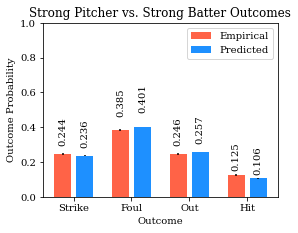

In [18]:
# Call outcome printing function
get_outcomes_by_quality("22", results)

In [70]:
# Open test set and aggregate outcomes between count

with open('transition_test_predictions.json') as json_file:
    test_set = json.load(json_file)

pitcher_test=np.array(test_set["pitcher_test"])
batter_test=np.array(test_set["batter_test"])
ids_test=np.array(test_set["ids_test"])
outcome_test=np.array(test_set["outcome_test"])
sc_test=np.array(test_set["sc_test"])
bc_test=np.array(test_set["bc_test"])
pitch_set_test=np.array(test_set["pitch_set_test"])
pred_test=np.array(test_set["pred_test"])
#Aggregate between thirds
zone_results = {"ball":{"pred":[],"emp":[]},"strike":{"pred":[],"emp":[]}}
count_results = {}#indexed by pitcher, batter
for i in range(len(pitcher_test)):
    #if i % 10000 == 0: print(i)
    pitcher = pitcher_test[i]
    pitcher_id = str(ids_test[i][0])
    batter_id = str(ids_test[i][1])
    row_id = ids_test[i][2]
    batter = batter_test[i]
    pitch = pitch_set_test[i]
    sc = sc_test[i]
    bc = bc_test[i]
    count = str(int(bc))+str(int(sc))
    res = outcome_test[i]
    pred_res = pred_test[i]

    row = swing_df.loc[ids_test[i][2]]
     
    zone = row.zones
    ball_zones = [9,10,11,12,13,14,15,16]

    if zone in ball_zones:
        zone_type = "ball"
    else:
        zone_type = "strike"
    zone_results[zone_type]["pred"].append(pred_res)
    zone_results[zone_type]["emp"].append(res)
    
    if count not in count_results.keys():
        count_results[count]={"pred":[],"emp":[]}
    count_results[count]["pred"].append(pred_res)
    count_results[count]["emp"].append(res)


In [ ]:
# prints results across keys in a results dictionary

def print_results(results):
    for key in results.keys():
        emp_mean = np.mean(np.array(results[key]["emp"]), axis = 0)
        pred_mean = np.mean(np.array(results[key]["pred"]), axis = 0)
        
        print(key)
        
        print("EMP")
        print(emp_mean)
        print("PRED")
        print(pred_mean)
        print("_______")

In [91]:
# graphs results between two keys in a results dictionary
        
def graph_results(results,key1, key2):

    
    labels = ['Strike', 'Foul', 'Out', 'Hit']
    
    pred1_mean = np.mean(results[key1]["pred"],axis=0)
    emp1_mean = np.mean(results[key1]["emp"],axis=0)
    
    emp1_yerr = []
    pred1_yerr = []
    
    emp1_means = []
    pred1_means = []
    
    pred2_mean = np.mean(results[key2]["pred"],axis=0)
    emp2_mean = np.mean(results[key2]["emp"],axis=0)
    
    emp2_yerr = []
    pred2_yerr = []
    
    emp2_means = []
    pred2_means = []
    
    for label in labels:
        label_ind = labels.index(label)
        
        print(label)
        emp1 = np.array(results[key1]["emp"])[:,label_ind]
        
        emp1_mean = np.mean(emp1)
        emp1_std = np.std(emp1)
        emp1_len = emp1.shape[0]
        emp1_err = (1.96*emp1_std/np.sqrt(emp1_len))
        emp1_yerr.append(emp1_err)
        emp1_means.append(emp1_mean)
        
        
        pred1 = np.array(results[key1]["pred"])[:,label_ind]
        
        pred1_mean = np.mean(pred1)
        pred1_std = np.std(pred1)
        pred1_len = pred1.shape[0]
        pred1_err = (1.96*pred1_std/np.sqrt(pred1_len))
        pred1_yerr.append(pred1_err)
        pred1_means.append(pred1_mean)  
        
                
        

        emp2 = np.array(results[key2]["emp"])[:,label_ind]
        
        emp2_mean = np.mean(emp2)
        emp2_std = np.std(emp2)
        emp2_len = emp1.shape[0]
        emp2_err = (1.96*emp2_std/np.sqrt(emp2_len))
        emp2_yerr.append(emp2_err)
        emp2_means.append(emp2_mean)
        
        
        pred2 = np.array(results[key2]["pred"])[:,label_ind]
        
        pred2_mean = np.mean(pred2)
        pred2_std = np.std(pred2)
        pred2_len = pred2.shape[0]
        pred2_err = (1.96*pred2_std/np.sqrt(pred2_len))
        pred2_yerr.append(pred2_err)
        pred2_means.append(pred2_mean)  
        
        
    x = np.arange(len(labels))  
    width = 0.15 
    dist = .08

    fig, ax = plt.subplots()
    fig.set_size_inches(w=4.2, h=3.2)
    rect1 = ax.bar(x - width-width*1/2-dist-dist*1/2, emp1_means, width, yerr = emp1_yerr, label='%s Emp'%(key1.capitalize()), edgecolor= "dodgerblue",hatch="///", color="white", alpha = .99, linewidth=2)
    rect2 = ax.bar(x-width*1/2 -dist*1/2, pred1_means,  width, yerr = pred1_yerr, label='%s Pred'%(key1.capitalize()), edgecolor= "dodgerblue",color="white" , linewidth=2)
    rect3 = ax.bar(x + width-width*1/2+dist*1/2, emp2_means, width, yerr = emp2_yerr, label='%s Emp'%(key2.capitalize()), edgecolor= "tomato",hatch="///", color="white", alpha = .99, linewidth=2)
    rect4 = ax.bar(x + width*2-width*1/2 +dist+dist*1/2, pred2_means, width, yerr = pred2_yerr, label='%s Pred'%(key2.capitalize()), edgecolor= "tomato", color="white", linewidth=2)

    
    def autolabel(bars):
        for bar in bars:
            height = bar.get_height()
            ax.text(bar.get_x() + bar.get_width()/2., 1.2*height,
                    '%.3f' % float(height), rotation=90,
                    ha='center', va='bottom')
    autolabel(rect1)
    autolabel(rect2)
    autolabel(rect3)
    autolabel(rect4)
    ax.set_ylim([0,1])
    ax.set_ylabel('Outcome Probability') 
    ax.set_xlabel('Outcome')
    ax.set_title('%s vs. %s Transition Probabilities'%(key1.capitalize(),key2.capitalize()))
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    ax.legend()
    
    file_name = '%s_vs_%s_transition_probabilities.pdf'%(key1,key2)


    plt.show()
    plt.savefig(file_name,dpi=120)

Strike
Foul
Out
Hit
0.16293929712460065
0.4472843450479233
0.25559105431309903
0.134185303514377
0.16446502544818975
0.41157004679925147
0.2607100640450375
0.1632548639247307
0.29955361382847373
0.36898090986798365
0.2270870927913382
0.10437838351220438
0.29854438390447646
0.37339087240879115
0.22392243688719077
0.10414230729212862


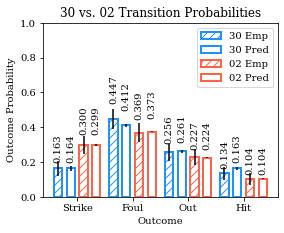

In [92]:
graph_results(count_results, "30","02")

In [100]:
# Graphs results between inside (strike) and outside (ball) zones

def graph_results_zone(results,key1, key2):

    
    labels = ['Strike', 'Foul', 'Out', 'Hit']
    
    pred1_mean = np.mean(results[key1]["pred"],axis=0)
    emp1_mean = np.mean(results[key1]["emp"],axis=0)
    
    emp1_yerr = []
    pred1_yerr = []
    
    emp1_means = []
    pred1_means = []
    
    pred2_mean = np.mean(results[key2]["pred"],axis=0)
    emp2_mean = np.mean(results[key2]["emp"],axis=0)
    
    emp2_yerr = []
    pred2_yerr = []
    
    emp2_means = []
    pred2_means = []
    
    for label in labels:
        label_ind = labels.index(label)
        
        print(label)
        emp1 = np.array(results[key1]["emp"])[:,label_ind]
        
        emp1_mean = np.mean(emp1)
        emp1_std = np.std(emp1)
        emp1_len = emp1.shape[0]
        emp1_err = (1.96*emp1_std/np.sqrt(emp1_len))
        emp1_yerr.append(emp1_err)
        emp1_means.append(emp1_mean)
        
        
        pred1 = np.array(results[key1]["pred"])[:,label_ind]
        
        pred1_mean = np.mean(pred1)
        pred1_std = np.std(pred1)
        pred1_len = pred1.shape[0]
        pred1_err = (1.96*pred1_std/np.sqrt(pred1_len))
        pred1_yerr.append(pred1_err)
        pred1_means.append(pred1_mean)  
        
                
        

        emp2 = np.array(results[key2]["emp"])[:,label_ind]
        
        emp2_mean = np.mean(emp2)
        emp2_std = np.std(emp2)
        emp2_len = emp1.shape[0]
        emp2_err = (1.96*emp2_std/np.sqrt(emp2_len))
        emp2_yerr.append(emp2_err)
        emp2_means.append(emp2_mean)
        
        
        pred2 = np.array(results[key2]["pred"])[:,label_ind]
        
        pred2_mean = np.mean(pred2)
        pred2_std = np.std(pred2)
        pred2_len = pred2.shape[0]
        pred2_err = (1.96*pred2_std/np.sqrt(pred2_len))
        pred2_yerr.append(pred2_err)
        pred2_means.append(pred2_mean)  
        
        
    x = np.arange(len(labels))  
    width = 0.15 
    dist = .08

    fig, ax = plt.subplots()
    fig.set_size_inches(w=4.2, h=3.2)
    rect1 = ax.bar(x - width-width*1/2-dist-dist*1/2, emp1_means, width, yerr = emp1_yerr, label='%s Emp'%(key1.capitalize()), edgecolor= "dodgerblue",hatch="///", color="white", alpha = .99, linewidth=2)
    rect2 = ax.bar(x-width*1/2 -dist*1/2, pred1_means,  width, yerr = pred1_yerr, label='%s Pred'%(key1.capitalize()), edgecolor= "dodgerblue",color="white" , linewidth=2)
    rect3 = ax.bar(x + width-width*1/2+dist*1/2, emp2_means, width, yerr = emp2_yerr, label='%s Emp'%(key2.capitalize()), edgecolor= "tomato",hatch="///", color="white", alpha = .99, linewidth=2)
    rect4 = ax.bar(x + width*2-width*1/2 +dist+dist*1/2, pred2_means, width, yerr = pred2_yerr, label='%s Pred'%(key2.capitalize()), edgecolor= "tomato", color="white", linewidth=2)

    
    def autolabel(rects):

        for rect in rects:
            height = rect.get_height()
            print(height)
            ax.text(rect.get_x() + rect.get_width()/2., 1.2*height,
                    '%.3f' % float(height), rotation=90,
                    ha='center', va='bottom')
    autolabel(rect1)
    autolabel(rect2)
    autolabel(rect3)
    autolabel(rect4)
    ax.set_ylim([0,1])
    ax.set_ylabel('Outcome Probability') 
    ax.set_xlabel('Outcome')
    ax.set_title('Ball vs. Strike Zone Transition Probabilities')
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    ax.legend()
    
    file_name = 'ball_vs_strike_zone_transition_probabilities.pdf'
    #print(file_name)

    #fig.tight_layout()

    plt.show()
    plt.savefig(file_name,dpi=120)
graph_results_zone(zone_results, "ball","strike")